# Computer Vision Nanodegree

## Project: Image Captioning

---

The Microsoft **C**ommon **O**bjects in **CO**ntext (MS COCO) dataset is a large-scale dataset for scene understanding.  The dataset is commonly used to train and benchmark object detection, segmentation, and captioning algorithms.  

![Sample Dog Output](images/coco-examples.jpg)

You can read more about the dataset on the [website](http://cocodataset.org/#home) or in the [research paper](https://arxiv.org/pdf/1405.0312.pdf).

In this notebook, you will explore this dataset, in preparation for the project.

## Step 1: Initialize the COCO API

We begin by initializing the [COCO API](https://github.com/cocodataset/cocoapi) that you will use to obtain the data.

In [1]:
import os
import sys
sys.path.append('/opt/cocoapi/PythonAPI')
from pycocotools.coco import COCO

# initialize COCO API for instance annotations
dataDir = '/opt/cocoapi'
dataType = 'val2014'
instances_annFile = os.path.join(dataDir, 'annotations/instances_{}.json'.format(dataType))
coco = COCO(instances_annFile)

# initialize COCO API for caption annotations
captions_annFile = os.path.join(dataDir, 'annotations/captions_{}.json'.format(dataType))
coco_caps = COCO(captions_annFile)

# get image ids 
ids = list(coco.anns.keys())

loading annotations into memory...
Done (t=6.60s)
creating index...
index created!
loading annotations into memory...
Done (t=0.51s)
creating index...
index created!


In [2]:
!ls -ltr /opt/cocoapi

total 40
drwxr-xr-x 2 root root 4096 Sep 17  2020 results
-rw-r--r-- 1 root root 1286 Sep 17  2020 README.txt
drwxr-xr-x 3 root root 4096 Sep 17  2020 MatlabAPI
drwxr-xr-x 3 root root 4096 Sep 17  2020 LuaAPI
-rw-r--r-- 1 root root 1533 Sep 17  2020 license.txt
drwxr-xr-x 2 root root 4096 Sep 17  2020 common
drwxr-xr-x 1 root root 4096 Sep 17  2020 PythonAPI
drwxr-xr-x 2 root root 4096 Sep 17  2020 annotations
drwxr-xr-x 5 root root 4096 Sep 17  2020 images


In [3]:
!ls -ltr /opt/cocoapi/annotations

total 833960
-rw-rw-r-- 1 root root   9131355 Sep  1  2017 image_info_test2014.json
-rw-rw-r-- 1 root root 332556225 Sep  1  2017 instances_train2014.json
-rw-rw-r-- 1 root root 160682675 Sep  1  2017 instances_val2014.json
-rw-r--r-- 1 root root 170733465 Sep  1  2017 person_keypoints_train2014.json
-rw-r--r-- 1 root root  81637509 Sep  1  2017 person_keypoints_val2014.json
-rw-rw-r-- 1 root root  66782097 Sep  1  2017 captions_train2014.json
-rw-rw-r-- 1 root root  32421077 Sep  1  2017 captions_val2014.json


In [ ]:
https://cocodataset.org/#download

In [4]:
!head -10 /opt/cocoapi/annotations/instances_val2014.json

{"info": {"description": "COCO 2014 Dataset","url": "http://cocodataset.org","version": "1.0","year": 2014,"contributor": "COCO Consortium","date_created": "2017/09/01"},"images": [{"license": 3,"file_name": "COCO_val2014_000000391895.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000391895.jpg","height": 360,"width": 640,"date_captured": "2013-11-14 11:18:45","flickr_url": "http://farm9.staticflickr.com/8186/8119368305_4e622c8349_z.jpg","id": 391895},{"license": 4,"file_name": "COCO_val2014_000000522418.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000522418.jpg","height": 480,"width": 640,"date_captured": "2013-11-14 11:38:44","flickr_url": "http://farm1.staticflickr.com/1/127244861_ab0c0381e7_z.jpg","id": 522418},{"license": 3,"file_name": "COCO_val2014_000000184613.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000184613.jpg","height": 336,"width": 500,"date_captured": "2013-11-14 12:36:29","flickr_url": "h

ickr.com/61/171695355_e48cce279f_z.jpg","id": 581402},{"license": 4,"file_name": "COCO_val2014_000000245383.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000245383.jpg","height": 389,"width": 640,"date_captured": "2013-11-15 14:57:58","flickr_url": "http://farm7.staticflickr.com/6116/6231647457_34d8cdd3cd_z.jpg","id": 245383},{"license": 4,"file_name": "COCO_val2014_000000540806.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000540806.jpg","height": 360,"width": 640,"date_captured": "2013-11-15 15:09:33","flickr_url": "http://farm3.staticflickr.com/2894/9200698084_4ba8f85c6b_z.jpg","id": 540806},{"license": 1,"file_name": "COCO_val2014_000000402330.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000402330.jpg","height": 559,"width": 640,"date_captured": "2013-11-15 15:13:18","flickr_url": "http://farm4.staticflickr.com/3489/3278974477_9448986f01_z.jpg","id": 402330},{"license": 5,"file_name": "COCO_val2014_00000

"height": 428,"width": 640,"date_captured": "2013-11-16 05:13:06","flickr_url": "http://farm8.staticflickr.com/7444/9663760455_f12da1054d_z.jpg","id": 230232},{"license": 3,"file_name": "COCO_val2014_000000187989.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000187989.jpg","height": 428,"width": 640,"date_captured": "2013-11-16 05:13:11","flickr_url": "http://farm3.staticflickr.com/2831/9667003068_d1b38caa2e_z.jpg","id": 187989},{"license": 1,"file_name": "COCO_val2014_000000283495.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000283495.jpg","height": 425,"width": 640,"date_captured": "2013-11-16 05:21:57","flickr_url": "http://farm5.staticflickr.com/4086/5003656501_ee2bb08b0b_z.jpg","id": 283495},{"license": 1,"file_name": "COCO_val2014_000000160529.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000160529.jpg","height": 425,"width": 640,"date_captured": "2013-11-16 05:24:25","flickr_url": "http://farm5.static

0000251065.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000251065.jpg","height": 640,"width": 480,"date_captured": "2013-11-15 13:15:27","flickr_url": "http://farm9.staticflickr.com/8007/7445664296_17c5d59c1c_z.jpg","id": 251065},{"license": 1,"file_name": "COCO_val2014_000000507879.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000507879.jpg","height": 500,"width": 375,"date_captured": "2013-11-15 13:15:35","flickr_url": "http://farm3.staticflickr.com/2014/2274382022_9d6b2d8e1f_z.jpg","id": 507879},{"license": 1,"file_name": "COCO_val2014_000000578314.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000578314.jpg","height": 640,"width": 480,"date_captured": "2013-11-15 13:19:00","flickr_url": "http://farm7.staticflickr.com/6011/5982138464_ccdf555564_z.jpg","id": 578314},{"license": 5,"file_name": "COCO_val2014_000000253223.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000253223.jpg","h

": 117908},{"license": 4,"file_name": "COCO_val2014_000000285160.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000285160.jpg","height": 640,"width": 480,"date_captured": "2013-11-24 12:02:36","flickr_url": "http://farm8.staticflickr.com/7214/7061228039_b0a7a4898f_z.jpg","id": 285160},{"license": 3,"file_name": "COCO_val2014_000000255582.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000255582.jpg","height": 254,"width": 336,"date_captured": "2013-11-24 12:29:48","flickr_url": "http://farm1.staticflickr.com/14/13757295_12736352c0_z.jpg","id": 255582},{"license": 3,"file_name": "COCO_val2014_000000299946.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000299946.jpg","height": 500,"width": 375,"date_captured": "2013-11-24 12:49:35","flickr_url": "http://farm2.staticflickr.com/1274/1002593183_5a968c978e_z.jpg","id": 299946},{"license": 4,"file_name": "COCO_val2014_000000065969.jpg","coco_url": "http://images.cocodat

00253518.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000253518.jpg","height": 427,"width": 640,"date_captured": "2013-11-20 23:01:55","flickr_url": "http://farm7.staticflickr.com/6136/5966471281_2cf6eee5e8_z.jpg","id": 253518},{"license": 1,"file_name": "COCO_val2014_000000208377.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000208377.jpg","height": 640,"width": 422,"date_captured": "2013-11-20 23:11:22","flickr_url": "http://farm7.staticflickr.com/6032/5884174257_568f5a21ff_z.jpg","id": 208377},{"license": 1,"file_name": "COCO_val2014_000000481035.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000481035.jpg","height": 375,"width": 500,"date_captured": "2013-11-20 23:25:48","flickr_url": "http://farm3.staticflickr.com/2318/2069739075_f60a44fcdf_z.jpg","id": 481035},{"license": 1,"file_name": "COCO_val2014_000000105234.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000105234.jpg","hei

.jpg","height": 480,"width": 640,"date_captured": "2013-11-18 12:25:02","flickr_url": "http://farm3.staticflickr.com/2642/5819294476_f8cf2f47b9_z.jpg","id": 201241},{"license": 1,"file_name": "COCO_val2014_000000042225.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000042225.jpg","height": 640,"width": 425,"date_captured": "2013-11-18 12:43:37","flickr_url": "http://farm6.staticflickr.com/5179/5587083675_db2d671dbe_z.jpg","id": 42225},{"license": 1,"file_name": "COCO_val2014_000000428366.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000428366.jpg","height": 640,"width": 480,"date_captured": "2013-11-18 12:43:55","flickr_url": "http://farm6.staticflickr.com/5296/5587083677_d6d336db74_z.jpg","id": 428366},{"license": 3,"file_name": "COCO_val2014_000000360128.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000360128.jpg","height": 640,"width": 481,"date_captured": "2013-11-18 12:58:05","flickr_url": "http://farm9.s

_val2014_000000365214.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000365214.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 16:52:59","flickr_url": "http://farm1.staticflickr.com/54/146404501_7978cb3b36_z.jpg","id": 365214},{"license": 1,"file_name": "COCO_val2014_000000212322.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000212322.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 17:18:27","flickr_url": "http://farm9.staticflickr.com/8450/7944804148_041f71c640_z.jpg","id": 212322},{"license": 1,"file_name": "COCO_val2014_000000350860.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000350860.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 17:23:48","flickr_url": "http://farm9.staticflickr.com/8374/8540438626_a8b5a21a30_z.jpg","id": 350860},{"license": 1,"file_name": "COCO_val2014_000000158414.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000158414

ges.cocodataset.org/val2014/COCO_val2014_000000007556.jpg","height": 355,"width": 640,"date_captured": "2013-11-22 16:34:55","flickr_url": "http://farm4.staticflickr.com/3476/3865307730_6013f4f3d4_z.jpg","id": 7556},{"license": 2,"file_name": "COCO_val2014_000000032364.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000032364.jpg","height": 426,"width": 640,"date_captured": "2013-11-22 16:47:20","flickr_url": "http://farm4.staticflickr.com/3595/3796945137_d5b46c0e3d_z.jpg","id": 32364},{"license": 5,"file_name": "COCO_val2014_000000530509.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000530509.jpg","height": 640,"width": 427,"date_captured": "2013-11-22 16:50:02","flickr_url": "http://farm4.staticflickr.com/3432/3800897721_81200fc801_z.jpg","id": 530509},{"license": 4,"file_name": "COCO_val2014_000000077460.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000077460.jpg","height": 640,"width": 428,"date_captured": 

: "http://images.cocodataset.org/val2014/COCO_val2014_000000166255.jpg","height": 428,"width": 640,"date_captured": "2013-11-19 00:43:00","flickr_url": "http://farm6.staticflickr.com/5518/9620798346_c7efc28d9d_z.jpg","id": 166255},{"license": 1,"file_name": "COCO_val2014_000000413634.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000413634.jpg","height": 480,"width": 640,"date_captured": "2013-11-19 02:29:53","flickr_url": "http://farm8.staticflickr.com/7301/8735196064_9c667ed712_z.jpg","id": 413634},{"license": 4,"file_name": "COCO_val2014_000000382770.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000382770.jpg","height": 427,"width": 640,"date_captured": "2013-11-19 18:01:25","flickr_url": "http://farm3.staticflickr.com/2612/3748829549_4f451e9910_z.jpg","id": 382770},{"license": 4,"file_name": "COCO_val2014_000000368602.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000368602.jpg","height": 427,"width": 640,"

ght": 500,"width": 354,"date_captured": "2013-11-16 18:02:46","flickr_url": "http://farm1.staticflickr.com/47/144888628_c1b630fe01_z.jpg","id": 214255},{"license": 3,"file_name": "COCO_val2014_000000568439.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000568439.jpg","height": 449,"width": 640,"date_captured": "2013-11-16 18:17:40","flickr_url": "http://farm7.staticflickr.com/6200/6050135290_038888df93_z.jpg","id": 568439},{"license": 6,"file_name": "COCO_val2014_000000372317.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000372317.jpg","height": 428,"width": 640,"date_captured": "2013-11-16 18:21:16","flickr_url": "http://farm7.staticflickr.com/6060/6331652697_68fe5f7ce9_z.jpg","id": 372317},{"license": 1,"file_name": "COCO_val2014_000000205676.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000205676.jpg","height": 451,"width": 640,"date_captured": "2013-11-16 18:31:18","flickr_url": "http://farm8.staticflickr.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



63122_82c57c1773_z.jpg","id": 14353},{"license": 1,"file_name": "COCO_val2014_000000353405.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000353405.jpg","height": 500,"width": 640,"date_captured": "2013-11-21 03:04:16","flickr_url": "http://farm2.staticflickr.com/1401/1451497668_e9d9b82e89_z.jpg","id": 353405},{"license": 4,"file_name": "COCO_val2014_000000321332.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000321332.jpg","height": 480,"width": 640,"date_captured": "2013-11-21 03:11:43","flickr_url": "http://farm8.staticflickr.com/7004/6558441823_c8f08bc6a3_z.jpg","id": 321332},{"license": 1,"file_name": "COCO_val2014_000000182834.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000182834.jpg","height": 480,"width": 640,"date_captured": "2013-11-21 03:29:41","flickr_url": "http://farm1.staticflickr.com/112/312918163_b1e0b4a2e2_z.jpg","id": 182834},{"license": 1,"file_name": "COCO_val2014_000000035567.jpg","coco_

: 256505},{"license": 3,"file_name": "COCO_val2014_000000239130.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000239130.jpg","height": 488,"width": 640,"date_captured": "2013-11-15 03:01:15","flickr_url": "http://farm7.staticflickr.com/6061/6149488532_1061412faf_z.jpg","id": 239130},{"license": 1,"file_name": "COCO_val2014_000000114790.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000114790.jpg","height": 480,"width": 640,"date_captured": "2013-11-15 03:05:49","flickr_url": "http://farm1.staticflickr.com/118/256259042_67415a7e67_z.jpg","id": 114790},{"license": 1,"file_name": "COCO_val2014_000000411685.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000411685.jpg","height": 480,"width": 640,"date_captured": "2013-11-15 03:16:54","flickr_url": "http://farm1.staticflickr.com/23/26905583_c021c50f6f_z.jpg","id": 411685},{"license": 3,"file_name": "COCO_val2014_000000252857.jpg","coco_url": "http://images.cocodatase

kr_url": "http://farm8.staticflickr.com/7281/8736184853_17555ba87b_z.jpg","id": 449490},{"license": 2,"file_name": "COCO_val2014_000000529950.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000529950.jpg","height": 250,"width": 500,"date_captured": "2013-11-17 10:18:35","flickr_url": "http://farm1.staticflickr.com/23/25793505_c4de1f49cc_z.jpg","id": 529950},{"license": 2,"file_name": "COCO_val2014_000000450886.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000450886.jpg","height": 250,"width": 500,"date_captured": "2013-11-17 10:18:38","flickr_url": "http://farm1.staticflickr.com/22/25793504_063d306fcb_z.jpg","id": 450886},{"license": 3,"file_name": "COCO_val2014_000000437859.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000437859.jpg","height": 480,"width": 640,"date_captured": "2013-11-17 10:23:39","flickr_url": "http://farm4.staticflickr.com/3236/3027055110_43769d689c_z.jpg","id": 437859},{"license": 1,"file_

_val2014_000000476851.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000476851.jpg","height": 478,"width": 640,"date_captured": "2013-11-20 04:11:18","flickr_url": "http://farm6.staticflickr.com/5129/5215272639_6e676f97c8_z.jpg","id": 476851},{"license": 3,"file_name": "COCO_val2014_000000175863.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000175863.jpg","height": 640,"width": 480,"date_captured": "2013-11-20 04:38:11","flickr_url": "http://farm6.staticflickr.com/5123/5342435644_50590c0a64_z.jpg","id": 175863},{"license": 3,"file_name": "COCO_val2014_000000431177.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000431177.jpg","height": 640,"width": 416,"date_captured": "2013-11-20 04:43:21","flickr_url": "http://farm6.staticflickr.com/5283/5289927288_5841238ee1_z.jpg","id": 431177},{"license": 2,"file_name": "COCO_val2014_000000432300.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000432

30:45","flickr_url": "http://farm5.staticflickr.com/4057/4239531768_f6982de0a7_z.jpg","id": 61314},{"license": 3,"file_name": "COCO_val2014_000000545007.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000545007.jpg","height": 640,"width": 425,"date_captured": "2013-11-24 03:35:53","flickr_url": "http://farm7.staticflickr.com/6038/6233089292_436fed7fae_z.jpg","id": 545007},{"license": 1,"file_name": "COCO_val2014_000000517777.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000517777.jpg","height": 500,"width": 334,"date_captured": "2013-11-24 03:41:48","flickr_url": "http://farm1.staticflickr.com/48/146893865_e42f18cb60_z.jpg","id": 517777},{"license": 1,"file_name": "COCO_val2014_000000011262.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000011262.jpg","height": 500,"width": 375,"date_captured": "2013-11-24 03:41:50","flickr_url": "http://farm1.staticflickr.com/193/472888488_45d3d58678_z.jpg","id": 11262},{"licen

3330320_f520286320_z.jpg","id": 372983},{"license": 2,"file_name": "COCO_val2014_000000012471.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000012471.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 15:15:26","flickr_url": "http://farm8.staticflickr.com/7087/7283936204_22b6d37b33_z.jpg","id": 12471},{"license": 1,"file_name": "COCO_val2014_000000262940.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000262940.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 15:24:55","flickr_url": "http://farm8.staticflickr.com/7137/6992515176_ab39646e36_z.jpg","id": 262940},{"license": 1,"file_name": "COCO_val2014_000000233298.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000233298.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 15:24:57","flickr_url": "http://farm8.staticflickr.com/7110/7138598655_b9475d2baa_z.jpg","id": 233298},{"license": 2,"file_name": "COCO_val2014_000000128441.jpg","c

ght": 600,"width": 473,"date_captured": "2013-11-18 08:09:33","flickr_url": "http://farm5.staticflickr.com/4124/5049616841_c07e27e775_z.jpg","id": 253095},{"license": 3,"file_name": "COCO_val2014_000000348400.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000348400.jpg","height": 612,"width": 612,"date_captured": "2013-11-18 08:15:24","flickr_url": "http://farm3.staticflickr.com/2814/9607799747_8b454a6d80_z.jpg","id": 348400},{"license": 1,"file_name": "COCO_val2014_000000295857.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000295857.jpg","height": 427,"width": 640,"date_captured": "2013-11-18 08:50:17","flickr_url": "http://farm5.staticflickr.com/4153/4975442924_249ac3ebd6_z.jpg","id": 295857},{"license": 3,"file_name": "COCO_val2014_000000210981.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000210981.jpg","height": 426,"width": 640,"date_captured": "2013-11-18 08:54:26","flickr_url": "http://farm5.staticflic

_name": "COCO_val2014_000000473057.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000473057.jpg","height": 406,"width": 640,"date_captured": "2013-11-20 20:50:03","flickr_url": "http://farm3.staticflickr.com/2142/2455973791_a7426366d8_z.jpg","id": 473057},{"license": 1,"file_name": "COCO_val2014_000000570857.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000570857.jpg","height": 427,"width": 640,"date_captured": "2013-11-20 20:52:08","flickr_url": "http://farm9.staticflickr.com/8324/8138645952_14057bc9da_z.jpg","id": 570857},{"license": 2,"file_name": "COCO_val2014_000000300375.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000300375.jpg","height": 280,"width": 400,"date_captured": "2013-11-20 20:53:22","flickr_url": "http://farm6.staticflickr.com/5199/6999831772_247f6ab94b_z.jpg","id": 300375},{"license": 4,"file_name": "COCO_val2014_000000449338.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2

15 02:39:05","flickr_url": "http://farm3.staticflickr.com/2523/3705549787_79049b1b6d_z.jpg","id": 70321},{"license": 3,"file_name": "COCO_val2014_000000409125.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000409125.jpg","height": 422,"width": 640,"date_captured": "2013-11-15 02:59:36","flickr_url": "http://farm8.staticflickr.com/7217/7170445463_af033ac71a_z.jpg","id": 409125},{"license": 1,"file_name": "COCO_val2014_000000326256.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000326256.jpg","height": 640,"width": 427,"date_captured": "2013-11-15 03:10:16","flickr_url": "http://farm8.staticflickr.com/7149/6854803979_5ea53a1f8a_z.jpg","id": 326256},{"license": 4,"file_name": "COCO_val2014_000000203564.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000203564.jpg","height": 400,"width": 400,"date_captured": "2013-11-15 03:12:47","flickr_url": "http://farm8.staticflickr.com/7366/9643253026_86d6e38def_z.jpg","id": 203

591639317_d2f73e95f5_z.jpg","id": 70619},{"license": 1,"file_name": "COCO_val2014_000000242345.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000242345.jpg","height": 640,"width": 480,"date_captured": "2013-11-17 11:13:05","flickr_url": "http://farm1.staticflickr.com/186/450189023_7aafda5583_z.jpg","id": 242345},{"license": 6,"file_name": "COCO_val2014_000000501153.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000501153.jpg","height": 426,"width": 640,"date_captured": "2013-11-17 13:19:56","flickr_url": "http://farm3.staticflickr.com/2058/2237736604_d923ce5cb6_z.jpg","id": 501153},{"license": 1,"file_name": "COCO_val2014_000000354398.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000354398.jpg","height": 486,"width": 640,"date_captured": "2013-11-17 14:05:48","flickr_url": "http://farm8.staticflickr.com/7037/6878810823_62e670ccd2_z.jpg","id": 354398},{"license": 3,"file_name": "COCO_val2014_000000076873.jpg","c

com/2269/5713604175_e940001fc7_z.jpg","id": 576369},{"license": 2,"file_name": "COCO_val2014_000000183650.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000183650.jpg","height": 612,"width": 612,"date_captured": "2013-11-20 03:31:43","flickr_url": "http://farm6.staticflickr.com/5151/7185019629_9243f6e417_z.jpg","id": 183650},{"license": 3,"file_name": "COCO_val2014_000000524799.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000524799.jpg","height": 333,"width": 500,"date_captured": "2013-11-20 04:28:28","flickr_url": "http://farm3.staticflickr.com/2750/4350294262_e18d7f659e_z.jpg","id": 524799},{"license": 3,"file_name": "COCO_val2014_000000446983.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000446983.jpg","height": 427,"width": 640,"date_captured": "2013-11-20 04:47:28","flickr_url": "http://farm5.staticflickr.com/4045/4339386402_132a5d43e7_z.jpg","id": 446983},{"license": 2,"file_name": "COCO_val2014_0000000

6","flickr_url": "http://farm4.staticflickr.com/3541/3302765254_4b63dd5f08_z.jpg","id": 275898},{"license": 2,"file_name": "COCO_val2014_000000286001.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000286001.jpg","height": 455,"width": 500,"date_captured": "2013-11-24 03:05:16","flickr_url": "http://farm1.staticflickr.com/163/361411357_974c3030c8_z.jpg","id": 286001},{"license": 2,"file_name": "COCO_val2014_000000343534.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000343534.jpg","height": 454,"width": 500,"date_captured": "2013-11-24 03:05:22","flickr_url": "http://farm1.staticflickr.com/140/361414737_f9ebe1138c_z.jpg","id": 343534},{"license": 2,"file_name": "COCO_val2014_000000069884.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000069884.jpg","height": 439,"width": 500,"date_captured": "2013-11-24 03:05:25","flickr_url": "http://farm1.staticflickr.com/149/361411817_c595b2a944_z.jpg","id": 69884},{"license":

idth": 440,"date_captured": "2013-11-16 14:15:55","flickr_url": "http://farm9.staticflickr.com/8338/8228070541_3a8dbf5f43_z.jpg","id": 374383},{"license": 3,"file_name": "COCO_val2014_000000133279.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000133279.jpg","height": 374,"width": 640,"date_captured": "2013-11-16 14:16:08","flickr_url": "http://farm9.staticflickr.com/8058/8190993390_332a0c0b4f_z.jpg","id": 133279},{"license": 3,"file_name": "COCO_val2014_000000201420.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000201420.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 14:30:46","flickr_url": "http://farm4.staticflickr.com/3398/3631736903_ed165149f0_z.jpg","id": 201420},{"license": 4,"file_name": "COCO_val2014_000000547431.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000547431.jpg","height": 409,"width": 640,"date_captured": "2013-11-16 14:32:40","flickr_url": "http://farm9.staticflickr.com/8036/

ed": "2013-11-18 05:45:28","flickr_url": "http://farm8.staticflickr.com/7082/7165126503_01d1a51ea2_z.jpg","id": 15599},{"license": 2,"file_name": "COCO_val2014_000000247179.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000247179.jpg","height": 427,"width": 640,"date_captured": "2013-11-18 05:46:37","flickr_url": "http://farm8.staticflickr.com/7078/7350336676_742c0e0e4d_z.jpg","id": 247179},{"license": 5,"file_name": "COCO_val2014_000000167781.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000167781.jpg","height": 427,"width": 640,"date_captured": "2013-11-18 05:52:40","flickr_url": "http://farm8.staticflickr.com/7228/7197072378_5e6ebf5505_z.jpg","id": 167781},{"license": 1,"file_name": "COCO_val2014_000000210980.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000210980.jpg","height": 480,"width": 640,"date_captured": "2013-11-18 05:53:09","flickr_url": "http://farm9.staticflickr.com/8026/7101342965_2f1a26f780_z.

: 426,"width": 640,"date_captured": "2013-11-20 20:11:35","flickr_url": "http://farm8.staticflickr.com/7431/8954402606_98db712eb6_z.jpg","id": 75494},{"license": 6,"file_name": "COCO_val2014_000000178283.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000178283.jpg","height": 426,"width": 640,"date_captured": "2013-11-20 20:11:38","flickr_url": "http://farm3.staticflickr.com/2836/8954403572_c22b9456b8_z.jpg","id": 178283},{"license": 6,"file_name": "COCO_val2014_000000535858.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000535858.jpg","height": 426,"width": 640,"date_captured": "2013-11-20 20:11:41","flickr_url": "http://farm8.staticflickr.com/7290/8954396960_28a3a2c492_z.jpg","id": 535858},{"license": 4,"file_name": "COCO_val2014_000000311846.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000311846.jpg","height": 480,"width": 640,"date_captured": "2013-11-20 20:21:19","flickr_url": "http://farm3.staticflickr.co

/images.cocodataset.org/val2014/COCO_val2014_000000078176.jpg","height": 480,"width": 640,"date_captured": "2013-11-24 16:18:05","flickr_url": "http://farm8.staticflickr.com/7199/6959340707_3fcab645c0_z.jpg","id": 78176},{"license": 4,"file_name": "COCO_val2014_000000022112.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000022112.jpg","height": 478,"width": 640,"date_captured": "2013-11-24 18:33:36","flickr_url": "http://farm4.staticflickr.com/3727/9340482539_1a81062d23_z.jpg","id": 22112},{"license": 3,"file_name": "COCO_val2014_000000164105.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000164105.jpg","height": 424,"width": 640,"date_captured": "2013-11-24 18:47:23","flickr_url": "http://farm9.staticflickr.com/8459/7988839542_5687e8cffb_z.jpg","id": 164105},{"license": 3,"file_name": "COCO_val2014_000000287171.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000287171.jpg","height": 424,"width": 640,"date_captur

0,"date_captured": "2013-11-16 19:56:37","flickr_url": "http://farm4.staticflickr.com/3583/3401836882_a9d1d3f635_z.jpg","id": 274931},{"license": 2,"file_name": "COCO_val2014_000000416220.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000416220.jpg","height": 515,"width": 640,"date_captured": "2013-11-16 20:03:55","flickr_url": "http://farm4.staticflickr.com/3653/3407295479_b97ac812c9_z.jpg","id": 416220},{"license": 3,"file_name": "COCO_val2014_000000129187.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000129187.jpg","height": 496,"width": 640,"date_captured": "2013-11-16 20:06:51","flickr_url": "http://farm4.staticflickr.com/3585/3351399349_ff4ce1f666_z.jpg","id": 129187},{"license": 1,"file_name": "COCO_val2014_000000113001.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000113001.jpg","height": 425,"width": 640,"date_captured": "2013-11-16 20:14:06","flickr_url": "http://farm3.staticflickr.com/2827/966635219

le_name": "COCO_val2014_000000219841.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000219841.jpg","height": 551,"width": 640,"date_captured": "2013-11-18 15:16:07","flickr_url": "http://farm6.staticflickr.com/5099/5531517394_f9cb8a7835_z.jpg","id": 219841},{"license": 2,"file_name": "COCO_val2014_000000283940.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000283940.jpg","height": 428,"width": 640,"date_captured": "2013-11-18 15:30:56","flickr_url": "http://farm1.staticflickr.com/147/405327683_7885aa9187_z.jpg","id": 283940},{"license": 2,"file_name": "COCO_val2014_000000462330.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000462330.jpg","height": 322,"width": 640,"date_captured": "2013-11-18 15:31:29","flickr_url": "http://farm1.staticflickr.com/140/405327510_75ab075510_z.jpg","id": 462330},{"license": 1,"file_name": "COCO_val2014_000000367509.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val201

m8.staticflickr.com/7229/7196146030_6fe4f2c531_z.jpg","id": 306889},{"license": 3,"file_name": "COCO_val2014_000000221829.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000221829.jpg","height": 640,"width": 429,"date_captured": "2013-11-20 23:57:56","flickr_url": "http://farm8.staticflickr.com/7088/7196146724_09cf7823da_z.jpg","id": 221829},{"license": 1,"file_name": "COCO_val2014_000000289415.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000289415.jpg","height": 428,"width": 640,"date_captured": "2013-11-20 23:59:13","flickr_url": "http://farm8.staticflickr.com/7041/7084203519_6f6f86ef23_z.jpg","id": 289415},{"license": 3,"file_name": "COCO_val2014_000000451668.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000451668.jpg","height": 333,"width": 500,"date_captured": "2013-11-21 00:03:33","flickr_url": "http://farm1.staticflickr.com/72/197959572_b7f9d91a02_z.jpg","id": 451668},{"license": 3,"file_name": "COCO_va

": "COCO_val2014_000000149571.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000149571.jpg","height": 640,"width": 426,"date_captured": "2013-11-14 20:23:53","flickr_url": "http://farm5.staticflickr.com/4105/5432647935_a4037e0a59_z.jpg","id": 149571},{"license": 2,"file_name": "COCO_val2014_000000109216.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000109216.jpg","height": 426,"width": 640,"date_captured": "2013-11-14 20:46:31","flickr_url": "http://farm9.staticflickr.com/8295/7969561126_e43561e045_z.jpg","id": 109216},{"license": 1,"file_name": "COCO_val2014_000000040998.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000040998.jpg","height": 640,"width": 499,"date_captured": "2013-11-14 21:04:05","flickr_url": "http://farm8.staticflickr.com/7280/7876857040_c60962e339_z.jpg","id": 40998},{"license": 5,"file_name": "COCO_val2014_000000367424.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_00

"COCO_val2014_000000423617.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000423617.jpg","height": 480,"width": 640,"date_captured": "2013-11-17 00:28:01","flickr_url": "http://farm9.staticflickr.com/8479/8195678412_8d8d906379_z.jpg","id": 423617},{"license": 4,"file_name": "COCO_val2014_000000449403.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000449403.jpg","height": 480,"width": 640,"date_captured": "2013-11-17 00:31:19","flickr_url": "http://farm9.staticflickr.com/8479/8194584889_996bb3af5d_z.jpg","id": 449403},{"license": 4,"file_name": "COCO_val2014_000000084170.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000084170.jpg","height": 480,"width": 640,"date_captured": "2013-11-17 00:36:46","flickr_url": "http://farm9.staticflickr.com/8190/8134254727_0b28cabe93_z.jpg","id": 84170},{"license": 3,"file_name": "COCO_val2014_000000404871.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_00000

cflickr.com/2485/3879655675_5d4648db14_z.jpg","id": 243355},{"license": 1,"file_name": "COCO_val2014_000000019890.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000019890.jpg","height": 480,"width": 640,"date_captured": "2013-11-18 19:21:33","flickr_url": "http://farm3.staticflickr.com/2652/3879652073_08e4b87397_z.jpg","id": 19890},{"license": 3,"file_name": "COCO_val2014_000000491683.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000491683.jpg","height": 500,"width": 366,"date_captured": "2013-11-18 19:52:36","flickr_url": "http://farm2.staticflickr.com/1036/699576358_4450dcb2c0_z.jpg","id": 491683},{"license": 3,"file_name": "COCO_val2014_000000401850.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000401850.jpg","height": 640,"width": 472,"date_captured": "2013-11-18 19:53:11","flickr_url": "http://farm9.staticflickr.com/8204/8205537795_d070a0180d_z.jpg","id": 401850},{"license": 4,"file_name": "COCO_val2014_0

g","height": 427,"width": 640,"date_captured": "2013-11-22 01:17:47","flickr_url": "http://farm1.staticflickr.com/160/374018723_13661effc0_z.jpg","id": 188416},{"license": 1,"file_name": "COCO_val2014_000000158779.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000158779.jpg","height": 427,"width": 640,"date_captured": "2013-11-22 01:17:53","flickr_url": "http://farm1.staticflickr.com/182/374012874_4b346eeb1e_z.jpg","id": 158779},{"license": 1,"file_name": "COCO_val2014_000000081862.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000081862.jpg","height": 427,"width": 640,"date_captured": "2013-11-22 01:17:57","flickr_url": "http://farm1.staticflickr.com/158/374007970_b42fb8252b_z.jpg","id": 81862},{"license": 1,"file_name": "COCO_val2014_000000497187.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000497187.jpg","height": 427,"width": 640,"date_captured": "2013-11-22 01:18:00","flickr_url": "http://farm1.staticflic

_000000006861.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000006861.jpg","height": 640,"width": 437,"date_captured": "2013-11-15 04:37:53","flickr_url": "http://farm6.staticflickr.com/5109/5752281914_e5d8fe1929_z.jpg","id": 6861},{"license": 4,"file_name": "COCO_val2014_000000272673.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000272673.jpg","height": 640,"width": 426,"date_captured": "2013-11-15 04:55:56","flickr_url": "http://farm6.staticflickr.com/5083/5353334779_9faaf421e6_z.jpg","id": 272673},{"license": 4,"file_name": "COCO_val2014_000000323598.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000323598.jpg","height": 427,"width": 640,"date_captured": "2013-11-15 04:59:57","flickr_url": "http://farm3.staticflickr.com/2347/3686286054_65c4730c73_z.jpg","id": 323598},{"license": 6,"file_name": "COCO_val2014_000000495993.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000495993.jpg","

l": "http://farm8.staticflickr.com/7128/8152072929_0665b8e9e4_z.jpg","id": 304347},{"license": 1,"file_name": "COCO_val2014_000000555357.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000555357.jpg","height": 480,"width": 640,"date_captured": "2013-11-17 20:42:20","flickr_url": "http://farm4.staticflickr.com/3772/8947690803_f6ed3d88bd_z.jpg","id": 555357},{"license": 4,"file_name": "COCO_val2014_000000037470.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000037470.jpg","height": 450,"width": 640,"date_captured": "2013-11-17 20:53:29","flickr_url": "http://farm1.staticflickr.com/146/331705644_587a5e64eb_z.jpg","id": 37470},{"license": 5,"file_name": "COCO_val2014_000000416170.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000416170.jpg","height": 640,"width": 424,"date_captured": "2013-11-17 20:56:56","flickr_url": "http://farm5.staticflickr.com/4084/5431709496_86fbc8af7c_z.jpg","id": 416170},{"license": 2,"file_

8cf89966_z.jpg","id": 463771},{"license": 3,"file_name": "COCO_val2014_000000258433.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000258433.jpg","height": 640,"width": 480,"date_captured": "2013-11-20 00:57:18","flickr_url": "http://farm2.staticflickr.com/1087/1081848151_8b2a14c1bd_z.jpg","id": 258433},{"license": 5,"file_name": "COCO_val2014_000000053744.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000053744.jpg","height": 375,"width": 500,"date_captured": "2013-11-20 01:16:37","flickr_url": "http://farm1.staticflickr.com/168/482956490_d54733d55b_z.jpg","id": 53744},{"license": 3,"file_name": "COCO_val2014_000000308504.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000308504.jpg","height": 539,"width": 640,"date_captured": "2013-11-20 01:17:07","flickr_url": "http://farm5.staticflickr.com/4104/5084142576_589bd903a2_z.jpg","id": 308504},{"license": 1,"file_name": "COCO_val2014_000000097589.jpg","coco_url": "h

val2014_000000508899.jpg","height": 480,"width": 640,"date_captured": "2013-11-22 00:46:34","flickr_url": "http://farm5.staticflickr.com/4044/4515444447_2a0d61c32b_z.jpg","id": 508899},{"license": 4,"file_name": "COCO_val2014_000000066635.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000066635.jpg","height": 480,"width": 640,"date_captured": "2013-11-22 00:58:44","flickr_url": "http://farm1.staticflickr.com/101/256415658_3e03393dd5_z.jpg","id": 66635},{"license": 3,"file_name": "COCO_val2014_000000557321.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000557321.jpg","height": 359,"width": 640,"date_captured": "2013-11-22 00:59:16","flickr_url": "http://farm4.staticflickr.com/3195/2958683461_12fc97ca1a_z.jpg","id": 557321},{"license": 4,"file_name": "COCO_val2014_000000568004.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000568004.jpg","height": 480,"width": 640,"date_captured": "2013-11-22 01:03:02","flickr_url

flickr_url": "http://farm7.staticflickr.com/6226/7018072273_c1e7395546_z.jpg","id": 178331},{"license": 3,"file_name": "COCO_val2014_000000237759.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000237759.jpg","height": 480,"width": 640,"date_captured": "2013-11-15 11:46:09","flickr_url": "http://farm8.staticflickr.com/7074/6871966402_3e5abe2b14_z.jpg","id": 237759},{"license": 1,"file_name": "COCO_val2014_000000032258.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000032258.jpg","height": 375,"width": 500,"date_captured": "2013-11-15 11:50:02","flickr_url": "http://farm1.staticflickr.com/114/273496673_28ce8b6878_z.jpg","id": 32258},{"license": 2,"file_name": "COCO_val2014_000000016285.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000016285.jpg","height": 375,"width": 500,"date_captured": "2013-11-15 11:54:30","flickr_url": "http://farm4.staticflickr.com/3506/3815958881_048001cf2d_z.jpg","id": 16285},{"license": 

2,"file_name": "COCO_val2014_000000453870.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000453870.jpg","height": 640,"width": 480,"date_captured": "2013-11-17 10:19:13","flickr_url": "http://farm2.staticflickr.com/1060/1001608550_878cef7d79_z.jpg","id": 453870},{"license": 4,"file_name": "COCO_val2014_000000516800.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000516800.jpg","height": 424,"width": 640,"date_captured": "2013-11-17 10:29:59","flickr_url": "http://farm9.staticflickr.com/8256/8682936800_7d0ae83d79_z.jpg","id": 516800},{"license": 4,"file_name": "COCO_val2014_000000479030.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000479030.jpg","height": 424,"width": 640,"date_captured": "2013-11-17 10:43:01","flickr_url": "http://farm9.staticflickr.com/8400/8645262251_a715881431_z.jpg","id": 479030},{"license": 3,"file_name": "COCO_val2014_000000330522.jpg","coco_url": "http://images.cocodataset.org/val2014/CO

ca306_z.jpg","id": 132132},{"license": 3,"file_name": "COCO_val2014_000000165639.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000165639.jpg","height": 436,"width": 640,"date_captured": "2013-11-19 18:00:38","flickr_url": "http://farm4.staticflickr.com/3513/3178166039_ba60122c05_z.jpg","id": 165639},{"license": 3,"file_name": "COCO_val2014_000000043753.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000043753.jpg","height": 640,"width": 480,"date_captured": "2013-11-19 18:03:05","flickr_url": "http://farm3.staticflickr.com/2380/2420486794_c7ed55653b_z.jpg","id": 43753},{"license": 5,"file_name": "COCO_val2014_000000510275.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000510275.jpg","height": 468,"width": 640,"date_captured": "2013-11-19 18:04:43","flickr_url": "http://farm9.staticflickr.com/8281/7752479634_75b5432322_z.jpg","id": 510275},{"license": 6,"file_name": "COCO_val2014_000000124327.jpg","coco_url": "ht

ed": "2013-11-22 02:21:13","flickr_url": "http://farm6.staticflickr.com/5298/5466439282_a4814cfb11_z.jpg","id": 478517},{"license": 1,"file_name": "COCO_val2014_000000411044.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000411044.jpg","height": 375,"width": 500,"date_captured": "2013-11-22 02:30:24","flickr_url": "http://farm3.staticflickr.com/2497/4232728333_babc7f37a2_z.jpg","id": 411044},{"license": 1,"file_name": "COCO_val2014_000000204091.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000204091.jpg","height": 375,"width": 500,"date_captured": "2013-11-22 02:30:29","flickr_url": "http://farm3.staticflickr.com/2504/4232739517_6322c822d7_z.jpg","id": 204091},{"license": 2,"file_name": "COCO_val2014_000000477064.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000477064.jpg","height": 428,"width": 640,"date_captured": "2013-11-22 02:36:56","flickr_url": "http://farm4.staticflickr.com/3567/3530210223_3de8fbb1cc_z

ight": 640,"width": 478,"date_captured": "2013-11-15 04:23:15","flickr_url": "http://farm6.staticflickr.com/5261/5701755406_8e00619678_z.jpg","id": 367128},{"license": 1,"file_name": "COCO_val2014_000000204887.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000204887.jpg","height": 480,"width": 640,"date_captured": "2013-11-15 04:35:46","flickr_url": "http://farm6.staticflickr.com/5324/7175899242_bd96099918_z.jpg","id": 204887},{"license": 1,"file_name": "COCO_val2014_000000559440.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000559440.jpg","height": 480,"width": 640,"date_captured": "2013-11-15 04:36:22","flickr_url": "http://farm4.staticflickr.com/3316/5816070088_dfdce60093_z.jpg","id": 559440},{"license": 5,"file_name": "COCO_val2014_000000134715.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000134715.jpg","height": 427,"width": 640,"date_captured": "2013-11-15 05:20:27","flickr_url": "http://farm5.staticfli

{"license": 6,"file_name": "COCO_val2014_000000449471.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000449471.jpg","height": 427,"width": 640,"date_captured": "2013-11-17 04:11:45","flickr_url": "http://farm3.staticflickr.com/2867/9935354815_b2b4976932_z.jpg","id": 449471},{"license": 1,"file_name": "COCO_val2014_000000012947.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000012947.jpg","height": 640,"width": 427,"date_captured": "2013-11-17 04:18:50","flickr_url": "http://farm9.staticflickr.com/8104/8451981146_0fa0511f52_z.jpg","id": 12947},{"license": 1,"file_name": "COCO_val2014_000000174544.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000174544.jpg","height": 427,"width": 640,"date_captured": "2013-11-17 04:18:53","flickr_url": "http://farm9.staticflickr.com/8513/8451975616_cb2abf3c92_z.jpg","id": 174544},{"license": 5,"file_name": "COCO_val2014_000000532983.jpg","coco_url": "http://images.cocodataset.org

500,"date_captured": "2013-11-18 21:34:36","flickr_url": "http://farm2.staticflickr.com/1102/603271047_142b9b7c57_z.jpg","id": 345580},{"license": 3,"file_name": "COCO_val2014_000000105670.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000105670.jpg","height": 640,"width": 415,"date_captured": "2013-11-18 21:43:52","flickr_url": "http://farm1.staticflickr.com/234/462340033_7a5dfde7f4_z.jpg","id": 105670},{"license": 2,"file_name": "COCO_val2014_000000569931.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000569931.jpg","height": 332,"width": 500,"date_captured": "2013-11-18 21:50:29","flickr_url": "http://farm1.staticflickr.com/173/407929184_9c3441896a_z.jpg","id": 569931},{"license": 1,"file_name": "COCO_val2014_000000318204.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000318204.jpg","height": 480,"width": 640,"date_captured": "2013-11-18 21:51:20","flickr_url": "http://farm5.staticflickr.com/4123/4819445342_b

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6,149.48,68.99,147.85,66.63,148.03,65.72,149.3,65.9,151.66]],"area": 174.07239999999996,"iscrowd": 0,"image_id": 412151,"bbox": [64.27,147.85,8.35,27.79],"category_id": 44,"id": 95594},{"segmentation": [[330.66,245.9,331.64,257.15,321.85,260.09,321.85,266.45,318.42,262.53,317.44,241.49,320.87,237.58,320.87,223.39,321.85,220.94,323.32,220.94,325.27,220.94,326.25,223.88,326.25,226.81,326.74,230.24,327.23,234.64,329.68,239.05,330.66,247.37]],"area": 382.1735499999998,"iscrowd": 0,"image_id": 474499,"bbox": [317.44,220.94,14.2,45.51],"category_id": 44,"id": 95630},{"segmentation": [[174.69,246.16,168.43,205.12,171.91,196.78,168.78,174.87,173.3,171.04,180.26,172.78,182.69,202.69,190.69,210.69,194.17,256.6,184.78,260.08,179.21,251.73,175.04,247.56]],"area": 1372.405899999999,"iscrowd": 0,"image_id": 522779,"bbox": [168.43,171.04,25.74,89.04],"category_id": 44,"id": 95636},{"segmentation": [[218.08,233.96,215.33,228.47,222.66,223.88,231.83,222.05,231.83,229.38,229.99,233.05,220.83,236.71]],"a

"iscrowd": 0,"image_id": 479008,"bbox": [304.29,67.1,194.49,262.67],"category_id": 62,"id": 102849},{"segmentation": [[181.85,357.27,181.85,347.16,182.18,340.08,181.17,328.96,181.51,318.18,181.51,312.78,245.2,313.79,252.95,313.46,258.0,313.46,261.37,314.81,262.05,320.2,262.05,341.09,262.39,354.23,262.39,356.59,261.04,357.94]],"area": 3556.0733499999997,"iscrowd": 0,"image_id": 234470,"bbox": [181.17,312.78,81.22,45.16],"category_id": 62,"id": 102867},{"segmentation": [[0.1,164.72,48.04,178.04,86.08,189.83,121.46,202.01,146.57,217.23,162.93,233.97,171.3,257.56,174.35,273.15,172.82,291.8,169.78,326.8,200.98,339.35,226.09,323.38,248.16,310.82,256.53,305.87,277.45,310.06,288.48,319.19,289.63,324.52,270.98,335.93,247.77,354.95,244.73,359.52,266.04,368.65,270.22,375.12,269.84,380.82,254.24,388.05,238.64,402.13,238.26,420.39,229.13,431.81,231.03,443.6,127.55,443.98,79.99,444.74,45.75,416.59,38.14,421.53,30.15,424.96,19.12,410.88,16.84,398.33,16.08,366.37,19.12,355.33,6.18,343.16,6.57,324.52,8

mentation": [[86.9,473.28,81.72,436.03,76.55,380.17,69.31,347.07,63.1,328.45,64.14,317.07,97.24,317.07,147.93,311.9,176.9,310.86,193.45,304.66,192.41,327.41,192.41,367.76,193.45,382.24,216.21,382.24,217.24,398.79,219.31,428.79,223.45,468.1,220.34,474.31,205.86,473.28,210.0,448.45,203.79,429.83,195.52,445.34,198.62,474.31,185.17,474.31,185.17,460.86,137.59,461.9,134.48,475.34,118.97,475.34,120.0,466.03,103.45,465.0,102.41,475.34]],"area": 19997.90759999999,"iscrowd": 0,"image_id": 34445,"bbox": [63.1,304.66,160.35,170.68],"category_id": 62,"id": 107751},{"segmentation": [[387.97,289.95,448.0,290.7,461.51,289.95,475.77,267.43,518.54,238.92,529.05,203.65,546.31,184.89,563.56,203.65,557.56,218.66,546.31,233.67,508.79,327.47,503.53,358.98,502.78,365.74,505.78,377.49,514.79,414.26,520.04,464.54,520.04,491.55,477.27,573.35,314.43,572.6,282.16,535.08,286.67,513.31,231.14,452.53,292.67,389.5,327.94,347.47,380.47,291.94]],"area": 64767.27009999999,"iscrowd": 0,"image_id": 448928,"bbox": [231.14,

24,168.53,135.0,167.65,134.12]],"area": 112300.76599999999,"iscrowd": 0,"image_id": 276488,"bbox": [0.88,101.47,499.12,270.88],"category_id": 67,"id": 119347},{"segmentation": [[529.2,207.83,499.73,203.39,453.03,203.94,416.88,210.06,404.65,216.73,399.65,227.3,397.42,252.32,397.98,261.77,401.31,261.77,406.32,271.22,412.44,268.44,416.33,270.67,425.78,275.67,432.45,276.23,440.79,285.12,455.25,281.23,513.63,283.45,544.21,277.89,545.88,263.99,555.89,250.09,564.23,248.42,569.24,228.41,563.67,215.06,547.55,216.17,538.65,217.29,529.76,208.39,529.76,208.39]],"area": 11316.306350000003,"iscrowd": 0,"image_id": 117899,"bbox": [397.42,203.39,171.82,81.73],"category_id": 67,"id": 119406},{"segmentation": [[103.04,342.72,35.84,331.52,31.36,311.36,62.72,300.16,112.0,294.56,153.44,294.56,196.0,294.56,225.12,294.56,259.84,294.56,269.92,294.56,313.6,294.56,328.16,294.56,357.28,296.8,380.8,297.92,416.64,300.16,425.6,302.4,437.92,312.48,441.28,319.2,430.08,332.64,404.32,336.0,397.6,338.24,383.04,342.72,38

,173.12,210.75,184.95,221.51,193.55,236.56,191.4,248.39,196.77,256.99,198.92,274.19,209.68,267.74,221.51,260.22,219.35,237.63,213.98,221.51,207.53,224.73,211.83,247.31,217.2,261.29,226.88,279.57,241.94,249.46,310.75,205.38,300.0,200.0,340.86,194.62,378.49,181.72,375.27,182.8,365.59,183.87,356.99,177.42,394.62,172.04,411.83,154.69,438.74,144.09,461.29,138.34,463.48,130.11,455.91,138.49,429.03,144.79,404.3,145.16,395.7,143.01,388.17,139.78,383.87,137.63,372.04,137.63,368.82,139.78,362.37,140.86,354.84,131.18,350.54,125.81,340.86,133.33,335.48,147.31,335.48,160.22,311.83,170.97,287.1,152.69,273.12,177.42,201.08,211.83,206.45,212.9,200.0,198.92,194.62,189.25,178.49,181.72,188.17,163.44,192.47,161.29,189.25,173.12,182.8,173.12,175.27,154.84,176.34,154.84,170.97]],"area": 17997.454350000004,"iscrowd": 0,"image_id": 161141,"bbox": [125.81,162.37,153.76,301.11],"category_id": 2,"id": 124808},{"segmentation": [[0.0,428.39,1.03,341.68,38.19,308.65,97.03,282.84,167.23,279.74,204.39,286.97,231.23,

0.77],"category_id": 2,"id": 125346},{"segmentation": [[483.1,472.24,151.03,473.28,188.28,460.86,201.72,456.72,195.52,442.24,213.1,443.28,228.62,456.72,244.14,420.52,242.07,405.0,216.21,396.72,210.0,389.48,216.21,389.48,224.48,381.21,254.48,381.21,263.79,384.31,238.97,388.45,246.21,396.72,249.31,417.41,287.59,470.17,397.24,471.21,432.41,456.72,478.97,472.24]],"area": 4685.231099999996,"iscrowd": 0,"image_id": 65604,"bbox": [151.03,381.21,332.07,92.07],"category_id": 2,"id": 125368},{"segmentation": [[127.07,394.22,151.79,409.38,178.11,416.55,198.05,443.67,224.37,454.84,243.52,452.45,243.52,466.8,239.53,470.79,221.18,476.0,215.6,469.2,196.46,464.41,190.08,455.64,180.51,442.08,163.76,438.09,136.64,439.68,174.13,466.01,180.51,476.0,163.76,476.0,159.77,465.21,146.21,456.43,128.66,440.48,110.32,437.29,85.59,438.09,64.86,442.88,68.84,433.3,103.94,425.33,123.08,424.53,117.5,415.76,109.52,414.96],[76.93,393.22,77.83,410.39,54.34,406.78,48.02,400.45,56.15,384.19,75.12,393.22],[268.49,443.82,282

.99]],"area": 11856.3671,"iscrowd": 0,"image_id": 434891,"bbox": [172.57,437.74,185.18,119.01],"category_id": 2,"id": 126214},{"segmentation": [[502.76,353.34,497.36,370.07,488.58,370.66,480.29,371.81,471.14,376.38,462.84,385.53,460.57,396.73,460.13,405.87,463.02,415.67,467.7,421.46,475.95,425.47,483.08,427.0,497.34,426.36,507.14,421.02,510.93,413.0,514.27,402.52,514.94,394.73,512.49,387.15,507.14,377.35,500.23,374.67,502.68,366.65,523.18,394.06,519.39,379.35,518.73,367.99,519.39,360.86,506.92,355.51,515.16,346.38,516.94,339.91,514.05,339.02,511.82,341.03,510.7,345.04,508.03,345.93,506.92,343.26,505.13,340.75,508.03,338.52,508.48,337.63,506.69,337.41,501.35,338.52,497.78,340.97,500.01,343.2,502.24,345.21,502.68,349.88],[555.94,361.47,576.21,361.03,581.11,362.14,582.0,365.26,577.55,367.04,575.54,367.04,582.23,369.49,583.79,371.27,582.67,374.17,588.02,382.64,590.92,386.43,590.69,387.99,586.68,386.87,587.35,394.45,587.35,399.35,584.01,406.7,581.56,412.05,574.43,418.29,569.53,420.74,563.51

232.71,420.55,238.16,434.85,241.56,431.44,250.41,435.53,240.88,445.06,231.34,440.98,234.75,434.85,227.94,423.95,220.45,423.27,209.55,432.81,190.48,458.0,176.86,472.31,150.3,477.75,134.64,472.31,121.7,449.83,120.34,430.08,131.91,405.56,127.15,402.84,123.74,396.71,124.42,390.58,175.5,371.51,186.4,376.96,192.53,367.43,190.48,342.23,175.5,346.31,172.78,338.14,173.46,332.69,206.15,323.84,205.47,329.97,200.02,335.42,201.38,355.17]],"area": 14785.818650000001,"iscrowd": 0,"image_id": 205102,"bbox": [120.34,293.19,179.79,184.56],"category_id": 2,"id": 127055},{"segmentation": [[47.42,3.87,90.0,0.97,96.77,0.0,97.74,11.61,97.74,48.39,97.74,49.35,100.65,49.35,108.39,49.35,114.19,56.13,114.19,61.94,119.03,61.94,125.81,61.94,123.87,70.65,113.23,64.84,97.74,60.0,94.84,60.97,94.84,62.9,88.06,87.1,80.32,100.65,66.77,105.48,50.32,106.45,39.68,101.61,31.94,85.16,32.9,71.61,39.68,53.23,48.39,42.58,60.97,41.61,71.61,40.65,78.39,38.71,70.65,25.16,59.03,20.32,48.39,18.39,42.58,15.48,38.71,6.77]],"area": 519

195.82,336.86,167.14,337.51,163.23,370.1,158.01,399.44,178.87,403.35,156.71,382.49,144.32,347.94,154.75,296.44,159.32,289.27,167.79,304.92,194.52,316.65,183.44,306.87,218.64]],"area": 46341.44700000001,"iscrowd": 0,"image_id": 76942,"bbox": [183.66,144.32,287.49,279.66],"category_id": 2,"id": 127988},{"segmentation": [[104.02,449.54,104.02,449.54,120.36,455.9,138.52,454.99,145.79,455.9,145.79,462.25,159.41,467.7,155.78,468.61,142.15,463.16,142.15,463.16,128.53,462.25,127.63,462.25,122.18,472.24,122.18,472.24,117.64,488.59,130.35,510.38,141.25,509.47,153.05,519.46,163.04,534.9,165.76,593.01,153.96,612.08,144.88,623.89,140.34,623.89,127.63,629.33,124.9,630.24,108.56,627.52,107.65,626.61,96.75,595.74,94.94,558.51,100.38,535.8,113.1,517.64,113.1,504.93,102.2,525.82,88.58,543.07,86.76,543.07,82.22,556.69,79.5,568.49,65.88,573.94,56.8,573.94,52.26,553.97,58.61,517.64,73.14,494.94,88.58,494.03,88.58,494.03,114.0,481.32,114.0,480.41,114.0,469.52,121.27,463.16,97.66,455.9],[46.81,499.48,46.81,4

id": 140197,"bbox": [0.0,307.53,132.26,183.87],"category_id": 2,"id": 128882},{"segmentation": [[314.82,354.49,291.16,343.57,268.41,319.0,257.49,283.52,262.04,258.04,270.23,240.75,293.89,228.01,307.54,226.19,311.18,202.54,292.98,194.35,288.43,178.88,277.51,187.07,257.49,176.15,260.22,172.51,272.05,178.88,303.9,150.67,318.45,145.22,306.63,137.94,312.09,136.12,333.92,146.13,300.26,165.23,313.91,168.87,318.45,185.25,316.64,189.8,329.37,200.72,327.55,178.88,323.0,177.97,323.91,156.13,337.56,165.23,347.57,170.69,336.65,177.97,340.29,197.99,347.57,201.63,346.66,215.28,344.84,220.73,358.49,235.29,352.12,241.66,376.69,272.6,381.24,295.34,386.7,296.25,386.7,299.89,377.6,301.71,377.6,307.17,391.24,308.08,389.42,314.45,376.69,318.09,373.96,331.74,373.05,367.22,363.95,371.77,354.85,366.31,349.39,347.21,316.64,352.67,311.18,368.13,306.63,362.67]],"area": 16203.924299999995,"iscrowd": 0,"image_id": 561806,"bbox": [257.49,136.12,133.75,235.65],"category_id": 2,"id": 128886},{"segmentation": [[542.16,

130.11,279.57,115.05,293.55,91.4,327.96,87.1,350.54,92.47,362.37,105.38,365.59,140.86,346.24,150.54,320.43,160.22,301.08,163.44,291.4,158.06,278.49,160.22,268.82,188.17,288.17,181.72,312.9,177.42,327.96,187.1,338.71,191.4,341.94,194.62,350.54,196.77,355.91,197.85,361.29,195.7,397.85,209.68,426.88,243.01,431.18]],"area": 18154.52575,"iscrowd": 0,"image_id": 578016,"bbox": [87.1,147.31,196.77,286.02],"category_id": 2,"id": 129821},{"segmentation": [[357.82,419.73,378.25,412.92,388.47,397.94,398.68,366.61,398.68,339.37,398.0,325.75,398.0,325.75,392.55,320.3,392.55,313.49,385.74,311.45,391.19,293.74,395.28,285.57,404.81,278.76,391.19,282.84,380.3,286.93,380.3,301.91,380.3,314.17,370.08,316.9,366.68,323.03,374.17,332.56,371.44,341.41,371.44,347.54,365.31,374.1,364.63,389.77,358.5,410.88,355.78,418.37],[356.46,257.65,383.7,265.14,392.55,273.99,401.41,273.99,408.22,271.95,434.1,270.59,434.78,273.99,433.42,285.57,416.39,280.8,410.94,279.44,400.73,280.8,398.0,280.8,376.89,273.99,358.5,272.63,37

49]],"area": 3577.499549999997,"iscrowd": 0,"image_id": 18666,"bbox": [362.58,428.66,61.42,103.0],"category_id": 2,"id": 130919},{"segmentation": [[416.91,176.68,404.7,184.01,410.56,195.24,414.47,202.07,440.84,200.12,432.54,209.89,429.61,220.63,430.58,230.88,427.65,240.16,419.35,241.62,423.75,251.88,431.07,251.88,430.09,271.41,429.12,291.43,433.02,306.57,437.42,314.38,455.97,311.94,456.46,261.16,456.46,239.67,456.46,227.46,451.09,220.14,448.16,203.05,445.72,197.19,436.93,190.35,449.14,185.96,452.07,185.96,454.02,178.63,449.63,176.68,435.95,177.17,431.07,184.98,437.91,189.38,424.24,196.21,413.98,192.31,413.49,186.94,419.84,180.59]],"area": 3370.665900000001,"iscrowd": 0,"image_id": 331366,"bbox": [404.7,176.68,51.76,137.7],"category_id": 2,"id": 130927},{"segmentation": [[385.85,310.39,386.56,310.39,388.69,312.05,388.69,314.41,387.74,317.02,386.09,319.38,385.38,319.85,382.64,320.85,382.27,320.85,379.69,320.48,377.85,322.7,376.56,325.64,374.72,326.93,372.69,326.93,371.22,324.54,371.22,32

00000002,"iscrowd": 0,"image_id": 43202,"bbox": [530.02,299.22,40.79,16.76],"category_id": 3,"id": 132675},{"segmentation": [[428.03,222.08,423.22,222.46,421.87,216.3,420.33,217.46,420.91,221.31,413.98,221.31,413.02,215.92,388.38,216.11,385.68,218.81,382.99,223.23,377.6,222.85,376.64,212.65,374.71,213.42,372.98,218.61,370.86,219.0,370.29,199.37,374.33,192.24,380.3,176.65,383.57,174.73,415.13,173.57,419.75,177.23,425.34,187.82,428.61,195.52,428.61,209.37,429.95,219.38]],"area": 2315.31515,"iscrowd": 0,"image_id": 99908,"bbox": [370.29,173.57,59.66,49.66],"category_id": 3,"id": 132729},{"segmentation": [[212.32,245.85,224.56,245.85,226.27,248.41,226.84,249.27,229.69,250.12,229.69,251.83,229.12,253.25,230.25,255.81,231.96,260.65,231.96,264.64,227.98,264.35,226.27,264.92,223.71,263.21,223.42,261.79,221.72,261.79,217.16,262.65,212.32,262.93,212.04,264.64,211.75,265.21,209.48,265.21,208.62,264.07,207.48,264.07,206.06,265.49,203.22,265.21,202.93,260.37,201.79,257.24,203.5,253.54,204.92,251.83

2.29,260.76,259.68,260.65,259.02,258.14,257.28,257.71,254.01,257.93,251.83,254.33,252.16,251.71,251.5,249.21,249.54,248.55,248.45,247.57,257.93,239.95,260.11,239.07,275.8,238.42,281.69,238.42,285.94,241.04,292.8,246.38,290.84,249.32,290.4,252.04,290.4,255.86,290.84,257.05,289.86,257.93,286.92,256.73,287.9,255.42,287.79,252.15,286.81,250.41,283.76,248.55,281.58,249.54,281.25,252.04,281.25,254.11,282.12,257.71,282.01,258.69,268.94,259.34]],"area": 694.7354499999997,"iscrowd": 0,"image_id": 576650,"bbox": [248.45,238.42,44.35,22.45],"category_id": 3,"id": 135423},{"segmentation": [[136.02,119.68,140.59,109.31,249.7,110.14,247.21,121.76,238.5,115.12,231.86,113.88,223.15,115.54,211.12,126.32,204.06,119.27,195.77,119.27,188.71,127.57,183.32,132.55,174.61,134.21,171.7,127.98,163.41,123.0,153.45,123.0,148.89,125.08,143.08,127.98,139.34,125.91,138.51,122.59],[263.81,116.37,274.59,120.51,275.01,126.32,275.01,130.89,268.37,133.79,265.88,131.72,267.13,125.91,267.13,120.93]],"area": 1569.7198999999

,312.43,519.95,303.23,512.58,300.46]],"area": 55563.36295000001,"iscrowd": 0,"image_id": 75283,"bbox": [1.84,105.37,546.63,274.24],"category_id": 3,"id": 138058},{"segmentation": [[264.26,83.61,349.94,82.58,367.48,91.87,375.74,130.06,386.06,144.52,375.74,151.74,328.26,149.68,316.9,148.65,308.65,121.81,288.0,107.35,262.19,94.97]],"area": 5303.850800000001,"iscrowd": 0,"image_id": 444199,"bbox": [262.19,82.58,123.87,69.16],"category_id": 3,"id": 138106},{"segmentation": [[247.02,274.57,213.04,277.32,207.53,260.79,224.98,248.85,248.85,260.79,255.28,274.57]],"area": 876.7075499999994,"iscrowd": 0,"image_id": 71345,"bbox": [207.53,248.85,47.75,28.47],"category_id": 3,"id": 138139},{"segmentation": [[254.59,415.92,255.57,416.9,259.39,417.64,260.25,417.76,260.13,388.08,258.04,388.08,257.67,385.0,258.53,384.39,258.78,382.42,257.05,381.06,256.31,378.97,255.2,378.11,253.97,377.74,253.23,380.69,252.62,382.42,252.25,383.53,250.4,383.65,249.05,384.02,249.54,385.13,249.91,386.36,249.91,386.73,250.03

.62,595.3,135.12,586.64,144.74,552.98,151.47,528.94,163.97,507.78,184.17,499.13,201.48,492.4,204.36,474.12,201.48,469.32,193.78,450.08,189.94,441.43,204.36,443.35,211.1,468.35,215.9,476.05,214.94,458.74,223.6,445.27,228.41,437.58,249.56,437.58,255.33,433.73,292.84,435.66,332.27]],"area": 47071.29030000001,"iscrowd": 0,"image_id": 17178,"bbox": [433.73,108.19,206.27,318.81],"category_id": 3,"id": 140522},{"segmentation": [[478.21,149.11,425.23,186.33,329.31,212.11,333.6,239.31,347.92,250.76,359.37,269.38,400.89,280.83,422.37,270.81,445.28,275.1,462.46,279.4,475.35,280.83]],"area": 12049.034399999997,"iscrowd": 0,"image_id": 258382,"bbox": [329.31,149.11,148.9,131.72],"category_id": 3,"id": 140679},{"segmentation": [[455.32,255.45,447.41,272.26,444.94,271.77,444.44,293.03,442.96,301.43,443.95,308.35,446.91,309.84,453.83,305.39,455.32,301.43,455.32,299.95,467.68,302.91,467.68,313.3,472.62,314.78,477.07,313.3,481.52,305.39,482.51,304.4,529.48,304.89,529.98,312.31,532.94,316.76,535.91,316.2

,366.89,224.03,359.99,226.78,352.4,213.68,353.09,190.93,366.89,181.96,379.3,175.76,388.95,161.96,436.53,161.96]],"area": 4284.301050000001,"iscrowd": 0,"image_id": 13296,"bbox": [352.4,161.96,86.2,64.82],"category_id": 3,"id": 144039},{"segmentation": [[3.81,392.29,16.94,395.38,31.63,402.34,38.58,414.7,81.86,423.2,88.81,431.7,92.68,437.88,98.09,444.84,97.31,458.75,85.72,461.84,57.9,467.25,37.04,463.39,22.35,478.07,1.49,474.98]],"area": 5123.8889,"iscrowd": 0,"image_id": 301376,"bbox": [1.49,392.29,96.6,85.78],"category_id": 3,"id": 144078},{"segmentation": [[576.35,145.72,581.99,143.93,586.34,141.37,592.75,141.37,593.52,149.31,581.99,149.56,577.38,150.33,574.56,147.77,574.56,146.23],[600.69,142.65,604.53,148.03,604.28,149.05,599.92,148.54]],"area": 133.49120000000005,"iscrowd": 0,"image_id": 559665,"bbox": [574.56,141.37,29.97,8.96],"category_id": 3,"id": 144099},{"segmentation": [[614.92,273.97,627.25,274.92,630.09,262.59,631.04,257.85,624.4,251.21,613.97,247.41,613.97,271.13]],"area"

17,456.64,210.13,459.78,206.99,462.03,205.64,460.23,210.13,455.29,210.13,449.46,209.24,444.07,208.34,438.24,207.44,434.2,206.09,431.06,204.3,428.81,202.05,426.57,201.16,426.12,199.81,424.32,197.57,423.87,190.83,428.36,195.32,429.71,196.67,433.3,197.12,434.65,197.12,435.54,196.84,438.0,194.66,437.72,193.57,437.72,192.76,439.63,192.21,443.45,192.21,446.72,191.12,449.17,191.67,449.44,195.75,449.44,197.39,449.17,197.66,449.17,197.93,451.89,197.93,453.26,196.3,457.89,194.94,464.7,191.39,458.71,188.67,454.07,187.03,454.89,181.31,454.62,177.77,454.89,175.32,455.98,169.87,457.62,169.05,459.25,166.33,454.62,162.51,455.44,159.24,453.26,159.24,453.26,151.61,449.17,153.25,440.72,154.61,429.82,160.88,420.56,170.89,406.15]],"area": 3769.46925,"iscrowd": 0,"image_id": 495993,"bbox": [151.61,403.66,119.12,61.04],"category_id": 3,"id": 147708},{"segmentation": [[524.77,261.2,532.52,265.24,533.53,268.94,531.51,275.0,524.1,275.34,516.69,277.02,509.29,279.04,501.88,279.04,488.42,276.35,483.71,275.0,484.38

89.54,65.65,197.08,65.65,198.15,67.8,206.76,67.8,207.84]],"area": 142098.63375,"iscrowd": 0,"image_id": 120021,"bbox": [1.08,59.32,638.92,322.87],"category_id": 4,"id": 148437},{"segmentation": [[419.71,443.39,432.63,379.41,475.08,346.19,503.38,333.88,527.99,325.27,557.53,325.88,574.14,331.42,572.91,304.35,576.6,290.2,588.29,285.28,604.28,285.89,608.59,302.5,610.44,324.65,605.51,330.19,600.59,348.03,610.44,359.11,616.59,372.64,615.97,380.64,605.51,385.56,614.74,393.56,625.82,397.87,639.35,415.71,635.05,422.48,631.02,440.97,638.92,433.07,640.0,453.0,418.61,453.0],[338.86,451.49,344.39,390.69,339.65,372.53,354.65,353.58,356.23,337.78,357.02,319.62,353.87,306.2,353.87,293.56,359.39,285.67,363.34,263.56,338.07,253.29,330.18,257.24,326.23,259.61,315.17,250.13,304.91,250.13,303.33,259.61,313.59,262.77,295.43,282.51,274.9,313.3,264.64,319.62,259.11,340.94,257.53,356.73,256.74,364.63,259.9,382.79,241.74,391.48,227.53,404.9,219.63,417.54,229.1,420.69,218.84,437.28,218.84,453.0]],"area": 41612.6

,212.91,317.73,213.34,319.45,211.83,322.47,209.24,326.57,207.3,327.65,204.93,331.32,203.2,333.04,201.05,334.12,199.54,334.12,196.73,333.47,193.5,330.67,192.2,328.94,190.69,326.57,187.67,326.57,187.46,323.34,187.46,320.1,189.18,316.0,190.91,312.77,191.13,310.4,191.99,307.38],[191.77,295.08,188.97,300.91,188.75,303.93,188.75,308.67,188.54,312.34,187.67,314.49,186.38,315.14,185.3,314.92,184.87,311.91,185.3,309.1,185.95,304.79,185.95,303.71,186.38,301.55,190.69,296.38,190.91,294.22]],"area": 670.3471000000002,"iscrowd": 0,"image_id": 342566,"bbox": [184.87,294.22,28.47,39.9],"category_id": 4,"id": 149088},{"segmentation": [[315.17,228.37,348.03,233.43,363.2,244.38,380.06,241.01,389.33,225.0,386.8,198.88,386.8,198.88,383.43,183.71,352.25,156.74,358.99,146.63,348.03,136.52,356.46,125.56,356.46,114.61,347.19,114.61,338.76,132.3,327.81,138.2,310.96,116.29,300.84,128.09,316.85,136.52,322.75,141.57,321.91,149.16,325.28,158.43,325.28,171.91,342.98,195.51,314.33,211.52]],"area": 5525.9094,"iscrowd

88],"category_id": 4,"id": 149854},{"segmentation": [[245.81,369.74,254.19,366.38,252.52,346.25,260.07,344.57,266.78,310.17,260.07,277.46,277.68,259.0,275.17,250.61,265.1,270.74,246.64,264.87,235.74,268.23,225.67,258.16,217.28,253.13,219.8,267.39,226.51,271.58,227.35,282.49,228.19,300.11,231.54,321.92,229.03,343.73,236.58,356.31,244.97,366.38]],"area": 3268.474699999998,"iscrowd": 0,"image_id": 581401,"bbox": [217.28,250.61,60.4,119.13],"category_id": 4,"id": 149895},{"segmentation": [[174.43,391.1,198.84,373.93,203.36,352.24,211.49,354.04,211.49,368.51,217.82,377.54,235.89,375.74,247.64,370.31,271.14,364.89,298.26,359.47,319.95,354.04,344.35,354.95,351.58,344.1,398.58,333.26,379.6,296.2,379.6,277.22,385.02,251.01,394.96,232.03,366.94,221.19,350.68,219.38,338.02,242.88,337.12,274.51,328.08,312.47,330.79,329.64,311.81,331.45,306.39,301.62,313.62,275.41,300.97,296.2,286.51,319.7,289.22,334.16,285.6,348.62,258.49,336.87,258.49,316.99,274.76,297.1,280.18,268.18,262.1,264.57,237.7,263.66,25

412.68,245.6,399.99,240.31,392.58,222.32,370.36,224.43,358.72,236.07,333.32,246.65,308.98,257.24,280.41,270.99,273.01,278.4,252.9,278.4,241.26,276.28,227.51,254.06,205.28,247.71,190.47,246.65,174.6,240.31,147.09,240.31,115.34,256.18]],"area": 87910.57865,"iscrowd": 0,"image_id": 471858,"bbox": [44.44,130.26,564.01,335.44],"category_id": 4,"id": 150613},{"segmentation": [[320.0,444.68,270.99,463.42,273.87,472.07,250.81,489.37,291.17,476.4,292.61,500.9,275.32,536.94,250.81,591.71,249.37,610.45,273.87,606.13,285.41,620.54,292.61,640.0,403.6,640.0,400.72,604.68,389.19,572.97,387.75,541.26,387.75,541.26,376.22,512.43,380.54,502.34,396.4,505.23,396.4,492.25,380.54,490.81,390.63,480.72,402.16,487.93,407.93,479.28,386.31,454.77,377.66,443.24,353.15,438.92,322.88,440.36]],"area": 22914.69325,"iscrowd": 0,"image_id": 399545,"bbox": [249.37,438.92,158.56,201.08],"category_id": 4,"id": 150622},{"segmentation": [[9.82,203.68,26.99,168.5,63.8,152.96,97.34,145.6,107.97,146.42,107.97,136.6,98.16,137.4

"area": 13443.482950000001,"iscrowd": 0,"image_id": 201163,"bbox": [276.35,165.73,118.98,251.4],"category_id": 4,"id": 151384},{"segmentation": [[108.84,215.87,96.87,277.91,115.37,336.69,134.97,358.46,166.53,359.55,183.95,336.69,192.65,325.8,211.16,320.36,206.8,281.18,183.95,260.5,170.88,225.67,163.27,203.9,114.29,199.55],[262.31,182.13,236.19,234.38,228.57,262.68,243.81,295.33,236.19,334.51,257.96,334.51,279.73,308.39,284.08,285.53,302.59,267.03,318.91,297.51,310.2,316.01,318.91,338.87,336.33,350.84,372.24,363.9,385.31,346.49,387.48,329.07,385.31,312.74,379.86,288.8,352.65,276.83,335.24,275.74,326.53,264.85,341.77,251.79,361.36,260.5,374.42,262.68,379.86,255.06,324.35,236.55,323.27,216.96,271.02,190.84]],"area": 27098.474499999997,"iscrowd": 0,"image_id": 205573,"bbox": [96.87,182.13,290.61,181.77],"category_id": 4,"id": 151405},{"segmentation": [[55.01,127.55,43.15,125.39,36.67,127.55,29.12,137.26,19.42,132.94,24.81,152.36,22.65,166.38,9.71,176.09,11.87,196.58,19.42,212.76,19.42,213.

8,107.63,323.93,110.25,320.0,123.37,327.87,123.37,334.43,122.05,339.67,112.87,348.85,110.25,358.03,123.37,361.97,137.79,346.23,140.42,330.49,144.35,325.25,146.97,333.11,153.53,340.98,174.51,352.79,174.51,355.41,181.07,340.98,183.69,334.43,185.01,346.23,191.56,334.43,203.37,342.3,211.23,351.48,220.42,347.54,224.35,360.66,241.4,368.52,262.38,351.48,258.45,331.8,254.51,327.87,242.71,295.08,223.04,272.79,226.97,255.74,216.48,234.75,234.84,249.18,262.38,262.3,270.25,201.97,360.74,201.97,379.1,211.15,384.35]],"area": 41708.93285,"iscrowd": 0,"image_id": 406253,"bbox": [32.79,86.64,335.73,325.25],"category_id": 4,"id": 152298},{"segmentation": [[131.41,60.91,175.8,66.24,192.67,77.78,213.09,79.56,237.07,57.36,278.8,56.47,299.22,60.02,307.21,56.47,292.12,30.72,307.21,25.39,320.53,45.82,332.07,61.8,317.87,68.01,277.91,68.9,248.61,86.66,242.39,97.31,209.54,93.76,200.66,93.76,185.57,83.99,168.7,83.99,154.49,83.11,126.08,71.56]],"area": 4092.9164500000015,"iscrowd": 0,"image_id": 266400,"bbox": [12

.55,385.87,274.68,377.76,274.68,379.56,283.69,393.98,279.18,393.08,273.78,403.9,271.97,405.7,280.09,431.85,295.41,427.34,302.63,443.57,326.07,444.47,353.11,425.54,381.06,410.21,388.27,376.85,386.47,360.63,373.85,350.71,354.92,348.91,351.31,345.3,363.03,335.38,363.93,299.32,364.83,279.49,365.74,274.08,368.44,265.06,363.03,245.23,363.03,229.0,355.82,214.57,372.95,196.54,379.26,189.33,395.49,185.72,395.49,183.92,378.36,169.49,377.46,155.07,366.64,148.76,359.42,139.74,342.29,129.83,339.59,127.12,330.57,123.51,319.76,124.42,308.94,119.01,305.33,120.81,293.61,124.42,290.0,131.63,280.09,141.55,280.09,151.46,285.5,160.48,280.09,160.48,275.58,169.49,271.07]],"area": 31549.625900000006,"iscrowd": 0,"image_id": 114770,"bbox": [119.01,237.71,325.46,157.78],"category_id": 4,"id": 153179},{"segmentation": [[304.47,256.52,319.64,239.19,345.64,218.6,357.56,207.77,355.4,190.43,353.23,179.59,349.98,175.26,334.81,170.93,339.14,160.09,351.06,157.92,360.81,173.09,361.9,196.93,371.65,191.51,387.9,178.51,388

image_id": 563542,"bbox": [166.84,396.16,46.43,27.31],"category_id": 4,"id": 153942},{"segmentation": [[634.25,2.16,592.18,5.39,587.87,37.75,605.12,46.38,624.54,40.99,627.78,28.04,634.25,24.81,638.56,24.81,638.56,0.0,633.17,0.0]],"area": 1713.098849999999,"iscrowd": 0,"image_id": 520326,"bbox": [587.87,0.0,50.69,46.38],"category_id": 4,"id": 153948},{"segmentation": [[391.39,117.07,415.09,107.86,452.62,106.54,464.47,107.86,472.37,121.02,473.69,127.61,491.47,136.83,497.39,144.73,494.76,153.95,488.83,165.14,485.54,174.36,478.96,185.55,484.88,195.42,484.23,200.03,486.2,205.96,462.5,184.23,430.24,166.45,413.12,141.44,402.58,123.66]],"area": 5130.699499999999,"iscrowd": 0,"image_id": 580613,"bbox": [391.39,106.54,106.0,99.42],"category_id": 4,"id": 153968},{"segmentation": [[70.53,218.18,72.41,199.4,75.7,187.66,80.39,180.62,85.56,173.57,92.13,167.0,98.24,164.65,94.95,160.43,89.78,157.14,87.44,151.04,88.38,149.63,94.48,151.51,95.89,157.14,98.71,162.77,103.4,166.06,108.1,172.63,111.85,173.57,

79,279.79,87.9,264.14,87.9,261.2,85.46,254.36]],"area": 2080.2927999999997,"iscrowd": 0,"image_id": 574702,"bbox": [85.46,215.72,34.23,87.05],"category_id": 4,"id": 155454},{"segmentation": [[286.72,187.12,309.75,188.47,339.55,178.31,355.8,183.05,356.48,170.18,340.23,162.06,333.45,168.15,328.04,162.06,337.52,155.28,336.84,151.48,341.43,147.47,347.16,145.75,350.03,156.07,350.03,156.07,355.19,165.82,357.48,164.1,349.46,144.6,344.87,138.87,354.04,140.01,356.34,154.92,360.93,164.67,367.81,176.72,377.56,184.74,380.42,193.92,379.28,198.51,371.82,197.36,378.13,215.14,405.65,224.31,411.39,223.74,415.98,228.9,424.58,234.06,431.46,243.81,413.11,240.37,406.8,263.88,398.2,271.91,386.16,276.5,373.54,275.92,364.94,274.2,355.19,265.6,351.75,255.85,349.46,248.97,347.74,246.1,338.56,245.53,335.69,251.26,332.83,257.0,325.94,254.71,316.2,247.82,295.55,242.66,277.77,238.65,273.19,234.06,268.03,240.94,261.14,242.09,251.97,240.94,247.38,230.05,245.66,222.02,239.35,216.86,230.18,200.8,230.18,195.07,234.77,18

.06,352.0,245.67,363.38,238.09,362.44,227.65,347.26,210.58,354.85,202.99,308.37,209.63,152.81]],"area": 53957.55739999999,"iscrowd": 0,"image_id": 62726,"bbox": [0.0,106.33,284.56,295.0],"category_id": 6,"id": 163960},{"segmentation": [[331.98,74.68,191.32,77.7,183.76,76.94,173.17,104.92,161.83,118.54,142.17,115.51,117.97,92.82,117.21,82.99,36.3,81.48,37.05,3.59,148.22,2.08,234.42,3.59,335.0,2.84,357.69,6.62,332.73,20.23,320.63,32.33,328.95,44.43,344.83,77.7]],"area": 24394.28775,"iscrowd": 0,"image_id": 102735,"bbox": [36.3,2.08,321.39,116.46],"category_id": 6,"id": 164022},{"segmentation": [[204.12,163.22,211.57,124.48,233.17,76.06,285.32,76.8,298.73,85.0,293.52,178.12,281.6,210.9,257.76,210.15,259.99,170.67]],"area": 8617.29765,"iscrowd": 0,"image_id": 48609,"bbox": [204.12,76.06,94.61,134.84],"category_id": 6,"id": 164249},{"segmentation": [[58.72,389.97,127.32,364.15,145.76,362.68,153.14,488.08,144.28,490.29,142.07,481.44,140.6,462.26,45.44,458.57,55.77,389.97,55.77,389.97],[159.7

1,527.98,237.06,514.52,242.83,501.05,239.95,495.28,231.29,489.51,226.48]],"area": 10804.11305,"iscrowd": 0,"image_id": 33854,"bbox": [480.86,144.74,159.14,98.09],"category_id": 6,"id": 168173},{"segmentation": [[516.04,145.02,515.22,155.85,520.13,157.28,520.94,160.75,521.15,178.13,543.63,177.72,545.47,176.7,549.96,169.75,549.96,164.23,548.53,137.66,546.29,137.05,544.45,135.41,524.42,135.21]],"area": 1254.7499000000003,"iscrowd": 0,"image_id": 553879,"bbox": [515.22,135.21,34.74,42.92],"category_id": 6,"id": 168237},{"segmentation": [[218.59,187.41,217.38,157.28,238.47,140.41,265.59,147.04,267.4,181.99,252.33,194.64,234.26,195.25,228.23,189.82,220.4,186.81]],"area": 2208.527049999999,"iscrowd": 0,"image_id": 553879,"bbox": [217.38,140.41,50.02,54.84],"category_id": 6,"id": 168274},{"segmentation": [[131.17,334.64,242.15,332.96,385.93,331.28,380.04,112.67,379.2,89.13,375.84,85.76,375.84,85.76,345.57,61.38,303.53,51.29,236.27,42.88,162.28,52.13,116.87,82.4,116.87,237.11,117.71,301.85,116.

98,127.22,125.05,123.19,122.48,121.91,122.8,116.6,122.8,116.6,121.19,111.45,117.97,108.07]],"area": 409.77575000000013,"iscrowd": 0,"image_id": 398606,"bbox": [102.04,108.07,25.43,27.51],"category_id": 1,"id": 183239},{"segmentation": [[433.49,261.45,434.81,229.19,436.12,206.15,419.66,191.0,405.18,175.86,392.01,171.25,383.45,171.25,378.18,169.93,378.84,150.84,379.5,138.99,374.89,140.3,374.23,121.87,376.21,115.94,382.79,108.04,393.99,100.8,392.67,95.53,393.33,90.92,389.38,85.0,397.94,71.83,413.08,75.12,422.3,88.29,416.37,98.82,418.35,106.73,429.54,109.36,439.42,124.5,444.68,148.86,441.39,165.98,442.05,171.91,438.1,173.88,434.15,169.27,432.83,167.3,434.81,173.22,449.95,187.71,458.51,202.85,450.61,228.53,453.9,248.28,462.46,250.26,468.39,258.16,465.75,263.43,455.22,266.72,447.98,262.77,442.71,264.74,432.83,264.08,433.49,256.18]],"area": 7253.60345,"iscrowd": 0,"image_id": 364113,"bbox": [374.23,71.83,94.16,194.89],"category_id": 1,"id": 183263},{"segmentation": [[318.02,229.07,322.42,246.

iscrowd": 0,"image_id": 332221,"bbox": [161.8,282.87,61.35,168.4],"category_id": 1,"id": 185526},{"segmentation": [[247.67,122.98,251.58,117.44,237.25,102.78,237.57,97.9,252.23,89.43,250.93,81.29,249.3,74.77,235.62,83.89,227.15,88.13,227.8,84.54,236.6,79.98,243.44,73.14,248.32,66.95,246.69,61.42,244.41,56.86,244.41,52.95,250.6,51.64,255.49,56.53,267.54,71.51,272.1,91.06,269.82,95.94,264.61,99.85,260.7,102.78,257.12,110.6,256.46,112.55,259.07,117.11,248.32,124.28]],"area": 1271.264950000001,"iscrowd": 0,"image_id": 297980,"bbox": [227.15,51.64,44.95,72.64],"category_id": 1,"id": 185544},{"segmentation": [[293.34,286.5,297.47,265.02,290.86,246.44,290.45,229.09,285.08,228.26,286.73,217.11,290.45,210.09,293.76,207.61,298.3,204.31,296.23,196.87,299.54,193.57,303.25,192.74,304.49,192.33,298.3,286.5,296.65,289.39,293.34,286.91]],"area": 813.1400000000003,"iscrowd": 0,"image_id": 291634,"bbox": [285.08,192.33,19.41,97.06],"category_id": 1,"id": 185550},{"segmentation": [[189.99,327.31,214.94,3

72,265.17,279.31,265.52,282.59,267.59,287.07,269.31,291.55,270.17,293.62,268.45,296.9,266.9,298.79,266.72,302.76,266.55,306.55,265.86,308.28,264.14,309.83,264.31,313.28,265.86,321.38,266.03,323.62,268.62,330.0,271.03,336.72,273.97,344.31,276.03,347.24,275.86,356.03,274.14,377.59,273.79,381.38,272.93,389.31,272.76,392.07,270.34,408.79,269.48,419.31,268.28,427.41,267.07,432.76,266.94,435.28,268.08,438.24,271.27,442.79,275.47,445.63,278.89,446.77,280.34,448.1,280.17,452.24,280.0,460.34,277.59,473.28,272.93,476.9,269.83,480.17,267.59,480.69,270.17,483.1,274.48,486.55,280.69,487.07,287.59,487.24,294.14,487.76,296.72,488.1,298.28,487.76,299.48,487.24,299.48,478.28,297.24,473.1,297.07,463.1,297.07,450.52,298.45,442.41,298.79,434.66,303.1,423.97,306.21,418.1,309.14,414.14,309.31,409.31,309.83,405.69,311.38,409.66,313.45,417.76,313.62,421.38,314.14,427.76,313.97,440.52,313.28,448.1,313.45,450.69,313.62,451.72,316.03,453.1,318.79,454.48,321.55,454.66,325.0,455.0,326.03,455.17,326.03,458.62,326.2

,100.28,158.05,265.55],"category_id": 1,"id": 190333},{"segmentation": [[289.03,94.76,270.6,122.89,214.35,150.04,195.92,168.47,182.34,194.66,182.34,213.09,192.04,232.48,237.62,248.97,219.2,293.59,221.14,313.95,241.5,324.62,257.99,322.68,253.14,291.65,271.57,266.43,276.42,248.97,270.6,241.21,289.03,236.36,318.12,237.33,326.85,237.33,333.64,226.66,347.22,219.87,341.4,212.12,331.7,211.15,313.28,211.15,291.94,210.18,283.21,201.45,284.18,187.87,303.58,187.87,335.58,199.51,349.16,204.36,359.83,195.63,352.07,185.93,333.64,186.9,322.97,183.99,304.55,177.2,301.64,163.62,310.37,164.59,330.73,150.04,335.58,130.64,331.7,110.28,320.06,100.58,293.88,93.79]],"area": 18245.758649999992,"iscrowd": 0,"image_id": 365444,"bbox": [182.34,93.79,177.49,230.83],"category_id": 1,"id": 190393},{"segmentation": [[329.4,229.54,329.4,244.72,324.6,255.52,312.21,284.3,310.61,293.09,313.01,299.48,314.21,319.87,307.81,338.26,309.01,343.45,309.81,353.04,307.81,356.24,306.21,357.84,297.02,365.44,287.03,366.23,285.03,363

66,429.3,40.99,445.48,40.99,445.48,10.79,462.74,1.08,464.9,2.16,358.11,3.24,279.37]],"area": 206646.33009999996,"iscrowd": 0,"image_id": 215353,"bbox": [1.08,1.08,637.48,472.45],"category_id": 1,"id": 193004},{"segmentation": [[2.19,143.31,3.68,143.31,12.85,143.31,20.73,143.31,22.23,143.31,23.08,139.68,22.65,137.13,21.37,134.57,17.75,132.22,15.19,130.95,12.21,129.67,11.14,128.17,11.99,127.11,12.63,126.26,12.63,125.4,11.57,122.21,12.42,119.86,12.63,118.58,12.63,117.09,10.29,115.6,6.45,115.6,0.49,115.39,0.27,127.96,1.55,129.45,3.04,130.73,1.55,132.01,0.27,134.36,0.49,144.16,2.4,143.09]],"area": 435.0177000000001,"iscrowd": 0,"image_id": 218026,"bbox": [0.27,115.39,22.81,28.77],"category_id": 1,"id": 193010},{"segmentation": [[410.97,93.84,413.12,152.09,413.12,173.66,373.21,174.74,355.96,172.58,359.19,153.17,361.35,136.99,349.48,117.57,343.01,104.63,331.15,83.06,326.83,69.03,357.03,92.76,364.58,111.1,371.06,94.92,366.74,80.9,364.58,62.56,387.24,52.85,400.18,58.25]],"area": 6322.9347500000

54,299.51,339.62,291.72,325.45,286.76,311.28,298.09,307.03,301.63,300.66,299.51,298.53,291.01,305.62,286.05,307.74,275.42,305.62,261.96]],"area": 2870.6319499999995,"iscrowd": 0,"image_id": 429042,"bbox": [295.7,215.2,79.35,92.1],"category_id": 1,"id": 195239},{"segmentation": [[236.67,38.62,262.13,56.36,264.45,68.71,281.42,102.66,288.37,145.87,283.74,171.34,265.99,192.94,280.65,261.62,226.64,281.6,222.01,270.8,237.44,254.59,242.07,222.96,235.9,206.75,238.21,164.31,226.64,145.02,183.42,143.48,192.68,118.79,221.23,114.93,225.86,99.49,217.38,87.15,211.2,65.54,222.78,50.11]],"area": 11604.375600000001,"iscrowd": 0,"image_id": 210012,"bbox": [183.42,38.62,104.95,242.98],"category_id": 1,"id": 195241},{"segmentation": [[248.21,186.17,249.75,179.39,255.61,173.84,261.16,169.52,265.17,165.82,266.09,163.05,269.79,158.42,272.26,156.57,273.19,151.64,279.04,148.24,284.29,151.64,286.45,155.95,292.61,161.5,292.0,163.35,287.99,163.66,286.75,163.66,283.67,167.36,283.67,171.68,283.36,176.0,287.06,185.2

169.82,75.32,174.62,63.8,185.18,62.84,197.65,71.48,201.49,83.95,194.77,86.83,190.93,102.18,206.28,115.61,212.04,142.48,203.41,147.28,202.45,186.61,189.01,209.64,182.3,209.64,177.5,220.2,168.86,236.51,173.66,264.33,164.07,282.56,166.95,304.63,165.99,314.22]],"area": 10887.478399999998,"iscrowd": 0,"image_id": 225494,"bbox": [111.3,62.84,100.74,251.38],"category_id": 1,"id": 197576},{"segmentation": [[252.17,328.36,259.73,295.78,256.82,270.76,252.75,262.04,244.6,255.64,246.35,245.75,246.35,235.27,234.13,220.73,220.75,218.99,209.7,221.31,199.23,230.62,195.74,239.93,199.23,248.66,202.72,255.05,203.3,261.45,204.46,264.94,203.88,273.67,202.14,287.05,196.9,302.18,192.83,305.09,180.03,304.5,170.14,301.59,159.09,299.27,152.11,312.07,156.18,315.56,162.58,315.56,176.54,319.05,182.36,320.79,188.76,321.37,198.06,321.37,204.46,321.37,202.72,328.36,202.72,330.1,204.46,333.0,251.59,331.85,252.75,329.52]],"area": 6403.959150000001,"iscrowd": 0,"image_id": 23879,"bbox": [152.11,218.99,107.62,114.01],"ca

3,183.01,224.74,179.71,227.63,171.06,237.11,147.57],[206.79,359.75,224.31,365.59,223.34,377.27,207.77,380.67,206.31,359.26],[202.41,385.05,191.71,394.79,187.81,400.63,173.21,399.65,177.59,406.95,191.22,410.36,199.01,407.44]],"area": 23136.132099999995,"iscrowd": 0,"image_id": 49371,"bbox": [161.28,71.33,161.54,339.03],"category_id": 1,"id": 200103},{"segmentation": [[25.83,513.72,20.09,512.29,15.78,502.24,8.61,492.2,7.17,462.06,12.91,429.06,70.31,249.69,129.15,226.73,146.37,215.25,149.24,187.98,146.37,162.15,143.5,126.28,154.98,71.75,166.46,35.87,179.37,21.52,193.72,20.09,200.9,20.09,246.82,31.57,259.73,57.4,287.0,78.92,298.48,126.28,305.65,167.89,297.04,203.77,298.48,223.86,335.78,239.64,344.39,252.56,378.83,393.18,367.35,393.18,344.39,378.83,307.09,370.22,278.39,370.22,193.72,380.27]],"area": 85640.88970000001,"iscrowd": 0,"image_id": 447787,"bbox": [7.17,20.09,371.66,493.63],"category_id": 1,"id": 200149},{"segmentation": [[196.06,287.02,204.54,290.28,203.89,297.45,203.89,302.67,203

12.09,540.38,200.21,564.14,197.57,582.63,192.29,590.55,180.4,598.47,163.24,568.1,173.8,550.94]],"area": 30757.15235,"iscrowd": 0,"image_id": 258382,"bbox": [87.97,72.94,198.07,525.53],"category_id": 1,"id": 201956},{"segmentation": [[406.29,114.19,412.28,118.82,403.56,119.91,406.56,125.91,402.47,126.73,394.84,123.73,396.48,117.73,397.84,114.46,400.02,108.47,399.47,100.84,397.02,94.03,395.39,88.31,392.93,88.03,392.66,80.68,397.57,67.05,402.47,62.42,402.2,58.06,403.56,55.33,406.83,52.06,410.64,53.43,412.01,55.88,413.37,60.51,414.46,65.96,416.64,70.87,417.18,82.04,416.64,85.31,414.19,85.58,414.19,90.76,412.01,91.03,412.82,99.48,408.46,106.02,406.83,112.56]],"area": 1064.3338499999998,"iscrowd": 0,"image_id": 17882,"bbox": [392.66,52.06,24.52,74.67],"category_id": 1,"id": 201983},{"segmentation": [[303.75,369.18,308.98,300.07,286.99,300.07,277.57,300.07,271.28,289.6,270.24,272.84,260.81,226.76,266.05,213.15,283.85,189.07,291.18,180.69,285.94,178.59,275.47,164.98,272.33,139.85,288.04,108.43

274.16]],"area": 1828.64485,"iscrowd": 0,"image_id": 414379,"bbox": [223.16,248.95,35.56,123.32],"category_id": 1,"id": 204579},{"segmentation": [[487.75,152.76,498.21,143.25,513.42,136.6,509.62,125.19,509.62,109.97,509.62,101.42,515.32,94.76,530.54,94.76,538.14,95.71,540.04,101.42,541.95,123.28,541.95,138.5,553.36,147.05,560.96,159.41,560.96,167.97,558.11,207.9,551.45,222.17,536.63,233.51,528.07,231.6,518.56,241.11,514.76,262.98,529.02,276.29,529.97,279.14,525.22,283.9,522.36,282.95,516.66,303.86,507.15,323.83,496.69,331.44,495.74,350.45,490.04,362.81,489.09,365.66,478.63,364.71,472.92,359.01,469.12,354.26,471.97,348.55,479.58,345.7,482.43,339.04,483.38,332.39,489.09,304.81,490.04,286.75,495.74,265.83,490.04,260.13,490.04,251.57,486.23,244.92,488.14,220.2,490.04,195.47,493.84,176.46,495.74,166.0]],"area": 10742.3197,"iscrowd": 0,"image_id": 147068,"bbox": [469.12,94.76,91.84,270.9],"category_id": 1,"id": 204581},{"segmentation": [[401.3,188.28,390.31,167.15,398.76,143.49,413.97,145.18

ox": [374.77,131.11,126.71,287.79],"category_id": 1,"id": 207146},{"segmentation": [[114.71,373.86,112.74,370.7,113.13,359.47,109.78,355.33,112.15,350.99,112.54,348.03,116.49,344.68,119.84,341.92,121.02,344.48,121.22,348.23,120.82,352.17,121.61,359.47,122.79,367.55,123.58,373.27,121.22,374.84]],"area": 279.80089999999996,"iscrowd": 0,"image_id": 560879,"bbox": [109.78,341.92,13.8,32.92],"category_id": 1,"id": 207147},{"segmentation": [[203.47,163.44,203.47,130.01,213.02,109.95,219.71,106.13,215.89,92.75,216.84,76.51,224.49,69.83,234.04,68.87,240.72,59.32,255.05,56.45,267.47,57.41,271.29,65.05,275.11,78.42,291.35,76.51,295.17,83.2,286.58,87.98,278.94,87.98,273.2,105.17,272.25,116.63,260.79,116.63,266.52,134.78,274.16,154.84,301.86,172.99,327.65,187.32,348.67,194.96,332.43,203.56,314.28,195.92,297.09,194.96,293.26,209.29,305.68,227.44,286.58,247.5,306.64,307.69,306.64,326.79,302.82,351.71,294.22,387.06,309.5,416.67,300.91,425.27,288.49,422.4,278.94,412.85,268.43,406.16,261.74,402.34,259.

24.77,330.56,28.09,338.46,32.25,350.1,37.24,368.81,39.32,377.13,46.39,389.6,53.87,390.02,59.28,390.02,60.53,390.02,63.02,390.43,63.44,393.76,63.44,396.25,44.73,402.91,43.48,406.23,42.23,409.14,38.91,415.38,28.09,421.2,16.45,426.19,15.62,426.61,9.8,416.63,1.07,394.17,0.0,327.65,0.0,281.49,3.15,280.66]],"area": 4263.7274,"iscrowd": 0,"image_id": 274528,"bbox": [0.0,280.66,63.44,145.95],"category_id": 1,"id": 209196},{"segmentation": [[515.05,291.25,508.61,301.31,502.97,300.1,502.97,307.35,507.0,316.2,509.82,319.83,514.65,324.66,515.05,326.26,511.83,329.89,507.0,331.5,499.75,322.64,494.52,315.4,490.9,313.39,485.67,315.8,484.86,316.61,488.49,323.45,492.51,327.87,494.52,336.33,492.91,346.79,489.69,363.69,493.32,367.72,499.75,370.13,498.95,372.55,495.33,374.56,490.9,374.56,485.67,371.74,482.85,368.52,483.25,362.89,482.85,350.82,482.85,339.95,476.81,336.33,464.74,325.46,458.7,321.44,455.48,311.37,468.36,290.45,477.62,284.41,496.94,281.99,502.57,281.59,515.05,279.98,517.46,285.62]],"area": 257

.4,160.81,188.8,153.41,197.67,147.5,210.98,151.94,219.11,147.5,216.89,136.41,215.41,123.84,216.15,111.27,222.81,106.1,231.68,101.66,256.08,108.32,262.73,117.93,262.73,126.8,261.25,141.59,259.03,152.68,273.08,162.29,304.87,205.17,321.88,242.87,318.92,250.27,324.83,265.79,310.05,270.97,300.43,270.23,296.0,277.62,293.04,268.75,298.22,263.57,305.61,259.14,299.7,251.74,267.17,217.74,261.99,267.27,258.29,279.84,261.99,285.75,272.34,294.62,266.43,306.45,273.08,352.29,276.04,363.38,267.9,429.92,270.86,443.23,268.64,457.27,284.91,471.32,284.91,474.28,283.43,479.45,235.37,476.5,235.37,463.93,233.9,453.58,241.29,408.48,239.07,387.78,233.16,371.51,232.42,347.12,232.42,336.03,237.59,324.2,223.55,316.8,199.15,315.33,188.06,318.28,182.14,322.72],[199.89,338.98,204.32,392.95,214.67,393.69,214.67,383.34,213.93,374.47,218.37,367.82,215.41,340.46],[221.33,341.94,233.16,334.55,236.85,373.73,227.98,360.42],[304.13,270.23,321.88,273.18,312.26,279.1,298.96,277.62]],"area": 27561.483000000015,"iscrowd": 0,"im

424.34,76.61,419.61,76.87,416.46,81.59,413.84,89.21,412.26,96.83,408.58,103.92,404.91,106.54,401.49,112.58,396.5,122.3,394.4,129.13,395.45,131.75,398.34,136.22,399.66,127.55,401.76,121.77,407.53,119.41,414.36,121.77,419.35,123.35,422.5,127.29,423.29,131.23,420.14,141.99,420.4,155.91,414.36,156.7,412.52,161.69,412.52,167.73,406.48,167.73,405.17,167.73,404.65,156.96,402.81,156.17,402.54,167.2,402.28,172.19,402.54,179.02,399.39,185.59,397.56,192.94,395.72,204.49,395.45,217.62,398.08,221.82,405.17,222.87,405.17,219.46,401.76,213.42,405.96,190.31,411.47,182.96,418.04,164.58,422.77,176.13,426.44,190.05,428.54,208.17,431.96,219.2,431.96,221.56,433.79,232.07,440.1,229.97,444.82,229.7,457.95,224.19,456.12,223.14,447.19,223.14,441.41,216.31,438.52,203.44,435.63,186.9,435.63,168.25,435.11,165.36,433.27,149.61,430.91,144.36,430.91,135.43,430.91,128.34,434.84,121.77,434.84,115.21,434.84,112.58]],"area": 3063.5291500000008,"iscrowd": 0,"image_id": 83935,"bbox": [394.4,76.61,63.55,155.46],"category_i

.97,167.96,103.83,167.96,115.63,167.43,122.46,186.06,138.2,188.69,147.12,190.26,152.63,184.22,157.36,177.93,156.31,167.69,145.02,169.01,169.69,159.03,173.95,152.74,176.84,150.64,197.57,152.47,212.0,161.66,216.2,163.23,224.34,162.45,228.01,162.97,250.31,165.33,258.71,172.68,267.11,170.58,270.26,159.03,270.26,149.59,267.63,144.86,265.8,144.08,256.61,138.04,248.21,134.63,247.43,132.27,242.44,135.42,233.52,140.14,220.4,139.09,205.18,135.94,173.95,129.91,167.04,131.48,150.25,133.06,132.41,134.37,124.27,132.79,115.87,132.79,88.52,137.52,81.96,143.29,74.61,146.44,68.84,149.59,61.23,148.54,55.98,146.44,50.73,143.03,45.75]],"area": 6855.737649999999,"iscrowd": 0,"image_id": 292456,"bbox": [129.91,31.93,60.35,238.33],"category_id": 1,"id": 216341},{"segmentation": [[281.89,324.32,281.89,320.81,280.98,319.85,281.39,318.89,281.99,318.63,281.08,317.72,281.34,316.81,281.99,316.4,282.45,314.88,283.31,316.2,283.72,316.4,283.57,320.97,282.86,320.97,282.71,325.03,282.15,325.18]],"area": 14.9531500000001

338.94,242.11,335.65,233.19],[386.36,235.54,402.32,230.38,406.08,234.6,411.24,235.07,413.59,235.07,411.71,247.75,410.3,255.26,410.3,265.12,412.65,273.57,414.06,276.86,409.83,318.17,409.83,321.93,413.59,341.18,410.77,349.16,402.32,349.16,399.03,345.87,394.81,287.66,393.87,273.57,392.93,266.53,387.77,236.48],[338.47,218.64,350.21,219.11,361.47,221.45,375.56,224.27,382.13,224.27,384.48,222.39,387.3,220.05,393.87,219.11,398.56,222.39,403.73,220.52,407.49,219.58,409.83,219.58,408.42,213.47,412.65,209.72,415.0,204.08,410.77,197.98,407.49,187.18,407.95,164.17,411.71,171.69,415.0,176.85,415.47,182.95,418.28,195.16,421.57,209.25,420.16,214.88,416.41,218.17,418.28,222.86,420.63,227.56,427.2,228.5,436.13,226.62,437.06,223.33,437.53,216.29,434.72,209.72,433.78,205.02,437.06,193.28,429.08,157.13,428.14,145.86,424.39,142.11,420.16,130.84,415.0,125.67,410.3,123.8,409.36,116.75,411.71,113.94,412.18,105.95,415.47,102.67,417.35,97.97,417.81,92.81,418.28,82.48,412.65,77.31,408.42,73.56,397.63,72.15,391.5

,205.26,343.38,211.14]],"area": 1193.9698499999995,"iscrowd": 0,"image_id": 248334,"bbox": [329.13,170.86,61.36,46.79],"category_id": 1,"id": 221718},{"segmentation": [[52.89,171.8,53.31,159.21,47.44,157.11,41.98,157.95,41.14,160.89,45.34,173.47,37.79,175.99,26.88,189.0,28.56,196.97,34.01,211.24,36.53,228.45,42.82,232.64,44.08,227.61,46.18,227.19,47.02,232.64,48.7,242.29,53.31,243.97,49.96,246.91,51.63,254.88,54.57,259.92,54.57,263.69,59.61,262.44,58.77,258.24,61.71,255.3,65.48,259.92,75.97,259.08,74.71,257.4,76.39,250.69,66.74,200.75,72.62,208.3,70.52,210.4,70.94,213.34,75.55,210.82,68.84,191.1,65.06,179.35,59.61,174.73]],"area": 2944.1290999999997,"iscrowd": 0,"image_id": 105647,"bbox": [26.88,157.11,49.51,106.58],"category_id": 1,"id": 221757},{"segmentation": [[346.63,142.66,357.29,157.18,362.13,172.67,393.11,183.32,407.63,176.54,393.11,156.21,410.54,132.97,381.49,114.58],[391.17,211.4,407.63,239.48,383.43,249.16,383.43,254.97,442.49,258.85,420.22,222.05,396.02,210.43]],"area": 390

crowd": 0,"image_id": 246265,"bbox": [25.67,141.2,30.21,121.58],"category_id": 1,"id": 224766},{"segmentation": [[582.01,19.13,582.01,38.49,581.04,51.08,571.35,65.61,564.58,74.32,580.07,74.32,595.56,79.17,605.25,78.2,632.36,80.13,611.06,174.07,588.79,244.76,584.91,276.72,599.44,297.06,605.25,306.74,610.09,317.39,614.93,336.76,598.47,396.8,580.07,418.11,635.27,422.95,640.0,41.4,618.81,34.62,589.75,17.19,582.01,23.97]],"area": 13859.117700000004,"iscrowd": 0,"image_id": 279278,"bbox": [564.58,17.19,75.42,405.76],"category_id": 1,"id": 224954},{"segmentation": [[338.16,336.34,326.7,371.69,311.41,381.24,304.73,358.31,298.04,318.19,303.77,266.61,316.19,218.85,334.34,167.26,352.49,129.05,336.25,103.26,339.12,78.42,343.89,61.23,350.58,49.77,361.09,44.99,373.51,42.12,391.66,43.08,409.81,50.72,417.45,67.92,425.09,87.98,419.36,105.17,418.4,109.95,440.37,134.78,465.21,181.59,470.94,222.67,468.08,297.18,456.61,364.05,435.6,389.84,433.69,418.49,433.69,421.36,418.4,427.0,405.98,427.0,359.18,422.58,3

94,152.82,375.5,160.94,380.38,176.38,380.38,189.38,386.06,203.19,396.63,224.32,399.06,241.38,387.69,259.26,382.0,271.44,373.88,274.69,354.38,286.07,353.56,289.32,351.13,291.76,342.19,296.63,329.19,297.44,338.13,354.32,309.69,354.32,317.0,342.94,313.75,307.19,310.5,290.13,319.44,278.76,351.13,262.51,354.38,233.26,317.0,250.32,294.25,261.69,286.94,257.63],[363.31,332.38,369.81,321.82,377.94,331.57,360.06,333.19],[354.38,322.63,343.81,304.76,356.0,307.19,361.69,312.88,358.44,322.63]],"area": 8279.2948,"iscrowd": 0,"image_id": 534736,"bbox": [285.31,152.01,113.75,202.31],"category_id": 1,"id": 227484},{"segmentation": [[490.48,105.71,491.1,103.54,493.27,98.9,493.89,93.32,494.51,87.75,496.06,84.03,500.39,79.38,502.25,73.81,504.11,67.61,505.66,61.73,509.69,55.22,511.85,53.05,513.09,53.05,514.95,52.43,520.84,52.74,524.24,60.18,527.65,73.81,524.55,83.1,523.93,84.96,523.93,91.77,523.32,97.66,523.32,100.45,521.46,111.91,517.12,112.84,509.38,113.77,508.45,122.44,512.16,141.84,512.16,155.67,508.14

8.33,224.99,628.33,229.86,632.66,233.66,632.12,243.95,632.12,256.41,629.96,278.08,628.87,292.71]],"area": 1229.2832500000009,"iscrowd": 0,"image_id": 210883,"bbox": [611.53,217.94,21.13,74.77],"category_id": 1,"id": 230381},{"segmentation": [[32.35,177.51,26.67,145.16,41.97,133.36,42.41,129.86,37.6,126.37,37.6,115.87,42.41,110.63,51.15,107.13,58.58,107.13,61.64,107.13,63.39,107.13,65.58,119.81,63.83,126.8,62.95,129.86,63.83,136.86,69.95,143.41,81.31,153.03,75.19,159.59,59.46,167.89,69.95,184.5,51.59,186.25,51.15,201.11,55.08,211.6,56.4,220.78,52.9,226.47,48.09,263.18,42.85,271.05,44.16,276.74,44.59,282.42,41.1,287.66,31.92,286.79,27.11,276.3,26.67,257.5,37.6,233.46,37.6,222.1,35.85,192.81,33.67,184.5]],"area": 4348.470799999998,"iscrowd": 0,"image_id": 116061,"bbox": [26.67,107.13,54.64,180.53],"category_id": 1,"id": 230383},{"segmentation": [[226.77,241.38,231.67,219.34,230.03,190.77,217.79,189.14,217.79,173.63,230.03,175.26,230.03,164.65,231.67,154.04,226.77,143.43,227.58,138.53,234.

3.81,294.46,59.19,308.45,50.58,321.36,46.28,317.06,38.74,304.14,38.74,347.19,34.44,367.64,27.98,376.25,34.44,396.7,38.74,409.61,32.29,430.06,47.35,428.99,58.12,428.99,58.12,434.37,39.82,446.21,26.91,451.59,9.69,454.82,6.46,439.75,0.0,439.75,1.08,286.92,1.08,186.83,0.0,151.32]],"area": 10738.488899999998,"iscrowd": 0,"image_id": 451944,"bbox": [0.0,149.17,59.19,305.65],"category_id": 1,"id": 233359},{"segmentation": [[152.47,131.07,150.21,125.64,151.57,122.02,148.4,121.56,148.4,118.39,153.38,116.58,156.55,111.6,165.61,114.32,169.23,118.85,166.06,123.83,169.23,132.89,170.13,137.42,177.83,139.68,180.55,146.02,180.55,154.17,178.74,157.34,171.04,150.55,169.23,141.49,167.42,137.42,160.62,132.43,152.47,132.89]],"area": 498.9438000000003,"iscrowd": 0,"image_id": 375892,"bbox": [148.4,111.6,32.15,45.74],"category_id": 1,"id": 233375},{"segmentation": [[432.74,325.46,433.21,323.05,433.35,320.22,433.62,317.94,433.75,314.58,433.28,313.71,434.02,314.85,434.89,314.52,434.49,312.7,433.82,311.56,433.5

42,160.55,86.69,158.66,94.25,172.52,99.92,183.23,123.87,185.12,136.47,190.16,149.7,188.9,186.25,196.46,223.42,198.98,237.28,187.64,251.15,183.23,256.82,166.85,261.86,165.59,266.9,190.79,273.83,214.74,273.83,204.65,261.86,242.46,244.22,238.68,241.69,239.94,234.13,238.68,234.13,241.83,220.27,250.02,183.1,251.91,159.78,245.61,137.1,236.16,139.62,219.78,132.06,218.52,76.61,215.37,26.83,202.76,28.09,202.13,4.15,165.59,2.89]],"area": 13588.90195,"iscrowd": 0,"image_id": 554002,"bbox": [155.51,1.63,96.4,272.2],"category_id": 1,"id": 236498},{"segmentation": [[252.78,131.62,255.52,126.13,256.35,124.21,257.44,118.45,258.27,115.71,263.75,119.28,265.67,123.94,269.51,130.25,269.51,134.09,268.14,138.75,266.22,151.91,265.95,157.95,265.4,163.16,259.36,167.0,258.54,165.9,257.17,158.22,257.17,151.09,256.35,148.07,255.25,145.61,255.52,140.12,252.78,135.73,249.77,132.44]],"area": 529.5225499999995,"iscrowd": 0,"image_id": 441586,"bbox": [249.77,115.71,19.74,51.29],"category_id": 1,"id": 236500},{"segment

75,76.16,254.21,77.18,250.63,77.95,247.31,75.13,242.71,74.62,241.17,76.16,236.57,76.16,233.76,71.55,231.97,63.11,230.94,58.77,230.94,54.42,231.97,51.86,234.52,49.3,237.85,49.05,240.92,50.84,246.03,50.84,248.84,51.1,251.91,51.1,254.21,45.21,257.79,38.56,259.58,37.8,265.98,37.54,268.28,37.29,271.6,36.26,274.67,35.24,278.0,34.73,281.07,33.71,284.65,32.43,288.74,31.15,292.32,30.64,294.11,31.15,298.2,31.92,303.57,34.22,308.17,36.01,309.96,38.56,313.03,41.63,316.36,43.68,318.91,43.68,321.22,43.17,325.82,42.4,330.42,44.19,331.19]],"area": 5116.317899999998,"iscrowd": 0,"image_id": 223874,"bbox": [30.64,230.94,61.88,136.82],"category_id": 1,"id": 239120},{"segmentation": [[127.39,468.19,125.58,465.38,126.08,462.37,126.48,460.96,127.08,459.25,127.59,458.15,129.09,456.84,129.49,456.54,131.6,455.64,131.5,455.44,131.5,454.13,131.6,452.63,130.9,451.92,130.4,451.42,131.9,448.91,132.21,448.41,133.91,447.6,134.82,447.91,136.12,448.61,137.03,449.11,137.63,449.81,137.73,451.92,137.63,452.63,137.63,453.8

999999992,"iscrowd": 0,"image_id": 555622,"bbox": [331.49,224.22,30.35,56.2],"category_id": 2,"id": 241437},{"segmentation": [[140.95,442.88,132.23,421.29,126.42,401.37,124.76,382.69,114.8,362.36,120.61,348.66,123.52,337.45,129.33,333.72,137.63,329.15,129.33,315.46,146.76,310.89,133.48,316.29,142.61,339.53,148.42,334.13,162.12,351.57,165.44,384.35,161.29,406.35,153.4,408.43,150.91,444.12,150.5,457.4,145.93,454.5,142.61,443.29]],"area": 3676.5484000000015,"iscrowd": 0,"image_id": 139969,"bbox": [114.8,310.89,50.64,146.51],"category_id": 2,"id": 241460},{"segmentation": [[197.27,291.99,254.62,293.22,253.08,319.13,252.77,347.81,256.78,360.76,264.49,370.94,268.19,370.94,269.12,384.81,266.03,394.99,261.72,400.23,258.94,400.23,254.01,399.31,245.99,415.34,245.68,425.52,243.83,444.95,236.74,455.43,228.72,457.9,221.32,452.04,215.77,438.47,213.3,426.13,209.6,417.19,208.06,389.13,209.6,374.94,215.46,359.22,213.61,353.67,197.27,351.51,189.25,346.57,186.47,328.38,187.4,307.72,188.63,301.86,192.02,2

scrowd": 0,"image_id": 16180,"bbox": [547.8,94.28,92.2,124.84],"category_id": 3,"id": 244885},{"segmentation": [[2.88,244.32,2.88,216.94,165.77,225.59,178.74,290.45,211.89,289.01,210.45,322.16,190.27,314.95,134.05,255.86]],"area": 6725.33195,"iscrowd": 0,"image_id": 579902,"bbox": [2.88,216.94,209.01,105.22],"category_id": 3,"id": 244927},{"segmentation": [[358.23,335.87,368.95,336.06,368.95,339.07,368.01,346.4,366.32,345.08,364.25,345.08,363.87,345.65,362.74,344.33,360.3,341.32]],"area": 77.70434999999961,"iscrowd": 0,"image_id": 230615,"bbox": [358.23,335.87,10.72,10.53],"category_id": 3,"id": 244934},{"segmentation": [[440.63,154.81,431.06,159.16,427.36,162.86,426.49,166.56,430.19,169.39,434.11,169.39,434.11,168.73,439.55,168.52,445.64,169.6,448.25,168.08,448.69,163.29,453.91,161.12,456.52,156.98,450.86,154.81]],"area": 300.3629499999999,"iscrowd": 0,"image_id": 329614,"bbox": [426.49,154.81,30.03,14.79],"category_id": 3,"id": 245114},{"segmentation": [[25.0,150.43,26.97,149.75,28.5

81,68.66,303.09,74.89,303.09,78.68,303.85,81.11,304.76,83.69,307.19,85.06,308.56,85.52,311.29,85.52,315.24,81.42,317.67,85.97,319.95,87.49,321.32,88.55,323.14,85.06,324.05,81.87,324.51,79.29,325.11,75.19,325.11,70.18,323.59,65.47,322.08,61.37,319.34,57.72,316.3,54.99,313.57,53.77,313.87,52.26,314.94,50.43,314.03,49.67,313.11,49.22,308.1,47.24,305.37,47.24,300.81,47.7,297.17,48.15,294.89,50.28,293.22,51.95,293.98,55.44,294.43,56.05,295.19,56.51]],"area": 816.2999500000001,"iscrowd": 0,"image_id": 355221,"bbox": [293.22,47.24,31.89,41.31],"category_id": 4,"id": 246769},{"segmentation": [[382.07,366.95,374.55,365.18,371.67,360.54,371.45,355.9,371.23,349.48,373.22,343.73,376.09,339.31,377.42,337.98,377.42,335.33,377.64,330.68,377.86,327.59,373.66,326.26,371.67,324.49,371.89,322.94,371.67,318.52,373.0,311.88,375.43,311.22,376.76,308.79,376.32,305.91,371.23,303.04,368.13,302.37,365.48,301.05,365.26,299.06,366.81,297.73,369.24,300.6,374.55,301.27,376.54,302.59,381.18,301.49,385.6,301.93,389.1

.76],"category_id": 1,"id": 252802},{"segmentation": [[75.75,138.14,78.98,135.9,76.49,131.42,77.99,126.94,80.48,126.44,83.71,128.43,83.71,129.93,81.97,135.4,85.7,138.39,90.18,145.61,90.18,153.57,86.95,162.78,84.21,172.74,84.21,179.46,84.21,181.7,84.21,182.44,72.76,182.44,71.02,182.94,73.26,177.47,72.76,171.49,72.76,163.53,72.76,156.31]],"area": 674.2186999999999,"iscrowd": 0,"image_id": 199883,"bbox": [71.02,126.44,19.16,56.5],"category_id": 1,"id": 252811},{"segmentation": [[342.19,180.94,343.54,175.25,348.41,175.52,348.41,174.17,348.41,170.38,351.39,169.03,352.2,171.46,352.47,174.17,351.93,177.15,355.72,179.04,356.53,186.62,355.99,192.3,351.12,192.57,345.97,189.05,342.46,188.24,343.27,182.29,343.54,177.69]],"area": 214.64704999999995,"iscrowd": 0,"image_id": 289949,"bbox": [342.19,169.03,14.34,23.54],"category_id": 1,"id": 252858},{"segmentation": [[81.52,200.75,81.52,193.66,89.58,187.53,86.36,184.31,83.13,176.56,90.87,170.76,99.9,175.92,97.32,181.72,99.58,183.34,111.84,191.08,82.49,

,168.77,114.65,174.43,122.0,175.18,130.68,175.18,135.2,171.98,136.71,169.53,138.41,163.49,138.41,162.55,137.09,160.1,135.01,159.91,135.01,159.16,128.41,159.91,122.95,161.61,118.42]],"area": 388.6919500000001,"iscrowd": 0,"image_id": 454642,"bbox": [158.97,105.22,16.21,33.19],"category_id": 1,"id": 257816},{"segmentation": [[163.59,154.98,176.5,119.46,203.41,108.7,227.09,101.17,236.77,100.09,244.3,100.09,261.52,121.61,270.13,147.44,284.13,159.28,278.74,175.43,278.74,182.96,287.35,204.48,283.05,209.87,253.99,215.25,249.69,217.4,266.91,221.7,280.9,244.3,285.2,260.45,305.65,309.96,307.8,321.79,308.88,346.55,307.8,346.55,340.09,382.06,348.7,398.21,347.62,407.89,346.55,413.27,347.62,426.19,335.78,415.43,318.57,387.44,237.85,355.16,214.17,341.17,173.27,327.17,152.83,322.87,143.14,322.87,133.45,318.57,129.15,306.73,108.7,306.73,107.62,306.73,116.23,265.83,140.99,217.4,160.36,208.79,182.96,218.48,198.03,212.02,199.1,192.65,208.79,182.96,203.41,172.2,176.5,162.51,161.43,156.05],[110.85,372.38,13

3,597.86,195.56,596.58,193.2,597.86,186.77,601.72,186.13,604.07,188.06,605.36,191.7,605.79,195.56,609.22,198.56,609.22,203.7,607.72,204.12,607.72,210.98,607.29,214.19,598.72,210.76,590.15,206.27]],"area": 311.09589999999986,"iscrowd": 0,"image_id": 376628,"bbox": [589.51,186.13,19.71,28.06],"category_id": 1,"id": 261388},{"segmentation": [[408.66,278.13,413.1,275.02,403.78,248.41,405.11,228.0,406.44,217.35,406.44,209.36,407.33,200.49,407.78,175.2,412.66,168.54,410.44,163.66,409.55,158.78,411.33,149.47,416.21,148.13,423.75,149.02,425.08,161.44,425.08,164.99,437.5,175.64,440.17,182.74,445.93,194.27,437.95,205.81,431.29,212.91,432.18,226.66,427.74,246.63,431.74,262.6,432.62,287.0,412.66,288.34,419.76,277.69,417.09,256.39,415.32,283.9,405.11,282.57]],"area": 3403.767750000001,"iscrowd": 0,"image_id": 177934,"bbox": [403.78,148.13,42.15,140.21],"category_id": 1,"id": 261430},{"segmentation": [[184.94,386.38,173.42,368.86,167.43,346.28,167.89,336.6,154.98,318.62,153.6,306.64,150.37,298.8,153

.28,130.54,303.04,122.15,286.26,106.3,276.93,103.5,259.22]],"area": 7606.970149999998,"iscrowd": 0,"image_id": 163412,"bbox": [15.85,253.62,119.35,155.72],"category_id": 1,"id": 264225},{"segmentation": [[289.27,231.21,286.34,230.6,285.86,226.46,281.1,225.24,283.3,218.41,284.03,211.71,285.98,209.27,287.68,210.13,289.15,211.1,288.78,213.17,288.78,216.46,289.76,221.09]],"area": 114.63764999999962,"iscrowd": 0,"image_id": 356387,"bbox": [281.1,209.27,8.66,21.94],"category_id": 1,"id": 264255},{"segmentation": [[250.25,312.09,221.48,302.02,221.48,283.33,243.06,247.37,263.19,245.93,264.63,238.74,266.07,205.66,267.51,195.6,294.83,188.4,316.4,207.1,307.78,240.18,340.85,273.26,350.92,317.84,352.36,346.61,326.47,350.92,291.96,335.1,314.97,314.97,307.78,304.9,279.01,302.02,267.51,299.15,281.89,325.03,261.75,322.16,253.12,293.39,248.81,293.39,244.49,309.21]],"area": 10923.04385,"iscrowd": 0,"image_id": 277390,"bbox": [221.48,188.4,130.88,162.52],"category_id": 1,"id": 264292},{"segmentation": [[1

288.2,596.32,294.37,595.79,295.78,595.79,296.13,593.15,297.37,591.21,298.78,589.09,301.07,587.68,303.36,587.15,305.65,588.03,307.77,590.33,309.0,592.44,310.23,592.62,310.59]],"area": 562.8073499999999,"iscrowd": 0,"image_id": 163412,"bbox": [587.15,287.14,25.39,38.78],"category_id": 1,"id": 266706},{"segmentation": [[363.45,219.31,366.16,217.16,368.03,216.51,367.56,212.12,368.5,210.81,370.83,209.78,376.07,210.62,376.82,216.04,375.88,220.06,378.87,221.18,379.71,223.33,375.41,223.33,373.54,219.69,372.05,218.47,370.37,217.63,368.31,217.35,366.54,218.1,365.13,219.4,363.73,220.06]],"area": 90.50864999999989,"iscrowd": 0,"image_id": 377832,"bbox": [363.45,209.78,16.26,13.55],"category_id": 1,"id": 266738},{"segmentation": [[587.33,371.67,580.21,337.51,572.39,324.7,578.79,302.64,598.72,281.29,601.56,275.59,616.51,269.19,617.22,264.92,615.8,247.84,615.8,230.05,606.54,220.8,584.48,202.29,570.25,202.29,584.48,198.02,601.56,207.28,609.39,211.55,625.05,218.66,633.59,225.78,636.43,233.61,635.72,245

: 274633},{"segmentation": [[561.96,212.83,564.77,211.7,570.96,209.45,576.02,210.01,582.21,212.26,586.71,215.64,591.77,220.14,592.89,226.32,589.52,230.26,586.71,235.32,583.9,238.13,580.52,243.2,577.71,248.26,575.46,249.94,572.65,239.82,572.08,233.63,568.71,224.64,564.21,219.57,561.96,213.95,559.71,211.7],[591.21,299.44,591.21,306.18,589.52,311.81,590.08,318.56,594.58,321.93,598.52,316.87,595.71,309.56,594.58,301.69,595.71,292.12,595.71,286.5,599.64,293.81,599.64,300.56,602.45,302.25,604.7,298.87,603.02,288.75,603.02,280.31,601.89,274.13,597.96,266.82,597.96,270.19,596.83,277.5,596.27,283.69,593.46,290.44,593.46,296.06]],"area": 967.7482499999988,"iscrowd": 0,"image_id": 493641,"bbox": [559.71,209.45,44.99,112.48],"category_id": 19,"id": 274833},{"segmentation": [[431.73,226.82,423.76,236.48,423.76,249.52,420.13,256.05,416.51,259.19,417.96,261.84,423.03,263.29,426.17,261.12,426.17,263.29,434.87,264.74,437.52,263.05,440.66,258.95,441.15,249.04,436.8,232.37,434.14,226.34,430.04,225.61]],"

.54,550.91,157.57,556.41,150.61,565.2,149.51,586.83,141.08,619.83,146.21,530.74,193.5,513.15,196.8]],"area": 1975.8421000000021,"iscrowd": 0,"image_id": 162429,"bbox": [513.15,141.08,106.68,55.72],"category_id": 28,"id": 282563},{"segmentation": [[0.0,110.38,1.43,17.32,54.41,0.14,200.45,0.14,247.7,34.5,293.51,94.63,236.24,90.34,204.74,106.09,168.95,94.63,105.95,101.79,80.18,108.95,71.59,110.38,50.11,107.52],[107.38,104.66,121.7,247.83,115.97,254.99,113.11,265.02,115.97,276.47,120.27,280.76,107.38,280.76,104.52,262.15,100.22,260.72,97.36,266.45,110.25,287.92,130.29,280.76,117.4,272.17,128.86,252.13,133.15,247.83,118.84,193.43]],"area": 26233.74675,"iscrowd": 0,"image_id": 356920,"bbox": [0.0,0.14,293.51,287.78],"category_id": 28,"id": 282649},{"segmentation": [[435.29,221.93,435.29,221.93,433.29,227.35,431.01,235.06,426.16,243.05,423.02,252.18,418.74,252.47,418.74,252.47,416.17,253.33,417.41,274.14,408.89,295.83,402.7,333.0,412.77,333.0,412.77,333.0,418.19,313.64,423.61,302.02,435.22,26

ion": [[303.53,241.03,303.53,241.03,303.53,237.45,303.92,230.69,309.89,223.14,310.28,221.95,320.22,220.75,326.98,220.36,334.54,220.75,342.09,222.74,348.45,232.68,351.63,233.47]],"area": 656.8071499999998,"iscrowd": 0,"image_id": 448795,"bbox": [303.53,220.36,48.1,20.67],"category_id": 62,"id": 289431},{"segmentation": [[372.76,301.58,370.67,289.38,363.35,285.54,360.21,274.38,371.02,267.76,381.13,270.2,385.66,278.22,386.01,284.49,386.36,294.95,386.36,297.4,383.57,301.23,382.87,297.74,380.78,289.38,372.76,289.03,372.41,297.74,373.11,302.28,373.11,302.28]],"area": 485.1788500000004,"iscrowd": 0,"image_id": 415672,"bbox": [360.21,267.76,26.15,34.52],"category_id": 62,"id": 289476},{"segmentation": [[170.47,414.55,158.81,402.03,159.29,383.01,169.54,374.56,174.74,365.78,176.69,358.3,204.33,351.96,212.46,348.54,219.13,344.8,229.86,337.16,235.22,341.88,260.13,344.59,228.85,361.09,230.27,369.51,225.11,380.0],[269.83,338.58,268.84,339.23,272.64,332.39,274.54,331.12,277.33,328.46,282.39,327.57,28

96,60.63,263.35,60.98,263.35,55.39,264.05,51.2,264.05,47.71,263.7,46.32,264.05,42.48,263.35,42.13,264.05,38.14,266.12,38.56,268.24,38.77,269.94,38.77,271.42,38.99,273.75,39.83,274.81,39.41,275.66,40.68,279.05,41.32,280.53,41.74,281.38,41.53,281.38,40.89,281.17,40.05,280.74,39.2,280.11,38.14,279.47,37.5,278.63,36.02,277.57,34.96,277.14,34.32,276.72]],"area": 1810.7287999999999,"iscrowd": 0,"image_id": 77102,"bbox": [0.94,231.24,69.46,50.14],"category_id": 64,"id": 292869},{"segmentation": [[18.57,39.65,8.08,40.46,0.0,39.65,0.0,49.34,0.0,67.92,1.62,73.57,25.84,75.19,42.0,76.8,40.38,54.19,40.38,46.11,49.26,42.07,62.99,38.84,68.65,33.19,57.34,30.77,59.76,22.69,62.99,11.38,51.69,19.46,42.8,29.15,36.34,34.0,29.88,24.31,34.73,11.38,40.38,0.89,14.54,4.12,17.77,18.65,19.38,27.54,20.19,34.81,12.92,21.08,2.42,5.73,0.0,12.19,8.08,19.46,10.5,28.34]],"area": 2670.5781499999994,"iscrowd": 0,"image_id": 49097,"bbox": [0.0,0.89,68.65,75.91],"category_id": 64,"id": 292873},{"segmentation": [[318.44,269.

segmentation": [[3.24,428.49,163.96,444.67,290.16,442.52,433.62,442.52,485.39,457.62,504.81,475.96,0.0,474.88]],"area": 16535.379299999993,"iscrowd": 0,"image_id": 188146,"bbox": [0.0,428.49,504.81,47.47],"category_id": 65,"id": 314715},{"segmentation": [[117.04,293.62,43.39,260.32,37.33,203.82,47.42,200.79,63.57,213.91,90.81,217.94,105.94,225.0,132.18,228.03,157.4,213.91,181.62,219.96,208.86,211.89,212.9,220.97,273.44,203.82,299.67,186.66,328.93,180.61,346.08,170.52,365.25,173.55,376.35,162.45,417.72,148.32,423.78,143.28,446.98,132.18,495.41,148.32,504.49,159.42,498.44,191.71]],"area": 27047.27115,"iscrowd": 0,"image_id": 331883,"bbox": [37.33,132.18,467.16,161.44],"category_id": 65,"id": 315048},{"segmentation": [[2.16,132.49,210.34,124.94,226.52,167.01,192.0,238.2,181.21,239.28,122.97,223.1,70.11,232.81,5.39,302.92,4.31,192.9,0.0,129.26],[237.3,130.34,351.64,123.87,398.02,162.7,377.53,163.78,328.99,161.62,302.02,157.3,250.25,159.46,238.38,151.91,227.6,132.49],[242.7,169.17,269.66,17

.0,157.83]],"area": 22713.267200000002,"iscrowd": 0,"image_id": 306108,"bbox": [0.0,157.83,89.49,282.99],"category_id": 82,"id": 331058},{"segmentation": [[639.64,122.97,606.2,126.2,599.73,126.2,593.26,128.36,591.1,132.67,582.47,129.44,555.51,471.37,639.64,474.61,637.48,125.12]],"area": 24094.90365,"iscrowd": 0,"image_id": 280857,"bbox": [555.51,122.97,84.13,351.64],"category_id": 82,"id": 331081},{"segmentation": [[636.54,96.12,565.52,102.1,552.06,162.65,552.06,227.69,551.31,258.34,550.57,377.21,549.07,409.35,549.07,422.81,549.07,424.31,640.0,423.56,638.03,321.89,636.54,256.85,638.04,100.26]],"area": 27675.633049999993,"iscrowd": 0,"image_id": 139004,"bbox": [549.07,96.12,90.93,328.19],"category_id": 82,"id": 331082},{"segmentation": [[0.0,240.0,136.94,247.21,138.38,374.05,0.0,385.59]],"area": 18752.915699999998,"iscrowd": 0,"image_id": 107516,"bbox": [0.0,240.0,138.38,145.59],"category_id": 82,"id": 331091},{"segmentation": [[318.38,173.65,313.11,239.2,351.15,236.27,355.25,238.03,354

285.84,2.16,239.46,22.65,209.26,4.31,193.08,3.24,118.65,113.26,119.73,111.1,175.82,47.46,177.98,43.15,208.18,47.46,234.07,34.52,256.72,39.91,278.29,46.38,288.0,37.75,298.79,39.91,324.67,39.91,335.46,45.3,345.17,50.7,334.38,76.58,328.99,90.61,311.73,85.21,294.47,79.82,291.24,74.43,278.29,81.98,275.06,78.74,262.11,66.88,240.54,60.4,222.2,67.96,193.08,61.48,185.53,62.56,182.29,106.79,180.13,117.57,192.0,117.57,217.89,119.73,254.56,115.42,285.84,132.67,361.35],[117.57,117.57,152.09,122.97,152.09,140.22,128.36,135.91],[156.4,203.87,156.4,203.87,131.6,206.02,135.91,215.73,135.91,272.9,143.46,305.26,143.46,328.99,130.52,332.22,134.83,363.51,158.56,364.58,170.43,374.29,175.82,398.02,179.06,393.71,173.66,364.58,173.66,364.58,171.51,364.58,168.27,330.07,160.72,259.96]],"area": 26184.11195,"iscrowd": 0,"image_id": 569251,"bbox": [2.16,117.57,176.9,280.45],"category_id": 82,"id": 332211},{"segmentation": [[189.47,163.75,209.67,165.67,226.02,168.56,224.1,325.33,204.86,348.41,188.51,348.41]],"area":

.79,139.15,104.63,143.46,298.79,120.81,307.42,115.42,310.65,121.89,275.06,113.26,209.26,114.34,170.43,105.71,126.2,97.08,126.2,111.1,107.87],[142.38,379.69,142.38,379.69,142.38,368.9,142.38,368.9,122.97,357.03,112.18,355.96,104.63,384.0,136.99,378.61],[16.18,325.75,16.18,325.75,2.16,309.57,2.16,309.57,0.0,392.63,0.0,392.63,21.57,406.65,33.44,404.49,33.44,404.49,39.91,367.82,31.28,319.28,31.28,319.28,30.2,344.09,30.2,344.09]],"area": 9421.130350000003,"iscrowd": 0,"image_id": 344498,"bbox": [0.0,102.47,143.46,304.18],"category_id": 82,"id": 333601},{"segmentation": [[138.18,299.97,128.58,159.29,219.74,154.49,220.7,151.61,239.89,150.65,239.89,154.49,274.43,155.45,284.03,192.87,286.91,199.59,285.95,206.3,284.99,213.02,286.91,222.62,286.91,228.37,284.99,231.25,284.99,235.09,284.03,237.01,288.82,237.97,286.91,246.6,286.91,253.32,288.82,276.35,287.87,280.19,286.91,289.78,284.99,298.42,284.03,302.26,284.99,304.18,288.35,372.25,267.84,398.4,264.3,311.56,269.63,307.06,267.87,301.45,254.07,308.7

5.55,617.95,158.77,612.86,160.65,609.37,161.19,605.35,161.19]],"area": 278.4985500000003,"iscrowd": 0,"image_id": 472621,"bbox": [597.3,145.9,23.87,15.29],"category_id": 85,"id": 335739},{"segmentation": [[323.97,141.67,266.55,159.01,228.62,188.26,195.03,234.85,185.28,285.78,200.45,325.87,255.71,349.71,334.81,336.7,395.49,294.45,437.74,229.44,437.74,182.84,401.99,148.17,323.97,138.42]],"area": 38710.0417,"iscrowd": 0,"image_id": 579226,"bbox": [185.28,138.42,252.46,211.29],"category_id": 85,"id": 335809},{"segmentation": [[409.55,369.94,423.88,334.55,433.99,279.78,423.88,202.25,401.97,133.99,375.0,91.85,341.29,48.88,287.36,1.69,60.67,3.37,23.6,44.66,1.69,96.07,1.69,252.81,27.81,317.7,64.89,370.79]],"area": 140111.86875000002,"iscrowd": 0,"image_id": 184762,"bbox": [1.69,1.69,432.3,369.1],"category_id": 85,"id": 335824},{"segmentation": [[426.03,120.83,422.29,118.16,421.22,113.36,421.22,111.23,422.29,109.63,424.43,108.03,427.63,107.49,429.23,108.03,432.43,108.03,434.56,111.23,435.1,116.

scrowd": 0,"image_id": 343708,"bbox": [295.33,154.44,39.06,37.91],"category_id": 85,"id": 339049},{"segmentation": [[505.55,36.44,503.38,95.89,499.06,101.65,548.06,101.29,553.83,101.65,549.5,94.09,550.22,33.92,528.61,21.53,521.65,17.1,506.46,32.92]],"area": 3464.5236000000014,"iscrowd": 0,"image_id": 452727,"bbox": [499.06,17.1,54.77,84.55],"category_id": 85,"id": 339062},{"segmentation": [[145.23,148.31,148.76,140.44,153.64,133.93,159.06,130.41,165.57,127.15,170.19,124.71,174.8,124.44,179.68,125.52,182.66,127.97,183.75,132.31,184.02,137.73,181.58,143.97,178.32,148.58,174.8,152.11,169.64,154.82,165.03,158.35,158.52,159.98,152.28,159.98,147.67,157.81,144.69,153.19,144.96,149.67,145.23,148.04]],"area": 956.9159000000004,"iscrowd": 0,"image_id": 140658,"bbox": [144.69,124.44,39.33,35.54],"category_id": 85,"id": 339087},{"segmentation": [[83.48,195.34,84.57,194.03,86.1,193.37,88.61,192.72,90.68,193.15,92.65,194.79,94.17,197.08,94.28,200.68,93.52,202.98,91.99,204.07,90.46,204.94,88.06,205.1

44.91,184.93,451.34,181.72,470.64,221.38,466.35,226.74,477.07,246.04,485.65,241.75]],"area": 888.9110000000001,"iscrowd": 0,"image_id": 241319,"bbox": [428.83,153.84,56.82,92.2],"category_id": 90,"id": 342514},{"segmentation": [[65.4,25.16,54.3,19.74,46.04,14.84,47.33,26.19,66.43,34.45]],"area": 182.8668000000001,"iscrowd": 0,"image_id": 318022,"bbox": [46.04,14.84,20.39,19.61],"category_id": 90,"id": 342545},{"segmentation": [[0.0,295.42,15.46,298.12,37.1,301.72,45.75,304.25,46.11,306.77,40.88,308.39,26.64,306.95,12.4,302.63,6.81,302.63,4.11,300.28,0.68,299.74]],"area": 257.955849999999,"iscrowd": 0,"image_id": 542145,"bbox": [0.0,295.42,46.11,12.97],"category_id": 90,"id": 342605},{"segmentation": [[204.73,190.02,210.34,186.74,220.64,190.95,226.25,198.44,223.91,205.93,216.43,205.46,206.6,195.16]],"area": 246.74785,"iscrowd": 0,"image_id": 413552,"bbox": [204.73,186.74,21.52,19.19],"category_id": 90,"id": 342637},{"segmentation": [[118.61,383.74,117.71,379.82,117.51,376.81,116.0,374.2

.2,491.91,226.03,495.06,223.51,501.99,215.31,516.48,216.57,513.96,219.09,501.36,223.51,496.95,237.37,495.69,249.98,512.7,253.13,522.79,232.96,529.72,226.66,535.39,235.48,529.09,240.52,523.42,248.09,513.96,274.56,530.98,267.62,543.58,272.03,553.67,284.01,554.93,294.72,551.78,324.97,538.54,349.55,519.64,358.38,507.66,355.23,504.51,336.95,488.12,349.55,488.12,346.4,499.47,333.17,501.36,314.89,502.62,304.81,503.25,297.87,497.58,289.68,494.43,282.12,493.17,275.19,491.27,283.38,490.64,294.09,481.82,303.55,473.0,305.44,466.07,300.39,462.91,292.2]],"area": 6918.015249999998,"iscrowd": 0,"image_id": 74058,"bbox": [444.64,209.64,110.29,148.74],"category_id": 2,"id": 344286},{"segmentation": [[270.67,309.36,275.43,316.24,283.9,314.12,285.48,322.58,295.53,324.17,292.89,309.36,304.52,309.36,306.64,318.88,325.68,321.0,347.36,315.71,342.6,288.74,332.03,273.4,320.39,270.75,292.89,271.28,279.67,278.69,272.79,290.32]],"area": 3074.81665,"iscrowd": 0,"image_id": 62839,"bbox": [270.67,270.75,76.69,53.42],

3.33,120.43,359.88,132.92],"category_id": 3,"id": 346422},{"segmentation": [[475.95,532.59,474.36,536.82,457.44,550.57,426.24,553.22,414.07,583.37,418.3,589.71,425.18,600.29,435.76,601.88,444.75,601.88,447.92,601.88,453.21,614.04,460.08,621.97,464.84,625.68,468.55,624.62,472.25,622.5,472.25,618.8,478.6,609.28,478.6,609.28,478.6,606.64,479.65,599.76,480.0,593.41,480.0,532.59,479.65,531.01,478.6,531.01]],"area": 3714.2762999999973,"iscrowd": 0,"image_id": 561578,"bbox": [414.07,531.01,65.93,94.67],"category_id": 3,"id": 346492},{"segmentation": [[9.42,409.78,109.51,423.91,150.72,407.42,147.19,347.37,142.48,321.47,140.13,314.4,154.26,310.87,162.5,310.87,157.79,336.77,160.14,387.41,231.97,370.92,269.65,352.08,262.59,320.29,239.04,315.58,227.26,290.85,209.6,279.07,129.53,279.07,103.62,288.49,73.01,319.11,9.42,335.6,11.78,387.41,8.24,414.49]],"area": 23999.9728,"iscrowd": 0,"image_id": 235380,"bbox": [8.24,279.07,261.41,144.84],"category_id": 3,"id": 346521},{"segmentation": [[315.96,505.66,

16.07,447.41,217.91,447.69,225.95,447.54,230.35,448.52,231.76,453.46,232.75,453.88,228.24,456.99,227.96,458.12,227.67,458.68,234.3,461.64,236.28,464.18,235.86,466.01,230.64,469.68,230.07,475.89,231.34,485.34,231.76,486.04,233.88,491.86,233.88,492.22,231.35,492.76,220.67,492.4,215.78,493.85,213.79,498.92,211.25,501.63,207.63,500.0,203.47,492.58,194.78]],"area": 1771.1224999999993,"iscrowd": 0,"image_id": 201496,"bbox": [445.43,192.83,56.2,43.45],"category_id": 3,"id": 353162},{"segmentation": [[373.69,207.26,373.69,171.33,378.73,154.31,363.6,144.86,363.6,141.08,376.21,127.21,436.72,120.28,448.7,127.84,466.98,152.42,451.22,157.47,451.22,182.05,451.85,183.31,435.46,208.52,379.36,209.78]],"area": 6668.9297000000015,"iscrowd": 0,"image_id": 332877,"bbox": [363.6,120.28,103.38,89.5],"category_id": 3,"id": 353360},{"segmentation": [[366.45,6.84,348.21,32.69,352.01,50.94,365.69,70.71,415.11,66.14,417.39,61.58,456.16,55.5,475.93,53.98,485.05,72.99,499.5,71.47,497.22,0.76,374.05,0.76]],"area": 8

,263.97,313.07,268.6,294.0,269.75,285.33,270.33,281.86,272.65,282.44,290.56,291.68,328.14,301.51,330.45,307.29,329.29,316.54,327.56,320.59,313.11,321.16,310.22,322.9,304.44,327.52,296.34,324.63,292.88,320.01]],"area": 1910.3442999999993,"iscrowd": 0,"image_id": 31519,"bbox": [254.73,281.86,75.72,45.66],"category_id": 3,"id": 356204},{"segmentation": [[40.42,444.92,33.8,454.23,29.87,465.27,26.2,465.02,25.71,467.23,22.27,467.48,21.29,465.76,20.8,463.31,17.61,463.06,17.86,465.02,16.63,456.93,18.1,451.29,24.23,443.94,29.38,443.45]],"area": 339.39445,"iscrowd": 0,"image_id": 429174,"bbox": [16.63,443.45,23.79,24.03],"category_id": 3,"id": 356222},{"segmentation": [[430.14,40.61,423.61,36.09,420.35,36.34,421.61,24.54,424.62,20.52,437.67,24.54,438.93,43.37,432.4,43.37,429.64,41.61]],"area": 305.4404000000001,"iscrowd": 0,"image_id": 363181,"bbox": [420.35,20.52,18.58,22.85],"category_id": 3,"id": 356344},{"segmentation": [[232.26,233.17,241.52,279.49,216.38,348.31,189.91,403.89,171.38,466.09,

: 3,"id": 359411},{"segmentation": [[563.71,226.08,570.36,232.34,571.4,232.34,571.92,239.64,576.49,240.55,581.96,238.2,588.48,241.07,590.04,241.33,589.91,238.33,593.04,238.2,593.17,234.81,591.35,231.82,587.57,229.99,585.09,228.82,582.74,226.99,585.61,224.0,584.05,221.13,577.79,219.82,570.36,218.91,568.14,223.34,565.67,223.47,563.19,225.69]],"area": 384.99209999999994,"iscrowd": 0,"image_id": 74058,"bbox": [563.19,218.91,29.98,22.42],"category_id": 3,"id": 359498},{"segmentation": [[551.14,362.87,560.62,362.27,563.94,363.88,565.55,366.6,566.66,369.02,567.07,371.94,567.42,377.17,566.72,379.09,565.0,379.59,562.68,378.18,559.16,378.38,556.24,379.79,554.93,378.99,553.92,377.88,545.25,377.88,545.05,378.99,544.34,377.17,544.34,372.34,544.34,369.21,547.06,365.99]],"area": 325.59090000000003,"iscrowd": 0,"image_id": 178331,"bbox": [544.34,362.27,23.08,17.52],"category_id": 3,"id": 359593},{"segmentation": [[422.83,84.85,414.2,83.42,407.01,94.92,389.75,94.92,382.56,79.1,392.63,51.78,395.51,34.52

": [[215.63,254.99,234.41,252.31,248.58,257.29,261.61,273.38,271.18,276.44,274.63,284.49,272.71,289.85,265.05,291.77,258.16,279.13,255.48,269.17,240.15,266.1]],"area": 541.9804500000004,"iscrowd": 0,"image_id": 285742,"bbox": [215.63,252.31,59.0,39.46],"category_id": 3,"id": 363283},{"segmentation": [[373.48,351.21,380.61,351.21,386.12,354.97,388.13,357.12,392.16,358.6,392.3,369.21,391.62,370.96,390.55,373.11,387.19,373.38,386.25,371.9,374.29,372.3,373.08,372.84,372.68,352.68]],"area": 360.36760000000027,"iscrowd": 0,"image_id": 480944,"bbox": [372.68,351.21,19.62,22.17],"category_id": 3,"id": 363290},{"segmentation": [[491.45,344.15,487.35,344.15,487.11,344.87,486.62,346.8,483.73,346.08,480.59,344.63,480.35,345.84,479.62,347.77,478.42,347.29,476.73,344.39,473.35,343.91,472.38,345.11,471.9,346.8,469.97,347.29,468.04,343.42,465.14,339.8,464.42,339.08,463.94,338.6,466.11,336.67,468.76,335.46,470.21,332.32,472.63,331.36,481.56,331.6,484.93,331.84,489.28,336.67,494.83,338.11,495.31,339.32,

,{"segmentation": [[485.7,278.16,507.81,278.87,508.52,278.87,514.94,278.87,526.35,277.45,532.06,272.45,537.05,268.89,539.9,266.03,537.76,263.89,537.76,263.89,532.77,261.75,522.07,259.61,522.07,256.05,527.78,243.92,529.92,243.21,539.9,240.36,549.18,238.93,557.74,238.93,567.72,244.64,573.43,246.06,577.71,248.2,585.55,250.34,588.4,258.9,591.97,267.46,594.82,278.87,597.68,286.0,599.82,286.72,606.24,287.43,612.66,287.43,619.79,286.72,629.06,286.0,634.77,287.43,636.91,291.71,634.77,293.85,626.92,294.56,611.23,296.7,604.1,300.27,589.12,303.12,584.13,304.55,574.14,304.55,568.43,308.12,560.59,313.82,552.74,318.1,549.18,322.38,542.04,322.38,526.35,319.53,517.79,318.81,505.67,316.67,501.39,314.53,494.97,311.68,487.12,307.4,482.84,305.26,481.42,300.27,480.7,296.7,501.39,288.86,514.23,290.28,514.23,288.14,507.09,285.29,499.25,282.44,492.83,279.59,492.12,278.87]],"area": 6240.1343,"iscrowd": 0,"image_id": 341017,"bbox": [480.7,238.93,156.21,83.45],"category_id": 20,"id": 369314},{"segmentation": [[2

9,16.81,65.33],"category_id": 44,"id": 370755},{"segmentation": [[157.65,110.13,157.65,97.81,155.26,61.63,153.28,46.52,158.84,38.57,164.01,37.78,165.2,24.66,166.0,19.49,168.38,15.91,167.19,8.76,163.22,7.96,158.84,7.96,154.47,7.56,154.47,4.38,174.74,2.79,174.35,5.58,171.17,6.37,171.96,18.3,175.94,22.67,178.32,28.24,177.53,34.2,177.13,34.6,191.04,46.52,191.44,53.28,193.83,112.12,181.9,115.3]],"area": 3026.0175,"iscrowd": 0,"image_id": 315702,"bbox": [153.28,2.79,40.55,112.51],"category_id": 44,"id": 370813},{"segmentation": [[451.15,197.58,451.32,200.26,453.66,200.26,453.16,208.96,447.8,209.13,447.8,201.1,448.3,199.59,448.3,196.41]],"area": 58.75315000000005,"iscrowd": 0,"image_id": 217989,"bbox": [447.8,196.41,5.86,12.72],"category_id": 44,"id": 370826},{"segmentation": [[560.29,375.16,560.51,353.17,562.47,350.78,564.64,350.78,565.51,350.34,565.3,343.16,569.21,343.16,573.57,343.59,573.79,350.12,575.31,350.78,572.48,362.75,570.96,371.46,570.74,378.42,565.3,378.86,558.33,377.77,558.98,373

,350.65,479.42]],"area": 292.46294999999947,"iscrowd": 0,"image_id": 180718,"bbox": [338.97,478.56,11.96,29.9],"category_id": 44,"id": 371841},{"segmentation": [[110.74,501.93,126.56,622.74,217.17,619.87,211.42,490.43,158.2,473.17]],"area": 13219.954249999997,"iscrowd": 0,"image_id": 76525,"bbox": [110.74,473.17,106.43,149.57],"category_id": 44,"id": 371853},{"segmentation": [[57.36,296.38,56.01,296.38,54.99,304.84,52.96,304.84,52.29,320.75,61.09,322.27,62.27,321.6,61.59,305.18,59.39,305.01,59.23,296.89]],"area": 186.86460000000002,"iscrowd": 0,"image_id": 122869,"bbox": [52.29,296.38,9.98,25.89],"category_id": 44,"id": 371891},{"segmentation": [[241.28,202.77,249.73,202.9,249.6,207.06,249.86,209.53,250.77,212.0,251.55,214.99,251.81,217.33,251.68,221.62,250.64,229.3,249.6,230.34,239.98,230.6,238.55,229.3,238.03,214.34,240.89,212.13,240.89,210.05,240.89,204.72]],"area": 318.0177,"iscrowd": 0,"image_id": 105177,"bbox": [238.03,202.77,13.78,27.83],"category_id": 44,"id": 371894},{"segment

8.43,222.47,127.07,157.04,115.77,146.21,112.01,146.21,93.18,149.03,91.76,151.86,90.82,157.51,93.65,166.92,96.94,177.75,132.72,247.42,134.6,249.31,131.9,249.09,132.58,252.8,135.95,253.81,150.13,279.13,142.36,290.94,142.36,293.64,144.73,296.68,151.81,299.04,156.2,298.03,153.5,305.79,127.17,371.27,129.2,374.65,133.59,374.31,165.32,297.69,224.38,292.29,259.15,369.25,262.86,374.65,268.94,374.65,270.29,370.94,265.9,334.14,262.19,325.03,249.02,294.32,264.55,297.02,266.91,291.28,264.21,290.94,259.15,265.63,261.85,264.95,261.51,262.59,260.84,261.91,246.32,258.88,239.91,258.88,233.5,257.53,220.33,230.19,219.32,228.84,227.42,221.75,224.05,217.02,220.67,216.01,158.9,222.76]],"area": 13051.391950000003,"iscrowd": 0,"image_id": 115229,"bbox": [90.82,146.21,179.47,228.44],"category_id": 62,"id": 373358},{"segmentation": [[95.98,444.06,91.75,368.94,88.0,333.73,92.69,333.73,127.91,335.61,177.21,335.14,206.78,332.32,203.5,390.54,198.8,449.23,216.64,432.8,227.44,437.96,227.44,458.15,228.38,479.28,214.3,4

79.7,294.04,480.66,290.21,492.15,290.21,519.92,291.17,542.9,291.17,562.05,294.04,565.88,295.96,567.79,301.7,579.28,299.79,586.94,288.3,595.56,271.06,602.26,261.49,605.14,261.49,609.92,267.23,620.46,251.91,624.29,245.21,628.12,243.3,638.65,243.3,614.71,346.71,602.26,395.54,599.39,395.54,593.65,387.88,587.9,385.01,579.28,385.01,577.37,395.54,577.37,406.07,579.28,414.69,584.07,421.39,591.73,418.52,596.52,414.69,593.65,423.31,442.36,421.39,435.66,391.71,428.0,421.39]],"area": 23175.756100000002,"iscrowd": 0,"image_id": 505132,"bbox": [420.34,243.3,218.31,180.01],"category_id": 62,"id": 377581},{"segmentation": [[86.6,605.7,112.11,592.48,114.94,595.31,119.67,600.04,133.83,600.04,147.06,579.26,149.89,570.75,213.18,519.75,233.96,528.25,240.58,535.8,254.75,531.08,254.75,528.25,240.58,515.02,233.96,507.47,240.58,497.07,234.91,486.68,221.68,486.68,184.84,469.68,174.45,455.51,154.62,451.73,136.67,431.9,114.0,419.62,101.72,413.0,45.04,393.17,32.76,383.72,16.7,374.27,5.37,385.61,15.76,398.83,28.04,

.3,428.13,286.79,425.38,286.79,414.4,277.18,395.19,271.7,370.49,270.32,355.4,270.32,343.05,273.07,341.68]],"area": 10491.726700000001,"iscrowd": 0,"image_id": 21198,"bbox": [270.32,341.68,113.9,163.29],"category_id": 62,"id": 382440},{"segmentation": [[316.77,194.47,315.32,194.59,315.32,187.36,312.19,187.24,314.48,185.31,314.12,181.21,315.08,180.01,320.39,179.53,319.83,184.71,319.33,186.89,317.82,187.73]],"area": 58.13734999999981,"iscrowd": 0,"image_id": 567944,"bbox": [312.19,179.53,8.2,15.06],"category_id": 62,"id": 382514},{"segmentation": [[79.76,402.3,77.9,345.17,61.18,332.63,58.85,303.13,33.31,312.89,14.03,266.21,5.21,257.85,1.03,360.96,2.42,413.21,2.65,425.0,32.15,425.0,50.03,414.14,81.38,406.71]],"area": 8729.64715,"iscrowd": 0,"image_id": 78260,"bbox": [1.03,257.85,80.35,167.15],"category_id": 62,"id": 382558},{"segmentation": [[14.57,505.99,0.0,465.78,5.63,463.1,22.17,465.33,27.53,465.33,28.42,455.95,23.51,451.03,22.61,418.41,27.53,403.22,48.97,392.94,49.87,392.5,52.55,398.3

2.85],"category_id": 62,"id": 384356},{"segmentation": [[463.69,402.27,468.42,343.6,476.94,341.71,475.05,403.22],[511.01,409.84,504.38,343.6,515.74,340.76,516.68,407.0],[531.83,392.81,522.36,342.66,528.04,341.71,535.61,391.86],[445.71,385.24,450.44,346.44,456.12,345.49,453.28,384.29],[467.48,337.92,456.12,270.74,456.12,265.06,493.03,258.43,515.74,260.33,529.93,269.79,529.93,332.25,506.28,336.03,469.37,336.98]],"area": 6774.330349999993,"iscrowd": 0,"image_id": 127050,"bbox": [445.71,258.43,89.9,151.41],"category_id": 62,"id": 384379},{"segmentation": [[302.42,394.09,283.78,339.77,281.35,334.91,311.34,307.35,331.61,355.99,304.05,392.47]],"area": 2260.497,"iscrowd": 0,"image_id": 248919,"bbox": [281.35,307.35,50.26,86.74],"category_id": 62,"id": 384428},{"segmentation": [[342.27,185.57,348.9,186.64,354.67,187.71,358.95,190.27,358.95,192.84,357.45,194.97,356.6,195.4,357.66,213.14,342.7,214.0]],"area": 398.40020000000067,"iscrowd": 0,"image_id": 204804,"bbox": [342.27,185.57,16.68,28.43],"

1]],"area": 82187.55650000002,"iscrowd": 0,"image_id": 480122,"bbox": [5.77,366.85,606.84,265.22],"category_id": 67,"id": 391893},{"segmentation": [[0.82,361.17,637.63,360.35,635.99,0.92,76.32,2.56,0.82,127.29,0.82,360.35]],"area": 223563.6709,"iscrowd": 0,"image_id": 2592,"bbox": [0.82,0.92,636.81,360.25],"category_id": 67,"id": 391932},{"segmentation": [[501.78,239.54,498.59,240.6,497.88,257.62,506.04,288.81,504.97,295.9,501.78,296.61,500.01,294.48,496.82,273.22,494.69,276.05,492.21,299.45,487.6,299.8,489.02,241.31,461.02,242.73,458.89,259.04,457.12,285.27,454.99,291.29,450.38,290.94,454.64,245.92,449.67,245.21,432.66,246.63,430.89,249.11,430.18,257.97,430.89,304.06,431.95,310.79,428.05,313.63,426.63,313.63,424.5,257.97,425.57,246.98,419.19,242.38,399.69,237.41,399.69,233.51,403.24,232.1,410.68,229.97,423.09,227.13,445.42,227.13,466.33,226.07,478.03,223.59,500.72,232.1,507.45,234.93,506.04,239.18]],"area": 2828.494550000001,"iscrowd": 0,"image_id": 58364,"bbox": [399.69,223.59,107.76

,315.52,356.93,306.62,357.2,305.57,348.29,293.27,356.93,293.53,354.32,288.3,353.79,284.11,349.87,284.11,356.67,271.28]],"area": 1929.6786,"iscrowd": 0,"image_id": 550666,"bbox": [348.29,271.28,78.81,44.24],"category_id": 8,"id": 397001},{"segmentation": [[462.7,347.57,462.7,278.38,468.11,217.84,478.92,210.27,495.14,214.59,517.84,225.41,517.84,232.97,534.05,230.81,552.43,228.65,578.38,231.89,591.35,231.89,596.76,230.81,602.16,224.32,610.81,226.49,634.59,236.22,635.68,241.62,635.68,345.41,629.19,354.05,621.62,369.19,612.97,376.76,602.16,376.76,587.03,372.43,570.81,363.78,560.0,362.7,486.49,350.81,468.11,346.49]],"area": 23129.238849999994,"iscrowd": 0,"image_id": 31519,"bbox": [462.7,210.27,172.98,166.49],"category_id": 8,"id": 397035},{"segmentation": [[53.4,324.26,57.65,355.11,61.61,368.41,60.19,374.36,71.23,367.28,73.22,351.15,76.05,346.33,96.71,344.35,104.63,345.49,104.07,340.96,104.07,333.03,104.07,321.71,98.41,318.03]],"area": 1553.573150000001,"iscrowd": 0,"image_id": 367336,"bbox

0,"bbox": [102.87,78.09,34.29,34.91],"category_id": 10,"id": 403228},{"segmentation": [[252.8,315.99,254.22,304.64,254.22,302.16,254.93,297.9,254.93,294.71,256.35,294.0,270.53,293.65,271.24,322.37,255.99,323.08,250.32,322.37]],"area": 503.06229999999965,"iscrowd": 0,"image_id": 490638,"bbox": [250.32,293.65,20.92,29.43],"category_id": 10,"id": 403249},{"segmentation": [[578.8,36.31,588.89,35.47,588.05,56.48,588.89,68.25,574.6,69.93,574.6,56.48,574.6,41.35,574.6,33.79]],"area": 464.1883999999983,"iscrowd": 0,"image_id": 378502,"bbox": [574.6,33.79,14.29,36.14],"category_id": 10,"id": 403258},{"segmentation": [[183.4,118.6,190.29,118.82,190.72,121.18,194.38,122.69,194.38,128.72,190.29,131.95,190.08,134.32,195.03,135.4,195.03,139.71,193.74,142.29,192.88,143.15,190.29,146.38,187.92,146.6,183.4,145.52]],"area": 264.6205499999998,"iscrowd": 0,"image_id": 195267,"bbox": [183.4,118.6,11.63,28.0],"category_id": 10,"id": 403354},{"segmentation": [[329.99,270.03,344.39,271.18,347.27,273.49,350.15

94},{"segmentation": [[426.35,53.87,432.87,51.22,450.02,50.98,468.38,50.01,484.32,50.49,490.11,58.22,488.18,66.19,486.97,68.61,443.74,72.96,434.8,72.71,425.87,59.91,426.83,53.87]],"area": 1214.4345500000002,"iscrowd": 0,"image_id": 195510,"bbox": [425.87,50.01,64.24,22.95],"category_id": 10,"id": 408416},{"segmentation": [[203.08,85.29,215.57,86.18,214.67,118.59,201.59,116.81,201.89,114.73,200.11,113.84,201.29,100.75,201.0,87.08,201.89,85.29]],"area": 451.9561499999997,"iscrowd": 0,"image_id": 246717,"bbox": [200.11,85.29,15.46,33.3],"category_id": 10,"id": 408466},{"segmentation": [[324.42,429.97,324.42,408.39,332.51,404.98,342.76,407.86,341.86,433.02]],"area": 447.78214999999955,"iscrowd": 0,"image_id": 477470,"bbox": [324.42,404.98,18.34,28.04],"category_id": 10,"id": 408471},{"segmentation": [[557.7,285.65,557.58,287.59,557.83,291.35,558.87,299.64,559.65,301.58,560.16,303.39,561.07,305.85,563.01,307.02,565.47,307.02,567.55,306.24,569.36,302.23,568.32,298.99,567.81,298.21,568.71,294

,517.1,353.29,518.51,346.25,518.04,339.67,518.51,334.51,518.51,331.69,513.34,329.34,510.52,322.3,510.52,316.2,514.28,312.91,518.97,311.03,519.44,303.05,518.04,297.42,513.81,296.95,511.93,291.78,512.4,283.8,518.97,281.92,520.85,277.23,523.67,273.94,528.36,269.72,529.77,268.78]],"area": 7135.226949999999,"iscrowd": 0,"image_id": 369820,"bbox": [504.89,236.38,75.59,163.86],"category_id": 11,"id": 417688},{"segmentation": [[246.85,326.73,250.65,327.05,255.24,327.84,258.08,327.84,256.5,320.72,257.29,318.5,258.4,315.97,259.51,310.28,258.72,304.42,257.14,301.26,253.97,297.94,252.23,295.09,249.23,296.83,247.8,299.99,246.54,302.53,243.21,304.27,245.11,306.64,244.8,309.17,241.63,310.59,241.47,312.18,245.27,313.6,247.49,315.97,247.64,321.98,247.17,324.83,246.7,327.05]],"area": 356.83660000000015,"iscrowd": 0,"image_id": 152771,"bbox": [241.47,295.09,18.04,32.75],"category_id": 11,"id": 417839},{"segmentation": [[137.76,327.97,147.32,327.6,148.42,325.4,150.26,313.64,150.99,301.14,146.58,285.71,140

46,342.87,118.23,324.39,129.01,318.23,132.86,323.62,139.78,319.77,142.86,312.07,137.48,307.45,143.63,310.53,139.78,312.07,145.17,321.31,144.4,322.08,144.4,322.85,150.56,318.23,162.88,319.77,167.5,323.62,172.89,326.7,176.74,328.24,182.9,329.01,185.98,323.62,189.06,307.45,193.68,299.75,193.68,290.51,193.68,280.5,199.84,270.49,209.08,259.72,219.09,262.79,199.07,267.41,190.6,267.41,185.21,256.64,176.74,242.78,185.21,245.86,198.3,248.17,203.69,241.24,221.4,242.01,240.64,242.78,249.11,246.63,250.65,261.26,244.49,273.57,243.72,281.27,237.56,287.43,233.71,289.74,232.17,296.67,249.88,295.13,261.43,295.9,267.59,298.21,275.29,298.21,282.99,299.75,290.69,298.98,296.85,298.21,303.78,298.21,306.85,296.67,313.01,295.9,316.86,288.97,316.86,279.73,310.7,276.65,305.32,261.26,304.55,252.79,306.85,246.63,301.47,236.62,306.09,230.46,313.78,235.08,329.18]],"area": 29302.265800000023,"iscrowd": 0,"image_id": 531967,"bbox": [230.46,117.46,176.31,275.62],"category_id": 1,"id": 423829},{"segmentation": [[165.39

73.72,342.5,174.39,346.32,180.86,347.98,182.35,356.11,180.53,365.07,178.54,366.73,181.36,376.2,180.86,378.85,178.87,379.85,177.37,396.95,171.23,397.44,170.9,392.46,170.73,387.82,170.57,382.17,169.74,379.52,168.58,385.66,167.91,390.14,167.08,397.94,160.28,396.28,160.44,388.15,161.27,379.68,156.79,376.69,158.95,368.06,157.12,361.59,157.79,353.79,159.45,347.48,162.77,345.49,165.26,343.99,164.43,340.17,166.75,335.69,170.4,333.2]],"area": 1127.4944500000001,"iscrowd": 0,"image_id": 151141,"bbox": [156.79,333.2,25.56,64.74],"category_id": 1,"id": 427280},{"segmentation": [[222.81,122.61,265.39,140.54,262.03,189.84,273.23,214.5,313.58,220.1,352.8,300.78,330.38,344.49,313.58,368.02,320.3,413.96,284.44,444.22,211.6,474.47,254.18,522.66,276.6,559.64,292.28,578.69,294.53,594.38,219.45,605.58,211.6,596.62,237.38,574.21,201.52,518.18,192.55,521.54,219.45,561.88,221.69,583.17,142.12,596.62,137.64,580.93,170.14,560.76,156.69,539.47,105.14,471.11,98.42,443.1,163.42,387.07,176.86,371.38,170.14,344.49,1

.56,351.64,345.17,361.35,320.36,367.82,314.97,361.35,325.75,345.17,326.83,326.83,319.28,341.93,314.97,346.25,312.81,384.0,304.18,394.79,293.39,391.55,294.47,376.45,297.71,357.03,291.24,332.22,288.0,303.1,288.0,279.37,283.69,250.25,280.45,217.89,282.61,193.08,290.16,173.66,285.84,171.51,254.56,184.45,245.93,184.45,234.07,183.37,238.38,171.51,255.64,165.03]],"area": 27706.061450000012,"iscrowd": 0,"image_id": 312175,"bbox": [234.07,46.38,228.67,348.41],"category_id": 1,"id": 429227},{"segmentation": [[579.96,378.84,564.58,378.84,530.91,378.84,500.13,373.07,488.59,364.41,470.32,355.75,453.97,334.59,451.08,326.9,451.08,314.4,448.2,295.16,459.74,293.24,474.17,293.24,502.06,302.85,534.76,309.59,557.84,309.59,562.65,309.59,569.38,298.05,563.61,273.04,549.19,251.88,512.64,249.96,446.27,238.41,420.31,238.41,409.73,238.41,352.98,231.68,332.78,222.06,333.74,206.67,337.59,203.79,343.36,201.87,435.69,193.21,456.85,188.4,486.67,188.4,497.25,189.36,499.17,185.51,498.21,170.13,480.9,167.24,464.55,158.

.05,158.17,212.09,147.56,211.13,144.67,203.41,132.14,199.56,114.79,190.88,95.5,176.42,88.76,170.64,72.37,177.38,60.8,177.38,52.12,168.71,35.73,163.89,27.06,144.61,23.2,132.07,30.91,125.33,45.37,128.22,63.69,129.18,76.22,115.69,82.97,110.87,84.9,101.22,94.54,94.48,100.32,85.8,109.97,75.2,126.35,66.52,141.78,57.84,159.13,65.56,170.7,75.2,175.52,88.69,182.27,95.44,189.02,107.01,200.59,107.01,216.97,113.76,237.22,120.51,244.93,127.25,258.43,130.15,270.96,136.89,294.1,143.64,301.81,148.46,307.59,153.28,319.16,156.18,330.73,164.85,346.16,167.74,356.76,170.64,368.33,172.56,386.65,174.49,398.21,178.35,409.78,178.35,417.5]],"area": 30387.141450000006,"iscrowd": 0,"image_id": 303626,"bbox": [57.84,23.2,185.1,394.3],"category_id": 1,"id": 435721},{"segmentation": [[158.7,361.94,157.87,364.79,157.49,367.14,157.43,368.98,157.75,370.12,158.25,377.22,158.57,377.41,160.66,377.73,161.74,377.35,161.55,370.06,161.23,367.2,161.62,365.36,161.62,363.72,161.49,362.76]],"area": 55.65900000000016,"iscrowd": 0,

92.55,379.33,393.74,381.72,393.74,379.73,391.35,376.94,383.78,377.34,376.61,377.74,369.83,379.33,365.85,381.72,365.85,381.72,372.22,383.32,383.38,386.9,392.55,392.48,395.34,392.48,386.57,388.5,373.42,388.5,366.64,388.5,357.88,388.5,349.91,388.5,341.94,396.61,344.5,404.52,344.93,407.08,344.28,406.22,341.94,401.53,341.29,397.25,340.23,391.92,338.95,389.57,338.95,387.64,335.53,384.65,328.91,382.73,324.0,380.17,321.86,377.18,322.72,375.69,326.99,375.69,329.55]],"area": 1003.8101999999999,"iscrowd": 0,"image_id": 223574,"bbox": [371.76,321.86,35.32,73.48],"category_id": 1,"id": 437490},{"segmentation": [[62.67,88.78,66.4,71.62,73.86,59.69,79.08,55.96,74.61,44.02,77.59,27.6,97.73,29.84,104.45,35.07,111.91,45.51,120.86,49.24,129.07,64.16,134.29,74.61,139.51,88.78,138.02,93.26,64.16,95.5]],"area": 3494.5452499999997,"iscrowd": 0,"image_id": 186074,"bbox": [62.67,27.6,76.84,67.9],"category_id": 1,"id": 437496},{"segmentation": [[356.67,396.7,388.31,415.4,418.52,424.03,388.31,445.6,333.66,406.77

.23,274.28,103.95,270.69,127.26,264.44,140.82,257.96,158.39,258.98,185.2,250.25,200.92,264.43,198.54,271.82,206.67,279.01,209.55,294.83,221.87,315.06,224.85,324.22,233.69,335.1,249.82,356.67,303.03,361.42,321.42,359.55,333.23,363.87,353.87,362.43,392.2,371.06,422.4,359.55,441.1,346.61,452.6,299.15,465.55,291.96,477.05,283.33,471.3,279.01,461.23,273.26,449.73,269.58,446.83,287.92,444.0,303.46,433.91,314.97,418.09,300.58,349.05,294.83,367.75,283.33,397.95,289.08,409.46,293.39,419.52,297.71,431.03,297.71,436.78,284.76,443.97,265.85,443.97,231.55,429.19,165.19,431.86,145.69,442.53,120.29,463.38,122.05,479.22,106.43,468.42,99.24,459.79,114.16,486.62,112.18,491.43,103.55,489.18],[79.79,442.26,71.91,510.13,69.03,528.83,66.16,560.47,71.91,569.1,68.89,593.83,75.73,640.0,280.02,640.0,284.1,621.45,288.19,610.01,289.95,597.88,296.67,588.57,301.57,551.35,297.18,538.91,305.35,531.56,302.08,525.84,297.99,523.39,306.17,518.49,302.08,502.96,298.81,489.07,295.54,481.71,292.27,475.99,288.19,477.63,286.55

19600000005,"iscrowd": 0,"image_id": 40998,"bbox": [103.32,126.45,327.17,423.31],"category_id": 1,"id": 443990},{"segmentation": [[286.92,472.45,344.09,474.61,354.88,441.17,420.67,470.29,501.57,474.61,554.43,462.74,586.79,430.38,591.1,449.8,604.04,408.81,609.44,431.46,637.48,429.3,640.0,349.48,626.7,279.37,633.17,265.35,640.0,263.19,636.4,251.33,598.65,262.11,601.89,331.15,578.16,311.73,549.03,317.12,540.4,298.79,551.19,293.39,556.58,266.43,577.08,249.17,573.84,220.04,582.47,203.87,581.39,169.35,577.08,158.56,573.84,135.91,556.58,116.49,498.34,85.21,472.45,91.69,454.11,128.36,423.91,120.81,399.1,142.38,402.34,161.8,413.12,175.82,423.91,182.29,429.3,188.76,422.83,210.34,423.91,224.36,428.22,235.15,433.62,243.78,434.7,261.03,434.7,276.13,434.7,280.45,421.75,289.08,405.57,296.63,387.24,298.79,379.69,303.1,361.35,307.42,357.03,309.57,351.64,309.57,347.33,309.57,341.93,313.89,328.99,319.28,328.99,320.36,321.44,331.15,289.08,469.21]],"area": 81229.15205000003,"iscrowd": 0,"image_id": 294209,

2.47,76.04,259.09,75.07,254.26,77.65,216.95,81.35,187.2,82.15,183.01,89.23,151.81,97.43,123.5,98.88,118.84,103.22,109.51,106.6,107.1,115.12,106.62,206.48,115.14,212.59,118.2,215.32,121.74,215.64,127.2,213.07,160.09,210.5,180.92,204.38,216.13,195.06,255.05]],"area": 115200.1606,"iscrowd": 0,"image_id": 481113,"bbox": [75.07,0.0,564.93,415.28],"category_id": 1,"id": 448006},{"segmentation": [[296.5,332.0,315.69,327.21,304.18,265.8,335.84,216.86,305.14,173.68,261.0,187.11,257.16,198.63,247.56,199.59,242.77,190.95,252.36,182.31,264.84,181.36,283.07,169.84,299.38,158.33,296.5,149.69,220.7,123.78,201.51,108.43,217.82,104.59,237.01,125.7,293.62,132.42,290.74,118.02,303.22,105.55,316.65,106.51,329.13,123.78,326.25,133.38,372.31,195.75,382.86,217.82,380.94,236.05,357.91,249.48,331.04,281.15,342.56,294.58,339.68,342.56,347.36,355.99,310.89,350.24,295.54,333.92]],"area": 11435.983350000004,"iscrowd": 0,"image_id": 478338,"bbox": [201.51,104.59,181.35,251.4],"category_id": 1,"id": 448160},{"segmen

.44,114.75,116.92,115.46,111.44,118.66,104.98,125.29,98.36,132.52,94.14,140.35,92.93,145.18,91.12,148.79,90.52,152.41,90.52,157.83,92.33,160.24,94.14,164.46,98.96,168.07,101.97,169.88,108.6,172.89,115.83,171.09,118.24,168.68,130.9,171.09,134.51,168.65,139.54,166.82,140.76,164.98,141.58,164.16,141.99,164.57,144.03,164.57,146.89,164.16,148.73,162.11,148.94,160.48,148.94,159.05,148.94,157.62,149.14,157.62,151.59,157.21,153.23,156.39,153.84,155.58,155.07,154.96,155.07,153.74,156.5,153.53,156.7,153.12,157.93,152.51,158.75,151.9,158.95,153.53,159.77,154.96,161.4,157.62,164.26,158.85,167.74,161.3,170.39,163.75,173.87,163.95,180.61,164.57,184.09,166.2,186.13,166.2,190.22,168.65,194.31,170.76,197.44,173.64,203.47,175.48,208.46,176.79,212.39,178.1,214.75,183.35,220.0,188.07,222.36,194.37,226.82,194.37,228.13,197.51,232.33,200.92,238.1,206.21,239.64,210.96,242.56,214.26,246.95,217.91,248.78,219.74,249.15,221.21,248.78,221.21,245.49,230.72,244.76,229.62,250.98,231.82,254.27,235.11,260.12,235.47,26

.52,85.43,45.82,82.57,65.86,73.97,97.36,66.82,117.4,58.23,105.95,56.79,105.95,41.04,105.95,35.32,107.38,5.25,128.86,8.11,154.63,8.11,197.58,5.25,209.04,9.55,217.63,16.7,217.63,21.0,217.63,32.45,217.63,69.68,217.63,85.43,219.06,86.86,236.24,92.59,246.26,96.88,251.99,101.18,254.85,112.63,254.85,122.65,257.72,138.4,260.58,157.02,269.17,232.9,273.47,293.04,279.19,328.83,283.49,370.35,14.32,366.06]],"area": 77309.22845000001,"iscrowd": 0,"image_id": 346703,"bbox": [14.32,5.25,269.17,365.1],"category_id": 1,"id": 454311},{"segmentation": [[497.78,169.39,478.48,172.48,460.72,191.0,448.37,194.09,438.34,198.72,431.39,202.58,422.13,206.44,415.95,207.99,409.0,200.27,420.58,192.55,446.06,178.65,458.41,173.25,466.13,161.67,454.55,159.35,429.85,170.16,415.18,180.97,401.28,189.46,393.56,185.6,405.14,169.39,424.44,154.72,442.97,141.6,458.41,132.33,469.22,123.07,466.13,113.03,473.08,104.54,486.97,96.05,497.01,93.73]],"area": 4656.805949999997,"iscrowd": 0,"image_id": 62423,"bbox": [393.56,93.73,104.22,

.03,363.65,51.92,364.64,50.64,365.49,49.93,363.93,45.54,365.63,43.0,368.46,40.3,371.44,40.3,374.7,41.44,375.69,44.55,376.68,49.79,376.54,51.35,379.09,52.77,381.63,53.62,383.19,56.16,385.18,60.13,386.59,64.24,386.73,66.36,386.02,68.06,383.33,70.04,380.64,72.88,379.79,72.88,376.96,72.03,376.11,69.19,374.7,67.78,373.99,67.78,369.74,68.63,366.77,67.78]],"area": 486.44674999999995,"iscrowd": 0,"image_id": 216096,"bbox": [363.37,40.3,23.36,32.58],"category_id": 1,"id": 457952},{"segmentation": [[432.76,393.95,418.21,393.95,413.36,375.51,422.09,355.14,423.06,336.7,426.94,331.85,433.73,261.02,426.94,257.13,432.76,239.67,439.55,202.8,463.81,189.21,473.52,176.6,465.75,164.95,456.05,149.43,461.87,116.44,486.13,99.94,496.8,101.88,509.42,108.68,516.21,117.41,520.09,130.99,518.15,137.79,523.97,148.46,511.36,166.89,506.51,167.87,518.15,178.54,554.05,207.65,568.61,264.9,563.76,284.3,564.73,338.64,555.99,387.16,545.32,391.04,536.59,392.01,523.0,392.98,519.12,393.95,515.24,400.74,516.21,406.56,520.09,40

8.07,66.15,2.42,0.0,1.61,0.81,77.45]],"area": 5595.724400000001,"iscrowd": 0,"image_id": 363321,"bbox": [0.0,1.61,144.41,75.84],"category_id": 1,"id": 462322},{"segmentation": [[386.11,263.15,369.12,274.74,366.8,279.37,359.85,284.01,349.81,290.96,325.86,309.5,325.09,317.99,338.99,335.76,355.21,346.57,359.85,351.98,359.85,363.57,359.85,377.47,359.85,386.74,359.08,406.83,355.21,423.82,354.44,440.04,355.99,468.62,355.21,488.71,356.76,518.06,359.08,528.87,369.12,528.1,375.3,520.38,379.93,514.97,381.48,510.33,382.25,501.84,378.39,501.84,379.16,492.57,385.34,457.81,392.29,416.87,393.06,454.72,394.61,472.48,395.38,494.11,397.7,508.79,397.7,524.24,400.79,534.28,400.79,544.32,403.88,548.96,410.06,548.96,416.24,548.18,417.01,538.91,420.1,531.96,425.51,522.69,427.05,491.79,426.28,477.89,423.96,463.99,422.42,453.94,428.6,447.77,428.6,434.63,425.51,420.73,428.6,407.6,430.14,392.92,432.46,389.06,432.46,402.19,440.96,403.74,446.36,396.01,449.45,363.57,450.23,351.21,440.96,304.86,437.87,295.59,427.05,

52.78,250.15,54.69,253.03,50.86,254.95,35.5,257.83,21.11,256.87,20.15,262.62,20.15,262.62,19.19,269.34,22.07,281.81,9.6,280.86,0.96,273.18,0.96,252.07,5.76,238.63,5.76,216.57,0.96,206.01]],"area": 9571.6102,"iscrowd": 0,"image_id": 67252,"bbox": [0.96,101.42,97.87,180.39],"category_id": 1,"id": 464023},{"segmentation": [[117.01,161.96,134.64,150.7,132.92,148.74,130.48,142.38,133.17,132.83,136.35,132.83,143.21,122.8,151.28,120.84,165.48,123.04,173.07,128.92,174.54,136.75,173.07,141.89,173.07,150.21,173.81,159.09,186.78,167.9,191.43,169.61,195.35,170.59,204.89,174.51,210.04,180.38,210.04,184.06,205.63,185.28,200.98,185.28,197.55,185.52,193.63,187.73,185.31,189.2,177.97,186.75,175.27,180.87,180.42,175.98,178.46,174.51,171.36,170.1,168.18,167.65,166.46,167.9,169.64,180.38,169.89,185.28,168.18,184.79,168.18,190.42,143.7,192.62,134.88,191.64,136.84,189.44,133.9,181.61,134.39,178.67,130.97,174.51,121.42,168.88,118.24,163.0]],"area": 3395.343799999999,"iscrowd": 0,"image_id": 395463,"bbox": [1

.92,170.38,299.38,223.36,286.49,220.49,295.08,213.33,319.42,200.45,336.6,193.29,333.74,194.72,386.72,186.13,405.33,186.13,451.15,193.29,462.6,177.54,466.89,154.63,458.3]],"area": 25573.351150000002,"iscrowd": 0,"image_id": 144333,"bbox": [117.4,123.27,199.02,343.62],"category_id": 1,"id": 466991},{"segmentation": [[217.73,291.98,223.43,231.13,246.25,202.61,290.94,178.84,299.5,170.28,290.94,136.05,275.73,125.6,278.58,118.94,298.55,117.04,323.27,95.17,335.63,89.47,356.54,98.97,363.2,125.6,393.62,142.71,382.21,149.36,365.1,155.07,362.25,184.54,360.35,190.25,400.28,208.31,434.51,252.05,461.13,272.02,459.23,334.77,437.36,330.96,403.13,296.74,394.57,327.16,404.08,345.23,404.08,374.7,339.43,391.81,321.36,373.75,232.94,319.55,209.17,325.26]],"area": 41313.87924999999,"iscrowd": 0,"image_id": 534516,"bbox": [209.17,89.47,251.96,302.34],"category_id": 1,"id": 467013},{"segmentation": [[135.19,171.23,149.87,107.89,150.64,90.9,166.09,70.82,181.54,63.86,194.67,68.5,214.75,93.22,222.48,132.61,222.48

.82,198.69,209.38,198.69,203.36,201.17,193.8,202.23,184.95,199.75,173.98,202.58,166.54,205.06,159.1,205.41,155.21,204.71,133.96,205.77,121.22,208.25,125.11,210.02,131.84,211.08,135.73,211.08,138.92,211.43,143.17,212.5,146.71,212.14,151.67,211.43,155.21,211.08,158.04,209.66,161.94,211.08,165.12,214.27,164.06,216.39,155.92,217.45,153.44,217.1,141.4,216.75,135.03,216.39,129.71,214.62,119.8,213.2,108.82,211.08,104.93,204.71,101.74,202.94,99.26,204.98,95.1,206.28,92.49,206.28,88.58,206.28,85.98,206.28,83.69,206.28,80.11,201.07,77.83,196.5,78.48,192.59,80.11,189.99,85.65,191.29,92.17,191.29,96.4,190.31,98.36,187.38,100.31,182.82,101.61,178.26,105.52,175.0,113.34,172.39,118.88,171.09,121.82,168.48,139.74,168.16,146.25,170.44,152.12,171.09,156.35,171.09,160.59,172.07,163.2,176.63,157.98,176.95,155.7,180.54,166.13,184.12,174.93,184.12,184.7,187.05,195.13,189.66,203.6,190.31,209.14,188.68,211.74,187.38,213.37,191.62,216.63,194.22,215.65]],"area": 3529.2663499999994,"iscrowd": 0,"image_id": 50493

290.16,374.29,290.16,353.8,296.63,335.46,279.37,324.67,267.51,294.47,267.51,279.37,245.93,268.58,286.92,257.8,320.36,240.54,331.15,240.54,340.85,251.33,349.48,263.19,358.11,262.11,363.51,265.35,369.98,261.03,374.29,256.72,372.13,249.17,374.29,248.09,365.66,235.15,355.96,230.83,331.15,216.81,319.28,216.81,300.94,221.12,289.08,218.97,275.06,214.65,265.35,211.42,248.09,203.87,237.3,206.02,232.99,198.47,256.72,184.45,279.37,185.53,273.98,163.96,267.51,156.4,275.06,134.83,279.37,113.26,296.63,65.8,299.87,38.83,281.53,0.0],[399.1,217.89,393.71,225.44,399.1,237.3,403.42,248.09,409.89,245.93,408.81,229.75,404.49,218.97],[439.01,242.7,426.07,252.4,431.46,256.72,444.4,245.93],[376.45,234.07,368.9,239.46,379.69,243.78,378.61,232.99]],"area": 142049.99295,"iscrowd": 0,"image_id": 129864,"bbox": [42.07,0.0,597.93,472.45],"category_id": 1,"id": 476006},{"segmentation": [[486.06,347.05,465.12,353.14,458.65,359.62,455.22,352.38,441.13,344.01,437.32,330.3,418.67,336.01,409.53,336.01,403.05,334.87,402.6

9999997,"iscrowd": 0,"image_id": 319456,"bbox": [130.67,163.99,56.27,58.97],"category_id": 1,"id": 482743},{"segmentation": [[277.86,393.63,257.56,386.43,248.39,377.26,237.26,376.6,237.26,361.54,236.6,337.31,237.91,330.11,241.84,322.91,240.53,310.46,241.84,305.88,235.29,298.68,236.6,286.23,239.22,260.7,237.26,234.5,237.91,214.2,246.42,201.76,251.01,194.56,251.66,189.32,254.94,183.42,250.35,182.77,262.14,172.95,273.93,172.29,283.09,176.88,286.37,187.35,277.2,195.87,271.31,205.69,265.41,203.07,262.14,206.34,269.34,215.51,273.27,229.26,275.24,235.81,282.44,234.5,289.64,232.54,288.99,240.4,280.48,245.63,284.4,251.53,305.36,260.7,312.56,265.93,314.53,269.86,308.63,271.83,293.57,265.93,283.75,265.28,279.17,277.07,274.58,301.95,272.62,305.88,268.69,315.7,264.1,328.8,263.45,354.34,263.45,368.09,272.62,378.57,282.44,386.43,280.48,391.66]],"area": 7453.315850000004,"iscrowd": 0,"image_id": 158292,"bbox": [235.29,172.29,79.24,221.34],"category_id": 1,"id": 482767},{"segmentation": [[268.04,207.29

3,322.17,186.57,295.25,186.57,278.9,186.57,260.62,184.65,232.73,181.76,221.19,174.07,214.46,168.3,206.77,169.26,200.04,178.88,201.96,188.5,202.92,197.15,203.88,203.88,197.15,201.0,193.3,199.07,193.3,190.42,184.65,180.8,188.5,177.92,187.53,177.92,168.3]],"area": 12525.3221,"iscrowd": 0,"image_id": 504074,"bbox": [100.02,75.98,103.86,283.7],"category_id": 1,"id": 484032},{"segmentation": [[14.38,491.87,10.07,454.47,7.19,402.7,20.13,358.11,37.39,312.09,53.21,281.89,63.28,245.93,92.04,214.29,119.37,191.28,139.51,178.34,153.89,179.78,152.45,148.13,148.13,90.61,159.64,38.83,194.16,8.63,245.93,4.31,276.13,4.31,320.72,43.15,360.99,90.61,386.88,129.44,378.25,168.27,430.02,181.21,460.0,228.67,460.0,335.1,457.35,432.9,460.0,513.44,435.78,519.19,435.78,491.87,447.28,384.0,352.36,382.56,332.22,398.38,345.17,499.06,322.16,496.18,320.72,480.36,284.76,460.22,228.67,445.84,159.64,444.4,161.08,365.3,113.62,453.03,50.34,468.85,25.89,457.35,23.01,464.54,46.02,476.04,14.38,494.74]],"area": 141030.995250000

165.51,270.88,156.84,293.63,160.09,303.39,185.01,306.64,206.68,296.88,234.85,309.89,240.27,318.56,336.7,319.64,352.96,328.31,368.13,328.31,385.46,368.4,430.97,356.48,474.31,260.05,473.23,261.13,461.31]],"area": 35221.004049999996,"iscrowd": 0,"image_id": 474119,"bbox": [190.7,156.84,177.7,317.47],"category_id": 1,"id": 488380},{"segmentation": [[51.54,444.67,31.14,375.94,69.8,325.47,226.58,266.41,336.11,207.35,417.72,194.47,414.5,175.14,386.58,106.41,423.09,58.09,460.67,47.35,508.99,46.28,530.47,79.57,522.95,141.85,515.44,191.24,503.62,201.98,546.58,220.24,638.93,246.01,637.85,473.66,637.85,480.0,74.09,479.03,59.06,454.33]],"area": 156923.6588,"iscrowd": 0,"image_id": 406555,"bbox": [31.14,46.28,607.79,433.72],"category_id": 1,"id": 488447},{"segmentation": [[497.75,183.15,496.79,196.55,498.7,201.33,500.62,206.12,505.41,218.56,500.62,225.26,497.75,228.13,508.28,237.71,508.28,237.71,510.19,231.01,516.89,225.26,515.93,214.73,514.02,185.06,514.98,197.5,520.72,220.48,522.64,226.22,528.38,2

,498.97,202.47,495.13,191.91,483.61,197.67,474.98,202.47,466.34,190.95,454.83,198.63,447.15,209.18,447.15,224.53,448.11,236.05,451.95,244.69,457.71,256.2,457.71,259.08,453.87,267.71,435.64,270.59,428.92,263.88,425.08,255.24],[596.84,403.01,583.41,427.0,546.94,426.04,559.42,416.44,592.04,400.13]],"area": 32202.198899999978,"iscrowd": 0,"image_id": 298629,"bbox": [419.32,56.61,203.43,370.39],"category_id": 1,"id": 492203},{"segmentation": [[346.25,129.51,322.52,132.75,311.73,131.67,297.71,115.49,284.76,100.39,276.13,79.89,276.13,55.08,286.92,38.9,317.12,30.27,343.01,24.88,357.03,16.25,372.13,25.96,372.13,44.3,367.82,77.73,388.31,98.23,420.67,110.09,443.33,159.71,459.51,223.35,467.06,306.41,462.74,347.4,450.88,347.4,442.25,373.29,441.17,469.29,336.54,471.44,337.62,393.78,351.64,335.53,347.33,297.78,343.01,293.47,298.79,296.7,279.37,289.15,275.06,274.05,273.98,261.11,288.0,246.0,326.83,246.0,339.78,246.0,336.54,208.25,344.09,181.29,346.25,161.87,340.85,135.98]],"area": 50811.19385000001,"i

d": 1,"id": 494898},{"segmentation": [[564.4,20.04,562.29,27.43,558.07,44.31,547.52,62.24,546.46,67.52,528.53,91.78,514.81,116.04,506.37,133.98,500.04,160.35,511.65,178.29,513.76,184.62,513.76,195.16,508.48,206.77,506.37,226.81,505.32,232.09,502.15,247.91,502.15,260.57,500.04,272.18,504.26,288.0,513.76,297.49,514.81,300.66,507.43,327.03,506.37,355.52,504.26,374.51,503.21,391.38,498.99,399.82,490.55,408.26,476.84,414.59,466.29,421.98,465.23,435.69,470.51,444.13,483.16,449.41,504.26,438.86,513.76,424.09,521.14,415.65,525.36,427.25,513.76,439.91,504.26,448.35,495.82,455.74,492.66,463.12,502.15,470.51,528.53,473.67,540.13,453.63,559.12,407.21,564.4,342.86,565.45,322.81,580.22,290.11,588.66,261.63,611.87,244.75,627.69,233.14,640.0,222.59,639.3,1.05,571.78,2.11,566.51,8.44,562.29,18.99]],"area": 42091.36054999998,"iscrowd": 0,"image_id": 477016,"bbox": [465.23,1.05,174.77,472.62],"category_id": 1,"id": 495351},{"segmentation": [[179.05,315.46,189.19,318.83,192.57,327.28,197.64,349.24,208.61,

49,129.19,450.81,131.35,461.62,131.35,467.03,137.84,467.03,143.24,446.49,151.89,437.84,172.43,427.03,228.65,430.27,241.62,427.03,254.59,424.86,255.68,436.76,264.32,429.19,285.95,407.57,292.43,364.32,308.65,314.59,324.86,301.62,336.76,276.76,378.92,278.92,382.16,292.97,370.27,296.22,370.27,317.84,362.7,308.11,381.08,320.0,378.92,324.32,371.35,335.14,358.38,353.51,344.32,376.22,343.24,419.46,341.08,459.46,327.03,463.78,347.57,446.49,381.08,415.14,436.22,419.46,451.35,415.14,480.0,637.84,476.22,632.43,445.95,640.0,407.03,632.43,394.05,640.0,390.81,640.0,347.57,634.59,346.49,640.0,289.19,640.0,148.65,629.19,136.76,640.0,124.86,634.59,105.41,631.35,68.65,622.7,40.54,600.0,18.92,567.57,18.92,553.51,0.0]],"area": 100707.51604999999,"iscrowd": 0,"image_id": 293148,"bbox": [276.76,0.0,363.24,480.0],"category_id": 1,"id": 500431},{"segmentation": [[184.74,288.11,183.79,278.04,191.66,274.58,189.61,270.33,180.02,274.27,175.61,274.74,175.93,273.17,189.3,264.04,188.67,259.32,191.19,257.91,192.6,259.

430.79,289.4,402.26,291.3,352.81,287.5,311.92,293.2,295.75,295.11,284.34,297.96,271.02,301.76,266.27,299.86,253.91,301.76,247.25,307.47,229.18,304.62,216.82,303.66,207.31,295.11,200.65,292.25,197.8]],"area": 7803.154750000003,"iscrowd": 0,"image_id": 370486,"bbox": [275.32,163.26,57.41,299.28],"category_id": 1,"id": 502558},{"segmentation": [[24.49,152.69,49.11,163.34,0.0,164.01,1.21,57.55,25.83,60.21,23.83,119.43,27.82,138.06,29.15,146.71,25.83,152.03],[69.07,196.61,90.37,245.84,91.7,262.48,89.03,259.82,76.39,281.11,57.1,299.07,48.45,293.75,35.81,293.75,9.19,292.42,0.0,289.76,3.87,191.95,67.74,195.94]],"area": 10575.9502,"iscrowd": 0,"image_id": 91353,"bbox": [0.0,57.55,91.7,241.52],"category_id": 1,"id": 502649},{"segmentation": [[10.66,292.93,14.53,192.28,24.59,154.35,52.46,152.8,50.14,133.44,55.56,114.09,71.82,117.96,80.33,128.8,81.11,146.6,65.62,165.18,75.69,184.54,76.46,210.86,79.56,223.25,87.3,223.25,90.4,233.31,81.11,242.6,47.82,262.73,46.27,289.05,55.56,366.47,59.43,451.64,65.

340.81,463.87,348.24,466.35,357.54,465.42,361.88,465.11,365.9,465.42,376.75,466.66,397.19,464.8,417.33,465.73,426.01,465.42,428.18,463.56,434.06,463.87,441.19,458.29,443.67,449.0,440.26,440.95,434.37,435.99,434.99,439.4,444.6,435.68,451.41,421.74,451.41,400.67,452.65,391.68,448.0,399.12,441.19,408.72,440.57,408.72,430.34,414.3,423.53,413.06,395.96,412.13,374.58,411.82,361.88,413.68,357.54,431.96,358.16,435.06,355.68,436.3,344.53,415.23,326.25,413.99,316.33,411.2,307.66,411.51,300.53,414.3,275.13,414.92,268.62,398.81,280.09,397.26,278.85,396.33,257.78]],"area": 14095.097550000002,"iscrowd": 0,"image_id": 5802,"bbox": [391.68,179.4,86.44,273.25],"category_id": 1,"id": 509231},{"segmentation": [[348.27,368.03,348.27,366.43,348.27,365.14,348.03,364.47,347.48,364.16,347.23,363.49,347.66,362.99,348.03,362.63,348.27,362.26,348.4,361.83,348.89,361.03,349.32,360.72,349.62,360.72,350.12,361.28,350.12,361.77,350.18,362.38,350.42,363.24,350.24,364.04,350.18,364.9,350.12,365.82,350.05,366.55,350.05

11.51,181.21,12.94,122.25]],"area": 139017.77675,"iscrowd": 0,"image_id": 576704,"bbox": [11.51,2.88,316.4,629.93],"category_id": 1,"id": 512990},{"segmentation": [[133.71,197.7,164.27,87.87,172.87,59.21,211.07,37.25,272.19,39.16,309.44,76.4,312.3,118.43,307.53,132.75,313.26,149.94,296.07,154.72,299.89,164.27,289.38,192.92,255.96,207.25,253.09,210.11,287.47,215.84,300.84,250.22,319.94,288.43,323.76,288.43,329.49,271.24,339.04,256.91,345.73,264.55,364.83,266.46,376.29,288.43,368.65,311.35,372.47,326.63,383.93,312.3,399.21,311.35,404.94,312.3,414.49,318.99,426.91,303.71,432.64,315.17,410.67,354.33,361.97,377.25,336.18,395.39,340.0,396.35,357.19,414.49,356.24,418.31,172.87,419.27,138.48,403.03,119.38,341.91,106.97,276.97,156.63,131.8]],"area": 73318.01939999999,"iscrowd": 0,"image_id": 203539,"bbox": [106.97,37.25,325.67,382.02],"category_id": 1,"id": 513070},{"segmentation": [[403.63,307.65,405.04,312.35,403.63,316.58,401.75,324.1,401.75,333.03,400.34,341.96,401.28,347.13,402.69,349.95,4

,"category_id": 1,"id": 515553},{"segmentation": [[607.65,90.41,599.84,94.31,595.93,99.0,592.81,110.71,590.47,122.43,584.22,131.02,576.41,145.08,568.6,154.45,569.38,161.48,577.19,179.44,581.09,188.03,581.09,192.72,582.65,195.85,620.93,197.41,620.93,167.73,621.71,161.48,624.83,141.95,624.05,130.24,625.61,114.62,625.61,113.84,625.61,102.12,624.05,95.87,616.24,90.41],[577.97,223.96,584.22,295.04,585.0,312.22,596.71,320.03,604.52,320.03,607.65,316.13,620.93,310.66,613.9,302.07,610.48,293.48,616.92,236.53,618.0,223.64,618.0,216.12,588.45,213.97,585.77,223.11]],"area": 7606.802299999996,"iscrowd": 0,"image_id": 7256,"bbox": [568.6,90.41,57.01,229.62],"category_id": 1,"id": 515555},{"segmentation": [[19.89,179.28,28.29,165.39,29.76,151.13,25.0,136.51,25.0,134.68,23.91,129.2,27.56,117.87,32.31,111.29,43.65,114.21,60.83,124.45,54.25,125.18,54.25,125.18,52.05,134.68,52.79,142.72,53.52,152.59,59.73,170.14,61.56,178.91,76.1,195.48,78.1,194.37,76.99,196.59,70.55,198.59,67.22,200.14,63.45,201.69,57.

],"area": 1188.1391000000012,"iscrowd": 0,"image_id": 173302,"bbox": [307.06,161.06,34.17,64.8],"category_id": 1,"id": 525351},{"segmentation": [[211.21,97.79,208.26,92.42,198.87,90.81,192.88,95.19,192.07,99.4,194.49,103.15,195.92,107.53,196.81,110.57,197.88,112.27,197.71,115.76,197.97,116.66,189.66,119.87,187.87,120.86,184.29,128.19,183.85,130.34,181.43,137.4,182.33,143.39,183.13,147.24,183.13,152.78,183.13,159.4,184.29,161.37,186.98,162.71,186.8,164.76,187.96,168.52,191.54,168.43,194.31,169.32,196.1,168.61,194.93,165.84,194.31,163.87,195.38,161.19,198.33,160.02,198.15,154.21,200.3,151.89,200.39,146.79,202.71,133.73,202.98,128.46,204.77,122.38,206.02,115.94,206.02,111.47,206.29,109.59,208.53,104.76,210.14,103.69,210.76,102.79,209.78,99.13],[189.73,171.72,190.14,174.66,186.39,177.49,186.19,179.52,184.06,182.56,183.76,185.5,184.06,187.12,185.17,188.54,184.57,191.07,182.03,194.41,182.13,197.15,181.53,199.17,180.82,200.89,179.4,203.33,186.09,200.59,189.93,200.39,192.57,202.11,193.28,201.6

18.08,226.85,615.89,257.53,613.7,266.3,611.51,290.41,626.85,283.84,626.85,323.29,618.08,360.55,620.27,386.85,615.89,430.68,613.7,441.64,618.08,450.41,631.23,456.99,640.0,428.49,640.0,395.62,635.62,364.93,633.42,314.52,637.81,264.11,637.81,226.85,633.42,187.4,640.0,169.86,631.23,172.05]],"area": 4856.875799999987,"iscrowd": 0,"image_id": 340665,"bbox": [611.51,161.1,28.49,295.89],"category_id": 1,"id": 535536},{"segmentation": [[556.93,257.61,601.35,261.94,613.27,261.94,628.44,261.94,629.53,260.86,637.11,252.19,632.78,233.77,629.53,211.02,629.53,191.51,632.78,183.93,632.78,175.26,623.02,168.76,621.94,167.67,607.86,140.59,607.86,137.34,601.35,126.5,601.35,126.5,591.6,127.58,579.68,127.58,569.93,129.75,564.51,131.92,564.51,136.25,564.51,142.75,563.43,153.59,564.51,160.09,563.43,181.76,562.35,192.6,558.01,198.01,551.51,217.52,546.09,224.02,545.01,227.27,545.01,235.94,546.09,243.52,546.09,250.02,546.09,256.52,558.01,256.52,573.18,256.52]],"area": 9102.278950000002,"iscrowd": 0,"image_id": 5

213.37,484.61,208.26,484.61,203.79,483.49,198.36,485.57,201.87,487.16,201.71,485.73,195.49,483.97,191.81,481.42,190.06,478.06,188.46,478.38,183.83,473.91,185.43,473.27,187.34,473.27,189.1,470.72,191.97,468.8,195.49,468.96,198.52,469.6,202.51,469.92,203.63,471.84,203.95,472.32,202.67,472.64,199.48,473.75,198.2,475.51,203.63,475.03,207.78,474.71,212.41,474.71,214.65,475.03,216.88,476.47,219.12,477.74,219.28,478.38,217.68,479.18,216.08,479.5,213.05,479.82,209.7,480.14,207.14,481.9,209.22,483.01,213.37,482.85,215.76,482.69,217.68,484.93,218.96,485.09,218.64]],"area": 344.3741500000005,"iscrowd": 0,"image_id": 416098,"bbox": [468.8,183.83,18.36,35.45],"category_id": 1,"id": 543154},{"segmentation": [[472.28,93.58,462.02,93.96,463.54,72.68,449.86,63.56,445.3,62.42,445.68,39.99,456.32,35.05,454.8,25.55,463.92,12.63,473.04,18.33,476.84,36.19,476.46,40.75,480.0,44.18]],"area": 1659.1147999999987,"iscrowd": 0,"image_id": 304964,"bbox": [445.3,12.63,34.7,81.33],"category_id": 1,"id": 543260},{"se

image_id": 370462,"bbox": [552.39,318.03,14.26,34.94],"category_id": 1,"id": 551802},{"segmentation": [[170.04,240.75,171.43,249.79,169.69,257.1,169.69,260.93,171.08,266.15,170.39,272.07,168.3,278.68,168.3,286.33,169.69,286.33,171.08,285.64,171.43,281.11,173.87,277.98,174.22,273.11,174.91,268.93,177.0,264.76,177.35,260.23,177.7,284.94,182.92,283.55,183.61,274.5,181.52,268.93,183.26,261.28,182.57,242.14,182.57,233.44,183.61,224.74,180.48,221.61,179.09,220.56,175.96,220.91,173.17,224.39,172.48,227.17,172.48,229.96,170.04,233.09,166.91,234.83,165.52,236.57,164.47,238.31,164.47,239.01,167.6,239.7]],"area": 731.9588500000001,"iscrowd": 0,"image_id": 5476,"bbox": [164.47,220.56,19.14,65.77],"category_id": 1,"id": 551990},{"segmentation": [[336.02,194.12,333.56,199.61,329.96,203.97,325.98,206.43,322.57,208.33,322.19,210.22,322.19,212.3,322.38,214.01,329.39,214.39,331.29,214.77,334.7,218.74,334.7,221.96,336.59,224.24,336.78,224.8,346.44,224.61,350.98,224.43,352.69,223.29,353.64,216.85,350.98,2

42,516.24,170.8,507.6,167.92,497.05,157.37,490.33,196.71,528.71,224.53,513.36,237.97,490.33,221.66,485.53,248.52]],"area": 5935.782000000002,"iscrowd": 0,"image_id": 83049,"bbox": [463.46,58.53,65.25,189.99],"category_id": 1,"id": 558184},{"segmentation": [[316.07,158.03,328.9,142.79,334.52,130.76,337.73,121.93,350.56,113.91,360.19,99.47,367.41,98.67,377.84,111.51,374.63,126.75,374.63,131.56,374.63,144.4,378.64,150.01,382.65,160.44,385.05,162.85,389.07,179.69,390.67,182.9,394.68,192.53,405.91,202.96,414.74,198.95,417.95,198.14,433.19,204.56,441.21,217.4,442.01,223.81,443.62,234.24,442.81,239.86,442.01,247.88,447.63,267.13,447.63,267.13,448.43,264.73,454.04,275.96,437.2,281.57,427.57,279.16,414.74,275.96,389.87,277.56,378.64,274.35,369.01,266.33,365.8,259.91,371.42,254.3,376.23,243.07,379.44,242.26,383.45,240.66,385.86,237.45,385.86,237.45,387.46,231.03,389.87,223.01,383.45,219.8,377.03,219.0,374.63,219.0,360.19,216.59,347.35,210.98,338.53,202.15,336.12,191.73,332.91,184.51,316.07,177.2

0.11,141.92,173.88,147.56,194.54,149.44,201.43,146.31,244.62,128.78,243.99,134.41,208.94,133.16,166.37,128.78,140.08]],"area": 2794.6969,"iscrowd": 0,"image_id": 208517,"bbox": [121.89,27.39,50.08,217.23],"category_id": 1,"id": 566835},{"segmentation": [[222.6,119.92,228.53,146.91,233.13,165.35,244.98,174.56,260.13,181.15,261.44,167.32,263.42,179.83,277.24,180.49,279.88,173.9,266.71,153.5,265.39,124.53,263.42,104.78,248.28,80.42,235.77,77.79,229.18,94.9,229.18,107.41,226.55,117.95],[244.33,203.53,239.72,203.53,239.72,203.53,225.23,241.06,234.45,249.61,229.18,270.68,213.38,280.56,206.8,330.04,225.89,333.99,229.84,332.01,235.77,327.4,248.93,328.06,251.57,321.48,242.35,318.84,240.38,314.89,241.03,306.99,244.98,283.95,251.57,280.0,248.93,215.48]],"area": 6635.9196,"iscrowd": 0,"image_id": 438774,"bbox": [206.8,77.79,73.08,256.2],"category_id": 1,"id": 566926},{"segmentation": [[0.0,271.3,17.94,258.97,25.78,229.82,26.91,211.88,43.72,184.98,88.57,177.13,107.62,204.04,98.65,201.79,72.87,218.6

569.9,272.69,551.36,274.95,546.38,279.02,548.19,283.09,558.59,284.9,564.93,283.09,567.19,308.43,580.31,309.79,576.24,299.38,573.98,292.14,573.98,287.17,613.34,284.9,638.67,284.45,640.0,255.04,636.86,250.07]],"area": 3121.0183499999985,"iscrowd": 0,"image_id": 156846,"bbox": [546.38,249.62,93.62,60.17],"category_id": 15,"id": 572425},{"segmentation": [[80.38,371.9,78.24,464.07,95.39,466.21,98.6,400.83,233.64,419.05,233.64,472.64,250.79,472.64,254.0,370.83,77.17,365.47]],"area": 9375.6196,"iscrowd": 0,"image_id": 568925,"bbox": [77.17,365.47,176.83,107.17],"category_id": 15,"id": 572504},{"segmentation": [[2.88,238.74,251.69,235.87,251.69,211.42,274.7,204.22,291.96,207.1,289.08,327.91,310.65,595.42,297.71,593.98,297.71,631.37,261.75,629.93,260.31,483.24,5.75,481.8]],"area": 78476.15399999997,"iscrowd": 0,"image_id": 349184,"bbox": [2.88,204.22,307.77,427.15],"category_id": 15,"id": 572536},{"segmentation": [[214.69,402.09,226.38,403.56,233.69,400.27,235.16,393.69,243.93,375.77,240.27,367

,"image_id": 61108,"bbox": [55.01,55.28,175.82,136.99],"category_id": 15,"id": 573577},{"segmentation": [[238.63,299.35,242.05,283.73,244.83,273.45,211.45,268.75,205.24,283.73,205.24,292.29,201.17,289.93,195.18,292.29,195.61,296.57,204.17,297.64,212.73,297.64,233.28,300.2,236.7,301.06]],"area": 1046.1903499999999,"iscrowd": 0,"image_id": 320246,"bbox": [195.18,268.75,49.65,32.31],"category_id": 15,"id": 573602},{"segmentation": [[163.11,274.88,254.99,271.72,257.24,281.63,255.89,288.84,251.83,302.8,250.48,308.66,195.08,312.26,189.23,340.18,173.92,340.63,171.66,328.47,167.61,314.96,162.66,308.66,141.49,308.66,142.39,303.7,181.57,300.1,183.37,296.95,182.47,293.79,158.15,296.04],[309.48,270.37,359.02,267.67,361.73,268.57,359.47,273.98,361.73,282.53,361.73,285.24,336.96,289.74,334.7,293.79,359.02,293.79,359.02,302.8,356.32,304.15,336.96,306.85,334.25,310.91,330.2,340.18,322.09,342.43,317.59,307.75,309.48,305.95,310.38,298.75,313.08,288.84]],"area": 6218.6921,"iscrowd": 0,"image_id": 150538,

92.04,209.97,101.6,180.49,117.94,128.69,128.3,115.94,133.48,107.57,137.86,98.81,146.23,77.69,162.57,55.77,178.51,49.0,199.62,47.01,219.55,47.41,245.05,51.39,252.62,52.19]],"area": 123867.42625,"iscrowd": 0,"image_id": 129587,"bbox": [90.05,43.42,502.45,379.73],"category_id": 22,"id": 581459},{"segmentation": [[231.64,310.61,253.66,303.91,284.29,316.36,298.65,321.14,317.79,316.36,349.38,335.5,361.82,343.16,389.58,346.99,398.2,329.76,390.54,324.01,378.1,332.63,347.47,311.57,334.07,295.3,347.47,285.73,368.52,289.56,385.75,297.21,397.24,307.74,427.87,319.23,443.19,327.84,432.66,377.62,429.79,385.28,418.3,402.51,363.74,403.46,358.95,420.69,245.05,419.74,219.2,341.24]],"area": 20465.617749999998,"iscrowd": 0,"image_id": 384553,"bbox": [219.2,285.73,223.99,134.96],"category_id": 22,"id": 582208},{"segmentation": [[260.66,120.53,263.57,130.09,252.34,144.65,254.01,145.06,259.0,143.4,263.57,136.75,267.31,160.03,270.22,165.02,269.81,171.25,270.22,177.91,280.62,177.08,285.19,173.75,284.77,170.01,2

26.07,252.53,89.29,260.63,82.3,260.36,78.11,258.68,78.25,257.0,80.76,255.32,89.43,256.44,96.42,253.36,100.2,253.78,107.75,253.64],[94.33,234.91,97.54,237.84,97.54,240.08,85.24,250.99,77.83,257.84,74.89,257.28,71.4,256.44,71.81,254.76,75.59,251.27,79.51,250.99,82.72,249.31,87.06,245.39,93.35,240.92]],"area": 410.51895000000013,"iscrowd": 0,"image_id": 4554,"bbox": [71.4,234.91,73.4,25.72],"category_id": 35,"id": 610278},{"segmentation": [[234.03,160.7,232.53,162.21,227.51,162.88,226.34,164.05,229.01,166.56,235.04,167.06,237.05,165.05,246.42,157.19,247.25,155.68,245.91,154.68,244.24,154.68,242.4,156.19,239.56,161.54,236.54,161.04,235.04,161.04],[280.71,160.37,278.71,161.54,274.19,161.54,271.18,164.22,272.01,165.89,278.04,166.06,281.72,165.39,295.44,157.86,297.61,156.35,296.78,155.85,292.26,155.68,290.75,155.85,289.75,158.36,287.07,161.71,283.06,162.88,281.38,162.21,280.88,161.04]],"area": 153.48440000000016,"iscrowd": 0,"image_id": 229067,"bbox": [226.34,154.68,71.27,12.38],"category_id"

1,364.3,406.95,362.75,380.39,336.63,385.26,334.86,413.59,364.74,415.14,366.73,416.25,372.71,415.8,374.7,420.67,370.94,418.46,364.52,415.14,362.3,388.36,336.41,393.89,335.97,399.2,339.29,424.43,362.97,423.7,366.33,425.08,368.23,425.6,363.06,425.6,360.47,423.01,360.3,412.84,350.12,405.08,343.4,400.94,339.26,398.35,336.84,402.66,336.84,405.94,337.36,417.67,349.26,425.43,356.85,424.74,353.57,412.49,341.33,408.53,337.02,411.98,336.84,416.98,341.16,426.0,348.57,424.74,344.09,416.63,337.53,420.77,336.5,425.77,336.33,425.95,319.43,425.43,314.6,425.26,314.6],[279.29,269.61,277.17,269.59,277.88,267.57,279.42,266.51,281.32,267.22,283.1,267.1,284.87,268.17,284.99,270.3,286.42,271.96,289.38,274.45,288.91,275.52,286.42,273.38,283.57,271.37,281.79,271.25,280.49,270.18],[311.32,280.03,311.09,278.25,310.97,275.88,307.77,274.57,304.56,274.57,303.02,276.35,305.04,278.25,307.88,279.08,309.19,280.5,310.38,282.52,311.8,281.21,311.32,279.43],[329.47,356.59,330.99,363.26,330.74,367.02,327.73,370.53,323.22,374

5,406.94,60.08,410.14,66.11,418.67,66.11,421.15,63.98,423.29,50.48,423.64,40.18,423.64,28.81,425.42,16.73,425.77,8.92,427.9,1.1,428.26,0.0,418.31,0.0,408.37,1.1,405.52,1.81]],"area": 1380.6004500000001,"iscrowd": 0,"image_id": 145831,"bbox": [391.31,0.0,36.95,66.11],"category_id": 41,"id": 645384},{"segmentation": [[264.05,496.13,301.11,489.39,320.2,505.12,303.36,516.35,311.22,532.07,286.51,534.32,274.16,527.58,223.62,544.43,225.86,560.15,218.0,566.89,180.94,561.27,164.09,541.06,195.54,538.81,232.6,527.58,265.17,492.76]],"area": 4128.828600000003,"iscrowd": 0,"image_id": 495252,"bbox": [164.09,489.39,156.11,77.5],"category_id": 41,"id": 645532},{"segmentation": [[474.06,294.29,487.53,292.51,505.61,301.73,509.15,312.01,519.43,320.16,528.29,323.0,530.42,320.87,541.76,324.06,543.18,329.38,543.18,331.86,535.38,334.7,518.01,333.63,517.31,335.4,510.57,338.24,507.38,336.47,507.03,332.21,507.38,328.67,516.95,327.96,518.72,329.73,525.46,327.61,519.08,324.06,491.08,312.01,477.61,315.2,472.29,315

3.93,415.81,252.72,424.53,252.72,509.18,255.21,541.55,240.27,546.53]],"area": 98146.49695,"iscrowd": 0,"image_id": 567789,"bbox": [88.39,33.61,283.85,514.17],"category_id": 46,"id": 663090},{"segmentation": [[109.61,540.61,120.34,531.35,136.43,528.91,156.92,528.91,171.55,534.27,176.43,540.61,176.43,602.07,166.67,616.71,149.6,626.95,156.92,631.83,154.48,639.63,129.12,640.0,128.14,633.78,132.04,625.97,126.68,623.05,116.92,608.9,110.09,589.88,104.73,571.34,104.73,548.42]],"area": 6289.546800000003,"iscrowd": 0,"image_id": 346703,"bbox": [104.73,528.91,71.7,111.09],"category_id": 46,"id": 663157},{"segmentation": [[144.89,207.09,143.98,204.12,143.41,199.78,142.26,197.16,141.01,194.64,141.58,192.36,146.15,191.22,151.97,190.76,154.48,194.53,155.28,198.98,155.74,204.58,155.17,207.09,152.77,208.57,150.71,210.4,149.69,212.0,149.91,223.3,154.48,225.01,156.76,225.81,157.11,226.84,150.71,227.18,146.49,227.3,145.58,226.84,143.52,225.81,147.29,224.21,146.26,212.68]],"area": 289.8229500000004,"iscrow

ation": [[409.03,226.23,410.69,235.79,425.24,245.35,423.58,254.08,420.67,255.32,419.0,259.48,423.16,261.97,423.16,264.88,418.59,265.3,415.68,266.13,414.02,266.96,412.77,268.21,411.94,268.21,411.94,269.46,411.52,271.54,410.69,272.78,410.69,274.03,410.69,274.45,412.77,276.94,414.02,277.77,419.42,279.43,423.99,279.02,428.98,279.85,428.57,282.76,425.24,282.76,422.75,282.76,419.42,281.93,416.93,281.93,414.02,283.17,413.19,284.01,410.69,285.25,409.86,286.92,409.86,286.92,410.69,290.24,413.6,291.07,416.09,291.07,419.42,291.07,426.9,292.32,433.14,292.32,437.29,291.9,447.27,290.24,453.09,288.16,453.51,284.84,450.18,281.93,431.06,283.17,431.47,279.85,443.53,271.95,431.89,263.22,431.06,259.9,434.38,257.4,433.97,254.08,431.06,252.0,429.81,250.75,428.98,245.76,442.7,235.79,442.28,223.73]],"area": 1438.7256999999995,"iscrowd": 0,"image_id": 302038,"bbox": [409.03,223.73,44.48,68.59],"category_id": 46,"id": 667668},{"segmentation": [[97.1,197.58,106.27,196.13,107.72,201.68,105.07,210.85,101.93,214.47

,152.89,331.96,162.45,331.67,161.0,342.67,159.55,346.87,148.99,346.87]],"area": 202.81200000000015,"iscrowd": 0,"image_id": 414156,"bbox": [145.37,331.67,17.08,15.2],"category_id": 47,"id": 671121},{"segmentation": [[164.54,282.7,164.54,302.08,167.31,305.37,181.33,303.64,184.79,295.68,183.23,282.01,179.43,280.45,170.6,279.24,166.62,281.31]],"area": 454.93350000000004,"iscrowd": 0,"image_id": 358252,"bbox": [164.54,279.24,20.25,26.13],"category_id": 47,"id": 671124},{"segmentation": [[235.15,390.98,126.2,247.52,93.84,87.88,110.02,46.89,186.61,1.59,477.84,0.51,478.92,0.51,535.01,45.81,543.64,120.24,634.25,128.87,633.17,237.81,539.33,269.09,508.04,270.17,407.73,397.45,273.98,419.03]],"area": 159885.81075,"iscrowd": 0,"image_id": 362219,"bbox": [93.84,0.51,540.41,418.52],"category_id": 47,"id": 671151},{"segmentation": [[487.6,119.88,487.6,131.26,497.04,131.26,503.27,131.48,507.35,129.12,507.35,123.32,505.42,120.74,502.63,119.02,501.12,120.31,500.48,118.38,490.6,117.74,487.6,118.38]],"area

73},{"segmentation": [[44.64,182.23,55.76,179.81,67.13,178.84,73.66,180.29,77.53,186.82,78.5,207.63,75.6,209.81,71.49,211.74,67.37,213.19,55.52,213.92,49.23,212.95,48.02,210.53,46.09,210.53]],"area": 1041.2480499999995,"iscrowd": 0,"image_id": 543740,"bbox": [44.64,178.84,33.86,35.08],"category_id": 47,"id": 673248},{"segmentation": [[418.3,252.18,433.61,251.22,441.27,255.05,443.19,260.79,438.4,266.53,438.4,271.32,432.66,275.15,424.04,275.15,419.25,270.36]],"area": 470.0487499999992,"iscrowd": 0,"image_id": 78313,"bbox": [418.3,251.22,24.89,23.93],"category_id": 47,"id": 673363},{"segmentation": [[167.73,103.06,168.15,95.2,177.71,94.99,197.66,94.35,210.62,94.99,215.5,96.05,214.44,149.98,210.4,152.74,200.21,152.74,189.6,152.95,181.32,152.1,174.31,151.89,168.79,151.46]],"area": 2688.0598000000014,"iscrowd": 0,"image_id": 362306,"bbox": [167.73,94.35,47.77,58.6],"category_id": 47,"id": 673376},{"segmentation": [[180.78,200.72,177.7,174.37,179.41,172.32,197.54,170.95,201.3,171.64,203.7,200

ation": [[97.2,206.94,95.21,205.23,92.66,204.1,91.81,203.81,88.4,201.83,84.71,198.99,81.59,196.15,80.74,193.88,78.75,191.04,77.05,187.35,77.9,183.66,81.02,181.67,84.71,181.39,87.26,181.11,87.55,179.69,87.55,177.42,86.7,174.58,85.84,171.74,87.55,170.32,96.06,168.05,109.12,167.48,114.51,167.2,117.35,166.91,120.19,168.05,122.75,168.9,124.16,172.87,122.46,205.8,120.47,208.36,117.35,209.49,107.13,209.49,104.86,209.49,102.59,209.21,101.46,208.64]],"area": 1561.1857000000002,"iscrowd": 0,"image_id": 92173,"bbox": [77.05,166.91,47.11,42.58],"category_id": 47,"id": 678859},{"segmentation": [[317.0,534.18,314.56,537.1,314.56,546.37,316.51,551.74,323.83,551.25,329.19,552.22,335.53,560.03,337.48,568.32,336.51,579.05,327.73,590.27,308.7,595.15,302.85,605.39,296.51,612.22,279.93,616.12,263.83,614.17,252.61,601.98,245.78,581.0,240.42,534.18,240.9,521.01,248.71,509.3,279.93,506.37,287.73,508.32,299.44,512.23,310.66,516.62,314.56,525.4]],"area": 7734.183849999999,"iscrowd": 0,"image_id": 345245,"bbox":

x": [309.2,461.27,12.02,14.41],"category_id": 47,"id": 681936},{"segmentation": [[45.63,306.45,43.94,296.82,54.3,295.38,56.47,298.99,58.39,302.36,57.67,306.45,54.06,308.38,44.43,309.82]],"area": 155.79044999999994,"iscrowd": 0,"image_id": 308730,"bbox": [43.94,295.38,14.45,14.44],"category_id": 47,"id": 682050},{"segmentation": [[66.71,248.32,67.8,221.35,71.07,220.26,76.25,220.8,78.43,220.8,78.7,220.8,81.16,220.8,81.97,220.8,82.79,221.35,82.79,222.16,79.25,253.23,78.7,253.5,75.16,253.77,72.16,253.5,71.07,252.68,68.35,250.23]],"area": 443.59525000000025,"iscrowd": 0,"image_id": 529568,"bbox": [66.71,220.26,16.08,33.51],"category_id": 47,"id": 682117},{"segmentation": [[437.76,342.64,435.6,339.4,437.76,364.26,442.09,388.04,444.25,401.01,446.41,420.47,450.73,421.55,487.49,426.96,492.89,402.09,492.89,342.64,492.89,339.4,485.32,336.16,446.41,334.0,439.93,336.16,435.6,337.24]],"area": 4554.347099999997,"iscrowd": 0,"image_id": 429366,"bbox": [435.6,334.0,57.29,92.96],"category_id": 47,"id": 

,452.53,215.73,449.84,215.73,448.69,219.19,447.92,252.25,457.92,256.09,462.14,256.47,465.22,256.09,467.14,253.78]],"area": 900.33865,"iscrowd": 0,"image_id": 381608,"bbox": [447.92,215.35,25.75,41.12],"category_id": 47,"id": 684231},{"segmentation": [[62.55,172.36,64.21,160.59,57.41,158.76,55.92,151.3,59.57,148.65,67.03,148.65,67.36,141.35,41.32,142.18,42.98,147.32,33.52,145.49,31.87,151.8,34.02,155.61,41.82,155.78,47.13,173.53]],"area": 668.2371000000002,"iscrowd": 0,"image_id": 449296,"bbox": [31.87,141.35,35.49,32.18],"category_id": 47,"id": 684235},{"segmentation": [[428.93,325.17,427.15,352.12,420.04,353.6,410.86,352.71,409.09,326.95,409.68,323.1,428.93,323.4]],"area": 540.7574500000001,"iscrowd": 0,"image_id": 213765,"bbox": [409.09,323.1,19.84,30.5],"category_id": 47,"id": 684283},{"segmentation": [[474.36,290.22,474.87,332.31,474.87,340.68,474.87,348.54,490.84,350.32,520.26,350.06,519.5,338.14,518.74,314.06,517.97,301.63,518.48,298.84,523.55,298.33,524.82,292.0,525.33,289.71,52

 49,"id": 694196},{"segmentation": [[432.02,175.35,424.97,188.16,422.84,191.58,429.03,191.15,428.39,188.59,432.02,187.52,434.79,181.54,437.78,180.48,436.93,174.5,436.29,173.86,432.87,174.07]],"area": 106.4388499999999,"iscrowd": 0,"image_id": 203661,"bbox": [422.84,173.86,14.94,17.72],"category_id": 49,"id": 694274},{"segmentation": [[143.99,383.14,125.49,367.08,81.19,337.38,62.2,327.15,53.92,320.82,44.67,312.54,41.26,310.6,39.31,317.9,39.31,324.23,52.46,330.07,50.51,344.19,68.53,355.88,92.38,367.08,115.27,376.33,140.59,386.06]],"area": 1901.2092000000002,"iscrowd": 0,"image_id": 25096,"bbox": [39.31,310.6,104.68,75.46],"category_id": 49,"id": 694348},{"segmentation": [[117.49,290.34,127.53,321.08,138.19,397.0,133.8,403.27,131.92,403.27,120.0,399.51,121.88,388.21,123.13,389.47,115.6,313.55]],"area": 1252.301700000001,"iscrowd": 0,"image_id": 180718,"bbox": [115.6,290.34,22.59,112.93],"category_id": 49,"id": 694370},{"segmentation": [[119.24,225.72,107.23,201.7,102.73,193.44,92.97,170.1

scrowd": 0,"image_id": 180787,"bbox": [322.06,387.16,76.04,18.57],"category_id": 49,"id": 697875},{"segmentation": [[552.01,340.78,538.6,305.75,541.61,301.65,545.99,304.93,547.91,307.94,550.64,318.07,557.48,340.5]],"area": 260.56899999999933,"iscrowd": 0,"image_id": 214046,"bbox": [538.6,301.65,18.88,39.13],"category_id": 49,"id": 698018},{"segmentation": [[453.4,274.57,453.4,275.84,454.08,275.92,458.31,286.93,461.45,287.18,457.89,273.38,457.38,272.62]],"area": 53.44395000000002,"iscrowd": 0,"image_id": 412978,"bbox": [453.4,272.62,8.05,14.56],"category_id": 49,"id": 698128},{"segmentation": [[372.32,256.8,379.43,255.92,380.62,220.68,381.21,200.24,382.99,179.22,380.91,175.07,379.73,173.0,376.77,169.74,375.29,173.3,372.62,196.1,370.55,217.72,373.81,218.9,372.62,236.67,370.55,254.73,370.55,257.1]],"area": 698.6359499999992,"iscrowd": 0,"image_id": 327514,"bbox": [370.55,169.74,12.44,87.36],"category_id": 49,"id": 698257},{"segmentation": [[190.97,156.97,189.05,125.66,191.71,131.72,192.6,

": 107516,"bbox": [366.87,328.85,6.24,24.36],"category_id": 50,"id": 702216},{"segmentation": [[218.65,169.83,232.52,170.56,249.54,175.42,267.55,180.53,277.52,187.59,289.93,189.78,303.55,188.07,314.25,184.18,311.82,182.72,305.5,182.72,292.6,182.72,283.85,182.72,277.52,181.75,270.22,176.88,259.03,172.51,226.43,164.96],[189.94,162.77,196.27,164.23,201.62,160.34,196.27,158.4,188.24,158.15,188.48,161.31]],"area": 529.1547499999998,"iscrowd": 0,"image_id": 328757,"bbox": [188.24,158.15,126.01,31.63],"category_id": 50,"id": 702316},{"segmentation": [[12.58,435.73,17.25,423.34,17.53,411.65,17.25,397.4,23.23,399.68,32.07,390.84,31.21,380.3,27.51,372.89,21.52,368.04,16.11,369.46,2.71,378.59,4.14,380.87,3.85,394.83,10.41,401.96,12.12,404.24,7.84,415.07,3.56,420.77,1.0,429.61,4.71,437.59,8.13,440.15,14.4,435.59]],"area": 1100.9153999999999,"iscrowd": 0,"image_id": 352703,"bbox": [1.0,368.04,31.07,72.11],"category_id": 50,"id": 702357},{"segmentation": [[221.29,46.24,239.66,53.04,246.46,59.16,240.

.58,308.17,121.04,309.26,121.04,308.9,118.49]],"area": 1432.4645500000008,"iscrowd": 0,"image_id": 337505,"bbox": [289.98,118.49,30.56,125.5],"category_id": 50,"id": 704511},{"segmentation": [[442.39,83.46,444.42,75.56,445.47,73.01,450.28,70.23,452.83,66.02,452.83,59.78,449.23,58.81,444.19,61.29,441.94,64.74,442.39,69.33,442.76,72.41,440.73,80.38,439.98,83.61]],"area": 140.84664999999987,"iscrowd": 0,"image_id": 65358,"bbox": [439.98,58.81,12.85,24.8],"category_id": 50,"id": 704561},{"segmentation": [[178.9,278.04,178.9,276.34,179.66,274.63,181.11,275.14,182.5,277.09,182.37,278.92,181.49,279.62,181.55,281.57,181.93,283.15,181.36,284.16,179.66,283.72,179.53,282.45,179.53,280.75]],"area": 23.21530000000017,"iscrowd": 0,"image_id": 69969,"bbox": [178.9,274.63,3.6,9.53],"category_id": 50,"id": 704578},{"segmentation": [[284.02,225.76,287.81,215.32,289.71,208.68,289.71,202.98,284.97,201.09,281.17,204.88,280.22,211.52,284.97,229.55]],"area": 143.13669999999908,"iscrowd": 0,"image_id": 107084

": 50,"id": 705603},{"segmentation": [[424.37,99.38,400.78,90.93,389.52,75.09,397.97,55.02,411.34,46.57,429.3,50.09,435.64,75.09,434.93,98.33,443.03,104.31],[463.45,100.79,494.08,47.28,486.69,29.67,502.88,7.84,507.81,0.0,563.09,1.16,543.02,34.25,506.76,56.78,481.41,103.96]],"area": 5370.382050000002,"iscrowd": 0,"image_id": 17953,"bbox": [389.52,0.0,173.57,104.31],"category_id": 50,"id": 705613},{"segmentation": [[115.39,221.44,119.94,221.72,145.51,248.44,159.44,263.5,165.97,269.18,170.81,275.72,172.51,278.56,160.29,281.68,155.46,279.98,157.16,276.29,158.87,271.45,146.93,258.1,132.44,248.15,120.51,238.21,113.12,233.09,113.68,220.87]],"area": 690.987,"iscrowd": 0,"image_id": 190115,"bbox": [113.12,220.87,59.39,60.81],"category_id": 50,"id": 705653},{"segmentation": [[297.84,169.26,292.21,158.72,291.3,156.36,290.21,153.99,288.75,152.54,287.48,151.63,285.12,150.9,284.75,152.54,286.21,154.54,286.75,155.45,287.66,157.99,289.3,159.08,291.66,161.08,297.66,170.17]],"area": 46.76329999999948,"i

9.11,40.66,16.42],"category_id": 51,"id": 709391},{"segmentation": [[219.06,460.77,277.05,462.92,324.3,446.82,366.17,422.12,397.32,371.65,358.66,369.5,364.03,389.9,304.97,422.12,234.09,430.71,190.07,417.82,143.89,384.53,125.64,336.21,128.86,290.04,143.89,235.27,111.68,291.11,117.05,346.95,140.67,396.35]],"area": 9124.379850000005,"iscrowd": 0,"image_id": 459598,"bbox": [111.68,235.27,285.64,227.65],"category_id": 51,"id": 709394},{"segmentation": [[173.99,267.85,188.84,308.57,229.94,313.52,230.7,306.29,246.3,298.67,248.2,293.73,240.97,271.27,211.29,269.75,210.91,258.33,176.28,262.14,172.47,266.32],[260.76,313.9,266.09,314.28,265.71,308.95,277.13,299.81,276.37,285.35,266.09,298.67,261.14,310.47]],"area": 2977.86185,"iscrowd": 0,"image_id": 379869,"bbox": [172.47,258.33,104.66,55.95],"category_id": 51,"id": 709452},{"segmentation": [[390.21,155.45,374.96,178.81,344.45,200.74,352.08,226.48,347.31,241.74,305.84,244.6,236.71,245.08,217.17,244.12,151.86,239.36,111.81,233.16,80.83,227.44,90.8

50.38,392.99,247.75,397.73,240.37,396.41,239.06,386.41,246.69,370.87,248.53]],"area": 334.88934999999975,"iscrowd": 0,"image_id": 420490,"bbox": [370.08,239.06,27.65,23.96],"category_id": 51,"id": 711118},{"segmentation": [[485.24,222.45,485.5,219.66,486.16,217.81,491.86,213.04,497.03,205.09,494.24,203.64,474.51,200.72,454.24,200.06,444.31,201.78,441.53,204.56,451.6,216.09,454.91,217.41,457.42,223.77,463.52,223.5,465.24,219.93,467.62,219.27,478.88,219.13,482.99,224.3,485.9,224.3]],"area": 871.5783000000001,"iscrowd": 0,"image_id": 568717,"bbox": [441.53,200.06,55.5,24.24],"category_id": 51,"id": 711160},{"segmentation": [[308.3,180.89,315.42,196.91,320.76,200.47,343.9,198.69,352.8,181.78,353.69,177.33,345.68,172.88,336.78,171.99,326.99,171.99,318.09,171.1,311.86,174.66,305.63,178.22,305.63,179.11,306.52,180.0]],"area": 1034.0865499999995,"iscrowd": 0,"image_id": 84241,"bbox": [305.63,171.1,48.06,29.37],"category_id": 51,"id": 711210},{"segmentation": [[240.72,389.59,254.05,382.92,260.2

114.11,468.26,106.83,465.32,98.28,463.07,86.24,464.34,80.08,470.08,79.8,474.84,80.5,479.46,82.04,483.11,82.18,485.35]],"area": 741.3617500000008,"iscrowd": 0,"image_id": 295105,"bbox": [79.8,463.07,35.15,29.0],"category_id": 51,"id": 711875},{"segmentation": [[145.83,581.64,134.0,586.08,145.09,606.04,197.58,606.78,214.58,586.82,197.58,577.95,190.19,589.04,177.62,591.99,160.61,590.51,149.52,584.6]],"area": 1319.0956499999977,"iscrowd": 0,"image_id": 467705,"bbox": [134.0,577.95,80.58,28.83],"category_id": 51,"id": 711988},{"segmentation": [[383.07,418.9,380.21,402.7,391.65,386.5,412.61,382.69,457.4,386.5,477.41,397.94,483.13,409.37,482.17,420.81,458.35,425.0,396.41,425.0,384.98,422.71]],"area": 3661.2976500000013,"iscrowd": 0,"image_id": 125707,"bbox": [380.21,382.69,102.92,42.31],"category_id": 51,"id": 712014},{"segmentation": [[382.88,315.4,374.27,307.74,374.27,301.04,369.48,294.34,383.84,290.51,397.24,271.37,416.39,258.92,430.74,251.27,430.74,245.52,434.57,244.57,435.53,250.31,469.9

2,40.26,21.08],"category_id": 51,"id": 714849},{"segmentation": [[111.31,115.15,119.94,161.2,136.26,178.48,144.89,223.58,190.95,279.23,236.05,291.7,288.82,303.22,313.77,310.89,385.74,285.95,429.88,248.52,445.23,201.51,463.46,178.48,498.01,166.0,505.68,108.43,472.1,87.32,412.61,38.38,351.2,17.27,290.74,11.51,214.94,21.11,167.92,41.26,143.93,58.53,134.34,80.6,110.35,112.27]],"area": 84329.87885000001,"iscrowd": 0,"image_id": 253216,"bbox": [110.35,11.51,395.33,299.38],"category_id": 51,"id": 714888},{"segmentation": [[450.88,200.83,451.75,197.55,453.65,195.3,456.76,196.17,463.16,202.56,465.4,206.88,465.4,208.79,462.98,210.34,458.83,211.9,454.17,207.92,451.23,202.74,451.4,199.28]],"area": 145.25554999999997,"iscrowd": 0,"image_id": 107922,"bbox": [450.88,195.3,14.52,16.6],"category_id": 51,"id": 714897},{"segmentation": [[138.26,424.07,144.53,430.84,151.05,432.09,155.57,432.09,159.33,430.34,162.84,427.33,171.36,423.82,174.62,420.31,176.13,414.29,172.87,405.01,172.11,400.0,166.35,400.0,153

1,"id": 716539},{"segmentation": [[0.73,411.47,15.77,397.51,37.24,387.85,70.53,381.41,98.45,379.26,124.22,386.77,134.96,394.29,137.11,411.47,134.96,427.58,124.22,444.76,123.15,445.84,117.78,455.5,101.67,470.53,82.35,478.05,47.98,480.0,22.21,478.05,5.03,473.75]],"area": 11124.780549999998,"iscrowd": 0,"image_id": 468027,"bbox": [0.73,379.26,136.38,100.74],"category_id": 51,"id": 716564},{"segmentation": [[371.01,293.78,381.52,304.29,392.02,316.71,399.67,325.31,410.17,327.22,424.5,328.17,431.19,328.17,437.88,327.22,445.52,317.66,451.25,305.25,458.89,298.56,456.98,293.78,449.34,287.1,432.15,283.28,410.17,281.36,397.76,281.36,380.56,284.23,372.92,289.96]],"area": 2923.770900000001,"iscrowd": 0,"image_id": 352000,"bbox": [371.01,281.36,87.88,46.81],"category_id": 51,"id": 716584},{"segmentation": [[272.29,317.88,286.67,315.0,305.37,319.32,299.61,329.38,283.79,332.26,272.29,329.38,272.29,320.75]],"area": 424.95919999999967,"iscrowd": 0,"image_id": 186980,"bbox": [272.29,315.0,33.08,17.26],"c

6.61,334.17,426.61,332.2,410.81,328.64,404.68,330.03,399.15,338.52,395.2]],"area": 3316.308250000002,"iscrowd": 0,"image_id": 532610,"bbox": [328.64,390.85,111.43,36.15],"category_id": 51,"id": 718286},{"segmentation": [[0.0,38.48,26.84,34.99,77.32,34.82,121.06,40.78,145.31,55.89,149.68,76.96,129.82,103.22,121.46,123.17,85.67,126.25,46.71,140.57,28.43,163.23,35.54,194.54,42.67,201.66,42.67,208.22,16.73,214.78,0.34,214.74]],"area": 15674.457750000001,"iscrowd": 0,"image_id": 464622,"bbox": [0.0,34.82,149.68,179.96],"category_id": 51,"id": 718299},{"segmentation": [[277.92,318.99,278.88,341.91,303.71,376.29,322.81,387.75,341.91,400.17,373.43,406.85,405.9,411.63,434.55,413.54,473.71,402.08,502.36,386.8,524.33,367.7,536.74,344.78,561.57,284.61,555.84,232.08,497.58,175.73,425.96,154.72,352.42,163.31,284.61,211.07,263.6,241.63,263.6,275.06,271.24,316.12,276.97,327.58]],"area": 59749.12630000001,"iscrowd": 0,"image_id": 8718,"bbox": [263.6,154.72,297.97,258.82],"category_id": 51,"id": 718318}

67.72,393.99,271.05,388.45,272.71,386.23,272.71,379.58,231.12,372.92,200.07,380.13,185.1,383.46,183.44,391.22,186.76,396.76]],"area": 5105.75045,"iscrowd": 0,"image_id": 465877,"bbox": [183.44,372.92,89.27,71.53],"category_id": 51,"id": 1039066},{"segmentation": [[328.58,213.91,334.54,214.0,343.01,218.6,347.37,225.37,346.64,232.39,348.09,236.02,346.16,240.38,340.83,244.25,339.38,246.67,336.48,248.85,330.67,251.03,325.1,252.72,318.81,253.2,312.76,248.12,305.26,245.7,298.72,243.77,285.41,241.83,277.91,235.3,277.18,226.58,279.6,221.99,279.6,214.97,283.48,212.06,288.8,213.27,316.39,206.01,321.71,206.74,326.31,209.64]],"area": 2359.802299999999,"iscrowd": 0,"image_id": 206147,"bbox": [277.18,206.01,70.91,47.19],"category_id": 51,"id": 1039072},{"segmentation": [[573.63,201.93,573.32,212.44,579.37,214.51,579.84,216.74,582.87,217.21,583.35,218.81,582.55,219.6,580.8,220.72,583.98,225.33,584.94,228.04,611.21,229.0,622.2,216.58,623.79,208.62,627.3,205.43,617.9,203.52,574.91,203.04]],"area": 1053

23,558.08,151.36,547.94,151.12,534.67,158.36,527.19,162.23,520.43,163.92,518.25,165.85,516.81,169.47,518.5,171.4,519.22,173.09,516.57,176.22,516.57,178.4,514.63,180.09,512.7,182.5,512.95,186.6]],"area": 1825.7882999999986,"iscrowd": 0,"image_id": 332861,"bbox": [512.7,151.12,61.55,45.86],"category_id": 52,"id": 1042119},{"segmentation": [[315.24,173.38,337.75,150.11,350.51,129.85,377.53,124.59,396.3,124.59,408.31,138.1,418.06,148.61,421.82,167.38,403.05,202.65,387.29,218.41,372.28,228.92,344.51,225.17,334.0,219.16,322.74,201.15,319.74,188.39,314.49,174.13]],"area": 7787.5545,"iscrowd": 0,"image_id": 512912,"bbox": [314.49,124.59,107.33,104.33],"category_id": 52,"id": 1042132},{"segmentation": [[503.45,336.04,503.85,340.51,501.41,345.19,508.33,342.55,508.94,337.46,512.4,334.82,519.11,335.84,520.33,338.48,520.54,342.96,519.52,345.6,518.7,350.89,522.98,356.99,525.62,360.45,536.0,361.06,543.53,364.12,544.54,365.54,540.68,370.22,535.59,372.86,540.88,377.95,536.0,381.82,534.37,387.11,534.37,

id": 1045110},{"segmentation": [[135.23,128.03,135.23,126.29,134.94,125.43,133.78,125.43,133.2,125.43,132.62,125.43,130.31,124.56,127.13,123.4,124.53,122.53,121.92,122.24,120.19,122.24,118.45,122.24,117.3,122.53,114.69,123.69,113.25,124.27,111.51,126.29,108.62,128.32,103.99,131.21,99.94,134.39,95.32,138.44,92.71,141.62,90.4,145.09,89.82,147.4,88.95,150.3,87.51,152.9,85.77,155.21,84.91,157.24,86.35,158.39,89.53,158.39,94.16,158.39,98.5,156.95,101.68,156.08,107.17,154.35,112.38,154.06,117.87,154.35,120.77,155.21,125.11,156.66,128.86,158.39,131.76,158.68,135.81,157.53,138.99,155.79,141.3,154.63,143.32,153.19,145.35,151.16,147.37,148.27,148.24,145.38,149.4,141.91,149.69,139.31,148.53,136.42,147.66,134.1,147.37,132.37,147.08,132.08,146.51,130.92,145.64,129.76,145.64,129.47,145.35,129.19,144.77,127.74,143.9,126.58,142.75,125.43,141.59,124.56,139.85,123.4,139.85,123.4]],"area": 1626.0713,"iscrowd": 0,"image_id": 393814,"bbox": [84.91,122.24,64.78,36.44],"category_id": 52,"id": 1045171},{"segm

3,484.22,387.67]],"area": 572.8903499999996,"iscrowd": 0,"image_id": 4731,"bbox": [482.48,367.16,28.79,26.62],"category_id": 55,"id": 1052784},{"segmentation": [[385.35,367.36,385.35,363.07,388.21,367.08,390.21,368.51,385.07,367.65],[395.65,368.51,396.22,361.93,397.08,357.35,397.65,355.64,402.22,360.21,404.23,363.93,406.8,368.22,407.37,368.51,401.65,369.65,395.93,369.94,394.5,369.08]],"area": 105.04864999999987,"iscrowd": 0,"image_id": 93604,"bbox": [385.07,355.64,22.3,14.3],"category_id": 55,"id": 1052806},{"segmentation": [[640.0,293.26,639.35,309.36,625.67,313.38,622.45,304.93,622.45,299.29,625.67,293.26,627.28,291.25]],"area": 308.85255,"iscrowd": 0,"image_id": 66231,"bbox": [622.45,291.25,17.55,22.13],"category_id": 55,"id": 1052858},{"segmentation": [[314.99,201.96,333.86,180.26,341.87,161.4,355.55,162.34,366.4,169.42,377.71,186.87,355.08,189.7,337.16,194.88,316.41,202.43]],"area": 1112.340949999999,"iscrowd": 0,"image_id": 162454,"bbox": [314.99,161.4,62.72,41.03],"category_id":

307.25,293.65,309.71,292.08,312.62,292.98,314.64,291.86,316.65,292.08,318.89,297.9,320.23,301.26,319.56,303.5,316.87,305.51,314.64,306.85,310.16,306.85,307.25,307.52]],"area": 272.6696000000002,"iscrowd": 0,"image_id": 328757,"bbox": [298.07,291.86,22.16,15.66],"category_id": 56,"id": 1057680},{"segmentation": [[280.17,307.76,271.67,298.04,272.27,291.97,278.35,290.75,285.63,293.18,291.71,296.22,297.17,301.08,294.13,305.93,283.81,308.97]],"area": 296.2557999999998,"iscrowd": 0,"image_id": 328757,"bbox": [271.67,290.75,25.5,18.22],"category_id": 56,"id": 1057872},{"segmentation": [[229.64,196.39,208.46,206.71,184.02,198.56,184.02,184.44,165.01,169.23,160.12,163.26,169.9,152.94,176.96,156.2,200.86,155.65,212.81,156.2,222.04,160.54,237.25,166.52,231.82,178.47,231.82,185.53,230.73,195.3]],"area": 2577.031200000001,"iscrowd": 0,"image_id": 511572,"bbox": [160.12,152.94,77.13,53.77],"category_id": 56,"id": 1058054},{"segmentation": [[401.62,264.61,398.06,258.67,395.68,256.3,394.49,253.92,389.

ox": [221.3,86.07,98.78,13.17],"category_id": 59,"id": 1074606},{"segmentation": [[57.3,492.13,23.6,467.42,8.99,433.71,15.73,394.38,48.31,365.17,106.74,346.07,156.18,339.33,193.26,332.58,225.84,339.33,276.4,338.2,329.21,348.31,389.89,374.16,425.84,386.52,455.06,412.36,460.67,453.93,447.19,477.53,431.46,493.26]],"area": 59773.1164,"iscrowd": 0,"image_id": 190115,"bbox": [8.99,332.58,451.68,160.68],"category_id": 59,"id": 1076588},{"segmentation": [[305.06,196.35,305.9,198.88,308.43,211.52,317.7,217.42,327.81,222.47,336.24,225.84,342.13,230.9,345.51,235.96,348.03,239.33,353.93,251.97,353.09,260.39,353.09,262.92,344.66,264.61,326.97,263.76,318.54,265.45,315.17,270.51,314.33,277.25,313.48,288.2,317.7,293.26,321.91,298.31,331.18,310.96,343.82,316.01,351.4,318.54,364.89,320.22,371.63,321.07,375.84,322.75,375.84,326.12,363.2,339.61,357.3,346.35,349.72,350.56,346.35,350.56,352.25,362.36,250.28,370.79,249.44,357.3,234.27,343.82,229.21,326.12,229.21,314.33,226.69,297.47,217.42,274.72,216.57,255.

84.84,425.04,385.79,419.3,393.45,415.47]],"area": 17203.076399999998,"iscrowd": 0,"image_id": 267903,"bbox": [355.16,246.98,169.44,179.02],"category_id": 70,"id": 1092176},{"segmentation": [[2.91,503.45,19.96,482.99,26.77,488.45,82.68,502.09,139.28,522.54,150.19,544.36,140.64,566.86,128.37,583.91,97.0,600.27,73.14,599.59,64.28,617.32,54.73,626.86,39.05,628.91,9.05,628.91,9.05,638.45,0.86,635.04,0.18,498.68]],"area": 15306.480650000005,"iscrowd": 0,"image_id": 128392,"bbox": [0.18,482.99,150.01,155.46],"category_id": 70,"id": 1092182},{"segmentation": [[91.65,14.97,129.48,45.24,154.71,86.43,163.96,121.75,156.39,180.61,151.35,190.7,200.95,207.51,227.02,245.35,239.63,291.59,238.79,315.98,233.74,337.84,219.45,347.09,217.77,349.61,222.81,375.0,121.08,372.31,107.62,351.29,70.63,318.5,57.17,269.73,61.38,224.33,21.86,186.49,3.36,148.65,0.0,85.59,16.82,36.83,49.61,13.28,63.9,7.4,93.33,14.97]],"area": 52209.26884999999,"iscrowd": 0,"image_id": 385962,"bbox": [0.0,7.4,239.63,367.6],"category_id":

.22,135.19,512.0,89.17,519.19,79.1,506.25,74.79,471.73,50.34,453.03,34.52,417.08,43.15,359.55,57.53,353.8,56.09,339.42,48.9,335.1,23.01,287.64,28.76,221.48,50.34,232.99,83.42,224.36,138.07,224.36]],"area": 26884.921799999996,"iscrowd": 0,"image_id": 494269,"bbox": [23.01,221.48,129.44,297.71],"category_id": 70,"id": 1092398},{"segmentation": [[311.73,470.29,313.89,446.56,316.04,431.46,306.34,364.58,322.52,310.65,348.4,283.69,388.31,267.51,445.48,288.0,477.84,351.64,467.06,426.07,448.72,454.11,473.53,473.53,376.45,474.61,319.28,473.53,304.18,474.61,311.73,463.82]],"area": 29042.4442,"iscrowd": 0,"image_id": 158344,"bbox": [304.18,267.51,173.66,207.1],"category_id": 70,"id": 1092401},{"segmentation": [[219.27,236.7,231.67,229.07,204.0,212.84,188.73,164.18,193.5,116.46,216.41,103.1,250.76,113.6,266.98,141.27,285.11,176.58,274.62,212.84,307.06,223.34,344.28,232.88,352.87,265.33,331.87,292.05,316.6,302.55,315.65,353.12,314.7,361.71,279.39,356.94,277.48,350.26,251.71,344.53,245.99,322.59,237

: 1309.2192499999996,"iscrowd": 0,"image_id": 422916,"bbox": [210.84,439.0,39.23,44.53],"category_id": 70,"id": 1092642},{"segmentation": [[500.07,257.43,494.66,276.34,492.86,289.85,477.55,330.39,467.19,328.59,465.84,339.4,475.3,354.26,471.69,385.78,462.24,396.59,426.66,401.55,407.29,411.91,389.27,382.18,382.52,357.86,407.74,328.14,409.09,324.53,409.09,324.53,401.43,319.58,389.72,262.38,396.48,247.07,463.59,247.97,463.59,247.97]],"area": 13278.681600000002,"iscrowd": 0,"image_id": 330536,"bbox": [382.52,247.07,117.55,164.84],"category_id": 70,"id": 1092647},{"segmentation": [[162.88,392.07,178.74,416.58,183.06,459.82,201.8,498.74,204.68,547.75,315.68,572.25,322.88,549.19,327.21,511.71,345.95,490.09,341.62,462.7,332.97,448.29,283.96,422.34,240.72,429.55,223.42,384.86,220.54,361.8,174.41,373.33,161.44,384.86]],"area": 21486.614849999994,"iscrowd": 0,"image_id": 106120,"bbox": [161.44,361.8,184.51,210.45],"category_id": 70,"id": 1092655},{"segmentation": [[161.53,380.17,147.68,389.8,139.2

324.54,180.97,338.12,180.97,372.75,171.47,377.5,147.7,383.62,135.47,385.65,122.57,380.9,112.39,372.75,104.24,358.49,100.84,344.91,100.84,327.25,93.37,310.95,70.28,262.06,58.06,230.14,61.45,185.32,63.49,163.59],[185.88,163.93,190.64,164.99,199.63,191.97,174.77,183.51]],"area": 26050.176850000003,"iscrowd": 0,"image_id": 357096,"bbox": [58.06,118.77,148.04,266.88],"category_id": 70,"id": 1093042},{"segmentation": [[475.49,246.58,469.41,237.02,467.55,230.69,465.93,227.84,463.2,223.37,463.58,214.93,465.93,211.83,467.8,210.21,472.14,208.23,475.99,206.74,474.5,204.87,470.53,204.01,469.29,202.14,465.93,193.7,461.71,178.06,461.71,169.87,463.08,153.61,465.31,146.79,473.01,134.62,477.23,128.79,474.75,128.17,468.91,127.92,455.51,124.57,453.27,117.25,449.3,98.13,446.57,82.86,446.57,75.79,450.17,64.87,482.44,62.51,509.63,61.02,546.61,63.38,550.09,67.35,551.08,69.95,553.07,73.55,553.07,79.14,552.45,81.75,547.73,83.48,546.61,89.69,543.88,114.39,541.03,126.06,531.59,126.18,522.16,126.18,528.0,133.26,5

,120.66,386.68]],"area": 671.73925,"iscrowd": 0,"image_id": 312020,"bbox": [93.71,386.68,27.54,39.68],"category_id": 70,"id": 1093184},{"segmentation": [[411.77,245.64,409.65,246.35,408.94,239.62,427.37,230.75,437.65,229.69,483.03,241.74,484.8,249.54,480.2,258.41,468.5,277.55,461.41,288.19,455.38,290.67,453.61,289.25,451.48,287.12,461.05,270.81,457.15,257.7]],"area": 1824.5875999999992,"iscrowd": 0,"image_id": 540820,"bbox": [408.94,229.69,75.86,60.98],"category_id": 70,"id": 1093185},{"segmentation": [[345.77,413.5,342.87,415.97,335.44,416.8,313.55,414.32,316.03,347.0,318.92,346.59,338.74,351.96,353.2,358.56,360.22,363.93,355.68,377.15,350.72,381.69,345.77,383.76,342.46,385.0,341.22,388.3]],"area": 2237.4884500000016,"iscrowd": 0,"image_id": 103585,"bbox": [313.55,346.59,46.67,70.21],"category_id": 70,"id": 1093190},{"segmentation": [[58.97,475.81,122.25,523.27,136.63,563.54,130.88,612.43,90.61,631.13,27.33,625.38,0.0,598.05,4.31,503.13]],"area": 16341.613499999998,"iscrowd": 0,"image

66.68,485.37,6.55,490.74,0.0]],"area": 86173.3875,"iscrowd": 0,"image_id": 411685,"bbox": [295.3,0.0,314.63,473.66],"category_id": 70,"id": 1093600},{"segmentation": [[119.22,203.05,140.04,247.52,165.58,313.76,168.42,326.06,198.7,332.68,275.34,337.41,294.26,331.73,303.73,328.9,311.3,336.46,326.43,332.68,326.43,338.36,307.51,348.77,304.67,357.28,290.48,367.69,289.53,404.59,288.59,422.0,176.94,422.0,152.34,379.99,131.52,368.63,107.87,360.12,103.13,317.54,146.66,309.97,116.38,211.57,116.38,199.27]],"area": 16610.0582,"iscrowd": 0,"image_id": 203085,"bbox": [103.13,199.27,223.3,222.73],"category_id": 70,"id": 1093602},{"segmentation": [[585.87,378.2,561.11,383.7,569.37,470.35,573.49,504.73,541.86,511.6,529.48,486.85,426.34,484.1,389.2,503.35,404.33,563.87,441.47,590.0,457.97,554.24,485.47,540.49,563.87,534.98,610.62,526.73,612.0,440.09,612.0,412.58,584.49,415.33,588.62,393.33,585.87,375.45]],"area": 16302.378949999998,"iscrowd": 0,"image_id": 422416,"bbox": [389.2,375.45,222.8,214.55],"cat

83.43,187.93,422.68,255.6,418.06,270.21,415.75,271.75,424.21,285.59,425.75,290.97,418.06,295.59,425.75,287.9,461.89,282.51,494.96,300.2,501.11,317.12,511.88,324.04,531.87,324.81,542.64,312.5,559.55,300.97,568.78,303.27,593.39,304.81,611.08,283.28,622.61,252.52,613.38,237.91,594.93,227.91,566.48,235.6,553.4,226.38,535.72,228.68,516.49,228.68,507.26]],"area": 16590.42905,"iscrowd": 0,"image_id": 555035,"bbox": [187.93,415.75,136.88,206.86],"category_id": 70,"id": 1093843},{"segmentation": [[398.38,624.18,369.62,631.37,293.39,631.37,260.31,608.36,263.19,566.65,302.02,540.76,358.11,536.45,398.38,542.2,399.82,589.66]],"area": 11626.952149999997,"iscrowd": 0,"image_id": 206958,"bbox": [260.31,536.45,139.51,94.92],"category_id": 70,"id": 1093844},{"segmentation": [[131.01,524.38,143.5,530.0,158.49,540.62,171.61,541.86,185.98,539.37,189.1,531.87,204.71,521.88,214.71,509.38,214.08,486.27,208.46,470.66,175.98,457.54,155.37,460.04,141.0,465.04,132.26,472.53,127.26,480.03,121.64,490.02,121.64,496.

461.66,318.2,434.7,331.15,339.78,331.15,308.49,307.42,293.39,303.1,310.65,285.84,319.28,236.22,295.55,238.38,282.61,256.72,273.98,280.45,278.29,284.76,289.08,296.63,280.45,273.98,263.19,278.29,238.38,280.45,225.44,272.9,206.02,279.37,197.39,291.24,183.37,292.31,139.15,272.9,105.71,265.35,36.67,276.13,25.89,316.04,25.89,341.93,6.47,393.71,2.16,424.99,0.0,443.33,23.73,456.27,23.73,481.08,26.97,488.63,43.15,484.31,61.48,474.61,167.19,473.53,196.31,503.73,200.63,508.04,218.97,506.97,242.7,504.81,264.27,489.71,276.13,471.37,305.26,453.03,307.42,455.19,431.46]],"area": 81545.31229999998,"iscrowd": 0,"image_id": 244240,"bbox": [236.22,0.0,271.82,461.66],"category_id": 70,"id": 1094294},{"segmentation": [[514.07,421.21,516.94,415.47,501.63,392.49,500.67,373.35,502.58,358.99,509.29,341.76,530.35,328.36,534.18,324.53,515.99,318.78,515.99,258.47,514.07,249.86,527.47,231.67,568.64,240.28,570.55,252.73,583.0,254.64,595.44,246.98,640.0,259.43,640.0,278.58,637.56,296.76,625.12,346.54,610.76,347.5,588

.97,255.14,281.08,250.81,304.86,267.03,312.43,269.19,334.05]],"area": 39885.897750000004,"iscrowd": 0,"image_id": 168246,"bbox": [51.89,147.03,259.46,305.94],"category_id": 70,"id": 1094509},{"segmentation": [[220.04,598.29,162.52,572.4,125.12,501.93,119.37,458.79,129.44,421.39,90.61,464.54,63.28,460.22,57.53,430.02,80.54,317.84,96.36,273.26,132.31,266.07,136.63,261.75,181.21,145.26,221.48,104.99,268.94,96.36,316.4,115.06,349.48,163.96,366.74,181.21,392.63,195.6,379.69,286.2,378.25,389.75,349.48,506.25,297.71,582.47,250.25,598.29]],"area": 114762.21800000002,"iscrowd": 0,"image_id": 31730,"bbox": [57.53,96.36,335.1,501.93],"category_id": 70,"id": 1094510},{"segmentation": [[52.82,374.34,62.18,370.12,70.62,370.12,79.52,364.5,80.92,349.98,78.58,347.64,95.44,340.14,101.53,278.77,99.19,266.59,72.96,229.59,51.41,216.47,41.57,208.97,51.41,299.39,56.99,329.31,54.45,346.62,51.39,357.31,47.83,365.46]],"area": 6077.52895,"iscrowd": 0,"image_id": 388284,"bbox": [41.57,208.97,59.96,165.37],"catego

: 70,"id": 1094817},{"segmentation": [[153.89,635.69,128.0,598.29,148.13,527.82,220.04,500.49,335.1,481.8,343.73,503.37,356.67,499.06,346.61,350.92,422.83,313.53,480.0,398.38,470.29,593.98,378.25,596.85,253.12,640.0,153.89,637.12]],"area": 59389.809550000005,"iscrowd": 0,"image_id": 53434,"bbox": [128.0,313.53,352.0,326.47],"category_id": 70,"id": 1094820},{"segmentation": [[224.36,471.83,202.79,471.83,195.6,476.14,188.4,481.89,186.97,500.59,199.91,507.78,221.48,512.1,241.62,519.29,264.63,527.92,283.33,519.29,287.64,507.78,287.64,497.71,261.75,479.02,227.24,474.7]],"area": 3762.6392999999994,"iscrowd": 0,"image_id": 6818,"bbox": [186.97,471.83,100.67,56.09],"category_id": 70,"id": 1094825},{"segmentation": [[351.05,38.75,327.78,30.57,324.01,18.63,323.38,2.28,445.36,0.39,438.45,29.95,434.04,37.49,430.9,43.78,427.13,48.18,400.72,39.38,401.98,52.58,414.55,62.01,413.29,98.48,408.26,124.89,406.38,138.72,383.11,158.21,379.97,197.19,361.11,200.34,325.9,196.57,317.72,182.1,317.72,168.27,317.72

iscrowd": 0,"image_id": 136793,"bbox": [484.1,32.78,116.9,567.99],"category_id": 70,"id": 1095175},{"segmentation": [[355.96,269.39,349.48,223.28,368.09,208.72,417.44,226.52,416.63,240.27,407.73,243.51,391.55,244.31,375.37,254.02,384.27,264.54,383.46,296.9,363.24,316.31,350.29,329.26,355.15,350.29,332.49,355.15,305.8,355.15,306.61,336.54,301.75,328.45,290.43,318.74,294.47,290.43,300.13,283.15,324.4,276.67,339.78,272.63]],"area": 8019.117849999997,"iscrowd": 0,"image_id": 281019,"bbox": [290.43,208.72,127.01,146.43],"category_id": 70,"id": 1095176},{"segmentation": [[209.51,594.08,160.72,559.64,144.93,512.29,143.5,460.63,166.46,397.49,179.37,363.05,183.68,347.26,142.06,318.57,113.36,262.6,127.71,225.29,109.06,175.07,114.8,104.75,375.96,99.01,381.7,193.72,373.09,232.47,367.35,255.43,344.39,324.3,314.26,341.52,301.35,342.96,327.17,410.4,347.26,477.85,321.43,546.73,287.0,586.91,238.21,602.69,200.9,599.82]],"area": 99942.871,"iscrowd": 0,"image_id": 578314,"bbox": [109.06,99.01,272.64,503.6

": [196.43,270.86,40.94,183.77],"category_id": 70,"id": 1095587},{"segmentation": [[276.79,263.36,279.03,293.2,279.03,311.11,275.3,322.3,246.95,326.03,232.03,327.52,226.8,322.3,217.11,309.62,200.69,289.47,209.64,275.3,238.74,256.65,237.25,253.66,227.55,238.74,225.31,212.63,227.55,191.74,236.5,182.79,256.65,179.8,270.82,179.8,296.93,193.98,296.93,213.38,294.7,231.28,288.73,255.9]],"area": 9150.157,"iscrowd": 0,"image_id": 186074,"bbox": [200.69,179.8,96.24,147.72],"category_id": 70,"id": 1095597},{"segmentation": [[255.92,332.88,247.69,293.21,241.71,278.25,228.24,245.32,225.99,228.11,228.98,219.13,244.7,216.89,250.69,222.87,262.66,247.57,267.9,278.25,269.39,284.23,283.61,282.74,323.27,289.47,346.47,300.7,344.22,311.17,332.25,329.13,310.55,333.0]],"area": 5987.895799999999,"iscrowd": 0,"image_id": 105249,"bbox": [225.99,216.89,120.48,116.11],"category_id": 70,"id": 1095599},{"segmentation": [[74.26,508.06,90.53,598.2,100.55,638.89,136.23,636.39,136.23,615.1,161.27,566.27,158.77,533.1,134

196.09,148.7,193.47,150.56,194.78,207.96,209.18,208.48,215.99,207.96,218.34,211.1,231.69,218.43,239.55,224.72,244.0,228.12,254.21,242.0,258.4,257.7,260.49,266.08,256.31,276.56,248.47,287.33,241.67,295.45,228.05,304.09,219.67,307.3,222.82,322.75,222.55,344.22,217.84,358.35,208.68,366.47,196.63,366.47,185.9,364.38,172.55,353.12,169.67,342.64,167.05,324.58,166.26,309.13,167.05,300.23,159.46,295.78,150.03,286.88,142.44,274.57,137.73,269.86,140.08,244.4]],"area": 20500.785449999996,"iscrowd": 0,"image_id": 285352,"bbox": [128.54,0.0,131.95,366.47],"category_id": 70,"id": 1095828},{"segmentation": [[46.43,486.1,83.01,491.41,90.96,495.65,94.14,502.54,92.55,516.85,103.68,594.24,103.68,601.66,71.88,629.22,90.43,638.24,99.97,627.1,137.6,626.04,173.12,634.53,183.19,640.0,48.02,638.24,46.43,636.65,19.93,499.89,48.55,486.63]],"area": 10011.209100000002,"iscrowd": 0,"image_id": 431197,"bbox": [19.93,486.1,163.26,153.9],"category_id": 70,"id": 1095835},{"segmentation": [[115.62,562.19,122.5,543.26,12

3,434.13,135.8,477.47,158.92,507.81,138.69,549.71,143.02,580.05,156.03,594.49,160.36,594.49,160.36,640.0,210.93,636.39,221.04,619.05,222.48,593.05,236.93,569.93,238.37,541.04,225.37,519.37,216.7,510.7,238.37,486.14,258.6,445.69,258.6,421.13,251.38,411.02,131.47,406.68]],"area": 21014.55475,"iscrowd": 0,"image_id": 530054,"bbox": [127.13,406.68,131.47,233.32],"category_id": 70,"id": 1096144},{"segmentation": [[221.48,402.7,221.48,384.0,224.36,359.55,230.11,327.91,235.87,323.6,250.25,317.84,273.26,314.97,293.39,310.65,312.09,317.84,317.84,339.42,323.6,359.55,329.35,372.49,333.66,391.19,333.66,396.94,336.54,414.2,373.93,440.09,375.37,470.29,363.87,486.11,342.29,497.62,336.54,517.75,327.91,527.82,293.39,527.82,273.26,526.38,260.31,504.81,254.56,493.3,257.44,483.24,274.7,471.73,260.31,464.54,251.69,444.4,243.06,435.78,224.36,411.33]],"area": 21382.34865,"iscrowd": 0,"image_id": 306444,"bbox": [221.48,310.65,153.89,217.17],"category_id": 70,"id": 1096147},{"segmentation": [[582.93,88.31,575.

rea": 6136.9862,"iscrowd": 0,"image_id": 378709,"bbox": [151.23,345.62,74.09,129.15],"category_id": 70,"id": 1096559},{"segmentation": [[162.52,71.67,230.11,54.41,230.11,12.7,238.74,8.39,241.62,55.85,286.2,64.48,307.78,68.79,335.1,111.94,340.85,143.58,350.92,198.23,346.61,234.19,322.16,291.72,340.85,296.03,343.73,311.85,353.8,376.57,358.11,455.67,352.36,516.07,327.91,576.48,286.2,603.81,247.37,608.12,172.58,577.92,146.7,534.77,139.51,490.19,119.37,513.2,90.61,508.88,79.1,487.31,79.1,406.77,90.61,319.04,100.67,307.54,122.25,304.66,146.7,304.66,165.39,301.78,145.26,271.58,132.31,232.75,133.75,188.16,138.07,140.7,153.89,90.37,156.76,73.11]],"area": 118002.21489999999,"iscrowd": 0,"image_id": 361750,"bbox": [79.1,8.39,279.01,599.73],"category_id": 70,"id": 1096568},{"segmentation": [[146.45,390.47,125.35,395.86,115.03,403.04,110.09,407.98,108.75,415.16,111.44,421.44,130.29,431.32,132.54,446.58,130.29,462.29,139.72,467.67,143.76,469.47,149.14,469.47,149.59,391.37]],"area": 1924.553049999999

22.52,106.79,298.79,113.26,281.53,133.75,257.8,143.46,243.78,143.46,242.7,152.09,238.38,183.37,208.18],[445.13,265.53,434.35,212.67,434.35,192.18,434.35,150.11,453.76,154.42,472.1,154.42,488.28,150.11,496.91,150.11,504.46,150.11,517.4,150.11,541.13,150.11,565.94,150.11,588.6,150.11,619.88,153.35,630.66,150.11,640.0,150.11,636.06,159.82,636.06,176.0,637.13,221.3,638.21,251.5,640.0,283.86,630.66,287.1,618.8,303.28,615.56,319.46,613.4,331.32,606.93,370.15,606.93,404.67,605.85,453.21,600.46,479.1,588.6,480.0,564.87,473.71,555.16,475.86,529.27,475.86,491.52,480.0,472.1,476.94,425.72,480.0,408.46,479.1,383.65,479.1,385.81,462.92,385.81,457.53,386.89,452.13,394.44,418.69,401.99,388.49,423.56,346.42,427.88,322.69,447.29,281.71,446.21,254.74]],"area": 101956.64254999996,"iscrowd": 0,"image_id": 448765,"bbox": [97.08,150.11,542.92,329.89],"category_id": 70,"id": 1096694},{"segmentation": [[98.56,476.28,86.27,509.8,85.15,545.55,91.85,573.48,98.56,589.12,90.74,608.11,126.49,619.28,158.89,614.82,14

07.43,111.41,384.33,77.54,378.17,62.14,387.41,54.44,387.41,37.5,295.02,33.65,238.05,33.65,228.04]],"area": 25108.09485,"iscrowd": 0,"image_id": 67805,"bbox": [33.65,201.86,158.6,205.57],"category_id": 70,"id": 1097008},{"segmentation": [[47.58,499.24,54.44,434.42,69.4,411.99,151.66,422.58,152.91,407.62,185.94,411.36,189.05,422.58,244.52,426.32,242.03,475.55,238.29,513.57,227.69,548.47,224.58,565.92,195.29,622.01,179.08,640.0,61.29,640.0,47.58,603.31,53.19,534.76,61.29,509.21,45.09,509.21]],"area": 38696.99124999999,"iscrowd": 0,"image_id": 388581,"bbox": [45.09,407.62,199.43,232.38],"category_id": 70,"id": 1097013},{"segmentation": [[264.76,389.92,252.26,387.95,249.63,366.24,246.34,351.76,240.42,351.1,244.36,347.16,243.71,337.94,254.23,324.13,274.63,320.84,266.73,335.97,281.21,338.6,281.87,334.0,289.1,335.97,295.03,332.68,296.34,325.44,300.29,324.13,303.58,326.76,304.24,343.21,320.69,341.23,325.95,329.39,331.21,331.37,329.24,359.0,328.58,385.32,322.0,393.87,318.71,398.48,310.16,398.48,

72.72,360.79]],"area": 18878.85525,"iscrowd": 0,"image_id": 168626,"bbox": [2.88,188.07,169.84,190.95],"category_id": 70,"id": 1097258},{"segmentation": [[432.44,198.72,447.26,187.88,450.96,192.45,460.08,194.44,462.65,191.88,462.94,189.88,462.94,185.89,463.22,185.03,463.79,183.89,488.02,191.02,486.02,216.67,490.3,231.5,498.85,238.34,513.39,244.04,529.92,250.59,535.91,256.01,535.91,260.57,531.63,267.41,526.78,270.83,524.5,276.25,516.81,280.24,499.99,283.66,485.74,286.51,464.93,288.5,457.52,286.22,454.67,279.67,455.52,273.4,457.23,266.56,457.52,261.14,454.38,256.86,448.97,252.87,440.99,250.88,434.72,247.46,431.87,234.35,432.44,209.55]],"area": 6217.56005,"iscrowd": 0,"image_id": 117718,"bbox": [431.87,183.89,104.04,104.61],"category_id": 70,"id": 1097260},{"segmentation": [[268.38,549.34,275.34,515.35,248.3,494.49,233.62,469.78,235.17,454.33,244.44,438.11,294.65,422.66,340.99,424.97,354.13,426.52,367.26,442.74,371.12,454.33,377.3,452.78,377.3,431.93,382.71,349.27,388.11,337.69,405.88,334

52.95,4.08,269.35,1.25,275.02,1.25,298.4,63.59,390.5,61.47,393.33,62.88,401.12]],"area": 33593.3216,"iscrowd": 0,"image_id": 467887,"bbox": [1.25,269.35,362.73,210.65],"category_id": 73,"id": 1099456},{"segmentation": [[449.16,322.04,450.12,302.81,436.66,222.01,443.39,52.74,640.0,62.36,640.0,327.81]],"area": 53001.358349999995,"iscrowd": 0,"image_id": 393814,"bbox": [436.66,52.74,203.34,275.07],"category_id": 73,"id": 1099540},{"segmentation": [[92.58,463.0,221.13,468.62,226.76,514.42,176.14,488.71,159.27,492.73,148.82,499.96,146.41,500.76,123.11,504.78,120.7,510.4,146.41,518.44,128.74,531.29,135.97,548.16,156.05,539.33,184.98,552.18,217.12,573.07,230.77,592.35,233.99,612.44,61.25,615.65,11.43,518.44,0.0,471.03,1.79,433.27,28.31,375.42,44.38,352.12]],"area": 30766.27375,"iscrowd": 0,"image_id": 113588,"bbox": [0.0,352.12,233.99,263.53],"category_id": 73,"id": 1099790},{"segmentation": [[446.32,266.52,381.67,266.01,353.96,218.29,365.76,201.36,387.83,244.46,420.67,244.46,433.49,243.95]],

: [156.04,418.68,102.01,75.99],"category_id": 74,"id": 1105450},{"segmentation": [[347.77,635.52,345.65,626.51,348.3,611.67,352.01,605.84,358.37,599.48,367.92,594.71,392.3,589.41,417.74,581.45,432.58,577.74,446.37,577.74,459.62,579.86,479.76,604.25,480.0,611.14,479.76,640.0,349.36,640.0]],"area": 6888.761699999999,"iscrowd": 0,"image_id": 290532,"bbox": [345.65,577.74,134.35,62.26],"category_id": 74,"id": 1105664},{"segmentation": [[226.29,360.37,222.75,364.62,202.21,371.0,197.25,374.54,175.99,369.58,168.2,365.33,161.82,360.37,161.12,358.96,168.2,355.41,190.16,347.62,196.54,346.91,210.0,343.37,218.5,343.37,221.34,342.66,226.29,343.37,221.34,349.75,224.17,356.83]],"area": 1281.6305999999993,"iscrowd": 0,"image_id": 292741,"bbox": [161.12,342.66,65.17,31.88],"category_id": 74,"id": 1105804},{"segmentation": [[517.1,288.36,520.63,300.03,525.94,308.52,538.32,316.66,552.82,322.67,566.61,320.19,570.5,311.0,561.66,295.44,547.87,289.07,535.13,284.47,525.23,282.35,517.8,289.07]],"area": 1324.60

,"id": 1118427},{"segmentation": [[11.57,99.88,156.19,107.6,163.9,173.16,17.35,182.8,1.93,99.88]],"area": 11214.380000000001,"iscrowd": 0,"image_id": 366406,"bbox": [1.93,99.88,161.97,82.92],"category_id": 78,"id": 1118431},{"segmentation": [[590.75,384.68,378.04,369.01,363.58,363.59,362.98,173.78,439.5,162.93,587.14,149.67,640.0,171.37,639.56,278.02,619.07,288.27,619.07,299.11,624.5,323.1,617.26,329.73,613.05,337.56,613.65,350.82,611.24,373.71]],"area": 57588.212100000004,"iscrowd": 0,"image_id": 222564,"bbox": [362.98,149.67,277.02,235.01],"category_id": 78,"id": 1118434},{"segmentation": [[203.1,32.82,172.06,35.48,143.68,39.02,144.57,78.94,200.44,76.27,204.88,75.39]],"area": 2511.4908499999997,"iscrowd": 0,"image_id": 556230,"bbox": [143.68,32.82,61.2,46.12],"category_id": 78,"id": 1118442},{"segmentation": [[392.96,158.41,486.11,152.31,491.1,151.76,489.44,211.64,484.45,213.3,421.79,213.3,393.51,212.19]],"area": 5615.130250000003,"iscrowd": 0,"image_id": 460378,"bbox": [392.96,151.7

.76,170.75,175.57,169.81,176.04,167.45,114.83,166.98,115.3,170.75,99.3,173.57,83.76,171.22,82.82,106.72,90.82,104.84,209.47,102.48,212.29,103.89]],"area": 8472.5097,"iscrowd": 0,"image_id": 297414,"bbox": [82.82,102.48,129.94,71.09],"category_id": 78,"id": 1120720},{"segmentation": [[38.83,166.11,36.67,59.33,237.3,72.27,230.83,177.98,40.99,169.35]],"area": 21182.44035,"iscrowd": 0,"image_id": 81315,"bbox": [36.67,59.33,200.63,118.65],"category_id": 78,"id": 1120727},{"segmentation": [[1.42,204.99,116.83,206.02,128.9,200.9,129.76,274.34,115.79,281.06,46.96,281.58,41.79,275.89,31.95,274.34,22.12,274.85,19.53,277.44,16.94,280.55,11.25,280.03,8.66,272.27,14.87,268.64,4.52,265.02,5.04,262.43,7.11,254.67,0.61,255.59,0.21,209.24]],"area": 9371.160049999995,"iscrowd": 0,"image_id": 212646,"bbox": [0.21,200.9,129.55,80.68],"category_id": 78,"id": 1120754},{"segmentation": [[2.16,153.17,111.1,158.56,117.57,89.53,116.49,10.79,115.42,4.31,9.71,0.0,5.39,2.16,2.16,146.7]],"area": 17247.373399999997,

.08,483.76,273.26,531.19]],"area": 16799.2489,"iscrowd": 0,"image_id": 429807,"bbox": [192.83,295.05,140.24,237.17],"category_id": 79,"id": 1121700},{"segmentation": [[427.0,285.88,417.43,242.8,472.96,243.75,500.72,244.71,506.46,264.82,515.08,271.52,508.38,278.22,541.89,295.45,540.93,401.72,536.14,427.0,429.87,426.62,431.79,302.16,421.26,286.84]],"area": 19130.934399999995,"iscrowd": 0,"image_id": 251343,"bbox": [417.43,242.8,124.46,184.2],"category_id": 79,"id": 1121713},{"segmentation": [[155.3,157.4,218.62,156.88,221.24,162.11,217.57,167.34,210.25,168.39,206.06,179.38,224.38,186.18,248.45,205.54,260.48,212.34,259.96,228.56,257.87,231.18,261.01,311.77,220.71,330.6,216.0,228.56,148.19,215.74,142.42,217.66,142.42,210.44,157.82,206.59]],"area": 9182.536000000002,"iscrowd": 0,"image_id": 380247,"bbox": [142.42,156.88,118.59,173.72],"category_id": 79,"id": 1121741},{"segmentation": [[119.56,508.94,118.14,503.83,114.73,493.04,114.73,487.08,112.18,481.4,111.89,475.43,115.59,471.46,120.98,46

],"category_id": 79,"id": 1122454},{"segmentation": [[124.04,247.52,118.65,255.07,119.73,276.64,143.46,402.85,239.46,427.66,223.28,285.27,230.83,280.96,250.25,255.07,254.56,237.81,271.82,228.1,251.33,221.63,241.62,229.18,212.49,227.03,207.1,220.55,176.9,217.32,124.04,246.44]],"area": 20000.8908,"iscrowd": 0,"image_id": 62510,"bbox": [118.65,217.32,153.17,210.34],"category_id": 79,"id": 1122459},{"segmentation": [[212.16,281.17,276.96,269.94,274.92,355.66,273.9,429.34,218.29,451.79,216.76,347.19,214.72,324.23,220.33,316.58,215.23,296.68],[164.02,474.25,164.02,438.7,164.62,391.1,165.22,351.32,173.66,400.74,171.25,448.94,173.06,473.65]],"area": 10459.795699999999,"iscrowd": 0,"image_id": 410319,"bbox": [164.02,269.94,112.94,204.31],"category_id": 79,"id": 1122494},{"segmentation": [[608.88,204.75,611.02,221.37,608.88,253.0,607.8,301.78,589.04,301.78,585.29,297.49,583.68,288.37,590.65,281.41,579.93,241.2,576.18,235.84,577.79,211.18,576.71,197.78,587.97,199.39]],"area": 2717.4428500000017,"

358.0,277.68,79.42,99.14],"category_id": 79,"id": 1123573},{"segmentation": [[433.6,203.43,456.52,155.67,585.45,160.45,619.83,214.89]],"area": 8005.810400000004,"iscrowd": 0,"image_id": 338146,"bbox": [433.6,155.67,186.23,59.22],"category_id": 79,"id": 1123598},{"segmentation": [[419.38,180.35,412.48,234.71,337.4,251.11,299.43,266.64,298.57,308.06,296.84,377.96,296.84,379.69,217.46,377.96,198.47,378.82,196.75,277.86,201.06,230.4,279.59,215.73,289.08,215.73,304.61,162.23,356.39,169.13]],"area": 24980.636400000003,"iscrowd": 0,"image_id": 88634,"bbox": [196.75,162.23,222.63,217.46],"category_id": 79,"id": 1123608},{"segmentation": [[340.69,293.33,407.79,277.12,517.69,288.38,455.99,308.2,413.2,324.86,378.52,332.97,334.83,344.23,338.44,295.59]],"area": 6118.785300000002,"iscrowd": 0,"image_id": 569801,"bbox": [334.83,277.12,182.86,67.11],"category_id": 79,"id": 1123620},{"segmentation": [[184.45,468.13,184.45,345.17,182.29,291.24,72.27,283.69,61.48,263.19,59.33,230.83,154.25,215.73,159.64,

348.41,202.38]],"area": 4487.9077000000025,"iscrowd": 0,"image_id": 307564,"bbox": [242.66,199.2,136.76,62.81],"category_id": 79,"id": 1124749},{"segmentation": [[144.89,292.05,204.4,322.44,204.4,327.5,198.7,331.93,201.23,426.89,367.1,424.99,375.33,323.7,367.1,322.44,370.26,318.64,370.26,290.78,298.09,272.43,290.49,262.93,299.36,254.7,292.39,219.88,139.19,230.64]],"area": 34714.06060000001,"iscrowd": 0,"image_id": 12326,"bbox": [139.19,219.88,236.14,207.01],"category_id": 79,"id": 1124761},{"segmentation": [[52.2,206.69,139.4,204.52,143.31,230.55,137.67,233.59,140.7,245.74,207.95,250.07,213.59,262.22,210.98,270.46,212.72,354.63,210.98,367.21,214.46,397.15,123.35,434.89,101.66,431.42,100.36,414.93,112.5,410.16,109.9,276.1,115.54,271.77,112.5,264.39,56.54,258.75,52.2,231.85]],"area": 21841.148799999995,"iscrowd": 0,"image_id": 149184,"bbox": [52.2,204.52,162.26,230.37],"category_id": 79,"id": 1124774},{"segmentation": [[467.33,316.89,558.42,292.01,557.48,262.43,630.25,279.33,607.72,285.4

66.74,340.96,347.64,350.51,338.09,378.2,336.18,425.0]],"area": 6721.280449999999,"iscrowd": 0,"image_id": 396461,"bbox": [290.34,311.35,103.14,113.65],"category_id": 79,"id": 1126164},{"segmentation": [[246.02,196.82,246.02,196.82,251.37,196.82,252.44,196.82,261.0,194.68,274.9,192.54,280.25,192.54,330.53,195.75,332.67,366.89,238.53,367.96,244.95,223.56]],"area": 15441.599199999999,"iscrowd": 0,"image_id": 514018,"bbox": [238.53,192.54,94.14,175.42],"category_id": 79,"id": 1126199},{"segmentation": [[288.0,472.45,276.13,256.72,234.07,234.07,419.6,204.94,467.06,238.38,463.82,460.58,367.82,474.61]],"area": 47222.7912,"iscrowd": 0,"image_id": 53697,"bbox": [234.07,204.94,232.99,269.67],"category_id": 79,"id": 1126201},{"segmentation": [[148.74,260.9,451.9,309.37,428.19,492.91,427.16,518.69,401.38,640.0,154.93,640.0,84.81,619.75,49.75,615.62,45.63,590.87,44.6,570.25,0.26,545.5,3.35,332.05,11.6,328.96,84.81,289.78]],"area": 145562.4408,"iscrowd": 0,"image_id": 177935,"bbox": [0.26,260.9,451.

445.4,202.01,52.85,50.16],"category_id": 80,"id": 1128505},{"segmentation": [[428.53,216.7,453.06,219.29,459.09,242.96,461.24,245.11,461.89,248.12,460.17,250.06,457.37,250.28,454.57,248.98,452.85,250.71,451.56,252.21,442.95,253.29,414.76,248.98,415.19,223.16,419.92,220.79]],"area": 1376.7423500000002,"iscrowd": 0,"image_id": 97022,"bbox": [414.76,216.7,47.13,36.59],"category_id": 80,"id": 1128510},{"segmentation": [[145.96,285.18,148.7,205.72,184.32,192.93,233.64,190.19,272.0,196.59,294.84,256.87,270.18,266.0,262.87,276.05,253.74,307.1,254.65,319.89,242.78,319.89,244.6,309.84,244.6,293.4,203.5,292.49,175.19,296.14,162.4,303.45,150.53,311.67]],"area": 13432.851499999997,"iscrowd": 0,"image_id": 11360,"bbox": [145.96,190.19,148.88,129.7],"category_id": 80,"id": 1128514},{"segmentation": [[353.57,120.5,347.05,118.32,343.32,113.35,342.7,109.0,349.85,83.22,358.85,71.26,374.69,72.81,375.62,81.2,364.44,81.2,356.37,83.99,353.57,91.76]],"area": 504.95834999999926,"iscrowd": 0,"image_id": 545114

129234},{"segmentation": [[0.45,547.28,0.45,600.56,31.33,600.56,39.21,596.32,39.21,596.32,48.89,590.87,56.77,590.27,73.12,584.82,95.52,576.34,123.98,563.02,139.72,546.67,146.99,530.32,142.15,523.05,129.43,518.21,116.11,514.58,93.7,515.79,58.58,517.61,26.49,526.69,16.8,531.53]],"area": 8689.364299999997,"iscrowd": 0,"image_id": 570138,"bbox": [0.45,514.58,146.54,85.98],"category_id": 81,"id": 1129237},{"segmentation": [[149.47,214.87,170.01,228.9,310.34,221.37,311.71,219.66,308.98,218.63,280.91,209.39]],"area": 1964.9242500000018,"iscrowd": 0,"image_id": 157669,"bbox": [149.47,209.39,162.24,19.51],"category_id": 81,"id": 1129241},{"segmentation": [[107.19,382.6,94.67,383.23,79.65,385.73,70.88,386.36,60.24,392.62,69.63,445.83,84.66,445.21,90.29,441.45,102.18,437.69,110.32,428.93,120.34,422.67,125.97,410.15,135.99,403.89,136.61,390.12,115.96,378.22,107.82,381.98]],"area": 3450.9138999999986,"iscrowd": 0,"image_id": 134649,"bbox": [60.24,378.22,76.37,67.61],"category_id": 81,"id": 1129249}

9703},{"segmentation": [[4.31,445.15,66.88,407.4,188.76,371.81,277.21,362.1,321.44,367.49,323.6,382.59,341.93,381.51,352.72,383.67,395.87,408.48,395.87,437.6,375.37,471.04,5.39,471.04]],"area": 32302.699800000013,"iscrowd": 0,"image_id": 288639,"bbox": [4.31,362.1,391.56,108.94],"category_id": 81,"id": 1129713},{"segmentation": [[35.92,369.83,28.95,360.96,87.83,338.17,106.82,337.54,180.89,343.24,180.89,347.04,140.37,363.5,135.94,354.0,118.21,354.63,90.99,352.1,83.4,352.73,78.96,370.46,67.57,366.03,61.24,372.36,36.55,369.83]],"area": 2428.2203499999987,"iscrowd": 0,"image_id": 6672,"bbox": [28.95,337.54,151.94,34.82],"category_id": 81,"id": 1129715},{"segmentation": [[265.35,198.47,237.3,212.49,229.75,257.8,248.09,286.92,292.31,308.49,405.57,300.94,442.25,297.71,485.39,272.9,515.6,248.09,522.07,227.6,498.34,181.21,460.58,170.43,416.36,156.4,365.66,159.64,359.19,167.19,366.74,175.82,355.96,180.13,332.22,168.27,314.97,182.29,305.26,194.16,284.76,207.1,267.51,201.71]],"area": 32362.0990999

8.7831500000016,"iscrowd": 0,"image_id": 278338,"bbox": [0.0,408.51,102.36,57.6],"category_id": 81,"id": 1129979},{"segmentation": [[430.38,230.83,418.52,240.54,406.65,245.93,396.94,249.17,382.92,251.33,368.9,255.64,345.17,253.48,328.99,253.48,316.04,252.4,304.18,251.33,294.47,248.09,284.76,245.93,270.74,238.38,265.35,230.83,266.43,197.39,271.82,190.92,284.76,184.45,312.81,168.27,312.81,148.85,318.2,130.52,323.6,124.04,424.99,133.75,442.25,143.46,440.09,151.01,427.15,162.88,426.07,196.31,427.15,231.91]],"area": 17045.709049999998,"iscrowd": 0,"image_id": 185276,"bbox": [265.35,124.04,176.9,131.6],"category_id": 81,"id": 1129984},{"segmentation": [[353.79,331.33,365.07,335.2,430.99,319.69,376.0,303.13,354.85,307.36,358.02,310.53,357.67,313.35,353.09,313.7,349.21,324.63,357.67,328.86]],"area": 1443.402,"iscrowd": 0,"image_id": 415841,"bbox": [349.21,303.13,81.78,32.07],"category_id": 81,"id": 1129995},{"segmentation": [[94.06,388.46,107.87,380.4,121.67,373.5,129.73,372.35,143.53,374.65,1

 [328.03,87.34,131.47,25.3],"category_id": 81,"id": 1130701},{"segmentation": [[77.01,235.46,48.11,242.84,28.44,238.54,45.65,230.54,45.04,212.1,64.71,212.1,80.7,212.72,77.01,228.7,80.08,235.46]],"area": 1000.7327000000007,"iscrowd": 0,"image_id": 143576,"bbox": [28.44,212.1,52.26,30.74],"category_id": 81,"id": 1130704},{"segmentation": [[61.6,416.5,92.22,419.9,116.03,428.06,124.87,430.78,109.91,443.71,60.24,459.36,9.22,458.68,3.78,458.68,0.38,424.66,22.83,419.9,42.56,423.98,47.32,417.86]],"area": 3922.733850000001,"iscrowd": 0,"image_id": 264628,"bbox": [0.38,416.5,124.49,42.86],"category_id": 81,"id": 1130706},{"segmentation": [[593.54,291.2,640.0,304.76,640.0,357.05,640.0,359.64,542.21,327.35,494.11,311.21,497.98,307.02,582.56,288.94]],"area": 5519.201200000001,"iscrowd": 0,"image_id": 429598,"bbox": [494.11,288.94,145.89,70.7],"category_id": 81,"id": 1130713},{"segmentation": [[380.55,265.64,578.32,261.71,630.05,269.57,635.94,251.23,633.98,226.35,582.9,234.2,586.83,211.28,640.0,195.

_id": 81,"id": 1130963},{"segmentation": [[474.17,335.15,485.86,337.23,494.53,341.38,500.19,345.34,504.53,351.56,499.06,356.46,491.52,360.99,458.52,366.27,423.06,365.14,392.51,360.23,376.3,354.39,369.32,346.84,369.88,342.13,375.92,336.47,391.76,332.32,416.65,330.63,439.47,330.63,453.05,331.38,460.59,332.89,463.98,336.28,471.34,339.49,472.28,336.66]],"area": 3693.1357500000004,"iscrowd": 0,"image_id": 473849,"bbox": [369.32,330.63,135.21,35.64],"category_id": 81,"id": 1130964},{"segmentation": [[327.58,251.61,357.67,241.25,377.4,241.25,396.14,242.24,404.04,243.72,415.87,248.16,422.78,254.08,422.78,259.5,414.39,265.92,394.66,269.37,375.43,269.37,354.22,266.41,333.99,260.49]],"area": 2048.08485,"iscrowd": 0,"image_id": 444390,"bbox": [327.58,241.25,95.2,28.12],"category_id": 81,"id": 1130975},{"segmentation": [[308.28,378.2,326.64,380.63,336.19,385.69,337.69,390.75,324.95,394.87,289.92,394.5,265.19,391.69,255.63,388.13,252.82,383.07,256.57,380.07,288.61,377.45,300.6,376.88]],"area": 1166.

41,292.67,455.98,291.82,462.51,298.06,468.47,312.55,475.01,341.51,478.7,344.92,473.59,345.49,469.33,347.76,468.47,380.13,489.49,395.18,503.69,400.3,513.91,396.89,527.26,378.71,541.46,348.61,550.26,287.56,545.43,241.55,529.53,216.85,512.77,208.04,495.74,218.84,485.23,237.86,465.63]],"area": 12299.572599999996,"iscrowd": 0,"image_id": 213429,"bbox": [208.04,455.41,192.26,94.85],"category_id": 81,"id": 1131365},{"segmentation": [[300.65,318.48,313.01,318.9,322.01,319.88,327.77,321.01,325.94,334.92,323.69,336.61,319.62,337.87,275.64,337.45,265.66,337.59,273.53,324.1,277.18,318.48,284.91,321.29,289.27,319.88,292.22,318.2,299.81,319.04]],"area": 1013.4962999999997,"iscrowd": 0,"image_id": 316342,"bbox": [265.66,318.2,62.11,19.67],"category_id": 81,"id": 1131371},{"segmentation": [[265.23,185.96,300.09,178.86,306.23,177.89,306.23,189.19,308.49,198.23,319.46,200.81,337.86,201.78,357.88,202.75,377.57,200.49,386.93,192.42,384.67,177.57,399.2,177.89,438.58,188.86,477.0,209.52,492.17,232.77,491.52

79.37,156.4,247.01,151.01,209.26]],"area": 20556.8936,"iscrowd": 0,"image_id": 419971,"bbox": [0.0,209.26,214.65,144.54],"category_id": 81,"id": 1131687},{"segmentation": [[176.42,320.35,222.33,313.96,248.48,316.86,249.06,316.86,283.93,326.16,293.75,326.31,294.85,334.1,292.93,337.93,22.98,349.42,0.0,350.37,0.96,337.93,17.23,314.95,18.55,336.15,87.71,335.02,153.17,330.95,176.14,330.27]],"area": 4927.814900000006,"iscrowd": 0,"image_id": 476335,"bbox": [0.0,313.96,294.85,36.41],"category_id": 81,"id": 1131698},{"segmentation": [[640.0,293.16,640.0,337.22,628.31,339.68,603.7,349.77,584.74,352.72,563.82,349.03,539.45,338.94,531.08,328.85,512.87,311.37,503.27,299.56,483.33,278.63,481.85,270.02,488.74,256.48,508.19,246.88,530.84,242.45,560.87,242.45,604.19,248.85,632.5,256.23,639.14,258.2,640.0,267.56]],"area": 13293.556899999998,"iscrowd": 0,"image_id": 449945,"bbox": [481.85,242.45,158.15,110.27],"category_id": 81,"id": 1131704},{"segmentation": [[85.17,313.62,11.51,334.34,9.21,367.71,20.7

4.8,63.29],"category_id": 81,"id": 1131906},{"segmentation": [[216.68,255.81,267.23,244.15,303.09,241.56,340.68,252.36,254.27,269.64]],"area": 1800.347049999999,"iscrowd": 0,"image_id": 498547,"bbox": [216.68,241.56,124.0,28.08],"category_id": 81,"id": 1131908},{"segmentation": [[3.24,251.15,89.53,201.53,194.16,218.79,198.47,259.78,91.69,349.3,3.24,333.12]],"area": 20147.56795,"iscrowd": 0,"image_id": 240175,"bbox": [3.24,201.53,195.23,147.77],"category_id": 81,"id": 1131915},{"segmentation": [[49.9,273.31,55.65,251.24,184.23,246.44,192.87,269.47]],"area": 3067.9686500000016,"iscrowd": 0,"image_id": 543178,"bbox": [49.9,246.44,142.97,26.87],"category_id": 81,"id": 1131920},{"segmentation": [[243.97,396.82,296.62,371.38,372.84,397.03,338.14,442.87]],"area": 4602.09855,"iscrowd": 0,"image_id": 443963,"bbox": [243.97,371.38,128.87,71.49],"category_id": 81,"id": 1131921},{"segmentation": [[158.56,275.06,172.58,283.69,278.29,253.48,214.65,244.85,158.56,256.72,156.4,276.13]],"area": 2405.373

79,102.67,104.46,96.86,139.65,95.57,151.92,100.41,171.93,97.51,180.33,93.63,206.15,98.47,246.5,115.58,256.84,125.27,260.06,137.21,253.93,155.94,223.26,195.32,204.86,208.88,153.86,233.74,129.97,237.61,87.35,241.81,60.56,240.19,28.28,233.41,19.24,227.6,14.4,216.63,5.04,203.71,0.0,196.61]],"area": 30181.51485,"iscrowd": 0,"image_id": 572399,"bbox": [0.0,93.63,260.06,148.18],"category_id": 81,"id": 1132317},{"segmentation": [[9.26,380.95,62.58,365.71,63.5,362.48,61.2,358.1,10.65,341.25,2.8,341.02,0.0,342.17,0.0,383.72]],"area": 1642.2310999999988,"iscrowd": 0,"image_id": 564283,"bbox": [0.0,341.02,63.5,42.7],"category_id": 81,"id": 1132327},{"segmentation": [[140.5,155.42,215.5,147.92,236.0,179.92,150.5,182.42]],"area": 2443.625,"iscrowd": 0,"image_id": 268831,"bbox": [140.5,147.92,95.5,34.5],"category_id": 81,"id": 1132340},{"segmentation": [[290.8,333.57,319.55,326.07,352.47,325.24,379.14,331.49,397.06,336.07,407.89,343.99,414.14,349.41,415.81,353.99,409.56,363.57,381.23,371.91,319.55,36

5,375.0,280.49]],"area": 3494.0476500000004,"iscrowd": 0,"image_id": 64474,"bbox": [294.33,280.49,80.67,88.06],"category_id": 81,"id": 1132806},{"segmentation": [[2.55,491.33,38.76,486.54,40.36,482.82,28.64,395.49,0.0,397.62,0.0,494.0]],"area": 3231.8882999999996,"iscrowd": 0,"image_id": 490711,"bbox": [0.0,395.49,40.36,98.51],"category_id": 81,"id": 1132808},{"segmentation": [[89.67,430.6,88.31,449.64,63.14,471.41,40.69,485.02,3.27,499.31,0.0,404.74,47.49,404.06,73.34,411.55,89.67,429.92]],"area": 6203.52245,"iscrowd": 0,"image_id": 485452,"bbox": [0.0,404.06,89.67,95.25],"category_id": 81,"id": 1132828},{"segmentation": [[231.29,361.78,212.35,356.65,188.59,356.97,169.0,360.82,160.01,364.67,158.73,369.81,181.53,376.55,206.57,375.59,225.84,369.81,231.62,366.28]],"area": 1071.1604999999997,"iscrowd": 0,"image_id": 278338,"bbox": [158.73,356.65,72.89,19.9],"category_id": 81,"id": 1132830},{"segmentation": [[283.99,370.51,336.26,361.44,390.13,352.91,391.19,384.38,383.19,380.64,376.26,381.

33,376.17,293.02,373.4,286.68,295.81,255.8,290.66,247.88,228.5,270.85,251.86,278.76,248.3,289.85,239.98,289.06,234.05,287.47,229.29,286.29,231.27,306.48,215.44,307.67,210.29,304.89,210.69,293.41,210.69,281.93,80.04,335.77]],"area": 34730.608700000004,"iscrowd": 0,"image_id": 197796,"bbox": [80.04,247.88,296.13,230.02],"category_id": 81,"id": 1133279},{"segmentation": [[327.17,380.02,322.91,384.53,326.92,389.54,336.45,392.3,361.02,397.32,376.57,397.32,392.36,394.81,403.4,391.3,408.41,386.28,400.64,382.02,391.11,381.02,381.83,380.02,369.55,378.26,357.01,378.51,335.2,380.77]],"area": 1181.5615500000015,"iscrowd": 0,"image_id": 9772,"bbox": [322.91,378.26,85.5,19.06],"category_id": 81,"id": 1133283},{"segmentation": [[293.34,212.72,242.88,259.48,225.04,273.64,210.27,282.87,209.04,293.32,212.12,327.17,477.92,376.39,501.92,361.62,533.91,319.17,538.22,295.79,546.22,291.48,553.6,287.79,557.91,276.71,556.68,231.18,536.99,223.8,525.91,231.18,506.84,229.34,490.84,223.8,487.15,217.65,462.54,215.18

1.41,241.88,411.39,259.41,403.88,284.45,402.63,308.24,402.63,335.79,405.13,348.93,407.64,346.43,412.65,347.68,419.53,359.57,423.91,367.71,425.17,370.22,419.53,376.48,415.15]],"area": 6278.6866999999975,"iscrowd": 0,"image_id": 447038,"bbox": [233.12,402.63,167.14,54.46],"category_id": 81,"id": 1133569},{"segmentation": [[81.18,188.84,54.4,190.3,52.21,193.71,69.01,194.93,99.19,191.52,126.45,189.09,116.71,188.11,107.7,187.87,102.59,187.38,89.94,187.87]],"area": 273.68155000000013,"iscrowd": 0,"image_id": 109826,"bbox": [52.21,187.38,74.24,7.55],"category_id": 81,"id": 1133581},{"segmentation": [[141.29,355.32,131.5,374.0,143.96,374.0,144.85,362.44,144.85,356.21,162.64,357.99,160.86,368.67,182.21,361.55,183.1,368.67,170.64,367.78,159.08,378.45,142.18,379.34,142.18,375.78,130.61,375.78,118.16,401.58,134.17,402.47,130.61,391.8,135.06,382.9,148.4,387.35,146.62,397.13,174.2,389.13,169.75,399.8,167.97,397.13,147.51,406.03,146.62,408.7,132.39,409.59,132.39,402.47,118.16,402.47,98.59,444.28,103.

y_id": 81,"id": 1133730},{"segmentation": [[0.0,300.35,10.79,296.15,33.92,291.52,65.47,287.74,75.14,293.2,74.3,301.62,49.49,310.03,15.84,318.02,0.7,320.54]],"area": 1494.3021499999995,"iscrowd": 0,"image_id": 554749,"bbox": [0.0,287.74,75.14,32.8],"category_id": 81,"id": 1133735},{"segmentation": [[432.53,339.43,423.23,346.25,422.31,352.13,426.95,363.91,448.33,379.08,470.63,389.31,516.78,400.15,560.77,396.74,580.9,386.21,581.21,374.13,555.81,353.37,504.08,334.79,462.57,333.55,434.39,338.82,432.22,339.74]],"area": 7389.722449999997,"iscrowd": 0,"image_id": 287714,"bbox": [422.31,333.55,158.9,66.6],"category_id": 81,"id": 1133749},{"segmentation": [[195.6,391.19,336.54,352.36,335.1,337.98,273.26,300.58,125.12,326.47,123.69,336.54,126.56,350.92,178.34,394.07]],"area": 12288.09285,"iscrowd": 0,"image_id": 46538,"bbox": [123.69,300.58,212.85,93.49],"category_id": 81,"id": 1133750},{"segmentation": [[227.83,413.67,348.43,400.87,348.43,395.5,287.71,384.76,267.89,387.65,181.57,391.78,170.83,39

 184994,"bbox": [490.79,228.67,98.15,17.26],"category_id": 81,"id": 1134095},{"segmentation": [[629.17,295.05,618.8,292.78,594.19,295.69,589.33,298.28,591.27,302.82,594.84,306.38,631.76,312.86,638.56,312.86,640.0,312.86,640.0,297.31]],"area": 739.6274000000002,"iscrowd": 0,"image_id": 6213,"bbox": [589.33,292.78,50.67,20.08],"category_id": 81,"id": 1134096},{"segmentation": [[227.51,322.72,289.34,289.75,558.07,334.26,556.42,361.47,525.92,361.47,320.66,347.45]],"area": 12788.825900000005,"iscrowd": 0,"image_id": 75101,"bbox": [227.51,289.75,330.56,71.72],"category_id": 81,"id": 1134100},{"segmentation": [[204.09,192.85,152.67,203.38,146.17,206.17,146.17,206.17,152.98,214.22,181.79,210.51,210.91,201.52,212.46,200.28,209.36,196.57,207.81,194.4,206.57,192.23,206.57,190.68]],"area": 708.6975500000002,"iscrowd": 0,"image_id": 327047,"bbox": [146.17,190.68,66.29,23.54],"category_id": 81,"id": 1134110},{"segmentation": [[163.29,477.47,155.85,477.06,125.7,441.13,125.7,437.0,150.07,432.87,154.61

ategory_id": 81,"id": 1134568},{"segmentation": [[78.79,284.96,76.38,255.44,221.6,220.49,232.45,247.6,308.37,277.13,86.62,353.05,84.82,333.17,77.59,283.16]],"area": 16011.732100000001,"iscrowd": 0,"image_id": 455483,"bbox": [76.38,220.49,231.99,132.56],"category_id": 81,"id": 1134570},{"segmentation": [[546.57,363.83,491.69,350.97,477.35,341.09,465.98,333.67,464.0,329.71,464.0,323.78,464.99,317.35,468.94,310.43,473.39,305.98,480.32,304.0,489.22,303.02,530.25,307.96,537.17,312.41,541.62,313.89,544.1,317.35,544.59,320.81,546.57,322.3,548.55,324.28,550.52,325.26,552.5,327.24,553.0,328.73,553.0,332.68,551.51,341.09,551.51,344.55,550.03,349.99,550.03,352.46,549.04,356.91,549.04,360.86,547.06,364.32,545.58,365.31],[526.3,304.0,515.91,302.52,513.44,301.04,497.13,288.68,497.13,282.74,499.6,277.8,503.55,274.83,507.02,272.36,515.42,272.36,531.24,272.36,528.28,287.69,527.29,304.0],[531.96,267.48,530.97,264.51,526.81,262.53,525.82,260.75,525.43,259.76,525.23,255.8,526.02,253.42,527.8,252.23,529.78

2.16,464.32,344.86,447.03,292.97,314.05,290.81,282.7,313.51,258.92]],"area": 42717.7956,"iscrowd": 0,"image_id": 167443,"bbox": [290.81,236.22,251.89,237.83],"category_id": 81,"id": 1135087},{"segmentation": [[4.31,484.67,34.52,488.99,50.34,493.3,50.34,506.25,4.31,516.31]],"area": 1057.1701999999982,"iscrowd": 0,"image_id": 341700,"bbox": [4.31,484.67,46.03,31.64],"category_id": 81,"id": 1135101},{"segmentation": [[316.4,461.66,322.16,450.16,294.83,434.34,271.82,415.64,256.0,389.75,191.28,376.81,215.73,434.34,184.09,454.47,238.74,560.9,306.34,570.97,345.17,631.37,356.0,618.43,346.61,550.83,313.53,539.33,310.65,510.56,345.17,501.93,342.29,480.36]],"area": 20386.303799999998,"iscrowd": 0,"image_id": 386584,"bbox": [184.09,376.81,171.91,254.56],"category_id": 81,"id": 1135108},{"segmentation": [[102.87,311.56,117.84,302.72,140.29,303.4,140.29,308.84,146.41,308.84,149.81,315.65,158.66,312.93,164.78,311.56,182.47,316.33,192.67,319.05,202.88,312.25,207.64,320.41,211.72,331.97,194.71,348.98,1

": 3473.7104999999947,"iscrowd": 0,"image_id": 552563,"bbox": [526.78,546.19,85.22,65.12],"category_id": 81,"id": 1135560},{"segmentation": [[274.99,271.43,291.49,269.68,309.38,271.08,323.42,274.59,331.14,278.1,333.25,283.71,322.72,289.33,304.12,291.43,290.78,292.49,280.26,292.49,273.59,290.73]],"area": 1083.4394500000008,"iscrowd": 0,"image_id": 528411,"bbox": [273.59,269.68,59.66,22.81],"category_id": 81,"id": 1135578},{"segmentation": [[188.08,412.98,207.44,408.87,221.5,408.68,236.86,409.99,249.97,413.36,263.84,421.05,265.52,432.29,261.96,440.91,245.85,450.46,211.19,460.2,173.53,462.08,143.18,455.89,143.37,455.89,134.38,446.15,134.38,440.53,135.69,435.66,140.18,429.48,145.8,427.04,150.3,431.91,156.86,433.22,165.66,431.91,178.78,423.11,180.65,419.92,181.96,417.86,186.65,417.3,188.33,414.11]],"area": 4890.869349999995,"iscrowd": 0,"image_id": 431197,"bbox": [134.38,408.68,131.14,53.4],"category_id": 81,"id": 1135582},{"segmentation": [[1.44,402.7,66.16,366.74,207.1,418.52,207.1,434.34

11,"iscrowd": 0,"image_id": 561256,"bbox": [510.6,308.09,25.15,44.02],"category_id": 81,"id": 1136136},{"segmentation": [[156.78,378.59,157.98,387.0,159.18,390.6,162.18,406.22,186.8,427.23,213.23,444.65,243.85,449.45,272.08,442.25,290.69,426.63,299.1,412.82,312.31,401.41,314.11,394.21,311.71,384.0,273.88,361.18,243.25,365.38,243.85,368.98,238.45,369.59,236.05,369.59,231.24,370.79,231.24,380.99,228.24,382.8,221.03,382.2,214.43,377.39,215.03,372.59,215.03,367.18]],"area": 9383.313750000001,"iscrowd": 0,"image_id": 476299,"bbox": [156.78,361.18,157.33,88.27],"category_id": 81,"id": 1136143},{"segmentation": [[221.16,356.01,250.29,367.88,261.08,407.8,294.52,399.17,378.67,454.19,379.75,472.53,141.33,472.53,129.46,471.45,202.82,363.57,223.32,362.49],[4.32,368.96,140.25,299.91,127.3,272.94,51.78,252.45,2.16,276.18,4.32,367.88],[227.63,256.76,327.96,200.66,316.1,171.53,283.73,166.14,231.95,184.48,227.63,151.04,212.53,153.19,216.84,194.19,222.24,250.29],[372.2,386.22,348.46,421.82,381.91,441.24

,479.65,303.9,505.95,303.13,513.68,303.9,526.06,304.67,527.6,301.58,546.16,303.13,551.58,303.9,563.18,304.67,564.73,300.03,589.47,301.58,619.63,308.54,618.09,327.88,608.81,334.06,594.89,335.61,565.5,343.34,560.86,347.98,557.76,361.13,555.44,376.6]],"area": 5097.527150000002,"iscrowd": 0,"image_id": 43997,"bbox": [478.11,300.03,141.52,85.07],"category_id": 81,"id": 1136719},{"segmentation": [[113.87,432.85,219.6,439.87,220.02,452.26,139.89,458.45,85.79,455.56,82.48,450.61,105.2,435.74]],"area": 2553.314249999997,"iscrowd": 0,"image_id": 465327,"bbox": [82.48,432.85,137.54,25.6],"category_id": 81,"id": 1136733},{"segmentation": [[399.81,261.27,351.22,264.17,350.89,275.43,400.45,296.67]],"area": 1143.4984000000006,"iscrowd": 0,"image_id": 5314,"bbox": [350.89,261.27,49.56,35.4],"category_id": 81,"id": 1136769},{"segmentation": [[506.9,324.14,489.44,344.16,459.62,374.41,438.11,376.96,401.47,376.54,382.73,373.13,377.83,366.31,354.41,337.99,341.2,322.44,327.78,304.76,327.57,299.86,333.75,296

[[394.17,249.16,394.47,291.8,385.88,291.51,385.88,247.98,394.17,247.98]],"area": 368.41825000000125,"iscrowd": 0,"image_id": 529568,"bbox": [385.88,247.98,8.59,43.82],"category_id": 84,"id": 1137631},{"segmentation": [[427.38,207.13,434.05,220.95,425.79,224.76,413.56,230.32,408.8,231.59,405.94,226.51,401.01,215.07,405.62,213.64,411.34,211.41,412.29,211.1,413.4,215.39,416.1,220.95,420.87,219.99,422.78,216.66,423.57,208.87,423.41,205.7,425.48,204.11]],"area": 390.20770000000033,"iscrowd": 0,"image_id": 62109,"bbox": [401.01,204.11,33.04,27.48],"category_id": 84,"id": 1137637},{"segmentation": [[38.99,273.9,55.23,272.69,55.63,294.41,38.99,296.03,35.94,286.09,36.55,274.51]],"area": 408.4198000000002,"iscrowd": 0,"image_id": 389624,"bbox": [35.94,272.69,19.69,23.34],"category_id": 84,"id": 1137644},{"segmentation": [[305.28,303.76,288.59,299.93,287.77,297.74,303.64,281.87,327.17,288.44,314.59,303.76]],"area": 526.87885,"iscrowd": 0,"image_id": 543090,"bbox": [287.77,281.87,39.4,21.89],"cate

89,190.89,206.74,190.89,217.06,191.72,234.0,194.2,251.34,201.22,255.06,207.42,255.89,215.26,260.43,207.0,267.45,201.63,277.78,197.09,288.52,194.2,307.51,192.96,331.88,192.13,348.82,193.79,350.47,204.52,350.88,209.48,354.6,215.26,356.25,218.98,357.49,223.52,359.97,228.07,361.21,231.37,362.86,234.67,350.05,334.21,295.95,297.87,294.71,274.32,290.58,260.28,284.39,259.87,281.49,264.0,282.32,276.39,279.43,284.24,275.3,285.48,269.93,280.93,264.97,275.56,256.71,265.24,255.47,256.15,253.0,251.2,246.39,251.61,243.5,257.8,243.91,263.59,243.08,264.82,202.61,261.52]],"area": 15515.773550000002,"iscrowd": 0,"image_id": 168775,"bbox": [161.31,190.89,201.55,143.32],"category_id": 84,"id": 1142101},{"segmentation": [[105.13,393.44,98.05,393.12,97.72,340.99,104.16,340.34]],"area": 355.78464999999994,"iscrowd": 0,"image_id": 531086,"bbox": [97.72,340.34,7.41,53.1],"category_id": 84,"id": 1142107},{"segmentation": [[140.43,146.97,142.61,143.88,150.78,143.34,155.68,144.61,158.58,146.79,159.86,148.42,161.31

id": 1147978},{"segmentation": [[152.49,92.43,159.53,93.25,158.7,123.07,152.9,121.41]],"area": 189.00839999999957,"iscrowd": 0,"image_id": 161506,"bbox": [152.49,92.43,7.04,30.64],"category_id": 84,"id": 1147997},{"segmentation": [[414.75,107.07,416.9,104.92,419.2,105.19,419.47,116.65,417.98,116.65,416.36,117.59,414.61,118.81,414.61,107.21]],"area": 55.92915000000001,"iscrowd": 0,"image_id": 509811,"bbox": [414.61,104.92,4.86,13.89],"category_id": 84,"id": 1148088},{"segmentation": [[478.9,88.6,478.9,107.86,481.38,106.93,482.31,87.05,478.9,86.74]],"area": 60.22835000000047,"iscrowd": 0,"image_id": 509811,"bbox": [478.9,86.74,3.41,21.12],"category_id": 84,"id": 1148264},{"segmentation": [[138.88,58.98,133.8,59.14,125.79,31.27,124.41,26.81,123.02,19.88,126.72,20.04,138.26,54.67,140.26,57.6]],"area": 197.88309999999956,"iscrowd": 0,"image_id": 575964,"bbox": [123.02,19.88,17.24,39.26],"category_id": 84,"id": 1148275},{"segmentation": [[42.98,281.27,46.61,280.25,48.43,307.98,46.16,307.86,4

89,149.79,227.85,153.98,227.02,156.87,227.7,161.04,230.52,169.65,230.25,175.57,229.18,177.46,228.5,179.48,228.5,180.42]],"area": 263.67525,"iscrowd": 0,"image_id": 229311,"bbox": [217.63,149.53,12.89,30.89],"category_id": 86,"id": 1151420},{"segmentation": [[71.27,346.06,90.43,344.52,87.96,340.19,85.17,338.95,84.56,335.25,95.18,327.51,97.21,301.54,64.63,303.58,71.76,327.51,77.36,334.12,77.87,336.16,69.72,342.78,69.21,348.89]],"area": 963.5081999999998,"iscrowd": 0,"image_id": 146078,"bbox": [64.63,301.54,32.58,47.35],"category_id": 86,"id": 1151422},{"segmentation": [[105.43,156.28,106.03,158.2,106.84,159.21,107.05,161.94,105.53,167.09,103.51,170.73,103.31,173.16,104.42,175.38,105.93,178.62,106.34,180.43,104.11,180.74,103.71,182.36,108.66,184.07,111.9,183.16,116.04,183.37,118.47,183.16,119.38,179.83,121.2,177.3,122.61,175.28,122.82,172.35,121.7,169.82,121.0,166.28,119.38,163.05,119.38,161.03,120.09,159.21,119.88,156.58,117.76,156.78,110.68,157.29,107.15,156.88,106.24,156.17]],"area": 4

d": 440475,"bbox": [595.38,390.6,44.12,36.4],"category_id": 86,"id": 1154767},{"segmentation": [[60.0,92.93,60.35,118.22,60.35,128.06,65.97,132.62,83.18,134.38,97.93,135.08,103.55,134.73,104.25,129.81,107.06,123.14,108.82,117.52,110.23,112.6,110.23,109.44,105.66,103.12,109.87,98.2,99.34,94.69,83.88,92.23,68.78,91.18,58.94,91.53]],"area": 1926.13645,"iscrowd": 0,"image_id": 78313,"bbox": [58.94,91.18,51.29,43.9],"category_id": 86,"id": 1154870},{"segmentation": [[2.88,92.36,74.84,53.97,196.71,54.93,253.32,70.29,266.76,70.29,390.54,6.96,426.04,11.75,516.24,67.41,627.55,181.59,640.0,211.34,640.0,420.52,640.0,427.0,6.72,427.0,0.0,427.0,1.92,252.6,0.0,94.28,5.76,93.32]],"area": 231310.55015,"iscrowd": 0,"image_id": 32992,"bbox": [0.0,6.96,640.0,420.04],"category_id": 86,"id": 1155041},{"segmentation": [[102.11,94.92,103.55,103.55,99.24,113.62,93.48,119.37,97.8,125.12,116.49,125.12,129.44,123.69,125.12,104.99,132.31,93.48,122.25,96.36,112.18,97.8]],"area": 798.2366500000003,"iscrowd": 0,"ima

0,141.69,136.4,138.92,135.85,132.83,132.16,135.23,131.42,137.08,131.23,134.31,127.54,135.6,124.96]],"area": 302.96270000000027,"iscrowd": 0,"image_id": 67765,"bbox": [132.83,124.96,37.47,31.19],"category_id": 87,"id": 1158706},{"segmentation": [[626.05,390.77,629.01,389.19,633.34,388.79,637.29,388.79,640.0,394.12,640.0,400.62,639.65,408.7,619.74,398.85,614.22,396.68,611.07,393.53,608.51,387.02,611.27,382.88,614.03,382.49,618.36,384.66,623.29,387.81]],"area": 426.77644999999944,"iscrowd": 0,"image_id": 207196,"bbox": [608.51,382.49,31.49,26.21],"category_id": 87,"id": 1158707},{"segmentation": [[388.31,267.51,367.82,256.72,339.78,252.4,332.22,250.25,318.2,243.78,302.02,231.91,264.27,225.44,243.78,224.36,207.1,218.97,172.58,215.73,196.31,194.16,239.46,184.45,244.85,181.21,228.67,171.51,199.55,156.4,184.45,136.99,167.19,117.57,228.67,124.04,270.74,139.15,304.18,156.4,331.15,161.8,352.72,163.96,372.13,157.48,394.79,130.52,420.67,105.71,441.17,80.9,458.43,65.8,480.0,53.93,489.71,49.62,510.2

32.47,108.37,432.99,101.56,420.42,97.89,407.32,100.51,387.41,106.27,371.17,110.99,363.32,117.27,356.5,123.04,351.79,125.13,349.17,135.61,348.12,139.8,340.79,146.09,333.45,158.66,319.31,162.33,313.02]],"area": 48697.40810000003,"iscrowd": 0,"image_id": 264330,"bbox": [97.89,201.17,317.12,255.36],"category_id": 88,"id": 1160699},{"segmentation": [[200.67,209.44,206.03,204.56,208.96,199.2,212.37,194.32,219.69,187.98,222.62,182.12,225.54,180.17,230.42,179.2,235.79,181.64,245.54,188.46,258.71,191.39,263.1,196.76,259.69,204.56,255.78,206.02,263.59,207.49,267.98,215.78,265.54,222.12,262.61,228.46,255.3,237.24,241.15,242.12,220.18,238.7,214.32,238.22,209.93,235.29,207.98,223.58,209.45,219.19,213.35,218.71,207.5,217.73]],"area": 2867.006,"iscrowd": 0,"image_id": 167095,"bbox": [200.67,179.2,67.31,62.92],"category_id": 88,"id": 1160702},{"segmentation": [[402.26,540.86,414.82,538.64,421.48,534.21,423.7,523.86,419.26,509.81,419.26,503.89,425.91,506.85,430.35,529.03,454.01,531.99,459.92,526.81,459

00015,"iscrowd": 0,"image_id": 577932,"bbox": [207.64,289.4,44.07,140.77],"category_id": 27,"id": 1164381},{"segmentation": [[273.36,243.34,277.67,293.92,309.96,282.08,305.65,246.57,295.96,230.42,273.36,235.8,260.45,209.97,237.85,215.35,233.54,218.58,261.52,218.58]],"area": 1970.5262999999989,"iscrowd": 0,"image_id": 475407,"bbox": [233.54,209.97,76.42,83.95],"category_id": 27,"id": 1164461},{"segmentation": [[582.67,173.52,589.24,174.46,589.24,174.93,590.65,181.5,590.18,192.3,587.83,198.4,589.24,201.69,592.53,206.39,600.98,206.85,602.38,206.39,610.37,196.06,610.37,187.14,610.37,187.14,607.08,179.62,600.98,174.46,595.81,171.64,594.87,171.64,593.46,168.82,590.18,168.35]],"area": 627.852500000001,"iscrowd": 0,"image_id": 429924,"bbox": [582.67,168.35,27.7,38.5],"category_id": 27,"id": 1164554},{"segmentation": [[109.08,97.03,121.43,100.46,124.86,113.5,113.2,117.61]],"area": 203.0875500000001,"iscrowd": 0,"image_id": 349344,"bbox": [109.08,97.03,15.78,20.58],"category_id": 27,"id": 116464

8.99,118.85,144.43,118.85,147.82,149.34,131.73,188.3,118.17,209.48],[120.72,146.8,89.38,143.41,73.28,148.49,64.81,159.51,67.36,166.28,67.36,170.52,56.34,178.14,53.8,195.08,53.8,201.01,55.5,212.87,50.42,224.72,51.26,232.35,53.8,245.05,64.81,254.37,70.74,269.62,91.07,288.25,97.0,288.25,102.08,290.79,109.7,290.79,114.79,302.65,119.87,305.19,130.03,294.18,130.03,284.86,124.1,259.45,94.46,229.81,82.6,211.17,100.39,184.92,110.55,167.98]],"area": 8850.702,"iscrowd": 0,"image_id": 294853,"bbox": [50.42,118.85,118.57,186.34],"category_id": 27,"id": 1167907},{"segmentation": [[343.85,198.47,381.54,189.3,399.87,206.61,407.0,212.22,410.06,229.02,414.64,249.91,399.87,299.31,392.23,318.15,324.49,328.85,310.23,313.57,303.1,305.93,297.5,301.35,299.54,284.03,302.59,274.86,321.95,251.43,330.1,236.15,333.66,226.99]],"area": 11094.0379,"iscrowd": 0,"image_id": 332461,"bbox": [297.5,189.3,117.14,139.55],"category_id": 27,"id": 1167956},{"segmentation": [[405.42,59.14,423.65,65.42,438.11,91.2,472.06,91.2,48

459.86,64.73,466.58,65.99,469.93,67.25,474.97,72.29,477.91,77.32,479.17,83.2,480.01,88.23,480.42,96.21,479.17,103.76,478.33,113.41,479.59,118.87,475.81,122.64,471.19,123.06,467.42,123.06,464.9,123.06,461.96,115.93,461.54,106.7,460.28,97.47,459.02,90.75,458.6,86.14,457.76,79.42,461.12,75.22,462.8,72.71,459.44,68.93,455.67,65.99,455.67,64.31,464.48,66.83]],"area": 1009.4327500000003,"iscrowd": 0,"image_id": 279278,"bbox": [455.67,64.31,24.75,58.75],"category_id": 31,"id": 1172573},{"segmentation": [[564.35,208.12,562.16,230.07,560.51,237.2,555.57,240.5,547.89,244.34,547.34,232.26,546.25,226.78,549.54,223.48,557.22,204.83,564.9,198.79,569.05,187.84,583.13,175.87,582.43,149.81,585.24,147.0,584.54,180.8,578.91,192.07,570.45,197.0,568.34,211.08]],"area": 764.1211500000009,"iscrowd": 0,"image_id": 327314,"bbox": [546.25,147.0,38.99,97.34],"category_id": 31,"id": 1172594},{"segmentation": [[15.17,317.56,15.17,297.33,16.01,286.38,21.91,252.67,26.97,238.34,37.08,234.13,47.19,226.54,67.42,233.29,

5.87,316.13,97.77,321.06,91.08,321.06,84.74,315.42,85.09,299.93,88.26,284.09,96.01,265.07,97.42,246.76,100.94,241.83,106.57,240.42,103.4,249.58,106.57,269.3,111.15,296.41,108.33,312.96]],"area": 1298.2489499999997,"iscrowd": 0,"image_id": 361586,"bbox": [84.74,240.42,26.41,80.64],"category_id": 31,"id": 1176327},{"segmentation": [[132.18,374.74,127.69,369.26,132.18,355.29,137.66,348.81,145.64,322.88,146.64,320.38,141.65,313.9,143.65,304.43,154.12,297.94,159.61,293.45,161.6,290.96,178.06,285.97,200.0,285.97,214.46,289.46,222.44,293.45,235.41,311.41,239.9,321.38,222.44,322.88,202.99,327.87,199.5,330.86,191.52,337.84,190.03,339.34,193.02,344.82,160.1,350.81,156.11,357.29,155.62,366.27,155.62,371.25,160.1,381.23,167.09,386.71,170.58,389.21,166.09,391.2,157.11,389.71,154.12,387.71,150.13,384.72,139.16,382.22]],"area": 5245.809450000001,"iscrowd": 0,"image_id": 333314,"bbox": [127.69,285.97,112.21,105.23],"category_id": 31,"id": 1176342},{"segmentation": [[209.94,196.35,201.51,195.75,197.9,1

185.63,121.04,178.73,112.54,172.88,108.29,166.5,105.63,165.97,101.91,170.22,101.38,175.0,103.5,181.91,109.35,190.42,116.79,198.39,126.89,207.43,140.71,215.93,152.93,219.12,155.59,221.24,159.31]],"area": 2397.3599999999997,"iscrowd": 0,"image_id": 152886,"bbox": [165.97,101.38,107.3,132.91],"category_id": 31,"id": 1179654},{"segmentation": [[489.59,250.96,488.04,240.43,484.63,237.03,481.53,236.72,477.2,241.36,477.2,246.32,474.1,255.92,479.68,255.92,480.61,267.07,483.08,268.93,485.87,273.89,488.97,274.2,493.0,272.96,489.9,288.45,485.25,290.3,482.46,288.14,463.57,283.8,457.68,278.53,458.3,275.75,465.74,266.14,467.91,254.68,471.31,254.06,473.79,253.13,476.27,242.91,480.3,235.79,485.25,235.79,489.28,238.57,490.83,243.84,491.76,251.58,490.52,252.82,489.28,252.2]],"area": 775.4033499999996,"iscrowd": 0,"image_id": 81210,"bbox": [457.68,235.79,35.32,54.51],"category_id": 31,"id": 1179961},{"segmentation": [[315.17,116.35,320.85,93.12,327.04,84.86,350.27,84.86,362.66,110.67,364.21,130.29,346.14

9,38.09,309.9]],"area": 9138.928650000005,"iscrowd": 0,"image_id": 317410,"bbox": [21.44,298.3,123.59,92.31],"category_id": 33,"id": 1186670},{"segmentation": [[271.51,252.24,247.29,258.29,243.76,270.9,244.27,272.92,358.27,282.0,372.39,282.5,378.44,262.33,325.98,254.26,304.8,260.31]],"area": 2755.2094500000017,"iscrowd": 0,"image_id": 317410,"bbox": [243.76,252.24,134.68,30.26],"category_id": 33,"id": 1186686},{"segmentation": [[231.95,143.56,227.67,157.93,227.67,180.07,227.67,190.55,239.71,194.05,244.76,195.99,277.0,191.72,302.63,198.32,313.9,198.32,317.78,195.99,318.56,150.55,343.41,145.89,348.08,143.95,343.41,121.42,337.59,110.16,302.25,95.4,283.21,100.84,236.61,109.38,229.62,114.82,230.39,129.58]],"area": 9229.875450000001,"iscrowd": 0,"image_id": 27530,"bbox": [227.67,95.4,120.41,102.92],"category_id": 33,"id": 1186734},{"segmentation": [[292.97,47.57,312.43,41.08,338.38,38.92,371.89,38.92,404.32,42.16,435.68,42.16,442.16,45.41,465.95,117.84,456.22,123.24,396.76,131.89,366.49,113.

107.18,141.05,108.92,132.94,114.13,132.94,114.71,127.15,120.5,127.73,120.5,136.42,132.09,135.84,135.56,130.62,147.15,131.2,152.37,125.41,145.99,119.04,134.99,112.66,134.99,112.66,134.99,112.66,106.02,112.66,101.96,120.77,99.65,129.46]],"area": 921.8500500000002,"iscrowd": 0,"image_id": 185373,"bbox": [99.65,112.66,52.72,28.39],"category_id": 3,"id": 1193463},{"segmentation": [[523.17,112.04,495.28,199.56,484.7,235.14,445.27,260.14,416.42,305.34,426.04,418.83,485.66,420.75,492.4,393.82,506.82,387.09,500.09,379.4,437.58,379.4,434.69,332.27,457.77,322.65,540.48,328.42,574.14,243.79,640.0,148.58,640.0,48.57,564.52,58.18]],"area": 34482.155849999996,"iscrowd": 0,"image_id": 556616,"bbox": [416.42,48.57,223.58,372.18],"category_id": 3,"id": 1193556},{"segmentation": [[636.4,286.92,632.09,286.92,591.1,332.22,567.37,354.88,558.74,359.19,559.82,374.29,516.67,420.67,491.87,473.53,581.39,473.53,640.0,472.45]],"area": 15742.667649999994,"iscrowd": 0,"image_id": 62251,"bbox": [491.87,286.92,148.13,

4.68,231.81,566.28,232.18,564.03,228.92,563.28,224.16,551.0,223.29,547.86,224.54,547.11,231.68,545.11,231.68,543.1,227.55,542.85,223.29,542.85,221.53,543.35,219.65,544.48,215.77,545.61,206.25,546.11,202.24,545.86,187.45,544.61,183.19,544.23,177.43,543.86,174.92,543.98,172.17,548.74,171.54,549.24,170.16,559.39,168.53,564.03,169.41,565.16,170.16,574.43,170.16,579.19,171.54,579.06,177.68,586.08,178.68,587.71,184.57,587.71,189.58,588.71,200.23]],"area": 2374.528600000001,"iscrowd": 0,"image_id": 373140,"bbox": [542.85,168.53,46.49,63.65],"category_id": 8,"id": 1196294},{"segmentation": [[539.27,2.88,537.35,35.5,521.04,37.42,517.2,15.35,507.6,24.95,513.36,39.34,510.48,69.09,508.56,70.05,505.68,73.89,499.93,78.68,492.25,80.6,487.45,77.72,481.69,74.84,480.73,71.01,479.78,69.09,478.82,66.21,478.82,62.37,478.82,58.53,475.94,53.73,475.94,45.1,476.9,37.42,477.86,31.67,477.86,19.19,466.34,66.21,339.68,88.28,339.68,70.05,339.68,62.37,335.84,52.78,329.13,48.94,323.37,46.06,318.57,44.14,312.81,41.26,

rowd": 0,"image_id": 232073,"bbox": [381.9,33.58,214.94,386.7],"category_id": 1,"id": 1202332},{"segmentation": [[510.2,467.81,565.21,468.88,628.85,473.2,629.93,383.67,638.56,372.88,634.25,202.46,620.22,170.1,599.73,146.37,541.48,122.64,528.54,131.27,512.36,131.27,498.34,116.16,481.08,102.14,470.29,90.28,463.82,89.2,467.06,99.99,428.22,111.85,415.28,120.48,406.65,133.42,406.65,143.13,412.04,165.78,432.54,190.59,444.4,208.93,465.98,206.77,500.49,206.77,500.49,251.0,499.42,285.51,503.73,314.64,460.58,325.42,437.93,332.97,416.36,345.92,415.28,361.02,423.91,370.73,439.01,370.73,470.29,362.1,500.49,363.18,519.91,375.04,513.44,421.42]],"area": 53959.64379999999,"iscrowd": 0,"image_id": 19456,"bbox": [406.65,89.2,231.91,384.0],"category_id": 1,"id": 1202427},{"segmentation": [[36.37,216.14,36.76,211.21,38.45,206.54,40.13,206.02,41.82,207.06,42.34,208.74,43.12,211.21,44.15,212.24,43.37,218.73,41.43,224.56,39.48,220.28,37.28,217.95]],"area": 89.45229999999994,"iscrowd": 0,"image_id": 581401,"bb

29.65,189.12,132.83,188.72,141.97,194.29,146.34,201.05,147.54,208.2,145.55,213.37,145.95,220.13,150.72,232.45,149.13,254.72,149.13,269.82,150.72,299.64,151.51,320.71,153.1,332.24,152.7,348.54,157.87,368.81,157.87,378.75,147.93,368.81,147.93,360.47,143.96,348.54,142.37,347.35,136.8,340.59,135.61,333.43,133.22,309.58,128.85,296.86,121.7,296.86,118.91,315.54,116.92,342.97,110.17,342.97,106.59,372.79,95.06,372.39,101.02,346.95,102.22,329.85,104.2,290.1,104.2,272.21,93.87,265.85,90.69,251.54,93.87,244.78,100.23,228.48,104.6,216.95,109.77,207.01]],"area": 7056.239799999999,"iscrowd": 0,"image_id": 511777,"bbox": [90.69,188.72,67.18,190.03],"category_id": 1,"id": 1208181},{"segmentation": [[503.91,430.83,502.22,433.86,501.78,435.01,502.76,437.33,503.2,438.04,504.09,435.28,505.25,434.3,506.94,435.1,507.83,436.62,508.09,438.13,509.16,437.15,509.34,434.3,508.54,433.15,507.83,432.08,507.56,431.72,507.47,431.01,507.2,429.32,506.4,428.7,505.16,428.34,504.27,428.34,503.74,428.61,503.56,429.59,504.0,

65.17,468.54,171.91,482.02,189.61,483.71,211.52,475.28,217.42,473.6,237.64,470.22,241.01]],"area": 3991.868450000001,"iscrowd": 0,"image_id": 225014,"bbox": [423.88,145.79,59.83,103.65],"category_id": 1,"id": 1210836},{"segmentation": [[382.55,497.42,359.39,497.42,355.63,472.38,385.68,438.57,415.1,384.11,427.0,363.45,426.37,416.04,396.95,464.24,383.17,493.66]],"area": 3208.4666,"iscrowd": 0,"image_id": 142261,"bbox": [355.63,363.45,71.37,133.97],"category_id": 1,"id": 1210980},{"segmentation": [[255.17,116.12,254.05,115.0,254.5,113.2,251.81,112.08,250.57,112.08,250.24,115.67,250.24,118.25,248.78,120.71,248.78,124.07,248.56,126.87,248.56,127.21,249.34,132.81,249.45,134.72,249.34,138.86,249.68,139.09,252.48,132.93,252.48,131.24,254.5,137.97,254.61,137.41,254.72,133.82,254.27,127.32,254.83,125.64,255.62,118.92,255.73,117.91]],"area": 127.60500000000012,"iscrowd": 0,"image_id": 295809,"bbox": [248.56,112.08,7.17,27.01],"category_id": 1,"id": 1211002},{"segmentation": [[387.8,216.32,387.98,

.53,252.59,349.17,255.29,347.2,254.39,347.02,245.76,345.58,242.7,344.5,242.88,341.98,256.73,340.54,256.37]],"area": 208.28914999999924,"iscrowd": 0,"image_id": 86448,"bbox": [340.36,225.81,10.97,30.92],"category_id": 1,"id": 1214538},{"segmentation": [[418.5,228.75,420.75,219.0,422.25,217.5,418.5,213.0,425.25,202.5,428.25,198.75,436.5,194.25,438.75,179.25,447.0,162.75,451.5,156.0,454.5,150.0,456.75,143.25,460.5,135.0,459.75,133.5,458.25,133.5,453.0,132.75,449.25,131.25,446.25,126.75,445.5,119.25,449.25,114.0,449.25,105.75,452.25,100.5,468.75,93.75,475.5,92.25,486.0,96.0,497.25,107.25,492.75,120.75,491.25,128.25,495.0,135.0,498.75,138.75,500.0,144.0,500.0,242.25,496.5,276.75,500.0,327.0,500.0,330.75,441.0,330.0,439.5,304.5,441.0,287.25,449.25,270.75,449.25,264.0,449.25,254.25,447.0,243.75,447.0,228.75,446.25,208.5,444.0,205.5,437.25,210.0,430.5,221.25,427.5,227.25,423.75,231.75,419.25,231.0,417.75,228.0]],"area": 12743.0625,"iscrowd": 0,"image_id": 546126,"bbox": [417.75,92.25,82.25,238

.37,54.66,163.54,57.84,168.31,57.84,174.35]],"area": 2084.6680000000006,"iscrowd": 0,"image_id": 139099,"bbox": [12.09,158.78,65.76,64.81],"category_id": 1,"id": 1217589},{"segmentation": [[201.6,175.51,199.59,175.86,198.17,175.92,197.88,175.92,196.99,175.92,197.29,174.98,197.47,174.86,199.41,172.91,198.88,171.08,198.47,169.73,197.88,170.38,197.23,174.15,196.64,175.09,193.99,174.92,191.86,174.33,191.51,173.27,191.63,173.21,193.1,172.79,195.4,172.32,195.82,166.36,196.11,163.24,196.05,157.52,196.88,156.04,198.0,154.04,197.82,153.98,197.11,152.86,197.64,150.97,197.76,150.56,198.17,150.2,198.76,149.79,198.82,149.79,200.24,149.79,200.36,149.79,201.65,151.56,201.65,152.39,201.3,152.92,201.54,153.57,202.3,155.04,202.83,158.05,202.48,162.59,202.54,167.6,202.36,170.02,202.3,173.38,202.3,175.15,201.89,175.62]],"area": 156.85890000000006,"iscrowd": 0,"image_id": 15663,"bbox": [191.51,149.79,11.32,26.13],"category_id": 1,"id": 1217732},{"segmentation": [[320.91,355.62,317.64,354.43,317.34,350.85,3

"segmentation": [[237.85,326.19,270.73,357.38,306.14,372.55,350.82,392.79,398.87,376.77,432.59,372.55,489.92,397.0,489.08,425.0,457.89,425.0,339.04,419.11,235.9,414.34,127.02,412.43,120.34,383.77,120.34,336.98,154.72,309.28,184.33,288.27,206.29,294.95,206.29,331.25]],"area": 23237.452100000002,"iscrowd": 0,"image_id": 534516,"bbox": [120.34,288.27,369.58,136.73],"category_id": 1,"id": 1221509},{"segmentation": [[423.89,177.49,420.6,164.83,415.91,162.49,407.0,166.24,402.31,173.27,412.63,180.31,415.91,191.56,414.04,212.2,407.94,224.86,407.94,237.99,408.41,254.87,410.29,262.37,423.89,272.22,418.73,256.75,425.29,244.08,425.76,237.99]],"area": 1372.4982499999985,"iscrowd": 0,"image_id": 407602,"bbox": [402.31,162.49,23.45,109.73],"category_id": 1,"id": 1221582},{"segmentation": [[464.52,193.26,467.31,182.69,470.09,180.18,472.6,177.68,475.1,175.17,478.44,172.95,479.27,170.72,479.27,164.04,479.27,160.14,480.67,158.48,483.17,157.36,487.07,157.36,488.46,157.64,492.35,159.87,493.75,167.94,495.14

9,324.53,173.2,324.53,172.01,316.6,168.84,315.41]],"area": 1182.975,"iscrowd": 0,"image_id": 122166,"bbox": [162.09,255.91,26.98,68.62],"category_id": 1,"id": 1226999},{"segmentation": [[391.53,503.27,396.99,504.25,399.23,504.25,401.47,500.33,401.47,495.98,401.33,491.64,401.19,490.52,396.71,487.44,399.51,481.42,399.09,480.3,393.35,476.93,392.09,483.24,388.86,485.76,388.16,490.38,391.39,493.88,392.51,497.52,388.58,497.66,389.42,501.45]],"area": 241.20679999999993,"iscrowd": 0,"image_id": 98493,"bbox": [388.16,476.93,13.31,27.32],"category_id": 1,"id": 1227071},{"segmentation": [[111.49,374.44,111.49,345.16,103.6,330.52,91.22,326.01,79.95,336.15,70.95,356.42,81.08,394.71,49.55,405.97,39.41,473.54,34.91,494.93,365.99,480.29,338.96,420.61,320.95,402.59,275.9,391.33,260.14,391.33,239.86,350.79,237.61,344.03,220.72,355.29,211.71,369.93,182.43,366.55,128.38,365.43,115.99,385.7]],"area": 34358.16080000001,"iscrowd": 0,"image_id": 154718,"bbox": [34.91,326.01,331.08,168.92],"category_id": 1,"id

,313.53,314.97,314.97,310.65,307.78,199.91,302.02,195.6,204.22,174.02,174.02,276.13,186.97,286.2,205.66,418.52,155.33,432.9,178.34,444.4,235.87,448.72,227.24,369.62,228.67,343.73,217.17,303.46,238.74,274.7,241.62,312.09,279.01,333.66,314.97,369.62,325.03,369.62,322.16,431.46,339.42,428.58],[343.73,191.28,348.04,99.24,313.53,2.88,221.48,5.75,231.55,11.51,207.1,35.96,207.1,44.58,293.39,57.53,327.91,140.94,319.28,176.9,317.84,195.6,322.16,199.91,342.29,202.79],[117.93,64.72,115.06,40.27,130.88,20.13,143.82,33.08,133.75,53.21]],"area": 34197.95865000001,"iscrowd": 0,"image_id": 323951,"bbox": [115.06,2.88,234.42,445.84],"category_id": 1,"id": 1229565},{"segmentation": [[634.75,126.36,607.51,134.27,601.36,155.36,583.78,158.0,569.72,181.73,576.75,181.73,576.75,198.42,584.66,200.18,552.14,234.46,530.17,290.7,524.02,330.25,525.78,400.55,531.05,404.95,535.45,420.77,541.6,421.65,638.27,425.0]],"area": 25650.401649999996,"iscrowd": 0,"image_id": 294350,"bbox": [524.02,126.36,114.25,298.64],"categ

ntation": [[147.72,148.86,151.02,148.34,151.88,133.94,154.14,133.94,152.23,130.12,151.54,125.79,147.72,125.96,147.72,128.91,148.24,136.54,147.55,145.39]],"area": 89.91844999999984,"iscrowd": 0,"image_id": 316063,"bbox": [147.55,125.79,6.59,23.07],"category_id": 1,"id": 1234194},{"segmentation": [[154.78,384.48,137.28,385.36,121.53,384.48,122.41,380.11,106.65,361.73,109.28,354.73,119.78,348.6,136.41,331.1,136.41,315.35,125.03,293.47,118.03,285.6,106.65,261.09,105.78,247.09,105.78,241.84,126.78,225.22,131.16,216.46,127.66,212.09,125.03,211.21,131.16,205.09,130.28,194.59,141.66,184.96,157.41,190.21,158.28,197.21,163.54,201.59,153.03,211.21,152.16,221.72,149.53,223.47,153.03,234.84,152.16,241.84,162.66,252.34,165.29,266.34,165.29,268.97,156.53,268.97,147.78,275.1,140.78,292.6,140.78,310.1,153.91,330.23,149.53,343.35,144.28,345.1,139.91,364.36,150.41,373.11,159.16,377.48]],"area": 5784.929150000003,"iscrowd": 0,"image_id": 400247,"bbox": [105.78,184.96,59.51,200.4],"category_id": 1,"id": 12

1.29,69.27,41.03,74.04,40.9,75.76,41.29,89.11,38.45,87.59,38.24,85.84,36.27,81.49,34.31,75.16]],"area": 167.0881499999999,"iscrowd": 0,"image_id": 322922,"bbox": [33.62,56.04,7.81,33.07],"category_id": 1,"id": 1236651},{"segmentation": [[250.2,124.49,251.85,121.41,252.87,118.95,256.36,122.43,258.41,124.28,259.64,128.38,261.9,129.82,268.46,130.64,277.48,130.64,280.56,127.77,278.3,126.54,270.92,125.1,269.9,120.59,270.31,115.67,271.54,111.36,270.1,107.46,267.43,103.56,263.13,102.13,255.33,100.69,244.05,95.36,244.05,91.67,242.0,84.28,240.77,79.98,238.72,75.87,235.44,69.93,235.23,69.72,231.74,67.87,227.03,67.26,222.51,67.05,222.1,67.05,223.54,71.77,225.8,74.85,229.08,77.31,231.54,79.36,232.77,80.59,234.62,82.64,235.85,86.33,237.9,89.0,239.74,92.49,240.97,94.95,243.64,101.51,245.28,107.87,246.92,114.23,248.15,118.54,248.97,121.82,248.97,124.28,249.38,125.31]],"area": 896.1757500000001,"iscrowd": 0,"image_id": 152543,"bbox": [222.1,67.05,58.46,63.59],"category_id": 1,"id": 1236797},{"segmenta

,419.08,255.47,418.61,253.14]],"area": 29.720249999999723,"iscrowd": 0,"image_id": 190494,"bbox": [418.61,249.87,3.28,11.91],"category_id": 1,"id": 1238224},{"segmentation": [[372.87,75.97,373.18,71.33,373.49,66.06,374.42,61.72,378.45,58.63,385.88,58.01,395.18,61.41,396.42,63.58,397.65,67.92,397.34,73.18,395.18,76.59,390.22,81.24,386.5,81.24,376.59,80.93]],"area": 479.6028499999998,"iscrowd": 0,"image_id": 337517,"bbox": [372.87,58.01,24.78,23.23],"category_id": 1,"id": 1238286},{"segmentation": [[4.31,236.22,10.19,229.37,10.19,225.15,10.19,222.49,10.85,217.6,16.18,215.6,20.85,214.71,24.62,214.71,27.51,218.04,27.07,226.04,29.29,229.59,36.17,234.04,40.39,236.92,44.17,242.03,48.39,248.25,49.72,253.14,50.16,257.13,49.94,261.58,42.61,265.35,47.28,277.57,46.61,281.79,42.61,285.12,41.5,298.89,37.06,299.55,35.51,311.1,31.73,327.76,29.73,336.86,29.51,342.42,30.18,345.75,24.18,343.53,20.85,343.97,19.29,339.53,13.07,339.09,5.97,338.86,5.52,331.09,3.52,304.66,0.64,296.67,2.64,279.34,2.19,267.35,0

,32.44,530.1,24.97,526.08,15.21,521.49,15.21,513.45,16.36,511.15,27.27,516.89,34.16,512.87,42.2,511.73,57.13,511.73,68.04,511.73,77.23,518.62,78.38,520.91,91.01,523.21,95.61,526.08,95.61]],"area": 1615.2712999999994,"iscrowd": 0,"image_id": 146667,"bbox": [511.15,15.21,25.27,104.51],"category_id": 1,"id": 1240819},{"segmentation": [[15.76,2.48,12.06,26.33,13.3,36.62,13.71,47.72,12.89,53.48,10.83,59.65,12.47,69.93,15.35,86.8,16.59,99.55,16.59,110.66,8.77,113.12,3.84,105.31,1.78,102.84,4.66,89.27,1.37,65.41,5.07,8.65,9.59,1.24,12.89,0.42]],"area": 1146.8634500000003,"iscrowd": 0,"image_id": 408364,"bbox": [1.37,0.42,15.22,112.7],"category_id": 1,"id": 1240912},{"segmentation": [[439.25,255.95,445.14,255.02,450.4,253.16,452.26,251.93,452.57,245.73,455.36,229.0,456.6,221.88,460.31,213.52,464.34,206.08,466.51,198.96,459.39,196.48,457.84,186.79,451.33,188.65,448.23,186.79,445.76,183.38,443.9,177.18,445.76,172.54,451.64,172.54,454.74,170.06,458.77,168.2,463.1,163.55,457.53,161.08,457.84,148.6

8,164.12,161.43,163.94,163.98,166.3,166.34,167.76,169.61,167.76,170.7,168.66,170.88,170.66,170.52,172.85,168.88,176.3,167.61,180.3,167.61,182.3,169.61,184.84,172.52,186.3,175.43,188.48,176.88,189.39,177.07,191.75,177.07,197.93,176.52,198.3,143.98,196.48]],"area": 694.87865,"iscrowd": 0,"image_id": 455624,"bbox": [143.25,163.94,33.82,34.36],"category_id": 1,"id": 1243995},{"segmentation": [[294.41,285.43,295.79,289.82,298.17,295.33,298.29,300.09,301.18,306.86,301.18,308.99,297.29,312.0,300.67,321.77,304.68,333.42,307.32,344.82,306.44,346.08,302.3,345.95,300.42,342.19,295.91,332.67,291.03,321.77,287.14,320.14,282.01,312.5,280.13,317.76,276.24,324.53,274.61,324.28,275.12,322.27,276.49,319.39,277.87,315.76,277.5,313.37,273.61,308.24,274.61,302.1,272.11,298.34,270.35,287.56,267.85,283.68,264.59,283.43,261.21,287.69,255.69,289.57,255.32,287.19,258.56,283.64,262.37,279.26,264.27,272.56,269.23,269.75,274.02,267.68,275.92,266.69,276.01,265.29,274.52,260.16,276.09,254.62,277.41,252.81,280.72,252

.31,289.92]],"area": 1683.6001000000003,"iscrowd": 0,"image_id": 217312,"bbox": [0.0,256.88,66.89,63.19],"category_id": 1,"id": 1247341},{"segmentation": [[61.12,441.73,59.24,438.45,62.53,431.87,63.46,423.89,68.16,411.21,68.63,403.23,72.38,399.95,70.98,396.19,76.14,376.0,78.49,367.08,82.24,363.79,80.84,335.15,79.9,325.29,75.2,316.37,67.22,306.98,68.16,298.06,67.22,293.84,64.87,289.61,61.12,288.2,59.24,286.32,51.73,291.49,50.79,302.29,50.79,306.98,47.97,309.8,36.7,315.43,31.07,345.48,32.95,356.28,33.89,368.49,36.23,372.24,37.64,375.53,39.52,387.27,43.28,424.83,42.34,427.65,46.09,435.16,41.87,437.51,49.38,444.08,60.65,442.67]],"area": 5069.648899999998,"iscrowd": 0,"image_id": 452700,"bbox": [31.07,286.32,51.17,157.76],"category_id": 1,"id": 1247356},{"segmentation": [[397.88,86.08,406.19,86.08,405.42,120.41,405.11,122.25,405.58,133.03,392.03,133.03,392.64,130.57,394.95,121.94,396.96,108.86,397.42,96.08,398.03,87.46],[397.42,84.54,398.96,77.61,400.34,74.84,405.58,74.99,405.73,84.38],[399

8.49,382.08,235.97,381.75,240.84,381.41,241.51,375.21,241.0,376.38,236.48,373.7,238.66,374.37,233.79,375.04,229.94],[381.24,243.18,380.57,247.38,380.07,250.9,376.05,250.9,378.23,248.05,376.38,242.68]],"area": 153.84534999999946,"iscrowd": 0,"image_id": 322031,"bbox": [373.7,224.91,13.25,25.99],"category_id": 1,"id": 1252006},{"segmentation": [[429.56,285.74,433.14,269.76,432.87,267.28,435.62,260.39,437.55,258.46,441.68,257.08,443.06,256.25,443.61,255.98,443.61,255.7,444.39,254.65,442.83,252.82,442.96,250.87,442.44,249.95,441.79,248.65,442.18,246.83,443.48,244.09,444.26,242.66,444.66,242.26,446.48,239.79,449.35,239.53,455.08,246.96,454.3,249.69,453.39,252.3,452.48,253.73,450.65,254.39,452.87,255.95,453.65,256.47,450.91,269.37,449.35,275.63,449.22,278.37,447.78,286.58,446.48,290.49,445.57,292.96,444.0,298.57,442.44,303.0,441.92,303.91,441.27,302.09,439.05,296.61,436.7,301.44,435.27,305.87,433.97,309.78,432.53,313.69,431.36,316.03,429.8,318.38,429.67,322.68,429.54,323.46,429.41,323.98,430

43,202.48,297.43,204.27,299.4,207.14,298.68,214.48,298.5,216.09,301.37,216.27,303.12,218.85,300.0,241.29,300.63,236.92,300.63,245.03,282.55,244.4,282.55,240.66,280.06,240.66,286.29,216.36,279.44,208.88,279.44,218.23,264.48,225.08,264.48,225.08,265.1,228.82,260.74,230.07,261.99,244.4,249.52,244.4,248.9,169.62]],"area": 2971.823399999999,"iscrowd": 0,"image_id": 115700,"bbox": [247.94,164.49,55.18,80.54],"category_id": 1,"id": 1253926},{"segmentation": [[115.82,126.99,128.23,127.43,129.88,132.7,130.98,132.04,130.98,128.52,127.24,123.47,124.6,121.82,123.07,116.11,118.23,115.45,117.57,118.64,118.45,122.26,114.72,122.81],[116.58,133.8,118.23,136.76,127.13,136.21,127.35,133.91]],"area": 136.59869999999984,"iscrowd": 0,"image_id": 441586,"bbox": [114.72,115.45,16.26,21.31],"category_id": 1,"id": 1254020},{"segmentation": [[434.64,125.44,434.4,120.6,434.16,119.64,433.19,117.22,433.43,113.83,433.43,111.41,433.67,109.47,434.88,108.75,435.13,107.29,435.61,106.33,436.34,105.36,438.27,105.36,439.24

category_id": 1,"id": 1257446},{"segmentation": [[600.97,362.61,599.96,346.45,599.96,339.72,600.97,334.67,602.65,330.29,604.67,326.25,606.02,324.57,606.35,323.89,606.35,321.87,603.66,320.86,598.95,318.84,596.26,317.5,594.91,315.48,595.58,310.43,597.6,308.41,602.99,304.03,605.68,301.34,608.37,299.32,611.4,297.3,607.36,293.93,605.34,291.24,603.66,287.87,603.66,285.18,605.34,279.46,610.06,276.77,613.42,276.77,619.15,278.45,620.83,280.81,621.17,282.49,623.52,286.86,623.86,289.22,623.86,292.92,623.86,293.93,624.53,294.61,634.63,297.97,639.34,308.41,640.0,321.2,639.01,322.55,637.32,322.88,638.67,333.32,636.31,341.4,631.94,351.83,627.23,361.6,617.46,376.07,612.75,384.15,611.74,387.52,611.4,402.33,598.28,401.65,598.61,398.63,598.28,390.21,601.98,381.46,602.65,376.74,601.31,372.37,600.97,368.33],[591.19,393.53,585.19,393.53,584.45,393.53,583.87,395.43,585.63,397.78,587.53,400.27,589.73,400.85]],"area": 3283.0648500000007,"iscrowd": 0,"image_id": 507037,"bbox": [583.87,276.77,56.13,125.56],"cate

45.14,150.6,43.02,146.01,38.08,142.13,31.38,142.84,28.9,151.66,28.55,162.95,21.14,168.95,18.32,192.24,15.85,204.24,24.32,219.06,32.08,219.76,26.79,201.41,29.96,196.12,37.02,184.83,46.9,169.65,40.9,167.54]],"area": 1159.3421500000004,"iscrowd": 0,"image_id": 44312,"bbox": [15.85,142.13,31.05,77.63],"category_id": 1,"id": 1260957},{"segmentation": [[587.47,135.36,588.43,132.82,587.68,129.33,588.32,127.32,591.81,127.1,593.5,129.12,594.25,131.97,596.68,135.78,597.1,138.32,596.68,142.13,595.2,144.99,594.25,146.79,593.4,148.06,588.53,149.22,587.37,145.62,587.37,141.71,588.0,137.79]],"area": 160.69334999999995,"iscrowd": 0,"image_id": 228942,"bbox": [587.37,127.1,9.73,22.12],"category_id": 1,"id": 1260983},{"segmentation": [[238.45,298.57,233.41,297.61,232.45,283.68,238.69,277.67,243.97,275.99,243.49,270.95,243.49,266.62,244.45,262.06,248.06,260.14,253.1,259.66,257.42,264.94,257.42,268.54,255.74,274.79,256.94,276.47,262.71,278.87,270.39,288.96,271.11,298.33,270.15,303.37,266.55,303.37,266.31,

6.1,227.04,393.33,215.59,394.53,214.99,378.86,214.99,369.22,214.99,359.58,211.98,352.95,207.76,345.12,205.95,342.11,199.32,325.84,199.92,305.95,198.12,297.52,193.9,297.52,177.03,319.81,166.78,354.16,167.99,343.31,167.99,316.2,172.81,303.54,175.22,292.09,175.22,284.86,170.4,275.22,170.4,263.77,170.4,256.54,175.82,241.48,178.83,237.86,180.04,231.23,181.85,224.0,196.91,214.96,196.91,214.36]],"area": 6477.169149999998,"iscrowd": 0,"image_id": 511777,"bbox": [166.78,192.91,66.29,201.62],"category_id": 1,"id": 1266238},{"segmentation": [[262.01,211.29,262.58,207.87,263.43,204.74,264.86,204.45,271.13,202.17,280.82,208.16,282.53,210.72,282.81,211.29,271.7,216.14,269.42,215.85,266.85,215.28,263.72,214.71,263.15,214.71,260.87,212.15,260.87,210.72]],"area": 194.821,"iscrowd": 0,"image_id": 298540,"bbox": [260.87,202.17,21.94,13.97],"category_id": 1,"id": 1266249},{"segmentation": [[344.7,178.63,344.78,174.52,343.3,170.15,344.45,167.93,343.88,165.22,342.31,164.72,337.21,167.85,336.63,168.18,338.53

500.0,117.95,500.0,135.86,490.51,137.75,491.37,180.2,484.44,183.67,472.31,183.67,468.85,165.47,464.51,162.01,461.48,137.75,464.51,121.72,464.51,108.73,450.65,105.69,447.19,103.09]],"area": 3521.917599999998,"iscrowd": 0,"image_id": 480472,"bbox": [445.95,60.84,54.05,122.83],"category_id": 1,"id": 1267251},{"segmentation": [[438.52,182.43,425.79,175.0,418.36,167.57,422.61,156.96,420.84,148.48,421.9,141.05,425.79,136.45,434.28,133.98,439.58,136.8,444.18,139.99,450.55,139.63,451.25,142.82,446.66,150.24,442.77,160.15,448.43,173.59]],"area": 1039.45885,"iscrowd": 0,"image_id": 455624,"bbox": [418.36,133.98,32.89,48.45],"category_id": 1,"id": 1267460},{"segmentation": [[176.11,591.46,199.02,574.28,211.9,521.3,214.77,502.69,216.2,491.23,216.2,469.76,216.2,456.87,216.2,441.12,216.2,435.4,214.77,428.24,207.61,418.21,207.61,409.62,211.9,392.44,213.33,378.12,216.2,369.53,220.49,358.08,220.49,355.22,220.49,355.22,214.77,355.22,200.45,348.06,200.45,339.47,200.45,332.31,200.45,319.42,206.17,310.83,2

5.08,232.98,505.08,235.17,505.08,238.56,508.27,240.55,513.05,241.74,515.64,244.53,518.83,247.32,521.82,245.13]],"area": 141.47100000000063,"iscrowd": 0,"image_id": 326168,"bbox": [505.08,229.39,17.54,17.93],"category_id": 1,"id": 1269983},{"segmentation": [[320.65,231.2,329.32,207.22,329.32,194.97,335.96,193.95,339.02,190.89,339.02,204.67,345.14,209.77,349.22,214.87,346.67,222.52,336.47,233.24,332.89,240.89,311.47,243.44,302.79,251.61,294.63,257.22,275.75,257.22,249.22,258.75,231.36,257.73,219.11,251.1,211.97,243.95,210.44,237.32,211.97,228.65,217.07,213.34,226.77,201.09,233.4,192.42,240.03,188.34,248.2,182.22,248.2,165.89,248.2,150.07,250.24,139.36,256.36,131.7,266.05,126.6,272.18,125.07,281.36,126.6,293.61,134.25,294.63,152.11,295.65,160.28,291.06,179.15,293.1,186.3,300.24,190.89,307.89,209.26,308.91,218.44,315.04,227.63,317.08,229.67]],"area": 9667.304500000006,"iscrowd": 0,"image_id": 455384,"bbox": [210.44,125.07,138.78,133.68],"category_id": 1,"id": 1269984},{"segmentation": [[45

207.18,320.3,208.33,313.94,208.33,307.59,210.07,301.81,212.38,296.61,218.16,295.45,218.74,293.72,221.63,293.72,221.05,305.28,220.47,315.68,231.45,322.03,241.27,315.68,232.03,305.85,232.6,294.87,238.38,292.56,237.81,274.65,242.43,252.11,245.9,224.95,245.32,219.17,256.87,203.57,255.72,183.35,250.52,167.74,247.05,158.5,241.27,149.25,234.34,145.21,232.6,135.96,235.49,131.92,234.92,127.87,229.72,124.4,222.2,123.25]],"area": 7971.6956,"iscrowd": 0,"image_id": 525667,"bbox": [192.15,123.25,64.72,198.78],"category_id": 1,"id": 1272970},{"segmentation": [[32.82,275.94,13.23,263.85,16.11,256.36,18.99,252.33,24.18,249.45,42.61,248.29,47.8,260.97,54.71,266.15,61.62,269.03,77.18,279.4,83.51,293.8,86.97,309.36,84.09,329.52,80.06,348.53,74.87,363.5,73.14,377.91,70.84,391.15,67.38,399.8,65.65,408.44,55.29,410.16,50.1,407.86,40.88,406.71,48.95,395.76,52.98,390.0,54.13,363.5,52.98,361.78,43.76,373.87,40.31,384.24,42.04,393.46,39.73,399.8,32.24,404.98,9.78,403.25,6.9,399.8,17.84,397.49,20.72,392.31,23.03

98.81,530.74,196.72,529.43,195.16,527.87,195.16,525.13,195.68,525.13,199.07,523.44,199.72,521.22,199.72,520.44,197.9,521.48,195.16,522.0,192.55,520.44,190.99,518.09,187.99,517.31,186.56,517.96,185.38]],"area": 380.9553499999995,"iscrowd": 0,"image_id": 274528,"bbox": [513.14,172.61,23.85,40.54],"category_id": 1,"id": 1278117},{"segmentation": [[485.78,210.6,484.84,202.1,488.43,199.83,491.27,199.45,491.27,197.18,489.94,196.05,492.02,192.83,491.46,190.75,486.92,189.62,484.46,192.45,484.84,187.73,486.92,186.59,485.59,172.98,484.84,171.28,482.19,169.96,478.98,169.96,476.9,171.66,475.95,174.3,475.2,179.41,475.39,181.3,474.44,182.81,473.31,184.89,473.31,187.92,473.31,191.89,473.31,195.1,473.49,198.31,473.68,199.45,475.2,200.39,477.65,200.39,480.68,200.58,482.0,201.34,482.95,203.23,484.46,206.44,484.46,208.52,485.59,210.6,485.78,210.6]],"area": 412.58344999999963,"iscrowd": 0,"image_id": 375823,"bbox": [473.31,169.96,18.71,40.64],"category_id": 1,"id": 1278281},{"segmentation": [[145.21,332.6

7.42,354.66,538.15,362.52,538.15,393.69,494.21,383.38,485.62,358.59,496.42,327.17,494.45,305.56,487.09,286.17,487.09,267.02,487.33,261.62,482.92,252.04,483.9,243.45,490.04,236.82,496.17,225.53]],"area": 11141.831400000001,"iscrowd": 0,"image_id": 32932,"bbox": [479.23,167.59,69.97,226.1],"category_id": 1,"id": 1279083},{"segmentation": [[514.59,227.46,515.35,217.29,519.67,210.68,523.23,203.31,526.54,196.96,536.96,197.21,545.85,207.63,550.68,210.18,543.06,214.75,534.67,218.82,528.06,226.19,523.23,233.05,514.84,247.03,512.56,241.95,515.1,234.07]],"area": 747.2297499999994,"iscrowd": 0,"image_id": 322031,"bbox": [512.56,196.96,38.12,50.07],"category_id": 1,"id": 1279304},{"segmentation": [[133.97,355.52,173.99,317.24,184.43,308.54,189.65,303.32,163.55,258.09,169.64,242.43,174.86,224.16,182.69,217.2,198.35,211.11,206.18,210.24,221.84,208.5,232.28,210.24,234.02,211.98,246.2,243.3,241.85,277.23,331.45,312.89,341.89,383.36,156.59,383.36,130.49,360.74]],"area": 21484.515199999998,"iscrowd": 0,

2.29,287.87,164.64,291.47,141.4,299.89,128.98]],"area": 1751.7515499999995,"iscrowd": 0,"image_id": 519330,"bbox": [282.26,105.33,35.66,107.8],"category_id": 1,"id": 1281439},{"segmentation": [[565.12,199.64,593.64,188.02,621.11,176.4,628.5,173.23,633.78,172.18,640.0,184.85,640.0,203.87,623.22,208.09,608.43,222.88,632.73,232.39,640.0,278.86,635.9,314.78,610.55,294.71,596.81,275.7,588.36,263.02,587.31,260.91,574.63,247.18,574.63,237.67,560.9,229.22,559.84,219.71]],"area": 6375.4335,"iscrowd": 0,"image_id": 137830,"bbox": [559.84,172.18,80.16,142.6],"category_id": 1,"id": 1281483},{"segmentation": [[149.42,329.56,157.16,330.61,157.16,326.39,153.29,321.12,152.93,320.77,155.4,317.25,155.4,311.97,153.29,310.21,155.04,304.94,155.4,300.01,153.99,295.79,151.53,290.17,150.12,294.04,153.29,299.31,152.58,310.21,149.42,323.93],[152.93,281.37,156.8,281.73,157.16,279.62,156.8,278.21,154.69,276.45,150.12,271.17,149.07,266.6,148.36,264.84,147.31,263.08,146.25,261.68,144.49,259.57,139.57,256.75,137.46,

.18,452.91,298.42,462.5,275.39,487.45,270.59,495.13,290.74,493.21,306.1,487.45,309.93,499.93,342.56,531.59,386.7,499.93,397.25]],"area": 7747.508949999999,"iscrowd": 0,"image_id": 296649,"bbox": [424.12,270.59,107.47,129.54],"category_id": 1,"id": 1285746},{"segmentation": [[493.63,229.11,495.88,213.41,498.87,199.95,501.11,191.73,507.09,170.04,510.08,152.85,503.35,137.9,498.87,125.19,491.39,115.47,480.92,128.92,483.91,140.89,489.15,154.34,488.4,186.49,486.9,198.46,486.16,214.9,486.16,221.63,487.65,227.61,487.65,232.85]],"area": 1695.1030500000002,"iscrowd": 0,"image_id": 415904,"bbox": [480.92,115.47,29.16,117.38],"category_id": 1,"id": 1285798},{"segmentation": [[97.11,160.03,93.84,150.43,99.77,149.0,100.58,142.05,97.93,130.61,98.33,123.66,113.87,122.43,109.78,138.58,110.6,146.95,111.82,152.27,104.47,155.95,101.6,159.22,100.17,161.26],[100.38,118.55,98.74,112.21,99.77,108.74,96.9,103.42,95.07,98.52,103.85,96.88,114.28,102.81,117.14,106.08,115.09,117.32,114.68,119.57,110.6,119.57,107.3

,116.46,166.65,116.98,169.39,119.51,167.49,118.25,165.49,117.72,162.54,118.98,160.12,118.35,159.27,119.41,158.22,118.46,154.01,117.51,152.85,117.09,151.58,116.56,150.53,116.14,150.22,115.72,150.43,115.19,150.74,114.88,151.58,114.77,152.43,114.77,153.27,114.98,154.43,115.3,156.01,114.98,157.06,114.67,158.85,114.46,162.12]],"area": 65.70170000000005,"iscrowd": 0,"image_id": 15663,"bbox": [113.82,150.22,5.69,19.17],"category_id": 1,"id": 1287335},{"segmentation": [[334.16,223.79,334.66,228.1,339.97,232.92,338.31,243.71,336.98,246.86,336.98,257.15,338.31,260.64,336.32,262.13,334.0,257.98,334.16,248.36,332.5,247.19,332.0,249.68,329.68,249.35,329.18,245.87,328.19,237.4,326.86,230.76,330.51,228.44,329.35,223.46,334.33,223.62]],"area": 261.10905000000054,"iscrowd": 0,"image_id": 87038,"bbox": [326.86,223.46,13.11,38.67],"category_id": 1,"id": 1287342},{"segmentation": [[268.5,193.84,278.78,200.69,286.57,199.44,289.68,199.13,288.43,197.26,285.63,196.02,279.09,193.52,271.62,186.98,267.26,184.18,

": 1,"id": 1288987},{"segmentation": [[357.04,272.52,348.25,272.03,347.89,270.89,347.61,269.47,346.83,264.58,347.75,262.16,349.95,260.46,350.16,258.4,351.44,257.84,353.64,258.48,354.28,260.68,353.78,261.67,355.48,265.64,354.56,266.85,354.21,267.77,354.49,269.68,356.69,270.61,356.9,272.1],[352.21,276.02,348.8,276.37,346.53,278.22,346.82,282.47,348.45,282.19,348.3,280.63,348.8,278.86,350.15,277.72,350.57,278.71,350.01,281.27,350.65,281.84,351.43,280.77,351.71,279.14]],"area": 115.43344999999982,"iscrowd": 0,"image_id": 190494,"bbox": [346.53,257.84,10.51,24.63],"category_id": 1,"id": 1289010},{"segmentation": [[81.49,170.09,73.61,161.9,73.61,157.48,73.61,150.24,72.04,144.88,69.52,141.73,63.84,141.42,58.49,141.73,55.34,146.14,54.08,154.96,56.28,162.21,53.45,169.14,52.19,174.18,51.24,183.95,49.98,198.44,48.09,211.05,48.09,212.62,63.53,212.62,71.09,194.03,75.82,187.1,77.71,183.64,83.69,180.49,82.75,172.29]],"area": 1539.205,"iscrowd": 0,"image_id": 32932,"bbox": [48.09,141.42,35.6,71.2],"ca

mage_id": 245383,"bbox": [366.84,97.82,17.32,63.26],"category_id": 1,"id": 1291675},{"segmentation": [[261.78,505.65,263.32,507.96,263.57,510.4,263.57,511.3,266.27,512.84,268.58,516.56,268.83,519.25,266.14,519.0,265.24,520.67,265.37,531.44,264.09,532.6,261.78,531.83,261.65,519.64,258.06,518.87,256.9,517.71,257.67,516.05,258.83,514.12,259.72,512.33,260.49,509.12,260.75,506.94]],"area": 132.1069500000003,"iscrowd": 0,"image_id": 176374,"bbox": [256.9,505.65,11.93,26.95],"category_id": 1,"id": 1291676},{"segmentation": [[369.01,208.49,368.63,214.54,366.74,220.21,368.82,223.42,369.76,220.02,372.41,212.84,373.17,209.43,373.35,206.6,374.87,206.6,374.11,203.01,372.03,201.31,373.17,200.74,376.57,201.12,376.57,202.25,376.76,204.71,380.16,207.73,380.35,213.78,381.67,211.32,380.72,206.6,380.35,205.84,380.35,202.06,379.4,199.8,379.78,189.59,381.48,185.81,383.37,180.71,380.35,173.91,379.02,173.53,379.4,176.74,378.27,177.12,380.16,180.33,378.83,184.11,376.19,185.06,375.81,183.54,376.19,182.03,376.76

1,"id": 1292638},{"segmentation": [[134.19,396.87,134.46,390.87,134.19,381.88,134.46,375.89,144.27,373.16,149.99,377.79,153.54,386.79,160.35,387.6,159.26,391.42,157.35,397.14,157.35,407.5,156.26,412.95,151.36,413.76,144.54,404.5,134.19,397.14]],"area": 668.9217499999993,"iscrowd": 0,"image_id": 301135,"bbox": [134.19,373.16,26.16,40.6],"category_id": 1,"id": 1292698},{"segmentation": [[28.2,23.22,28.89,6.19,26.82,1.54,27.85,0.0,1.01,0.0,0.0,40.26,0.0,57.12,0.0,64.0,0.0,94.8,0.0,97.73,0.0,119.92,0.0,124.91,3.77,113.9,13.06,70.88,14.78,58.67,15.29,46.45,21.14,44.73,23.72,42.49,22.69,35.96,26.31,32.86,27.68,28.56,28.37,24.6]],"area": 1949.0121999999994,"iscrowd": 0,"image_id": 518262,"bbox": [0.0,0.0,28.89,124.91],"category_id": 1,"id": 1292820},{"segmentation": [[128.97,194.06,129.48,182.74,131.24,178.22,132.49,175.7,133.75,172.44,134.76,168.16,134.5,165.14,130.48,166.4,132.24,172.44,128.22,172.18,128.47,168.92,130.23,163.89,130.48,156.35,135.76,153.83,137.77,151.32,139.28,149.05,143.55,

owd": 0,"image_id": 482784,"bbox": [187.66,165.83,63.31,192.34],"category_id": 1,"id": 1294498},{"segmentation": [[408.45,632.81,320.72,637.12,303.46,553.71,316.4,507.69,302.02,461.66,327.91,424.27,356.67,395.51,356.67,395.51,348.04,353.8,353.8,330.79,365.3,317.84,384.0,312.09,405.57,323.6]],"area": 26236.94899999999,"iscrowd": 0,"image_id": 530207,"bbox": [302.02,312.09,106.43,325.03],"category_id": 1,"id": 1294517},{"segmentation": [[134.83,437.08,119.1,439.33,103.37,416.85,103.37,374.16,101.12,356.18,87.64,333.71,87.64,305.62,85.39,259.55,106.74,240.45,115.73,221.35,129.21,220.22,137.08,231.46,137.08,246.07,130.34,252.81,134.83,300.0,138.2,326.97,123.6,335.96,117.98,355.06,119.1,378.65,126.97,407.87,137.08,431.46]],"area": 6960.63255,"iscrowd": 0,"image_id": 139969,"bbox": [85.39,220.22,52.81,219.11],"category_id": 1,"id": 1294600},{"segmentation": [[129.41,258.46,123.88,217.68,119.73,226.66,116.97,224.59,114.2,218.37,127.34,205.23,119.73,178.97,118.35,160.31,127.34,155.47,126.65,14

,267.12,560.94,264.05,560.94,259.83,554.8,243.72,554.8,242.96,554.42,235.29]],"area": 6182.7883500000025,"iscrowd": 0,"image_id": 195750,"bbox": [537.54,98.37,64.05,177.57],"category_id": 1,"id": 1295694},{"segmentation": [[284.25,206.43,284.25,198.97,285.74,196.73,286.49,195.24,287.24,188.53,287.24,182.56,288.73,179.57,288.73,170.62,291.71,166.15,292.46,161.67,293.95,157.94,299.17,155.7,299.92,162.41,300.67,166.89,304.4,184.8,303.65,187.78,301.41,178.08,301.41,190.02,301.41,195.99,302.9,204.19,303.65,207.92,304.4,209.42,307.38,210.16,300.67,213.89,298.43,210.91,296.93,201.96,295.44,194.5,294.7,189.27,293.2,195.99,291.71,198.97,287.24,204.94,287.24,206.43,287.24,211.66,286.49,214.64,286.49,216.88,284.25,211.66,284.25,207.18,284.25,203.45,284.25,201.96]],"area": 650.7627500000004,"iscrowd": 0,"image_id": 163479,"bbox": [284.25,155.7,23.13,61.18],"category_id": 1,"id": 1295789},{"segmentation": [[527.25,452.36,525.72,443.53,528.46,420.24,529.38,407.91,528.16,408.22,526.79,411.11,526.64,4

78.28,141.01,285.74,132.8,285.0,126.83,279.03,124.59,278.28,98.48,275.3,96.99,286.49,86.54,285.0,76.84,274.55,70.88,267.84,70.88,262.62,77.59,259.63,83.56,263.36,91.77,251.42,98.48,246.95,131.31,246.95,131.31]],"area": 1970.6351000000006,"iscrowd": 0,"image_id": 479950,"bbox": [246.95,70.88,39.54,88.78],"category_id": 1,"id": 1298430},{"segmentation": [[25.37,387.75,14.02,386.36,15.12,380.27,9.03,374.46,16.23,368.37,19.83,360.89,23.98,354.8,15.68,328.78,18.45,320.48,20.94,316.88,22.6,312.17,20.66,302.21,22.6,290.58,28.41,282.2,28.13,271.68,34.78,264.2,40.32,264.48,47.51,270.29,42.25,284.13,40.04,284.13,36.72,288.01,43.64,299.08,44.19,306.83,40.87,308.77,42.25,322.61,40.04,324.27,43.64,354.45,40.59,359.15,27.03,366.61,20.94,380.73,25.09,385.99]],"area": 2187.9652499999993,"iscrowd": 0,"image_id": 106470,"bbox": [9.03,264.2,38.48,123.55],"category_id": 1,"id": 1298481},{"segmentation": [[640.0,421.24,566.13,425.08,569.01,391.5,573.81,372.31,583.41,358.87,589.16,328.17,604.52,305.14,608.3

9,614.45,147.5,618.53,154.49,612.7,174.88,622.03,184.78,628.43,202.26,626.69,205.75]],"area": 1774.8214499999992,"iscrowd": 0,"image_id": 455624,"bbox": [580.66,144.59,47.77,61.16],"category_id": 1,"id": 1299441},{"segmentation": [[301.1,156.34,299.68,158.83,298.44,160.42,298.44,162.55,300.39,163.09,301.1,168.06,302.7,171.97,302.7,171.79,304.65,168.06,305.54,166.82,305.18,161.49,305.18,159.36,303.23,157.23,301.28,156.69]],"area": 63.73514999999997,"iscrowd": 0,"image_id": 349689,"bbox": [298.44,156.34,7.1,15.63],"category_id": 1,"id": 1299462},{"segmentation": [[406.44,106.22,404.27,100.96,401.18,98.18,399.33,96.63,398.71,93.24,396.24,89.53,392.53,88.91,391.29,92.0,391.91,97.56,391.91,99.73,389.13,103.74,390.06,108.38,391.6,115.49,398.09,121.67,401.8,114.25,403.65,109.62,406.13,108.07,406.13,106.22]],"area": 323.70344999999946,"iscrowd": 0,"image_id": 456574,"bbox": [389.13,88.91,17.31,32.76],"category_id": 1,"id": 1299536},{"segmentation": [[182.7,146.24,186.64,148.09,190.35,148.09,19

,108.13,388.33,110.04,393.75,118.64,398.36,124.69,376.55,123.74,380.69,116.41]],"area": 194.11479999999986,"iscrowd": 0,"image_id": 456574,"bbox": [376.55,108.13,21.81,16.56],"category_id": 1,"id": 1301350},{"segmentation": [[136.65,232.52,142.68,239.45,142.38,246.39,142.38,254.54,141.78,256.35,137.86,254.84,136.65,260.87,133.33,262.38,134.24,262.98,139.06,263.89,144.79,267.81,150.83,274.45,153.84,278.07,155.35,286.21,156.26,293.15,153.84,301.3,152.94,306.42,152.64,312.16,148.41,314.87,147.51,310.65,143.29,308.54,138.16,306.73,131.52,308.84,126.09,310.04,120.06,308.23,114.93,308.84,125.19,302.5,137.86,295.87,139.36,294.06,131.82,286.82,122.47,279.88,98.04,291.94,98.34,288.02,101.35,276.56,104.37,270.83,109.8,268.11,114.63,263.59,114.93,259.97,110.1,252.43,108.29,245.49,112.52,236.14,120.96,230.71,129.71,229.5,133.93,230.71]],"area": 2493.960850000001,"iscrowd": 0,"image_id": 134206,"bbox": [98.04,229.5,58.22,85.37],"category_id": 1,"id": 1301351},{"segmentation": [[28.08,267.65,25.56,2

4,348.31]],"area": 212.8402999999999,"iscrowd": 0,"image_id": 231644,"bbox": [56.49,330.05,19.45,18.38],"category_id": 1,"id": 1302703},{"segmentation": [[81.8,202.77,82.27,197.83,84.98,199.36,86.04,202.42,87.68,203.59,88.86,208.76,86.74,210.17,83.21,209.11,80.51,210.41,81.1,211.58,83.8,213.46,83.8,214.4,81.1,216.99,80.98,222.63,78.87,226.27,76.05,226.04,76.4,216.99,76.16,211.46,75.69,209.11,77.81,204.41]],"area": 172.82709999999994,"iscrowd": 0,"image_id": 409581,"bbox": [75.69,197.83,13.17,28.44],"category_id": 1,"id": 1302788},{"segmentation": [[258.06,265.04,258.06,262.27,258.77,260.71,258.13,259.51,257.99,258.37,257.99,257.45,257.99,255.75,258.06,254.54,258.41,253.69,258.48,253.05,258.48,252.2,259.26,250.99,259.69,250.92,260.4,251.13,261.11,252.55,261.11,253.19,261.25,254.68,261.39,255.89,261.6,256.67,261.82,257.66,261.32,259.15,260.75,260.36,260.4,261.21,259.69,263.9,260.33,265.25,260.75,265.47,260.33,265.75,258.41,266.03]],"area": 38.827699999999844,"iscrowd": 0,"image_id": 1904

d": 0,"image_id": 12946,"bbox": [509.47,143.18,19.76,69.5],"category_id": 1,"id": 1304645},{"segmentation": [[31.59,403.38,32.0,412.76,31.92,420.91,31.59,423.77,29.63,429.15,27.43,424.91,26.61,432.57,25.55,438.61,22.94,439.18,19.6,438.36,20.33,436.73,21.72,435.1,21.8,433.47,21.8,428.58,21.88,424.74,23.68,419.53,23.76,417.08,23.43,408.35,23.84,405.66,22.86,405.58,22.86,403.46,24.33,403.87,24.98,402.97,24.49,400.44,23.27,397.18,24.33,394.9,26.45,394.57,30.12,396.2,31.26,398.4,31.1,401.18]],"area": 318.35340000000014,"iscrowd": 0,"image_id": 495993,"bbox": [19.6,394.57,12.4,44.61],"category_id": 1,"id": 1304698},{"segmentation": [[356.06,242.25,363.32,242.84,364.95,238.69,361.39,234.54,359.46,236.17,356.21,240.17]],"area": 46.50510000000014,"iscrowd": 0,"image_id": 122317,"bbox": [356.06,234.54,8.89,8.3],"category_id": 1,"id": 1304728},{"segmentation": [[330.07,260.25,332.49,248.92,332.49,245.69,333.3,240.83,336.54,235.17,336.54,228.7,343.82,223.84,346.25,223.84,349.48,231.93,345.44,235.9

7,39.13,160.07,46.74,160.07,51.09,168.77,56.53,169.85,57.61,174.2,58.7,180.72,61.96,187.25,63.05,190.51,64.14,180.72,63.05,172.03,63.05,169.85,63.05,161.16,61.96,149.2,58.7,139.42,58.7,132.89,52.18,131.81,41.31,124.2,43.48,102.46,32.61,94.85,23.92,101.37,16.31,111.15,25.0,118.76,25.0,124.2,5.44,135.07,2.17,149.2,2.17,157.9,3.26,166.59,8.7,167.68]],"area": 4663.425150000001,"iscrowd": 0,"image_id": 195750,"bbox": [2.17,94.85,61.97,178.27],"category_id": 1,"id": 1307311},{"segmentation": [[174.52,628.32,174.17,637.76,174.17,638.81,162.63,639.16,155.98,638.81,155.98,631.47,159.48,628.32,162.28,623.07,160.18,613.98,158.08,613.28,152.13,617.83,150.04,612.93,152.13,611.88,157.73,609.78,160.53,607.34,163.67,606.99,163.32,603.49,163.67,599.29,164.37,597.54,167.17,597.54,169.62,598.24,171.37,600.69,171.37,603.49,170.32,605.24,170.32,606.29,172.77,608.04,176.26,610.83,176.61,611.88,176.61,612.58,175.57,613.63,173.12,615.73,173.12,616.78,173.12,619.58,173.82,623.42,174.17,624.82]],"area": 585.685

,226.57,176.05,228.8,177.06,228.9,179.09,229.5,181.01,229.81,182.23,232.54,184.96,232.85,189.52,231.63,189.52,232.04,194.99,230.82,197.21,230.01,197.62,230.92,206.63,229.87,210.33,225.19,210.07,225.71,203.18,223.24,206.3,223.5,210.72,223.76,214.75,219.99,214.75,220.38,208.64,219.6,203.96,219.73,203.31,220.25,197.33,222.33,193.82,222.46,189.14,221.03,188.62,218.17,190.05,218.43,186.03,223.24,181.61,224.54,180.18]],"area": 334.9739499999998,"iscrowd": 0,"image_id": 564276,"bbox": [218.17,176.05,14.68,38.7],"category_id": 1,"id": 1311074},{"segmentation": [[385.27,191.47,381.74,191.17,384.54,189.41,384.68,187.2,383.21,185.28,382.03,180.87,378.79,182.93,378.5,186.76,381.59,185.43,380.85,190.0,378.65,190.73,377.91,190.73,372.02,191.03,367.9,191.91,364.22,196.33,362.89,204.72,360.39,212.97,360.39,213.56,357.74,226.51,359.21,231.37,359.65,234.91,358.77,238.15,357.29,239.62,355.82,241.68,355.53,243.15,379.82,236.23,395.58,232.26,398.82,230.05,397.35,229.31,400.73,208.7,402.35,204.87,400.59,202

349.22,125.79,28.29,37.49],"category_id": 1,"id": 1312646},{"segmentation": [[200.67,331.03,198.31,337.32,195.95,335.48,197.79,327.09,198.31,317.12,203.04,313.19,203.82,318.17,209.85,325.25,207.76,326.3,204.61,324.21,203.04,329.45,206.18,333.65,204.61,336.01,201.2,336.27,201.99,331.81,201.2,329.98]],"area": 150.7558499999999,"iscrowd": 0,"image_id": 138639,"bbox": [195.95,313.19,13.9,24.13],"category_id": 1,"id": 1312795},{"segmentation": [[299.0,193.74,296.04,214.95,295.55,218.9,311.33,229.75,318.24,228.27,318.73,196.21,312.81,184.86,307.39,173.02,299.0,170.56,290.62,175.49,291.11,182.4,296.04,188.81,299.0,191.27]],"area": 1091.2952500000001,"iscrowd": 0,"image_id": 314515,"bbox": [290.62,170.56,28.11,59.19],"category_id": 1,"id": 1312813},{"segmentation": [[325.38,271.42,321.45,268.01,320.92,258.04,310.17,253.58,303.08,256.47,298.63,264.07,298.63,266.17,300.99,274.83,293.64,279.28,289.45,288.46,287.09,297.38,284.99,301.84,284.99,308.66,288.4,312.33,292.86,313.38,293.9,312.33,293.9,30

37,9.74,428.86,9.53,422.93,11.43,417.84,13.76,416.15,12.91,415.3,12.91,411.06,16.94,409.79,19.69,411.91,19.69,415.09,21.39,418.69,22.66,420.17,20.54,434.79,20.33,443.47,18.0,457.46,16.3,460.21,13.13,459.15]],"area": 446.2087999999999,"iscrowd": 0,"image_id": 495993,"bbox": [9.53,409.79,13.13,50.42],"category_id": 1,"id": 1313897},{"segmentation": [[223.41,230.91,222.47,225.73,225.77,222.44,228.59,217.73,235.18,217.26,239.41,222.44,242.24,227.61,242.24,231.38,241.29,236.08,249.29,238.91,254.94,242.2,254.47,249.26,253.06,252.55,250.71,254.91,250.24,256.32,247.41,261.02,248.35,268.08,248.82,270.91,246.47,275.61,240.35,276.55,228.12,277.02,216.35,277.96,220.59,273.26,222.47,270.44,222.94,266.67,217.77,271.85,211.65,269.96,212.12,267.61,215.41,261.97,217.77,257.73,219.18,252.08,221.06,247.38,223.41,245.97,225.77,242.2,227.65,239.85,226.71,239.85,226.24,236.55,223.88,229.97],[220.12,280.32,231.41,281.26,238.47,282.2,242.71,286.91,240.82,294.43,237.06,297.73,238.94,303.38,235.65,310.43,232.35

],"category_id": 1,"id": 1315588},{"segmentation": [[109.9,280.34,104.99,277.89,104.63,276.84,107.09,274.38,107.79,272.28,107.09,266.31,106.04,263.51,103.23,261.4,97.97,261.05,95.16,265.26,95.16,273.68,94.46,275.43,89.55,279.29,86.74,281.75,83.24,290.16,80.43,295.08,83.24,296.83,81.48,312.61,82.18,317.88,85.34,318.58,86.04,318.58,88.15,317.53,89.55,327.7,89.2,334.01,86.39,350.85,83.94,356.46,88.15,359.97,90.6,359.27,92.71,354.71,93.76,353.3,94.46,358.92,95.51,362.07,98.32,362.07,101.83,362.07,102.18,362.07,103.58,362.07,102.53,358.92,102.53,355.76,106.39,343.13,108.84,332.61,106.39,327.35,102.18,323.49,99.72,316.47,99.72,307.35,99.72,298.93,100.78,291.57,102.18,286.66,104.99,283.15,106.39,281.75]],"area": 1635.3657500000002,"iscrowd": 0,"image_id": 576650,"bbox": [80.43,261.05,29.47,101.02],"category_id": 1,"id": 1315639},{"segmentation": [[449.8,169.87,446.75,172.91,445.88,169.87,446.97,167.25,449.8,164.64,451.54,160.94,453.28,159.2,453.28,157.46,453.28,153.98,454.59,152.89,458.29,153

category_id": 1,"id": 1317243},{"segmentation": [[121.18,219.65,126.12,210.87,130.5,208.68,135.99,204.29,137.09,197.71,144.22,191.13,150.25,195.52,151.34,201.55,158.47,212.52,160.67,218.55,153.54,217.45,145.31,216.91,139.28,221.29]],"area": 597.8057999999995,"iscrowd": 0,"image_id": 69969,"bbox": [121.18,191.13,39.49,30.16],"category_id": 1,"id": 1317262},{"segmentation": [[286.94,108.54,287.59,112.62,283.08,113.47,285.01,124.41,288.23,135.98,291.23,138.34,293.8,137.91,295.3,138.13,295.3,141.98,297.88,151.07,305.81,162.94,311.6,166.15,315.24,168.3,321.24,167.22,322.1,166.8,323.6,169.15,324.46,175.8,327.89,180.52,334.53,188.45,334.75,191.88,335.82,193.59,337.53,193.59,340.54,193.16,345.9,192.95,348.04,191.88,348.9,190.59,348.68,188.88,347.18,188.23,340.75,187.16,339.46,186.95,336.68,184.37,330.89,171.51,329.6,162.51,318.24,147.5,315.67,133.35,312.67,128.42,313.95,123.91,313.52,117.05,309.45,111.05,306.02,106.12,301.09,100.54,297.66,102.9,294.45,105.9,293.37,107.83,292.52,108.26,288.01,1

.21,19.45,371.19,18.95,369.94,17.2,369.56,16.07,371.82,15.19,379.46,12.81,381.97,9.3,387.35,0.03,393.99,0.0,411.91,1.04,416.55,4.42,417.92,10.31,417.55,16.95,422.18,21.08,430.33,27.35,430.2,28.22,428.45,28.47,419.18,27.6,417.17,30.6,416.55,35.74,415.92,38.12,431.21,51.28,438.47,63.18,438.85,71.58,438.72,84.86,437.09,83.98],[428.36,151.85,425.7,179.01,423.04,202.18,422.28,203.89,427.58,219.25,424.82,243.31,424.44,250.45,423.94,251.95,415.17,255.71,412.17,255.21,413.92,249.7,412.67,243.56,411.79,234.16,406.53,212.61,405.52,208.23,404.77,211.61,404.27,212.99,398.88,212.49,399.51,217.25,399.76,229.9,398.01,240.43,394.87,251.58,392.87,266.36,393.62,271.25,389.86,275.76,378.84,283.4,369.32,284.15,361.17,282.65,357.04,279.64,357.29,278.64,363.05,277.14,369.69,273.88,374.58,269.87,377.71,267.49,380.84,246.82,379.46,221.26,379.84,212.49,378.84,209.1,364.18,204.34,370.07,181.29,375.45,160.74,377.84,154.48,380.59,153.22,399.64,155.48,409.78,155.6,422.06,152.35,424.19,149.96,425.95,148.21]],"area"

0,565.4,283.52,565.4,287.03,565.4,289.38,563.06,306.98,559.54,306.98,559.54,306.98,557.19,306.98,557.19,298.77]],"area": 196.09334999999862,"iscrowd": 0,"image_id": 381551,"bbox": [556.02,280.0,9.38,26.98],"category_id": 1,"id": 1320846},{"segmentation": [[4.39,150.82,9.81,152.51,15.57,157.25,12.18,163.01,17.27,167.08,17.27,179.61,15.23,185.37,14.56,207.4,14.56,228.74,14.56,236.19,9.81,238.23,0.33,237.55,1.0,227.72,0.33,153.53]],"area": 1228.4536,"iscrowd": 0,"image_id": 12547,"bbox": [0.33,150.82,16.94,87.41],"category_id": 1,"id": 1320889},{"segmentation": [[495.32,229.4,497.24,223.85,499.59,222.99,498.52,220.0,501.3,217.44,503.22,219.15,503.22,221.71,506.85,224.49,507.28,230.25,505.57,238.37,504.71,249.68,504.5,247.76,500.66,239.65,498.95,233.24,498.09,230.47,495.53,229.61]],"area": 181.4572499999999,"iscrowd": 0,"image_id": 110081,"bbox": [495.32,217.44,11.96,32.24],"category_id": 1,"id": 1320897},{"segmentation": [[611.41,60.19,611.69,53.84,614.17,46.38,616.66,40.58,619.98,37.54,6

e_id": 139011,"bbox": [88.28,283.07,47.98,94.03],"category_id": 1,"id": 1322123},{"segmentation": [[467.36,148.9,478.65,148.9,488.59,152.96,500.0,162.45,498.97,242.38,473.23,238.77,469.17,235.15,466.91,229.73,464.2,226.57,461.04,223.41,455.62,227.48,447.94,233.35,441.62,231.99,428.53,219.35,415.88,209.41,410.01,202.64,404.59,199.93,391.04,197.22,385.62,192.7,389.69,188.64,396.46,182.77,396.91,182.32,396.91,175.09,399.62,174.64,399.62,176.9,403.24,182.77,406.85,188.64,410.91,193.16,414.07,189.54,415.88,185.03,415.88,182.77,414.98,172.83,415.88,169.22,414.53,159.74,417.24,151.61,419.94,147.09,424.46,138.96,433.49,134.9,439.81,134.9,447.49,143.03],[468.27,242.38,498.97,250.06,499.42,306.05,499.42,324.12,480.46,331.79,447.49,344.89,449.3,336.76,455.17,325.92,455.62,315.54,456.52,300.63,457.43,295.67,458.78,289.34,458.33,278.51,460.59,271.73,461.94,267.22,462.85,260.44,464.2,247.35]],"area": 11085.041400000006,"iscrowd": 0,"image_id": 482784,"bbox": [385.62,134.9,114.38,209.99],"category_id

e_id": 301135,"bbox": [246.75,339.3,14.83,40.47],"category_id": 1,"id": 1324268},{"segmentation": [[399.74,245.41,395.06,216.93,393.69,208.74,391.55,205.22,388.23,201.71,384.72,200.15,374.97,200.35,367.16,205.42,363.84,212.83,358.97,220.64,352.33,230.0,350.58,234.29,355.85,242.68,357.21,243.27,365.21,238.39,384.13,237.61,389.01,236.44,399.35,245.41]],"area": 1374.11115,"iscrowd": 0,"image_id": 195955,"bbox": [350.58,200.15,49.16,45.26],"category_id": 1,"id": 1324299},{"segmentation": [[281.32,348.72,283.59,345.03,283.88,341.05,287.29,341.05,288.14,344.17,287.85,346.45,288.99,349.0,289.56,353.55,290.41,361.22,290.7,366.9,292.68,374.0,294.39,377.13,290.41,377.98,289.27,375.99,287.0,364.34,286.15,364.34,284.16,370.88,285.58,375.7,282.74,377.13,281.04,374.57,281.04,369.17,281.04,359.23,280.18,353.26]],"area": 275.4311499999999,"iscrowd": 0,"image_id": 301135,"bbox": [280.18,341.05,14.21,36.93],"category_id": 1,"id": 1324455},{"segmentation": [[300.03,127.24,303.86,125.8,308.16,128.99,308.0

2357.9461499999975,"iscrowd": 0,"image_id": 530207,"bbox": [343.97,70.55,44.98,136.16],"category_id": 1,"id": 1325301},{"segmentation": [[303.56,290.01,299.8,294.14,299.44,298.99,300.69,306.35,306.26,308.5,306.8,316.94,309.13,322.68,307.87,325.73,313.26,326.99,314.69,328.42,318.82,328.96,317.21,317.65,315.41,307.42,312.9,303.29,311.82,300.42,312.9,298.09,315.59,303.83,326.9,313.7,328.34,315.14,328.69,315.14,329.95,313.35,329.05,311.01,326.72,310.47,318.1,300.42,315.23,290.01,313.44,289.29,313.98,282.11,311.46,277.81,306.8,276.73,302.31,281.75,302.85,286.96,303.92,288.04]],"area": 641.2174000000002,"iscrowd": 0,"image_id": 106470,"bbox": [299.44,276.73,30.51,52.23],"category_id": 1,"id": 1325379},{"segmentation": [[156.49,236.82,156.49,223.16,157.46,211.94,170.15,209.01,173.57,194.86,178.45,182.66,182.35,175.83,177.96,169.48,168.69,163.63,166.25,155.82,164.3,148.99,154.54,148.01,151.12,152.89,151.61,159.72,152.58,165.58,140.38,176.24,137.94,184.05,139.9,189.9,145.26,195.76,145.26,201.61

2,0.0,226.73,0.0,110.93]],"area": 2232.0517,"iscrowd": 0,"image_id": 24391,"bbox": [0.0,102.32,25.38,142.8],"category_id": 1,"id": 1327074},{"segmentation": [[255.8,112.7,262.12,109.54,265.91,104.49,272.22,91.23,266.54,80.49,257.06,77.33,248.85,83.02,245.69,95.65,243.8,101.96,228.01,113.33,233.06,121.54,243.8,148.7,250.75,157.54,250.12,163.86,246.96,166.78,247.59,177.52,246.33,181.31,242.54,181.94,241.9,199.63,245.06,202.78,253.27,202.15,258.96,205.31,256.43,172.47,265.27,186.99,265.27,186.99,273.48,187.63,271.59,174.99,257.06,147.2,258.96,117.52,257.06,113.73],[219.8,141.09,219.17,156.88,222.33,170.77,224.22,183.4,236.22,182.77,237.48,178.35,234.96,176.46,239.38,172.03,236.85,165.72,239.38,163.19,236.85,161.3,232.43,159.4,230.54,149.93,222.96,142.35],[257.06,213.72,251.38,230.14,248.22,250.35,235.59,246.56,233.06,232.04,235.59,214.98,237.48,229.51,246.96,231.4,246.96,225.72,244.43,220.03,245.69,209.93,249.48,209.93,255.8,211.82]],"area": 3548.3836499999993,"iscrowd": 0,"image_id": 349

6,165.71,208.76,165.15,218.0,162.91,221.92,161.51,224.45,161.51,227.81,162.07,232.01,162.63,233.41,162.63,233.41,164.03,236.21,167.39,239.29,167.67,239.57,171.59,242.93,172.99,248.25,173.55,251.89,173.55,257.49,173.83,258.05,172.71,281.3,172.15,289.7,174.11,299.5,174.39,299.78,177.48,302.86,177.48,310.42,177.48,313.22,172.71,313.78]],"area": 1858.6021999999998,"iscrowd": 0,"image_id": 292648,"bbox": [131.27,207.36,46.21,106.42],"category_id": 1,"id": 1327867},{"segmentation": [[145.84,142.58,142.98,128.85,146.41,120.83,149.85,116.82,151.57,112.24,153.28,104.8,160.15,106.52,159.58,111.1,159.58,120.83,157.86,122.55,150.99,127.7]],"area": 269.64895000000064,"iscrowd": 0,"image_id": 303101,"bbox": [142.98,104.8,17.17,37.78],"category_id": 1,"id": 1328163},{"segmentation": [[279.54,155.02,265.67,143.81,267.8,137.94,270.47,134.74,273.67,129.93,275.27,121.39,282.21,118.19,287.02,120.86,287.55,131.0,284.88,140.61,282.75,147.54]],"area": 465.85364999999973,"iscrowd": 0,"image_id": 497969,"bbox"

,127.75,115.14,134.19,115.14,137.53,117.14,139.3,118.7,139.3,121.58,139.3,123.14,137.3,124.47,120.2,124.47,115.32,124.92,111.99]],"area": 442.9711500000001,"iscrowd": 0,"image_id": 371365,"bbox": [107.15,98.88,17.77,40.42],"category_id": 1,"id": 1329979},{"segmentation": [[640.0,62.38,640.0,88.77,639.38,129.79,639.95,165.5,640.0,174.61,632.73,181.07,622.67,195.88,607.28,217.34,602.16,217.15,595.89,214.68,586.01,208.99,586.01,204.43,588.1,197.59,590.57,187.72,591.52,182.4,594.37,171.76,591.9,165.5,590.57,162.65,599.69,139.29,601.02,133.59,604.43,127.71,604.81,126.0,600.26,115.74,600.26,109.47,603.49,96.94,607.28,77.95,611.84,59.91,630.07,40.73,634.25,32.75,630.83,13.95,631.02,5.02,634.82,1.42,640.0,1.42,640.0,30.85]],"area": 6467.462199999998,"iscrowd": 0,"image_id": 291179,"bbox": [586.01,1.42,53.99,215.92],"category_id": 1,"id": 1330018},{"segmentation": [[306.43,32.28,310.99,27.34,323.16,27.72,336.46,33.04,337.6,43.69,341.02,60.03,341.4,68.01,337.6,77.13,331.52,89.67,330.38,88.53,323

3,186.88,152.09,185.26,156.94,194.16,165.03,199.01,167.46,206.29,165.84,206.29,140.76,202.25,141.57,184.45]],"area": 1661.8065500000005,"iscrowd": 0,"image_id": 497969,"bbox": [133.48,138.34,37.22,67.95],"category_id": 1,"id": 1330721},{"segmentation": [[74.04,284.08,74.85,282.46,74.04,278.4,73.23,275.57,72.42,272.73,70.8,271.92,66.34,271.11,63.5,270.3,60.26,267.46,58.23,260.57,69.98,239.9,74.44,237.47,78.5,233.82,82.95,232.2,84.58,228.96,85.79,227.33,86.6,222.07,87.82,219.23,91.87,214.36,94.71,213.15,99.17,212.74,104.44,216.39,104.84,222.88,104.84,227.74,104.03,229.77,107.27,233.01,109.3,235.44,113.35,238.68,116.19,241.93,119.43,245.57,121.05,250.03,122.67,254.08,123.48,256.92,121.05,257.33,115.38,260.97,113.76,263.41,111.73,265.03,107.27,265.84,103.62,267.86,99.17,271.51,98.76,273.13,97.14,275.57,93.49,275.97,91.47,275.97,86.2,276.38,81.33,277.19,80.12,280.83,77.69,282.86,74.85,283.27]],"area": 2421.227099999999,"iscrowd": 0,"image_id": 102746,"bbox": [58.23,212.74,65.25,71.34],"cate

{"segmentation": [[505.89,194.16,519.91,196.31,517.75,211.42,516.67,221.12,547.96,235.15,555.51,236.22,565.21,243.78,573.84,254.56,594.34,257.8,605.12,266.43,619.15,268.58,639.64,273.98,640.0,352.72,623.46,338.7,586.79,317.12,568.45,316.04,557.66,317.12,547.96,303.1,547.96,290.16,557.66,273.98,566.29,258.88,554.43,251.33,525.3,251.33,513.44,252.4,511.28,257.8,514.52,266.43,523.15,280.45,527.46,299.87,472.45,272.9,469.21,269.66,474.61,261.03,485.39,255.64,492.94,266.43,500.49,262.11,506.97,245.93,498.34,236.22,502.65,226.52,505.89,212.49,492.94,194.16,492.94,188.76]],"area": 8730.27105,"iscrowd": 0,"image_id": 520427,"bbox": [469.21,188.76,170.79,163.96],"category_id": 2,"id": 1334091},{"segmentation": [[356.08,307.02,360.17,304.82,363.63,301.67,358.28,294.76,350.11,288.79,342.25,284.7,336.59,282.5,328.73,268.98,320.56,251.69,315.22,245.72,323.08,239.75,335.02,235.98,341.62,233.15,347.91,233.78,347.6,231.26,341.94,230.32,330.93,233.15,328.11,233.46,334.71,227.17,342.25,224.03,341.31,220

2.24,43.32,261.77,42.21,262.4,40.78,265.42,39.51,265.42,38.71,262.4,39.82,261.92,33.62,262.24,33.62,259.86,38.39,259.7,39.03,258.9,43.96,258.43,43.96,257.47,50.16,257.47,51.17,256.99,57.2,256.27,59.13,255.54,69.25,255.79,69.25,257.47,65.63,257.47,63.95,257.71,64.19,259.4,65.63,259.88,67.46,260.72,74.86,266.77,70.49,273.83,62.42,273.49,58.72,274.5,69.81,275.84,71.5,279.54,63.43,284.92,59.73,293.66,59.06,306.43,59.73,315.17,55.36,309.12,50.99,298.03,49.98,286.93,50.76,279.52,50.01,274.45,42.49,282.9,35.92,288.91,36.3,289.85,31.6,295.1,32.95,297.36,43.03,296.35,46.39,300.39,46.39,302.74,41.35,303.75,40.01,305.76,35.64,302.07,27.57,304.42,23.54,300.39,21.52,300.05,18.5,308.45,13.79,313.83,8.08,316.86,3.71,317.53,0.35,317.86,0.0,275.85]],"area": 2518.0538000000006,"iscrowd": 0,"image_id": 397514,"bbox": [0.0,255.54,74.86,62.32],"category_id": 2,"id": 1335264},{"segmentation": [[384.75,215.75,383.65,226.23,383.93,233.95,386.13,240.02,380.89,241.4,380.89,251.33,378.69,251.33,375.38,249.95,375

349.18,140.3,350.6,135.47,349.75,127.5,343.2,125.51,339.79,124.94,330.4,125.22,329.26,123.8,327.26,122.38,326.98,119.53,326.41,117.25,328.4,115.83,330.96,114.41,335.52]],"area": 4884.454799999998,"iscrowd": 0,"image_id": 397514,"bbox": [67.45,269.49,96.48,81.11],"category_id": 2,"id": 1335904},{"segmentation": [[530.64,249.86,523.97,247.41,516.25,247.41,513.45,247.41,510.29,247.76,496.25,267.41,494.14,281.45,492.04,285.66,488.53,288.11,487.13,289.52,482.21,289.87,475.9,286.01,476.25,277.94,478.7,272.67,479.05,270.22,482.92,260.39,483.27,260.04,495.2,257.58,491.69,254.78,483.97,254.43,479.05,250.92,472.74,250.92,469.23,252.32,471.69,258.64,473.79,258.99,473.79,266.36,470.63,275.83,468.18,282.15,468.18,287.06,469.58,289.17,480.46,290.57,494.85,290.22,498.36,286.36,526.78,279.34,558.71,282.5,586.44,287.06,589.6,289.52,599.42,292.68,610.65,297.24,621.18,309.17,633.46,309.17,639.43,308.12,639.43,292.68,622.58,293.03,613.11,296.54,603.63,289.52,607.14,278.99,606.79,271.97,601.18,269.52,587.8

4.21,579.04,139.08,575.9,135.27,571.43,132.63,562.0,130.64,557.04,130.31,548.77,132.79,542.81,134.12,534.87,134.12,532.39,134.12,532.06,130.81,536.52,132.3,535.2,117.41,548.93,116.75,554.39,117.24,559.02,109.47,558.86,105.33,559.85,92.26,563.49,95.24,567.63,103.01,581.52,104.01,596.57,102.68,602.86,98.71,611.46,97.89,613.78,113.6,613.28,124.52,598.73,131.63,596.57,139.57,597.57,135.44,612.62,139.41,613.12,142.39,605.67,142.06,599.39,151.48,602.36,160.09,611.46,171.17,620.23,180.1,619.07,194.17,609.15,196.15,601.54,201.11,595.91,200.95,589.63,199.62,583.51,201.44,578.21,200.45,574.74,195.98,570.93,192.18,566.96,187.55,554.39,187.05,551.41,183.91,550.09,173.82,548.6,173.82,545.79]],"area": 5135.6831,"iscrowd": 0,"image_id": 531324,"bbox": [92.26,532.06,109.18,88.17],"category_id": 2,"id": 1336368},{"segmentation": [[273.52,353.79,254.69,364.69,236.85,349.83,229.91,339.92,229.91,322.08,229.91,313.16,233.88,307.21,239.82,304.24,253.7,298.29,261.63,296.31,270.55,289.38,268.56,285.41,265.59,

6045.92535000004,"iscrowd": 0,"image_id": 507249,"bbox": [0.0,16.18,421.75,297.71],"category_id": 2,"id": 1336659},{"segmentation": [[220.03,204.69,212.62,201.27,204.07,202.13,200.37,204.41,200.94,210.11,204.07,213.53,211.77,214.67,206.92,219.8,197.23,221.8,187.82,224.36,181.84,228.35,175.28,236.33,172.72,241.75,172.15,248.3,176.71,258.85,181.55,263.41,186.97,267.4,192.96,268.54,190.67,266.26,186.68,248.3,187.25,240.61,196.38,233.2,210.06,229.21,221.17,228.92,226.59,227.5,228.3,223.51,225.45,217.52,224.02,214.1,219.46,212.39,216.61,211.82,212.05,210.96,211.48,208.68,219.18,206.4,224.02,205.26,233.43,203.27,229.16,209.54,225.73,209.82,229.16,214.38,232.29,213.24,241.13,212.67,243.98,211.53,240.84,208.11,240.27,203.84,247.11,200.7,256.8,200.13,260.79,199.28,259.65,195.86,263.36,195.0,266.78,191.01,265.07,188.16,250.82,193.29,248.54,194.15,248.25,197.57,251.1,196.71,249.39,199.56]],"area": 1441.0611999999996,"iscrowd": 0,"image_id": 522262,"bbox": [172.15,188.16,94.63,80.38],"category_id"

7,"bbox": [143.01,336.79,83.59,64.39],"category_id": 2,"id": 1336914},{"segmentation": [[108.91,352.61,118.65,349.91,124.05,349.91,126.4,348.1,126.4,346.12,123.69,345.04,126.76,342.52,137.75,339.45,139.56,341.25,136.85,343.6,133.79,345.04,155.96,344.5,155.96,340.89,157.76,337.83,161.55,335.67,164.97,333.32,166.23,333.32,166.05,336.03,163.71,340.89,163.35,344.68,165.51,346.3,176.69,353.15,175.07,356.94,154.34,358.74,143.34,366.85,135.41,368.11,127.12,377.67,121.17,378.03,115.94,378.03,111.98,375.68,108.91,373.34,106.03,366.31,106.57,360.0]],"area": 1485.07055,"iscrowd": 0,"image_id": 429497,"bbox": [106.03,333.32,70.66,44.71],"category_id": 2,"id": 1336952},{"segmentation": [[333.4,281.85,340.3,283.69,343.06,296.1,342.14,314.49,340.76,323.68,336.16,334.72,332.95,342.99,327.43,344.83,324.21,342.99,320.99,338.86,319.15,330.58,319.15,319.09,329.73,288.28,329.27,283.23,331.57,275.87,331.57,263.92,323.29,259.78,331.57,258.86,336.16,258.4,343.98,255.64,348.58,252.42,351.8,254.72,349.5,257.48,

"category_id": 2,"id": 1337484},{"segmentation": [[269.71,196.2,268.79,198.61,269.59,198.84,271.89,197.92,272.57,196.2,271.31,195.28,271.2,195.28,270.28,195.85]],"area": 7.874949999999982,"iscrowd": 0,"image_id": 358883,"bbox": [268.79,195.28,3.78,3.56],"category_id": 3,"id": 1337486},{"segmentation": [[331.6,266.38,329.6,280.87,325.11,294.86,322.11,312.84,317.61,326.33,308.62,327.83,308.12,319.34,311.61,308.35,315.61,291.36,320.61,276.87,322.61,265.88,325.11,261.88,329.6,262.88],[358.58,264.38,355.08,255.88,358.58,250.89,366.58,248.89,373.57,250.89,372.57,256.38,365.58,263.88,373.57,263.88,378.07,268.87,374.57,271.87,367.57,272.37,364.08,270.87]],"area": 980.2155000000005,"iscrowd": 0,"image_id": 435745,"bbox": [308.12,248.89,69.95,78.94],"category_id": 2,"id": 1337506},{"segmentation": [[384.62,325.2,382.0,350.74,383.97,369.73,391.82,384.13,406.89,397.23,427.19,398.54,448.14,355.98,448.14,333.71,438.32,309.48,427.84,299.0,433.73,285.25,452.07,276.08,435.7,248.58,431.11,253.16,437.01,

1,337.35,487.48,336.33,489.25,334.12,490.71,333.98,495.71,333.98,499.23,334.71]],"area": 701.4135499999998,"iscrowd": 0,"image_id": 67956,"bbox": [479.85,333.98,33.92,27.02],"category_id": 3,"id": 1339951},{"segmentation": [[235.49,135.58,244.2,138.4,254.65,143.22,256.79,143.76,255.45,145.77,251.57,149.65,249.02,149.52,244.06,148.98,233.21,148.98,230.8,146.84,230.53,140.81,230.93,138.8,234.82,138.26],[219.28,137.73,216.19,139.2,216.46,146.3,218.87,148.44,221.55,147.91,222.89,146.43,222.89,139.07,219.81,138.4]],"area": 301.98029999999966,"iscrowd": 0,"image_id": 199883,"bbox": [216.19,135.58,40.6,14.07],"category_id": 3,"id": 1339960},{"segmentation": [[16.14,130.83,0.33,131.66,0.33,153.13,1.33,153.3,2.66,151.97,8.16,152.3,9.65,153.8,10.49,152.97,11.48,150.97,19.81,150.8,20.14,152.64,21.14,153.97,24.8,153.8,25.8,152.64,26.8,149.64,28.3,148.64,28.96,143.65,26.8,140.32,26.8,138.82,25.13,138.15,18.81,132.5]],"area": 528.5491499999999,"iscrowd": 0,"image_id": 258021,"bbox": [0.33,130.83,28.

,9.08,608.16,22.17,606.39,27.12,608.51,30.66,616.65,34.19]],"area": 1331.3935,"iscrowd": 0,"image_id": 775,"bbox": [545.56,0.6,89.83,33.59],"category_id": 3,"id": 1344149},{"segmentation": [[75.32,240.22,92.54,240.46,99.62,252.25,93.25,256.26,87.82,266.17,85.7,266.4,76.27,257.91,75.79,251.31,78.15,248.95,76.03,245.18,75.32,240.7]],"area": 419.9706499999999,"iscrowd": 0,"image_id": 223874,"bbox": [75.32,240.22,24.3,26.18],"category_id": 3,"id": 1344185},{"segmentation": [[427.24,190.17,426.9,187.15,427.24,180.75,427.24,163.58,427.91,158.53,426.9,156.18,429.26,153.15,431.95,147.42,434.31,140.35,436.33,136.99,439.02,135.64,444.07,135.64,448.45,135.64,455.18,134.97,462.92,134.97,469.32,135.98,475.71,137.32,478.41,138.33,480.09,141.03,482.11,146.75,483.46,151.13,483.46,156.85,484.47,156.85,488.17,156.18,490.53,156.85,491.87,157.86,490.86,160.21,488.17,161.9,485.48,162.57,485.48,162.57,485.48,165.94,486.15,168.97,486.49,177.72,487.16,181.42,487.16,189.16,487.5,192.19,484.47,198.59,481.1,197.

347885},{"segmentation": [[85.03,53.57,95.37,58.96,99.86,64.35,97.62,69.74,77.84,67.05,76.5,55.36,83.69,53.57],[72.9,55.36,67.06,57.16,69.75,66.15,73.8,55.36]],"area": 296.5776999999999,"iscrowd": 0,"image_id": 57672,"bbox": [67.06,53.57,32.8,16.17],"category_id": 3,"id": 1347935},{"segmentation": [[27.98,114.1,27.57,117.37,28.59,125.13,29.41,130.45,29.41,134.13,29.62,136.37,30.64,137.6,32.07,136.99,33.29,135.76,33.5,135.35,34.32,130.86,34.32,127.38,34.52,122.27,33.91,119.0,31.46,115.32,29.41,113.48,27.37,112.87]],"area": 117.62515,"iscrowd": 0,"image_id": 487631,"bbox": [27.37,112.87,7.15,24.73],"category_id": 3,"id": 1347952},{"segmentation": [[198.67,161.04,192.94,146.71,199.63,129.52,204.4,117.1,213.96,104.69,238.79,97.04,283.68,98.95,308.52,114.24,307.56,145.76,299.92,156.26,292.28,152.44,277.0,156.26,272.22,160.08,254.07,156.26,239.74,163.9,228.28,160.08,212.04,162.95,200.58,163.9]],"area": 6157.656299999999,"iscrowd": 0,"image_id": 37209,"bbox": [192.94,97.04,115.58,66.86],"cate

88.99,342.29,510.56,335.1,504.81,326.47,481.8,317.84,464.54,309.21,448.72,273.26,256.0,264.63,230.11,274.7,197.03,320.72,178.34,307.78,165.39,316.4,163.96,329.35,181.21,337.98,135.19,375.37,125.12,414.2,125.12,497.62,133.75,510.56]],"area": 82403.64550000003,"iscrowd": 0,"image_id": 528351,"bbox": [125.12,264.63,385.44,264.63],"category_id": 3,"id": 1349534},{"segmentation": [[385.92,196.3,385.92,191.33,390.27,186.36,394.61,183.25,405.17,183.25,409.52,186.05,418.22,191.33,418.84,195.68,418.22,198.47,415.73,200.34,415.11,200.34,412.63,198.47,406.42,199.4,405.17,201.27,403.31,202.2,399.27,200.96,397.72,200.03]],"area": 438.51674999999983,"iscrowd": 0,"image_id": 373988,"bbox": [385.92,183.25,32.92,18.95],"category_id": 3,"id": 1349574},{"segmentation": [[110.57,141.86,110.88,141.86,116.21,142.8,119.98,147.5,125.94,152.52,123.74,154.4,121.86,151.89,118.72,151.27,116.21,149.07,114.02,148.13,111.82,146.56,109.94,145.93,109.94,142.48]],"area": 69.50839999999991,"iscrowd": 0,"image_id": 22843

mentation": [[197.85,175.47,221.45,141.75,290.02,127.13,347.35,123.76,391.19,126.01,415.93,136.13,463.14,168.73,476.63,195.71,483.37,219.31,424.92,303.62,413.68,321.61,378.83,327.23,341.73,318.24,333.86,283.39,304.64,271.02,265.29,263.15,259.67,284.51,256.3,292.38,236.07,295.75,216.96,284.51,203.47,267.65,200.09,249.66,197.85,238.42,189.98,223.81,189.98,204.7,192.22,188.96]],"area": 42630.57349999999,"iscrowd": 0,"image_id": 77811,"bbox": [189.98,123.76,293.39,203.47],"category_id": 3,"id": 1351354},{"segmentation": [[153.91,328.61,164.64,329.77,168.52,331.06,171.24,332.62,179.26,338.18,177.84,341.28,176.8,345.42,175.38,346.07,165.03,345.42,161.8,344.52,158.95,339.47]],"area": 274.6880000000003,"iscrowd": 0,"image_id": 237759,"bbox": [153.91,328.61,25.35,17.46],"category_id": 3,"id": 1351368},{"segmentation": [[297.6,116.64,306.03,115.99,305.05,112.47,303.49,110.01,296.53,108.95,295.96,109.77,296.94,111.89]],"area": 54.76794999999993,"iscrowd": 0,"image_id": 183620,"bbox": [295.96,108.

79.64,375.9,275.15,358.85,273.81,354.81,279.19,348.97,279.64,346.73,273.36]],"area": 2124.108799999999,"iscrowd": 0,"image_id": 183709,"bbox": [336.85,236.11,61.49,43.53],"category_id": 3,"id": 1352895},{"segmentation": [[331.07,313.8,314.05,312.38,311.57,319.82,304.13,319.11,305.19,311.67,303.07,288.27,307.32,277.64,298.46,274.45,304.13,270.19,308.74,270.19,311.93,255.66,319.73,251.76,354.82,251.05,363.33,264.88,367.58,271.97,372.9,270.9,373.61,271.97,372.55,275.51,369.0,276.22,368.65,309.19,343.12,310.96]],"area": 3684.7460499999993,"iscrowd": 0,"image_id": 210273,"bbox": [298.46,251.05,75.15,68.77],"category_id": 3,"id": 1352896},{"segmentation": [[272.35,255.36,288.34,255.36,288.87,255.76,289.95,258.32,290.22,258.72,284.98,263.96,281.48,269.74,280.81,273.1,278.12,274.98,266.97,275.25,267.64,270.41,268.58,264.09,266.97,261.95,269.52,257.91]],"area": 324.24360000000013,"iscrowd": 0,"image_id": 94610,"bbox": [266.97,255.36,23.25,19.89],"category_id": 3,"id": 1352917},{"segmentation": 

8.01,154.63,112.96,170.18,112.65,172.3,115.38,173.61,117.6,175.03,118.01,175.43,118.31,173.72,128.41,171.19,129.72,163.01,128.81,162.4,129.42,160.08,130.03]],"area": 373.94200000000006,"iscrowd": 0,"image_id": 320641,"bbox": [149.88,112.65,25.55,17.38],"category_id": 3,"id": 1355331},{"segmentation": [[38.9,249.57,29.84,249.28,26.56,249.57,19.14,249.37,18.85,245.81,21.16,243.2,25.21,239.15,26.56,238.29,30.61,238.19,42.76,237.8,44.11,239.35,41.99,239.25,42.09,243.78,40.74,245.13,41.41,246.48,39.1,248.12]],"area": 227.8695999999999,"iscrowd": 0,"image_id": 576650,"bbox": [18.85,237.8,25.26,11.77],"category_id": 3,"id": 1355391},{"segmentation": [[160.22,288.84,164.24,282.94,184.05,278.66,217.53,257.77,228.77,255.36,290.63,254.83,292.5,252.42,297.32,254.56,304.28,254.56,324.37,260.45,331.6,264.74,334.27,269.82,294.64,265.54,244.57,266.34,213.51,273.04,204.67,279.73,187.53,294.19,182.45,293.39,178.16,297.67,160.76,297.14,160.76,292.05]],"area": 2145.003249999999,"iscrowd": 0,"image_id": 25

.6,572.49,393.53,578.32,397.52,577.09,399.36,565.42,398.75,563.27,400.28,566.65,403.66,573.41,407.35,578.02,411.04,579.24,420.56,577.71,429.77,576.17,442.68,575.25,449.74,572.49,453.12,570.03,455.58,561.43,456.19,558.36,453.12,558.36,458.65,555.28,459.57,550.37,460.49,546.99,458.03,542.69,454.96,541.46,448.82,537.16,444.83,527.64,442.68,519.65,442.68,518.12,442.68]],"area": 4648.6068,"iscrowd": 0,"image_id": 410855,"bbox": [508.9,367.11,70.34,93.38],"category_id": 3,"id": 1356647},{"segmentation": [[598.67,236.11,598.61,230.95,605.19,224.54,612.16,219.66,613.09,221.75,609.84,225.47,609.37,229.42,608.45,234.76,604.26,234.07,604.73,238.95,604.26,244.29,599.85,243.36,598.46,240.8,598.46,239.18,598.46,237.78],[620.09,218.98,625.02,218.28,626.79,224.97,620.09,220.39]],"area": 177.74689999999987,"iscrowd": 0,"image_id": 321886,"bbox": [598.46,218.28,28.33,26.01],"category_id": 3,"id": 1356693},{"segmentation": [[392.77,253.56,393.02,250.53,394.03,245.98,398.82,242.2,401.35,238.92,410.18,238.

ge_id": 468953,"bbox": [601.29,207.9,38.71,161.94],"category_id": 3,"id": 1359289},{"segmentation": [[317.59,111.08,322.89,112.19,325.96,116.37,325.96,116.37,339.62,114.14,341.01,116.65,341.01,116.65,342.96,114.7,344.08,114.7,344.08,114.7,346.03,108.57,346.03,108.57,344.08,103.83,346.03,98.81,346.03,98.81,343.8,98.25,343.8,98.25,342.96,99.09,341.29,94.63,323.17,94.07,320.38,101.04,319.55,97.41,319.55,97.41,317.32,99.09,319.27,101.88]],"area": 508.9337,"iscrowd": 0,"image_id": 353409,"bbox": [317.32,94.07,28.71,22.58],"category_id": 3,"id": 1359369},{"segmentation": [[425.33,248.79,439.1,249.02,444.06,253.99,447.22,259.63,449.26,267.53,448.35,268.65,436.17,267.53,425.56,266.62],[413.83,248.79,417.89,248.79,416.98,267.3,414.5,265.49,413.37,260.76]],"area": 443.65444999999994,"iscrowd": 0,"image_id": 223874,"bbox": [413.37,248.79,35.89,19.86],"category_id": 3,"id": 1359389},{"segmentation": [[287.2,97.81,306.29,96.41,321.42,96.41,325.15,102.0,327.01,105.49,324.68,110.38,321.19,114.8,316.7

451.82]],"area": 33157.130750000004,"iscrowd": 0,"image_id": 535519,"bbox": [0.0,205.84,367.43,247.01],"category_id": 4,"id": 1360199},{"segmentation": [[1.08,460.58,30.2,460.58,88.45,431.46,88.45,421.75,122.97,404.49,120.81,389.39,154.25,378.61,166.11,387.24,243.78,357.03,264.27,350.56,257.8,394.79,263.19,395.87,270.74,358.11,296.63,405.57,278.29,354.88,310.65,357.03,294.47,349.48,273.98,346.25,324.67,328.99,322.52,345.17,336.54,326.83,337.62,321.44,353.8,350.56,348.4,320.36,366.74,318.2,359.19,311.73,415.28,288.0,424.99,289.08,445.48,357.03,401.26,369.98,413.12,388.31,451.96,363.51,447.64,323.6,495.1,308.49,504.81,323.6,511.28,328.99,541.48,309.57,561.98,295.55,605.12,281.53,625.62,280.45,640.0,272.9,640.0,360.27,614.83,364.58,618.07,381.84,629.93,372.13,638.56,372.13,640.0,410.97,624.54,421.75,613.75,419.6,600.81,399.1,579.24,390.47,567.37,395.87,552.27,389.39,546.88,386.16,541.48,375.37,530.7,380.76,532.85,403.42,529.62,415.28,515.6,418.52,508.04,418.52,499.42,420.67,499.42,424.99,

75.39,108.92,283.28,112.66,292.02,115.57,306.15]],"area": 2846.0730499999986,"iscrowd": 0,"image_id": 376628,"bbox": [108.92,237.14,143.85,69.01],"category_id": 4,"id": 1361032},{"segmentation": [[29.49,370.79,29.49,358.99,44.66,352.25,58.15,356.46,64.04,355.62,66.57,332.02,53.93,268.82,61.52,255.34,59.83,241.01,48.88,241.85,53.09,240.17,62.36,240.17,68.26,230.06,91.85,228.37,90.17,224.16,67.42,221.63,77.53,214.04,91.01,201.4,90.17,194.66,89.33,192.98,77.53,198.88,75.0,205.62,64.04,212.36,29.49,203.93,5.06,203.09,0.84,201.4,0.0,368.26,26.12,369.94]],"area": 10047.309049999998,"iscrowd": 0,"image_id": 122302,"bbox": [0.0,192.98,91.85,177.81],"category_id": 4,"id": 1361038},{"segmentation": [[169.86,15.73,189.97,0.0,196.91,0.0,200.37,0.0,200.37,6.02,212.16,6.02,213.55,0.0,217.71,10.18]],"area": 365.39750000000004,"iscrowd": 0,"image_id": 266400,"bbox": [169.86,0.0,47.85,15.73],"category_id": 4,"id": 1361084},{"segmentation": [[430.39,204.04,425.54,213.73,418.54,213.73,418.54,207.27,420.1

9,299.59,287.31,300.46,292.96,297.64,292.96,299.59,292.96,303.07,292.53,305.24,290.57,307.85,286.88,310.67,284.05,315.45,283.4,318.92]],"area": 1212.9010500000002,"iscrowd": 0,"image_id": 353409,"bbox": [278.62,291.99,44.07,43.73],"category_id": 4,"id": 1361666},{"segmentation": [[330.79,343.73,317.84,323.6,294.83,303.46,266.07,284.76,211.42,297.71,194.16,313.53,191.28,333.66,182.65,359.55,186.97,384.0,199.91,409.89,202.79,419.96,192.72,425.71,184.09,438.65,197.03,467.42,204.22,481.8,202.79,501.93,227.24,520.63,250.25,514.88,263.19,522.07,276.13,545.08,306.34,545.08,306.34,510.56,306.34,496.18,326.47,477.48,345.17,470.29,352.36,450.16,355.24,422.83,348.04,404.13,333.66,388.31,333.66,368.18,326.47,345.17],[156.76,197.03,122.25,195.6,125.12,227.24,156.76,218.61],[348.04,172.58,360.99,186.97,345.17,204.22,329.35,197.03,342.29,189.84,352.36,182.65]],"area": 32598.561850000002,"iscrowd": 0,"image_id": 364079,"bbox": [122.25,172.58,238.74,372.5],"category_id": 4,"id": 1361695},{"segmentation

33,130.18,351.96,136.36,348.53,146.66,351.96,154.21,346.47,157.64,346.47,167.25,357.45,187.84,357.45,196.77,345.1,206.38,349.9,220.11,357.45,224.91,345.1,230.4,351.27,242.07,354.71,242.76,354.71,255.11,344.41,263.35,329.31,272.96,319.01,281.2,325.19,301.79,324.5,305.91,318.33,300.42,303.22,303.16,296.36,301.1,281.95,323.76,258.61,336.11,245.56,333.37,237.33,319.64,240.76,291.49,244.19,283.26,242.13,276.39,251.06,264.72,264.1,250.99,273.02,240.7,283.32,231.77,283.32,227.66,275.08,231.77,268.22,226.28,270.28,220.11,275.77,217.36,267.53,212.55,267.53,205.0,271.65,198.14]],"area": 15216.563750000005,"iscrowd": 0,"image_id": 375892,"bbox": [237.33,121.95,120.12,214.16],"category_id": 4,"id": 1362257},{"segmentation": [[17.22,243.23,51.66,222.78,104.39,226.01,157.13,247.53,164.66,253.99,157.13,234.62,157.13,230.31,161.43,226.01,185.11,229.24,204.48,230.31,237.85,226.01,294.89,224.93,359.46,213.09,392.83,196.95,410.04,189.42,406.82,152.83,411.12,131.3,420.81,171.12,433.72,190.49,442.33,202.33

1,156.93,204.98,156.93,206.98,154.38,199.33,153.65,198.6,153.1,199.33,151.64,204.25,152.74,206.44,151.64,207.53,150.0,208.44,148.91,209.17,147.27,209.9,143.71,212.09,145.53,214.46,146.62,216.82,148.08,219.56,148.26,221.2,148.44,225.75,148.26,226.85]],"area": 406.4645999999999,"iscrowd": 0,"image_id": 391011,"bbox": [143.71,198.24,24.7,29.52],"category_id": 4,"id": 1362566},{"segmentation": [[300.32,223.89,292.21,231.33,270.56,227.95,260.42,213.07,261.77,197.51,271.24,188.04,280.71,182.63,287.47,176.54,286.12,169.1,287.47,162.34,288.82,155.57,293.56,146.78,300.32,142.72,305.06,149.49,303.03,158.28,304.38,162.34,318.59,158.28,321.97,158.96,319.94,163.69,313.85,173.84,313.18,183.98,308.44,192.1,305.06,198.86,305.06,206.3]],"area": 2717.683199999999,"iscrowd": 0,"image_id": 315196,"bbox": [260.42,142.72,61.55,88.61],"category_id": 4,"id": 1362567},{"segmentation": [[464.38,143.47,477.84,151.55,492.32,148.19,498.04,164.01,500.73,205.4,508.13,228.96,494.0,273.73,489.96,290.22,482.89,279.11,4

0000005,"iscrowd": 0,"image_id": 118970,"bbox": [462.64,24.53,39.33,68.98],"category_id": 4,"id": 1362992},{"segmentation": [[447.04,192.49,449.73,190.31,450.23,189.8,450.23,186.27,451.74,182.24,451.91,178.71,451.07,176.7,451.91,173.17,455.44,171.32,458.97,169.97,459.47,172.66,456.28,181.23,456.28,185.94,456.95,186.44,459.81,187.79,460.65,190.81,462.5,190.98,468.72,191.15,475.1,192.16,478.13,193.0,480.14,193.17,480.99,193.17,481.83,195.18,483.51,198.54,487.04,201.74,488.88,202.41,491.57,204.09,492.25,204.59,493.76,205.1,496.11,205.6,501.82,204.43,506.87,200.73,509.05,198.88,512.92,198.54,519.81,198.54,523.5,198.88,524.51,202.24,526.19,206.27,526.7,208.79,526.36,209.13,492.75,211.15,488.88,208.46,483.34,202.74,476.95,201.4,456.78,198.21,455.94,199.38,452.41,199.05]],"area": 759.7717000000001,"iscrowd": 0,"image_id": 391011,"bbox": [447.04,169.97,79.66,41.18],"category_id": 4,"id": 1362995},{"segmentation": [[87.64,63.16,89.66,61.81,93.03,61.48,96.4,61.48,97.41,60.13,102.64,57.79,108.67,

.13,27.67],"category_id": 6,"id": 1365853},{"segmentation": [[350.3,92.18,360.2,92.06,368.84,91.93,372.72,92.43,377.24,95.69,379.74,101.08,382.12,120.63,376.36,121.88,372.6,123.63,369.59,125.89,364.96,136.66,361.95,141.67,361.32,143.18,347.42,142.68,340.02,141.8,340.15,125.39,340.27,109.6,340.27,103.59,340.27,97.45,341.03,94.94,341.9,93.56]],"area": 1725.1236000000006,"iscrowd": 0,"image_id": 210273,"bbox": [340.02,91.93,42.1,51.25],"category_id": 6,"id": 1366087},{"segmentation": [[90.81,156.4,134.05,154.95,139.82,173.69,139.82,182.34,119.64,178.02,119.64,188.11,90.81,186.67],[190.27,149.19,253.69,144.86,253.69,157.84,245.05,172.25,236.4,188.11,232.07,195.32,197.48,178.02,187.39,173.69],[286.37,136.22,394.47,127.57,392.07,195.32,376.22,192.43,371.89,180.9,351.71,182.34,341.62,199.64,299.82,193.87,301.26,170.81,294.05,176.58,288.29,166.49,288.29,149.19],[423.78,131.89,472.79,129.01,480.0,129.01,478.56,208.29,418.02,201.08]],"area": 14046.822650000002,"iscrowd": 0,"image_id": 65661,"bbo

": 1253.01745,"iscrowd": 0,"image_id": 460145,"bbox": [90.49,230.69,46.65,48.97],"category_id": 8,"id": 1369974},{"segmentation": [[536.14,209.89,541.79,208.12,557.66,222.94,588.36,223.65,610.24,227.18,614.83,235.65,614.83,242.0,613.77,244.12,602.13,247.29,595.07,247.29,592.6,259.29,585.19,263.52,574.25,264.23,564.02,263.88,555.55,259.64,555.19,253.64,523.08,250.12,520.26,239.88,533.32,212.36]],"area": 3103.223499999999,"iscrowd": 0,"image_id": 412184,"bbox": [520.26,208.12,94.57,56.11],"category_id": 8,"id": 1369981},{"segmentation": [[294.76,331.37,295.15,327.12,294.57,322.87,295.92,309.53,300.17,306.05,317.57,306.82,321.24,317.65,320.66,317.65,321.05,320.74,320.28,331.57,315.64,331.57,315.06,329.83,309.65,329.05,308.87,328.28,302.11,329.25,300.75,331.95]],"area": 585.7636000000001,"iscrowd": 0,"image_id": 447119,"bbox": [294.57,306.05,26.67,25.9],"category_id": 8,"id": 1369990},{"segmentation": [[149.98,275.46,150.27,274.28,149.83,272.07,153.07,272.07,155.58,269.13,160.58,268.39,171

44.35,431.18,152.08,434.2,152.08,433.53,157.45,425.8,159.13,425.47,166.19,424.12,171.9,418.75,177.61,405.31,175.93,401.28,165.85,374.08,165.52,371.39,173.58,361.65,174.58,353.25,171.22,352.24,167.87,352.58,161.48,350.23,161.48,347.88,157.79,349.89,156.11,360.31,155.1,363.33,149.39,359.63,147.38,351.91,146.37,346.2,146.03,346.2,149.39,345.86,150.06,339.48,146.71,328.73,139.32,318.99,134.61,312.61,130.58,311.27,127.9,313.96,124.87]],"area": 5166.2705000000005,"iscrowd": 0,"image_id": 12238,"bbox": [311.27,106.4,122.93,71.21],"category_id": 8,"id": 1371713},{"segmentation": [[217.32,197.83,248.22,199.28,257.39,208.21,265.59,207.96,264.39,215.2,212.74,214.24,215.88,196.86]],"area": 704.5920499999993,"iscrowd": 0,"image_id": 298540,"bbox": [212.74,196.86,52.85,18.34],"category_id": 8,"id": 1371911},{"segmentation": [[127.13,171.35,127.13,176.53,124.67,177.62,123.31,173.26,117.86,172.44,116.5,177.35,113.5,177.08,113.5,171.08,104.24,172.17,103.42,165.09,98.79,162.63,98.79,155.55,119.5,155.28,

,76.69,475.82,86.04,468.59,87.18,460.66,97.66,462.22,102.33,470.72,108.99,474.54,108.14,481.77,103.33,488.42,102.48,491.54,93.69,499.76,89.02]],"area": 956.0715999999995,"iscrowd": 0,"image_id": 336232,"bbox": [460.66,76.69,64.03,32.3],"category_id": 8,"id": 1374141},{"segmentation": [[263.09,214.86,263.09,212.38,286.08,213.31,292.6,217.97,293.53,225.42,292.29,229.46,289.18,235.98,287.94,238.78,287.32,235.98,287.32,234.43,282.97,233.81,281.11,237.53,279.87,240.64,274.28,241.26,274.28,236.91,266.82,235.36,268.06,231.63,273.65,229.46,275.21,226.35,274.59,223.87,270.86,221.69,260.3,217.66]],"area": 556.6951500000005,"iscrowd": 0,"image_id": 222094,"bbox": [260.3,212.38,33.23,28.88],"category_id": 8,"id": 1374164},{"segmentation": [[167.37,177.86,139.8,177.24,140.11,166.09,143.21,158.65,168.3,156.8,174.8,157.42,178.52,162.37,182.24,162.37,184.72,166.71,184.72,170.43,182.55,175.07,166.75,177.24]],"area": 801.1055999999998,"iscrowd": 0,"image_id": 10393,"bbox": [139.8,156.8,44.92,21.06],"cat

"image_id": 228436,"bbox": [252.55,136.41,36.05,17.69],"category_id": 9,"id": 1377147},{"segmentation": [[577.87,266.86,577.05,267.76,572.42,268.58,571.89,269.77,572.34,270.15,576.97,270.07,586.76,269.7,587.2,268.13,586.83,267.61,585.78,266.64,585.49,265.22,584.51,265.44,583.92,267.31,582.65,267.98,581.6,267.16,581.3,266.49,580.71,266.11,580.11,265.52,578.84,265.74]],"area": 42.03425000000001,"iscrowd": 0,"image_id": 345027,"bbox": [571.89,265.22,15.31,4.93],"category_id": 9,"id": 1377223},{"segmentation": [[621.73,136.02,636.42,61.84,640.0,43.48,628.34,122.43,625.03,145.93,607.77,216.07,629.07,216.07,640.0,217.17,640.0,228.55,630.17,227.08,607.77,236.26,604.47,241.4,589.78,263.8,590.15,268.94,574.36,292.44,526.26,292.08,471.18,295.38,460.16,294.65,461.63,256.46,464.2,252.42,496.88,252.05,515.24,249.48,528.09,232.22,539.48,221.57,549.76,217.53,573.99,213.5,593.09,211.29,603.0,212.39],[452.82,253.15,409.49,253.52,407.29,258.29,412.43,267.11,436.29,280.33,433.72,296.11,428.58,306.76,427.

_id": 228942,"bbox": [629.73,34.36,10.27,45.65],"category_id": 10,"id": 1383140},{"segmentation": [[297.09,105.55,290.64,105.05,290.52,92.64,294.86,92.39,295.48,94.63,293.87,97.85,298.95,99.09,297.84,104.3]],"area": 77.84910000000013,"iscrowd": 0,"image_id": 491213,"bbox": [290.52,92.39,8.43,13.16],"category_id": 10,"id": 1383173},{"segmentation": [[165.25,232.11,157.53,230.67,156.8,217.87,148.36,216.91,147.15,208.22,156.08,207.01,156.56,204.84,146.67,202.91,147.39,194.46,156.56,193.26,155.6,191.81,148.36,190.36,146.43,183.36,154.87,181.91,155.84,178.77,166.46,178.05]],"area": 750.74375,"iscrowd": 0,"image_id": 31519,"bbox": [146.43,178.05,20.03,54.06],"category_id": 10,"id": 1383195},{"segmentation": [[120.24,170.56,115.38,169.97,110.82,176.15,110.82,191.02,114.79,192.78,120.98,192.78,124.36,189.1,126.28,184.54,118.03,183.95,117.0,182.92,121.86,182.48,124.21,180.86,126.28,175.12,125.54,173.5,119.95,171.73]],"area": 272.6326000000002,"iscrowd": 0,"image_id": 305101,"bbox": [110.82,169.

.01,386.85,155.71,388.51,156.26,390.41,155.77,391.21,154.05,390.9,152.76,390.41,152.33,390.53,150.68,389.92,149.45]],"area": 23.21534999999986,"iscrowd": 0,"image_id": 327663,"bbox": [386.79,149.45,4.42,6.81],"category_id": 10,"id": 1385307},{"segmentation": [[454.34,127.81,453.8,129.0,454.13,130.29,455.8,130.56,456.5,130.5,456.66,128.13]],"area": 6.424900000000029,"iscrowd": 0,"image_id": 522262,"bbox": [453.8,127.81,2.86,2.75],"category_id": 10,"id": 1385354},{"segmentation": [[364.72,181.02,371.89,180.74,372.17,198.39,368.86,198.39,365.28,197.84,364.45,193.98,364.72,190.94,363.9,188.46,365.28,185.98,364.45,183.5]],"area": 127.8903,"iscrowd": 0,"image_id": 174043,"bbox": [363.9,180.74,8.27,17.65],"category_id": 10,"id": 1385388},{"segmentation": [[243.23,93.4,242.73,84.96,247.7,84.96,247.45,93.77]],"area": 39.60875000000002,"iscrowd": 0,"image_id": 491213,"bbox": [242.73,84.96,4.97,8.81],"category_id": 10,"id": 1385396},{"segmentation": [[279.01,134.84,279.22,134.84,279.44,133.15,279

32,285.3,74.44,287.61,58.26,301.49,49.01],[310.74,49.01,326.92,56.72,328.46,72.9,318.44,90.63,313.05,90.63]],"area": 1103.965349999999,"iscrowd": 0,"image_id": 101491,"bbox": [285.3,49.01,43.16,47.78],"category_id": 13,"id": 1389226},{"segmentation": [[525.33,82.16,533.15,74.5,543.26,74.19,549.23,80.63,548.31,88.9,540.65,96.72,529.93,96.56,525.18,91.66]],"area": 432.5689499999999,"iscrowd": 0,"image_id": 441586,"bbox": [525.18,74.19,24.05,22.53],"category_id": 13,"id": 1389230},{"segmentation": [[43.24,180.72,41.97,178.67,41.19,177.88,38.35,177.72,36.85,178.04,35.12,181.5,34.89,184.57,38.19,189.22,39.85,188.75,39.69,186.78,39.69,185.6,41.03,183.24,42.13,181.42]],"area": 56.96040000000001,"iscrowd": 0,"image_id": 457834,"bbox": [34.89,177.72,8.35,11.5],"category_id": 13,"id": 1389277},{"segmentation": [[149.66,309.05,150.41,298.58,145.17,256.67,149.66,244.7,142.93,222.25,151.91,205.79,167.62,205.79,173.61,214.77,175.85,224.49,172.11,249.94,175.85,264.16,169.87,295.58,165.38,309.8]],"are

category_id": 14,"id": 1390281},{"segmentation": [[308.55,380.83,309.06,378.59,310.72,377.29,310.87,374.25,309.56,373.96,308.41,372.37,307.32,370.2,304.93,370.27,304.07,370.92,303.71,373.17,304.93,373.53,304.07,376.78,304.57,378.16,305.44,379.31,305.8,381.92,305.8,383.22,306.31,383.36]],"area": 55.45075000000024,"iscrowd": 0,"image_id": 264718,"bbox": [303.71,370.2,7.16,13.16],"category_id": 14,"id": 1390283},{"segmentation": [[408.45,572.4,339.42,588.22,314.97,563.78,316.4,330.79,319.28,201.35,325.03,161.08,326.47,132.31,304.9,129.44,293.39,117.93,337.98,86.29,457.35,89.17,437.21,123.69,431.46,123.69,407.01,572.4]],"area": 51244.20814999999,"iscrowd": 0,"image_id": 504970,"bbox": [293.39,86.29,163.96,501.93],"category_id": 14,"id": 1390336},{"segmentation": [[304.98,639.62,292.65,635.83,290.75,624.44,299.29,615.9,303.09,548.53,309.73,535.25,320.16,540.94,329.65,574.15,427.0,577.0,427.0,639.62,325.86,632.03,332.5,639.62,315.42,637.72]],"area": 8679.589100000001,"iscrowd": 0,"image_id":

7.73,308.0,99.99,370.6,97.73,370.98,97.35,381.16,94.33,381.16]],"area": 529.7550500000003,"iscrowd": 0,"image_id": 40446,"bbox": [88.3,308.0,11.69,73.16],"category_id": 15,"id": 1396616},{"segmentation": [[559.82,3.24,563.06,3.24,561.98,18.34,568.45,8.63,568.45,3.24,585.71,11.87,585.71,29.12,588.94,29.12,594.34,9.71,604.04,10.79,580.31,0.0,572.76,2.16]],"area": 343.6999000000003,"iscrowd": 0,"image_id": 507249,"bbox": [559.82,0.0,44.22,29.12],"category_id": 15,"id": 1396632},{"segmentation": [[435.19,164.56,427.49,165.45,428.08,160.12,431.63,159.23,431.63,156.27,434.6,154.2,436.37,153.9],[467.31,147.11,480.0,144.98,478.14,149.44,479.2,161.54,477.29,162.82,469.01,163.46,467.53,163.46,467.53,163.46],[466.46,180.87,478.99,184.47,478.78,187.23,477.5,188.51,474.96,188.51,471.35,188.3,471.35,186.81,470.92,185.75,465.19,183.84]],"area": 311.1400499999999,"iscrowd": 0,"image_id": 272015,"bbox": [427.49,144.98,52.51,43.53],"category_id": 15,"id": 1396657},{"segmentation": [[324.44,251.33,322.75

ntation": [[51.07,200.51,56.98,256.3,68.79,256.3,60.26,191.98,146.9,189.35,139.68,177.54,46.48,186.73]],"area": 1573.3388500000005,"iscrowd": 0,"image_id": 455325,"bbox": [46.48,177.54,100.42,78.76],"category_id": 15,"id": 1398364},{"segmentation": [[144.88,457.49,149.76,457.88,150.94,453.58,153.28,452.6,156.99,513.75,154.26,514.53,150.35,513.75,148.4,511.8,146.05,470.77,145.27,461.59]],"area": 487.0875499999997,"iscrowd": 0,"image_id": 75857,"bbox": [144.88,452.6,12.11,61.93],"category_id": 15,"id": 1398377},{"segmentation": [[294.25,514.79,425.23,512.54,425.55,541.18,311.63,535.71,293.93,536.03,290.71,534.75,291.03,528.63]],"area": 3250.0253000000052,"iscrowd": 0,"image_id": 75857,"bbox": [290.71,512.54,134.84,28.64],"category_id": 15,"id": 1398398},{"segmentation": [[402.61,75.7,425.14,83.72,447.17,85.22,453.18,89.22,452.68,99.74,457.69,98.74,459.69,86.72,504.26,86.22,508.76,77.71,507.76,76.71,399.6,75.2]],"area": 973.7570999999999,"iscrowd": 0,"image_id": 267537,"bbox": [399.6,75.2

: 1402485},{"segmentation": [[126.56,277.57,138.07,362.43,156.76,392.63,208.54,391.19,207.1,432.9,224.36,450.16,253.12,419.96,260.31,384.0,286.2,391.19,304.9,365.3,304.9,365.3,296.27,280.45,227.24,243.06]],"area": 23506.50325,"iscrowd": 0,"image_id": 514537,"bbox": [126.56,243.06,178.34,207.1],"category_id": 17,"id": 1402527},{"segmentation": [[307.42,354.7,325.75,342.83,340.85,338.52,355.96,313.71,351.64,266.25,353.8,233.89,361.35,225.26,385.08,218.79,404.49,226.34,422.83,244.67,433.62,246.83,457.35,246.83,471.37,253.3,473.53,266.25,485.39,295.37,473.53,340.67,447.64,364.4,429.3,390.29,419.6,420.49,401.26,438.83,387.24,437.75,377.53,421.57,365.66,411.87,354.88,385.98,324.67,374.11]],"area": 21662.9177,"iscrowd": 0,"image_id": 364010,"bbox": [307.42,218.79,177.97,220.04],"category_id": 18,"id": 1402787},{"segmentation": [[273.76,132.53,276.57,150.78,273.41,155.69,280.08,158.15,299.38,155.69,305.69,152.18,316.57,157.8,316.92,147.27,316.92,139.2,315.17,134.29,307.45,128.67,300.08,124.46,

53.2,306.39,353.2,309.48,349.5,309.79,346.1,310.41,349.19,302.37,350.73,298.36]],"area": 1410.4107499999993,"iscrowd": 0,"image_id": 460145,"bbox": [331.88,269.3,44.81,42.04],"category_id": 20,"id": 1406455},{"segmentation": [[404.84,319.09,403.13,306.84,399.14,301.71,397.72,292.3,401.42,280.61,403.99,276.34,409.97,273.49,416.81,273.49,422.23,275.2,426.79,278.62,427.65,284.89,429.36,299.43,425.08,308.55,423.66,313.96,423.09,321.66,419.1,323.94,415.96,322.23,416.53,314.25,415.39,310.26,415.1,315.1,414.82,319.66,412.25,322.23,410.26,322.51,407.69,319.95]],"area": 1172.51,"iscrowd": 0,"image_id": 460145,"bbox": [397.72,273.49,31.64,50.45],"category_id": 20,"id": 1406591},{"segmentation": [[376.68,268.45,386.51,268.87,394.1,271.96,401.83,273.93,405.06,277.72,403.23,284.33,399.58,294.59,400.85,299.22,399.72,311.17,397.61,311.87,396.91,312.29,396.63,314.26,395.51,315.38,392.55,315.38,391.15,312.15,388.2,310.46,386.51,302.88,382.58,303.3,383.7,310.04,383.56,314.12,379.49,313.7,379.21,305.69,3

[[449.99,182.72,445.36,187.04,443.45,185.12,446.8,179.69,435.94,180.65,436.74,174.74,433.71,167.56,453.83,157.66,447.76,163.41,441.69,172.03,442.17,175.38,446.32,176.34],[455.74,173.94,455.9,178.73,461.17,178.89,465.8,175.22,468.67,171.87,474.26,165.48,471.71,162.13,461.49,170.11,461.01,173.3]],"area": 300.57670000000013,"iscrowd": 0,"image_id": 15663,"bbox": [433.71,157.66,40.55,29.38],"category_id": 27,"id": 1416219},{"segmentation": [[383.61,293.08,383.76,296.59,385.74,297.51,385.74,295.06],[382.08,303.61,380.56,309.1,378.12,307.42,372.32,309.1,370.03,318.71,370.49,324.51,376.59,324.36,379.49,322.68,379.64,317.64,382.54,314.9,382.54,310.32,382.39,303.91]],"area": 171.6269500000001,"iscrowd": 0,"image_id": 243825,"bbox": [370.03,293.08,15.71,31.43],"category_id": 27,"id": 1416314},{"segmentation": [[226.99,48.93,231.63,48.11,246.61,66.37,238.98,53.83,236.53,47.84,248.25,56.56,253.72,67.65,260.51,77.81,269.5,81.47,275.34,97.74,278.28,114.44,285.31,123.86,288.25,131.6,282.85,138.03,273

gory_id": 27,"id": 1420104},{"segmentation": [[398.28,185.15,400.69,196.74,400.45,211.72,396.83,222.1,400.69,224.51,401.66,235.86,398.03,236.9,397.07,229.89,395.38,224.34,395.62,209.61,391.51,196.33,390.07,186.43,385.72,179.91,392.48,178.22]],"area": 345.01514999999995,"iscrowd": 0,"image_id": 353577,"bbox": [385.72,178.22,15.94,58.68],"category_id": 27,"id": 1420530},{"segmentation": [[299.74,240.3,311.89,240.64,316.88,242.63,317.38,250.79,322.37,267.76,327.36,279.9,321.21,284.06,304.07,285.56,297.08,280.74,295.58,275.25,297.41,268.76,299.08,262.27,297.08,252.45,297.08,244.13]],"area": 1030.2622000000006,"iscrowd": 0,"image_id": 204360,"bbox": [295.58,240.3,31.78,45.26],"category_id": 27,"id": 1420592},{"segmentation": [[496.24,34.04,494.9,38.64,495.34,43.23,496.68,47.54,501.28,45.31,502.61,43.68,501.43,40.86,500.69,38.64,498.76,35.52,497.87,34.48]],"area": 65.01325000000017,"iscrowd": 0,"image_id": 291179,"bbox": [494.9,34.04,7.71,13.5],"category_id": 27,"id": 1420594},{"segmentation

4.54,291.89,420.05,286.45,417.8,285.14,414.24,279.9,409.56,275.78,402.81,272.03,403.37,254.04]],"area": 1557.34115,"iscrowd": 0,"image_id": 579003,"bbox": [402.81,236.43,38.6,60.14],"category_id": 27,"id": 1422802},{"segmentation": [[488.67,246.14,488.67,236.31,487.82,232.68,489.1,230.75,491.23,230.54,494.44,234.6,494.86,240.37,494.65,243.57,494.44,246.56,494.22,247.84,489.52,245.49]],"area": 90.08789999999988,"iscrowd": 0,"image_id": 323528,"bbox": [487.82,230.54,7.04,17.3],"category_id": 27,"id": 1422914},{"segmentation": [[43.87,201.5,55.09,207.63,104.07,287.21,106.11,279.04,104.07,264.76,64.28,201.5,48.97,196.4]],"area": 1099.9376999999995,"iscrowd": 0,"image_id": 139099,"bbox": [43.87,196.4,62.24,90.81],"category_id": 27,"id": 1422982},{"segmentation": [[446.13,82.18,428.47,88.68,431.26,107.58,441.17,119.35,455.73,116.87,460.38,110.68,459.14,101.69]],"area": 810.5186499999993,"iscrowd": 0,"image_id": 78748,"bbox": [428.47,82.18,31.91,37.17],"category_id": 27,"id": 1423049},{"segme

249.37,0.72,177.63,98.02],"category_id": 28,"id": 1426235},{"segmentation": [[306.42,39.48,309.21,30.4,290.36,17.83,344.13,0.37,351.12,0.37,387.78,13.98,357.05,27.6,363.34,39.13,354.61,36.33,346.23,41.22,328.77,36.33,307.47,41.57,307.47,41.57]],"area": 2234.68235,"iscrowd": 0,"image_id": 412764,"bbox": [290.36,0.37,97.42,41.2],"category_id": 28,"id": 1426309},{"segmentation": [[141.52,319.58,184.16,327.99,200.37,338.2,199.17,352.61,219.59,359.21,223.19,366.42,216.58,374.23,203.37,375.43,179.35,370.62,157.13,358.01,142.12,347.2,130.71,338.2,129.51,325.59,139.12,323.18]],"area": 2801.9300000000003,"iscrowd": 0,"image_id": 535750,"bbox": [129.51,319.58,93.68,55.85],"category_id": 28,"id": 1426375},{"segmentation": [[40.87,33.91,49.73,35.81,66.19,38.34,78.85,35.81,106.07,26.95,138.36,22.52,146.59,20.62,166.85,0.0,59.86,0.99]],"area": 3043.4065,"iscrowd": 0,"image_id": 74058,"bbox": [40.87,0.0,125.98,38.34],"category_id": 28,"id": 1426396},{"segmentation": [[162.06,128.58,169.09,129.36,176.

 1430113},{"segmentation": [[10.71,293.4,15.19,293.73,24.15,303.35,30.78,313.14,32.61,316.96,33.77,321.1,35.26,327.24,36.09,332.38,31.94,332.71,28.96,317.12,20.33,303.19,18.18,299.71,15.03,297.38,12.21,295.72,9.55,295.06,8.06,294.4,8.56,293.07],[35.1,357.43,33.27,347.48,33.44,340.68,37.25,339.18,37.92,341.67,37.92,343.66,37.92,344.32,37.92,346.81,37.92,347.81,39.24,348.97,39.74,349.96,40.07,350.96,40.07,351.29,42.06,352.29,42.89,352.78,43.39,353.28,41.73,355.6,39.08,358.42,37.75,360.91,36.92,361.08]],"area": 270.2998999999996,"iscrowd": 0,"image_id": 194184,"bbox": [8.06,293.07,35.33,68.01],"category_id": 31,"id": 1430140},{"segmentation": [[378.35,245.17,380.9,237.11,383.02,234.56,385.36,230.52,386.85,228.4,396.4,231.37,394.7,237.11,393.0,240.71,391.94,243.05,391.09,246.45,390.24,248.57,386.21,248.15]],"area": 222.48924999999977,"iscrowd": 0,"image_id": 204188,"bbox": [378.35,228.4,18.05,20.17],"category_id": 31,"id": 1430284},{"segmentation": [[525.58,49.0,523.32,59.4,516.54,70.26,51

7,439.34]],"area": 128.83610000000036,"iscrowd": 0,"image_id": 18666,"bbox": [410.58,436.76,12.23,16.74],"category_id": 31,"id": 1433598},{"segmentation": [[248.09,473.53,250.25,450.88,288.0,442.25,305.26,437.93,316.04,437.93,326.83,441.17,328.99,442.25,327.91,457.35,326.83,465.98]],"area": 2103.02245,"iscrowd": 0,"image_id": 4296,"bbox": [248.09,437.93,80.9,35.6],"category_id": 31,"id": 1433652},{"segmentation": [[288.16,238.19,285.31,240.66,281.68,244.29,281.42,245.97,281.68,247.4,284.14,248.83,286.73,247.27,290.5,243.38,289.07,241.69,288.42,240.66]],"area": 49.70715000000011,"iscrowd": 0,"image_id": 323528,"bbox": [281.42,238.19,9.08,10.64],"category_id": 31,"id": 1433743},{"segmentation": [[425.86,279.53,429.8,252.4,441.15,251.41,483.08,252.89,494.42,256.84,495.9,267.69,498.37,279.53,490.97,285.94,460.88,286.43,443.12,286.43]],"area": 2240.9658999999997,"iscrowd": 0,"image_id": 406500,"bbox": [425.86,251.41,72.51,35.02],"category_id": 31,"id": 1433897},{"segmentation": [[304.81,267

y_id": 31,"id": 1437649},{"segmentation": [[148.25,131.1,137.4,137.51,130.98,159.22,125.56,173.03,120.63,184.87,112.73,180.43,102.87,170.56,111.25,156.26,122.11,163.16,128.03,148.37,133.94,137.02,147.26,129.13]],"area": 594.99375,"iscrowd": 0,"image_id": 553698,"bbox": [102.87,129.13,45.38,55.74],"category_id": 31,"id": 1437651},{"segmentation": [[57.25,398.18,44.99,419.75,43.52,430.53,40.58,446.71,34.7,469.75,31.27,487.39,9.7,496.22,7.25,485.92,0.0,486.9,11.17,462.88,22.45,438.37,22.45,433.96,20.0,429.55,15.09,424.65,12.64,440.83,10.68,442.3,9.7,442.3,9.21,427.59,4.8,427.59,14.6,412.4,23.92,393.77,31.27,383.48,39.6,379.06,48.43,374.16,68.03,350.14,91.07,324.65,103.32,332.01]],"area": 4522.964650000001,"iscrowd": 0,"image_id": 574825,"bbox": [0.0,324.65,103.32,171.57],"category_id": 31,"id": 1437668},{"segmentation": [[167.01,242.6,160.98,250.03,163.9,253.54,170.93,254.75,175.45,246.21,175.75,242.9,185.69,229.24,184.08,228.13,173.94,244.6,166.61,242.4]],"area": 135.86505000000008,"iscr

8165,"iscrowd": 0,"image_id": 191845,"bbox": [497.14,52.91,15.87,21.43],"category_id": 31,"id": 1439572},{"segmentation": [[15.75,163.35,16.93,164.37,17.08,166.89,16.77,169.41,18.03,172.17,19.45,176.34,20.63,178.54,21.49,178.85,21.81,172.09,20.94,170.12,20.15,168.55,19.68,166.11,19.76,164.22,19.92,163.12,20.94,162.72,20.31,161.46,19.05,160.68,16.38,160.68,14.96,161.86,15.12,163.27,15.83,163.59]],"area": 58.09949999999991,"iscrowd": 0,"image_id": 392320,"bbox": [14.96,160.68,6.85,18.17],"category_id": 32,"id": 1439896},{"segmentation": [[285.66,107.8,285.88,115.75,284.37,122.19,282.44,126.49,280.51,130.35,280.29,134.0,280.29,137.65,279.22,144.1,278.36,147.53,277.93,153.98,276.43,159.34,281.15,151.18,284.8,136.8,286.74,125.41,288.88,113.6,288.24,110.81,287.6,108.02,285.66,106.52]],"area": 170.62319999999966,"iscrowd": 0,"image_id": 519330,"bbox": [276.43,106.52,12.45,52.82],"category_id": 32,"id": 1439930},{"segmentation": [[421.09,168.71,418.93,167.99,414.73,162.23,412.81,158.99,411.62,

69,531.55,247.31,534.57,246.05,536.95,246.05,538.08,245.42,538.96,244.67,541.72,243.41,545.99,242.41,545.74,244.29,543.36,246.05]],"area": 63.602499999999935,"iscrowd": 0,"image_id": 158421,"bbox": [520.37,242.41,25.62,10.55],"category_id": 36,"id": 1456461},{"segmentation": [[181.33,63.93,170.68,63.72,170.89,62.67,174.47,62.46,181.22,62.67]],"area": 13.20584999999999,"iscrowd": 0,"image_id": 4554,"bbox": [170.68,62.46,10.65,1.47],"category_id": 36,"id": 1457814},{"segmentation": [[245.24,188.84,247.29,189.02,247.83,191.35,246.94,192.78,245.24,192.96,243.81,192.15,243.63,191.08,244.07,189.56,244.79,189.11,245.24,188.93]],"area": 13.533800000000008,"iscrowd": 0,"image_id": 521495,"bbox": [243.63,188.84,4.2,4.12],"category_id": 37,"id": 1459275},{"segmentation": [[53.93,1.45,52.22,10.03,55.37,16.62,61.95,27.21,69.11,33.51,71.69,33.51,71.97,23.49,69.11,22.92,63.67,21.49,62.81,18.62,64.24,17.19,64.81,14.33,68.54,16.62,77.7,17.19,86.29,15.19,88.29,18.62,87.14,21.2,81.71,24.35,82.85,27.78,87

ea": 353.1151499999994,"iscrowd": 0,"image_id": 47775,"bbox": [401.94,175.85,13.27,33.6],"category_id": 44,"id": 1483063},{"segmentation": [[188.01,451.99,185.44,467.04,176.26,469.25,174.42,489.44,175.52,498.25,210.4,500.0,211.14,483.2,209.3,474.39,210.4,471.45,200.86,465.94,200.12,447.58,192.41,444.28,187.64,446.11]],"area": 1390.2986000000005,"iscrowd": 0,"image_id": 474786,"bbox": [174.42,444.28,36.72,55.72],"category_id": 44,"id": 1483079},{"segmentation": [[371.42,51.63,385.02,70.24,385.02,148.29,355.66,148.29,357.81,52.34,359.24,49.48,359.96,40.89,371.42,39.46,374.28,43.75]],"area": 2761.0642499999967,"iscrowd": 0,"image_id": 370209,"bbox": [355.66,39.46,29.36,108.83],"category_id": 44,"id": 1483084},{"segmentation": [[12.05,232.98,9.59,237.77,8.08,242.01,7.67,245.7,6.99,262.8,6.99,272.38,7.81,275.66,8.08,280.52,7.26,281.07,25.59,280.52,26.96,279.84,25.46,264.25,25.59,248.38,25.59,241.4,19.98,234.42,19.3,233.05,18.62,230.59,17.11,228.95,14.51,228.27,11.78,229.91,11.36,232.92,11.0

,605.69,70.32,605.58,69.28,605.69,65.83]],"area": 219.4780499999999,"iscrowd": 0,"image_id": 246106,"bbox": [601.31,65.83,12.11,25.36],"category_id": 44,"id": 1483579},{"segmentation": [[547.16,365.46,543.95,363.32,543.74,351.12,543.95,348.34,550.8,345.99,548.87,344.92,549.52,342.35,551.87,341.71,552.3,337.43,548.66,337.43,550.16,335.07,556.15,335.5,556.58,337.86,554.01,338.28,553.58,340.85,553.58,340.85,556.36,344.06,555.72,345.99,560.43,348.34,560.86,365.46,557.43,366.53,547.59,365.89]],"area": 368.64429999999936,"iscrowd": 0,"image_id": 465129,"bbox": [543.74,335.07,17.12,31.46],"category_id": 44,"id": 1483607},{"segmentation": [[146.01,245.61,151.59,233.21,155.0,225.45,154.38,220.18,154.38,217.39,155.93,217.08,158.41,217.08,160.58,217.7,161.2,223.9,163.06,229.48,166.78,233.52,172.36,246.54,172.05,256.77,168.95,262.04,165.85,263.28,151.28,264.21,148.18,262.04,145.7,257.39,144.46,251.81]],"area": 843.4898499999999,"iscrowd": 0,"image_id": 107084,"bbox": [144.46,217.08,27.9,47.13],"ca

ation": [[266.21,205.55,266.21,214.61,261.1,216.0,261.1,216.23,261.34,221.34,261.1,242.95,276.2,243.41,276.9,220.18,271.09,214.84,270.63,206.48]],"area": 459.6365499999993,"iscrowd": 0,"image_id": 491216,"bbox": [261.1,205.55,15.8,37.86],"category_id": 44,"id": 1485186},{"segmentation": [[225.65,80.52,243.44,67.42,235.95,47.75,216.29,10.3,185.39,1.87,169.47,11.24,156.37,14.98,156.37,29.96,164.79,32.77,183.52,53.37,195.69,71.16]],"area": 3950.585899999999,"iscrowd": 0,"image_id": 401642,"bbox": [156.37,1.87,87.07,78.65],"category_id": 44,"id": 1485213},{"segmentation": [[293.98,174.61,298.91,174.61,299.9,177.37,300.88,198.29,300.09,199.67,294.18,198.29,294.18,190.59,294.77,186.05,294.96,178.75]],"area": 141.41679999999965,"iscrowd": 0,"image_id": 289714,"bbox": [293.98,174.61,6.9,25.06],"category_id": 44,"id": 1485236},{"segmentation": [[108.57,251.0,110.34,277.87,119.19,276.98,118.6,248.05,116.54,243.92,116.54,232.41,110.63,232.11,110.93,248.64]],"area": 371.5289500000001,"iscrowd": 0,

,404.63,149.84,404.63,145.82,405.64,141.97,402.96,141.13,400.95,141.13,399.27,143.31,399.1,145.49,398.27,150.18,395.08,153.7,396.76,168.27]],"area": 241.22435000000073,"iscrowd": 0,"image_id": 214204,"bbox": [395.08,141.13,13.58,27.14],"category_id": 44,"id": 1485873},{"segmentation": [[432.38,326.36,432.38,336.03,433.7,348.15,435.03,362.55,437.49,386.83,427.07,385.69,423.85,383.98,423.28,365.61,424.8,346.66,424.8,339.84,425.56,333.94,426.88,327.88,427.26,325.42,431.81,325.42]],"area": 607.0112499999993,"iscrowd": 0,"image_id": 35525,"bbox": [423.28,325.42,14.21,61.41],"category_id": 44,"id": 1485877},{"segmentation": [[405.46,467.58,332.05,468.71,343.34,320.75,367.06,295.91,391.91,312.85,406.59,325.27,409.98,466.45]],"area": 11117.73375,"iscrowd": 0,"image_id": 86135,"bbox": [332.05,295.91,77.93,172.8],"category_id": 44,"id": 1485894},{"segmentation": [[19.77,339.84,19.41,414.85,22.34,419.24,21.97,424.73,21.97,424.73,26.73,426.19,27.09,426.19,35.87,425.82,37.7,423.26,36.97,418.51,38.4

.23,89.48,350.47]],"area": 4287.078950000001,"iscrowd": 0,"image_id": 181446,"bbox": [61.89,259.8,94.61,92.64],"category_id": 44,"id": 1487842},{"segmentation": [[438.7,61.95,437.29,64.88,437.49,76.02,442.23,77.18,442.93,76.37,443.59,63.37,443.44,61.4,441.67,60.49,438.95,60.95]],"area": 89.86424999999969,"iscrowd": 0,"image_id": 298629,"bbox": [437.29,60.49,6.3,16.69],"category_id": 44,"id": 1487851},{"segmentation": [[75.53,209.81,74.89,213.86,76.36,218.73,78.11,235.29,78.11,242.01,74.61,242.65,65.23,242.84,63.76,241.64,62.84,238.33,62.29,216.25,61.18,208.61,62.56,204.38,63.85,202.73,64.4,200.24,66.15,199.23,72.77,199.32,73.05,202.54,76.36,207.51]],"area": 594.33425,"iscrowd": 0,"image_id": 380247,"bbox": [61.18,199.23,16.93,43.61],"category_id": 44,"id": 1487855},{"segmentation": [[215.21,254.53,216.82,201.92,207.16,195.48,227.02,191.19,224.33,222.86,228.09,248.09,214.13,256.14]],"area": 627.6415000000005,"iscrowd": 0,"image_id": 97240,"bbox": [207.16,191.19,20.93,64.95],"category_id

39],"category_id": 44,"id": 1488427},{"segmentation": [[352.23,118.5,350.76,110.16,352.48,100.59,365.48,100.35,372.1,105.99,371.61,111.63,375.54,117.52]],"area": 351.5749500000003,"iscrowd": 0,"image_id": 346560,"bbox": [350.76,100.35,24.78,18.15],"category_id": 44,"id": 1488504},{"segmentation": [[150.08,79.07,149.13,81.11,148.18,83.29,147.5,84.65,147.5,86.42,148.59,106.7,148.59,108.2,148.59,108.61,149.4,109.02,152.94,108.2,155.53,107.25,158.39,106.3,158.52,105.34,157.57,84.38,155.94,82.48,154.98,80.71,154.3,79.07,153.49,78.67,151.31,78.39,150.76,78.39]],"area": 274.2403999999999,"iscrowd": 0,"image_id": 535403,"bbox": [147.5,78.39,11.02,30.63],"category_id": 44,"id": 1488530},{"segmentation": [[406.46,260.86,407.78,251.96,408.54,250.82,408.73,247.6,411.19,247.22,412.14,251.58,413.28,261.81,407.59,262.19]],"area": 71.2448499999999,"iscrowd": 0,"image_id": 239376,"bbox": [406.46,247.22,6.82,14.97],"category_id": 44,"id": 1488534},{"segmentation": [[118.2,172.24,118.2,164.61,133.33,164.

8.18,31.12,539.52,40.35,530.29,52.47,530.87,61.32,536.06,75.17,544.91,83.05]],"area": 2213.148000000001,"iscrowd": 0,"image_id": 401642,"bbox": [530.29,26.7,56.35,58.47],"category_id": 44,"id": 1490685},{"segmentation": [[222.8,172.34,222.01,188.78,223.71,205.62,216.66,206.01,206.48,202.62,206.74,199.75,207.13,180.17,207.78,175.86,209.35,171.56,210.26,167.12,213.4,163.33,217.57,167.64,220.05,171.29]],"area": 567.7551,"iscrowd": 0,"image_id": 294350,"bbox": [206.48,163.33,17.23,42.68],"category_id": 44,"id": 1490692},{"segmentation": [[197.25,193.6,199.25,193.6,200.32,197.13,200.17,199.28,200.63,202.04,205.54,205.11,207.23,212.47,207.53,222.44,206.77,223.52,203.7,223.98,198.63,224.44,192.96,221.98,192.19,205.72,194.64,202.04,194.95,202.04]],"area": 329.80454999999984,"iscrowd": 0,"image_id": 275197,"bbox": [192.19,193.6,15.34,30.84],"category_id": 44,"id": 1490707},{"segmentation": [[607.31,209.71,600.16,209.6,600.05,210.37,599.94,210.92,600.05,215.76,596.53,218.84,598.18,226.1,598.51,2

500000002,"iscrowd": 0,"image_id": 210372,"bbox": [66.2,133.82,20.3,40.6],"category_id": 44,"id": 1491312},{"segmentation": [[184.32,251.53,185.28,251.21,185.71,248.02,187.09,248.02,186.88,251.32,190.08,252.71,190.4,256.65,191.25,268.48,190.61,269.12,186.45,269.23,186.77,257.93,184.96,255.37,184.32,252.6]],"area": 84.9289000000001,"iscrowd": 0,"image_id": 66231,"bbox": [184.32,248.02,6.93,21.21],"category_id": 44,"id": 1491331},{"segmentation": [[407.65,338.23,408.15,332.96,408.53,330.32,409.78,328.81,412.92,329.31,412.92,333.71,412.55,337.23,413.8,343.38,412.92,345.52,412.55,347.27,413.8,352.55,414.18,353.93,415.56,354.31,416.82,355.19,417.7,355.81,418.57,376.41,412.55,376.91,408.53,376.03,408.53,355.31,408.02,350.92,408.15,346.14,408.15,338.61]],"area": 337.2468000000015,"iscrowd": 0,"image_id": 35525,"bbox": [407.65,328.81,10.92,48.1],"category_id": 44,"id": 1491362},{"segmentation": [[391.6,75.56,390.16,54.26,391.02,49.08,401.1,50.23,402.25,66.64,401.96,82.18,396.49,82.18,389.3,80.

267.62,43.81,266.52,44.08,264.6,44.22,261.72,49.85,261.31,49.57,265.84,50.67,268.03,51.77,271.46,51.49,274.21,51.49,280.79,50.94,281.89,41.75,282.44,42.3,279.14]],"area": 167.81234999999995,"iscrowd": 0,"image_id": 257327,"bbox": [41.75,261.31,10.02,21.13],"category_id": 44,"id": 1493560},{"segmentation": [[391.2,198.22,390.86,205.84,393.97,208.43,395.61,218.04,395.44,233.61,395.35,242.78,394.49,246.68,394.23,250.57,392.93,251.61,390.86,250.57,389.38,244.77,388.52,241.74,385.58,231.02,382.98,226.08,382.46,224.27,381.51,213.97,380.91,210.6,384.11,203.93,385.84,199.09,386.18,193.9,386.18,189.57,387.14,188.36,387.48,184.64,389.64,184.29,389.64,186.63,391.63,188.1,391.72,190.78]],"area": 562.775100000001,"iscrowd": 0,"image_id": 130909,"bbox": [380.91,184.29,14.7,67.32],"category_id": 44,"id": 1493598},{"segmentation": [[229.5,275.78,240.67,284.46,260.2,300.58,277.87,316.71,289.66,326.63,298.65,321.36,263.61,293.76,242.22,280.74,230.74,272.68,229.81,273.92]],"area": 563.6342999999989,"iscr

15000000017,"iscrowd": 0,"image_id": 298629,"bbox": [443.62,65.4,3.56,11.75],"category_id": 44,"id": 1495345},{"segmentation": [[206.37,121.1,208.34,121.39,209.74,121.53,211.29,121.53,212.83,121.39,213.54,120.96,212.83,101.29,211.99,99.74,211.15,98.9,210.72,98.34,210.87,96.93,210.72,93.7,210.3,91.45,210.02,89.06,209.18,88.36,208.05,88.22,206.65,88.64,206.51,90.18,206.79,93.28,206.93,96.09,207.35,98.19,207.35,99.74,206.23,101.43,205.81,102.55,205.81,103.82,205.67,106.91,205.67,115.62,205.24,118.57]],"area": 201.33535000000026,"iscrowd": 0,"image_id": 115930,"bbox": [205.24,88.22,8.3,33.31],"category_id": 44,"id": 1495350},{"segmentation": [[453.31,60.35,453.62,77.2,447.74,77.05,448.36,66.23,448.21,59.42,453.0,59.89]],"area": 92.79704999999996,"iscrowd": 0,"image_id": 298629,"bbox": [447.74,59.42,5.88,17.78],"category_id": 44,"id": 1495388},{"segmentation": [[62.57,358.47,64.97,357.75,69.05,367.58,70.97,374.3,72.64,376.45,73.6,381.25,73.6,387.96,71.44,391.56,72.4,402.0,62.33,402.0,60.18,

iscrowd": 0,"image_id": 195271,"bbox": [52.29,58.56,29.57,76.22],"category_id": 46,"id": 1496707},{"segmentation": [[630.6,370.39,630.6,358.11,630.16,350.66,629.29,346.72,624.9,337.51,620.96,327.87,619.64,316.47,622.27,307.26,629.29,302.44,635.86,301.13,640.0,304.63,640.0,315.59,640.0,341.46,640.0,349.78,639.81,358.11,640.0,364.69,640.0,372.14,640.0,380.91,638.93,385.73,629.73,385.29,619.64,382.22,624.47,371.7,627.1,370.39]],"area": 1234.9207000000004,"iscrowd": 0,"image_id": 214274,"bbox": [619.64,301.13,20.36,84.6],"category_id": 46,"id": 1496754},{"segmentation": [[35.96,218.85,34.83,219.27,34.13,219.41,33.85,219.55,33.42,220.12,33.42,220.26,33.71,221.67,37.09,221.67,37.23,232.25,31.59,232.95,30.74,234.64,30.32,246.77,30.32,246.91,30.89,247.34,42.87,247.9,44.0,234.93,43.86,234.93,42.73,234.22,41.89,232.95,41.46,229.99,41.32,225.48,41.32,223.79,41.46,222.66,43.3,221.39,45.13,220.68,44.71,219.41,41.89,217.72,39.91,217.72,36.81,217.86,34.83,218.14]],"area": 275.43929999999995,"iscrowd"

9,347.09,21.27,346.19,23.5,316.66]],"area": 603.7272999999994,"iscrowd": 0,"image_id": 34212,"bbox": [21.27,313.98,21.02,33.11],"category_id": 47,"id": 1501310},{"segmentation": [[408.59,111.45,412.37,111.07,415.21,111.07,421.45,110.69,425.42,112.21,429.2,114.29,430.9,115.42,432.03,116.37,432.6,117.5,432.98,119.39,433.17,121.28,433.17,123.36,433.36,123.74,436.19,124.31,437.33,124.88,437.9,125.82,437.9,127.33,437.71,128.09,437.52,128.47,437.52,129.6,437.52,130.55,437.33,131.87,437.14,132.63,436.76,132.82,436.57,133.01,436.01,133.2,435.25,133.38,432.98,132.82,431.66,132.63,431.09,133.76,430.52,134.52,408.02,132.82,406.7,129.6,408.21,122.42,408.21,121.47,408.21,114.85,408.4,111.26]],"area": 580.6703000000005,"iscrowd": 0,"image_id": 94317,"bbox": [406.7,110.69,31.2,23.83],"category_id": 47,"id": 1501330},{"segmentation": [[368.8,124.31,361.34,122.18,353.88,122.33,351.29,123.24,352.21,138.92,354.34,141.81,366.82,142.73,369.87,143.03,370.02,129.03]],"area": 347.3085999999998,"iscrowd": 0,"i

354.14,228.49,369.68,229.67,371.65,226.91,370.67,220.82,369.09,218.06,368.11,216.1,360.83,215.31]],"area": 204.2655499999999,"iscrowd": 0,"image_id": 422785,"bbox": [354.14,215.31,17.51,14.36],"category_id": 47,"id": 1502406},{"segmentation": [[54.43,98.06,60.24,89.83,69.19,86.2,76.21,84.99,84.92,88.38,87.34,94.19,89.04,97.34,91.46,104.35,96.05,110.4,94.6,116.21,92.42,121.29,87.34,123.23,84.44,124.68,80.57,125.89,77.18,125.89,75.48,124.68,72.34,123.71,67.5,120.57,62.9,117.66,59.75,114.52,56.12,108.47,55.64,104.11]],"area": 1191.0590999999997,"iscrowd": 0,"image_id": 543006,"bbox": [54.43,84.99,41.62,40.9],"category_id": 47,"id": 1502426},{"segmentation": [[554.62,169.26,540.32,170.31,533.0,167.52,527.08,214.59,528.82,221.21,539.97,222.6,538.58,208.31,542.07,204.48,544.51,198.2,546.95,189.14,549.74,186.7,549.74,173.1,551.48,171.7]],"area": 802.1983499999998,"iscrowd": 0,"image_id": 509807,"bbox": [527.08,167.52,27.54,55.08],"category_id": 47,"id": 1502565},{"segmentation": [[531.51,220.

egmentation": [[238.89,246.68,238.43,257.06,231.87,257.37,230.04,256.6,229.73,245.92,238.89,246.53]],"area": 95.94275000000016,"iscrowd": 0,"image_id": 308799,"bbox": [229.73,245.92,9.16,11.45],"category_id": 47,"id": 1506211},{"segmentation": [[156.12,100.3,158.6,75.5,159.7,73.57,171.27,76.05,172.93,80.18,174.86,101.4]],"area": 419.5012000000004,"iscrowd": 0,"image_id": 47873,"bbox": [156.12,73.57,18.74,27.83],"category_id": 47,"id": 1506231},{"segmentation": [[35.1,292.37,37.91,309.87,62.77,309.52,67.67,305.32,67.67,287.12,58.91,284.31,44.21,283.96,34.75,287.47,34.4,292.72]],"area": 772.2593499999998,"iscrowd": 0,"image_id": 331268,"bbox": [34.4,283.96,33.27,25.91],"category_id": 47,"id": 1506232},{"segmentation": [[171.75,233.65,153.16,233.65,149.03,210.52,148.62,192.34,171.75,191.93]],"area": 899.2683,"iscrowd": 0,"image_id": 106351,"bbox": [148.62,191.93,23.13,41.72],"category_id": 47,"id": 1506267},{"segmentation": [[166.11,472.45,166.11,440.09,159.64,431.46,166.11,420.67,173.66,

.73],"category_id": 47,"id": 1507922},{"segmentation": [[16.46,283.04,31.15,283.4,33.19,287.09,38.93,287.29,43.64,293.03,44.66,304.71,40.57,310.44,34.22,311.87,33.81,316.79,32.58,317.81,26.23,315.97,12.92,314.54,2.88,313.72,2.06,286.68,6.16,283.61]],"area": 1211.5798500000003,"iscrowd": 0,"image_id": 273470,"bbox": [2.06,283.04,42.6,34.77],"category_id": 47,"id": 1507924},{"segmentation": [[376.91,311.59,379.77,316.43,380.64,321.4,380.76,323.88,380.26,324.87,372.94,327.23,363.64,329.83,363.14,330.7,358.92,320.16,359.79,318.17,362.65,316.68,361.28,313.46,360.91,311.97,363.14,309.36,366.12,308.12,367.98,307.75,369.97,307.87,371.7,310.6,371.33,312.96,370.21,313.08,369.72,309.86,368.11,309.61,367.24,309.61,366.0,309.49,364.01,310.73,363.14,312.34,363.39,314.45,363.76,315.07,365.25,315.44,366.0,315.69,374.31,312.46,375.92,311.59,376.67,311.47]],"area": 293.78369999999995,"iscrowd": 0,"image_id": 465129,"bbox": [358.92,307.75,21.84,22.95],"category_id": 47,"id": 1507943},{"segmentation": [[3

8,26.43,51.93],"category_id": 47,"id": 1510372},{"segmentation": [[371.4,169.39,365.14,194.45,371.4,197.42,383.6,199.4,385.25,198.08,388.22,195.77,391.84,189.83,392.5,185.88,392.5,181.92,391.18,178.95,389.87,177.3,389.87,175.66,390.85,174.34,390.52,171.04,389.87,169.06,385.91,167.41,378.33,166.09,375.36,166.09,373.05,167.74]],"area": 688.3375000000007,"iscrowd": 0,"image_id": 117093,"bbox": [365.14,166.09,27.36,33.31],"category_id": 47,"id": 1510391},{"segmentation": [[451.36,224.73,451.23,231.8,449.78,234.55,442.19,234.68,440.36,228.53,440.36,223.81,447.3,223.68,451.49,224.2]],"area": 110.42475000000006,"iscrowd": 0,"image_id": 548523,"bbox": [440.36,223.68,11.13,11.0],"category_id": 47,"id": 1510396},{"segmentation": [[454.67,117.0,463.3,117.89,463.21,124.83,461.34,127.14,455.11,126.88,454.05,125.9,453.69,117.89]],"area": 86.99579999999986,"iscrowd": 0,"image_id": 273470,"bbox": [453.69,117.0,9.61,10.14],"category_id": 47,"id": 1510430},{"segmentation": [[442.81,204.2,442.51,192.54,4

.33,438.49,243.11,438.28,234.83,440.19,233.77,443.58,233.77,445.49,233.77,446.77,234.62]],"area": 78.6731500000001,"iscrowd": 0,"image_id": 48910,"bbox": [438.28,233.77,8.7,9.56],"category_id": 47,"id": 1510941},{"segmentation": [[176.01,300.39,172.3,303.71,171.13,310.35,171.52,313.87,177.18,317.78,178.94,317.58,180.9,317.58,185.39,312.5,185.19,307.03,183.04,304.49,181.29,302.54,182.26,300.39,181.87,299.02,178.75,298.04,178.94,299.41,177.97,300.0,176.21,300.58]],"area": 196.63574999999972,"iscrowd": 0,"image_id": 254644,"bbox": [171.13,298.04,14.26,19.74],"category_id": 47,"id": 1511013},{"segmentation": [[288.02,146.05,282.28,145.91,275.55,145.91,274.71,146.61,273.73,154.45,274.57,158.94,276.95,160.9,287.04,160.9,287.46,151.09,288.86,147.59]],"area": 196.70220000000003,"iscrowd": 0,"image_id": 481386,"bbox": [273.73,145.91,15.13,14.99],"category_id": 47,"id": 1511029},{"segmentation": [[533.07,416.28,537.42,415.25,544.51,415.25,551.6,415.25,558.21,417.51,559.82,420.25,561.75,442.16,54

16.58,231.37,414.83,239.76,414.83,246.75,415.53,246.75,415.53,251.65,415.53,251.65,415.53,257.95,415.53,258.3,415.88,261.79,417.28,261.79,417.63,262.14,419.03,262.14,419.03,262.14,419.03]],"area": 1109.1191000000006,"iscrowd": 0,"image_id": 345245,"bbox": [225.42,414.83,38.47,33.23],"category_id": 47,"id": 1513084},{"segmentation": [[241.33,80.81,246.0,80.31,249.99,80.31,252.16,81.48,253.16,84.31,253.16,88.47,252.66,101.63,238.17,101.46,239.5,88.97,241.0,84.14]],"area": 280.1375999999999,"iscrowd": 0,"image_id": 47873,"bbox": [238.17,80.31,14.99,21.32],"category_id": 47,"id": 1513106},{"segmentation": [[516.52,205.16,516.1,206.95,515.47,215.14,510.85,214.72,510.32,214.62,508.32,205.16,508.95,204.43,510.43,203.9,512.0,203.69,512.11,203.69,514.31,203.69,515.78,204.11,516.41,204.64,516.41,204.64]],"area": 73.33780000000017,"iscrowd": 0,"image_id": 543047,"bbox": [508.32,203.69,8.2,11.45],"category_id": 47,"id": 1513107},{"segmentation": [[49.02,195.76,56.14,216.69,69.53,215.43,69.53,215.4

d": 106351,"bbox": [340.17,101.59,31.06,27.25],"category_id": 47,"id": 1514538},{"segmentation": [[80.44,28.56,78.48,1.18,118.25,0.52,124.77,16.17,124.12,29.86,114.34,33.12,108.47,33.12,93.48,35.08,91.52,35.08]],"area": 1390.75905,"iscrowd": 0,"image_id": 209322,"bbox": [78.48,0.52,46.29,34.56],"category_id": 47,"id": 1514540},{"segmentation": [[607.55,195.05,609.31,188.72,609.31,186.6,608.61,183.79,605.79,183.43,598.04,185.9,598.04,191.53,598.4,196.11,601.92,198.22,602.97,198.58,605.79,197.52,608.96,195.41,610.02,192.94,610.02,189.77]],"area": 143.13100000000017,"iscrowd": 0,"image_id": 195750,"bbox": [598.04,183.43,11.98,15.15],"category_id": 47,"id": 1514562},{"segmentation": [[319.64,376.86,315.81,361.94,320.41,345.87,323.85,326.74,320.02,311.82,316.2,304.93,288.65,303.78,282.53,304.55,279.85,325.59,278.7,328.65,292.09,329.42,297.45,334.78,296.68,360.41,307.01,362.71,307.78,381.83,319.26,380.69,320.79,375.71]],"area": 1964.7019000000012,"iscrowd": 0,"image_id": 527102,"bbox": [278.

5803,"bbox": [410.38,90.33,13.71,16.03],"category_id": 47,"id": 1516134},{"segmentation": [[272.06,454.28,287.71,441.48,290.84,439.35,296.53,432.38,297.38,430.81,298.09,432.66,298.95,430.96,299.94,432.8,301.22,430.53,302.36,432.66,303.5,431.52,302.93,433.66,304.35,434.37,303.07,435.93,303.36,438.64,298.95,444.75,296.39,445.75,292.26,448.17,285.72,451.01,279.46,453.57,274.34,455.99,272.77,456.28,271.92,454.43]],"area": 256.48540000000025,"iscrowd": 0,"image_id": 370207,"bbox": [271.92,430.53,32.43,25.75],"category_id": 48,"id": 1516506},{"segmentation": [[567.37,194.49,570.46,164.65,569.77,191.06,572.17,162.59,571.83,192.77,575.95,161.56,574.58,192.77,579.38,164.31,580.06,194.83,576.29,202.72]],"area": 258.5148499999988,"iscrowd": 0,"image_id": 192079,"bbox": [567.37,161.56,12.69,41.16],"category_id": 48,"id": 1516510},{"segmentation": [[439.82,123.84,440.38,120.27,440.44,118.74,441.06,117.1,441.91,115.52,442.48,114.44,442.42,113.82,441.35,114.55,440.84,115.86,440.38,117.1,440.21,118.4,

83.22,128.5,282.39,132.99,281.39,143.97,282.39,150.63,282.39,152.63,283.05,153.79]],"area": 113.86145000000025,"iscrowd": 0,"image_id": 534467,"bbox": [281.39,128.5,5.99,25.29],"category_id": 49,"id": 1522317},{"segmentation": [[290.9,328.57,302.14,328.16,308.89,330.61,313.79,331.84,322.78,331.84,329.73,331.84,334.84,332.45,335.86,327.95,333.21,325.7,321.35,324.89,311.14,324.89,299.49,324.89,291.93,325.5,288.04,325.7,246.76,325.7]],"area": 304.3727500000003,"iscrowd": 0,"image_id": 91263,"bbox": [246.76,324.89,89.1,7.56],"category_id": 49,"id": 1522341},{"segmentation": [[310.0,163.21,326.48,181.85,324.71,184.8,309.6,167.73]],"area": 78.36700000000009,"iscrowd": 0,"image_id": 158497,"bbox": [309.6,163.21,16.88,21.59],"category_id": 49,"id": 1522395},{"segmentation": [[278.33,296.46,253.13,267.67,250.33,265.27,248.33,266.47,272.73,297.26]],"area": 154.0279999999994,"iscrowd": 0,"image_id": 10149,"bbox": [248.33,265.27,30.0,31.99],"category_id": 49,"id": 1522417},{"segmentation": [[97.6,

 49,"id": 1524453},{"segmentation": [[195.75,338.95,188.71,346.85,161.59,352.4,167.14,348.35,185.72,337.03,185.93,335.11,191.06,331.69,193.62,336.6]],"area": 228.2959000000002,"iscrowd": 0,"image_id": 289260,"bbox": [161.59,331.69,34.16,20.71],"category_id": 49,"id": 1524462},{"segmentation": [[618.73,189.36,639.5,159.18,638.94,184.37,622.33,201.26,618.73,192.13]],"area": 387.36525000000063,"iscrowd": 0,"image_id": 421875,"bbox": [618.73,159.18,20.77,42.08],"category_id": 49,"id": 1524472},{"segmentation": [[543.71,348.64,539.42,341.14,538.47,339.59,534.78,339.83,533.35,341.02,532.75,344.83,536.21,345.78,538.95,356.02]],"area": 84.29459999999978,"iscrowd": 0,"image_id": 214046,"bbox": [532.75,339.59,10.96,16.43],"category_id": 49,"id": 1524481},{"segmentation": [[365.24,156.91,363.08,157.09,362.35,136.51,363.62,135.61,365.06,137.77,365.96,157.09]],"area": 57.00719999999973,"iscrowd": 0,"image_id": 433504,"bbox": [362.35,135.61,3.61,21.48],"category_id": 49,"id": 1524482},{"segmentation

45.84]],"area": 104.34129999999993,"iscrowd": 0,"image_id": 554445,"bbox": [509.42,228.41,7.91,18.06],"category_id": 49,"id": 1525984},{"segmentation": [[533.25,198.3,533.25,201.83,552.89,220.71,553.64,220.96,555.4,221.97,551.63,224.24,551.63,225.5,554.14,225.25,562.2,218.2,558.93,216.43,556.91,218.45,539.54,199.56,536.27,199.56,535.26,198.05,533.5,197.8,533.25,198.56]],"area": 184.9233999999999,"iscrowd": 0,"image_id": 89099,"bbox": [533.25,197.8,28.95,27.7],"category_id": 49,"id": 1526005},{"segmentation": [[266.45,204.78,272.55,204.92,274.25,191.43,272.27,168.57,270.99,165.02,269.28,164.17,266.87,165.59,265.88,169.85,264.88,190.15,265.17,195.69]],"area": 303.9714499999999,"iscrowd": 0,"image_id": 87567,"bbox": [264.88,164.17,9.37,40.75],"category_id": 49,"id": 1526016},{"segmentation": [[129.83,265.22,134.17,256.24,134.48,249.11,138.51,246.02,141.6,238.89,136.65,235.79,131.69,235.79,114.35,271.11,119.92,270.49,125.19,267.08]],"area": 377.38490000000024,"iscrowd": 0,"image_id": 24242

7285,"bbox": [420.59,220.32,12.18,15.45],"category_id": 50,"id": 1527291},{"segmentation": [[447.27,345.3,480.42,347.23,480.97,349.72,448.66,349.44,448.1,352.2,437.33,354.41,429.04,347.78,428.77,343.36,433.74,338.12,439.26,337.29,442.58,340.88]],"area": 337.5555999999998,"iscrowd": 0,"image_id": 540209,"bbox": [428.77,337.29,52.2,17.12],"category_id": 50,"id": 1527301},{"segmentation": [[363.49,262.07,355.71,245.6,347.02,231.85,344.67,233.66,360.95,262.79]],"area": 111.34439999999987,"iscrowd": 0,"image_id": 268059,"bbox": [344.67,231.85,18.82,30.94],"category_id": 50,"id": 1527315},{"segmentation": [[22.37,200.97,31.77,195.83,35.3,197.44,38.53,199.06,39.85,200.09,41.46,202.29,41.76,203.17,41.91,205.08,41.91,205.67,41.32,206.99,40.88,207.43,40.58,207.72,43.96,219.91,42.2,220.5,41.17,220.5,35.44,211.25,35.0,209.34,34.71,208.31,34.71,208.31,31.33,208.31,27.51,206.55,23.25,203.46,23.11,201.11]],"area": 225.87300000000005,"iscrowd": 0,"image_id": 164121,"bbox": [22.37,195.83,21.59,24.67],"

12,33.23,357.52,36.23,354.71,40.85,349.29,41.45,346.89,36.84,345.68,29.21,349.49,25.8,353.71,21.59,357.92,16.78,359.72,1.53,370.36,1.13,370.76]],"area": 198.6878499999994,"iscrowd": 0,"image_id": 174887,"bbox": [1.13,345.68,40.32,28.89],"category_id": 50,"id": 1528838},{"segmentation": [[63.66,327.58,60.86,328.37,55.27,322.78,48.48,310.0,47.68,294.42,49.28,288.82,57.27,280.83,59.26,284.03,65.26,302.81,66.06,327.58],[60.06,277.24,60.86,262.45,60.06,243.28,60.06,192.54,70.45,193.74,65.66,276.84,67.25,286.03,66.85,290.02,62.06,281.23]],"area": 1298.5594999999998,"iscrowd": 0,"image_id": 506137,"bbox": [47.68,192.54,22.77,135.83],"category_id": 50,"id": 1528841},{"segmentation": [[109.24,46.3,109.24,46.3,112.01,62.64,102.88,68.17,101.77,70.11,101.49,76.48,101.49,77.86,101.49,82.57,102.88,85.61,105.65,89.76,116.72,93.09,121.98,92.26,125.58,90.59,130.28,79.24,129.73,75.09,129.45,74.54,128.62,70.39,128.62,70.11,127.51,67.34,126.96,67.06,122.53,64.57,122.53,64.57,117.0,62.08,115.06,46.03,115.0

230.0,179.27,230.93,182.46,232.26,182.46,233.72,185.78,231.59,188.44,230.53,191.09]],"area": 51.0402,"iscrowd": 0,"image_id": 543672,"bbox": [226.28,178.74,7.44,13.28],"category_id": 50,"id": 1529329},{"segmentation": [[399.29,170.24,401.31,166.74,403.46,165.94,404.94,162.98,409.11,161.36,413.96,162.04,417.05,165.53,417.05,167.55,414.22,169.03,410.19,169.57,405.88,168.36,404.0,167.42,402.52,169.3,401.71,173.74,400.37,177.37,397.68,180.2,396.74,180.2,397.68,178.18,398.75,175.89,399.29,174.14,399.29,171.45]],"area": 115.7340999999998,"iscrowd": 0,"image_id": 561783,"bbox": [396.74,161.36,20.31,18.84],"category_id": 50,"id": 1529337},{"segmentation": [[135.34,254.38,124.76,241.46,123.59,239.84,120.5,237.35,117.27,237.93,118.15,241.9,120.94,244.25,134.16,257.17]],"area": 96.11530000000022,"iscrowd": 0,"image_id": 204448,"bbox": [117.27,237.35,18.07,19.82],"category_id": 50,"id": 1529375},{"segmentation": [[438.96,201.03,444.46,194.8,444.46,193.8,444.26,193.06,442.11,192.19,437.29,198.35,43

2.87,24.88,26.37],"category_id": 50,"id": 1531211},{"segmentation": [[233.16,158.58,238.39,157.47,244.18,158.85,246.94,160.78,247.76,161.33,254.65,164.36,282.48,171.8,291.85,173.18,293.78,176.49,273.39,172.91,247.49,167.67,239.22,165.47,232.33,161.88,230.4,159.4,231.23,157.75]],"area": 282.35519999999934,"iscrowd": 0,"image_id": 330954,"bbox": [230.4,157.47,63.38,19.02],"category_id": 50,"id": 1531223},{"segmentation": [[125.69,355.68,133.81,350.74,139.45,348.27,158.15,344.04,167.68,341.57,185.67,339.45,197.67,339.45,201.55,339.81,207.55,340.86,214.96,338.04,218.13,335.57,212.49,341.57,206.84,343.33,199.79,341.57,190.26,340.51,173.32,342.27,155.68,346.51,140.51,351.1,135.22,354.27,128.87,356.04]],"area": 189.64254999999946,"iscrowd": 0,"image_id": 319221,"bbox": [125.69,335.57,92.44,20.47],"category_id": 50,"id": 1531233},{"segmentation": [[369.81,178.69,370.52,201.87,371.22,211.0,368.41,217.68,368.06,222.95,371.57,229.97,375.78,229.62,378.95,222.6,377.89,216.62,374.03,214.17,373.33,21

,324.02,628.28,328.98,624.25,333.62,621.77,338.89,621.46,342.92,612.48,342.92,611.55,333.93,614.34,328.36,602.26,324.95,596.06,325.88,591.42,329.91]],"area": 2043.1462,"iscrowd": 0,"image_id": 526186,"bbox": [577.79,289.33,58.54,53.59],"category_id": 51,"id": 1532805},{"segmentation": [[463.44,235.59,460.64,231.39,459.59,226.49,452.94,220.53,439.28,221.59,413.37,217.38,406.02,214.23,405.32,210.38,410.57,208.63,417.92,208.63,428.08,208.63,449.09,209.33,467.99,211.08,473.95,213.88,474.3,220.18,473.25,226.49,468.69,234.54,466.24,237.34]],"area": 888.7237,"iscrowd": 0,"image_id": 140963,"bbox": [405.32,208.63,68.98,28.71],"category_id": 51,"id": 1532816},{"segmentation": [[198.75,266.33,193.83,266.33,193.83,266.44,193.71,267.59,193.71,267.82,194.4,268.04,207.21,270.1,215.8,269.07,220.03,268.73,224.95,266.21,225.18,264.73,223.81,264.15,219.0,266.9]],"area": 81.05385000000092,"iscrowd": 0,"image_id": 134815,"bbox": [193.71,264.15,31.47,5.95],"category_id": 51,"id": 1532847},{"segmentation": 

73,461.08,275.68,475.14,600.0,468.65,635.68,431.89,638.92,64.32,584.86,15.68,562.16,1.62,271.35,0.54,207.57,53.51,196.76,72.97,276.76,65.41,318.92,57.84,362.16,85.95,369.73,107.57,353.51,155.14,304.86,176.76,252.97,148.65,190.27,127.03,169.73,116.22]],"area": 197210.95850000004,"iscrowd": 0,"image_id": 104865,"bbox": [140.54,0.54,498.38,474.6],"category_id": 51,"id": 1533295},{"segmentation": [[4.3,8.59,0.0,6.44,6.44,8.59,9.66,0.0,15.03,1.07,20.4,10.74,46.17,17.18,57.99,38.66,55.84,49.4,60.13,92.35,28.99,139.6,4.3,150.34,0.0,107.38,37.58,82.68,49.4,63.36,46.17,40.81,33.29,25.77,21.48,17.18,6.44,9.66]],"area": 3418.8911500000004,"iscrowd": 0,"image_id": 459598,"bbox": [0.0,0.0,60.13,150.34],"category_id": 51,"id": 1533365},{"segmentation": [[402.53,171.15,432.7,168.49,455.55,170.93,483.06,180.03,485.28,188.46,480.62,196.0,457.77,211.53,444.46,214.19,420.94,213.08,402.97,203.1,397.2,196.22,393.21,186.68,389.21,180.03,389.88,176.25]],"area": 3243.9244499999995,"iscrowd": 0,"image_id": 180

270.27,393.82,266.23,393.82,266.23,390.31,264.47,378.85,263.66,386.67,263.26,400.42,263.39,400.42,263.39,407.3,262.45,409.86,262.18,410.0,262.18,411.07,261.64,411.07,261.64,409.59,258.81,408.51,257.46,409.46,257.06]],"area": 114.9222500000007,"iscrowd": 0,"image_id": 567636,"bbox": [378.85,257.06,33.84,14.29],"category_id": 51,"id": 1534244},{"segmentation": [[346.94,169.44,354.64,169.38,364.86,168.89,369.38,168.7,369.44,170.36,369.44,171.76,364.73,172.56,346.45,172.56,343.45,171.88,343.39,169.38,343.69,169.01]],"area": 85.28655000000026,"iscrowd": 0,"image_id": 309022,"bbox": [343.39,168.7,26.05,3.86],"category_id": 51,"id": 1534268},{"segmentation": [[312.91,299.41,317.3,310.14,322.17,341.84,345.1,351.11,370.46,351.11,380.22,343.8,390.46,313.55,398.75,304.77,398.27,296.97,383.15,289.65,362.17,283.31,334.37,283.31,318.76,289.65,314.37,295.51]],"area": 4437.7803,"iscrowd": 0,"image_id": 71306,"bbox": [312.91,283.31,85.84,67.8],"category_id": 51,"id": 1534305},{"segmentation": [[476.15,

262.49,126.27,261.74,133.93,263.24,137.85,266.98,139.35,273.51,139.72,274.07,144.58,272.58,150.37,268.84,154.67,261.0,153.55,254.27,148.5,250.16,141.4,249.41,132.06,249.41,124.96,250.72,118.05,254.08,115.62,256.89,114.32,259.32]],"area": 582.66465,"iscrowd": 0,"image_id": 522779,"bbox": [114.32,249.41,40.35,24.66],"category_id": 51,"id": 1535184},{"segmentation": [[109.94,74.91,103.86,75.38,102.93,81.92,108.54,85.66,115.08,87.53,123.96,88.0,138.92,89.4,146.4,89.4,153.41,82.86,149.67,79.58,145.0,76.78,125.83,75.84]],"area": 555.7207500000001,"iscrowd": 0,"image_id": 7574,"bbox": [102.93,74.91,50.48,14.49],"category_id": 51,"id": 1535235},{"segmentation": [[193.93,210.2,185.62,244.49,177.95,264.08,143.88,274.52,120.87,274.73,102.98,271.33,98.51,267.07,74.66,228.09,65.92,205.73,59.96,194.44,60.39,185.28,62.09,180.6,78.49,159.94,111.29,145.03,136.42,140.98,167.73,145.03,185.41,152.7,198.19,166.54,198.82,183.58,195.63,203.39]],"area": 14343.516899999999,"iscrowd": 0,"image_id": 167443,"bbox

ory_id": 51,"id": 1536416},{"segmentation": [[144.57,407.13,117.46,411.3,77.83,411.3,43.42,399.83,52.81,384.19,94.52,390.44,128.93,388.36,138.31,382.1,148.74,373.76,148.74,373.76]],"area": 2186.8811,"iscrowd": 0,"image_id": 527102,"bbox": [43.42,373.76,105.32,37.54],"category_id": 51,"id": 1536445},{"segmentation": [[221.4,220.64,233.16,220.37,234.51,220.91,233.54,224.93,231.53,228.67,230.45,229.37,223.29,229.26,220.69,224.87,219.5,222.21,218.85,220.86]],"area": 107.80145,"iscrowd": 0,"image_id": 274262,"bbox": [218.85,220.37,15.66,9.0],"category_id": 51,"id": 1536539},{"segmentation": [[60.28,141.27,88.82,139.78,98.41,137.87,100.11,139.14,95.21,147.88,87.12,150.86,50.06,151.92,45.8,142.98,48.35,141.06]],"area": 526.6294999999997,"iscrowd": 0,"image_id": 210012,"bbox": [45.8,137.87,54.31,14.05],"category_id": 51,"id": 1536568},{"segmentation": [[539.01,239.07,540.62,252.85,548.24,254.02,569.63,253.29,570.66,252.55,572.12,240.1,575.64,239.51,576.08,238.05,572.27,237.76,568.6,236.73,546.

94,253.74,249.16,254.48,253.61,254.48,254.35,255.97,250.64,258.93,237.3,258.93,224.7,252.26,222.47]],"area": 895.8909499999999,"iscrowd": 0,"image_id": 449296,"bbox": [211.49,222.47,47.44,31.88],"category_id": 51,"id": 1537395},{"segmentation": [[316.09,188.03,336.22,188.03,335.11,194.6,333.99,198.52,329.37,200.62,323.78,201.45,318.05,199.92,315.39,196.28,315.67,192.51]],"area": 235.7890500000001,"iscrowd": 0,"image_id": 550864,"bbox": [315.39,188.03,20.83,13.42],"category_id": 51,"id": 1537411},{"segmentation": [[363.78,281.73,378.08,282.9,384.91,281.4,396.55,272.75,392.56,264.76,384.24,263.1,370.6,262.6,370.6,262.6,369.6,263.27,367.94,269.59,363.78,280.57]],"area": 486.29634999999973,"iscrowd": 0,"image_id": 567636,"bbox": [363.78,262.6,32.77,20.3],"category_id": 51,"id": 1537422},{"segmentation": [[171.07,258.19,158.72,252.89,154.49,248.31,150.6,242.66,146.37,234.9,144.96,230.66,147.08,216.9,153.43,205.97,163.31,201.73,173.89,198.91,186.24,198.2,194.71,199.62,202.47,207.38,205.65,21

5.56,401.1,169.31,395.86,171.55,380.14,185.02,365.18,192.5,362.18,193.25,353.95,194.75,339.73,194.75,321.78,189.51,312.8,187.27,304.56,178.29]],"area": 12115.1569,"iscrowd": 0,"image_id": 391132,"bbox": [275.38,70.53,139.19,124.22],"category_id": 51,"id": 1538840},{"segmentation": [[278.97,279.16,270.64,274.67,264.66,270.83,265.73,257.8,278.54,245.85,292.85,242.43,305.02,243.07,309.51,247.13,311.64,251.61,314.42,259.3,312.92,261.43,304.81,265.28,296.91,267.62,293.7,269.55,291.57,266.34,283.67,268.05,279.4,271.04,278.54,276.59]],"area": 1081.3032999999996,"iscrowd": 0,"image_id": 358252,"bbox": [264.66,242.43,49.76,36.73],"category_id": 51,"id": 1538891},{"segmentation": [[125.33,234.26,164.85,265.11,166.78,278.61,168.71,306.57,143.64,370.19,118.58,403.93,64.59,424.18,0.0,422.25,0.96,380.8,33.74,370.19,124.36,322.96,160.03,293.07,153.28,284.39,134.0,257.4],[0.96,241.98,86.76,234.26,75.2,271.86,70.38,263.18,51.09,255.47,23.14,258.36,4.82,261.26]],"area": 12829.924250000002,"iscrowd": 0,"

223.9,189.9,226.6,188.32,226.32,182.18,206.23,181.81,205.57,181.9,205.3,182.18]],"area": 163.38104999999993,"iscrowd": 0,"image_id": 113590,"bbox": [205.3,181.81,21.3,8.09],"category_id": 51,"id": 1539580},{"segmentation": [[388.02,201.89,393.2,201.43,398.26,201.09,401.02,201.43,405.51,202.12,408.04,202.35,409.19,203.27,409.54,204.19,409.42,205.23,408.27,206.49,406.89,206.72,404.94,212.02,389.52,212.02,387.1,206.61,385.26,205.46,384.69,203.62,385.72,202.35,386.64,202.01]],"area": 211.88905000000014,"iscrowd": 0,"image_id": 374430,"bbox": [384.69,201.09,24.85,10.93],"category_id": 51,"id": 1539602},{"segmentation": [[177.49,602.72,178.63,589.34,172.65,577.95,162.12,572.26,145.04,571.12,130.52,579.09,121.41,590.2,117.14,604.15,118.56,609.84,144.75,610.13,132.22,601.3,137.63,594.47,161.55,610.98,164.96,607.56,171.8,607.56]],"area": 1718.5170999999996,"iscrowd": 0,"image_id": 182611,"bbox": [117.14,571.12,61.49,39.86],"category_id": 51,"id": 1539616},{"segmentation": [[574.4,115.13,575.59,

.3,77.64,75.03,77.39,79.63,79.18,84.22,78.67,96.48,78.41,102.35,78.67,101.59,84.79,85.75,84.79,75.03,84.03,63.03,83.26]],"area": 233.58920000000015,"iscrowd": 0,"image_id": 507958,"bbox": [63.03,77.39,39.32,7.4],"category_id": 51,"id": 1540798},{"segmentation": [[305.48,294.4,294.6,297.5,284.66,305.58,286.53,316.77,293.05,391.03,262.29,391.34,238.05,383.57,214.13,366.17,210.71,358.71,201.08,344.11,191.76,336.03,191.45,325.78,195.8,319.56,208.54,309.0,225.0,303.1,249.86,296.88,276.27,295.02,289.63,293.78]],"area": 7301.798499999999,"iscrowd": 0,"image_id": 199771,"bbox": [191.45,293.78,114.03,97.56],"category_id": 51,"id": 1540802},{"segmentation": [[49.33,88.59,55.7,93.33,58.95,93.03,60.58,95.11,66.06,93.33,69.76,93.33,74.36,90.07,49.33,88.59]],"area": 83.12100000000001,"iscrowd": 0,"image_id": 124004,"bbox": [49.33,88.59,25.03,6.52],"category_id": 51,"id": 1540849},{"segmentation": [[142.25,570.12,136.4,555.98,140.79,544.76,149.57,540.86,156.89,537.44,164.69,538.91,175.42,541.34,180.7

3,171.11,292.85,166.2,289.79,161.56]],"area": 149.85250000000013,"iscrowd": 0,"image_id": 534467,"bbox": [289.79,160.64,29.39,20.58],"category_id": 52,"id": 1542189},{"segmentation": [[367.17,210.57,371.26,209.14,374.74,207.09,377.6,204.03,377.8,198.1,376.17,196.26,373.71,195.65,371.26,197.08,367.58,198.51,365.13,201.37,362.88,204.64,362.47,206.07,362.27,208.11,363.29,209.75,363.7,209.75,364.31,210.16,368.4,210.98]],"area": 155.15810000000016,"iscrowd": 0,"image_id": 559312,"bbox": [362.27,195.65,15.53,15.33],"category_id": 52,"id": 1542301},{"segmentation": [[453.46,239.93,448.72,236.89,448.34,229.69,451.94,226.09,455.17,224.57,458.77,224.76,462.18,224.76,466.35,224.2,469.19,226.09,470.14,233.29,468.43,238.6,464.83,239.93]],"area": 294.39325000000014,"iscrowd": 0,"image_id": 12326,"bbox": [448.34,224.2,21.8,15.73],"category_id": 52,"id": 1542368},{"segmentation": [[26.02,342.37,27.2,341.4,27.78,341.0,27.59,338.86,32.27,336.71,41.65,336.12,48.29,336.12,53.18,338.07,54.55,340.22,54.55,3

179.84,142.89,182.29,136.59,182.64,132.39,188.94,131.69,194.2,133.09,198.05,135.19]],"area": 924.8944500000005,"iscrowd": 0,"image_id": 559312,"bbox": [177.74,131.69,33.96,40.97],"category_id": 52,"id": 1543763},{"segmentation": [[244.46,182.88,250.88,177.67,255.29,184.08,250.07,187.69,248.47,193.3,243.26,192.9,242.86,188.49]],"area": 105.32044999999997,"iscrowd": 0,"image_id": 477919,"bbox": [242.86,177.67,12.43,15.63],"category_id": 52,"id": 1543822},{"segmentation": [[152.14,220.22,149.97,217.8,144.9,215.15,145.62,212.01,147.79,209.84,148.52,209.6,150.93,208.87,152.62,208.63,171.69,209.36,173.86,210.08,174.58,216.84,173.62,220.46,169.52,221.67,168.55,221.67,151.17,220.22]],"area": 314.5384999999999,"iscrowd": 0,"image_id": 450359,"bbox": [144.9,208.63,29.68,13.04],"category_id": 52,"id": 1543823},{"segmentation": [[375.78,194.3,382.38,185.05,388.32,179.11,396.25,178.45,398.23,194.3,399.55,200.9,388.99,200.24,381.72,200.9]],"area": 368.9170000000004,"iscrowd": 0,"image_id": 477919,"b

ory_id": 53,"id": 1549012},{"segmentation": [[240.41,358.2,277.34,357.46,306.15,318.32,318.71,238.54,295.07,209.73,272.91,211.21,264.05,268.83,255.92,318.32,246.32,350.82]],"area": 6663.418949999995,"iscrowd": 0,"image_id": 80367,"bbox": [240.41,209.73,78.3,148.47],"category_id": 53,"id": 1549057},{"segmentation": [[235.14,446.83,236.62,456.32,246.42,458.1,262.15,456.03,265.41,452.47,265.71,447.42,259.48,438.81,250.28,434.66,241.67,439.41]],"area": 519.4465499999998,"iscrowd": 0,"image_id": 350623,"bbox": [235.14,434.66,30.57,23.44],"category_id": 53,"id": 1549115},{"segmentation": [[353.97,228.94,354.1,227.14,355.78,225.72,358.87,226.23,357.19,227.27,355.9,228.82,355.9,229.98]],"area": 9.665499999999927,"iscrowd": 0,"image_id": 45746,"bbox": [353.97,225.72,4.9,4.26],"category_id": 53,"id": 1549116},{"segmentation": [[190.54,64.38,193.15,62.96,197.81,63.04,198.99,64.86,199.31,70.38,197.73,72.44,194.49,73.78,193.3,73.07,194.57,71.02,194.57,69.28,191.73,69.04,190.54,68.65,190.15,67.46,19

,302.09,240.89,302.09,242.03,302.01,242.68,298.1,242.03,295.73,242.03,295.73,242.03,295.73,239.58,294.34,236.89,294.42,235.26,295.24,233.22,296.63]],"area": 64.47684999999989,"iscrowd": 0,"image_id": 93604,"bbox": [232.81,294.34,9.87,9.06],"category_id": 55,"id": 1556552},{"segmentation": [[74.41,269.83,65.72,272.09,63.47,275.3,61.21,277.23,60.25,281.74,62.18,284.31,64.11,286.25,65.72,288.5,68.29,289.79,69.26,290.43,73.76,290.75,77.95,291.72,79.88,290.75,80.84,289.46,83.1,286.57,83.42,284.96,85.03,279.81,85.03,276.59,83.74,274.02]],"area": 394.1999500000005,"iscrowd": 0,"image_id": 574769,"bbox": [60.25,269.83,24.78,21.89],"category_id": 55,"id": 1556587},{"segmentation": [[313.05,585.81,316.18,579.56,327.78,578.22,331.36,580.45,330.91,587.15,324.21,592.95,321.53,592.95,317.07,591.16]],"area": 198.47865000000036,"iscrowd": 0,"image_id": 552563,"bbox": [313.05,578.22,18.31,14.73],"category_id": 55,"id": 1556597},{"segmentation": [[476.04,182.7,474.05,185.19,475.05,187.43,476.91,187.92,4

14.69,200.82,101.35,192.43,109.96,187.69,117.28,186.62,130.84,191.14,135.35,193.93]],"area": 346.65785000000005,"iscrowd": 0,"image_id": 393814,"bbox": [101.35,186.62,37.88,14.85],"category_id": 57,"id": 1566898},{"segmentation": [[438.56,185.4,436.52,177.75,441.11,169.07,446.21,167.03,449.27,172.13,446.72,180.3]],"area": 139.89555000000024,"iscrowd": 0,"image_id": 104865,"bbox": [436.52,167.03,12.75,18.37],"category_id": 57,"id": 1566927},{"segmentation": [[309.03,467.06,305.73,457.56,297.88,459.22,288.79,464.59,287.55,468.3,305.73,469.13]],"area": 164.85944999999975,"iscrowd": 0,"image_id": 447787,"bbox": [287.55,457.56,21.48,11.57],"category_id": 57,"id": 1566971},{"segmentation": [[205.96,532.27,197.88,529.13,197.88,519.26,198.78,503.55,202.37,501.75,213.59,501.75,224.81,511.63,222.57,519.26]],"area": 596.1346499999997,"iscrowd": 0,"image_id": 447787,"bbox": [197.88,501.75,26.93,30.52],"category_id": 57,"id": 1567015},{"segmentation": [[285.1,384.9,272.35,371.59,268.47,355.51,274.5

3]],"area": 905.6334499999991,"iscrowd": 0,"image_id": 357743,"bbox": [294.73,194.03,40.39,65.58],"category_id": 59,"id": 1572226},{"segmentation": [[389.91,408.83,384.64,378.27,385.7,343.49,401.5,327.68,437.33,313.98,465.78,315.04,501.61,327.68,514.26,368.78,512.15,399.34,490.02,420.42,447.87,427.79,417.31,426.74]],"area": 12288.210149999997,"iscrowd": 0,"image_id": 381031,"bbox": [384.64,313.98,129.62,113.81],"category_id": 60,"id": 1572802},{"segmentation": [[123.53,156.4,123.53,156.4,125.14,154.79,125.26,154.68,128.48,154.1,131.47,154.68,133.77,155.83,134.81,158.36,134.81,159.74,134.81,164.11,133.31,167.79,132.5,168.37,132.27,168.6,129.51,168.71,127.21,166.41,126.75,166.07,124.22,164.92,124.11,164.8,123.42,164.34,123.3,164.34,122.73,163.77]],"area": 138.41860000000003,"iscrowd": 0,"image_id": 130732,"bbox": [122.73,154.1,12.08,14.61],"category_id": 60,"id": 1572868},{"segmentation": [[134.55,160.04,136.99,159.33,139.32,159.33,141.25,159.74,144.3,162.48,145.11,165.32,145.11,169.08,1

": 4601.520000000001,"iscrowd": 0,"image_id": 364783,"bbox": [498.0,350.4,72.0,162.0],"category_id": 62,"id": 1581178},{"segmentation": [[510.3,336.13,498.47,427.0,528.95,427.0,533.95,366.16,556.7,369.8,552.6,427.0,584.9,427.0,586.27,425.75,591.73,377.99,618.11,379.81,614.93,427.0,639.49,427.0,640.0,347.51,511.21,332.49]],"area": 9096.847050000002,"iscrowd": 0,"image_id": 291412,"bbox": [498.47,332.49,141.53,94.51],"category_id": 62,"id": 1581217},{"segmentation": [[172.62,325.03,173.93,313.25,175.9,303.42,178.52,294.26,178.52,288.36,177.86,283.78,176.55,264.13,177.86,264.13,181.79,265.44,183.76,267.41,185.72,279.19,194.23,284.43,201.44,283.12,205.37,282.47,209.3,282.47,215.84,282.47,222.39,282.47,230.25,286.4,229.6,298.84,236.14,323.72,238.11,340.75,232.21,342.71,230.25,328.96,228.94,318.48,226.98,309.32,225.01,303.42,225.01,303.42,211.91,303.42,196.2,309.32,192.92,309.97,190.96,340.75,173.93,343.37,182.45,339.44,184.41,328.31,187.03,323.07,187.03,313.25,187.03,307.35]],"area": 1916.7

iscrowd": 0,"image_id": 94052,"bbox": [593.31,237.49,19.24,20.41],"category_id": 62,"id": 1583288},{"segmentation": [[68.6,193.78,74.84,155.01,76.1,104.99,73.59,53.72,71.09,3.68,79.85,0.0,84.85,3.68,99.85,4.93,119.87,14.94,116.12,4.93,127.38,2.44,126.13,84.98,128.62,98.73,136.13,92.48,144.88,94.98,144.88,101.24,181.16,104.99,183.66,102.49,197.41,102.49,191.15,210.04,181.16,198.79,179.9,168.77,129.87,170.02,126.13,207.53,111.12,202.54,114.87,162.52,83.6,158.76,79.85,203.79,69.85,197.54]],"area": 14384.109900000003,"iscrowd": 0,"image_id": 190447,"bbox": [68.6,0.0,128.81,210.04],"category_id": 62,"id": 1583324},{"segmentation": [[378.88,80.87,352.33,80.87,366.15,110.32,330.87,114.69,330.51,139.42,339.6,145.24,334.15,165.97,334.87,169.6,330.15,173.24,331.96,182.7,328.69,187.79,326.51,197.24,326.87,198.34,344.33,191.43,342.88,184.88,343.24,181.97,348.69,177.61,346.51,171.42,348.69,164.88,350.88,149.24,372.7,151.78,372.7,181.97,374.88,184.15,373.79,187.06,381.43,189.97,383.61,190.33,378.88,

34]],"area": 783.2423999999999,"iscrowd": 0,"image_id": 412764,"bbox": [212.85,75.95,33.15,36.4],"category_id": 62,"id": 1591256},{"segmentation": [[294.59,186.0,300.15,155.38,293.79,145.84,300.55,125.57,306.12,123.58,314.86,122.39,323.61,121.99,355.81,130.34,354.62,189.97,351.04,189.97,349.85,189.18,350.64,174.47,343.09,168.11,330.37,168.5,318.05,172.88,318.05,189.18]],"area": 3081.501100000001,"iscrowd": 0,"image_id": 37367,"bbox": [293.79,121.99,62.02,67.98],"category_id": 62,"id": 1591300},{"segmentation": [[144.81,389.18,151.48,332.02,147.67,304.39,139.09,255.8,147.67,252.94,173.39,249.13,202.93,259.61,205.78,299.63,206.74,319.63,214.36,317.73,218.17,323.44,228.65,374.89,231.51,388.23,224.84,385.37,217.22,334.88,190.54,332.97,193.4,397.75,183.87,398.71,181.01,333.92,164.82,333.92,153.39,394.9,144.81,391.08]],"area": 6537.0425000000005,"iscrowd": 0,"image_id": 127050,"bbox": [139.09,249.13,92.42,149.58],"category_id": 62,"id": 1591324},{"segmentation": [[88.93,372.35,92.72,372.98,9

6,87.98,266.87,91.82,266.59,98.41,266.59,98.41,270.16,87.16,270.43,88.53,274.54,94.84,274.54,100.05,273.72,100.33,275.37,92.65,275.92,80.58,277.29,75.09,269.06,72.62,265.22,70.16,261.93]],"area": 283.8332500000006,"iscrowd": 0,"image_id": 472046,"bbox": [70.16,256.44,30.17,20.85],"category_id": 62,"id": 1594843},{"segmentation": [[441.47,280.5,439.0,265.32,479.57,273.99,486.08,297.53,489.8,306.83,487.63,316.74,480.5,320.15,480.5,330.37,477.72,348.02,477.1,369.4,474.62,369.4,474.93,336.56,476.17,317.36,470.59,318.29,463.16,317.67,448.91,312.71,446.74,307.76,446.74,304.35,444.57,304.35,441.78,317.98,438.69,336.87,437.76,354.53,435.9,352.05,436.83,329.75,440.23,309.61,444.88,298.77,446.12,291.03,452.63,288.86,452.01,282.66]],"area": 2156.533349999999,"iscrowd": 0,"image_id": 124004,"bbox": [435.9,265.32,53.9,104.08],"category_id": 62,"id": 1594896},{"segmentation": [[3.24,432.97,89.73,439.46,98.38,474.05,2.16,472.97]],"area": 3392.7585000000017,"iscrowd": 0,"image_id": 399879,"bbox": [2.1

85,"iscrowd": 0,"image_id": 509811,"bbox": [229.03,202.82,32.6,31.58],"category_id": 62,"id": 1600933},{"segmentation": [[225.14,278.31,228.78,256.46,250.2,259.03,247.63,275.95,236.92,279.16,235.64,281.73],[195.15,315.58,218.07,308.08,225.36,306.8,232.64,307.01,231.78,320.29,214.0,328.43,212.07,329.5,211.43,326.07,197.72,322.43,199.22,333.79,194.51,336.36,192.15,322.43,193.01,316.22]],"area": 1082.1911500000012,"iscrowd": 0,"image_id": 393054,"bbox": [192.15,256.46,58.05,79.9],"category_id": 62,"id": 1601031},{"segmentation": [[448.62,286.48,419.71,294.27,414.7,288.71,416.37,281.48,438.61,247.56,434.72,234.78,434.72,224.77,433.61,211.43,429.72,199.19,425.82,190.3,426.38,188.63,433.61,188.63,460.85,196.97,474.75,200.86,477.53,209.76,474.19,223.66,479.2,229.22,496.43,230.89,496.43,238.67,496.43,247.01,500.0,249.23,492.54,275.92,483.09,292.6,492.54,290.37,497.54,298.71,497.54,304.83,484.37,313.57,467.52,317.62,465.85,313.73,465.85,305.94,470.3,297.25,461.41,290.58]],"area": 6212.795299999

,187.89,397.38,175.49,400.22,159.46,396.09,156.36,395.57,150.94,404.35,148.61,410.04,147.58,409.78,142.93,402.55,136.72,394.79,131.3,404.35,131.81,404.61,124.32,411.59,131.3,413.66,130.78,410.3,123.29,412.88,118.38,415.47,120.7,417.79,115.53,423.48,115.02,426.06,117.6,423.74,123.8,420.89,125.87,420.89,130.78,426.58,130.0,425.03,134.14,421.93,134.66,422.96,140.86,422.7,143.44,417.79,144.99,418.83,149.64,416.5,154.55,417.27,159.72,422.18,160.5,423.99,167.22,423.48,173.68,419.86,181.69,418.31,188.66,417.02,189.96]],"area": 1430.0395499999995,"iscrowd": 0,"image_id": 543672,"bbox": [394.79,115.02,31.79,77.0],"category_id": 64,"id": 1605762},{"segmentation": [[182.67,190.62,173.87,231.26,180.32,234.97,185.6,208.2,192.24,190.62]],"area": 317.1375499999999,"iscrowd": 0,"image_id": 419974,"bbox": [173.87,190.62,18.37,44.35],"category_id": 64,"id": 1605788},{"segmentation": [[278.35,253.69,281.4,251.59,282.74,249.11,282.74,245.86,281.98,243.95,278.54,243.18,278.54,237.64,278.54,236.88,280.26,23

376.76,405.13,371.09,500.46,363.15,372.22,350.66,383.57,351.8,402.87,333.64,406.27,278.03,364.28,204.27,373.36,180.44,413.08,173.63,413.08,160.01,369.96,149.8,371.09]],"area": 29582.7542,"iscrowd": 0,"image_id": 381615,"bbox": [101.0,178.17,352.93,322.29],"category_id": 64,"id": 1607367},{"segmentation": [[407.02,273.92,403.14,264.56,402.58,260.92,412.1,253.38,415.83,263.93,413.61,270.51,410.28,269.24]],"area": 156.19740000000013,"iscrowd": 0,"image_id": 287335,"bbox": [402.58,253.38,13.25,20.54],"category_id": 64,"id": 1607408},{"segmentation": [[427.59,301.29,429.27,294.44,429.27,289.08,429.1,287.24,428.93,286.41,427.09,285.57,423.75,281.05,428.93,281.89,431.61,281.89,430.94,279.21,430.94,275.53,428.43,271.68,425.75,269.01,423.08,265.16,421.4,265.16,420.07,267.0,419.06,268.17,418.73,269.34,418.39,271.35,420.74,272.69,421.07,273.02,421.24,273.19,420.4,277.04,419.23,279.38,417.89,282.73,419.23,284.57,420.9,286.74,419.9,289.75,417.72,290.92,415.88,291.59,415.72,296.11,416.39,300.63,426.

,232.52,273.61,232.52,259.31,232.26,248.28,232.01,247.03,231.51,245.77,223.99,248.78,229.26,241.01,235.02,240.01,240.04,241.26,243.8,240.01,242.8,223.71,238.53,220.95,243.55,210.17,247.56,211.92,247.81,221.45,245.3,223.96,245.8,242.76,250.32,234.49,252.83,220.45,261.35,213.18,263.36,213.18,267.37,222.96,270.88,228.22,265.36,233.49,258.59,230.73,251.57,238.5,251.32,253.3,253.08,257.06]],"area": 1075.8748500000006,"iscrowd": 0,"image_id": 559159,"bbox": [223.99,210.17,46.89,63.44],"category_id": 64,"id": 1607956},{"segmentation": [[436.21,221.21,428.44,208.33,425.38,201.59,432.53,194.64,439.48,188.3,453.17,187.08,451.74,191.78,443.16,196.68,438.46,200.36,438.86,203.02,443.36,201.79,447.04,206.08,446.83,212.42,456.64,219.57,455.83,222.84,448.47,217.32,443.56,216.92,437.02,221.62]],"area": 511.09620000000024,"iscrowd": 0,"image_id": 402233,"bbox": [425.38,187.08,31.26,35.76],"category_id": 64,"id": 1608018},{"segmentation": [[73.86,121.86,73.22,118.96,69.68,108.02,68.39,104.8,67.42,89.36,6

.99,108.57,8.43,25.93],"category_id": 64,"id": 1609568},{"segmentation": [[409.04,107.53,404.08,123.3,384.26,122.4,382.01,107.53,379.75,101.68,368.94,102.58,367.14,97.17,368.49,94.02,372.99,94.02,377.05,94.47,380.2,85.46,387.86,86.36,392.82,90.86,400.93,85.46,404.08,80.95,408.14,80.05,412.65,85.46,411.74,88.16,415.35,88.16,420.3,92.66,422.56,98.52,416.25,103.48,414.45,106.18]],"area": 1294.6181000000008,"iscrowd": 0,"image_id": 136920,"bbox": [367.14,80.05,55.42,43.25],"category_id": 64,"id": 1609599},{"segmentation": [[21.55,199.02,25.84,197.24,23.33,195.32,24.21,191.78,24.95,190.15,22.44,187.34,20.37,184.24,15.79,164.74,16.23,146.71,20.81,143.16,21.7,141.24,35.44,153.95,39.43,163.7,42.98,184.24,42.83,191.48,48.44,195.77,53.62,218.82,52.73,225.32,42.98,227.09,32.04,228.12,30.12,224.73,25.54,222.95,24.06,219.41]],"area": 1924.10025,"iscrowd": 0,"image_id": 89999,"bbox": [15.79,141.24,37.83,86.88],"category_id": 64,"id": 1609738},{"segmentation": [[415.06,321.7,406.67,315.87,400.11,310.

2.99,110.8,442.38,109.37,442.79,108.14,445.04,106.71,447.08,109.37,448.72,109.37,446.26,114.48,446.26,116.32,445.65,116.93,448.51,119.79,446.88,121.84,446.47,123.06,447.49,125.11,445.24,125.51,445.24,131.65,445.24,131.85,439.52,132.46,439.32,127.76,440.54,124.08]],"area": 137.17100000000002,"iscrowd": 0,"image_id": 400728,"bbox": [439.32,106.71,9.4,25.75],"category_id": 64,"id": 1610724},{"segmentation": [[529.28,55.0,529.47,48.81,526.09,45.81,521.77,45.81,518.02,41.11,515.39,34.92,515.39,31.17,515.77,29.11,511.64,24.23,513.14,21.04,514.08,18.79,516.14,16.35,518.77,8.65,520.08,4.53,520.46,0.4,523.65,0.0,550.29,0.4,547.29,5.65,550.11,10.34,551.98,12.78,556.11,17.28,556.67,22.16,554.05,28.17,551.98,33.98,547.29,39.8,536.22,48.06,533.41,49.75,533.22,51.62,533.59,54.25]],"area": 1616.5885499999997,"iscrowd": 0,"image_id": 540860,"bbox": [511.64,0.0,45.03,55.0],"category_id": 64,"id": 1610768},{"segmentation": [[158.6,95.43,165.43,115.33,171.97,115.63,176.13,109.98,177.02,92.76,174.35,91.57

85,211.06,107.64,205.17,106.4,201.14,134.28,208.89,136.14,211.37,135.21,238.93,137.99,240.17,139.54,212.29,141.71,216.32,147.6,239.86,148.53,243.27,152.86,243.58,143.57,208.27,142.64,203.31,144.19,196.5,144.19,196.19,145.12,194.95,155.03,193.09,155.34,189.99,154.41,187.82,140.16,189.06,132.73,189.06,104.85,192.47,101.44,190.92,96.49,189.06,68.61,190.92,57.77,193.09]],"area": 1726.790999999999,"iscrowd": 0,"image_id": 520427,"bbox": [57.77,187.82,97.57,55.76],"category_id": 67,"id": 1616979},{"segmentation": [[232.54,190.64,235.69,200.54,262.25,246.45,264.95,250.05,267.2,249.15,249.64,214.94,247.84,204.14,251.44,200.54,270.8,200.99,274.85,235.2,275.3,239.25,281.6,239.7,278.9,214.04,277.55,203.69,280.25,202.79,284.75,203.24,285.65,197.84,286.1,194.69,289.7,188.84,288.8,186.59,280.7,185.24,243.79,185.24],[307.7,188.39,308.15,199.19,309.5,204.59,317.6,204.59,325.7,205.04,333.8,205.49,331.1,196.04,329.75,191.54]],"area": 1692.834749999999,"iscrowd": 0,"image_id": 560373,"bbox": [232.54,185.

88,452.91,169.84,473.06,188.07,486.49,220.7,517.2,267.71,537.35,300.34,554.62,320.49,540.23,342.56,533.51,346.4,539.27,379.98,532.55,417.4,527.75,421.24,496.09,415.49,494.17,395.33,493.21,383.82,471.14,377.1,365.59,369.43,364.63,369.43,339.68,374.22,327.21,385.74,309.93,402.05,303.22,376.14,292.66,379.02,213.02,375.18,0.96,398.21,3.84,339.68]],"area": 92003.25765,"iscrowd": 0,"image_id": 506151,"bbox": [0.96,168.88,553.66,252.36],"category_id": 67,"id": 1619973},{"segmentation": [[8.95,478.56,8.95,400.4,221.58,480.0,379.59,420.57,379.59,480.0,389.67,476.04,392.19,417.21,413.2,406.29,412.36,397.04,1.39,317.2,0.0,391.16,2.23,480.0]],"area": 35940.85275,"iscrowd": 0,"image_id": 46775,"bbox": [0.0,317.2,413.2,162.8],"category_id": 67,"id": 1620561},{"segmentation": [[193.85,421.59,221.95,420.4,221.95,426.74,215.62,480.0,205.33,478.98,204.93,467.5,195.83,443.36,192.66,435.44,191.48,431.88,191.87,427.53,193.46,422.78],[133.09,458.44,131.17,439.45,134.77,440.66,137.66,440.42,138.38,440.18,139

5,"bbox": [117.58,491.27,306.98,148.73],"category_id": 70,"id": 1623593},{"segmentation": [[112.08,458.95,115.44,454.74,120.07,450.54,122.6,450.12,113.34,436.65,110.4,428.66,108.29,424.87,109.97,418.98,117.55,420.66,120.49,416.88,126.8,417.3,133.54,414.35,131.85,411.41,139.43,407.62,143.63,410.14,144.48,412.25,162.57,412.67,178.98,414.77,194.97,419.82,200.43,424.87,199.59,434.55,197.49,443.38,191.6,452.64,186.13,459.37]],"area": 3665.8573999999994,"iscrowd": 0,"image_id": 566189,"bbox": [108.29,407.62,92.14,51.75],"category_id": 70,"id": 1623595},{"segmentation": [[154.53,471.66,160.27,481.0,161.54,489.28,160.9,492.89,158.78,500.53,155.59,506.05,155.81,527.07,154.53,547.03,153.9,548.94,152.41,508.39,152.41,508.39,150.92,501.8,152.41,490.55,153.05,473.14]],"area": 335.03290000000015,"iscrowd": 0,"image_id": 358103,"bbox": [150.92,471.66,10.62,77.28],"category_id": 70,"id": 1623599},{"segmentation": [[3.06,116.37,77.54,170.45,124.47,202.07,138.75,217.38,135.69,230.64,99.98,200.03,67.33,1

x": [468.13,341.93,153.17,132.68],"category_id": 70,"id": 1623876},{"segmentation": [[456.68,203.39,450.6,206.72,448.28,209.04,453.49,219.47,459.73,223.82,467.41,221.79,468.85,220.2,466.97,204.84,467.7,200.64,460.74,202.81]],"area": 319.5631500000005,"iscrowd": 0,"image_id": 104572,"bbox": [448.28,200.64,20.57,23.18],"category_id": 70,"id": 1623888},{"segmentation": [[332.0,390.5,383.5,402.0,397.0,400.5,398.0,397.5,392.0,384.0,389.5,376.0,405.5,359.0,412.5,341.0,395.5,335.0,362.5,334.5,348.5,337.0,342.0,344.5,352.0,355.5,356.0,362.5,345.0,362.0,333.5,370.0,329.0,388.0]],"area": 3754.625,"iscrowd": 0,"image_id": 566189,"bbox": [329.0,334.5,83.5,67.5],"category_id": 70,"id": 1623902},{"segmentation": [[437.37,228.1,433.48,228.81,423.21,228.81,410.47,229.16,398.43,229.16,389.58,227.04,387.81,223.14,386.4,217.83,384.27,211.11,386.4,208.28,404.45,207.92,423.21,206.15,429.58,205.09,439.14,204.03,442.32,209.69,439.14,214.29,433.83,220.31,439.14,231.29]],"area": 1125.2368000000001,"iscrowd": 0

.88]],"area": 898.5399999999996,"iscrowd": 0,"image_id": 27648,"bbox": [88.3,227.2,38.86,66.7],"category_id": 70,"id": 1624295},{"segmentation": [[54.04,106.63,81.07,122.7,99.33,152.64,100.06,181.12,81.8,217.64,56.97,236.63,52.08,247.73,126.42,250.24,153.05,257.78,156.06,290.43,156.56,297.96,153.55,325.0,139.99,322.57,140.49,268.83,129.94,261.29,78.2,259.78,73.18,265.81,74.18,286.91,62.63,297.46,43.04,297.46,40.03,279.37,38.02,241.2,2.86,204.53,2.86,171.38,3.36,138.23,21.44,116.63,53.09,106.58],[158.07,296.96,231.4,295.45,233.92,264.31,237.93,249.24,251.5,251.25,256.52,256.77,255.52,276.36,256.52,285.4,260.04,288.42,263.05,281.38,261.04,240.19,242.46,227.13,212.32,187.45,209.44,174.45,208.4,151.65,216.7,125.74,232.24,112.96,248.48,106.74,247.1,51.12,247.1,46.97,252.97,49.04,254.35,107.08,272.32,114.34,299.61,138.87,308.59,153.38,312.39,174.8,309.63,191.38,304.45,209.34,286.48,228.34,277.5,235.6,273.35,238.02,274.04,254.95,275.08,288.8,261.95,296.75,247.44,293.64,245.37,268.42,241.22,26

: 0,"image_id": 183620,"bbox": [273.51,275.68,91.9,81.08],"category_id": 72,"id": 1625872},{"segmentation": [[230.14,249.93,230.87,235.72,234.69,235.72,252.55,236.45,250.91,249.93,247.45,251.03,247.27,254.12,237.43,253.58,236.33,251.75]],"area": 345.28025000000025,"iscrowd": 0,"image_id": 97022,"bbox": [230.14,235.72,22.41,18.4],"category_id": 72,"id": 1626017},{"segmentation": [[195.01,169.63,168.64,169.47,168.02,167.15,168.64,165.14,169.1,163.13,168.79,160.19,168.17,156.01,166.16,152.6,166.16,137.43,165.7,118.55,249.58,120.1,249.27,158.17,248.04,160.19,246.8,163.13,246.8,165.91,246.64,168.39,246.64,170.71,209.65,170.09,209.96,167.61,210.58,165.6,211.82,163.44,212.13,161.42,211.97,158.79,210.58,156.01,207.49,154.15,202.07,154.15,198.51,155.39,196.03,158.79,196.65,161.42,196.65,164.52,196.65,167.0,196.65,169.32,196.65,169.94]],"area": 3943.122400000001,"iscrowd": 0,"image_id": 464831,"bbox": [165.7,118.55,83.88,52.16],"category_id": 72,"id": 1626028},{"segmentation": [[3.74,266.45,225.

49,180.16,43.91,176.24,30.52,173.63,0.47,182.12,0.47,189.96,2.75,192.25]],"area": 564.4310000000004,"iscrowd": 0,"image_id": 118544,"bbox": [0.47,173.63,48.02,20.58],"category_id": 77,"id": 1637491},{"segmentation": [[425.83,348.55,422.16,351.39,423.52,354.95,428.92,355.37,443.86,354.77,446.59,353.82,447.06,350.92,446.06,347.84,444.22,347.54,425.54,348.55]],"area": 161.83964999999947,"iscrowd": 0,"image_id": 104393,"bbox": [422.16,347.54,24.9,7.83],"category_id": 77,"id": 1637500},{"segmentation": [[253.62,32.65,250.91,30.58,250.27,30.27,250.27,29.79,249.8,29.63,261.74,29.31,262.7,39.19,253.62,39.19,254.57,37.43,253.78,36.48,251.71,35.52,250.27,33.93,246.61,33.93,247.57,32.5,250.59,32.81,252.34,34.57,253.14,34.41,253.46,33.29]],"area": 98.55229999999996,"iscrowd": 0,"image_id": 176857,"bbox": [246.61,29.31,16.09,9.88],"category_id": 77,"id": 1637612},{"segmentation": [[152.47,150.97,193.95,152.09,204.04,121.82,210.76,122.94,213.0,124.07,202.91,156.58,208.52,167.79,177.13,298.95,171.52,

scrowd": 0,"image_id": 97240,"bbox": [296.63,0.0,339.77,86.29],"category_id": 78,"id": 1640380},{"segmentation": [[478.84,173.88,495.1,173.88,495.1,207.8,476.74,205.01,478.37,173.88]],"area": 571.7880500000007,"iscrowd": 0,"image_id": 234470,"bbox": [476.74,173.88,18.36,33.92],"category_id": 78,"id": 1640384},{"segmentation": [[372.96,22.55,639.51,14.44,640.0,20.52,640.0,203.96,640.0,204.98,377.02,193.83,367.89,188.76,366.88,161.4,448.97,169.51,451.0,142.14,457.08,119.84,451.0,113.76,362.83,102.62]],"area": 44344.79895,"iscrowd": 0,"image_id": 14629,"bbox": [362.83,14.44,277.17,190.54],"category_id": 78,"id": 1640411},{"segmentation": [[399.26,154.23,397.46,178.49,442.98,184.48,448.07,184.48,443.88,180.88,443.58,156.33,439.08,154.53,400.75,153.93]],"area": 1244.0916,"iscrowd": 0,"image_id": 452695,"bbox": [397.46,153.93,50.61,30.55],"category_id": 78,"id": 1640422},{"segmentation": [[473.95,124.26,500.0,125.36,499.8,157.25,469.0,153.95,473.13,125.08]],"area": 891.0141500000001,"iscrowd

],"area": 15139.038550000001,"iscrowd": 0,"image_id": 378276,"bbox": [288.09,456.87,174.02,142.39],"category_id": 79,"id": 1641769},{"segmentation": [[311.56,131.85,291.05,133.9,284.9,163.64,284.9,163.64,289.52,170.3,290.54,173.89,311.05,181.07,309.0,189.79,302.33,199.53,297.21,207.22,289.52,209.79,272.59,208.76,267.47,206.71,259.78,204.66,252.6,206.2,232.09,212.35,230.04,212.35,221.32,215.43,208.5,215.43,188.5,211.32,176.71,217.99,172.61,224.14,172.1,225.68,172.1,227.22,171.58,251.83,170.04,269.78,172.61,374.89,393.6,374.89,395.14,337.46,387.96,331.31,391.55,320.03,403.35,311.31,457.18,290.29,464.36,284.65,482.82,266.45,486.41,244.4,491.03,231.58,492.56,211.58,500.0,199.79,500.0,190.05,500.0,154.16]],"area": 58258.014599999995,"iscrowd": 0,"image_id": 442609,"bbox": [170.04,131.85,329.96,243.04],"category_id": 79,"id": 1641806},{"segmentation": [[42.0,237.87,33.99,247.25,85.56,247.64,88.1,251.94,88.3,276.16,89.47,283.59,92.6,286.71,89.67,320.9,90.06,325.79,89.86,335.56,92.21,331.84,93

270.55,500.0,223.36,500.0,375.0,429.54,375.0,366.34,305.1,362.97,278.98]],"area": 14612.353049999998,"iscrowd": 0,"image_id": 192458,"bbox": [362.97,223.36,137.03,151.64],"category_id": 79,"id": 1642510},{"segmentation": [[62.6,204.45,78.62,193.13,84.14,194.79,83.59,253.07,79.45,261.63,64.53,259.14,62.05,205.01]],"area": 1281.2042000000001,"iscrowd": 0,"image_id": 550552,"bbox": [62.05,193.13,22.09,68.5],"category_id": 79,"id": 1642521},{"segmentation": [[296.63,406.72,424.99,406.72,422.83,472.52,407.73,469.29,404.49,423.98,319.28,421.82,317.12,472.52,286.92,473.6]],"area": 4314.417499999993,"iscrowd": 0,"image_id": 465129,"bbox": [286.92,406.72,138.07,66.88],"category_id": 79,"id": 1642540},{"segmentation": [[456.76,153.31,457.11,261.64,561.92,266.21,564.74,187.78,565.09,148.03,457.11,150.14]],"area": 12282.186099999997,"iscrowd": 0,"image_id": 298396,"bbox": [456.76,148.03,108.33,118.18],"category_id": 79,"id": 1642544},{"segmentation": [[397.5,181.88,493.27,200.95,480.56,355.72,479.

3,81.98,59.16],"category_id": 81,"id": 1643654},{"segmentation": [[567.98,259.4,576.68,267.93,555.1,267.43,482.32,265.09,496.04,253.71,554.76,254.89,556.77,255.56,557.1,257.9,558.94,259.57,561.62,260.91,565.13,261.24,567.64,259.74]],"area": 939.8919999999998,"iscrowd": 0,"image_id": 332480,"bbox": [482.32,253.71,94.36,14.22],"category_id": 81,"id": 1643682},{"segmentation": [[184.09,261.56,266.15,268.64,264.54,290.52,272.9,297.28,270.97,304.68,265.5,307.9,254.24,311.12,250.7,314.02,216.59,309.51,214.33,289.24,199.53,293.1,190.2,289.24,176.68,293.74,157.05,298.57,157.38,292.45,179.58,286.02]],"area": 3424.8548999999994,"iscrowd": 0,"image_id": 413056,"bbox": [157.05,261.56,115.85,52.46],"category_id": 81,"id": 1643720},{"segmentation": [[575.71,216.5,561.86,225.66,564.63,231.41,572.72,235.88]],"area": 137.5801000000003,"iscrowd": 0,"image_id": 419081,"bbox": [561.86,216.5,13.85,19.38],"category_id": 81,"id": 1643728},{"segmentation": [[428.0,602.2,416.26,581.05,414.07,559.91,419.91,544.

crowd": 0,"image_id": 338146,"bbox": [413.51,137.91,226.49,12.88],"category_id": 81,"id": 1644219},{"segmentation": [[156.94,377.36,159.61,407.78,285.02,404.04,289.29,343.74,189.49,342.67,194.83,357.08,182.02,358.15,187.36,342.67]],"area": 7504.803749999998,"iscrowd": 0,"image_id": 251062,"bbox": [156.94,342.67,132.35,65.11],"category_id": 81,"id": 1644241},{"segmentation": [[99.26,166.52,66.16,185.39,33.55,212.9,10.07,237.3,0.0,262.39,2.92,298.16,31.42,317.49,73.98,320.32,123.83,304.34,125.12,254.56,145.26,221.48,166.83,201.35,156.76,179.78,133.75,169.71,118.81,160.79]],"area": 16720.419299999998,"iscrowd": 0,"image_id": 39267,"bbox": [0.0,160.79,166.83,159.53],"category_id": 81,"id": 1644251},{"segmentation": [[506.96,280.68,466.57,279.03,449.26,282.33,441.01,293.87,441.84,299.64,445.96,303.76,464.92,317.78,474.81,321.9,498.72,329.32,528.39,337.56,560.54,344.98,581.97,345.8,598.46,344.16,614.95,339.21,616.59,327.67,614.12,322.72,587.74,303.76,569.61,295.52,568.78,304.59,553.95,299.64

88.76,227.07,377.89,224.11,380.36,218.67,387.28,217.68,406.07,217.19,422.38,217.68,433.26,221.64,420.9,227.07,412.49,227.57,405.57,233.01,384.31,225.1]],"area": 515.7165499999996,"iscrowd": 0,"image_id": 386766,"bbox": [377.89,217.19,55.37,15.82],"category_id": 81,"id": 1645306},{"segmentation": [[279.63,71.24,270.71,63.58,268.93,55.02,276.24,38.8,307.97,41.83,335.07,50.03,343.62,54.84,342.02,72.13,335.96,73.38,335.96,68.21,331.5,66.78,329.9,66.96,316.53,54.84,313.14,54.13,309.93,57.69,311.71,60.72,314.74,56.98,327.58,70.71,325.44,74.27,303.87,75.52],[247.01,58.76,237.38,50.92,238.98,43.79,247.01,40.76,258.06,39.87]],"area": 2178.8188500000006,"iscrowd": 0,"image_id": 330265,"bbox": [237.38,38.8,106.24,36.72],"category_id": 81,"id": 1645311},{"segmentation": [[138.2,265.17,329.21,260.67,325.84,252.81,146.07,250.56,138.2,262.92]],"area": 2089.179150000002,"iscrowd": 0,"image_id": 542145,"bbox": [138.2,250.56,191.01,14.61],"category_id": 81,"id": 1645322},{"segmentation": [[289.55,145.78

9,193.57,227.84,195.57,227.4,199.34,229.84,201.56,228.96,204.89,227.4,203.34,225.62,220.66,222.51,224.44,224.51,246.87,219.63,247.31,217.63,263.3,213.63,314.83,217.18,327.27,218.3,324.16,219.63,262.41,234.06,252.64,233.84,216.66,232.51,194.68,231.4]],"area": 1426.4978000000003,"iscrowd": 0,"image_id": 581501,"bbox": [192.23,213.63,135.04,20.43],"category_id": 81,"id": 1645730},{"segmentation": [[286.56,231.37,363.04,224.8,374.4,226.29,402.48,232.87,311.96,241.23,301.8,239.74,287.46,232.87]],"area": 1045.8768999999993,"iscrowd": 0,"image_id": 397459,"bbox": [286.56,224.8,115.92,16.43],"category_id": 81,"id": 1645798},{"segmentation": [[572.56,210.93,543.57,215.25,511.18,188.41,532.46,186.56,533.08,196.74,562.07,197.67,563.61,186.56,563.61,185.95,563.92,185.64,569.47,186.26,569.47,186.56,569.78,190.27,568.55,193.66,568.86,202.91,571.32,205.07]],"area": 860.3045499999994,"iscrowd": 0,"image_id": 393984,"bbox": [511.18,185.64,61.38,29.61],"category_id": 81,"id": 1645840},{"segmentation": [

.68,267.71,85.4,326.25,114.19,427.0,0.0,427.0,0.96,265.8]],"area": 12709.673050000001,"iscrowd": 0,"image_id": 226097,"bbox": [0.0,265.8,114.19,161.2],"category_id": 82,"id": 1647135},{"segmentation": [[409.68,235.39,408.97,161.3,438.4,157.75,437.69,236.09]],"area": 2188.8947999999973,"iscrowd": 0,"image_id": 93894,"bbox": [408.97,157.75,29.43,78.34],"category_id": 82,"id": 1647140},{"segmentation": [[78.31,289.38,83.09,415.45,161.4,412.58,165.22,288.43,79.27,286.52]],"area": 10460.079199999998,"iscrowd": 0,"image_id": 156278,"bbox": [78.31,286.52,86.91,128.93],"category_id": 82,"id": 1647161},{"segmentation": [[465.67,206.06,463.88,120.58,559.2,119.24,559.64,220.83,545.32,218.14,545.32,208.75,543.09,209.19,541.74,218.14,534.58,212.77,535.93,184.58,528.77,175.63,517.13,180.55,518.92,198.01,521.61,193.98,521.61,180.1,531.45,185.92,531.45,209.64,531.45,217.25,526.08,219.49,523.4,209.19,521.61,215.91,519.82,219.93,472.38,220.83,471.93,204.72]],"area": 9009.228800000003,"iscrowd": 0,"image

20},{"segmentation": [[171.51,63.64,173.66,85.21,145.62,216.81,157.48,218.97,161.8,217.89,172.58,165.03,187.69,79.82,184.45,62.56,173.66,62.56]],"area": 2325.9239000000007,"iscrowd": 0,"image_id": 250951,"bbox": [145.62,62.56,42.07,156.41],"category_id": 84,"id": 1647822},{"segmentation": [[113.13,214.65,112.1,187.83,111.37,186.81,107.85,186.81,108.59,187.54,110.2,188.13,110.79,189.89,112.1,215.82,113.28,215.23]],"area": 38.66629999999978,"iscrowd": 0,"image_id": 441415,"bbox": [107.85,186.81,5.43,29.01],"category_id": 84,"id": 1647829},{"segmentation": [[339.9,364.98,353.4,372.66,354.1,379.41,333.84,387.79,333.84,375.45,333.38,368.24]],"area": 310.1930000000003,"iscrowd": 0,"image_id": 200116,"bbox": [333.38,364.98,20.72,22.81],"category_id": 84,"id": 1647854},{"segmentation": [[472.11,419.36,512.5,421.73,511.19,411.5,507.78,398.64,481.82,409.14,468.18,401.27]],"area": 659.3155500000009,"iscrowd": 0,"image_id": 94052,"bbox": [468.18,398.64,44.32,23.09],"category_id": 84,"id": 1647896}

91,390.45,156.33,390.13,152.8,391.74,150.54,393.99,149.26,394.96,146.68,396.89,145.07,450.63,169.21,452.56,175.97,449.99,181.11,449.66,183.37,447.09,186.26,443.55,188.84,432.93,190.77,394.31,171.14]],"area": 1554.9075500000001,"iscrowd": 0,"image_id": 223648,"bbox": [390.13,145.07,62.43,45.7],"category_id": 84,"id": 1651262},{"segmentation": [[460.26,164.69,488.9,162.78,489.45,170.96,475.53,172.33,477.72,203.16,461.08,204.25]],"area": 737.9045500000004,"iscrowd": 0,"image_id": 454203,"bbox": [460.26,162.78,29.19,41.47],"category_id": 84,"id": 1651286},{"segmentation": [[84.88,274.45,125.0,245.08,125.0,240.53,122.93,235.57,124.59,231.02,127.89,227.71,127.07,226.06,120.86,225.65,117.56,227.3,113.83,226.89,110.52,225.23,108.04,223.16,107.22,222.34,102.67,217.79,101.43,215.72,84.06,227.71,96.46,236.81,97.29,242.19,93.57,243.43,87.37,238.47,79.09,235.16,90.67,245.5,93.57,250.05,94.81,252.53,91.5,253.35,88.61,253.35,86.95,253.77,84.47,257.49,80.75,258.32,75.79,257.9,76.2,255.01,69.17,252.53,

3,493.95,172.64,500.14,172.64,501.64,188.65,509.11,188.01,508.47,176.05,514.45,175.84,514.88,167.3,521.71,167.3,526.41,172.0,530.25,172.21,531.74,178.4,539.43,177.76,544.77,180.11,552.24,179.04,563.13,179.47,562.28,173.7,576.8,172.42,578.72,177.97,582.14,177.33,582.35,185.23,587.26,185.02,587.47,178.4,594.31,178.4,595.16,183.53,603.7,183.53,604.34,178.83,624.2,177.33,624.84,172.64,629.75,172.64,627.19,215.55,626.76,232.21,393.59,230.71,350.89,230.71,308.18,230.71,265.05,229.22,222.35,229.22,179.64,229.22,136.94,229.22,94.23,229.22,50.89,228.15,8.18,228.15,0.0,227.08]],"area": 32583.169250000003,"iscrowd": 0,"image_id": 469810,"bbox": [0.0,164.52,629.75,67.69],"category_id": 84,"id": 1652128},{"segmentation": [[245.45,88.29,263.63,86.29,265.81,86.84,265.08,113.93,249.08,114.11,247.99,111.02,249.45,110.11,251.27,109.38,253.81,105.02,252.9,103.2,248.54,102.65,247.81,102.47,248.17,101.56,245.81,99.02,244.54,99.02,243.99,99.02]],"area": 473.0051999999999,"iscrowd": 0,"image_id": 432150,"bbo

8.39,32.3,3.14,32.25],"category_id": 84,"id": 1655432},{"segmentation": [[10.51,3.88,20.06,3.88,173.82,0.0,174.78,49.73,8.6,38.27,4.78,35.4,1.91,2.93]],"area": 7119.131450000001,"iscrowd": 0,"image_id": 106172,"bbox": [1.91,0.0,172.87,49.73],"category_id": 84,"id": 1655478},{"segmentation": [[31.15,219.44,38.88,220.05,39.94,244.45,37.66,244.3,30.39,243.69,30.69,219.75]],"area": 215.67509999999993,"iscrowd": 0,"image_id": 300324,"bbox": [30.39,219.44,9.55,25.01],"category_id": 84,"id": 1655637},{"segmentation": [[65.63,336.43,63.16,291.05,71.92,289.71,70.57,323.63,71.02,334.64]],"area": 305.6364000000001,"iscrowd": 0,"image_id": 381615,"bbox": [63.16,289.71,8.76,46.72],"category_id": 84,"id": 1655667},{"segmentation": [[629.34,406.73,627.64,424.64,636.69,424.64,640.0,424.64,640.0,408.99,638.39,408.24]],"area": 196.27649999999954,"iscrowd": 0,"image_id": 222500,"bbox": [627.64,406.73,12.36,17.91],"category_id": 84,"id": 1655733},{"segmentation": [[493.71,117.13,493.67,127.89,494.91,128.1

 [481.07,230.82,8.5,50.84],"category_id": 84,"id": 1657393},{"segmentation": [[556.71,296.76,597.51,281.18,607.16,298.24,567.1,309.37,563.39,397.65,553.0,383.55]],"area": 1692.6318499999984,"iscrowd": 0,"image_id": 88031,"bbox": [553.0,281.18,54.16,116.47],"category_id": 84,"id": 1657584},{"segmentation": [[20.25,144.82,9.01,91.68,1.65,91.89,2.47,96.18,7.17,97.0,13.09,128.26,14.93,133.78,17.38,140.73,19.22,143.59,19.43,143.8]],"area": 180.6197999999999,"iscrowd": 0,"image_id": 88031,"bbox": [1.65,91.68,18.6,53.14],"category_id": 84,"id": 1657735},{"segmentation": [[51.51,9.15,50.19,97.62,54.59,97.62,56.35,8.71]],"area": 409.4090000000004,"iscrowd": 0,"image_id": 333140,"bbox": [50.19,8.71,6.16,88.91],"category_id": 84,"id": 1657802},{"segmentation": [[102.33,490.56,116.97,491.33,121.59,490.56,96.93,626.97,95.39,627.74,75.35,625.43,100.01,493.64]],"area": 2906.6292000000017,"iscrowd": 0,"image_id": 562160,"bbox": [75.35,490.56,46.24,137.18],"category_id": 84,"id": 1657807},{"segmentatio

66,183.68,343.6,182.79]],"area": 204.27804999999984,"iscrowd": 0,"image_id": 240940,"bbox": [336.47,182.79,7.13,44.83],"category_id": 84,"id": 1661814},{"segmentation": [[135.78,177.1,132.79,177.3,133.58,163.73,136.78,164.73,135.58,177.1]],"area": 39.26315000000009,"iscrowd": 0,"image_id": 283785,"bbox": [132.79,163.73,3.99,13.57],"category_id": 84,"id": 1661888},{"segmentation": [[68.27,250.47,75.48,250.13,73.08,170.91,76.51,168.16,77.19,166.79,68.96,166.11,64.16,170.56,65.87,199.37,66.89,245.16]],"area": 701.8966999999999,"iscrowd": 0,"image_id": 333140,"bbox": [64.16,166.11,13.03,84.36],"category_id": 84,"id": 1661907},{"segmentation": [[231.07,640.0,238.89,505.42,258.75,506.63,250.33,637.83]],"area": 2595.430800000003,"iscrowd": 0,"image_id": 214184,"bbox": [231.07,505.42,27.68,134.58],"category_id": 84,"id": 1661922},{"segmentation": [[507.64,82.06,551.06,70.39,558.02,70.39,563.14,61.58,552.08,58.31,508.66,71.21]],"area": 584.4084999999993,"iscrowd": 0,"image_id": 553698,"bbox": [

39,365.29,183.77,330.59,197.7,300.54,186.78]],"area": 815.2078000000001,"iscrowd": 0,"image_id": 171413,"bbox": [300.54,173.39,64.75,24.31],"category_id": 84,"id": 1663244},{"segmentation": [[127.53,155.5,127.23,117.01,136.41,117.3,137.3,157.87]],"area": 373.7554,"iscrowd": 0,"image_id": 182715,"bbox": [127.23,117.01,10.07,40.86],"category_id": 84,"id": 1663283},{"segmentation": [[353.63,138.72,317.44,146.06,261.69,134.32,261.69,128.94,266.58,127.96,317.44,136.76,349.23,127.47,351.68,127.96,353.63,138.23]],"area": 836.3636500000003,"iscrowd": 0,"image_id": 171413,"bbox": [261.69,127.47,91.94,18.59],"category_id": 84,"id": 1663296},{"segmentation": [[252.4,109.85,271.47,109.85,274.36,158.4,262.8,157.24,260.49,153.78]],"area": 767.5499000000009,"iscrowd": 0,"image_id": 469810,"bbox": [252.4,109.85,21.96,48.55],"category_id": 84,"id": 1663320},{"segmentation": [[322.6,166.69,287.93,166.85,286.69,166.69,286.53,157.05,323.69,157.68,325.55,158.3,326.64,169.34,321.98,169.96]],"area": 380.7087

53],"category_id": 86,"id": 1667039},{"segmentation": [[334.9,281.53,337.7,236.42,347.49,222.78,347.49,212.99,356.24,211.24,361.48,221.03,361.83,226.98,367.78,243.76,368.13,250.76,363.93,283.98]],"area": 1804.4697500000004,"iscrowd": 0,"image_id": 540763,"bbox": [334.9,211.24,33.23,72.74],"category_id": 86,"id": 1667168},{"segmentation": [[339.4,245.15,339.4,248.76,333.25,252.8,331.12,258.53,333.46,264.9,337.07,267.66,351.51,268.72,355.54,263.41,356.39,256.19,352.57,249.61,351.29,244.73]],"area": 457.7638000000007,"iscrowd": 0,"image_id": 545317,"bbox": [331.12,244.73,25.27,23.99],"category_id": 86,"id": 1667174},{"segmentation": [[532.25,234.68,526.26,211.02,528.36,201.74,533.75,194.25,532.55,188.56,552.61,186.47,549.62,200.84,557.4,211.92,554.11,237.97]],"area": 1181.94115,"iscrowd": 0,"image_id": 444390,"bbox": [526.26,186.47,31.14,51.5],"category_id": 86,"id": 1667189},{"segmentation": [[143.64,295.88,143.3,302.33,146.28,303.32,154.06,303.98,157.86,304.97,158.52,304.97,158.69,300.1

,219.05,534.4,224.63,535.69,229.14,542.56,229.57,542.77,225.7,545.99,222.7,545.13,220.77]],"area": 86.92154999999953,"iscrowd": 0,"image_id": 105177,"bbox": [534.4,219.05,11.59,10.52],"category_id": 86,"id": 1668156},{"segmentation": [[187.98,293.29,191.53,293.29,193.3,294.55,191.28,303.68,190.01,311.29,188.49,321.43,187.45,333.19,189.3,343.51,192.84,355.98,195.61,368.45,197.92,380.3,197.46,389.07,196.08,396.62,191.3,400.47,186.84,401.39,181.45,401.39,171.29,400.0,166.67,397.39,165.29,392.77,165.44,382.92,165.13,371.37,166.83,365.06,167.75,360.13,169.91,355.36,172.52,344.59,175.91,337.35,177.76,331.81,179.3,325.81,182.07,316.41,183.3,307.49,183.91,301.48,183.45,297.33,182.84,294.86,182.07,293.79,186.99,293.17]],"area": 2040.0308500000006,"iscrowd": 0,"image_id": 440475,"bbox": [165.13,293.17,32.79,108.22],"category_id": 86,"id": 1668201},{"segmentation": [[561.08,346.08,559.08,359.23,537.97,381.94,530.39,399.07,531.59,422.18,537.17,433.74,588.11,440.54,614.05,427.57,616.22,394.05,591.3

71.37,579.84,373.31,575.97,379.68,577.35,385.49,584.55,392.96,601.16,400.99,612.79,403.21,629.67,402.93,636.6,398.22,636.32,391.3,629.95,382.44,620.82,376.91,618.6,376.91,630.78,309.63,631.89,301.6,629.12,299.94,625.52,304.37,621.65,304.37,623.03,301.05,623.31,296.9]],"area": 3301.382949999998,"iscrowd": 0,"image_id": 303626,"bbox": [575.97,296.9,60.63,106.31],"category_id": 86,"id": 1670002},{"segmentation": [[492.04,65.25,469.58,65.25,471.72,232.12,469.58,244.95,468.51,251.37,464.23,268.49,458.89,277.04,456.75,279.18,456.75,285.6,458.89,293.09,465.3,299.51,476.0,306.99,485.63,312.34,492.04,313.41,500.6,314.48,507.02,311.27,508.09,306.99,509.16,300.58,510.23,290.95,510.23,287.74,498.46,263.14,493.11,248.16,492.04,240.67,492.04,233.19,490.98,82.36]],"area": 6371.438650000002,"iscrowd": 0,"image_id": 514018,"bbox": [456.75,65.25,53.48,249.23],"category_id": 86,"id": 1670014},{"segmentation": [[212.54,248.6,215.42,284.19,217.35,288.03,219.27,292.84,221.19,301.5,239.47,302.46,246.2,291.88

.77,166.6,257.77,164.13,258.05]],"area": 589.3061499999998,"iscrowd": 0,"image_id": 146999,"bbox": [162.67,209.23,13.25,56.77],"category_id": 86,"id": 1671227},{"segmentation": [[310.5,189.43,310.84,191.8,308.58,195.85,306.1,199.01,305.09,210.85,309.37,213.78,319.74,212.2,321.21,207.24,320.53,198.22,319.29,196.53,317.83,195.52,316.13,194.61,315.01,192.36,315.23,189.88]],"area": 283.7284499999998,"iscrowd": 0,"image_id": 374628,"bbox": [305.09,189.43,16.12,24.35],"category_id": 86,"id": 1671237},{"segmentation": [[538.27,160.11,538.08,165.15,541.47,165.24,545.13,165.33,545.78,159.75,544.4,160.11,542.75,161.21,539.64,160.39,538.72,160.39]],"area": 34.15374999999993,"iscrowd": 0,"image_id": 374628,"bbox": [538.08,159.75,7.7,5.58],"category_id": 86,"id": 1671286},{"segmentation": [[88.75,186.75,89.48,185.45,90.77,184.94,93.78,184.52,94.5,185.35,94.87,187.94,94.61,189.7,94.61,191.88,95.8,193.54,96.94,195.15,96.73,196.13,94.61,197.17,91.96,197.43,90.36,197.69,89.58,197.27,89.48,192.45,90.15,

,{"segmentation": [[515.14,54.11,530.68,43.31,536.74,44.45,541.47,47.29,540.34,94.85,538.44,129.14,535.98,157.75,534.09,161.35,529.73,159.83,526.7,157.37,519.12,139.94,514.57,100.72,513.06,80.83,510.02,68.32,512.3,59.99,514.38,55.44]],"area": 2618.5579500000026,"iscrowd": 0,"image_id": 172886,"bbox": [510.02,43.31,31.45,118.04],"category_id": 89,"id": 1676008},{"segmentation": [[32.33,152.8,31.43,159.53,40.41,159.98,41.75,157.29,41.75,152.35,35.47,130.8,35.47,125.42,37.71,120.03,38.61,112.85,36.81,109.71,32.33,108.36,23.35,108.81,21.55,114.65,22.0,118.24,25.59,122.28,29.63,124.97,30.98,132.6,31.88,147.86,32.77,154.14]],"area": 482.7517999999998,"iscrowd": 0,"image_id": 196168,"bbox": [21.55,108.36,20.2,51.62],"category_id": 89,"id": 1676021},{"segmentation": [[346.13,353.71,346.13,366.15,345.54,367.93,344.65,369.11,341.99,369.41,335.18,370.3,328.07,369.41,328.37,365.85,320.67,367.04,307.64,370.0,304.08,368.81,303.2,362.89,326.0,356.38,327.48,354.9,328.37,351.64,330.44,349.86,334.59,349

.35,111.36,155.25,108.78,158.15,108.13,159.12,106.19,161.38,105.23,163.64,109.42,172.35,112.32,173.96,115.55,206.88,81.35,183.32,82.96,174.93,84.25,171.38,84.58,168.16,84.58,166.22,83.93,163.64,83.61,162.67,84.9,160.41,85.87,159.44,86.51,156.54,86.51,155.57,86.51,153.31,86.51,152.35,87.48,150.41,87.8,150.41]],"area": 1521.9358999999995,"iscrowd": 0,"image_id": 140197,"bbox": [81.35,133.95,34.2,72.93],"category_id": 1,"id": 1677321},{"segmentation": [[309.44,161.42,307.49,155.77,307.71,146.66,309.23,142.97,312.48,139.28,314.44,136.03,317.04,134.51,322.03,132.77,324.63,130.82,323.55,129.52,322.46,128.0,324.42,118.02,328.11,115.85,331.14,115.2,333.75,117.37,335.05,118.67,335.48,122.57,335.48,124.53,335.7,127.13,335.7,130.39,333.31,132.77,338.3,133.64,343.51,134.73,347.2,141.67,349.81,144.92,351.32,147.31,348.5,155.12,347.85,156.86,347.85,159.68,346.12,160.33,343.51,158.16,343.51,155.77,341.99,154.69,334.83,152.52,328.97,153.6,326.59,152.74,320.51,154.04,317.47,148.61,315.52,146.88,311.83,

.95,55.77,280.1,58.17,279.41,59.77,281.47,56.0,284.33,54.74,290.39,55.88,291.88,55.2,297.49,55.05,313.03,54.98,320.76,53.06,325.67,47.94,321.19,51.78,301.97,48.58,294.92]],"area": 354.7175000000001,"iscrowd": 0,"image_id": 31519,"bbox": [42.95,274.03,16.82,51.64],"category_id": 1,"id": 1680485},{"segmentation": [[220.31,339.48,220.31,344.07,220.31,353.24,221.23,361.5,221.23,370.22,221.23,371.14,219.85,380.78,221.69,388.58,228.11,410.61,216.18,459.25,228.57,482.36,234.54,484.2,239.13,482.82,239.13,476.85,235.46,472.26,234.54,467.68,234.54,467.22,234.54,458.04,235.46,450.7,236.37,447.03,238.67,440.6,240.5,435.09,242.8,427.75,244.18,422.7,244.18,421.79,246.01,413.07,246.01,408.02,246.01,404.81,247.39,401.59,248.76,401.14,249.68,400.68,254.27,402.97,257.48,417.2,257.48,418.11,259.32,425.0,262.07,433.72,263.91,437.85,269.87,452.07,270.33,463.09,287.31,478.23,285.94,463.09,287.31,447.94,285.02,437.85,285.02,437.39,284.56,429.59,284.56,421.79,284.56,419.49,281.81,413.53,278.59,408.94,277.22,4

.99,119.87,582.99,119.59,581.9,114.39,583.27,101.81]],"area": 1246.6536999999998,"iscrowd": 0,"image_id": 33815,"bbox": [580.53,62.13,24.35,92.21],"category_id": 1,"id": 1681531},{"segmentation": [[248.48,89.13,255.65,84.45,260.61,84.45,264.74,86.38,266.4,89.41,266.67,93.54,266.4,95.47,266.12,96.85,264.74,100.7,264.47,102.08,264.47,104.01,268.05,104.84,272.46,105.94,276.32,107.32,277.42,108.14,274.39,110.9,273.28,111.18,274.11,113.66,272.73,114.21,271.91,114.21,271.91,115.86,268.6,115.86,265.84,117.79,263.36,119.44,262.81,120.27,260.88,118.89,239.39,111.18,241.87,104.56,247.66,101.53,248.48,99.88,250.14,92.44,249.59,89.13]],"area": 706.9942500000004,"iscrowd": 0,"image_id": 142129,"bbox": [239.39,84.45,38.03,35.82],"category_id": 1,"id": 1681681},{"segmentation": [[402.13,203.24,405.32,200.44,402.11,192.81,403.49,183.5,404.71,178.31,406.23,176.64,411.57,173.59,418.59,175.72,422.71,178.01,423.02,178.62,424.08,181.37,425.0,184.57,425.0,192.05,425.0,192.96,424.85,198.45,423.63,200.59,423.

,"image_id": 408859,"bbox": [571.41,142.58,68.59,156.02],"category_id": 1,"id": 1684758},{"segmentation": [[234.13,203.99,230.9,210.43,228.6,213.19,226.3,210.2,224.23,203.06,223.54,201.45,225.38,197.54,229.29,195.01,230.9,196.62,230.9,198.23,229.06,199.61,226.99,201.68,228.37,205.83,232.75,195.7,233.44,194.78,234.59,185.34,236.66,183.04,241.72,182.81,244.26,186.95,244.95,191.55,245.64,194.09,248.4,195.01,250.24,197.54,249.32,201.68,248.4,206.75,247.25,209.97,247.94,216.88,248.17,221.71,246.1,222.4,239.19,222.4,239.19,220.1,239.19,214.81,239.19,207.44,238.73,204.91,235.74,203.53]],"area": 533.57275,"iscrowd": 0,"image_id": 407602,"bbox": [223.54,182.81,26.7,39.59],"category_id": 1,"id": 1684856},{"segmentation": [[12.34,46.79,13.82,45.53,13.71,43.48,12.46,41.78,10.86,41.78,8.92,42.91,6.87,44.74,6.76,49.52,6.76,53.28,6.65,55.67,7.56,56.93,9.04,56.93,9.38,55.33,12.34,55.56,13.03,55.22,13.25,54.08,13.6,52.26,14.62,51.12,16.44,53.05,16.44,54.08,17.35,54.87,19.75,55.44,20.43,53.96,22.25,53.5

126.68,353.24,123.17,360.62,122.82,365.18,125.98,366.94,130.2,366.23,138.97,367.64,142.83,369.04,144.59,377.47,149.15,380.63,154.07,384.49,168.11,387.3,175.84,388.35,180.05,387.3,181.45,378.87,182.86,371.15,185.67,365.53,182.86,356.05,185.31,355.0,189.88,352.19,195.85,347.63,191.63]],"area": 1812.0991,"iscrowd": 0,"image_id": 225014,"bbox": [343.76,122.82,44.59,73.03],"category_id": 1,"id": 1686282},{"segmentation": [[13.3,46.08,14.03,44.19,15.8,42.3,18.43,42.42,19.89,43.27,20.01,44.55,19.89,46.32,21.54,49.19,23.37,50.47,23.19,51.39,22.52,51.45,19.1,49.19,16.78,48.28,13.36,48.46,12.81,47.36]],"area": 44.40715000000001,"iscrowd": 0,"image_id": 158922,"bbox": [12.81,42.3,10.56,9.15],"category_id": 1,"id": 1686307},{"segmentation": [[397.1,92.59,399.29,75.48,401.11,59.45,404.75,48.89,404.39,43.06,400.75,41.24,402.2,36.87,398.93,29.22,393.46,32.87,391.28,41.24,389.46,49.25,384.72,53.62,386.18,60.54,386.54,68.19,389.46,76.2,389.46,81.3,390.18,90.04,390.55,92.23,390.91,92.59,394.19,94.41]],"

495.63,107.15,496.32,106.46,497.01,106.29,498.57,106.29,498.91,106.46,499.26,107.15,499.78,108.88,499.61,110.44,499.61,110.96,502.55,113.21,502.89,115.46,503.59,120.13,503.59,121.34,501.16,120.82,499.61,120.48,498.4,120.48,497.18,119.79,496.49,119.79,495.11,119.44,493.72,119.61]],"area": 118.16824999999994,"iscrowd": 0,"image_id": 520427,"bbox": [490.95,106.29,12.64,15.05],"category_id": 1,"id": 1688897},{"segmentation": [[394.71,199.33,394.71,199.33,387.12,198.82,384.37,200.02,384.37,200.02,384.37,200.02,386.95,206.75,379.19,214.85,378.67,228.99,382.3,229.17,385.23,241.76,388.68,254.0,389.19,253.66,396.09,235.03,398.33,231.24,402.65,229.51,401.96,219.34,406.44,217.44,406.96,215.54,405.4,212.96,400.4,210.54,397.64,208.82,396.78,203.64,395.4,200.2,395.4,200.2]],"area": 794.2443999999989,"iscrowd": 0,"image_id": 518850,"bbox": [378.67,198.82,28.29,55.18],"category_id": 1,"id": 1688945},{"segmentation": [[552.14,298.09,546.91,295.71,543.11,280.49,545.01,260.99,552.14,258.14,559.75,256.24,

,23.78,56.92],"category_id": 1,"id": 1689978},{"segmentation": [[25.5,126.41,26.12,115.55,20.53,105.3,15.25,97.23,9.04,90.4,8.73,80.15,6.87,69.91,0.35,63.39,0.04,128.9,5.94,128.28,14.32,121.76,24.25,125.79]],"area": 903.1668500000001,"iscrowd": 0,"image_id": 560474,"bbox": [0.04,63.39,26.08,65.51],"category_id": 1,"id": 1690219},{"segmentation": [[125.08,211.76,122.1,211.34,118.26,212.83,117.84,213.26,114.22,219.01,115.07,224.55,112.09,227.53,108.68,232.86,106.12,237.54,106.12,241.16,108.89,249.47,109.53,259.91,110.38,270.35,112.94,275.89,121.25,272.91,123.38,243.51,123.16,233.71,124.02,230.72,125.29,229.02,126.15,226.89,127.21,224.33,128.06,216.02,125.93,212.19]],"area": 833.70685,"iscrowd": 0,"image_id": 469134,"bbox": [106.12,211.34,21.94,64.55],"category_id": 1,"id": 1690263},{"segmentation": [[235.4,430.86,233.09,433.16,231.48,436.85,228.94,435.24,228.25,432.24,228.25,426.93,224.56,427.16,222.71,423.01,224.56,419.55,228.48,411.47,233.33,414.01,234.48,416.32,238.4,419.09,237.02,424

5,232.22,147.03,226.86,149.33,220.73,147.6,219.0,145.11,219.96,132.47,215.36,123.08,219.39,119.63,224.18,114.84,222.26,109.29,224.56,100.47,230.88,98.75,237.2,101.05]],"area": 755.01315,"iscrowd": 0,"image_id": 139099,"bbox": [215.36,98.75,24.14,50.58],"category_id": 1,"id": 1694428},{"segmentation": [[9.38,224.58,9.87,219.7,5.22,216.52,3.03,213.59,1.32,208.95,0.58,199.66,1.8,190.38,3.51,185.01,6.69,179.63,8.65,175.23,8.65,172.06,8.16,167.9,9.87,164.73,16.46,164.97,19.15,166.93,19.39,181.59,20.13,185.98,21.35,193.8,21.84,198.69,23.79,206.5,24.77,209.92,27.21,226.54,23.55,228.0,8.16,225.32]],"area": 1076.92225,"iscrowd": 0,"image_id": 232949,"bbox": [0.58,164.73,26.63,63.27],"category_id": 1,"id": 1694436},{"segmentation": [[375.98,106.13,379.71,122.14,379.71,131.75,372.77,145.62,371.17,173.91,364.77,196.86,360.5,207.53,359.97,213.94,365.3,217.67,369.57,211.27,377.58,201.66,380.78,188.32,387.18,156.83,398.39,160.03,403.2,164.3,403.73,178.71,400.53,195.26,401.59,203.26,418.14,202.73,425.

,82.89,394.25,82.89,406.52,81.64,408.76,84.01,408.76,85.4,405.69,85.68,404.43,86.66,403.6,87.21,404.29,87.91,407.08,88.33,408.48,91.12,409.03,91.82,407.5,92.09,405.83]],"area": 252.18370000000016,"iscrowd": 0,"image_id": 130225,"bbox": [80.66,376.4,12.69,32.63],"category_id": 1,"id": 1697229},{"segmentation": [[104.86,26.32,104.86,34.76,105.91,38.98,101.69,44.96,99.93,54.81,97.82,60.08,98.53,66.76,99.93,71.34,99.23,78.72,97.12,87.51,96.07,91.74,98.88,92.09,100.29,87.87,103.45,85.05,106.27,80.83,106.97,78.02,108.73,75.2,109.43,77.67,108.73,87.16,107.67,92.09,116.82,93.85,119.28,93.85,118.93,89.98,116.11,87.87,115.41,84.35,116.82,79.07,117.52,72.39,113.65,66.41,111.19,62.89,111.54,56.21,114.0,49.18,127.02,56.21,129.48,52.69,127.72,49.53,115.06,43.9,114.0,41.44,120.33,38.27,118.58,34.76,121.04,33.35,120.69,29.48,115.76,25.61,108.38,23.85]],"area": 1033.1975499999999,"iscrowd": 0,"image_id": 288528,"bbox": [96.07,23.85,33.41,70.0],"category_id": 1,"id": 1697360},{"segmentation": [[285.67,2

100.68],"category_id": 1,"id": 1700084},{"segmentation": [[70.76,318.41,71.79,321.05,74.28,319.88,74.57,314.6,75.01,313.28,73.84,306.84,73.26,305.52,72.38,304.49,72.08,304.34,69.74,307.86,69.74,308.45,71.06,309.91,69.59,313.43,69.74,315.19,70.47,316.65]],"area": 60.869950000000095,"iscrowd": 0,"image_id": 138639,"bbox": [69.59,304.34,5.42,16.71],"category_id": 1,"id": 1700112},{"segmentation": [[276.97,347.64,251.18,348.6,248.31,343.82,255.96,329.49,260.73,325.67,259.78,309.44,255.0,296.07,254.04,278.88,246.4,259.78,245.45,244.49,243.54,233.03,248.31,223.48,243.54,213.93,250.22,210.11,246.4,200.56,246.4,191.01,252.13,182.42,265.51,183.37,273.15,189.1,271.24,198.65,282.7,217.75,282.7,242.58,282.7,253.09,279.83,278.88,281.74,299.89,282.7,314.21,278.88,338.09]],"area": 4795.396499999998,"iscrowd": 0,"image_id": 327663,"bbox": [243.54,182.42,39.16,166.18],"category_id": 1,"id": 1700132},{"segmentation": [[94.22,196.88,93.7,192.21,92.84,188.23,95.08,185.81,96.99,185.81,98.54,185.81,101.14,1

 353409,"bbox": [124.07,288.98,31.61,55.89],"category_id": 1,"id": 1701430},{"segmentation": [[423.43,188.65,421.32,188.79,421.68,181.66,420.95,178.16,419.2,177.43,416.87,177.8,417.6,180.06,418.99,182.46,419.5,184.42,417.68,187.19,417.6,189.23,421.39,189.01]],"area": 37.04409999999983,"iscrowd": 0,"image_id": 567944,"bbox": [416.87,177.43,6.56,11.8],"category_id": 1,"id": 1701485},{"segmentation": [[182.09,438.13,181.81,444.38,181.52,445.51,192.32,457.73,191.18,462.84,185.78,467.38,186.92,503.74,182.94,510.56,179.25,509.43,179.25,483.86,176.41,480.74,175.84,500.34,178.11,504.88,171.58,511.7,167.89,504.31,168.45,475.05,167.89,467.38,171.58,465.11,171.86,458.86,166.47,450.62,172.43,445.23,174.42,444.09,173.85,439.83,177.83,435.85,181.81,438.69]],"area": 1142.9223000000006,"iscrowd": 0,"image_id": 131539,"bbox": [166.47,435.85,25.85,75.85],"category_id": 1,"id": 1701561},{"segmentation": [[421.43,197.06,409.16,207.41,413.52,213.41,414.61,218.31,417.88,222.4,417.88,231.12,426.0,232.75,425.

0.68,128.98,216.17,127.36,205.35,125.01,194.9,125.55,187.68,131.87,183.35,129.34,178.85,101.57,177.94,98.51],[222.67,127.9,243.58,135.11,242.86,137.46,229.7,147.92,224.11,147.01,221.04,134.57,219.78,130.78]],"area": 1733.37795,"iscrowd": 0,"image_id": 442726,"bbox": [177.94,90.21,65.64,57.71],"category_id": 1,"id": 1704046},{"segmentation": [[11.5,149.99,9.58,146.15,9.3,142.85,7.93,139.0,7.1,137.07,10.95,135.42,10.68,131.02,13.43,126.62,18.1,111.5,20.3,99.41,36.8,105.73,35.97,314.96,35.15,339.98,21.13,342.45,15.9,341.35,16.45,334.2,18.93,332.83,21.95,329.26,24.15,324.03,28.0,315.51,30.75,303.69,30.75,294.61,29.1,270.69,27.72,252.0,24.7,233.3,21.4,226.7,15.35,220.1,14.53,212.41,22.78,210.21,19.2,193.99,12.33,175.01,12.05,168.69,15.9,162.92,18.1,159.89,19.75,156.32,19.75,153.29,17.83,151.37,13.43,150.82]],"area": 3647.2798,"iscrowd": 0,"image_id": 232073,"bbox": [7.1,99.41,29.7,243.04],"category_id": 1,"id": 1704068},{"segmentation": [[347.89,315.89,344.07,307.58,342.91,299.11,346.56,291

.63,186.75,177.84,183.55,181.96,173.48,181.96,167.07,180.13,159.75,167.31,157.0,160.45,156.09,159.07,136.4]],"area": 2789.558249999999,"iscrowd": 0,"image_id": 241291,"bbox": [151.75,90.18,44.4,146.46],"category_id": 1,"id": 1704660},{"segmentation": [[367.82,21.57,377.53,32.36,374.29,62.56,377.53,72.27,373.21,74.43,362.43,70.11,364.58,40.99,361.35,35.6,364.58,21.57]],"area": 611.5022499999997,"iscrowd": 0,"image_id": 244539,"bbox": [361.35,21.57,16.18,52.86],"category_id": 1,"id": 1704684},{"segmentation": [[133.89,128.69,132.97,124.66,132.05,121.91,131.69,118.51,131.62,116.25,131.91,115.12,131.98,113.78,131.48,111.59,133.04,109.54,132.75,107.98,133.11,106.22,134.45,105.72,135.44,106.43,135.72,108.13,135.65,109.04,136.01,110.18,137.35,112.65,137.63,113.57,137.42,114.42,136.99,115.55,136.92,118.44,136.92,122.47,136.78,125.51,136.5,127.7,136.22,128.41,136.08,129.4,135.3,129.75,134.24,128.97]],"area": 98.4255999999999,"iscrowd": 0,"image_id": 353409,"bbox": [131.48,105.72,6.15,24.03],"ca

,427.75,217.11,407.53,216.1,394.12,216.94,387.42,220.29]],"area": 47196.98010000001,"iscrowd": 0,"image_id": 395463,"bbox": [356.21,28.03,243.79,415.59],"category_id": 1,"id": 1707561},{"segmentation": [[442.72,230.66,435.96,235.82,440.33,238.61,448.68,235.82,453.85,233.44,453.45,203.62,457.03,198.45,460.61,191.7,463.39,207.6,461.8,216.34,461.0,222.71,459.81,230.66,461.4,235.82,468.56,235.43,471.34,229.86,469.75,221.12,471.74,217.54,472.93,211.97,472.53,195.67,474.12,189.31,476.51,181.36,481.28,172.61,483.66,158.3,480.88,142.0,475.32,130.47,468.95,126.1,471.74,120.93,472.93,114.97,468.95,110.59,463.79,108.21,457.43,112.19,454.24,113.78,451.86,114.97,455.44,118.55,454.64,120.93,455.44,125.7,455.44,127.69,450.67,130.08,448.28,138.03,448.28,157.61,446.29,163.57,445.1,169.14,445.9,176.3,449.08,176.69,447.88,180.27,443.51,203.83,441.13,222.23,442.32,228.19]],"area": 3313.588400000001,"iscrowd": 0,"image_id": 195800,"bbox": [435.96,108.21,47.7,130.4],"category_id": 1,"id": 1707621},{"segment

46,172.74,18.71,135.32,20.2,89.67,5.24,82.94,5.24,72.46,17.21,53.75,29.18,52.26,27.69,39.54]],"area": 2243.14535,"iscrowd": 0,"image_id": 315501,"bbox": [5.24,33.55,40.41,139.19],"category_id": 1,"id": 1708378},{"segmentation": [[1.08,261.08,61.62,223.24,94.05,225.41,154.59,227.57,209.73,227.57,198.92,197.3,176.22,210.27,166.49,180.0,162.16,143.24,168.65,134.59,180.54,120.54,180.54,102.16,182.7,71.89,185.95,37.3,206.49,3.78,410.81,0.54,441.08,58.92,446.49,131.35,446.49,147.57,442.16,169.19,435.68,185.41,431.35,194.05,428.11,200.54,409.73,187.57,395.68,188.65,383.78,158.38,351.35,205.95,350.27,208.11,324.32,215.68,320.0,260.0,297.3,292.43,267.03,311.89,223.78,319.46,202.16,318.38,179.46,305.41,163.24,305.41,162.16,328.11,179.46,344.32,143.78,371.35,123.24,382.16,107.03,391.89,74.59,371.35,46.49,380.0,47.57,398.38,74.59,409.19,81.08,426.49,64.86,443.78,43.24,432.97,20.54,436.22,21.62,456.76,54.05,466.49,1.08,475.14],[161.08,475.14,238.92,421.08,301.62,388.65,314.59,375.68,314.59,347.57,3

93,76.54,297.67,94.89,298.82,98.33,298.82,102.92,285.05,101.77,283.91,122.99,291.36,124.71,287.92,141.91,283.91,153.38,288.49,160.26,306.84,161.41,309.14,153.38,301.11,134.46,301.11,127.0,312.58,123.56,319.46,122.99,324.05,117.83,326.34,111.52,330.36,78.83]],"area": 2547.697399999998,"iscrowd": 0,"image_id": 276263,"bbox": [283.91,66.9,48.17,94.51],"category_id": 1,"id": 1710800},{"segmentation": [[205.24,67.5,212.41,36.86,227.41,10.13,241.75,0.0,341.49,1.65,334.32,9.48,325.2,19.91,344.1,44.68,343.45,47.94,329.11,52.5,329.76,64.24,330.41,72.71,326.5,85.75,327.15,90.97,344.1,97.49,348.66,99.44,353.88,100.09,355.84,110.52,352.58,115.09,342.8,111.18,327.15,104.0,306.94,105.96,304.33,106.61,286.08,108.57,258.7,90.97,228.06,75.97,212.41,73.36]],"area": 11312.1321,"iscrowd": 0,"image_id": 158922,"bbox": [205.24,0.0,150.6,115.09],"category_id": 1,"id": 1710876},{"segmentation": [[3.64,156.95,7.02,154.21,11.46,147.23,15.26,143.22,15.68,140.68,20.33,135.82,24.14,133.49,23.93,128.42,25.2,124.83,

1519},{"segmentation": [[115.45,240.17,108.71,229.21,108.71,206.46,108.71,197.19,110.39,186.24,121.35,177.81,123.03,175.28,127.25,172.75,128.09,164.33,136.52,148.31,141.57,148.31,146.63,149.16,147.47,150.0,151.69,153.37,153.37,158.43,153.37,166.01,152.53,173.6,150.84,178.65,146.63,186.24,153.37,211.52,151.69,254.49,150.84,328.65,144.94,350.56,136.52,358.15,135.67,368.26,127.25,368.26,119.66,368.26,117.13,358.99,117.13,341.29,114.61,327.81,113.76,313.48,114.61,298.31,114.61,267.98,114.61,255.34,114.61,250.28]],"area": 7513.914599999998,"iscrowd": 0,"image_id": 78627,"bbox": [108.71,148.31,44.66,219.95],"category_id": 1,"id": 1711619},{"segmentation": [[290.08,293.2,293.59,271.01,298.84,292.91,304.09,291.45,302.34,285.9,302.63,261.09,303.51,250.29,306.14,267.22,308.47,261.96,306.43,233.07,299.72,228.98,301.47,221.39,297.96,218.18,293.29,221.39,293.29,229.27,286.29,232.78,281.91,243.87,281.03,253.21,281.62,257.0,284.24,254.67,284.83,249.41,287.75,245.62,287.75,266.93,286.58,292.03,288.33,

,117.86,27.76,146.58,67.02,142.75,118.72,220.3,144.57,275.83,73.72,293.06,49.78,420.39,3.83,421.35],[114.89,368.69,165.63,351.46,154.14,402.2,134.04,402.2]],"area": 26166.338949999998,"iscrowd": 0,"image_id": 575964,"bbox": [3.83,62.33,161.8,359.02],"category_id": 1,"id": 1714067},{"segmentation": [[347.33,475.69,415.28,183.37,459.51,21.57,470.29,1.08,640.0,2.16,640.0,463.82,639.64,475.69]],"area": 111897.2304,"iscrowd": 0,"image_id": 214727,"bbox": [347.33,1.08,292.67,474.61],"category_id": 1,"id": 1714072},{"segmentation": [[337.48,162.6,339.75,160.04,340.04,156.06,342.59,153.22,346.0,153.79,348.28,156.06,348.85,158.34,347.99,162.6,349.98,167.71,350.55,176.81,351.69,182.49,355.38,187.04,354.81,188.74,353.68,189.6,351.97,189.31,351.97,187.89,349.13,184.2,347.43,183.34,346.0,186.75,347.71,191.02,346.0,203.52,337.76,211.48,338.9,215.74,342.03,219.15,338.05,220.57,331.8,217.73,332.08,214.6,332.08,210.06,333.22,195.0,332.36,192.44]],"area": 813.181149999999,"iscrowd": 0,"image_id": 271177

9.04,240.47]],"area": 1280.3544000000006,"iscrowd": 0,"image_id": 511844,"bbox": [63.06,166.48,21.02,78.19],"category_id": 1,"id": 1715066},{"segmentation": [[418.4,283.26,416.32,279.62,417.36,277.54,417.36,274.94,416.19,274.55,415.54,272.99,413.2,272.86,413.07,275.2,413.07,277.28,412.94,278.84,413.85,280.79,414.76,283.91,418.14,284.3,418.14,282.87]],"area": 39.95160000000006,"iscrowd": 0,"image_id": 425727,"bbox": [412.94,272.86,5.46,11.44],"category_id": 1,"id": 1715148},{"segmentation": [[430.25,177.88,426.61,178.87,426.78,171.76,427.27,167.79,429.09,166.46,430.08,165.3,430.91,162.66,433.06,161.5,434.05,161.5,434.22,164.15,434.22,166.13,433.56,169.11,431.9,170.1,430.58,172.42,429.59,174.73,429.59,175.73],[430.58,187.47,429.59,193.1,427.27,193.43,427.27,185.32,431.08,184.16],[432.23,185.16,432.73,192.43,435.38,191.94,434.39,189.79,434.39,184.83]],"area": 110.09424999999993,"iscrowd": 0,"image_id": 64088,"bbox": [426.61,161.5,8.77,31.93],"category_id": 1,"id": 1715154},{"segmentation"

9,412.64,11.6,428.91,24.05,429.87,24.05,422.21,2.03]],"area": 5994.476699999999,"iscrowd": 0,"image_id": 459566,"bbox": [359.02,1.07,224.99,46.91],"category_id": 1,"id": 1717329},{"segmentation": [[628.04,150.83,630.72,145.47,624.29,133.69,631.26,127.26,633.93,115.48,628.04,100.49,629.65,93.53,639.29,89.78,640.0,181.35,632.33,181.35,633.4,174.92,635.01,168.5,635.54,162.61,628.04,162.07,622.69,156.18,622.15,154.58]],"area": 856.5232499999998,"iscrowd": 0,"image_id": 371365,"bbox": [622.15,89.78,17.85,91.57],"category_id": 1,"id": 1717343},{"segmentation": [[176.37,290.37,180.4,267.82,186.04,254.93,182.81,215.45,183.62,170.34,193.29,153.42,214.23,146.17,233.57,154.23,241.62,172.76,249.68,195.31,258.54,217.87,264.18,227.54,277.87,233.18,295.6,246.07,308.49,287.96,318.15,321.79,320.57,333.07,306.87,340.32,281.9,348.38,293.98,376.57,294.79,416.05,304.46,470.02,313.32,500.0,238.4,497.41,252.9,457.94,282.71,441.02,278.68,392.68,264.18,372.54,245.65,366.9,244.84,348.38,240.01,342.74,235.18,343

1500000005,"iscrowd": 0,"image_id": 413339,"bbox": [40.47,277.62,32.6,97.79],"category_id": 1,"id": 1717993},{"segmentation": [[460.86,203.49,467.57,187.39,468.38,182.82,467.84,180.41,462.2,170.47,461.13,165.37,459.52,158.66,459.25,147.65,464.89,134.77,469.99,132.89,474.55,131.81,473.21,127.52,470.52,122.42,472.13,112.04,477.5,109.09,481.26,107.75,485.56,107.75,489.32,110.16,491.19,112.04,494.95,114.73,496.3,117.95,496.03,122.25,495.49,125.47,495.76,126.27,501.4,126.27,507.57,126.27,510.26,130.03,512.67,134.06,515.09,140.23,516.7,145.6,516.7,150.97,517.24,156.88,517.5,161.98,517.5,168.15,518.04,173.79,519.65,177.82,519.38,179.96,516.7,182.65,515.36,190.43,513.21,198.76,511.6,209.94,509.45,214.77,504.89,217.45,499.52,218.8,485.02,217.18,479.65,214.5,474.55,212.89,468.64,211.82,465.69,209.94,462.74,206.45]],"area": 4961.754700000002,"iscrowd": 0,"image_id": 67765,"bbox": [459.25,107.75,60.4,111.05],"category_id": 1,"id": 1718085},{"segmentation": [[243.15,136.21,244.55,132.35,244.55,126.

50.16,21.89],[257.8,152.16,251.33,160.79,273.98,196.39,276.13,186.68,276.13,171.58]],"area": 5223.8992,"iscrowd": 0,"image_id": 495377,"bbox": [250.16,1.12,47.48,195.27],"category_id": 1,"id": 1722123},{"segmentation": [[179.4,247.74,179.74,241.52,184.24,239.96,187.01,244.8,191.67,250.33,186.49,252.06,178.88,257.77,174.04,260.19,168.16,258.29,167.64,255.35,174.9,254.83,174.9,254.83,180.09,250.51,180.09,248.95]],"area": 168.9316999999997,"iscrowd": 0,"image_id": 21924,"bbox": [167.64,239.96,24.03,20.23],"category_id": 1,"id": 1722148},{"segmentation": [[20.42,134.84,20.42,134.84,16.16,135.7,16.16,135.7,15.09,139.1,11.26,145.07,11.04,145.28,11.68,147.84,11.68,147.84,12.75,149.97,12.75,149.97,14.66,150.61,14.88,157.85,22.33,158.28,22.76,137.19,22.76,137.19]],"area": 197.55420000000007,"iscrowd": 0,"image_id": 337561,"bbox": [11.04,134.84,11.72,23.44],"category_id": 1,"id": 1722341},{"segmentation": [[224.94,141.59,222.44,159.08,227.44,161.08,230.94,161.58,237.43,158.08,242.93,161.08,246.9

6.56,253.78,50.2,256.31,53.28,259.39,56.93,262.75,58.75,267.37,59.87,271.01,63.37,273.39,65.33,278.44,60.85,278.58,57.77,273.81,54.69,271.15,53.14,266.67,51.46,267.79,48.38,269.33,50.06,277.6,45.3,275.92,44.74,267.23,45.86,264.85,43.34,261.91,41.52,261.07,39.42,265.27,36.48,269.61,34.37,270.17,32.97,268.63]],"area": 329.6220500000001,"iscrowd": 0,"image_id": 262672,"bbox": [32.97,251.12,32.36,27.46],"category_id": 1,"id": 1723666},{"segmentation": [[354.45,49.47,339.15,50.09,336.16,48.72,328.57,45.61,330.19,38.77,332.8,35.16,341.26,31.8,346.36,29.81,344.62,20.85,347.86,11.9,352.71,10.65,358.43,11.9,363.41,15.63,363.9,19.36,363.53,22.6,362.91,26.2,362.79,28.82,360.55,32.55,360.17,33.67,366.77,36.16,370.13,45.24,371.0,50.34],[336.59,103.11,356.5,103.85,350.53,135.83,331.74,132.72,332.99,125.75,332.12,112.93,330.87,105.72,332.61,102.48]],"area": 1648.4176499999994,"iscrowd": 0,"image_id": 68852,"bbox": [328.57,10.65,42.43,125.18],"category_id": 1,"id": 1723709},{"segmentation": [[638.42,2

8.88,204.03,262.04,203.13,262.94,200.42,257.08,187.87,257.08,177.95,261.14,172.08,271.07,169.37,277.38,170.27,278.74,171.18,284.61,173.88,284.61,177.04,284.61,182.46,285.51,187.87,285.51,190.58,284.15,194.19,282.35,196.9,281.0,200.06,281.0,203.22,281.9,207.73,289.12,212.25,294.08,212.25,294.08,212.25,294.08,212.25,297.69,212.25,300.85,214.05,301.76,215.86,302.66,216.76,304.01,218.11,305.37,218.56,308.07,221.27,308.98,222.18,310.78,223.53,311.69,223.98,312.14,225.79,312.14,226.69,312.14,227.59,312.14,228.04,312.14,228.49,312.14,230.75,312.59,231.65,311.69,233.91,305.37,234.81,302.66,240.23,302.21,243.84,301.76,244.74,301.31,249.25,300.4,253.32,297.69,259.18,296.34,263.25]],"area": 6598.229250000005,"iscrowd": 0,"image_id": 581886,"bbox": [227.29,169.37,85.3,128.54],"category_id": 1,"id": 1726059},{"segmentation": [[557.66,473.6,559.82,216.88,570.61,112.25,584.63,64.79,576.0,1.15,640.0,7.62,637.48,471.44]],"area": 34561.627949999995,"iscrowd": 0,"image_id": 37017,"bbox": [557.66,1.15,82.

,"id": 1727189},{"segmentation": [[349.14,210.63,350.17,114.73,360.48,104.42,360.48,85.86,361.51,69.36,381.1,56.99,398.63,70.39,394.51,108.54,393.48,114.73,418.23,129.17,420.29,142.57,427.51,163.2,416.16,178.66,402.76,178.66,414.1,193.1,411.01,215.78,403.79,215.78,357.39,219.91]],"area": 8650.15155,"iscrowd": 0,"image_id": 362778,"bbox": [349.14,56.99,78.37,162.92],"category_id": 1,"id": 1727215},{"segmentation": [[496.29,164.47,484.75,168.31,478.98,176.01,471.28,190.44,470.32,203.9,469.36,212.56,464.55,213.52,472.24,235.64,483.78,241.41,490.52,252.95,485.71,269.3,458.78,284.69,451.08,304.89,444.35,327.01,449.16,421.27,638.63,423.19,615.55,298.16,612.67,279.88,606.89,266.42,600.16,253.91,593.43,248.14,571.31,246.22,555.92,244.3,553.03,243.33,541.49,241.41,529.95,227.95,533.8,219.29,535.72,208.71,537.64,199.09,538.61,191.4,533.8,180.82,528.99,176.01,518.41,167.35,514.56,166.39,506.87,164.47,497.25,164.47]],"area": 34095.59415,"iscrowd": 0,"image_id": 343561,"bbox": [444.35,164.47,194.28

9,273.23,151.38,271.82,152.98,267.61,155.99,263.6,157.4,260.19,158.6,259.38,160.61,259.99,160.81,263.0,163.01,267.81,163.41,270.62,161.41,272.62]],"area": 103.97900000000001,"iscrowd": 0,"image_id": 142257,"bbox": [151.38,259.38,12.03,14.05],"category_id": 1,"id": 1729145},{"segmentation": [[166.11,337.62,174.74,391.55,196.31,395.87,196.31,404.49,179.06,405.57,172.58,469.21,169.35,474.61,48.54,471.37,37.75,344.09,29.12,283.69,44.22,262.11,30.2,225.44,43.15,195.24,61.48,183.37,85.21,180.13,108.94,188.76,130.52,210.34,142.38,262.11,207.1,264.27,239.46,243.78,247.01,224.36,257.8,220.04,273.98,216.81,283.69,222.2,284.76,231.91,275.06,245.93,270.74,259.96,256.72,286.92,209.26,299.87,209.26,322.52]],"area": 41345.96825000002,"iscrowd": 0,"image_id": 402233,"bbox": [29.12,180.13,255.64,294.48],"category_id": 1,"id": 1729265},{"segmentation": [[428.82,198.65,429.78,178.6,436.46,158.54,444.1,140.39,449.83,127.98,441.24,119.38,430.73,112.7,428.82,100.28,429.78,76.4,428.82,65.9,434.55,57.3,447.92

,490.84,200.45,491.52,201.22,493.27,202.0,493.46,202.87,491.43,203.35,486.0,203.35,477.48,203.55,477.86,201.03,478.15,200.16,478.15,199.38]],"area": 125.30325000000005,"iscrowd": 0,"image_id": 395180,"bbox": [477.48,189.92,15.98,13.63],"category_id": 1,"id": 1730036},{"segmentation": [[575.73,427.0,595.88,372.31,613.15,333.92,640.0,311.85,640.0,427.0]],"area": 4622.48345,"iscrowd": 0,"image_id": 575964,"bbox": [575.73,311.85,64.27,115.15],"category_id": 1,"id": 1730040},{"segmentation": [[329.19,242.11,327.0,231.69,319.6,229.49,307.25,227.85,299.85,228.94,301.49,216.88,303.41,209.75,306.7,201.79,311.64,196.58,314.11,195.76,317.68,184.51,319.87,180.12,322.89,176.83,329.19,176.83,334.95,179.03,339.62,185.34,345.1,193.29,344.28,196.03,336.6,196.58,331.94,204.26,335.5,213.04,339.34,222.91,340.17,225.65,341.26,225.65,343.46,224.28,349.22,220.44,352.23,222.91,355.52,225.93,357.17,231.69,355.52,235.8,351.68,238.54,342.63,241.56,332.49,241.84]],"area": 1923.1932499999996,"iscrowd": 0,"image_id

3.82,192.51,248.31,185.62,249.51,183.52,261.49,182.93,263.29,184.12,265.38,193.41,264.48,205.98,274.07,216.47]],"area": 708.6127499999997,"iscrowd": 0,"image_id": 415904,"bbox": [243.82,182.93,30.85,38.33],"category_id": 1,"id": 1732597},{"segmentation": [[471.69,87.15,470.86,82.73,467.27,77.49,466.99,74.17,472.52,73.07,472.52,62.85,483.01,59.53,492.96,62.57,494.61,71.13,503.45,70.03,506.21,71.96,502.9,81.35,496.27,81.63,494.34,82.46,493.79,90.74,499.03,92.95,497.38,101.51,499.31,113.94,499.31,126.1,494.06,132.17,489.64,139.08,489.09,145.43,484.95,156.76,482.74,157.58,482.18,146.54,483.84,139.35,482.18,133.0,484.67,116.71,483.84,99.58,481.63,92.4,477.49,90.74,473.07,89.64]],"area": 1557.1283499999995,"iscrowd": 0,"image_id": 560890,"bbox": [466.99,59.53,39.22,98.05],"category_id": 1,"id": 1732627},{"segmentation": [[134.51,2.32,141.47,60.3,147.26,93.92,153.06,110.16,171.61,107.84,185.53,98.56,194.8,99.72,204.08,115.96,213.36,121.75,219.16,142.62,220.31,160.02,221.47,164.66,211.04,171.6

.92,194.24,220.49,204.27,204.74,218.58,209.04,250.08,223.36,271.56,243.4,301.63,254.85,315.94,259.15,380.37,256.29,416.17,257.72,431.92,272.04,467.71,274.9,486.32,257.72,490.62,260.58,582.25,260.58,608.02,246.26,636.66,196.15,636.66,148.9,639.52,158.93,482.03,158.93,449.1,107.38,484.89,85.91,496.35,65.86,482.03,63.0,477.73,91.63,467.71,107.38,459.12,111.68,439.08]],"area": 47637.96295,"iscrowd": 0,"image_id": 320480,"bbox": [63.0,152.72,211.9,486.8],"category_id": 1,"id": 1733557},{"segmentation": [[48.49,242.99,51.67,242.28,51.31,236.98,49.9,232.73,49.19,223.89,50.25,219.65,53.79,217.88,64.4,218.23,69.71,220.36,70.06,227.43,67.58,231.67,65.81,234.86,66.17,239.1,72.18,240.87,73.95,242.28,77.84,245.47,85.27,253.6,87.03,267.75,87.03,275.17,86.33,278.0,86.33,280.12,85.27,280.83,82.79,281.19,83.85,286.84,84.21,290.38,84.56,299.93,84.21,307.0,81.38,321.15,71.12,288.97,59.8,257.14,54.14,248.3,51.31,244.05],[66.56,381.25,64.17,374.66,65.96,371.66,66.56,370.17,67.16,364.18,67.16,357.29,66.56,3

9987,"iscrowd": 0,"image_id": 331785,"bbox": [388.73,110.65,62.23,121.71],"category_id": 1,"id": 1736554},{"segmentation": [[300.28,311.55,300.0,288.3,294.68,281.02,296.36,277.1,301.68,274.86,302.8,273.46,301.68,270.66,300.28,268.14,302.8,268.14,306.44,265.89,309.24,270.66,309.24,272.9,306.44,273.74,314.28,279.9,314.28,283.54,310.08,289.98,309.24,290.54,307.84,310.71,310.92,312.39,308.68,314.63,303.08,313.51,298.32,312.67]],"area": 481.49219999999997,"iscrowd": 0,"image_id": 167588,"bbox": [294.68,265.89,19.6,48.74],"category_id": 1,"id": 1736693},{"segmentation": [[248.16,177.34,255.92,181.94,254.95,192.86,250.82,205.47,260.52,212.02,279.68,239.18,261.49,246.94,255.19,235.06,253.25,246.45,246.22,246.45,242.82,229.72,248.64,178.06]],"area": 1110.3153499999999,"iscrowd": 0,"image_id": 192128,"bbox": [242.82,177.34,36.86,69.6],"category_id": 1,"id": 1736773},{"segmentation": [[384.79,154.17,387.08,142.75,387.84,135.9,380.48,127.78,377.43,132.6,376.67,136.66,376.93,141.99,378.2,152.65,378

73,626.0,249.85,625.05,260.3,620.78,280.71,619.35,290.68,625.05,312.99,628.85,325.33,624.1,342.42,609.86,351.92,632.17,363.78,638.34,359.99,639.76,239.41,639.76,144.47,636.44,167.73]],"area": 3054.4546500000006,"iscrowd": 0,"image_id": 107105,"bbox": [609.86,144.47,29.9,219.31],"category_id": 1,"id": 1737987},{"segmentation": [[363.84,232.5,363.28,231.17,363.17,226.95,365.5,225.17,367.95,225.95,369.39,228.17,369.17,233.16,366.95,232.28]],"area": 38.833600000000075,"iscrowd": 0,"image_id": 323528,"bbox": [363.17,225.17,6.22,7.99],"category_id": 1,"id": 1738032},{"segmentation": [[466.01,125.46,471.28,65.37,488.15,28.47,496.59,2.11,420.67,1.05,435.43,27.41,435.43,65.37,435.43,106.49,436.49,115.98]],"area": 5195.069749999997,"iscrowd": 0,"image_id": 381134,"bbox": [420.67,1.05,75.92,124.41],"category_id": 1,"id": 1738334},{"segmentation": [[369.21,120.73,364.45,110.4,354.95,104.0,352.88,100.28,354.95,98.21,354.74,90.77,352.06,83.95,351.44,83.95,342.76,83.95,338.42,91.19,336.97,98.21,340.2

5,260.17,82.08,258.9,84.64,258.9,87.55,257.62,90.29,256.89,91.39,257.8,91.39,258.71,87.92,260.54,86.46,262.54,86.64,264.92,86.28,267.1,85.0,267.47,84.82,267.83,90.66,268.02,93.94,265.65,96.49,264.37,97.95,263.27,101.05,261.09,104.16,262.18,104.34,263.82,101.42,264.37,98.14,267.47,93.39,270.57,91.2,272.58,86.83,274.77,87.37,284.62,84.64,285.16,84.45,288.45,86.1,294.47,85.91,299.58,85.73,303.59,86.1,307.97,87.55,310.89,84.09,312.89,81.53,313.44,80.62,312.89,80.26,307.42,79.71,301.77,79.53,296.84,78.62,293.01,76.97,292.28,74.06,297.39,72.6,301.95,72.23,307.06,72.05,312.35,68.77,314.35,66.03,313.26]],"area": 738.0078000000002,"iscrowd": 0,"image_id": 425727,"bbox": [66.03,256.89,38.31,57.46],"category_id": 1,"id": 1739823},{"segmentation": [[569.11,266.73,567.92,245.35,582.18,231.09,609.5,239.41,600.0,258.42,605.94,276.24,617.82,300.0,591.68,291.68]],"area": 1869.4415500000032,"iscrowd": 0,"image_id": 137330,"bbox": [567.92,231.09,49.9,68.91],"category_id": 1,"id": 1739983},{"segmentation"

.16,90.85,410.82,91.05,406.07,81.75,417.44,64.8,419.09,57.57,420.12,47.85]],"area": 3139.469700000002,"iscrowd": 0,"image_id": 212453,"bbox": [406.07,0.0,47.54,96.43],"category_id": 1,"id": 1741115},{"segmentation": [[54.35,391.36,55.23,393.22,54.68,398.16,53.8,404.64,54.02,407.72,53.91,408.92,49.74,408.38,50.17,399.48,49.52,397.06,48.53,395.2,48.42,391.46,48.53,387.73,49.19,385.65,48.75,384.44,48.64,382.79,49.74,382.02,51.27,381.91,52.04,382.57,52.26,384.22,52.26,385.21,54.13,386.74,54.24,388.28]],"area": 128.43640000000002,"iscrowd": 0,"image_id": 130225,"bbox": [48.42,381.91,6.81,27.01],"category_id": 1,"id": 1741117},{"segmentation": [[111.96,141.73,119.93,125.79,104.99,103.88,103.0,58.06,67.14,0.0,1.4,0.0,0.0,0.0,0.0,86.95,0.0,120.81,0.0,129.78,9.37,129.78,16.35,128.78,20.33,114.84,24.31,108.86,35.27,97.9,34.27,84.96,20.33,49.1,9.37,17.23,12.36,8.26,14.35,6.27,27.3,17.23,38.26,63.04,79.1,138.74,100.01,149.7,116.94,144.72]],"area": 10499.9938,"iscrowd": 0,"image_id": 325969,"bbox":

,301.13,457.04,314.54,472.27,331.59,479.59,336.47,475.32,344.39,464.96,337.08,449.73,324.28,441.2,334.64,455.83,345.61,459.48,352.31,457.04,381.55,459.48,383.38,461.31,387.04,440.59,388.86,443.64,356.57,424.75,352.92,425.36,372.41],[413.79,377.29,412.57,391.3,424.75,383.99,421.71,378.51]],"area": 3443.653800000001,"iscrowd": 0,"image_id": 169996,"bbox": [404.65,283.46,74.94,107.84],"category_id": 1,"id": 1744546},{"segmentation": [[150.12,182.24,155.05,183.92,156.02,186.08,155.9,189.57,155.29,195.58,152.89,202.44,151.57,205.56,151.93,214.58,150.6,221.43,151.33,225.64,148.08,223.12,147.72,218.55,147.48,214.46,147.0,211.94,144.95,208.45,143.99,203.76,145.55,201.47,148.2,197.63,145.92,194.86,145.43,192.46,144.95,190.17,143.87,186.81,146.28,182.84,149.4,182.36]],"area": 294.26285,"iscrowd": 0,"image_id": 574702,"bbox": [143.87,182.24,12.15,43.4],"category_id": 1,"id": 1744559},{"segmentation": [[107.17,290.93,112.22,291.54,120.51,291.74,121.12,292.15,116.67,295.58,117.28,298.01,119.7,302.4

,228.06,246.29,226.82,244.9,225.12,243.97,224.82,244.13,227.44,244.13,228.52,243.2,230.53,243.2,233.61,242.89,237.01,243.05,238.71,243.05,239.79,243.66,242.1,243.2,243.8,243.2,245.19,240.42,245.34,239.8,243.33,239.96,241.02,240.11,238.55,240.58,236.39,240.11,233.77,239.5,231.61,238.42,231.3,237.49,233.46,237.8,237.93,236.72,239.17,236.26,240.4,236.26,241.02,235.48,244.88,233.01,245.8,232.71,244.72,234.56,242.1,235.02,238.09,234.87,236.85,234.56,234.38,235.33,232.53,235.48,230.22,235.48,228.37,235.48,227.59,233.48,225.12,233.01,223.58,233.01,222.19]],"area": 265.1870999999997,"iscrowd": 0,"image_id": 227460,"bbox": [232.09,211.08,16.05,34.72],"category_id": 1,"id": 1746205},{"segmentation": [[115.05,228.18,112.0,236.38,110.85,248.77,110.28,248.01,106.85,230.09,106.47,236.57,105.51,233.33,107.23,226.27,109.71,223.99,109.14,221.7,109.9,220.36,112.19,220.17,113.33,223.61,113.33,224.18,115.05,225.13]],"area": 124.84884999999989,"iscrowd": 0,"image_id": 493610,"bbox": [105.51,220.17,9.54,28.

,375.82,529.4,383.69,541.98,394.69,541.98,437.15,538.84,465.45,552.99,480.0,556.13,480.0,497.95,415.14,479.08,378.97,471.22],[380.54,372.15,377.4,413.04,367.96,428.76,360.1,425.62,367.96,383.16,383.69,365.86],[287.76,129.99,322.36,163.01,330.22,203.9,344.37,236.92,327.08,240.07,303.49,216.48,303.49,185.03,297.2,152.01],[196.56,216.48,150.96,235.35,144.67,246.36,172.97,240.07,206.0,230.63,217.0,230.63]],"area": 18409.2968,"iscrowd": 0,"image_id": 183176,"bbox": [1.57,129.99,478.43,452.88],"category_id": 1,"id": 1749750},{"segmentation": [[119.08,219.29,122.42,221.3,122.09,227.66,127.11,232.34,133.46,237.36,136.47,245.72,136.14,249.07,133.13,251.08,131.46,267.47,131.46,278.18,132.13,290.22,133.8,294.91,133.46,300.69,123.09,300.02,125.43,292.66,123.76,280.62,123.76,262.21,122.09,252.51,118.74,253.85,117.74,248.5,113.06,248.5,101.35,250.84,95.99,251.84,89.64,253.52,95.99,247.16,107.03,241.81,112.39,233.78,113.06,228.42,112.39,223.4,114.39,219.39],[115.73,289.29,115.4,296.99,105.69,296.65,1

,257.82,33.52,246.25,29.1,238.76,37.61,237.06,45.1,251.01,52.92,258.5,67.22,257.14,84.92,260.2,99.55,263.61,107.72,271.77,116.57]],"area": 1359.4441000000002,"iscrowd": 0,"image_id": 295403,"bbox": [237.06,29.1,38.8,89.51],"category_id": 1,"id": 1751240},{"segmentation": [[535.04,199.02,526.04,199.02,517.04,193.49,513.58,184.49,511.5,174.79,517.04,163.02,522.58,157.48,526.74,152.64,527.43,142.25,528.12,131.18,528.81,123.56,537.81,118.02,547.51,120.1,558.58,123.56,563.43,136.71,558.58,151.25,560.66,161.64,566.89,177.56,566.89,189.33,565.51,196.26,561.35,199.02,555.81,199.02,547.51,199.02,537.81,214.26,542.66,223.95,544.74,261.33,548.2,275.18,539.2,279.34,526.74,280.72,512.89,277.95,508.74,266.18,510.12,252.33,517.74,238.49,517.04,222.56,515.66,217.72,514.97,215.64,514.97,205.95,523.97,199.72]],"area": 5615.269900000001,"iscrowd": 0,"image_id": 327663,"bbox": [508.74,118.02,58.15,162.7],"category_id": 1,"id": 1751584},{"segmentation": [[248.36,376.28,247.96,387.54,249.34,388.72,250.73,38

183.0,173.84,170.62,182.09,165.46,183.13,154.63,193.44,145.34,203.76,144.31,206.86,151.53,205.83,159.79,203.25,161.33,202.21,166.49,210.47,168.56,215.11,179.91,217.17,185.58,226.46,191.25,219.75,201.06,213.05,210.34,197.57,232.53,194.48,241.3,192.93,241.81,191.9,244.39,177.97,246.45,176.94,242.84,173.84,240.78,172.81,238.2,165.07,241.3,161.98,246.97,157.85,243.87,149.08,250.58,137.21,253.68,126.9,251.1,131.54,236.14]],"area": 5525.53725,"iscrowd": 0,"image_id": 579226,"bbox": [126.9,144.31,99.56,109.37],"category_id": 1,"id": 1754496},{"segmentation": [[622.07,132.47,620.94,126.81,616.42,125.01,614.38,127.72,615.74,134.28,611.89,136.77,611.89,138.12]],"area": 60.30085000000045,"iscrowd": 0,"image_id": 228942,"bbox": [611.89,125.01,10.18,13.11],"category_id": 1,"id": 1754585},{"segmentation": [[211.42,370.47,212.38,365.36,211.28,362.61,209.07,355.85,207.97,348.95,207.97,348.4,222.18,349.78,238.45,349.36,242.45,362.47,245.9,380.26,244.66,389.78,242.59,403.02,241.62,418.6,243.55,427.0,222

3.64,402.51,334.26,401.76,326.8,406.24,310.4,421.15,294.74,426.37,282.06]],"area": 4720.2518,"iscrowd": 0,"image_id": 459272,"bbox": [401.76,252.23,78.24,170.76],"category_id": 1,"id": 1757755},{"segmentation": [[468.99,18.78,466.91,16.44,465.61,13.84,465.87,10.46,468.99,12.54,469.77,10.98,472.37,9.15,475.24,11.76,475.24,14.62,475.76,37.0,474.46,36.74,473.41,37.78,472.63,27.63,471.59,38.04,467.43,37.0,466.91,30.49,466.91,26.33,466.91,23.21,467.43,21.39]],"area": 215.9172499999994,"iscrowd": 0,"image_id": 348140,"bbox": [465.61,9.15,10.15,28.89],"category_id": 1,"id": 1757872},{"segmentation": [[131.44,202.77,146.61,200.13,155.85,190.23,171.03,191.55,191.48,198.15,197.42,200.79,219.19,212.01,217.21,217.29,207.32,234.44,204.02,237.08,181.58,241.04,165.75,247.64,162.45,252.92,159.15,260.17,158.49,264.13,155.19,268.09,153.87,270.07,153.87,270.07,152.55,273.37,146.61,261.49,136.06,254.24,127.48,248.3,109.0,248.3,134.74,243.68,136.72,239.72,122.86,220.58,132.1,203.43,138.7,203.43,144.63,201.

.6,128.48,42.29,116.81],"category_id": 1,"id": 1760571},{"segmentation": [[132.98,342.73,122.33,316.98,125.88,301.89,135.65,287.68,133.87,264.6,144.53,244.18,150.74,224.65,156.95,213.99,158.73,200.67,158.73,177.59,168.5,164.27,185.36,161.61,200.46,167.83,208.45,188.25,204.01,198.01,204.01,209.55,191.58,216.66,191.58,225.53,199.57,247.73,212.0,255.72,235.97,263.71,255.5,263.71,267.04,262.82,275.03,271.7,273.26,281.47,253.73,274.36,228.87,274.36,209.34,270.81,195.13,269.92,202.23,275.25,221.77,284.13,243.96,295.67,256.39,300.11,259.05,309.88,251.95,316.98,245.74,314.32,240.41,307.21,216.44,301.0,194.24,291.23,190.69,297.45,197.79,302.77,192.47,305.44,208.45,310.76,228.87,316.09,238.63,323.19,239.52,335.62,227.09,349.83,217.33,364.92,227.98,391.56,204.9,407.54,203.12,396.88,186.25,384.45,184.48,388.0,189.8,403.1,200.46,411.09,198.68,417.3,179.15,415.53,153.4,395.11,159.62,384.45,148.08,371.14],[214.66,410.2,220.88,434.17,196.02,424.4,204.01,416.41],[200.46,459.92,194.24,485.66,210.22,484.

8.86],"category_id": 1,"id": 1761174},{"segmentation": [[344.48,249.31,347.52,245.8,348.69,244.63,351.97,244.63,355.25,246.97,357.59,250.95,358.53,251.89,355.48,254.93,351.5,256.1,349.86,257.04,349.4,262.89,354.31,265.23,354.78,265.46,355.72,268.04,348.46,268.04,344.71,266.63,343.54,264.06,343.54,261.48,343.54,257.97,343.78,253.52,344.01,250.25,344.48,248.37,346.12,245.56]],"area": 214.4498500000001,"iscrowd": 0,"image_id": 320246,"bbox": [343.54,244.63,14.99,23.41],"category_id": 1,"id": 1761190},{"segmentation": [[166.12,60.28,167.91,60.84,168.8,62.41,168.8,63.86,168.58,65.64,168.58,67.77,170.7,68.66,172.6,69.89,172.71,72.68,172.37,74.58,170.36,74.02,169.36,74.36,169.69,82.4,169.92,84.86,169.92,87.76,170.03,94.35,167.57,94.46,166.79,88.99,166.57,81.62,166.57,80.28,164.33,80.28,164.0,81.73,160.42,85.08,160.09,85.41,161.32,74.02,160.2,71.12,160.31,69.33,161.88,68.21,162.43,67.1,163.1,65.76,164.11,65.53,163.55,64.53,163.55,62.96,163.55,61.4,164.22,60.84,164.78,60.73,166.23,60.62],[164.3

58,396.17,587.57,393.17,590.14,394.67,591.0,398.74,594.42,402.59,596.35,406.01,595.28,409.01,589.71,415.21,588.43,420.13,582.01,421.2]],"area": 282.1326999999995,"iscrowd": 0,"image_id": 78537,"bbox": [579.01,393.17,17.34,28.03],"category_id": 1,"id": 1764060},{"segmentation": [[243.92,177.32,241.06,185.91,240.48,191.63,246.21,191.35,247.35,185.62,249.93,192.49,252.79,193.92,253.94,191.63,251.94,189.06,252.22,187.62,255.08,191.06,260.52,190.77,257.66,185.62,257.66,178.18,258.52,173.31,264.82,170.16,267.4,170.73,267.11,171.88,269.69,173.02,269.97,172.45,270.83,169.01,263.39,166.44,256.52,165.86,256.52,163.29,252.22,160.14,249.93,163.86,249.93,166.15,246.21,169.59,244.2,177.6]],"area": 443.60735000000005,"iscrowd": 0,"image_id": 581394,"bbox": [240.48,160.14,30.35,33.78],"category_id": 1,"id": 1764086},{"segmentation": [[1.19,184.99,3.76,191.65,2.73,201.38,2.73,210.59,3.76,212.64,13.49,225.96,14.0,234.15,11.44,269.49,6.83,305.33,6.83,317.11,8.36,339.13,10.41,347.83,6.83,373.95,8.88,387.2

.5,166.38,41.5,80.2],"category_id": 2,"id": 1764801},{"segmentation": [[468.13,282.4,471.38,285.64,474.3,288.24,476.89,288.89,479.81,282.4,476.24,279.81,476.24,278.18,481.76,277.86,486.3,278.83,488.57,279.81,485.97,283.05,483.05,284.02,480.13,290.18,480.46,293.1,481.76,294.4,488.89,295.37,496.03,298.29,499.27,300.89,503.16,308.67,505.11,316.46,501.86,327.81,498.95,331.05,492.78,335.27,485.32,337.54,478.51,334.94,473.97,330.73,472.03,322.94,471.05,314.83,468.13,314.18,464.89,305.1,459.38,300.56,456.78,284.99,466.19,284.67]],"area": 1600.2067500000007,"iscrowd": 0,"image_id": 249815,"bbox": [456.78,277.86,48.33,59.68],"category_id": 2,"id": 1764813},{"segmentation": [[98.5,235.58,100.06,242.71,102.06,245.61,104.29,246.5,107.41,243.6,109.64,238.92,110.09,236.69,110.09,235.35,98.94,235.35],[115.22,236.69,115.89,241.37,118.79,244.27,120.57,245.61,122.35,246.5,122.35,236.24]],"area": 144.21355000000005,"iscrowd": 0,"image_id": 387761,"bbox": [98.5,235.35,23.85,11.15],"category_id": 2,"id": 1

.88,374.01,362.88,382.36,354.52,445.03,330.85,461.74,365.66,464.53,393.51,465.92,411.62,465.92,421.36,451.99,417.19,422.75,428.33,413.0,426.94,286.27,472.89,282.1,472.89,287.67,479.85,269.56,488.21,215.25,510.49,167.9,513.28,67.64,528.59,39.79,538.34,30.64,541.72,0.0,534.76,2.79,518.04]],"area": 32836.712499999994,"iscrowd": 0,"image_id": 469480,"bbox": [0.0,330.85,465.92,210.87],"category_id": 2,"id": 1765291},{"segmentation": [[139.88,325.44,147.42,346.5,154.94,360.04,162.47,373.59,171.49,393.17,180.53,409.71,182.03,415.73,195.57,411.21,207.61,417.23,203.09,433.79,192.57,441.32,195.57,447.34,203.09,460.88,203.09,475.94,185.05,475.94,186.55,484.96,192.57,501.52,192.57,521.09,194.07,530.11,203.09,561.71,201.59,576.77,200.09,587.3,183.53,588.8,171.49,569.24,168.49,564.73,163.97,551.19,157.95,528.61,157.95,528.61,145.9,495.5,144.4,486.46,129.36,472.92,118.82,466.9,109.8,466.9,87.21,463.9,73.67,453.36,87.21,447.34,93.23,442.82,90.23,442.82,84.21,427.77,81.19,417.23,78.19,405.19,72.17,322.

 2,"id": 1765501},{"segmentation": [[221.33,256.81,215.15,257.12,206.81,258.97,204.65,260.82,198.78,265.76,194.15,267.93,191.67,272.25,195.38,277.5,196.62,278.43,199.71,283.68,202.49,288.62,203.72,291.1,207.74,297.27,212.99,301.6,214.22,304.38,219.79,307.78,221.95,308.39],[243.57,280.9,244.5,283.68,245.11,290.79,243.88,295.73,243.88,299.43,243.57,301.29,242.03,302.21,241.41,297.89,241.41,295.11,240.79,292.95,239.55,288.62,239.55,285.84,239.55,283.68,239.25,280.28]],"area": 1037.1814499999998,"iscrowd": 0,"image_id": 14297,"bbox": [191.67,256.81,53.44,51.58],"category_id": 2,"id": 1765507},{"segmentation": [[452.68,367.48,448.92,379.92,448.06,390.04,447.77,404.5,446.61,427.0,490.57,426.19,495.49,388.02,489.12,386.86,485.94,365.75,475.24,368.93,468.59,366.61,459.05,366.61]],"area": 2546.0124499999993,"iscrowd": 0,"image_id": 131919,"bbox": [446.61,365.75,48.88,61.25],"category_id": 2,"id": 1765510},{"segmentation": [[458.38,390.22,427.93,384.35,418.31,375.8,408.16,366.18,402.82,354.96,40

,64.87,70.06],"category_id": 2,"id": 1766280},{"segmentation": [[175.2,337.13,178.57,329.38,175.2,318.93,172.17,314.21,173.52,312.87,179.58,321.29,186.32,330.05,191.71,331.06,190.36,322.64,186.32,316.57,183.29,312.53,181.6,306.46,178.57,302.42,172.84,293.32,167.79,287.26,164.42,283.22,160.38,275.47,160.71,268.05,160.04,263.0,154.98,263.67,149.93,268.39,142.52,271.09,137.8,272.43,142.52,276.81,149.26,278.84,151.61,280.18,153.64,284.9,153.3,291.64,152.63,299.05,153.97,309.83,158.02,316.24,163.75,326.68,171.49,336.45,173.52,337.13]],"area": 1391.0536499999998,"iscrowd": 0,"image_id": 369190,"bbox": [137.8,263.0,53.91,74.13],"category_id": 2,"id": 1766286},{"segmentation": [[640.0,127.23,640.0,133.62,637.36,140.01,629.99,141.98,625.07,139.03,624.58,127.72,629.99,122.31,630.48,118.87,637.85,114.45]],"area": 301.95264999999915,"iscrowd": 0,"image_id": 520427,"bbox": [624.58,114.45,15.42,27.53],"category_id": 2,"id": 1766293},{"segmentation": [[248.16,382.08,261.28,342.75,261.28,336.19,261.28

id": 1766533},{"segmentation": [[193.89,285.69,199.88,262.07,198.83,250.44,200.24,235.99,195.3,235.64,195.3,241.63,192.13,255.38,193.19,278.64,192.48,282.87]],"area": 246.24900000000005,"iscrowd": 0,"image_id": 570834,"bbox": [192.13,235.64,8.11,50.05],"category_id": 2,"id": 1766534},{"segmentation": [[265.46,540.3,259.84,539.28,276.7,500.98,260.87,474.93,276.7,463.18,273.12,451.44,274.14,443.27,282.32,440.71,309.38,446.84,310.41,451.44,285.38,453.99,291.0,460.12,287.93,459.61,279.25,456.54,279.25,459.61,304.28,485.66,302.23,488.72,284.87,482.59,281.29,486.68,283.34,495.36,286.4,499.45,287.42,504.55,279.25,509.15,283.34,519.36,270.06,541.32]],"area": 1670.5847000000012,"iscrowd": 0,"image_id": 95474,"bbox": [259.84,440.71,50.57,100.61],"category_id": 2,"id": 1766570},{"segmentation": [[349.74,54.16,355.6,49.06,358.14,46.26,355.6,36.08,350.25,35.82,349.99,34.8,350.76,28.94,350.25,26.14,353.05,27.42,354.32,30.98,357.13,29.45,362.22,29.96,365.28,30.98,366.8,31.24,368.08,36.08,367.82,36.08

378.89,207.49,373.88,212.5,370.87,235.55,373.88,244.57,390.92,261.61,404.95,270.64,408.96]],"area": 15963.812849999997,"iscrowd": 0,"image_id": 11340,"bbox": [88.21,276.65,237.55,134.31],"category_id": 2,"id": 1767520},{"segmentation": [[219.82,232.34,216.82,233.76,216.98,236.6,216.98,237.86,213.19,241.33,213.19,244.17,215.24,247.49,219.5,245.28,220.61,241.33,220.45,238.34,222.97,237.86,222.97,232.5],[230.07,231.23,230.71,239.91,234.65,237.86,233.23,235.49,232.6,234.86,234.97,234.23,234.81,230.76,232.76,231.23]],"area": 114.40625000000013,"iscrowd": 0,"image_id": 349689,"bbox": [213.19,230.76,21.78,16.73],"category_id": 2,"id": 1767538},{"segmentation": [[285.54,223.04,303.99,221.39,311.42,223.86,315.55,227.72,322.16,234.33,323.81,247.27,319.13,259.94,317.48,256.36,316.1,247.82,313.63,241.49,298.76,233.78,287.19,230.75,278.38,229.65,275.63,230.47,272.32,231.85,255.25,233.5,248.64,237.63,249.19,231.02,260.2,226.34,267.92,224.69,276.18,223.31,284.44,221.94]],"area": 808.2916500000001,"is

62,451.78,265.9,451.78,260.76,453.12,258.98,455.13,256.29,460.27,251.82,465.64,247.8,470.1,244.45,481.28,239.31,478.15,236.63,475.91,233.73,475.91,228.81,479.94,225.9,490.66,225.01,492.9,229.48,494.24,235.29,508.76,233.28,514.79,232.16,527.31,241.99,527.31,247.13,520.38,250.48,507.42,250.71]],"area": 1529.6465999999991,"iscrowd": 0,"image_id": 429924,"bbox": [451.78,225.01,75.53,59.44],"category_id": 2,"id": 1767903},{"segmentation": [[0.65,297.77,6.52,299.07,5.54,303.31,3.59,311.14,3.26,322.55,4.57,327.44,5.54,328.42,9.13,327.44,8.48,334.62,7.83,342.12,6.85,348.97,5.87,353.86,0.0,356.79]],"area": 317.14070000000015,"iscrowd": 0,"image_id": 377832,"bbox": [0.0,297.77,9.13,59.02],"category_id": 2,"id": 1767922},{"segmentation": [[394.01,301.29,395.77,317.05,387.88,317.93,387.01,313.55]],"area": 83.61069999999985,"iscrowd": 0,"image_id": 576650,"bbox": [387.01,301.29,8.76,16.64],"category_id": 2,"id": 1767978},{"segmentation": [[505.82,231.5,515.21,228.37,516.55,227.03,519.45,241.11,523.

": 1768644},{"segmentation": [[64.82,284.69,49.9,293.77,45.36,310.64,51.2,321.02,66.12,322.64,81.04,317.45,69.36,305.45,64.49,285.34],[75.52,285.99,86.23,291.5,86.55,311.93,76.5,308.04,72.93,297.99]],"area": 1003.4961500000002,"iscrowd": 0,"image_id": 147576,"bbox": [45.36,284.69,41.19,37.95],"category_id": 2,"id": 1768649},{"segmentation": [[527.44,280.92,530.57,276.9,531.24,272.21,537.94,276.45,544.2,277.35,547.77,278.91,542.41,294.33,548.44,299.25,547.99,306.4,544.2,312.43,539.5,312.43,533.02,310.2,514.7,315.33,511.8,313.77,512.91,303.27,518.72,297.24,523.42,290.31,525.2,284.28]],"area": 950.0259999999996,"iscrowd": 0,"image_id": 249815,"bbox": [511.8,272.21,36.64,43.12],"category_id": 2,"id": 1768678},{"segmentation": [[638.5,356.84,627.47,354.83,613.44,367.86,637.5,372.88],[620.46,380.89,632.48,397.93,631.48,426.0,638.5,424.0,638.5,380.89]],"area": 662.419399999999,"iscrowd": 0,"image_id": 250794,"bbox": [613.44,354.83,25.06,71.17],"category_id": 2,"id": 1768686},{"segmentation": 

 250794,"bbox": [248.01,290.33,63.46,23.99],"category_id": 2,"id": 1769153},{"segmentation": [[60.21,160.24,58.07,160.24,58.07,161.95,54.01,162.17,52.51,164.73,52.51,164.73,51.65,168.16,53.58,169.87,58.29,170.51,60.0,168.37,62.78,168.58,62.78,168.58,62.56,164.73,60.64,164.95,59.78,162.38,60.85,161.31]],"area": 73.07120000000012,"iscrowd": 0,"image_id": 522262,"bbox": [51.65,160.24,11.13,10.27],"category_id": 2,"id": 1769163},{"segmentation": [[299.19,341.44,287.88,341.44,280.51,349.31,277.07,360.61,277.07,360.61,279.52,369.46,284.93,376.34,300.17,377.33,300.17,355.2]],"area": 685.1740000000002,"iscrowd": 0,"image_id": 507037,"bbox": [277.07,341.44,23.1,35.89],"category_id": 2,"id": 1769218},{"segmentation": [[423.82,168.85,423.45,154.78,425.3,135.15,426.04,127.38,426.04,117.38,426.04,108.49,423.07,104.05,420.85,100.71,418.63,100.71,414.93,101.08,409.74,102.56,407.89,102.56,407.15,98.49,410.85,96.27,416.78,96.27,421.22,97.75,425.67,101.82,425.67,101.82,432.7,101.08,435.67,96.64,436.04,9

.87,360.65,520.72,366.07,522.43,369.5,527.56,371.49,543.26,371.78,548.11,370.64,554.38,356.37,539.26,341.54,519.58,338.11,511.59,333.83,508.45,329.84,505.03,326.42,500.46,324.42,497.61,320.71,496.47,307.3,494.47,301.02,494.47,296.74,494.47,296.46,491.04,299.88,491.04]],"area": 774.8403499999997,"iscrowd": 0,"image_id": 343708,"bbox": [296.46,491.04,75.32,63.34],"category_id": 3,"id": 1772384},{"segmentation": [[191.03,139.71,198.4,133.64,198.83,131.47,207.94,131.47,226.58,128.87,232.22,124.96,233.95,121.06,234.82,113.69,233.09,108.05,203.17,99.82,185.39,83.34,127.28,83.34,108.21,97.65,106.47,104.59,103.0,132.77,119.91,132.34,162.84,129.73,161.11,133.2,179.32,133.2,180.18,139.71,190.59,138.84]],"area": 5326.3101,"iscrowd": 0,"image_id": 386279,"bbox": [103.0,83.34,131.82,56.37],"category_id": 3,"id": 1772388},{"segmentation": [[0.58,230.32,33.08,229.9,45.57,232.4,50.16,237.4,59.74,264.9,60.99,274.89,61.82,281.56,60.15,293.22,58.9,297.39,58.49,300.3,58.49,301.55,59.32,307.8,40.57,311.55,

": [[429.54,325.7,431.2,332.01,431.37,339.97,431.2,341.96,427.22,340.97,423.57,339.14,423.23,341.47,428.71,344.12,423.57,344.29,422.24,341.3,421.24,340.8,412.28,342.46,407.8,342.13,407.14,346.61,405.15,349.43,397.18,348.93,396.02,345.61,390.28,344.77,388.91,338.5,383.03,336.34,379.89,338.11,378.13,341.05,374.99,342.81,374.01,337.13,371.27,331.25,365.78,326.54,358.53,320.47,353.04,314.2,357.35,305.38,363.82,303.61,369.44,303.05,381.95,302.49,392.63,302.07,402.6,302.35,410.05,303.19,416.23,307.27,419.99,311.67,425.33,311.67,427.62,314.11,427.77,315.94,425.18,317.47,423.19,317.62,422.74,319.61,426.25,320.52,428.23,323.12]],"area": 2501.671749999999,"iscrowd": 0,"image_id": 557552,"bbox": [353.04,302.07,78.33,47.36],"category_id": 3,"id": 1774449},{"segmentation": [[215.26,121.44,224.54,121.3,226.39,121.44,228.03,122.32,230.01,126.49,230.76,128.54,230.89,128.74,225.98,130.04,222.15,131.82,221.06,133.46,220.11,135.03,206.79,133.73,207.4,131.41,208.02,129.9,209.79,127.45,211.3,124.71,212.59,

.11]],"area": 537.1566499999993,"iscrowd": 0,"image_id": 153692,"bbox": [90.58,251.06,36.61,20.31],"category_id": 3,"id": 1775261},{"segmentation": [[629.65,48.4,640.0,50.22,640.0,151.4,556.73,138.64,522.09,132.26,535.76,121.32,564.93,121.32,568.58,128.61,594.1,102.18,627.83,44.75,631.47,42.02]],"area": 5030.704899999996,"iscrowd": 0,"image_id": 58539,"bbox": [522.09,42.02,117.91,109.38],"category_id": 3,"id": 1775293},{"segmentation": [[121.3,333.2,126.15,329.56,124.25,326.62,122.69,323.5,119.23,322.98,118.01,323.84,117.49,326.79,118.19,329.56,118.36,331.64,118.88,333.37]],"area": 59.970799999999954,"iscrowd": 0,"image_id": 314986,"bbox": [117.49,322.98,8.66,10.39],"category_id": 3,"id": 1775317},{"segmentation": [[0.0,158.41,24.82,156.8,26.43,135.84,30.84,126.53,36.46,114.19,44.18,105.41,45.23,92.43,41.37,89.27,39.26,85.76,37.51,85.76,36.46,82.25,31.19,82.95,29.09,80.84,22.77,82.95,19.96,79.79,17.5,75.93,9.78,59.78,0.0,59.7,0.0,79.67]],"area": 2927.03845,"iscrowd": 0,"image_id": 3330

_id": 3,"id": 1777866},{"segmentation": [[111.59,122.16,107.1,120.88,106.46,122.48,103.58,122.16,104.86,107.43,107.1,105.5,106.14,102.3,109.03,102.3,114.47,101.02,112.55,121.52,112.55,121.52]],"area": 172.03379999999999,"iscrowd": 0,"image_id": 384849,"bbox": [103.58,101.02,10.89,21.46],"category_id": 3,"id": 1777887},{"segmentation": [[17.13,9.1,632.82,12.31,631.75,437.4,13.92,438.47]],"area": 263500.6646,"iscrowd": 0,"image_id": 565797,"bbox": [13.92,9.1,618.9,429.37],"category_id": 3,"id": 1777909},{"segmentation": [[164.23,77.69,221.55,77.13,244.37,93.27,247.0,101.62,247.0,123.88,236.58,127.77,232.12,126.66,234.35,110.52,215.98,104.4,196.51,96.61,185.38,80.47,163.12,80.47]],"area": 1596.1403000000005,"iscrowd": 0,"image_id": 386279,"bbox": [163.12,77.13,83.88,50.64],"category_id": 3,"id": 1777915},{"segmentation": [[35.09,405.85,44.15,384.34,152.83,460.19,251.32,473.77,635.09,397.92,637.36,10.75,4.53,6.23,2.26,431.89,27.17,429.62]],"area": 271360.83255,"iscrowd": 0,"image_id": 1100

,247.63,149.46,254.19,142.46,305.79,135.9,309.73,136.78,293.98,143.77,287.86,149.02]],"area": 599.1606500000003,"iscrowd": 0,"image_id": 239985,"bbox": [247.63,135.9,62.1,20.56],"category_id": 3,"id": 1778889},{"segmentation": [[1.18,2.35,369.41,2.35,375.0,494.12,1.18,494.12]],"area": 182458.96425000002,"iscrowd": 0,"image_id": 510782,"bbox": [1.18,2.35,373.82,491.77],"category_id": 3,"id": 1778897},{"segmentation": [[313.82,120.39,306.18,119.88,306.18,110.2,298.53,108.16,301.08,104.59,297.01,97.97,298.02,86.76,295.48,83.7,290.38,76.57,268.47,75.55,274.08,65.87,308.22,67.4,314.33,80.14,320.95,95.42,319.93,111.73,319.42,116.31]],"area": 1215.4867999999997,"iscrowd": 0,"image_id": 427561,"bbox": [268.47,65.87,52.48,54.52],"category_id": 3,"id": 1778944},{"segmentation": [[459.3,283.93,455.3,285.2,453.48,285.2,453.84,271.74,453.84,269.01,452.75,267.73,451.48,268.28,451.84,275.38,448.75,274.47,445.29,262.64,444.02,261.54,451.48,261.36,456.03,263.73,458.21,270.64,460.21,271.55,459.3,282.66]

8,169.44,2.25,176.37,0.27,108.1],[77.45,82.37,99.22,69.51,160.56,65.55,200.14,68.52,249.62,82.37,209.05,97.21,188.27,107.11,178.37,110.07,157.6,91.27,127.91,84.35,106.14,84.35,94.27,90.28]],"area": 7187.169750000001,"iscrowd": 0,"image_id": 46870,"bbox": [0.27,65.55,249.35,110.82],"category_id": 3,"id": 1781908},{"segmentation": [[19.73,115.04,3.4,116.85,2.19,126.53,22.75,126.53,51.78,113.22,67.5,105.36,102.58,101.13,137.66,102.34,146.73,103.55,150.96,107.18,192.69,107.78,206.6,117.46,222.93,129.55,227.16,128.95,225.35,105.97,193.9,102.94,169.71,93.27,155.2,89.03,144.31,86.61,128.59,83.59,96.53,83.59,66.9,84.8,54.8,90.85,31.22,104.15]],"area": 3661.0294500000005,"iscrowd": 0,"image_id": 536725,"bbox": [2.19,83.59,224.97,45.96],"category_id": 3,"id": 1781993},{"segmentation": [[25.92,119.08,27.62,117.23,31.46,114.62,37.46,114.93,33.46,119.39,33.92,123.85,33.0,125.38,28.23,124.0,28.38,121.69]],"area": 65.16674999999995,"iscrowd": 0,"image_id": 185373,"bbox": [25.92,114.62,11.54,10.76],"c

8,231.7,551.32,229.77,532.27,230.01,527.93,231.7,522.14,244.48]],"area": 702.409949999999,"iscrowd": 0,"image_id": 242510,"bbox": [515.39,213.37,43.41,31.83],"category_id": 3,"id": 1783749},{"segmentation": [[420.96,88.19,453.96,89.39,458.79,104.28,462.41,111.93,468.85,116.76,468.05,127.62,465.63,134.06,458.39,135.27,455.57,131.65,451.95,126.42,451.15,125.21,446.72,130.84,445.91,135.27,443.1,134.87,431.02,124.41,424.18,119.98,410.9,115.15,412.11,107.5,412.11,100.26,413.32,91.81,415.73,88.99,420.16,86.58]],"area": 1898.0054000000005,"iscrowd": 0,"image_id": 296012,"bbox": [410.9,86.58,57.95,48.69],"category_id": 3,"id": 1783818},{"segmentation": [[1.58,385.92,1.26,377.32,2.22,376.79,8.79,376.79,11.76,376.26,10.92,379.44,10.28,381.04,6.14,381.14,4.23,383.05],[15.37,376.79,17.28,376.79,19.3,377.54,20.25,380.29,20.15,380.51,15.27,380.93]],"area": 70.0590999999998,"iscrowd": 0,"image_id": 93791,"bbox": [1.26,376.26,18.99,9.66],"category_id": 3,"id": 1783857},{"segmentation": [[632.54,315.8,

d": 1786529},{"segmentation": [[469.68,71.15,476.49,75.69,476.49,78.41,474.67,81.59,473.77,79.77,471.04,79.77,469.68,81.13]],"area": 45.40590000000003,"iscrowd": 0,"image_id": 272015,"bbox": [469.68,71.15,6.81,10.44],"category_id": 3,"id": 1786665},{"segmentation": [[582.13,120.59,551.44,121.69,551.44,149.1,579.94,132.65],[539.38,122.79,534.99,122.79,530.61,144.71,538.28,158.96,538.28,158.96]],"area": 769.1125499999989,"iscrowd": 0,"image_id": 23821,"bbox": [530.61,120.59,51.52,38.37],"category_id": 3,"id": 1786669},{"segmentation": [[551.62,240.58,548.06,240.58,547.86,248.29,549.64,245.52,551.22,240.97],[545.29,240.18,539.15,240.18,535.2,243.74,532.03,247.5,533.22,252.05,533.42,255.62,534.21,260.56,539.95,260.96,541.73,260.37,541.33,255.22,540.74,253.04,542.32,251.66,543.31,250.47,543.9,246.12,544.69,241.76]],"area": 196.35135000000014,"iscrowd": 0,"image_id": 246717,"bbox": [532.03,240.18,19.59,20.78],"category_id": 3,"id": 1786675},{"segmentation": [[639.73,366.6,629.74,365.69,624.8

2,572.87,217.01,575.23,212.57,594.17,211.53,599.94,214.79,603.49,218.93,601.86,221.45,593.28,228.1,591.66,230.77,585.44,231.95,570.06,230.32,568.87,226.77,569.91,222.48]],"area": 518.3744000000002,"iscrowd": 0,"image_id": 242510,"bbox": [568.87,211.53,34.62,20.42],"category_id": 3,"id": 1788407},{"segmentation": [[131.63,105.36,150.94,104.35,156.37,105.02,160.43,107.06,162.81,103.67,163.82,102.31,167.55,100.28,169.92,105.7,171.28,100.28,170.6,90.11,163.15,79.26,160.1,76.89,141.79,77.57,132.98,83.33,130.95,87.06,127.56,87.4,126.54,92.14,126.2,101.63,128.24,104.35]],"area": 1056.26945,"iscrowd": 0,"image_id": 464006,"bbox": [126.2,76.89,45.08,30.17],"category_id": 3,"id": 1788408},{"segmentation": [[455.64,125.67,453.39,128.48,451.15,131.71,450.73,134.37,450.31,138.16,451.15,140.41,451.15,144.33,452.55,145.32,453.82,145.18,454.8,144.62,455.36,142.37,470.09,142.51,470.79,143.91,472.2,144.47,473.46,144.33,474.02,142.79,474.02,138.02,474.44,134.09,473.6,132.55,474.72,131.99,475.14,131.29,47

id": 4,"id": 1789656},{"segmentation": [[240.19,316.52,236.59,315.01,235.19,317.69,230.66,318.27,220.42,319.2,218.21,319.2,213.8,323.73,211.01,325.36,204.96,331.99,195.42,331.99,191.35,327.92,189.14,320.94,188.68,316.64,189.38,309.2,191.24,305.71,192.17,303.85,189.61,303.15,186.47,303.15,184.73,302.92,184.73,299.78,186.01,295.71,186.7,293.5,187.87,287.8,186.12,285.36,184.73,284.08,183.21,281.29,182.75,279.78,181.82,276.87,182.4,274.55,183.21,273.5,183.91,272.46,187.17,272.34,191.47,273.85,202.63,274.2,203.21,274.08,209.73,276.76,213.1,279.32,222.63,287.71,225.63,287.18,229.33,287.36,234.26,302.16,237.61,307.98,240.34,310.17,241.97,308.43,241.85,306.34,241.27,304.48,239.76,290.17,240.46,287.15,236.39,280.29,233.02,278.78,229.88,277.38,228.02,274.24,226.51,271.57,228.37,269.82,230.46,269.24,234.76,269.24,238.02,268.78,241.39,270.17,241.16,271.34,247.67,278.08,247.78,285.52,250.34,284.82,251.97,287.38,256.04,294.24,257.9,306.1,254.88,313.43,251.04,318.89,246.51,319.59,244.53,319.82,241.16

5,278.42,208.15,284.43,209.36,289.23,210.76,290.03,211.76,290.83,212.96,288.43,214.36,287.43,214.56,287.63,215.36,290.23,217.77,294.04,217.37,295.64,217.77,300.85,218.17,305.65,218.77,306.85,219.77,305.85,223.57,303.85,225.37,300.05,227.58,297.84,229.38,290.83,229.78,286.43,229.78,283.43,229.18,279.62,225.57,274.82,221.57,266.81,222.17,266.81,227.98,266.21,230.78,265.21,232.78,262.0,233.18,261.6,229.98,262.2,227.18,262.2,222.17,262.2,221.57,255.19,222.37,245.78,223.77,235.77,224.17,229.37,222.97,224.96,219.97,222.76,229.98,216.35,233.18,211.75,236.39,202.34,235.39,197.33,227.98,199.13,217.97,200.93,212.96,201.74,210.76]],"area": 3670.1535999999996,"iscrowd": 0,"image_id": 153083,"bbox": [197.33,152.29,109.52,84.1],"category_id": 4,"id": 1790566},{"segmentation": [[5.24,132.53,23.96,140.45,31.53,163.85,20.72,176.45,42.69,175.37,67.53,182.57,67.53,186.17,59.25,190.49,79.41,196.62,83.37,208.86,80.85,215.34,75.45,220.02,70.05,227.22,69.33,237.3,69.33,242.34,69.69,252.06,67.89,258.54,49.89,

.17,109.97,446.83,111.63,453.75,99.73,457.34,83.41,469.79,63.49,477.26,64.6,478.37,67.08,476.99,70.13,473.39,79.81,471.18,88.39,472.01,90.6,473.94,90.32,484.46,83.96,500.5,78.98,503.82,81.75,499.12,83.13,495.25,84.24,491.1,85.9,486.39,87.83,479.2,93.09,477.82,97.24,467.58,112.46,468.96,118.54,470.62,124.91,465.09,139.29,470.07,143.99,470.62,146.76,474.5,154.51,480.31,152.85,484.18,152.57,487.5,155.89,491.1,163.08,491.1,170.0,488.88,177.19,489.44,178.58,517.38,226.99,523.74,230.31,525.68,234.18,528.44,238.89,532.04,245.53,543.94,246.91,552.51,250.23,557.22,252.99,557.49,255.21,557.22,257.42,574.09,269.87,594.01,295.32,605.63,317.73,613.93,341.52,614.76,375.0,605.35,399.07,593.46,409.3,569.67,416.5,547.26,407.64,525.4,392.7,504.93,367.25,495.8,347.61,485.84,321.88,483.9,308.05,476.71,305.01,476.99,299.75,482.24,278.17,484.18,270.7,486.67,263.78,469.24,231.14,465.09,223.95,458.73,223.12,452.36,224.5,451.26,233.91,442.68,262.12,448.22,252.99,432.45,305.84,433.55,313.86,439.36,309.71,447.39

ation": [[330.25,298.86,327.54,288.91,326.03,281.37,326.63,276.55,326.03,269.91,326.03,265.09,328.14,263.28,332.96,263.28,334.77,262.38,338.69,264.49,343.82,266.0,347.13,266.3,350.75,266.6,351.05,275.94,351.65,281.37,356.78,281.67,354.97,287.4,350.15,291.02,346.83,288.61,340.2,288.61,338.39,292.22,335.38,297.95,332.36,298.25],[357.68,281.07,353.16,280.16,355.57,268.71,357.68,274.44]],"area": 752.4492500000003,"iscrowd": 0,"image_id": 321886,"bbox": [326.03,262.38,31.65,36.48],"category_id": 4,"id": 1791155},{"segmentation": [[434.75,111.85,433.05,144.31,449.28,147.73,471.5,146.02,460.39,174.22,448.43,193.02,435.61,214.38,409.12,216.94,404.85,197.29,386.91,178.49,400.58,156.28,403.99,136.62,393.74,130.64,407.41,117.83,418.52,110.99,427.92,98.17]],"area": 5051.19455,"iscrowd": 0,"image_id": 523953,"bbox": [386.91,98.17,84.59,118.77],"category_id": 4,"id": 1791156},{"segmentation": [[0.26,280.04,2.34,243.17,21.13,229.95,32.95,221.61,35.04,207.0,39.21,196.56,41.3,188.91,44.78,177.09,41.99,

2,561.9,173.15,561.16,169.63]],"area": 229.48985000000053,"iscrowd": 0,"image_id": 562356,"bbox": [546.72,164.08,16.66,21.85],"category_id": 4,"id": 1791575},{"segmentation": [[107.15,165.28,98.64,164.37,92.26,165.58,92.87,173.18,91.96,180.47,97.43,188.06,105.63,188.97,112.01,185.33,113.22,179.86,116.26,174.09,121.43,174.09,121.43,168.92]],"area": 507.7806000000002,"iscrowd": 0,"image_id": 477500,"bbox": [91.96,164.37,29.47,24.6],"category_id": 4,"id": 1791581},{"segmentation": [[524.19,307.24,524.19,315.34,517.93,314.24,511.3,317.55,507.26,324.17,512.04,331.17,518.3,334.11,525.29,319.76,527.13,316.08,531.18,311.29,526.76,302.46],[508.05,339.09,517.4,348.44,522.69,348.75,524.88,337.22,532.67,329.43,537.03,323.82,546.07,311.04,547.0,308.86,551.05,311.36,557.91,326.0,560.4,336.29,561.96,339.4,566.64,339.09,571.62,332.86,577.86,330.37,585.02,326.94,582.22,345.95,581.28,346.57,549.81,337.53,537.96,342.21,538.59,346.26,539.21,356.23,534.54,359.66,530.48,362.47,523.63,363.71,519.27,362.16,51

 4,"id": 1792168},{"segmentation": [[42.26,237.27,40.51,235.96,39.2,232.03,35.71,232.47,39.2,237.27,37.45,241.64,40.95,244.7,39.64,248.19,39.2,251.69,41.82,257.8,43.13,262.17,46.19,266.98,49.69,262.61,51.0,257.8,52.31,252.12,50.12,246.45,49.69,242.95,55.8,242.08,56.24,238.15,50.56,236.84,46.63,237.27,43.57,236.84]],"area": 326.7607,"iscrowd": 0,"image_id": 110081,"bbox": [35.71,232.03,20.53,34.95],"category_id": 4,"id": 1792186},{"segmentation": [[134.39,254.31,140.06,252.18,149.28,271.33,162.75,280.54,167.71,280.54,162.04,274.87,164.17,243.68,171.26,238.71,168.42,226.66,169.13,226.66,155.66,224.53,139.35,196.17,143.61,188.38,134.39,189.79,118.08,198.3,131.55,204.68,133.68,217.44,134.39,244.39,130.85,252.89],[79.8,217.44,95.4,225.95,98.23,237.3,85.47,250.77,76.25,242.26,78.38,233.75,76.96,218.86,65.62,219.57,76.96,216.03]],"area": 2419.5994,"iscrowd": 0,"image_id": 497969,"bbox": [65.62,188.38,105.64,92.16],"category_id": 4,"id": 1792187},{"segmentation": [[455.32,81.85,460.99,84.01,46

age_id": 355040,"bbox": [411.51,194.22,50.67,87.36],"category_id": 4,"id": 1792472},{"segmentation": [[78.88,140.31,71.35,140.31,67.58,140.07,55.11,135.13,52.05,136.78,52.29,142.66,63.35,144.07,66.64,146.9,71.35,150.43,73.94,152.07,64.05,157.72,61.46,164.54,71.82,167.6,79.11,170.9,85.23,173.25,87.58,157.72,92.76,152.54,96.52,149.48,100.05,148.78,91.82,144.31,86.41,140.54],[96.76,149.01,101.23,148.78,104.05,151.37,104.05,155.37,99.82,156.31,88.29,157.25,84.76,157.48]],"area": 878.34625,"iscrowd": 0,"image_id": 122302,"bbox": [52.05,135.13,52.0,38.12],"category_id": 4,"id": 1792484},{"segmentation": [[378.22,258.32,380.37,257.24,387.39,259.4,389.55,259.4,397.1,263.17,399.8,266.41,403.04,272.35,401.96,276.66,396.56,280.44,394.4,280.98,389.01,285.3,383.07,286.92,378.22,283.14,374.98,272.89,374.98,263.17,375.52,261.01],[404.66,248.6,410.05,252.38,412.75,253.46,414.37,259.4,415.45,264.79,415.99,270.73,411.13,271.27,406.82,266.95,406.82,263.17,403.58,257.78,404.66,249.14]],"area": 755.7952499

59,23.73],"category_id": 4,"id": 1792729},{"segmentation": [[347.45,326.4,352.86,327.6,359.47,330.31,357.97,324.3,358.27,314.69,359.47,305.07,360.37,299.96,359.47,292.45,358.27,280.74,355.56,278.93,346.25,277.73,342.94,282.54,345.95,287.65,343.25,291.85,342.04,297.86,343.25,299.06,340.84,304.47,338.44,302.07,337.54,304.17,341.14,313.78,343.85,315.59,345.65,320.99,346.85,324.9,348.65,326.1,352.26,326.4,354.96,327.6],[406.34,305.67,406.34,301.77,404.83,300.26,404.53,292.45,394.92,283.14,390.41,285.24,394.02,290.05,398.22,292.75,401.83,298.76,403.33,301.17],[397.32,277.73,397.92,272.32,400.33,267.82,402.43,263.01,396.42,263.01,394.92,264.51,395.52,271.42,396.72,276.23]],"area": 928.5725499999998,"iscrowd": 0,"image_id": 110081,"bbox": [337.54,263.01,68.8,67.3],"category_id": 4,"id": 1792732},{"segmentation": [[311.43,129.96,321.51,125.57,327.64,114.18,324.14,109.8,315.37,108.48,318.44,103.66,311.43,100.6,309.24,98.4,296.97,91.39,289.96,90.08,292.15,99.28,287.33,108.05,288.2,116.37,293.9,1

,75.85,369.78,86.52,382.81,105.48,405.33,126.81,408.89,139.85,347.26,167.11,317.63,154.07,301.04,151.7,277.33,167.11,82.96,158.81,77.04,167.11,212.15,170.67,258.37,192.0,98.37,209.78,78.22,194.37,15.41,200.3,2.37,194.37,0.0,0.0,520.3,1.19],[378.07,248.89,361.48,263.11,365.04,299.85,437.33,315.26,421.93,237.04],[55.7,228.74,122.07,208.59,254.81,200.3,266.67,240.59,77.04,280.89,66.37,266.67],[276.15,256.0,77.04,293.93,120.89,410.07,139.85,353.19,186.07,310.52,203.85,315.26,200.3,337.78],[279.7,270.22,142.22,414.81,144.59,466.96,259.56,468.15,239.41,421.93,238.22,385.19,248.89,360.3,277.33,316.44,291.56,308.15],[49.78,250.07,54.52,276.15,23.7,320.0,1.19,311.7,2.37,261.93],[105.48,399.41,90.07,412.44,41.48,330.67,59.26,297.48],[61.63,392.3,3.56,386.37,26.07,338.96,50.96,375.7]],"area": 126969.18609999998,"iscrowd": 0,"image_id": 120340,"bbox": [0.0,0.0,586.67,468.15],"category_id": 6,"id": 1794065},{"segmentation": [[30.68,607.86,35.17,568.99,43.39,545.82,109.17,548.06,141.31,548.06,157.01

x": [15.19,236.05,111.18,47.65],"category_id": 8,"id": 1797162},{"segmentation": [[470.68,358.01,471.29,358.77,471.67,360.07,473.81,360.22,475.48,360.37,476.55,359.68,477.84,359.84,477.84,360.75,479.06,360.75,479.44,360.14,479.52,359.61,480.2,359.3,480.43,359.53,481.04,361.13,482.41,360.29,482.26,355.57,480.43,354.2,479.97,353.29,479.52,352.3,478.3,351.31,476.78,350.55,475.63,350.24,473.58,350.32,472.74,350.32,472.13,350.85,471.67,351.31,471.44,351.61,470.84,352.53,470.61,353.14,470.61,353.9,470.61,354.35,470.3,355.27,470.38,355.95]],"area": 98.30650000000003,"iscrowd": 0,"image_id": 216790,"bbox": [470.3,350.24,12.11,10.89],"category_id": 8,"id": 1797169},{"segmentation": [[145.94,88.93,104.29,93.63,82.68,104.59,74.22,134.97,67.64,137.16,66.08,142.8,65.45,149.06,63.26,146.25,62.01,139.36,63.89,129.65,63.89,123.07,51.98,120.25,48.85,117.43,51.36,115.24,57.62,114.93,62.63,113.99,69.21,84.55,106.79,82.04,142.5,81.42,146.25,85.49,146.88,87.05]],"area": 1659.9971000000007,"iscrowd": 0,"ima

0.28,357.4,277.02,350.88,276.2,346.8,273.76,343.7,267.73,343.7,263.0,343.54,256.97,344.03,251.42,345.66,247.67,347.29,242.62,351.04,242.29]],"area": 2430.040100000001,"iscrowd": 0,"image_id": 122317,"bbox": [343.54,242.29,74.5,38.32],"category_id": 8,"id": 1798227},{"segmentation": [[333.43,357.14,289.19,385.58,259.16,388.74,241.78,379.26,208.59,391.9,176.99,290.77,175.41,271.8,316.05,262.32,344.49,265.48,368.2,287.6,361.88,328.69,336.59,353.98]],"area": 18839.32805,"iscrowd": 0,"image_id": 552824,"bbox": [175.41,262.32,192.79,129.58],"category_id": 8,"id": 1798350},{"segmentation": [[437.54,106.49,429.11,109.65,424.89,103.32,428.05,63.26,466.01,50.61,471.28,33.74,478.66,26.36,503.97,23.2,517.67,17.92,549.3,1.05,640.0,0.0,640.0,211.92,640.0,224.57,587.26,224.57,549.3,224.57,532.43,220.35,500.8,215.08,477.61,222.46,471.28,211.92,471.28,196.1,468.12,185.56,461.79,173.96,443.87,163.42,430.16,157.09,430.16,140.22,445.98,126.52,442.81,119.14]],"area": 40526.165550000005,"iscrowd": 0,"image_

14.7,241.7,2.74,250.24,0.0,250.58]],"area": 797.8349,"iscrowd": 0,"image_id": 571970,"bbox": [0.0,163.47,21.88,87.11],"category_id": 9,"id": 1802252},{"segmentation": [[210.79,171.69,213.71,166.53,214.38,162.04,234.37,162.04,234.37,157.77,246.27,157.32,247.62,160.91,255.92,161.81,256.6,167.65,250.09,168.32,247.62,170.79]],"area": 435.2055,"iscrowd": 0,"image_id": 242529,"bbox": [210.79,157.32,45.81,14.37],"category_id": 9,"id": 1802353},{"segmentation": [[0.6,351.24,42.41,346.17,37.98,325.26,12.63,335.4,3.13,315.76]],"area": 781.508100000001,"iscrowd": 0,"image_id": 379605,"bbox": [0.6,315.76,41.81,35.48],"category_id": 9,"id": 1802361},{"segmentation": [[407.16,182.99,383.76,174.6,369.64,165.33,374.05,156.51,386.85,156.51,390.83,152.09,434.52,152.53,453.94,155.18,497.2,161.8,503.82,158.71,507.79,160.92,521.91,174.16,515.29,182.99,514.41,186.52,518.38,190.49,513.08,195.35,461.44,196.67,430.11,188.29,425.69,181.66,426.58,176.81,412.45,164.89,408.48,178.13,408.48,183.87]],"area": 4463.44

36.08,36.99],"category_id": 15,"id": 1811221},{"segmentation": [[427.07,287.06,434.67,226.28,606.15,223.03,613.21,207.29,570.88,187.75,377.68,189.38,384.2,207.29,406.45,209.46,415.13,219.23,412.42,296.29,428.7,297.37]],"area": 8649.336300000003,"iscrowd": 0,"image_id": 425578,"bbox": [377.68,187.75,235.53,109.62],"category_id": 15,"id": 1811323},{"segmentation": [[445.22,235.97,409.67,239.27,402.81,241.81,401.03,247.9,402.56,261.36,405.86,261.11,406.37,252.98,413.22,254.25,413.22,261.87,418.05,263.65,418.05,252.98,450.81,252.73,449.54,260.35,455.13,259.33,457.41,251.97,464.02,248.92,466.56,238.76,446.24,235.97]],"area": 1059.7690499999997,"iscrowd": 0,"image_id": 567171,"bbox": [401.03,235.97,65.53,27.68],"category_id": 15,"id": 1811398},{"segmentation": [[311.57,137.49,317.34,136.88,319.76,163.3,324.92,161.78,324.92,133.24,301.85,126.56,296.39,111.38,288.49,111.08,284.55,118.67,276.96,114.12,266.33,117.76,264.51,136.58,313.08,136.88]],"area": 1102.2850500000015,"iscrowd": 0,"image_id"

38,351.69,297.22,356.34,297.61,359.05,299.54,363.69,300.32,367.17,300.32,368.72,297.99,368.72,292.57,364.08,291.41,358.27,289.48,354.79,289.09,351.3,289.09,344.72,288.32,342.01,288.32,340.08,289.09,335.43,292.19,329.24,291.41,323.05,291.03,315.31,291.03,311.44,291.03,305.24,293.35,302.92,295.67,299.44,298.77,296.34,301.48,293.24,307.28,290.53,311.15,289.76,313.48,288.6,316.57,287.82,319.67,287.05,322.38,286.66,325.09,286.66,328.57,287.05,332.44,287.05,333.99,286.66,335.54,285.89,335.93,278.15,333.6,282.02,341.35,282.02,342.89,279.31,347.54,278.92,349.09,278.15,352.57,279.31,360.31,278.15,363.02,278.15,365.73,282.02,368.83,283.18,369.6,285.11,370.76,285.11,372.7,286.28,375.02,293.24,376.57,296.73,373.09,297.5,369.99,299.44,367.67,302.92,367.28,306.4,366.89,311.82,365.73,312.98,365.73,315.31,365.73,314.92,367.67,316.08,372.31,317.63,373.47,318.79,374.25,320.34,374.25]],"area": 5051.750100000001,"iscrowd": 0,"image_id": 103806,"bbox": [278.15,288.32,95.22,88.25],"category_id": 17,"id": 18

],"category_id": 18,"id": 1817385},{"segmentation": [[225.15,327.13,221.8,276.97,210.66,240.19,209.54,206.76,240.75,174.43,264.16,139.88,296.48,100.87,336.6,69.66,376.73,71.89,401.25,85.27,430.23,110.9,469.24,142.11,485.96,158.83,500.45,185.58,479.27,198.95,456.98,184.46,409.05,158.83,407.94,157.71,393.45,188.92,368.93,243.54,367.81,280.32,367.81,350.54,355.55,387.32,346.64,398.46,312.08,410.72,290.91,379.52,281.99,409.61,241.86,415.18,240.75,394.01,238.52,372.83]],"area": 50926.26640000001,"iscrowd": 0,"image_id": 554291,"bbox": [209.54,69.66,290.91,345.52],"category_id": 18,"id": 1817465},{"segmentation": [[577.06,186.48,554.55,186.94,533.87,195.21,493.43,203.48,470.92,212.21,454.37,215.43,444.26,228.75,452.08,237.94,451.16,239.78,457.13,246.21,451.62,254.49,456.21,267.35,485.16,263.22,492.51,248.51,509.51,244.84,529.73,228.29,550.41,224.62,570.63,237.02,574.31,243.46,591.77,236.57,580.28,219.1,582.58,206.24,587.63,195.67,578.44,194.75,578.44,186.02]],"area": 5993.0318000000025,"iscr

35.44,218.69,38.01,213.91,39.3,209.5,35.44,200.49,32.87,197.18,29.0,195.16,22.39,192.95],[22.05,230.63,21.74,236.89,21.23,238.94,21.02,240.79,21.12,244.29,21.23,246.44,20.71,248.8,19.07,249.32,16.09,249.93,11.98,248.7,11.88,243.26,10.75,238.33,10.75,233.6,10.13,232.06,10.34,229.29,12.09,227.54]],"area": 1315.4461999999994,"iscrowd": 0,"image_id": 185327,"bbox": [10.13,186.33,48.11,67.29],"category_id": 21,"id": 1819842},{"segmentation": [[460.74,192.23,460.74,192.23,512.63,193.41,560.99,220.53,580.46,253.56,611.12,287.77,611.12,287.77,625.28,293.66,633.53,308.41,624.1,306.64,624.1,326.69,618.2,333.77,610.53,357.36,597.25,365.83,566.42,313.6,558.94,316.09,555.2,342.28,553.96,342.28,551.46,355.99,565.18,390.9,561.44,400.87,538.99,385.91,531.51,326.07,531.51,326.07,504.09,319.83,496.61,402.12,492.86,410.85,477.9,404.61,484.14,306.12,451.72,311.11,429.28,298.64,415.57,336.04,414.32,380.93,434.27,418.33,413.07,414.59,396.86,367.21,405.59,415.83,411.83,425.81,384.4,429.55,376.92,352.25,389.3

: [[110.3,182.45,102.11,180.11,98.99,164.5,101.72,154.75,107.57,152.02,115.76,158.65,116.15,175.04]],"area": 397.5913500000001,"iscrowd": 0,"image_id": 71986,"bbox": [98.99,152.02,17.16,30.43],"category_id": 27,"id": 1828067},{"segmentation": [[478.48,386.09,478.2,378.0,478.05,375.11,476.46,368.47,474.59,362.11,476.46,358.36,477.76,357.2,480.51,355.18,482.38,353.31,484.55,355.47,488.3,357.2,493.94,357.64,507.22,357.78,524.26,357.35,532.93,358.65,547.51,362.11,549.83,367.6,550.4,374.25,550.69,378.58,555.31,380.31,561.09,383.92,561.67,387.53,557.77,403.71,555.75,407.46,549.1,411.94,546.36,411.79,540.58,416.27,532.5,419.3,528.02,421.9,520.22,420.6,504.62,409.34,496.25,408.47,490.9,412.23,474.44,418.44,469.1,416.7,468.38,411.79,469.39,407.61,472.56,404.14,475.45,402.12,477.33,396.49,477.62,391.14]],"area": 4527.327249999999,"iscrowd": 0,"image_id": 441247,"bbox": [468.38,353.31,93.29,68.59],"category_id": 27,"id": 1828178},{"segmentation": [[187.4,190.52,169.19,189.72,161.39,183.12,173.99,

0,"image_id": 7256,"bbox": [570.89,158.39,21.25,37.42],"category_id": 31,"id": 1832714},{"segmentation": [[301.56,143.43,301.56,152.69,297.7,155.39,296.35,162.72,293.26,161.56,300.98,141.31],[329.14,135.13,320.08,124.52,308.31,109.86,311.39,107.74,319.88,116.23,329.72,132.43]],"area": 182.5478000000002,"iscrowd": 0,"image_id": 457834,"bbox": [293.26,107.74,36.46,54.98],"category_id": 31,"id": 1832715},{"segmentation": [[461.79,163.64,462.3,154.98,466.04,147.85,468.59,140.54,475.89,138.84,486.42,138.68,488.96,138.68,496.95,134.77,500.0,138.84,500.0,154.98,498.98,158.2,491.17,159.73,486.25,163.98,477.25,166.69,469.95,165.34]],"area": 881.6754999999996,"iscrowd": 0,"image_id": 480472,"bbox": [461.79,134.77,38.21,31.92],"category_id": 31,"id": 1832717},{"segmentation": [[591.05,333.43,587.86,335.68,588.55,338.87,591.31,338.81,592.62,337.93,593.12,336.62]],"area": 19.08814999999999,"iscrowd": 0,"image_id": 151141,"bbox": [587.86,333.43,5.26,5.44],"category_id": 31,"id": 1832750},{"segmentat

,298.88,538.98,296.76,540.19,312.53,528.06,312.83,528.97,299.19]],"area": 162.3293500000006,"iscrowd": 0,"image_id": 264659,"bbox": [528.06,296.76,12.13,16.07],"category_id": 31,"id": 1835764},{"segmentation": [[256.94,216.47,268.1,235.72,271.44,230.14,263.63,216.47,261.96,213.68,257.5,214.24]],"area": 123.15869999999977,"iscrowd": 0,"image_id": 123360,"bbox": [256.94,213.68,14.5,22.04],"category_id": 31,"id": 1835810},{"segmentation": [[94.55,161.24,94.75,173.26,96.79,181.21,98.42,187.93,98.63,191.6,95.16,194.45,90.88,197.1,87.83,201.99,89.55,205.32,86.68,206.94,84.16,204.61,80.56,198.49,77.32,190.57,82.9,180.86,88.65,174.75,89.73,164.31,92.25,159.82,97.47,157.66,97.83,159.28,96.57,160.72]],"area": 487.2764999999998,"iscrowd": 0,"image_id": 294918,"bbox": [77.32,157.66,21.31,49.28],"category_id": 31,"id": 1835828},{"segmentation": [[3.74,231.9,57.35,233.14,64.83,251.84,64.83,274.29,54.86,296.73,44.88,322.91,32.42,342.86,26.18,356.57,2.49,376.52]],"area": 6292.47315,"iscrowd": 0,"image

6.58,491.63,241.17,482.79,240.91,484.09,232.16]],"area": 92.12595000000003,"iscrowd": 0,"image_id": 135666,"bbox": [482.79,231.73,12.22,9.44],"category_id": 31,"id": 1837324},{"segmentation": [[351.53,348.81,340.88,355.58,292.98,355.58,280.88,355.58,282.81,343.97,270.72,333.32,262.01,328.48,262.01,321.71,254.75,316.39,249.91,284.45,255.72,273.8,263.94,277.19,268.3,290.74,276.04,296.55,279.43,297.52,287.17,293.64,292.49,283.97,297.33,282.51,309.91,272.84,328.78,281.06,350.07,328.48]],"area": 5855.8839499999995,"iscrowd": 0,"image_id": 298547,"bbox": [249.91,272.84,101.62,82.74],"category_id": 31,"id": 1837336},{"segmentation": [[65.84,128.79,54.53,135.09,55.99,117.97,55.99,115.71,66.65,123.62,82.63,118.94,90.39,116.52,111.87,130.57,118.16,134.76,141.91,139.45,146.43,146.39,152.4,157.54,144.17,156.73,148.69,163.35,147.56,175.95,143.68,169.49,144.81,165.13,132.05,158.34,112.67,153.66,102.01,154.95,89.26,142.36,94.26,139.29,93.46,136.7,78.6,129.44,72.3,125.88]],"area": 1762.9893499999991,"

52.8,245.77,262.55,244.92,268.49,247.46,271.46,249.16,276.97]],"area": 3400.6988000000006,"iscrowd": 0,"image_id": 117037,"bbox": [244.07,173.1,44.52,103.87],"category_id": 33,"id": 1842848},{"segmentation": [[168.97,72.35,173.91,105.25,210.1,106.9,215.86,157.08,242.18,146.38,243.0,64.95]],"area": 4035.8080500000005,"iscrowd": 0,"image_id": 262030,"bbox": [168.97,64.95,74.03,92.13],"category_id": 33,"id": 1842864},{"segmentation": [[0.0,528.62,0.0,528.62,24.94,581.82,23.27,626.7,0.0,631.69,4.99,546.91]],"area": 1546.1354000000006,"iscrowd": 0,"image_id": 101491,"bbox": [0.0,528.62,24.94,103.07],"category_id": 33,"id": 1843585},{"segmentation": [[154.27,270.65,154.1,267.34,152.94,264.52,154.76,261.7,159.24,259.21,165.87,259.21,172.51,260.21,177.32,261.7,177.98,265.02,178.48,271.15,172.51,273.8,166.87,274.8,161.56,273.8,156.92,271.15,154.27,270.99]],"area": 315.2992500000004,"iscrowd": 0,"image_id": 450206,"bbox": [152.94,259.21,25.54,15.59],"category_id": 33,"id": 1843983},{"segmentatio

.45,60.78,527.79,58.43,507.34,69.43,486.9,88.31,482.97,231.42,479.82,243.21,482.97,247.93,488.47,244.79,541.94]],"area": 12057.105999999994,"iscrowd": 0,"image_id": 20342,"bbox": [58.43,479.82,189.5,69.98],"category_id": 41,"id": 1861635},{"segmentation": [[103.31,550.27,253.62,542.62,261.28,547.49,276.59,555.84,279.37,568.37,280.76,581.59,282.15,597.59,279.37,605.25,266.15,614.3,209.78,621.95,106.09,631.0,97.04,618.47,96.35,590.63,96.35,564.89]],"area": 13787.641950000005,"iscrowd": 0,"image_id": 20342,"bbox": [96.35,542.62,185.8,88.38],"category_id": 41,"id": 1861864},{"segmentation": [[525.69,342.6,545.43,340.95,552.01,334.37,547.89,193.72,524.04,336.02]],"area": 2123.287900000002,"iscrowd": 0,"image_id": 215151,"bbox": [524.04,193.72,27.97,148.88],"category_id": 41,"id": 1861891},{"segmentation": [[329.98,144.35,322.0,127.7,320.61,124.92,325.81,121.8,327.55,119.37,328.59,115.55,322.0,112.78,320.26,108.96,324.08,97.17,333.1,86.06,344.2,82.94,352.53,81.55,356.0,79.82,358.77,89.19,362

": 1865216},{"segmentation": [[373.25,315.78,382.27,316.33,384.06,312.1,382.83,307.53,382.38,306.19,374.14,306.08,373.91,308.64,373.36,314.66]],"area": 94.77459999999968,"iscrowd": 0,"image_id": 277865,"bbox": [373.25,306.08,10.81,10.25],"category_id": 44,"id": 1865248},{"segmentation": [[38.8,37.44,45.32,77.24,52.55,69.28,53.28,66.39,44.59,1.99,25.78,0.0,25.06,9.22,29.4,9.22,35.91,16.46,39.53,41.06]],"area": 832.9618000000002,"iscrowd": 0,"image_id": 50521,"bbox": [25.06,0.0,28.22,77.24],"category_id": 44,"id": 1865252},{"segmentation": [[425.26,290.42,422.3,200.78,430.45,192.63,437.11,187.45,438.6,180.04,437.86,166.71,461.08,166.33,460.7,173.94,459.94,178.13,458.42,180.42,459.56,186.89,466.03,191.84,473.27,197.93,475.55,204.79,472.13,212.4,474.03,277.52,475.17,292.75,425.29,291.99]],"area": 5527.4650999999985,"iscrowd": 0,"image_id": 10149,"bbox": [422.3,166.33,53.25,126.42],"category_id": 44,"id": 1865257},{"segmentation": [[387.85,176.38,391.52,176.18,392.01,174.0,392.11,169.84,391

_id": 44,"id": 1866897},{"segmentation": [[184.9,133.25,191.24,134.17,190.71,172.31,184.9,172.05],[195.2,134.31,199.68,135.63,199.29,172.97,195.07,173.37]],"area": 400.15120000000053,"iscrowd": 0,"image_id": 574145,"bbox": [184.9,133.25,14.78,40.12],"category_id": 44,"id": 1866910},{"segmentation": [[425.02,180.44,442.43,180.03,445.91,180.23,451.44,181.05,455.13,181.87,457.18,183.72,459.23,186.79,460.45,192.11,460.45,195.6,460.25,198.46,460.25,200.51,454.51,200.1,450.21,200.51,445.5,200.72,442.83,203.23,442.22,203.94,441.82,206.04,441.82,207.07,434.53,210.09,431.57,211.05,426.87,212.18,425.02,212.39,421.13,212.6,418.67,213.01,417.65,213.62,416.83,213.83,415.19,215.05,415.6,211.78,415.8,207.27,415.6,203.99,415.8,203.38,415.8,201.74,415.8,199.28,415.8,195.39,415.39,191.7,414.98,187.4,415.26,185.03,416.88,182.82,419.08,181.87,420.92,181.26,423.18,180.44,424.2,180.44,427.89,180.23,427.89,180.23]],"area": 1149.7664999999995,"iscrowd": 0,"image_id": 568717,"bbox": [414.98,180.03,45.47,35.02]

515.43,192.75,509.69,232.25]],"area": 1603.5113999999994,"iscrowd": 0,"image_id": 293611,"bbox": [509.38,162.49,32.8,77.4],"category_id": 44,"id": 1867802},{"segmentation": [[54.75,286.22,54.9,277.65,55.35,270.74,57.0,266.38,57.0,262.78,57.75,259.47,62.26,256.92,65.72,256.92,67.97,260.37,69.78,263.68,69.48,269.84,71.13,277.2,71.73,281.11,71.58,282.61,69.17,281.56,62.41,282.61,54.9,285.77]],"area": 353.12669999999997,"iscrowd": 0,"image_id": 214274,"bbox": [54.75,256.92,16.98,29.3],"category_id": 44,"id": 1867805},{"segmentation": [[460.29,419.15,459.66,405.23,464.72,395.12,466.93,392.9,464.08,382.78,464.08,369.5,464.72,356.54,474.52,348.95,481.47,348.32,482.42,340.41,485.27,334.41,500.44,332.83,505.5,340.1,505.5,348.95,506.77,352.11,521.95,360.97,526.69,373.3,525.74,386.26,520.68,402.39,519.42,406.18,526.06,419.78,526.37,425.0,472.62,425.0,465.03,420.73,462.19,419.15]],"area": 4741.821749999998,"iscrowd": 0,"image_id": 297787,"bbox": [459.66,332.83,67.03,92.17],"category_id": 44,"id": 

135.37,226.77,137.19,227.98,119.0,228.28,114.15,219.49,113.54,216.16,114.15,215.85,117.78,214.94,125.97,215.55,131.43,215.25,135.37,217.06,135.67]],"area": 270.8236499999999,"iscrowd": 0,"image_id": 561783,"bbox": [214.94,113.54,13.34,23.65],"category_id": 44,"id": 1869657},{"segmentation": [[420.48,156.24,421.61,153.01,421.79,147.24,421.79,145.64,423.91,145.69,424.0,153.48,424.0,154.84,424.0,156.52,423.77,162.25,423.3,164.55,423.77,170.46,423.67,171.35,423.58,172.8,421.89,172.9,422.12,162.9,421.47,161.45,421.47,157.7,421.51,156.57]],"area": 57.01024999999978,"iscrowd": 0,"image_id": 485731,"bbox": [420.48,145.64,3.52,27.26],"category_id": 44,"id": 1869675},{"segmentation": [[153.9,170.34,144.73,170.34,145.66,168.01,144.88,154.17,145.66,131.95,155.61,134.12,154.21,170.65]],"area": 361.24265000000065,"iscrowd": 0,"image_id": 574145,"bbox": [144.73,131.95,10.88,38.7],"category_id": 44,"id": 1869683},{"segmentation": [[85.92,241.26,89.52,235.66,90.67,227.17,90.96,224.15,90.67,222.43,91.68

id": 44,"id": 1871082},{"segmentation": [[187.8,321.12,201.3,331.37,212.55,337.87,209.05,343.88,233.56,362.88,240.31,353.13,266.57,372.63,267.07,377.38,256.32,392.14,252.82,391.89,217.56,363.88,200.05,340.87,183.55,326.62]],"area": 1362.5499999999995,"iscrowd": 0,"image_id": 258382,"bbox": [183.55,321.12,83.52,71.02],"category_id": 44,"id": 1871116},{"segmentation": [[382.6,126.14,379.26,123.71,374.11,124.32,372.89,126.74,373.8,129.17,377.14,132.81,377.14,133.72,375.93,157.36,385.63,156.15,393.81,155.85,394.72,134.63,391.99,132.2,392.6,126.74,385.32,126.74]],"area": 545.7105500000008,"iscrowd": 0,"image_id": 516805,"bbox": [372.89,123.71,21.83,33.65],"category_id": 44,"id": 1871136},{"segmentation": [[366.72,261.76,363.53,235.7,362.3,231.76,362.3,221.68,364.26,220.95,366.97,232.99,368.69,239.14,370.17,262.5,367.71,263.48,367.22,261.51],[388.85,262.74,387.13,236.93,390.57,232.99,390.57,224.88,390.82,219.23,392.78,217.26,393.77,218.73,394.26,225.13,394.75,230.78,396.23,235.45,397.95,238.

49.47,166.95,448.96,180.67]],"area": 229.77169999999995,"iscrowd": 0,"image_id": 47775,"bbox": [448.96,156.45,11.35,26.42],"category_id": 44,"id": 1872810},{"segmentation": [[162.45,190.69,167.52,189.42,171.75,189.0,172.59,196.18,168.79,211.81,167.95,230.82,167.95,236.32,164.57,236.32,163.3,209.7]],"area": 287.5228999999997,"iscrowd": 0,"image_id": 465591,"bbox": [162.45,189.0,10.14,47.32],"category_id": 44,"id": 1872835},{"segmentation": [[510.03,169.02,509.52,172.57,509.86,184.94,504.44,184.43,504.94,173.42,505.79,171.73,504.94,168.51]],"area": 76.75834999999988,"iscrowd": 0,"image_id": 102625,"bbox": [504.44,168.51,5.59,16.43],"category_id": 44,"id": 1872836},{"segmentation": [[566.88,149.98,569.18,125.1,568.72,118.19,563.65,112.66,563.65,99.76,562.73,98.38,556.74,97.46,554.44,98.84,552.13,104.83,553.05,113.12,546.14,117.27,545.22,127.86,559.04,130.17,546.14,148.6]],"area": 809.2066499999995,"iscrowd": 0,"image_id": 407115,"bbox": [545.22,97.46,23.96,52.52],"category_id": 44,"id": 1

59,96.87],"category_id": 46,"id": 1875930},{"segmentation": [[247.35,177.63,247.14,172.99,250.47,169.14,250.57,163.8,249.16,161.69,251.98,160.68,252.99,162.19,251.68,163.6,252.08,168.24,254.4,170.27,256.21,173.4,256.21,177.32,255.71,177.83,248.96,178.13]],"area": 82.27185000000007,"iscrowd": 0,"image_id": 444390,"bbox": [247.14,160.68,9.07,17.45],"category_id": 46,"id": 1875950},{"segmentation": [[230.27,229.08,230.12,237.81,225.44,238.75,222.32,240.46,222.32,242.49,229.03,244.04,236.51,243.42,241.49,241.39,241.96,240.46,236.66,236.88,234.17,237.03,233.86,228.46,237.91,226.43,239.16,221.14,236.82,215.21,236.51,212.41,235.42,204.46,235.42,204.15,234.79,202.12,229.96,201.19,223.26,201.5,220.61,203.99,222.48,207.58,222.48,213.5,222.48,217.55,222.48,221.29,223.1,224.72,225.91,226.75,228.71,227.37]],"area": 508.7852499999999,"iscrowd": 0,"image_id": 380348,"bbox": [220.61,201.19,21.35,42.85],"category_id": 46,"id": 1875971},{"segmentation": [[142.76,595.78,156.91,599.71,173.43,593.42,175.79

.38,188.88,310.4,219.43,319.9,218.66,320.93,188.63]],"area": 318.79970000000026,"iscrowd": 0,"image_id": 291742,"bbox": [309.38,188.63,11.55,30.8],"category_id": 47,"id": 1878042},{"segmentation": [[149.92,280.4,151.25,286.75,151.25,294.41,151.25,300.23,154.95,303.67,154.42,307.1,152.57,308.69,179.53,307.63,176.63,306.31,175.83,304.46,178.48,302.61,180.86,299.96,181.65,291.5,181.65,288.33,181.91,283.31,181.91,278.81,180.86,278.29,149.13,277.76]],"area": 872.0109499999999,"iscrowd": 0,"image_id": 463134,"bbox": [149.13,277.76,32.78,30.93],"category_id": 47,"id": 1878054},{"segmentation": [[257.11,225.03,255.94,257.0,261.47,261.35,265.82,261.94,271.35,261.94,273.96,261.35,277.74,226.19,276.0,223.87,270.18,223.58,268.44,223.29,257.11,224.74,257.4,225.32]],"area": 721.7375999999998,"iscrowd": 0,"image_id": 178028,"bbox": [255.94,223.29,21.8,38.65],"category_id": 47,"id": 1878105},{"segmentation": [[187.12,241.59,170.38,285.72,123.21,291.81,111.04,265.94,111.04,232.46,147.56,237.79,167.34,2

": [307.18,0.0,54.94,71.42],"category_id": 47,"id": 1880184},{"segmentation": [[249.44,36.99,245.81,50.69,249.72,84.54,259.51,86.21,267.9,86.21,275.73,84.82,282.45,80.34,279.09,35.87,269.3,36.71,257.55,36.15,253.92,36.15]],"area": 1615.256149999999,"iscrowd": 0,"image_id": 312632,"bbox": [245.81,35.87,36.64,50.34],"category_id": 47,"id": 1880192},{"segmentation": [[297.48,607.18,295.38,587.43,303.36,582.38,308.83,568.09,312.61,542.87,320.18,531.95,329.84,528.58,344.97,532.79,355.9,541.19,365.15,553.38,370.19,565.99,368.09,587.85,350.86,622.31,344.97,633.66,331.94,634.08,319.34,632.4,306.31,621.47]],"area": 5535.726699999998,"iscrowd": 0,"image_id": 419974,"bbox": [295.38,528.58,74.81,105.5],"category_id": 47,"id": 1880254},{"segmentation": [[107.93,381.29,112.63,411.52,112.63,427.0,52.19,426.96,46.15,391.37,51.52,379.95,68.31,371.89,93.16,369.21,109.28,377.94]],"area": 3314.5170500000004,"iscrowd": 0,"image_id": 296459,"bbox": [46.15,369.21,66.48,57.79],"category_id": 47,"id": 1880391}

52,248.6,208.1,245.87,207.1,245.87],[200.15,245.37,200.9,241.15,201.15,237.93,199.66,233.96,198.42,232.96,198.17,230.98,199.41,228.99,202.88,227.26,205.86,226.76,207.85,227.01,202.14,246.86]],"area": 585.6743499999999,"iscrowd": 0,"image_id": 527102,"bbox": [198.17,225.52,38.21,28.04],"category_id": 47,"id": 1881460},{"segmentation": [[75.2,259.81,76.95,283.25,92.19,283.25,100.4,279.74,98.64,255.7,89.26,253.65,76.07,257.17]],"area": 649.19855,"iscrowd": 0,"image_id": 557339,"bbox": [75.2,253.65,25.2,29.6],"category_id": 47,"id": 1881473},{"segmentation": [[607.91,391.74,612.11,352.58,623.85,350.07,634.48,351.19,639.24,352.86,640.0,355.66,640.0,404.05,628.89,404.05,619.94,402.65,614.9,398.17]],"area": 1518.078850000001,"iscrowd": 0,"image_id": 287714,"bbox": [607.91,350.07,32.09,53.98],"category_id": 47,"id": 1881510},{"segmentation": [[290.05,184.22,295.4,184.54,295.09,195.56,294.46,205.01,293.2,209.42,293.83,213.2,293.83,217.61,288.16,216.98,287.84,211.94,288.79,205.64,288.79,198.71,2

,403.92,16.45,406.24,8.34,410.01,4.57,395.22,4.57,393.49,8.34,396.38,12.98,398.12,21.09,396.96,29.2,391.75]],"area": 504.0317500000008,"iscrowd": 0,"image_id": 129001,"bbox": [4.57,391.46,27.82,33.33],"category_id": 47,"id": 1883809},{"segmentation": [[111.69,235.48,111.84,240.41,120.64,240.7,120.19,234.14,112.29,234.44]],"area": 53.86974999999999,"iscrowd": 0,"image_id": 5802,"bbox": [111.69,234.14,8.95,6.56],"category_id": 47,"id": 1883814},{"segmentation": [[147.58,264.04,147.29,300.59,109.28,302.93,109.86,264.92,113.08,262.0,125.65,261.12,123.6,257.9,132.38,257.32,132.08,260.24,147.58,261.41]],"area": 1555.9682499999994,"iscrowd": 0,"image_id": 139004,"bbox": [109.28,257.32,38.3,45.61],"category_id": 47,"id": 1883853},{"segmentation": [[155.24,26.58,155.24,18.33,175.86,18.07,177.72,18.73,179.19,33.76,179.45,40.81,179.45,45.47,176.66,46.67,173.47,43.74,170.01,40.55,168.14,36.16,160.43,36.42,158.3,32.7,157.5,30.97]],"area": 476.4107499999998,"iscrowd": 0,"image_id": 158497,"bbox": [1

id": 94317,"bbox": [606.09,319.45,14.6,23.37],"category_id": 47,"id": 1885882},{"segmentation": [[316.29,233.73,319.19,236.75,319.06,261.4,325.1,260.67,328.37,257.77,328.25,253.42,331.14,253.3,333.08,251.85,335.49,247.87,335.25,244.0,334.53,241.34,331.02,238.68,328.0,238.08,327.04,234.58,326.43,233.49,321.0,232.64,317.25,232.77,315.56,233.25]],"area": 340.56059999999985,"iscrowd": 0,"image_id": 62510,"bbox": [315.56,232.64,19.93,28.76],"category_id": 47,"id": 1885888},{"segmentation": [[480.56,236.53,486.98,224.19,491.42,220.73,495.38,221.22,500.07,223.69,500.56,230.11,499.33,246.66,492.91,250.36,486.49,250.86,479.32,246.66,478.09,239.99]],"area": 495.7711500000001,"iscrowd": 0,"image_id": 544237,"bbox": [478.09,220.73,22.47,30.13],"category_id": 47,"id": 1885928},{"segmentation": [[394.58,470.88,383.11,420.4,391.14,367.63,426.71,278.15,489.8,265.53,550.61,291.91,578.14,321.74,567.82,424.99,544.87,473.18,546.02,478.91,386.55,480.0]],"area": 34169.193450000006,"iscrowd": 0,"image_id": 4

707,"bbox": [275.87,255.49,4.67,10.6],"category_id": 47,"id": 1887406},{"segmentation": [[17.02,82.88,25.46,83.65,25.85,83.26,26.42,74.62,23.93,72.51,16.44,72.9,16.25,74.62,15.29,79.23,14.71,83.45,15.48,83.84]],"area": 110.30399999999997,"iscrowd": 0,"image_id": 143576,"bbox": [14.71,72.51,11.71,11.33],"category_id": 47,"id": 1887448},{"segmentation": [[629.12,223.45,628.94,242.46,632.38,243.58,633.5,243.39,633.88,225.22]],"area": 87.96139999999943,"iscrowd": 0,"image_id": 96183,"bbox": [628.94,223.45,4.94,20.13],"category_id": 47,"id": 1887466},{"segmentation": [[349.77,83.0,353.28,89.37,354.55,89.69,364.42,85.87,361.24,80.14,360.92,77.27,360.6,76.63,358.37,74.72,353.59,74.72,353.28,78.54,350.41,81.09]],"area": 137.58555000000047,"iscrowd": 0,"image_id": 329219,"bbox": [349.77,74.72,14.65,14.97],"category_id": 47,"id": 1887489},{"segmentation": [[58.34,82.9,54.2,87.53,53.72,95.2,52.13,97.27,49.21,94.96,46.53,95.08,45.56,98.85,45.93,102.99,47.75,106.89,50.06,110.42,56.88,115.17,62.24,1

.0,381.02,52.7,8.19],"category_id": 49,"id": 1891374},{"segmentation": [[484.97,251.18,478.07,310.8,470.37,310.8,478.88,249.96,482.13,243.88]],"area": 440.48200000000077,"iscrowd": 0,"image_id": 569450,"bbox": [470.37,243.88,14.6,66.92],"category_id": 49,"id": 1891388},{"segmentation": [[381.93,81.39,380.59,73.71,381.26,69.03,386.61,67.36,390.28,82.39,391.62,108.79,383.27,105.78]],"area": 309.6076499999999,"iscrowd": 0,"image_id": 521542,"bbox": [380.59,67.36,11.03,41.43],"category_id": 49,"id": 1891391},{"segmentation": [[181.6,327.72,195.18,314.58,198.46,312.39,203.06,314.58,201.09,318.74,197.15,319.84,191.23,327.94,178.53,341.52,175.68,338.02,181.81,329.26]],"area": 210.95799999999969,"iscrowd": 0,"image_id": 130909,"bbox": [175.68,312.39,27.38,29.13],"category_id": 49,"id": 1891396},{"segmentation": [[284.42,321.32,291.56,319.89,335.48,316.32,342.27,317.39,348.34,319.18,383.69,315.6,387.98,323.82,355.84,327.03,349.77,324.18,347.62,326.68,340.48,330.6,333.34,327.75,302.99,331.32,290

.7310000000003,"iscrowd": 0,"image_id": 156278,"bbox": [536.01,183.17,36.72,6.7],"category_id": 49,"id": 1893065},{"segmentation": [[363.98,285.6,353.78,275.75,354.83,273.64,358.18,273.99,365.21,280.68,365.74,283.49]],"area": 58.804100000000155,"iscrowd": 0,"image_id": 254644,"bbox": [353.78,273.64,11.96,11.96],"category_id": 49,"id": 1893076},{"segmentation": [[431.61,244.52,428.57,240.6,428.78,236.91,425.52,229.52,422.26,225.39,418.78,227.13,418.13,231.26,421.17,235.82,422.04,238.86,424.65,240.17,428.35,249.52]],"area": 127.40364999999986,"iscrowd": 0,"image_id": 209468,"bbox": [418.13,225.39,13.48,24.13],"category_id": 49,"id": 1893096},{"segmentation": [[531.59,123.93,546.63,166.92,545.2,172.65,546.63,181.96,555.59,204.89,560.96,220.65,564.54,227.45,557.02,232.47,549.14,228.17,533.74,164.77,525.86,132.89,527.65,122.5,530.87,118.92]],"area": 1162.2454500000015,"iscrowd": 0,"image_id": 297787,"bbox": [525.86,118.92,38.68,113.55],"category_id": 49,"id": 1893098},{"segmentation": [[92.

n": [[151.34,179.69,145.79,173.73,145.37,172.35,146.34,170.4,148.01,170.68,154.25,179.0]],"area": 33.2740999999999,"iscrowd": 0,"image_id": 293611,"bbox": [145.37,170.4,8.88,9.29],"category_id": 49,"id": 1893743},{"segmentation": [[426.29,186.9,415.2,171.99,413.86,168.55,416.34,163.39,420.36,161.47,422.84,161.86,425.14,162.43,441.77,187.29]],"area": 368.07874999999956,"iscrowd": 0,"image_id": 279948,"bbox": [413.86,161.47,27.91,25.82],"category_id": 49,"id": 1893756},{"segmentation": [[306.56,269.76,298.76,257.16,297.76,255.16,296.76,260.16,302.16,269.76],[291.96,251.16,296.96,253.16,296.76,249.56,293.36,248.76,291.76,249.56]],"area": 63.71999999999983,"iscrowd": 0,"image_id": 340511,"bbox": [291.76,248.76,14.8,21.0],"category_id": 49,"id": 1893776},{"segmentation": [[561.08,167.64,543.23,167.43,538.54,166.7,533.74,164.82,537.91,162.52,560.97,162.0,560.97,161.69,578.4,160.96,579.65,162.84,576.84,165.97,575.27,166.17,575.06,165.13,562.23,164.71,562.23,167.64,560.87,167.53]],"area": 197.

223.5,562.03,228.43,558.5,237.23,556.63,245.57]],"area": 219.19104999999968,"iscrowd": 0,"image_id": 437898,"bbox": [556.63,207.89,13.85,37.8],"category_id": 50,"id": 1895104},{"segmentation": [[448.96,101.42,462.48,91.99,464.53,76.42,457.15,55.52,445.27,41.99,428.88,34.2,417.81,33.79,410.02,44.86,432.15,52.24,434.2,82.57,436.25,100.6,442.4,104.7]],"area": 1814.6725,"iscrowd": 0,"image_id": 17953,"bbox": [410.02,33.79,54.51,70.91],"category_id": 50,"id": 1895175},{"segmentation": [[167.6,265.95,179.37,259.97,189.01,251.67,194.61,252.25,198.66,255.34,195.18,260.35,178.41,263.82,168.95,270.58,166.06,272.5,164.33,269.23]],"area": 198.5160499999999,"iscrowd": 0,"image_id": 432125,"bbox": [164.33,251.67,34.33,20.83],"category_id": 50,"id": 1895272},{"segmentation": [[39.41,489.04,30.12,481.36,25.67,470.85,23.65,461.55,26.07,452.66,28.9,447.4,33.35,454.28,36.18,461.15,39.01,469.23,41.84,482.57,41.84,489.44]],"area": 412.1173000000004,"iscrowd": 0,"image_id": 346703,"bbox": [23.65,447.4,18.19

46,108.88],"category_id": 50,"id": 1896601},{"segmentation": [[259.16,462.82,267.75,463.05,274.37,459.68,277.73,457.25,278.43,453.76,275.06,454.11,267.98,457.01,261.83,459.33,259.28,460.26],[227.66,457.05,217.29,455.59,216.0,453.81,218.91,452.51,235.26,456.08]],"area": 131.48710000000034,"iscrowd": 0,"image_id": 177143,"bbox": [216.0,452.51,62.43,10.54],"category_id": 50,"id": 1896623},{"segmentation": [[461.4,244.88,464.06,246.93,465.09,248.26,467.04,246.93,469.09,243.34,469.81,239.54,469.19,236.57,467.65,234.52,465.81,233.8,463.04,235.03,462.01,236.67,460.99,241.29,460.99,243.65,461.09,244.36]],"area": 91.33419999999992,"iscrowd": 0,"image_id": 309033,"bbox": [460.99,233.8,8.82,14.46],"category_id": 50,"id": 1896670},{"segmentation": [[48.53,144.95,39.87,151.94,46.19,158.94,79.17,158.27,117.14,156.94,129.13,160.27,144.12,159.94,240.71,159.27,244.71,151.28,239.04,147.95,221.06,144.95,185.42,146.28,154.44,147.61,102.82,146.95,55.52,145.28]],"area": 2499.147000000001,"iscrowd": 0,"image

5.25,187.23,332.75,186.16,331.68,189.01]],"area": 105.5842000000003,"iscrowd": 0,"image_id": 140963,"bbox": [331.68,186.16,14.28,23.92],"category_id": 50,"id": 1897827},{"segmentation": [[471.79,357.05,373.9,336.87,305.28,334.85,165.0,327.78,136.74,324.76,127.66,319.71,117.56,313.66,122.61,296.5,162.98,294.48,307.29,304.57,418.31,299.53,480.0,302.55,477.85,362.1]],"area": 12927.0349,"iscrowd": 0,"image_id": 386164,"bbox": [117.56,294.48,362.44,67.62],"category_id": 50,"id": 1897841},{"segmentation": [[311.64,255.63,327.43,266.35,357.31,267.47,371.96,255.63,379.86,244.92,375.35,232.52,354.49,226.32,325.73,230.26,313.33,238.16,290.22,235.9,285.14,237.03,305.44,248.31],[236.66,244.36,207.9,243.8,175.77,243.8,143.63,240.98,70.9,239.28,50.04,243.23,28.62,241.54,25.8,239.28,24.67,235.34,34.82,231.39,95.15,228.57,201.7,228.57,261.46,234.21]],"area": 5170.046350000002,"iscrowd": 0,"image_id": 386164,"bbox": [24.67,226.32,355.19,41.15],"category_id": 50,"id": 1897886},{"segmentation": [[284.81,

254.31,376.83,253.11,370.27,225.11,357.16,204.25,342.86,193.52,342.86,193.52,304.72,192.93,285.66,207.23,281.48,212.59,277.31,219.15,273.14,237.62,271.35,251.33,270.16,252.52,264.2,256.69,265.99,258.48]],"area": 5799.860900000001,"iscrowd": 0,"image_id": 301201,"bbox": [264.2,192.93,116.2,66.74],"category_id": 51,"id": 1898421},{"segmentation": [[400.66,311.51,401.22,301.95,401.79,298.01,404.32,294.92,402.35,292.39,404.88,290.7,407.97,289.86,412.19,289.86,413.31,289.58,400.38,285.64,396.44,285.36,388.85,285.93,376.48,287.89,373.11,289.58,373.39,293.52,374.23,295.48,374.8,299.14,374.8,301.11,388.29,305.61,396.44,309.54,399.54,311.23]],"area": 571.2279000000008,"iscrowd": 0,"image_id": 113082,"bbox": [373.11,285.36,40.2,26.15],"category_id": 51,"id": 1898441},{"segmentation": [[323.34,241.97,321.75,249.59,326.52,252.77,337.64,251.5,337.64,243.24,334.78,241.02,323.34,241.33]],"area": 159.5457999999999,"iscrowd": 0,"image_id": 441415,"bbox": [321.75,241.02,15.89,11.75],"category_id": 51,"i

,"bbox": [624.51,57.22,15.48,21.51],"category_id": 51,"id": 1900168},{"segmentation": [[600.03,303.29,599.73,310.9,601.07,314.63,602.86,316.86,605.55,319.99,609.87,321.63,614.79,321.93,621.2,320.89,624.63,317.61,626.12,308.81,626.72,304.19,624.78,304.19,623.44,304.64,619.56,299.27,616.88,299.57,615.39,299.72,613.6,298.67,610.47,299.57,609.28,300.61,607.49,298.97,603.76,300.16,601.82,299.72,599.73,301.06]],"area": 503.1224499999999,"iscrowd": 0,"image_id": 203661,"bbox": [599.73,298.67,26.99,23.26],"category_id": 51,"id": 1900186},{"segmentation": [[3.32,23.27,79.79,13.3,216.1,9.97,422.23,19.95,480.0,21.61,480.0,103.06,450.49,99.74,377.35,131.32,340.78,86.44,317.51,84.78,302.55,64.83,265.97,93.09,259.32,149.61,177.87,144.62,167.9,144.62,184.52,78.13,116.36,79.79,81.45,162.91,66.49,167.9,39.9,141.3,3.32,144.62]],"area": 47968.412749999996,"iscrowd": 0,"image_id": 566687,"bbox": [3.32,9.97,476.68,157.93],"category_id": 51,"id": 1900197},{"segmentation": [[199.45,119.62,189.55,86.9,182.71,

},{"segmentation": [[630.85,64.21,618.84,64.73,607.36,66.82,599.01,69.43,593.27,74.65,589.09,80.91,588.05,85.09,586.49,89.26,584.92,98.13,583.35,102.83,582.83,108.57,582.83,114.84,582.31,124.23,595.36,129.45,599.53,130.49,601.1,130.49,605.8,128.93,609.97,128.93,613.1,129.97,614.67,132.06,616.23,133.1,625.63,133.62,636.07,129.45,636.07,128.93,639.2,128.93,640.0,68.91,635.02,66.3,632.94,66.3]],"area": 3384.4692000000014,"iscrowd": 0,"image_id": 521542,"bbox": [582.31,64.21,57.69,69.41],"category_id": 51,"id": 1901300},{"segmentation": [[100.32,403.86,105.14,408.23,106.64,408.23,110.26,406.42,114.78,406.42,112.67,408.38,122.61,407.03,132.56,398.89,138.43,388.5,138.28,383.82,133.31,386.39,131.8,389.25,131.95,384.13,132.86,381.87,130.75,380.51,119.3,381.87,110.11,387.44,102.58,393.32,99.71,398.59,100.32,401.75]],"area": 707.6972000000002,"iscrowd": 0,"image_id": 217989,"bbox": [99.71,380.51,38.72,27.87],"category_id": 51,"id": 1901340},{"segmentation": [[94.39,359.75,71.33,353.0,56.71,334.4

5],"category_id": 51,"id": 1902743},{"segmentation": [[429.72,248.6,417.29,250.51,417.29,254.97,417.93,259.74,425.89,258.79,431.31,259.11,437.68,261.97,439.59,264.2,446.6,264.2,456.47,254.33,454.88,251.78,432.26,248.28]],"area": 414.04300000000046,"iscrowd": 0,"image_id": 130909,"bbox": [417.29,248.28,39.18,15.92],"category_id": 51,"id": 1902744},{"segmentation": [[66.5,245.75,68.76,245.14,75.11,246.16,78.49,245.96,83.3,244.42,86.58,245.24,91.7,245.65,96.51,245.24,99.58,244.42,100.5,244.93,100.09,246.47,97.53,249.33,96.0,250.87,91.39,251.38,89.14,250.97,85.76,249.95,84.22,249.95,81.45,250.97,76.95,251.79,72.65,251.69,68.45,250.87,65.79,250.05,64.35,247.18,64.35,245.34]],"area": 188.8012,"iscrowd": 0,"image_id": 358629,"bbox": [64.35,244.42,36.15,7.37],"category_id": 51,"id": 1902779},{"segmentation": [[341.31,189.55,341.78,194.51,343.2,197.34,346.5,200.18,359.73,200.65,362.33,194.51,363.27,189.55,363.75,186.71,347.45,186.0,344.14,187.19,342.96,187.89,341.07,189.55]],"area": 272.6827000

312.06,217.48,310.13,225.99,309.55,236.82,309.35,240.49,310.13,243.59,312.25,245.91,314.77,241.85,318.44,235.08,320.38,234.88,320.57,234.11,320.76,233.72,324.05,233.53,329.85,228.69,331.21,221.73,331.4,218.44,329.85]],"area": 508.9735999999997,"iscrowd": 0,"image_id": 78313,"bbox": [212.25,309.35,33.66,22.05],"category_id": 51,"id": 1904090},{"segmentation": [[476.91,268.63,493.29,269.59,498.59,269.59,504.37,271.04,504.37,275.85,501.0,277.78,501.0,279.71,499.07,283.08,496.18,283.56,494.73,285.49,492.33,288.37,481.73,287.89,475.95,286.93,481.73,281.15,483.18,280.67,478.84,274.89,473.06,275.37,471.13,273.93,471.13,271.04,472.58,266.7,477.4,268.63]],"area": 440.5275500000004,"iscrowd": 0,"image_id": 78313,"bbox": [471.13,266.7,33.24,21.67],"category_id": 51,"id": 1904099},{"segmentation": [[113.14,27.24,116.32,22.47,120.77,21.2,123.95,20.25,126.49,14.84,126.49,9.44,124.9,5.95,121.09,4.36,117.59,1.18,115.68,0.0,73.74,0.86,70.56,7.22,69.61,9.44,67.7,10.4,65.48,11.35,64.52,13.89,63.57,14.21,

38,348.62,290.8,344.03,286.41,340.01,284.11,339.82,279.71,337.91,275.89,339.25,271.87,341.16,270.15,342.31,270.73,345.56,274.74,349.57,276.08,354.73]],"area": 227.91385000000017,"iscrowd": 0,"image_id": 61602,"bbox": [270.15,337.91,21.23,16.82],"category_id": 53,"id": 1907855},{"segmentation": [[328.05,264.66,305.9,266.16,302.28,258.78,313.28,252.91,321.42,251.55,325.79,252.45,329.4,248.54,333.92,250.04,332.42,253.51,337.24,254.11,339.04,256.97,335.58,264.21]],"area": 416.3712000000011,"iscrowd": 0,"image_id": 248919,"bbox": [302.28,248.54,36.76,17.62],"category_id": 53,"id": 1907857},{"segmentation": [[247.11,280.0,246.64,277.63,245.78,275.08,244.55,273.75,243.89,272.81,241.72,271.67,240.96,270.91,240.77,269.78,241.05,268.45,242.95,267.03,245.69,266.75,248.34,267.41,252.12,271.39,253.64,274.7,252.97,276.59,251.56,277.82,249.76,278.77]],"area": 95.29359999999994,"iscrowd": 0,"image_id": 474499,"bbox": [240.77,266.75,12.87,13.25],"category_id": 53,"id": 1907915},{"segmentation": [[0.46,

9.76,356.05,639.76,417.27,608.97,402.59,576.75,394.36,592.5,368.58,592.5,368.58]],"area": 2372.770299999999,"iscrowd": 0,"image_id": 523373,"bbox": [576.75,356.05,63.01,61.22],"category_id": 55,"id": 1913032},{"segmentation": [[238.35,160.52,221.24,157.67,211.73,147.84,211.73,138.02,222.51,131.68,235.5,134.22,247.86,131.68,251.97,144.36,248.81,153.55,244.05,159.25]],"area": 910.0941,"iscrowd": 0,"image_id": 484080,"bbox": [211.73,131.68,40.24,28.84],"category_id": 55,"id": 1913149},{"segmentation": [[230.52,133.81,223.34,127.71,215.09,119.81,215.44,107.96,217.6,98.99,222.62,90.37,234.83,87.86,250.62,93.24,257.8,99.35,259.6,105.09,257.8,112.27,255.29,119.45,251.34,126.27,249.19,129.14,247.75,130.94,244.52,132.37]],"area": 1550.0033000000008,"iscrowd": 0,"image_id": 484080,"bbox": [215.09,87.86,44.51,45.95],"category_id": 55,"id": 1913193},{"segmentation": [[81.47,89.78,80.48,54.86,81.8,45.3,85.09,41.02,94.31,45.63,98.6,56.18,97.94,76.6,97.61,83.19,94.31,89.12,85.75,94.06]],"area": 777.5

": [127.52,364.65,126.1,145.44],"category_id": 59,"id": 1923578},{"segmentation": [[121.53,271.83,121.24,273.74,131.36,273.88,131.22,272.11,121.74,271.26]],"area": 21.032000000000018,"iscrowd": 0,"image_id": 507037,"bbox": [121.24,271.26,10.12,2.62],"category_id": 59,"id": 1923954},{"segmentation": [[304.32,322.03,300.59,321.89,298.15,318.45,297.87,311.71,295.0,308.12,297.44,303.1,311.49,303.82,307.19,308.55,303.46,310.99]],"area": 150.34164999999976,"iscrowd": 0,"image_id": 507037,"bbox": [295.0,303.1,16.49,18.93],"category_id": 59,"id": 1923973},{"segmentation": [[131.57,172.88,139.64,176.11,139.37,182.84,135.07,187.68,125.92,184.18,125.11,179.61,128.07,176.38,129.95,172.07]],"area": 151.67835000000005,"iscrowd": 0,"image_id": 130732,"bbox": [125.11,172.07,14.53,15.61],"category_id": 60,"id": 1924502},{"segmentation": [[197.73,345.78,180.19,323.38,162.66,312.66,150.97,306.82,134.42,304.87,115.91,306.82,106.17,319.48,96.43,341.88,152.92,367.21,173.38,368.18,190.91,349.68]],"area": 415

egory_id": 62,"id": 1930904},{"segmentation": [[571.68,261.89,572.47,252.46,572.86,248.53,580.72,242.63,592.12,239.49,620.03,239.88,630.64,241.06,639.28,245.38,640.0,272.9,635.35,270.14,627.89,265.03,608.23,261.1,584.65,259.93,572.86,260.71]],"area": 1442.8597499999992,"iscrowd": 0,"image_id": 127050,"bbox": [571.68,239.49,68.32,33.41],"category_id": 62,"id": 1930973},{"segmentation": [[195.82,220.78,212.11,210.72,220.33,207.74,221.32,207.32,221.18,215.39,220.33,233.81,220.05,245.71,220.47,250.11,210.98,249.96,201.35,250.53,191.71,253.65,178.39,255.07,178.39,252.66,185.33,233.53,191.85,225.59]],"area": 1274.6768500000005,"iscrowd": 0,"image_id": 67765,"bbox": [178.39,207.32,42.93,47.75],"category_id": 62,"id": 1931049},{"segmentation": [[403.15,271.47,402.75,257.75,396.69,244.83,389.43,237.16,378.53,239.58,366.01,239.99,356.73,243.62,348.66,239.99,336.55,236.76,326.46,237.57,319.19,255.73,315.15,287.22,311.12,303.36,321.21,308.61,331.7,322.74,336.95,348.98,340.58,362.3,352.69,353.42,35

.22,618.48,134.52,610.5,135.61,590.2,104.43,556.12,126.54,549.96,125.82,551.41,109.5,555.04,96.45,556.85,71.44,556.85,64.19,560.84,63.46,553.95,54.76,551.77,41.71,538.0,35.91,551.05,34.46,553.95,34.1,560.47,33.38,567.72,38.09,568.45,30.11,571.71,17.06]],"area": 7803.238649999999,"iscrowd": 0,"image_id": 21452,"bbox": [538.0,13.44,102.0,122.17],"category_id": 62,"id": 1934305},{"segmentation": [[237.91,472.7,259.85,474.26,261.73,512.49,258.28,510.92,254.52,499.02,236.97,498.08,237.6,472.39]],"area": 645.7387500000009,"iscrowd": 0,"image_id": 10844,"bbox": [236.97,472.39,24.76,40.1],"category_id": 62,"id": 1934331},{"segmentation": [[299.45,416.3,306.07,327.52,414.72,327.52,405.45,416.3]],"area": 9528.313500000004,"iscrowd": 0,"image_id": 433504,"bbox": [299.45,327.52,115.27,88.78],"category_id": 62,"id": 1934332},{"segmentation": [[273.25,354.36,314.49,329.08,325.13,320.65,335.33,315.78,341.54,317.99,341.99,326.86,340.21,350.37,306.51,357.91,281.23,359.24,264.82,359.24,263.94,357.02]],"

69.65,160.4,263.13,162.14,281.39,159.09,282.69,156.92,281.39,157.79,270.52,156.92,269.21,153.88,271.82,153.01,285.3,153.01,314.86],[134.31,264.43,136.05,246.17,134.31,243.56,133.44,241.82,164.31,229.22,164.31,240.95,164.95,245.19,160.38,246.52,158.76,247.4,159.05,259.34,152.42,265.54,146.82,268.04,138.41,270.26,134.58,265.83]],"area": 1699.9011,"iscrowd": 0,"image_id": 353317,"bbox": [128.23,229.22,53.04,87.38],"category_id": 62,"id": 1938310},{"segmentation": [[302.27,427.56,303.27,381.29,306.25,383.28,306.0,391.74,308.24,393.98,312.47,388.5,322.67,395.22,333.61,412.63,341.82,418.85,349.04,416.36,360.48,411.39,373.41,413.63,375.65,414.62,380.63,411.64,385.35,413.63,391.57,409.9,395.8,402.68,400.53,403.43,400.03,408.16,394.56,414.37,393.81,417.11,393.81,428.0,389.58,428.0,389.83,417.36,377.14,423.83,364.46,425.32,355.5,425.57,355.5,428.0,350.03,427.56,349.78,425.57,338.84,422.58,323.91,416.12,311.23,408.65,307.99,397.46,306.25,396.46,306.25,426.56]],"area": 1260.9263999999998,"iscrowd"

4.19],"category_id": 62,"id": 1942230},{"segmentation": [[458.76,261.16,452.55,238.36,401.42,247.35,388.29,248.04,373.78,256.33,373.09,262.55]],"area": 1374.4788000000015,"iscrowd": 0,"image_id": 249418,"bbox": [373.09,238.36,85.67,24.19],"category_id": 62,"id": 1942247},{"segmentation": [[532.07,262.18,539.16,265.06,540.71,268.16,542.04,270.15,562.19,273.03,563.52,266.83,523.88,260.19,522.55,262.4,521.22,265.06,523.44,266.17,525.43,263.07,530.08,262.4]],"area": 187.94714999999988,"iscrowd": 0,"image_id": 124004,"bbox": [521.22,260.19,42.3,12.84],"category_id": 62,"id": 1942456},{"segmentation": [[141.14,358.29,148.05,332.62,97.71,332.62,38.49,332.62,38.49,369.14]],"area": 3280.5915999999997,"iscrowd": 0,"image_id": 420490,"bbox": [38.49,332.62,109.56,36.52],"category_id": 62,"id": 1942478},{"segmentation": [[529.07,100.73,530.84,79.07,524.65,61.82,520.23,56.96,511.39,59.61,515.81,75.97,515.81,91.45,515.81,98.08,521.56,97.64,522.88,76.86,523.77,99.41,529.96,101.17]],"area": 532.2118000

40.0,329.72,639.64,411.26,639.64,426.35,582.56,426.35,585.01,410.44,582.16,381.9,579.71,355.4,582.97,343.17,586.64,304.85,583.79,268.15]],"area": 9756.499649999998,"iscrowd": 0,"image_id": 296459,"bbox": [579.71,241.24,60.29,185.11],"category_id": 62,"id": 1945762},{"segmentation": [[295.17,391.83,289.5,393.57,284.71,398.15,282.53,412.97,287.32,440.66,282.53,434.55,278.17,422.57,270.76,463.33,267.92,463.55,265.31,461.15,265.31,458.1,270.76,431.28,279.04,411.45,278.38,401.2,277.08,402.08,270.1,429.11,267.27,429.76,266.61,424.09,275.33,392.27,273.59,383.11,273.59,376.79,270.76,369.38,268.79,363.49,267.92,358.04,270.76,354.55,279.26,353.03,285.36,352.37,277.73,339.95,275.33,332.1,278.82,326.43,283.4,323.82,290.81,322.51,315.01,328.18,342.91,329.27,350.1,328.61,355.33,331.45,362.53,337.12,374.3,333.63,370.37,343.0,357.51,357.61,352.28,370.69,355.99,375.05,354.9,383.33,351.41,387.25,358.17,398.81,358.17,404.26,356.42,405.56,345.96,392.92,341.6,394.01,340.95,405.78,339.42,403.6,338.33,391.61

89,259.53,435.3,268.96,425.87,287.84,413.48,269.55,403.45,263.66,391.66,262.48,394.61,254.22,401.1,204.68,412.89,210.58,414.07,222.37,431.76,223.55,434.71,192.89,424.1,190.53,421.15,195.83,406.99,193.48],[396.71,266.64,405.07,270.81,418.3,278.48,424.57,291.01,413.43,293.8],[441.29,279.87,450.34,287.53,448.95,307.73,441.29,310.51,435.72,299.37,431.54,292.41,431.54,288.23],[419.7,302.85,428.06,300.07,430.14,305.64,422.48,310.51],[426.66,354.39,444.07,385.74,440.59,465.14,410.64,455.38,396.71,422.65,388.36,388.52,407.16,366.23]],"area": 12144.362149999994,"iscrowd": 0,"image_id": 344271,"bbox": [322.07,178.73,137.41,286.41],"category_id": 63,"id": 1951548},{"segmentation": [[75.5,305.78,73.92,309.26,53.36,307.05,49.25,294.4,50.52,284.6,9.1,284.91,6.57,267.84,0.0,262.46,0.67,251.4,2.25,253.29,11.11,251.4,18.7,246.02,22.49,248.87,26.6,244.76,31.34,246.34,37.98,246.34,49.37,256.46,62.01,253.93,79.4,252.35,83.51,271.63,83.2,280.49,72.45,286.18,71.82,294.4,75.29,304.52]],"area": 3122.62545,"is

45,329.01,373.58,329.2]],"area": 889.4568500000028,"iscrowd": 0,"image_id": 304389,"bbox": [373.58,327.67,45.32,112.05],"category_id": 64,"id": 1954019},{"segmentation": [[103.49,283.31,98.23,301.1,83.27,290.59,83.27,282.5,82.87,276.44,78.02,267.95,72.77,256.63,76.81,246.53,80.85,234.4,86.51,227.53,93.78,222.27,101.46,218.23,100.25,214.59,100.25,209.34,100.66,206.51,108.34,203.28,112.78,205.7,122.89,208.53,131.78,213.79,133.4,218.64,131.38,219.45,138.25,228.34,137.44,231.98,139.46,238.44,136.23,243.29,130.97,246.93,122.48,250.57,114.8,247.74,104.29,247.74,99.85,248.95,103.08,237.64,108.74,237.23,115.61,234.4,120.87,228.74,120.46,225.51,115.21,227.13,113.59,224.7,113.19,223.49,117.63,218.64,117.63,214.59,109.95,217.83,104.29,217.83,98.64,224.3,91.76,228.74,84.49,235.61,79.23,245.72,77.21,254.61,79.23,265.93,84.49,274.42,90.95,279.67,99.44,280.89,100.25,283.31]],"area": 1623.4911,"iscrowd": 0,"image_id": 369594,"bbox": [72.77,203.28,66.69,97.82],"category_id": 64,"id": 1954036},{"segment

mage_id": 61316,"bbox": [0.12,117.26,40.15,96.32],"category_id": 64,"id": 1955635},{"segmentation": [[46.96,182.44,44.88,248.55,86.52,271.46,98.5,272.5,110.47,263.13,125.57,254.28,127.13,253.24,128.69,251.16,144.31,228.77,144.31,210.03,142.22,201.7,130.77,193.37,135.46,186.6,141.18,179.32,132.85,179.84,111.51,179.84,114.63,168.9,107.35,169.95,95.37,174.11,87.04,184.0,85.48,175.67,81.32,174.11,66.74,175.15]],"area": 7865.698550000001,"iscrowd": 0,"image_id": 377867,"bbox": [44.88,168.9,99.43,103.6],"category_id": 64,"id": 1955705},{"segmentation": [[199.14,336.95,199.42,365.89,180.78,364.5,180.78,348.92,170.48,347.8,174.93,335.56,185.78,333.61,194.13,330.55,194.13,322.76,189.68,331.11,191.35,315.8,179.94,299.67,178.83,292.99,195.52,306.07,193.3,284.64,210.83,248.47,223.35,253.76,228.91,264.05,231.14,268.78,248.95,285.48,249.22,289.09,230.03,276.85,201.64,309.68,203.87,323.6,199.42,324.99,199.14,332.22]],"area": 2506.224049999999,"iscrowd": 0,"image_id": 156324,"bbox": [170.48,248.47,78.

,"bbox": [265.02,326.6,293.59,236.41],"category_id": 67,"id": 1959585},{"segmentation": [[209.49,233.63,191.28,233.63,191.28,263.83,185.95,257.61,183.28,235.85,172.62,233.18,169.95,219.41,181.06,218.52,203.27,218.52,208.16,218.52,212.6,222.96,205.49,227.41]],"area": 751.25315,"iscrowd": 0,"image_id": 74058,"bbox": [169.95,218.52,42.65,45.31],"category_id": 67,"id": 1959596},{"segmentation": [[0.0,377.65,57.56,366.66,58.78,373.17,61.63,383.75,59.19,385.38,71.81,423.63,57.56,423.22,47.79,390.67,11.98,419.16,12.8,422.41,0.59,422.82]],"area": 2443.2255500000015,"iscrowd": 0,"image_id": 441247,"bbox": [0.0,366.66,71.81,56.97],"category_id": 67,"id": 1959856},{"segmentation": [[476.35,433.75,366.62,481.51,357.58,444.07,365.33,413.09,416.96,429.87,458.27,418.25]],"area": 4096.8555000000015,"iscrowd": 0,"image_id": 10192,"bbox": [357.58,413.09,118.77,68.42],"category_id": 67,"id": 1959910},{"segmentation": [[638.34,472.52,638.34,466.29,2.49,375.27,1.25,473.77]],"area": 33356.58024999999,"iscro

,320.43,378.12,316.14,383.84,314.23,397.69,313.75],[390.05,429.55,388.62,459.15,399.12,452.94,396.26,445.3],[395.3,575.29,391.96,574.81,390.53,569.08,396.26,541.39,403.89,543.3,399.12,556.19,394.82,566.22]],"area": 3469.307800000001,"iscrowd": 0,"image_id": 542570,"bbox": [378.12,313.75,46.88,261.54],"category_id": 67,"id": 1964848},{"segmentation": [[383.95,264.5,384.61,264.5,385.27,257.11,404.8,255.0,405.33,258.43,406.25,256.32,406.91,256.06,408.1,257.25,408.63,258.17,409.16,257.64,408.89,255.0,408.5,254.48,411.27,254.08,409.16,251.84,380.92,254.34,380.39,255.66,383.16,257.11,384.35,257.11,383.95,263.45]],"area": 99.75894999999993,"iscrowd": 0,"image_id": 370462,"bbox": [380.39,251.84,30.88,12.66],"category_id": 67,"id": 1964907},{"segmentation": [[0.0,420.13,42.26,392.37,40.18,386.12,0.62,379.87]],"area": 959.2131999999998,"iscrowd": 0,"image_id": 435466,"bbox": [0.0,379.87,42.26,40.26],"category_id": 67,"id": 1964995},{"segmentation": [[402.79,421.21,400.28,312.45,401.12,309.94,443

4,306.89,405.6,310.14,408.86,312.18,412.11,311.36,428.78,303.64,450.34,284.93,460.1,262.16,460.1,261.75,443.42,250.36,434.48,247.11,431.63,242.64,430.82,233.69,432.44,193.84,409.26,189.77,400.72,189.77,375.51,197.9,377.54,226.37,377.54,232.06,404.79,245.08,406.42,251.18,406.01,256.06,392.59,279.64,392.18,280.46,388.12,283.3]],"area": 6245.369099999998,"iscrowd": 0,"image_id": 117718,"bbox": [371.04,189.77,89.06,122.41],"category_id": 70,"id": 1967483},{"segmentation": [[522.71,410.66,523.75,396.64,530.5,384.7,544.0,378.47,549.19,376.91,544.0,359.78,538.8,343.16,539.32,331.74,545.03,316.68,546.59,309.41,536.73,306.3,531.01,301.11,531.01,272.55,534.13,248.15,538.28,240.88,605.26,244.51,608.9,249.7,614.09,253.86,623.44,253.86,626.03,251.26,630.71,248.15,640.0,249.18,639.53,326.55,626.03,325.51,630.71,342.13,631.23,358.74,627.07,375.88,618.24,386.78,607.34,391.45,616.69,401.84,622.92,412.22,622.4,425.2,613.57,434.03,605.78,438.7,602.67,453.76,594.88,459.99,586.05,464.66,579.82,469.86,579.3

tion": [[82.72,529.57,101.29,539.57,114.14,562.42,112.71,576.71,109.86,590.52,96.05,603.85,87.0,608.61]],"area": 1639.7415999999992,"iscrowd": 0,"image_id": 328452,"bbox": [82.72,529.57,31.42,79.04],"category_id": 70,"id": 1967792},{"segmentation": [[299.11,297.23,299.11,300.58,297.2,345.06,296.24,345.06,297.2,364.66,300.55,389.53,301.02,423.49,317.29,429.23,312.02,388.1,320.63,371.36,321.11,354.62,319.2,346.97,318.72,296.75]],"area": 2425.5877500000006,"iscrowd": 0,"image_id": 249227,"bbox": [296.24,296.75,24.87,132.48],"category_id": 70,"id": 1967797},{"segmentation": [[263.26,276.51,260.02,263.54,255.39,260.3,255.86,219.1,272.52,216.32,281.78,214.93,290.58,217.24,293.82,248.26,298.45,255.21,289.65,276.51,281.78,276.51,274.84,273.73,266.97,279.75]],"area": 2164.8250499999995,"iscrowd": 0,"image_id": 139971,"bbox": [255.39,214.93,43.06,64.82],"category_id": 70,"id": 1967802},{"segmentation": [[220.87,492.33,239.63,521.81,250.35,532.52,243.2,570.04,245.88,607.55,269.1,619.16,345.02,616

.04,358.8,11.97,360.25,0.06,359.17,0.43,260.32,0.43,253.47,16.3,251.31,17.74,254.19,23.51,254.91,25.68,254.19,25.68,252.03,25.68,249.5]],"area": 7551.083300000001,"iscrowd": 0,"image_id": 139971,"bbox": [0.06,246.98,77.92,123.73],"category_id": 70,"id": 1968018},{"segmentation": [[474.64,203.46,464.55,218.28,479.68,263.98,484.73,265.56,484.41,263.35,475.9,246.65,477.48,202.52]],"area": 381.38419999999957,"iscrowd": 0,"image_id": 347142,"bbox": [464.55,202.52,20.18,63.04],"category_id": 70,"id": 1968022},{"segmentation": [[260.56,387.78,255.63,391.53,253.41,396.81,257.84,406.51,254.43,412.3,243.36,417.41,221.74,421.16,210.67,425.25,198.4,423.03,186.99,417.41,183.93,413.5,186.48,387.44,183.08,384.72,172.01,373.65,168.09,366.15,167.58,359.0,167.58,355.77,169.11,345.72,175.41,339.42,200.79,333.12,222.25,332.77,234.51,334.48,236.72,340.61,243.53,341.12,264.14,353.04,265.67,356.62,261.59,361.9,259.71,363.43,266.87,367.35,267.21,377.73,264.48,385.23]],"area": 6882.408249999999,"iscrowd": 0,"i

21,201.22,194.54]],"area": 208.2194999999998,"iscrowd": 0,"image_id": 220607,"bbox": [184.86,186.59,17.3,17.3],"category_id": 73,"id": 1971136},{"segmentation": [[363.58,279.07,352.21,280.96,348.9,283.33,349.61,278.83,351.98,276.46,354.82,276.46,358.84,273.86,365.71,272.43,370.69,273.14,369.26,278.36,366.66,279.54]],"area": 113.67189999999985,"iscrowd": 0,"image_id": 156846,"bbox": [348.9,272.43,21.79,10.9],"category_id": 73,"id": 1971139},{"segmentation": [[128.28,153.29,151.88,151.18,159.94,155.01,160.32,155.97,135.57,160.77,128.09,156.93]],"area": 192.60670000000016,"iscrowd": 0,"image_id": 509811,"bbox": [128.09,151.18,32.23,9.59],"category_id": 73,"id": 1971244},{"segmentation": [[108.03,258.45,47.7,250.56,51.04,246.92,84.69,232.07,134.41,236.62,121.98,244.5,115.01,250.56]],"area": 1304.7447000000004,"iscrowd": 0,"image_id": 62510,"bbox": [47.7,232.07,86.71,26.38],"category_id": 73,"id": 1971330},{"segmentation": [[140.51,192.59,144.24,216.53,145.26,214.83,150.35,205.83,153.41,201

,33.84,274.31,30.53,270.29,14.94,270.06,21.32,262.26,16.36,255.41,16.36,252.34,16.12,247.62,51.56,248.56,29.59,281.16,10.45,304.31]],"area": 1038.9529500000003,"iscrowd": 0,"image_id": 225913,"bbox": [0.53,247.62,51.03,58.11],"category_id": 79,"id": 1979374},{"segmentation": [[5.56,261.87,90.07,285.22,102.3,334.15,100.08,419.77,0.0,419.77,0.0,268.54]],"area": 14468.157499999996,"iscrowd": 0,"image_id": 314370,"bbox": [0.0,261.87,102.3,157.9],"category_id": 79,"id": 1979428},{"segmentation": [[491.53,378.4,281.99,348.31,289.79,421.87,491.53,421.87]],"area": 11974.3491,"iscrowd": 0,"image_id": 493235,"bbox": [281.99,348.31,209.54,73.56],"category_id": 79,"id": 1979465},{"segmentation": [[20.72,521.52,10.11,427.78,106.51,398.6,106.51,484.38,26.91,518.87]],"area": 8353.877550000001,"iscrowd": 0,"image_id": 93604,"bbox": [10.11,398.6,96.4,122.92],"category_id": 79,"id": 1979502},{"segmentation": [[412.31,561.98,290.4,576.21,280.25,598.55,298.53,637.16,416.37,633.09,420.44,574.17]],"area": 8

88,126.25,85.0],"category_id": 79,"id": 1980957},{"segmentation": [[11.64,611.74,128.0,588.47,6.65,493.71,4.99,568.52]],"area": 7209.6599000000015,"iscrowd": 0,"image_id": 69340,"bbox": [4.99,493.71,123.01,118.03],"category_id": 79,"id": 1980980},{"segmentation": [[335.0,369.17,445.0,375.83,451.67,454.17,373.33,444.17],[311.67,365.83,283.33,374.17,288.33,442.5,323.33,450.83]],"area": 9460.611100000004,"iscrowd": 0,"image_id": 153901,"bbox": [283.33,365.83,168.34,88.34],"category_id": 79,"id": 1980983},{"segmentation": [[121.01,193.67,96.44,195.4,95.7,172.57,120.51,171.33]],"area": 558.5443499999999,"iscrowd": 0,"image_id": 58758,"bbox": [95.7,171.33,25.31,24.07],"category_id": 79,"id": 1981034},{"segmentation": [[441.85,325.9,239.96,245.15,223.81,248.61,215.73,277.45,212.27,287.83,274.57,303.99,324.17,325.9,346.09,340.9,357.63,372.05,362.24,408.97],[124.59,245.15,4.61,284.37,13.84,325.9,80.76,329.37,114.21,306.29,141.9,294.76,117.67,278.61,122.29,261.3]],"area": 18607.103150000006,"isc

69017,"bbox": [449.97,305.1,115.31,37.19],"category_id": 81,"id": 1981931},{"segmentation": [[536.1,426.39,462.55,405.19,467.8,372.51,528.55,358.95,551.55,366.61,536.8,412.61]],"area": 4018.251999999997,"iscrowd": 0,"image_id": 164602,"bbox": [462.55,358.95,89.0,67.44],"category_id": 81,"id": 1981933},{"segmentation": [[377.13,351.94,372.67,337.68,359.31,328.78,322.79,322.54,261.32,318.09,199.85,321.65,177.58,324.32,165.11,327.89,120.57,382.23,92.96,396.48,84.05,405.39,100.97,426.77,130.37,437.46,231.92,451.71,327.24,455.27,373.56,441.91,388.71,422.31,378.91,416.08,365.55,401.82,350.4,399.15,337.04,389.35,333.48,377.77,333.48,371.54,352.19,367.97,359.31,364.41,364.66,360.85]],"area": 30450.423450000006,"iscrowd": 0,"image_id": 60203,"bbox": [84.05,318.09,304.66,137.18],"category_id": 81,"id": 1981938},{"segmentation": [[255.91,313.96,275.56,306.68,358.55,307.41,433.53,304.49,452.45,306.68,461.92,313.23,488.12,335.07,426.25,335.8,306.86,339.44,255.18,334.34,244.99,327.06,242.8,322.69,24

8.72,249.54,504.69,273.51,524.66,314.12,541.97,414.0,563.95]],"area": 24714.930750000003,"iscrowd": 0,"image_id": 466085,"bbox": [228.23,397.49,197.09,166.46],"category_id": 81,"id": 1982690},{"segmentation": [[360.65,156.94,378.74,152.6,351.24,146.09,359.2,162.01]],"area": 150.27854999999988,"iscrowd": 0,"image_id": 345960,"bbox": [351.24,146.09,27.5,15.92],"category_id": 81,"id": 1982694},{"segmentation": [[330.86,434.75,360.13,448.95,408.53,477.64,409.11,481.41,327.67,502.85,319.27,503.72,286.52,478.22,257.54,453.29,257.54,450.98]],"area": 5778.094800000004,"iscrowd": 0,"image_id": 272673,"bbox": [257.54,434.75,151.57,68.97],"category_id": 81,"id": 1982744},{"segmentation": [[232.74,234.85,268.45,231.5,278.49,230.39,283.79,224.53,320.06,240.71,319.78,250.47,308.9,252.15,307.51,258.84,274.59,263.31,275.98,271.12,276.54,280.88,291.61,288.41,300.53,291.76,303.32,295.39,306.39,347.32,290.21,350.11,282.96,338.95,265.66,340.06,265.94,348.43,263.15,344.25,262.04,317.47,258.97,313.45,253.94

5.35,115.16,92.05,129.58,106.47,165.07,110.91,183.92,93.16,192.8,80.96,198.34,108.69,240.49,100.93,338.09,95.38,390.22,63.22,393.54,28.84,350.29,32.16,65.25]],"area": 29102.604949999997,"iscrowd": 0,"image_id": 232073,"bbox": [28.84,47.51,175.23,346.03],"category_id": 82,"id": 1983263},{"segmentation": [[448.68,102.85,467.91,96.44,508.5,109.97,514.91,117.09,522.03,134.9,514.91,137.75,477.16,147.01,458.65,154.13,451.53,105.7,451.53,102.14]],"area": 2619.5592500000007,"iscrowd": 0,"image_id": 336937,"bbox": [448.68,96.44,73.35,57.69],"category_id": 81,"id": 1983277},{"segmentation": [[464.55,151.83,439.56,153.83,439.56,272.78,466.55,270.28,465.05,156.33]],"area": 3112.3755,"iscrowd": 0,"image_id": 234470,"bbox": [439.56,151.83,26.99,120.95],"category_id": 82,"id": 1983306},{"segmentation": [[617.55,138.54,640.0,138.54,640.0,329.0,617.55,324.32,615.54,139.87]],"area": 4410.002900000008,"iscrowd": 0,"image_id": 544198,"bbox": [615.54,138.54,24.46,190.46],"category_id": 82,"id": 1983343},{"

200.16,385.92,195.31,408.98,212.71,395.63,258.83,389.97,261.25,358.01,252.76,372.98,202.19]],"area": 2103.88165,"iscrowd": 0,"image_id": 200839,"bbox": [358.01,195.31,50.97,65.94],"category_id": 84,"id": 1986718},{"segmentation": [[413.59,122.52,394.15,121.2,392.5,115.27,413.26,115.93,416.88,115.93,419.19,116.92,419.52,121.86]],"area": 160.76979999999995,"iscrowd": 0,"image_id": 147042,"bbox": [392.5,115.27,27.02,7.25],"category_id": 84,"id": 1986742},{"segmentation": [[122.35,476.77,128.32,479.16,131.1,497.65,126.53,498.44,124.54,479.75,122.75,478.36]],"area": 86.68219999999971,"iscrowd": 0,"image_id": 353317,"bbox": [122.35,476.77,8.75,21.67],"category_id": 84,"id": 1986763},{"segmentation": [[51.42,637.71,47.47,590.31,37.92,586.03,38.58,581.09,52.07,579.12,63.6,584.38,64.58,639.03]],"area": 925.4977499999993,"iscrowd": 0,"image_id": 580870,"bbox": [37.92,579.12,26.66,59.91],"category_id": 84,"id": 1986939},{"segmentation": [[6.71,308.8,51.48,305.88,53.43,336.05,15.47,337.03,5.74,335

0.4,424.54,58.67,377.61]],"area": 476.0245,"iscrowd": 0,"image_id": 106172,"bbox": [49.78,374.06,10.62,50.94],"category_id": 84,"id": 1990498},{"segmentation": [[485.91,161.7,470.77,164.42,453.7,163.25,455.64,158.6,476.98,153.94,486.3,160.15]],"area": 217.4969,"iscrowd": 0,"image_id": 533548,"bbox": [453.7,153.94,32.6,10.48],"category_id": 84,"id": 1990568},{"segmentation": [[528.28,163.47,525.45,165.36,523.32,168.43,516.71,169.61,510.57,167.72,508.44,166.31,507.97,163.71,509.39,162.76,507.97,161.58,504.42,160.17,500.65,158.28,501.12,155.21,502.3,154.73,503.95,154.26,507.97,153.08,511.27,152.84,513.64,152.84,517.42,154.5,520.96,155.91,524.98,158.98,526.16,160.17,528.28,161.58]],"area": 287.9905500000002,"iscrowd": 0,"image_id": 533548,"bbox": [500.65,152.84,27.63,16.77],"category_id": 84,"id": 1990634},{"segmentation": [[563.87,85.78,561.54,102.3,562.94,101.37,565.59,86.41]],"area": 24.180900000000936,"iscrowd": 0,"image_id": 533548,"bbox": [561.54,85.78,4.05,16.52],"category_id": 84,"

d": 1993834},{"segmentation": [[630.65,244.95,635.55,246.59,640.0,259.67,638.01,269.49,639.64,290.75,638.01,300.56,622.47,297.29,621.65,296.47,620.02,249.04,625.74,246.59,632.28,244.13]],"area": 930.9055000000005,"iscrowd": 0,"image_id": 514018,"bbox": [620.02,244.13,19.98,56.43],"category_id": 86,"id": 1993875},{"segmentation": [[285.18,212.49,284.86,213.74,287.06,214.68,287.06,227.84,282.36,230.03,281.1,233.17,280.79,239.12,282.98,259.8,289.56,259.8,292.07,267.01,294.89,267.63,297.08,266.38,299.28,265.75,297.4,264.5,296.14,261.68,298.34,260.11,301.78,258.23,305.23,243.82,303.04,231.6,302.1,228.78,298.65,227.53,299.9,214.37,301.78,213.11,301.78,213.11]],"area": 925.986149999999,"iscrowd": 0,"image_id": 369594,"bbox": [280.79,212.49,24.44,55.14],"category_id": 86,"id": 1993929},{"segmentation": [[575.36,98.71,579.98,99.01,576.7,128.54,572.53,133.16,570.44,128.98,567.31,115.71,568.95,109.0,571.04,102.29,573.57,99.61],[582.07,100.21,585.2,100.21,587.44,99.01,592.36,100.5,595.79,103.19,59

48,379.91,467.02,378.54,467.19,378.03,464.12,376.67,445.56,374.29,442.5,373.09,436.2,373.95,433.98,373.95,431.26,373.61,430.92,373.26,430.41,371.22,429.38,369.86,426.83,369.69,425.13,369.86,425.13,369.86]],"area": 159.57084999999967,"iscrowd": 0,"image_id": 413435,"bbox": [425.13,369.69,42.06,10.39],"category_id": 90,"id": 1997122},{"segmentation": [[300.47,333.82,300.21,317.86,300.47,310.41,300.74,301.9,301.27,295.78,301.27,291.79,301.01,287.01,302.34,281.69,305.0,287.27,305.0,295.52,303.4,306.16,304.73,323.71,302.6,335.42,301.54,334.09]],"area": 178.964,"iscrowd": 0,"image_id": 85268,"bbox": [300.21,281.69,4.79,53.73],"category_id": 90,"id": 1997132},{"segmentation": [[413.14,291.99,410.47,299.2,412.07,305.86,410.2,349.6,412.6,352.8,414.47,352.53,415.8,302.13,416.87,293.06,415.27,292.26]],"area": 247.61110000000124,"iscrowd": 0,"image_id": 151832,"bbox": [410.2,291.99,6.67,60.81],"category_id": 90,"id": 1997139},{"segmentation": [[312.93,311.06,302.95,295.47,317.71,285.5,327.89,299.0

999999,"iscrowd": 0,"image_id": 186822,"bbox": [70.1,433.78,6.3,38.74],"category_id": 90,"id": 1998038},{"segmentation": [[399.66,194.57,397.84,189.92,397.78,187.57,399.86,189.65,400.54,193.22,400.67,193.76]],"area": 9.678950000000109,"iscrowd": 0,"image_id": 465545,"bbox": [397.78,187.57,2.89,7.0],"category_id": 90,"id": 1998039},{"segmentation": [[63.17,419.11,62.34,403.53,61.71,401.86,61.3,393.76,60.05,387.53,56.31,386.69,53.19,390.44,55.27,393.14,56.31,402.9,55.89,422.44]],"area": 212.16860000000008,"iscrowd": 0,"image_id": 70434,"bbox": [53.19,386.69,9.98,35.75],"category_id": 90,"id": 1998083},{"segmentation": [[273.67,133.04,271.88,127.84,271.88,126.23,271.5,119.71,272.44,118.29,274.05,118.29,276.04,118.58,277.36,122.26,276.32,132.19,274.9,134.08,273.39,132.95]],"area": 69.00400000000008,"iscrowd": 0,"image_id": 451412,"bbox": [271.5,118.29,5.86,15.79],"category_id": 90,"id": 1998084},{"segmentation": [[356.51,310.32,356.38,296.15,356.0,289.44,357.14,282.35,351.83,282.23,351.2,2

rea": 1180.28605,"iscrowd": 0,"image_id": 214463,"bbox": [138.5,27.4,40.27,53.12],"category_id": 1,"id": 2000364},{"segmentation": [[24.59,171.4,23.85,169.56,23.49,169.2,24.96,166.99,24.96,164.59,24.59,161.65,22.38,159.99,19.8,159.99,17.04,159.99,14.65,159.99,13.18,162.2,12.44,164.23,12.44,166.62,12.44,168.83,13.18,169.93,14.1,171.04,14.28,172.69,13.18,172.51,11.34,170.48,8.94,170.48,7.29,170.67,6.18,171.96,6.0,173.61,7.47,175.09,8.58,176.01,9.5,177.66,10.42,179.14,10.78,181.34,10.78,183.0,9.13,185.03,8.02,186.13,7.29,187.97,6.74,189.26,8.76,189.26,10.78,189.26,12.99,190.36,13.91,192.39,15.2,193.12,16.49,191.1,17.23,189.08,18.33,187.23,19.44,185.76,21.64,184.29,23.3,180.42,23.49,178.03,23.85,175.27,23.85,173.61]],"area": 385.0371499999999,"iscrowd": 0,"image_id": 511844,"bbox": [6.0,159.99,18.96,33.13],"category_id": 1,"id": 2000424},{"segmentation": [[19.21,202.41,16.91,200.37,15.63,196.53,16.91,193.46,17.17,191.67,17.68,189.88,19.72,189.37,21.0,191.16,21.51,193.97,23.56,196.79,25.86,

category_id": 1,"id": 2002871},{"segmentation": [[354.92,321.56,353.21,322.13,357.96,331.64,360.06,334.88,367.85,338.11,370.52,345.91,364.62,352.38,362.53,355.04,361.39,360.93,361.01,371.2,366.14,378.43,371.66,375.96,370.71,371.58,371.66,364.55,370.9,357.13,371.85,328.41,366.71,322.33,361.01,321.37,359.87,318.33,357.2,316.24,354.16,316.24,351.5,317.38,350.93,319.09]],"area": 515.0231000000005,"iscrowd": 0,"image_id": 429025,"bbox": [350.93,316.24,20.92,62.19],"category_id": 1,"id": 2002994},{"segmentation": [[90.04,56.39,88.37,54.17,81.98,55.84,83.93,64.45,84.21,66.12,78.93,74.17,71.98,79.73,79.48,81.12,80.32,78.62,80.59,106.68,85.32,105.84,85.87,101.12,86.43,98.62,89.21,79.73,95.04,81.67,95.6,75.28,91.98,69.17,91.71,63.89,90.32,57.78]],"area": 479.71115,"iscrowd": 0,"image_id": 333018,"bbox": [71.98,54.17,23.62,52.51],"category_id": 1,"id": 2003070},{"segmentation": [[422.23,129.01,421.91,126.15,422.29,123.97,421.91,123.76,420.54,123.92,419.95,124.72,419.42,126.68,418.63,127.74,418.79

7500000002,"iscrowd": 0,"image_id": 482784,"bbox": [77.87,98.44,45.15,58.05],"category_id": 1,"id": 2006705},{"segmentation": [[12.19,252.71,12.19,251.29,16.44,249.88,18.74,254.66,18.92,260.15,19.1,264.93,19.81,268.12,13.43,269.54,9.0,262.81,11.13,255.9,11.66,252.0]],"area": 145.49275000000014,"iscrowd": 0,"image_id": 310391,"bbox": [9.0,249.88,10.81,19.66],"category_id": 1,"id": 2006743},{"segmentation": [[55.33,169.87,57.97,163.34,57.97,161.63,60.46,157.27,59.68,154.48,62.02,154.79,62.02,152.61,63.88,151.21,65.59,152.92,64.97,155.72,63.26,157.9,62.48,165.36,60.31,168.0,59.06,170.49,55.33,170.02]],"area": 78.48305000000003,"iscrowd": 0,"image_id": 87588,"bbox": [55.33,151.21,10.26,19.28],"category_id": 1,"id": 2006823},{"segmentation": [[394.04,421.12,394.49,418.44,395.16,415.77,395.6,413.2,395.05,409.29,395.27,406.17,395.72,404.72,396.72,404.27,398.51,406.84,398.39,410.41,399.18,414.09,399.4,417.33,399.06,420.68,396.83,421.35,394.26,420.79]],"area": 60.84714999999982,"iscrowd": 0,"im

9.04,135.02,476.38,121.61,479.89,118.42,477.02,108.52,477.02,94.47,481.49,87.45,487.87,84.58,488.83,84.58]],"area": 2750.221449999999,"iscrowd": 0,"image_id": 193021,"bbox": [460.1,84.58,50.76,114.29],"category_id": 1,"id": 2009945},{"segmentation": [[415.68,190.69,417.12,185.69,420.13,181.68,423.79,181.13,427.02,181.35,429.69,182.57,433.47,184.69,434.69,187.46,435.8,189.8,438.13,192.24,438.69,195.8,438.69,201.25,438.47,204.47,437.47,206.47,435.35,207.25,423.68,205.14,418.9,203.69,415.68,201.92,414.57,194.02,414.57,190.35]],"area": 490.03720000000004,"iscrowd": 0,"image_id": 62251,"bbox": [414.57,181.13,24.12,26.12],"category_id": 1,"id": 2009951},{"segmentation": [[70.46,297.92,71.88,296.03,72.12,295.08,72.12,293.43,72.12,292.25,72.35,290.83,73.3,289.18,74.72,289.18,76.6,289.65,76.84,291.07,76.13,292.25,75.19,293.9,74.48,295.55,74.01,298.39,72.59,299.1,72.35,299.1]],"area": 31.96670000000008,"iscrowd": 0,"image_id": 469192,"bbox": [70.46,289.18,6.38,9.92],"category_id": 1,"id": 200998

84,252.38,257.66,254.5,256.25,257.56,256.72,258.39,258.61,256.97,259.78,258.15,261.67,256.97,270.62,248.73,268.85]],"area": 95.19205000000011,"iscrowd": 0,"image_id": 235380,"bbox": [248.73,256.25,9.66,14.37],"category_id": 1,"id": 2013667},{"segmentation": [[327.8,51.05,327.54,48.63,326.27,47.61,324.23,48.88,324.23,50.79,325.25,51.94,323.98,53.08,321.69,54.99,320.41,59.58,319.4,62.89,319.52,64.8,321.31,62.89,323.21,59.45,321.69,66.58,321.69,72.18,323.85,74.09,324.23,69.25,325.63,65.05,326.02,67.98,325.51,72.82,326.78,73.71,327.67,70.4,328.18,64.29,329.58,62.5,330.98,61.36,330.98,58.3,328.43,53.34,327.54,52.57,327.8,51.43]],"area": 156.96440000000044,"iscrowd": 0,"image_id": 163479,"bbox": [319.4,47.61,11.58,26.48],"category_id": 1,"id": 2013693},{"segmentation": [[234.38,2.37,232.33,0.0,222.07,0.0,219.14,3.55,215.62,21.72,220.6,25.82,242.58,26.11,241.7,21.42,236.43,10.58]],"area": 518.4731500000001,"iscrowd": 0,"image_id": 311374,"bbox": [215.62,0.0,26.96,26.11],"category_id": 1,"id":

18,57.4,16.72,64.09,20.06,77.46,17.83,93.07,16.72,98.64,20.06,95.3,40.13,96.41,43.47,105.33,40.13,108.67,40.13,126.51,41.24,138.77,52.39,136.54,51.27,124.28,54.61,114.24,56.84,107.56,59.07,99.76,59.07,98.64,53.5,95.3,49.04,84.15,47.93,73.01,50.16,60.74,47.93,50.71,51.27,41.8,56.84,36.22,56.84,32.88,54.61,30.65,51.27,30.65,47.93,26.19,40.13,26.19,37.9,32.88,34.55,39.57,32.32,45.14]],"area": 2362.1585000000005,"iscrowd": 0,"image_id": 343561,"bbox": [16.72,26.19,42.35,112.58],"category_id": 1,"id": 2017015},{"segmentation": [[480.56,49.29,489.23,54.19,492.24,65.88,493.0,67.01,503.18,66.63,509.59,67.76,511.47,69.65,508.46,55.7,512.23,58.71,516.0,57.58,514.11,51.55,508.46,39.86,504.69,37.22,503.18,33.07,499.78,23.27,496.01,23.27,492.24,24.4,490.74,25.91,489.23,32.32,489.61,35.71,489.61,36.84]],"area": 874.5216499999992,"iscrowd": 0,"image_id": 338044,"bbox": [480.56,23.27,35.44,46.38],"category_id": 1,"id": 2017043},{"segmentation": [[419.7,266.22,417.31,264.75,417.31,259.23,414.73,243.95,

.16,324.06,10.34,18.82],"category_id": 1,"id": 2020571},{"segmentation": [[0.31,115.78,2.67,112.95,4.09,110.35,4.32,108.22,4.32,106.57,4.32,105.15,3.61,103.26,2.67,101.61,1.49,99.72,0.07,94.76,1.02,90.04,1.49,86.49,4.32,86.49,9.52,88.38,13.06,90.74,16.84,95.94,20.62,103.26,21.57,108.46,22.51,116.26,23.69,120.74,22.98,128.91,20.86,132.69,17.79,135.05,13.77,135.28,9.52,133.63,7.16,132.21,7.39,130.8,9.99,129.62,10.94,127.02,10.7,125.13,3.85,120.88,2.2,119.69]],"area": 761.0221500000004,"iscrowd": 0,"image_id": 440284,"bbox": [0.07,86.49,23.62,48.79],"category_id": 1,"id": 2020604},{"segmentation": [[227.36,160.28,227.65,157.66,230.64,155.18,233.12,155.1,235.97,160.14,227.87,159.99]],"area": 30.434050000000003,"iscrowd": 0,"image_id": 461805,"bbox": [227.36,155.1,8.61,5.18],"category_id": 1,"id": 2020633},{"segmentation": [[116.15,162.6,116.15,165.71,117.55,174.72,115.84,179.84,114.29,184.35,115.06,193.98,111.33,193.66,111.8,185.43,109.01,176.89,109.01,171.46,107.14,166.95,110.71,164.16,11

4,238.32,296.69,241.52,282.95,247.26,278.48,255.57,283.91,258.12,286.79,256.84,290.62,255.57,295.09,255.57,296.69,253.33,299.88,252.37,303.39,241.52,305.63,226.83,314.89]],"area": 448.66579999999954,"iscrowd": 0,"image_id": 139011,"bbox": [226.83,278.48,31.29,36.41],"category_id": 1,"id": 2022783},{"segmentation": [[342.12,23.18,347.12,22.53,351.48,24.2,351.87,25.48,352.12,28.95,351.35,32.92,351.48,35.62,349.56,37.03,348.79,44.21,349.17,48.83,350.97,50.88,354.18,49.6,357.77,48.96,358.02,49.86,359.56,49.47,359.44,50.63,358.41,52.68,356.48,53.96,353.41,54.47,350.71,52.55,349.3,55.37,349.81,57.94,350.71,62.17,350.84,63.84,348.53,78.97,348.66,81.54,349.56,82.05,356.48,83.59,356.87,90.52,356.36,98.86,350.33,99.63,348.79,99.37,347.76,96.8,347.25,81.28,345.58,71.92,344.56,68.2,341.99,47.8,341.09,43.19,338.78,38.18,339.55,36.64,340.19,35.49,339.3,32.67,340.96,31.77,341.48,30.23,341.22,28.95,341.73,28.05,341.86,26.9,341.61,26.38,342.89,25.36,343.02,24.46]],"area": 605.07515,"iscrowd": 0,"image_

,255.97]],"area": 987.0123500000003,"iscrowd": 0,"image_id": 156846,"bbox": [217.21,232.24,45.12,58.98],"category_id": 1,"id": 2027471},{"segmentation": [[161.32,195.54,163.78,195.65,164.6,198.0,165.3,201.04,164.84,204.21,164.02,207.14,163.43,210.42,163.43,213.11,160.38,213.35,160.15,210.18,161.67,207.61,161.67,204.68,161.55,202.33,161.44,200.46,161.44,197.06,161.2,196.24]],"area": 54.61730000000015,"iscrowd": 0,"image_id": 201496,"bbox": [160.15,195.54,5.15,17.81],"category_id": 1,"id": 2027643},{"segmentation": [[137.58,200.91,128.75,180.24,133.17,182.54,136.35,185.72,137.05,194.02],[128.75,179.71,122.39,175.65,126.28,165.58,132.11,166.64,132.11,174.77,130.87,177.59]],"area": 153.06695000000013,"iscrowd": 0,"image_id": 493286,"bbox": [122.39,165.58,15.19,35.33],"category_id": 1,"id": 2027667},{"segmentation": [[509.6,36.54,509.09,28.22,510.62,24.99,511.13,22.27,513.85,21.42,515.55,24.14,514.7,27.54,513.17,33.31]],"area": 58.80894999999999,"iscrowd": 0,"image_id": 418535,"bbox": [509.

,{"segmentation": [[193.63,181.15,189.29,181.15,186.04,182.23,184.24,184.4,184.6,188.37,186.4,191.62,190.74,195.23,192.18,198.84,193.99,201.01,197.96,204.62,198.32,208.23,201.93,209.32,206.63,206.43,206.99,198.48,208.07,194.87,208.43,192.34,207.35,191.62,203.02,191.62,200.49,193.43,199.41,191.26,199.77,186.57,197.6,183.68,194.71,180.79,193.99,180.43]],"area": 365.29919999999987,"iscrowd": 0,"image_id": 246265,"bbox": [184.24,180.43,24.19,28.89],"category_id": 1,"id": 2030512},{"segmentation": [[238.67,164.07,238.29,161.01,238.29,158.34,239.82,155.47,243.26,153.56,247.85,153.75,251.1,155.09,251.48,159.1,250.34,162.54,249.57,165.6,253.01,167.71,256.45,169.04,257.98,169.81,256.45,174.02,252.06,175.74,248.23,176.88,246.51,177.65,247.28,181.09,250.14,182.81,251.1,182.62,255.31,181.86,257.98,181.66,261.62,182.81,262.38,187.21,258.94,200.4,257.6,203.46,252.82,208.24,252.44,215.7,253.97,228.7,253.97,232.91,252.82,234.82,249.76,234.63,247.66,233.48,245.94,227.55,245.17,219.33,246.13,213.6,248.0

8.09,9.72,105.87,10.06,103.98,11.78,102.78,15.54,102.1,17.6,103.64,18.28,107.24,18.11,109.98,19.48,111.52,22.05,113.23,25.82,114.94,30.1,120.76,32.84,137.37,32.32,137.89]],"area": 265.00000000000006,"iscrowd": 0,"image_id": 251252,"bbox": [9.04,102.1,23.8,35.79],"category_id": 1,"id": 2032926},{"segmentation": [[572.51,356.2,569.35,352.2,571.67,346.51,572.09,342.09,572.51,339.14,571.46,333.45,570.19,328.4,568.09,323.34,567.88,321.45,567.67,321.45,565.77,320.6,565.35,314.07,565.35,311.76,562.19,310.91,558.82,313.86,558.61,317.65,558.61,318.29,556.93,321.45,555.45,323.76,556.93,326.5,557.77,329.03,554.4,330.08,552.92,331.98]],"area": 421.76050000000134,"iscrowd": 0,"image_id": 14278,"bbox": [552.92,310.91,19.59,45.29],"category_id": 1,"id": 2032999},{"segmentation": [[398.05,314.93,396.43,314.71,395.67,314.39,395.88,313.63,396.86,313.31,396.86,308.33,395.88,307.89,395.78,307.24,395.78,304.32,396.43,302.8,396.97,302.26,396.53,301.4,396.43,300.96,397.08,299.77,398.37,300.21,398.37,300.64,3

.9,578.71,209.69]],"area": 717.3134999999997,"iscrowd": 0,"image_id": 520427,"bbox": [518.02,181.77,107.62,40.05],"category_id": 2,"id": 2035431},{"segmentation": [[281.85,299.91,328.86,290.84,332.16,296.61,296.7,304.86,297.52,338.67,312.37,343.62,313.19,347.74,325.56,348.57,326.39,355.99,313.19,355.16,304.94,347.74,295.87,346.09,295.87,351.04,304.94,384.85,308.24,418.67,308.24,441.76,300.0,449.18,290.1,439.28,281.85,412.89,276.9,388.15,276.9,366.71,276.9,351.04,276.9,334.55,284.33,322.18,284.33,308.98,302.47,296.61],[282.68,296.61,285.98,275.99,282.68,248.78,281.03,233.11,290.92,228.16,296.7,230.64,300.0,238.88,290.92,245.48,294.22,271.05,297.52,261.97,303.29,268.57,309.89,285.07,310.72,293.31,283.5,294.14]],"area": 4501.320250000001,"iscrowd": 0,"image_id": 127788,"bbox": [276.9,228.16,55.26,221.02],"category_id": 2,"id": 2035437},{"segmentation": [[189.46,244.88,178.86,244.88,168.26,251.67,159.36,264.81,159.36,276.26,164.45,286.86,172.08,293.64,183.95,297.86,198.37,284.71,201.76,270

3.32,297.88,486.34,318.32,485.78,327.4,485.21,333.08,486.34,339.32,488.62,345.95,491.83]],"area": 399.53259999999835,"iscrowd": 0,"image_id": 343708,"bbox": [296.17,482.18,77.59,32.55],"category_id": 3,"id": 2037226},{"segmentation": [[193.87,302.51,195.62,306.25,196.86,311.49,196.37,314.48,196.12,315.73,202.35,316.48,204.35,307.0,207.59,301.02,209.58,296.28,210.58,293.29,206.84,288.3,201.35,288.3,185.14,289.05,185.64,291.04,189.63,294.03,191.88,299.27,196.12,298.77,196.86,300.02,195.37,302.51]],"area": 367.1147999999996,"iscrowd": 0,"image_id": 142257,"bbox": [185.14,288.3,25.44,28.18],"category_id": 3,"id": 2037285},{"segmentation": [[438.33,479.24,449.69,471.34,449.69,481.13,444.96,479.87,441.8,479.55],[450.96,471.34,459.48,471.97,459.8,482.08,451.59,482.4],[462.96,471.03,466.43,471.03,466.43,479.87,461.69,482.4]],"area": 182.0025000000007,"iscrowd": 0,"image_id": 133503,"bbox": [438.33,471.03,28.1,11.37],"category_id": 3,"id": 2037333},{"segmentation": [[74.95,299.33,71.94,331.26,7

251},{"segmentation": [[453.6,275.12,452.34,268.82,437.85,268.19,437.53,272.91]],"area": 83.5254000000003,"iscrowd": 0,"image_id": 562232,"bbox": [437.53,268.19,16.07,6.93],"category_id": 3,"id": 2041257},{"segmentation": [[191.8,177.92,183.68,178.79,177.89,184.29,186.29,187.77,188.61,188.64,188.9,196.17,187.74,196.75,191.78,196.89,192.09,181.1]],"area": 129.51560000000015,"iscrowd": 0,"image_id": 64088,"bbox": [177.89,177.92,14.2,18.97],"category_id": 3,"id": 2041368},{"segmentation": [[453.87,335.34,444.18,332.35,446.65,323.9,451.6,318.95,466.44,320.81,466.96,324.93,459.43,326.06,454.69,328.85]],"area": 193.95590000000024,"iscrowd": 0,"image_id": 67956,"bbox": [444.18,318.95,22.78,16.39],"category_id": 3,"id": 2041446},{"segmentation": [[1.14,64.77,15.39,64.28,19.33,68.7,2.61,72.14,0.0,75.09,0.0,64.93]],"area": 114.17670000000004,"iscrowd": 0,"image_id": 376284,"bbox": [0.0,64.28,19.33,10.81],"category_id": 3,"id": 2041465},{"segmentation": [[436.57,158.68,444.2,158.96,447.17,158.96,

220.1,633.38,257.9,594.46,260.16,591.63,261.29,577.25,259.03,581.76,249.16,583.17,224.33,584.86,223.49]],"area": 1998.8120000000004,"iscrowd": 0,"image_id": 276151,"bbox": [577.25,219.82,56.13,41.47],"category_id": 3,"id": 2044828},{"segmentation": [[8.57,367.89,21.54,368.48,32.01,367.15,43.36,357.27,38.2,346.95,21.1,347.1,12.55,354.91,9.75,359.19]],"area": 556.6409499999995,"iscrowd": 0,"image_id": 429025,"bbox": [8.57,346.95,34.79,21.53],"category_id": 3,"id": 2044834},{"segmentation": [[220.52,218.31,203.52,218.11,188.71,214.11,175.91,214.11,170.51,210.71,180.51,206.91,196.71,205.91,210.12,207.51,219.52,211.51,221.12,217.91]],"area": 411.7940000000009,"iscrowd": 0,"image_id": 167122,"bbox": [170.51,205.91,50.61,12.4],"category_id": 3,"id": 2044905},{"segmentation": [[472.17,220.29,472.17,214.89,475.34,210.76,487.41,211.08,488.37,218.07]],"area": 124.26434999999995,"iscrowd": 0,"image_id": 515056,"bbox": [472.17,210.76,16.2,9.53],"category_id": 3,"id": 2044942},{"segmentation": [[216

5.92,360.07,307.74,359.62,305.46,362.12,303.64,362.58,301.36,365.08,299.08,369.87,300.9,373.74,299.54,376.7,297.94,379.89,298.63,380.8,302.04,378.3,306.37,379.89,310.24,383.08,313.66,385.82,317.53,386.04,321.41,385.13,327.1,382.17,337.13,381.49,337.81,379.89,333.03,376.25,329.84,373.51,328.93,370.32,329.84,368.96,328.47,367.59,325.05,366.45,321.86,366.22,317.31,366.91,314.12,366.91,312.98]],"area": 544.0110500000002,"iscrowd": 0,"image_id": 550666,"bbox": [359.62,297.94,26.42,39.87],"category_id": 4,"id": 2047851},{"segmentation": [[592.15,200.88,597.57,186.44,607.49,171.1,613.36,171.1,615.16,188.25,612.91,203.59,613.36,223.44,611.1,238.78,604.33,246.91,596.21,233.37,593.05,223.89,591.25,210.36]],"area": 1238.474499999999,"iscrowd": 0,"image_id": 464515,"bbox": [591.25,171.1,23.91,75.81],"category_id": 4,"id": 2047875},{"segmentation": [[421.11,306.27,426.14,306.27,433.68,301.24,436.19,310.58,433.68,314.89,426.14,317.04,418.95,311.3,415.72,306.27]],"area": 174.11860000000038,"iscrowd":

.2,266.78,364.63,258.22,369.12,255.77,364.22,252.92,354.43,254.14,346.28,255.77,341.79,255.77,339.75,254.55,325.89,256.99,323.44,257.4,316.92,261.07]],"area": 4307.761300000001,"iscrowd": 0,"image_id": 345507,"bbox": [217.98,188.1,151.14,148.27],"category_id": 4,"id": 2048536},{"segmentation": [[459.31,104.82,465.75,110.85,470.98,112.46,477.61,108.84,484.25,106.83,488.07,102.4,492.29,99.19,495.71,96.77,499.73,100.8,498.9,123.34,498.53,145.85,491.02,141.73,472.64,134.97,467.01,121.46,455.75,117.71,455.37,112.83,458.0,107.2],[453.12,119.21,455.0,104.2,450.5,98.57,446.74,90.32,447.87,102.7,450.87,110.58]],"area": 1250.4330499999994,"iscrowd": 0,"image_id": 523953,"bbox": [446.74,90.32,52.99,55.53],"category_id": 4,"id": 2048562},{"segmentation": [[416.22,164.91,422.54,163.25,431.52,158.93,430.52,163.58,428.86,169.57,422.21,166.58,416.55,166.58,411.56,163.25],[443.82,186.53,449.81,182.54,453.47,178.22,459.79,176.89,453.8,188.53,450.14,192.85,442.83,189.52],[456.14,214.44,463.41,214.23,463.

6.97,356.98,160.64,365.61,164.09,369.06,170.88,359.68,176.6,352.56,180.05]],"area": 4034.5620999999996,"iscrowd": 0,"image_id": 89556,"bbox": [255.76,143.23,113.3,52.97],"category_id": 8,"id": 2052646},{"segmentation": [[188.55,244.0,244.0,238.45,245.11,186.33,253.98,115.35,255.09,56.56,255.09,29.95,247.33,3.33,7.76,1.11,2.22,194.09,55.45,197.42,103.15,196.31,131.98,196.31,135.31,211.84,148.62,218.49,176.35,218.49,187.44,218.49]],"area": 51595.3603,"iscrowd": 0,"image_id": 428754,"bbox": [2.22,1.11,252.87,242.89],"category_id": 8,"id": 2052669},{"segmentation": [[106.09,90.71,117.48,90.91,123.47,103.1,126.27,105.3,128.07,106.9,142.86,105.5,143.06,128.68,119.68,114.1,120.48,100.11,107.09,100.71]],"area": 500.37225000000007,"iscrowd": 0,"image_id": 282658,"bbox": [106.09,90.71,36.97,37.97],"category_id": 8,"id": 2052794},{"segmentation": [[465.62,582.08,464.99,563.18,458.69,558.46,421.53,560.98,382.16,563.81,388.46,575.15,391.61,583.02,394.76,594.68,400.42,599.4,406.41,593.1,410.5,586.8,

50345000000044,"iscrowd": 0,"image_id": 578848,"bbox": [341.88,272.32,10.32,19.5],"category_id": 10,"id": 2056874},{"segmentation": [[185.88,148.79,185.88,152.56,188.34,152.23,188.34,148.14,185.88,148.14]],"area": 10.467300000000058,"iscrowd": 0,"image_id": 107960,"bbox": [185.88,148.14,2.46,4.42],"category_id": 10,"id": 2056956},{"segmentation": [[89.25,131.29,88.87,152.57,109.58,151.61,110.34,136.27,96.16,133.78,95.01,130.52,109.79,131.37,111.14,115.52,97.56,113.71,97.33,109.18,110.46,109.18,110.46,103.07,109.33,96.05,98.01,94.92,93.03,104.2,83.29,103.07,84.88,107.37,95.07,108.05,93.48,126.85,88.5,126.85]],"area": 936.6671000000005,"iscrowd": 0,"image_id": 301376,"bbox": [83.29,94.92,27.85,57.65],"category_id": 10,"id": 2057016},{"segmentation": [[201.86,98.2,202.47,113.04,206.14,112.35,205.96,96.02,201.86,96.63]],"area": 64.33304999999984,"iscrowd": 0,"image_id": 15663,"bbox": [201.86,96.02,4.28,17.02],"category_id": 10,"id": 2057083},{"segmentation": [[183.34,190.78,173.25,190.78,1

1,413.96,69.16,354.55,67.21,300.97,72.08,304.87,58.44,304.87,55.52]],"area": 2725.0903499999986,"iscrowd": 0,"image_id": 528962,"bbox": [300.0,53.57,184.09,18.51],"category_id": 15,"id": 2062968},{"segmentation": [[374.54,307.0,419.13,307.0,418.91,313.76,419.13,316.69,377.69,317.59,375.89,315.11,376.11,311.06]],"area": 437.8140999999995,"iscrowd": 0,"image_id": 310071,"bbox": [374.54,307.0,44.59,10.59],"category_id": 15,"id": 2063040},{"segmentation": [[197.46,153.75,258.02,137.72,274.94,197.38,305.22,199.61,325.7,210.29,328.82,215.64,332.38,227.66,331.94,253.93,325.26,270.85,319.91,274.41,298.1,271.74,288.75,252.6,266.93,263.73,255.8,242.8,234.42,228.55,225.96,222.32,213.94,207.62,234.42,192.48,242.88,192.48,252.68,185.8,263.36,185.36,258.02,177.79,246.44,169.33,241.99,168.44,209.93,187.59,211.71,173.78,198.8,155.08],[78.16,184.16,97.84,178.87,99.31,176.81,101.37,176.52,104.01,178.28,144.85,164.18,133.98,194.44,135.45,225.58,137.21,251.72,146.9,262.59,165.12,265.53,175.11,264.36,183.9

6.17]],"area": 498.89059999999995,"iscrowd": 0,"image_id": 184613,"bbox": [257.75,80.2,29.67,30.67],"category_id": 21,"id": 2069689},{"segmentation": [[376.58,216.54,393.36,213.69,407.57,214.73,418.67,214.47,427.71,212.66,438.56,214.21,448.63,218.34,465.42,222.73,472.39,225.32,460.25,225.57,444.24,224.8,431.33,225.06,425.13,225.83,421.51,226.87,416.35,227.12,409.38,227.9,405.24,229.19,401.89,233.32,400.08,236.94,398.53,239.78,397.5,242.36,396.98,243.39,386.65,236.42,380.71,232.81,375.8,232.03,369.35,232.03,365.73,232.81,362.37,233.32,361.08,233.32,361.86,229.96,364.96,225.06,368.83,221.18,372.19,219.12,375.54,217.31]],"area": 1375.8172000000006,"iscrowd": 0,"image_id": 173799,"bbox": [361.08,212.66,111.31,30.73],"category_id": 22,"id": 2069795},{"segmentation": [[83.18,209.1,85.16,207.13,89.55,206.47,92.84,206.47,97.01,207.57,98.55,208.67,98.77,208.88,100.09,209.1,104.92,211.08,108.21,213.28,109.31,216.13,109.53,217.89,109.97,219.64,109.97,221.62,108.87,224.69,106.67,228.65,105.58,231.

7.22,37.94],"category_id": 28,"id": 2074155},{"segmentation": [[447.78,310.83,430.96,323.98,432.12,325.33,447.78,325.53,448.74,336.74,451.26,336.16,449.71,324.95,455.9,325.33,454.55,315.08,448.55,310.64],[457.25,316.63,466.15,322.43,465.95,323.98,457.83,324.17,457.25,316.83]],"area": 289.58175000000006,"iscrowd": 0,"image_id": 560879,"bbox": [430.96,310.64,35.19,26.1],"category_id": 28,"id": 2074470},{"segmentation": [[589.52,89.37,616.51,75.69,632.71,69.94,640.0,69.22,640.0,94.77,639.54,98.73,632.35,98.73,621.91,95.85,612.55,96.93,608.59,94.41,604.63,96.21,601.03,92.61,597.8,90.09,589.88,89.73]],"area": 893.5083000000001,"iscrowd": 0,"image_id": 415904,"bbox": [589.52,69.22,50.48,29.51],"category_id": 28,"id": 2074545},{"segmentation": [[87.91,311.5,82.58,308.77,81.62,306.45,90.51,302.48,98.16,305.22,98.71,309.45,95.02,311.23,92.83,310.82,90.92,309.59,89.55,309.86,87.77,310.41,87.64,311.23]],"area": 99.6370499999997,"iscrowd": 0,"image_id": 461248,"bbox": [81.62,302.48,17.09,9.02],"ca

95.84,125.62,301.87,125.62,305.19,120.16,304.21,120.75,299.34,118.6,299.54,117.43,304.02,116.65,305.96,121.52,307.72,124.45,311.22,125.42,314.73,126.2,319.99,127.37,322.13]],"area": 203.60705000000027,"iscrowd": 0,"image_id": 535750,"bbox": [116.65,291.16,16.95,33.89],"category_id": 31,"id": 2079335},{"segmentation": [[531.42,382.43,542.12,391.94,554.02,396.7,564.32,403.83,565.91,407.0,571.85,384.8,579.78,362.21,582.56,334.46,578.59,327.33,571.85,322.57,566.7,320.19,567.1,328.91,565.91,343.98,561.15,355.87,551.64,359.44,541.73,363.4,534.99,368.16,531.42,382.43]],"area": 2001.291499999999,"iscrowd": 0,"image_id": 210522,"bbox": [531.42,320.19,51.14,86.81],"category_id": 31,"id": 2079374},{"segmentation": [[527.41,273.68,523.79,283.72,521.83,285.39,518.49,288.18,517.65,293.76,519.32,297.67,526.3,301.85,529.09,289.3,527.97,288.46,527.97,284.56,529.65,275.91,531.04,272.84,528.53,271.72]],"area": 181.70825000000036,"iscrowd": 0,"image_id": 264599,"bbox": [517.65,271.72,13.39,30.13],"categor

3,192.03,310.3,199.94,304.34,199.45,304.34,202.0,310.79,203.22,310.42,208.82,303.73,209.42,302.88,207.96]],"area": 140.5755999999999,"iscrowd": 0,"image_id": 285007,"bbox": [301.79,186.68,9.0,22.74],"category_id": 44,"id": 2093209},{"segmentation": [[469.33,144.27,475.81,144.38,478.89,148.59,478.38,154.55,476.32,152.7,470.05,152.6,468.1,153.94,466.04,153.01,468.3,151.88,468.3,151.88,469.23,144.17]],"area": 82.90794999999974,"iscrowd": 0,"image_id": 516805,"bbox": [466.04,144.17,12.85,10.38],"category_id": 44,"id": 2093210},{"segmentation": [[219.76,120.9,219.76,99.71,220.25,98.24,221.23,97.26,221.23,88.29,224.0,87.97,224.65,96.44,226.61,99.71,227.1,100.52,227.91,120.74,226.94,121.72,220.58,121.72]],"area": 211.96675000000025,"iscrowd": 0,"image_id": 115930,"bbox": [219.76,87.97,8.15,33.75],"category_id": 44,"id": 2093283},{"segmentation": [[481.07,272.11,455.77,273.61,453.66,233.26,471.43,232.65]],"area": 865.5523000000001,"iscrowd": 0,"image_id": 34212,"bbox": [453.66,232.65,27.41,40.

7,154.23,460.05,158.02,461.77,163.88,464.19,168.36,462.46,176.98]],"area": 500.5136999999996,"iscrowd": 0,"image_id": 398554,"bbox": [441.44,153.2,22.75,32.05],"category_id": 44,"id": 2094469},{"segmentation": [[195.87,150.22,211.63,149.51,204.11,111.55,208.4,104.04,217.0,102.96,213.78,88.28,210.55,67.16,208.4,63.94,192.29,66.08,191.58,84.7,190.5,86.49,183.34,96.52,189.43,147.0,193.73,149.86],[217.0,84.7,222.01,79.33,219.86,67.87,214.13,68.59]],"area": 1967.0278500000002,"iscrowd": 0,"image_id": 533003,"bbox": [183.34,63.94,38.67,86.28],"category_id": 44,"id": 2094503},{"segmentation": [[285.72,400.21,281.91,415.99,280.83,430.13,279.19,436.66,274.84,438.84,267.22,439.38,258.52,438.84,256.89,423.6,257.43,416.53,259.06,413.27,257.43,408.37,260.15,406.74,260.15,401.3,265.59,395.31,265.05,388.78,263.96,383.34,263.96,379.53,264.5,377.36,272.12,374.09,277.56,374.09,281.91,375.72,281.91,376.81,281.91,378.99,287.9,381.71,287.35,387.15,288.44,392.59,286.27,400.75,285.18,407.83]],"area": 1477.79

9,258.66,489.88,263.07,495.66,264.31,496.21,269.4]],"area": 355.0884500000002,"iscrowd": 0,"image_id": 192440,"bbox": [486.58,240.09,16.92,32.2],"category_id": 44,"id": 2095653},{"segmentation": [[360.56,170.96,361.31,148.95,374.73,148.95,374.73,170.96,367.27,172.07]],"area": 311.49230000000057,"iscrowd": 0,"image_id": 114303,"bbox": [360.56,148.95,14.17,23.12],"category_id": 44,"id": 2095703},{"segmentation": [[143.6,233.41,153.15,234.05,155.7,232.14,163.98,230.87,167.8,228.32,164.61,213.04,152.52,179.29,153.79,171.02,150.61,159.56,148.06,157.65,141.69,157.01,134.69,158.28,135.32,165.29,139.15,172.93,139.15,180.57,139.15,186.3,138.51,198.4,138.51,213.04,141.06,229.59]],"area": 1510.3739000000012,"iscrowd": 0,"image_id": 509807,"bbox": [134.69,157.01,33.11,77.04],"category_id": 44,"id": 2095718},{"segmentation": [[299.24,162.16,305.46,161.67,304.77,152.19,299.14,152.78,298.95,158.61]],"area": 57.268649999999866,"iscrowd": 0,"image_id": 479950,"bbox": [298.95,152.19,6.51,9.97],"category

3,"bbox": [565.73,211.89,7.48,9.87],"category_id": 44,"id": 2097225},{"segmentation": [[559.62,86.68,559.62,86.68,559.9,69.24,562.15,68.68,562.15,65.31,571.71,65.31,570.86,69.53,572.83,71.78,572.83,72.9,569.18,74.59,568.9,78.81,568.61,89.77,559.62,89.49,558.21,86.96]],"area": 239.60835000000014,"iscrowd": 0,"image_id": 246106,"bbox": [558.21,65.31,14.62,24.46],"category_id": 44,"id": 2097231},{"segmentation": [[465.67,111.87,464.54,103.0,462.68,103.0,461.03,112.8,465.57,112.9]],"area": 32.560950000000275,"iscrowd": 0,"image_id": 559312,"bbox": [461.03,103.0,4.64,9.9],"category_id": 44,"id": 2097248},{"segmentation": [[553.31,223.36,552.95,221.62,553.97,220.9,554.51,216.95,557.03,216.95,556.97,220.36,557.86,221.92,557.98,223.18,553.37,223.36]],"area": 21.752700000000075,"iscrowd": 0,"image_id": 75663,"bbox": [552.95,216.95,5.03,6.41],"category_id": 44,"id": 2097252},{"segmentation": [[443.83,277.13,443.83,274.3,445.72,255.02,448.36,250.86,449.49,248.41,446.85,244.06,449.87,242.74,453.65

d": 19484,"bbox": [164.21,242.28,55.65,33.91],"category_id": 47,"id": 2100200},{"segmentation": [[27.59,274.71,33.2,275.12,33.2,288.42,31.54,290.29,26.35,289.88,26.35,282.39,26.55,276.16]],"area": 101.28990000000013,"iscrowd": 0,"image_id": 145199,"bbox": [26.35,274.71,6.85,15.58],"category_id": 47,"id": 2100270},{"segmentation": [[448.1,80.08,458.57,79.88,458.66,89.27,454.52,91.54,450.47,91.54,448.39,91.64,446.91,92.03,448.0,80.08]],"area": 124.62640000000002,"iscrowd": 0,"image_id": 175364,"bbox": [446.91,79.88,11.75,12.15],"category_id": 47,"id": 2100308},{"segmentation": [[340.39,320.12,357.71,320.12,355.5,339.34,341.65,339.02,339.44,332.72]],"area": 314.0415999999996,"iscrowd": 0,"image_id": 459921,"bbox": [339.44,320.12,18.27,19.22],"category_id": 47,"id": 2100336},{"segmentation": [[561.41,152.94,575.27,153.83,571.31,174.71,562.5,173.33]],"area": 235.52644999999964,"iscrowd": 0,"image_id": 70744,"bbox": [561.41,152.94,13.86,21.77],"category_id": 47,"id": 2100381},{"segmentation"

9.79,326.96,609.79,326.09,611.09,298.77,617.16,297.25,618.9,298.77,618.68,304.63,616.08,307.44,614.56,332.38,613.69,334.98,612.39,338.88,611.31,337.8]],"area": 223.34774999999988,"iscrowd": 0,"image_id": 369259,"bbox": [609.14,297.25,9.76,41.63],"category_id": 49,"id": 2103654},{"segmentation": [[248.26,218.5,246.34,211.38,245.76,205.03,248.65,205.61,250.57,217.34,249.22,219.27]],"area": 38.87825,"iscrowd": 0,"image_id": 105177,"bbox": [245.76,205.03,4.81,14.24],"category_id": 49,"id": 2103713},{"segmentation": [[525.95,76.53,530.52,102.0,523.34,117.02,513.54,111.14,510.28,97.43,512.24,81.1,517.46,7.32,524.64,2.09,528.56,8.62]],"area": 1486.905499999999,"iscrowd": 0,"image_id": 192079,"bbox": [510.28,2.09,20.24,114.93],"category_id": 49,"id": 2103742},{"segmentation": [[132.41,287.82,138.11,267.52,143.45,267.52,145.94,269.66,139.18,286.04,132.05,297.08,132.41,289.96]],"area": 171.35670000000033,"iscrowd": 0,"image_id": 242422,"bbox": [132.05,267.52,13.89,29.56],"category_id": 49,"id": 

.91,301.85,283.21,300.8,282.51,298.51,282.51,296.05,282.51,293.41,284.44,291.65,286.55,291.47,288.31,292.35,289.19,294.29,289.54,296.75,288.14,301.33,287.08,302.73,286.9,304.14,286.55,307.31,286.38,311.0,286.02,311.53]],"area": 77.4428000000001,"iscrowd": 0,"image_id": 415841,"bbox": [282.51,291.47,7.03,20.06],"category_id": 50,"id": 2106247},{"segmentation": [[272.82,254.17,269.27,242.1,273.35,236.78,274.41,232.87,272.64,227.9,267.85,224.35,256.66,227.01,252.58,230.03,251.34,234.29,251.34,238.02,252.23,240.33,253.47,242.99,259.15,244.06,261.99,244.94,264.47,246.72,265.54,254.17]],"area": 426.5493499999998,"iscrowd": 0,"image_id": 139004,"bbox": [251.34,224.35,23.07,29.82],"category_id": 50,"id": 2106259},{"segmentation": [[54.95,61.65,52.4,74.11,50.16,81.77,54.63,87.84,61.66,85.92,61.34,79.85,59.74,75.38,55.91,70.59,55.91,67.08,57.83,60.69]],"area": 158.41500000000005,"iscrowd": 0,"image_id": 329219,"bbox": [50.16,60.69,11.5,27.15],"category_id": 50,"id": 2106278},{"segmentation": [[1

image_id": 571804,"bbox": [150.72,291.57,49.37,40.11],"category_id": 51,"id": 2107519},{"segmentation": [[202.15,190.75,204.91,192.96,209.34,196.01,217.37,195.18,225.67,194.21,226.5,190.89,224.56,189.5,208.37,189.92]],"area": 113.23430000000018,"iscrowd": 0,"image_id": 113590,"bbox": [202.15,189.5,24.35,6.51],"category_id": 51,"id": 2107525},{"segmentation": [[216.32,350.68,218.5,361.92,221.76,370.25,229.01,374.6,241.69,375.33,255.82,368.8,256.91,361.19,258.0,352.13,255.46,345.97,249.3,342.71,240.96,342.71,231.9,344.16,223.57,347.42]],"area": 1080.2038500000006,"iscrowd": 0,"image_id": 574138,"bbox": [216.32,342.71,41.68,32.62],"category_id": 51,"id": 2107625},{"segmentation": [[22.9,196.43,36.71,196.87,38.9,207.63,36.28,210.54,33.08,212.58,23.77,212.29,22.32,210.54]],"area": 232.43099999999993,"iscrowd": 0,"image_id": 58232,"bbox": [22.32,196.43,16.58,16.15],"category_id": 51,"id": 2107636},{"segmentation": [[232.33,337.45,225.88,339.02,223.14,341.37,223.14,346.26,230.96,350.75,234.28

6.31,231.68,286.67,236.12,287.91,239.31,287.91,241.98,287.91,244.28,288.44,246.41,289.51,250.67,291.46,251.38,292.88,251.74,293.41,250.67,295.19,246.95,297.14,241.98,298.38,235.23,298.91,230.08,299.45,224.93,298.91,220.32,299.09,218.01,299.45],[220.32,290.22,226.18,288.26,219.43,289.33,220.32,290.04]],"area": 304.957450000001,"iscrowd": 0,"image_id": 255248,"bbox": [218.01,285.78,37.81,21.3],"category_id": 51,"id": 2108763},{"segmentation": [[334.77,225.58,301.73,225.87,302.6,231.96,333.61,230.22]],"area": 171.66694999999976,"iscrowd": 0,"image_id": 106351,"bbox": [301.73,225.58,33.04,6.38],"category_id": 51,"id": 2108769},{"segmentation": [[273.78,376.45,260.78,346.74,252.43,329.56,259.86,321.2,276.57,314.24,276.57,305.41,286.32,299.84,296.54,299.84,302.57,299.84,303.04,307.74,337.39,306.34,365.72,311.45,383.36,318.88,383.82,330.49,377.32,338.38,367.11,370.88,349.0,384.34,323.46,388.06,304.89,386.67,281.21,384.81]],"area": 8477.589850000002,"iscrowd": 0,"image_id": 486,"bbox": [252.43

02.18,78.78,309.44,73.13,318.32,61.03,324.78,52.15,324.78,40.85,318.32]],"area": 1190.4916499999993,"iscrowd": 0,"image_id": 257685,"bbox": [37.62,287.66,41.97,37.12],"category_id": 51,"id": 2109618},{"segmentation": [[411.01,303.7,411.01,334.85,418.17,342.72,467.58,344.87,474.38,324.1,475.81,306.92,466.14,300.47,421.03,297.25,411.72,298.33]],"area": 2733.8380500000007,"iscrowd": 0,"image_id": 441522,"bbox": [411.01,297.25,64.8,47.62],"category_id": 51,"id": 2109622},{"segmentation": [[454.84,319.49,443.47,320.68,438.97,322.33,437.08,327.07,439.92,331.81,441.34,334.89,447.03,337.97,456.26,338.2,462.89,337.49,465.5,334.89,468.58,326.6,465.03,320.68,458.63,319.73]],"area": 470.46284999999955,"iscrowd": 0,"image_id": 131063,"bbox": [437.08,319.49,31.5,18.71],"category_id": 51,"id": 2109628},{"segmentation": [[301.92,209.93,303.67,215.16,324.88,216.32,333.3,216.32,333.89,216.32,335.05,209.93,335.05,209.93,309.19,209.64]],"area": 193.89029999999985,"iscrowd": 0,"image_id": 106351,"bbox": [3

24.37,265.09,422.9,263.39,420.89,261.69,417.03,261.92,416.49,262.85]],"area": 27.096300000000028,"iscrowd": 0,"image_id": 248919,"bbox": [416.49,261.69,7.88,5.72],"category_id": 53,"id": 2111620},{"segmentation": [[360.17,334.03,360.56,329.66,363.94,328.47,369.31,328.66,371.7,332.24,371.7,336.82,367.72,337.81,361.16,337.21,359.77,335.03]],"area": 94.14529999999952,"iscrowd": 0,"image_id": 356400,"bbox": [359.77,328.47,11.93,9.34],"category_id": 53,"id": 2111624},{"segmentation": [[579.17,215.6,579.5,212.91,582.02,210.9,585.88,210.56,588.73,212.24,591.25,213.58,593.6,212.07,596.29,210.39,602.83,210.9,606.36,210.9,612.4,210.9,615.25,215.43,620.46,215.26,628.01,215.6,628.18,217.95,625.83,218.28,610.55,218.62,598.47,218.11,584.71,216.6,580.01,215.77]],"area": 262.1447000000001,"iscrowd": 0,"image_id": 565776,"bbox": [579.17,210.39,49.01,8.23],"category_id": 53,"id": 2111676},{"segmentation": [[517.56,218.81,520.87,213.57,525.56,212.19,530.12,213.29,532.47,215.09,534.67,216.6,534.81,218.54,

owd": 0,"image_id": 526030,"bbox": [102.02,157.88,23.94,10.4],"category_id": 61,"id": 2119536},{"segmentation": [[236.36,199.13,236.73,190.84,241.42,189.55,245.75,189.18,247.69,190.29,247.23,199.96,241.61,200.69]],"area": 112.91614999999985,"iscrowd": 0,"image_id": 527759,"bbox": [236.36,189.18,11.33,11.51],"category_id": 61,"id": 2119542},{"segmentation": [[227.17,195.27,235.35,195.17,235.25,198.72,229.43,198.67,227.01,197.58,226.65,194.91]],"area": 27.863699999999962,"iscrowd": 0,"image_id": 527759,"bbox": [226.65,194.91,8.7,3.81],"category_id": 61,"id": 2119567},{"segmentation": [[325.01,119.01,312.52,118.94,313.88,116.7,315.92,115.89,319.17,115.89,321.88,116.09,323.92,116.7,325.14,119.28]],"area": 31.64060000000004,"iscrowd": 0,"image_id": 65358,"bbox": [312.52,115.89,12.62,3.39],"category_id": 61,"id": 2119596},{"segmentation": [[270.2,406.63,262.59,401.55,261.1,398.8,270.41,392.67,278.03,393.72,283.53,390.76,293.89,390.34,302.36,393.09,308.91,397.53,310.61,401.98,310.82,407.48,30

id": 12754,"bbox": [3.04,299.01,106.73,11.96],"category_id": 62,"id": 2124640},{"segmentation": [[404.83,639.88,405.25,628.05,401.87,611.57,397.23,610.31,330.05,621.71,279.78,640.0]],"area": 2264.4102499999995,"iscrowd": 0,"image_id": 580870,"bbox": [279.78,610.31,125.47,29.69],"category_id": 62,"id": 2124742},{"segmentation": [[209.37,96.02,199.31,48.17,199.8,36.15,233.91,35.65,242.5,52.1,250.35,58.48,256.24,74.18,254.77,118.6,254.77,124.49,215.26,97.5]],"area": 3375.494,"iscrowd": 0,"image_id": 333745,"bbox": [199.31,35.65,56.93,88.84],"category_id": 62,"id": 2125024},{"segmentation": [[212.01,326.79,220.48,335.05,220.92,337.44,210.7,338.74]],"area": 68.51744999999987,"iscrowd": 0,"image_id": 171360,"bbox": [210.7,326.79,10.22,11.95],"category_id": 62,"id": 2125076},{"segmentation": [[213.3,186.76,217.91,186.76,217.58,175.23,232.08,173.91,233.07,178.19,235.7,162.71,238.34,159.41,234.39,158.76,231.09,164.03,218.9,165.02,220.88,159.41,216.6,159.41,213.96,171.6,213.3,185.44]],"area": 29

.83,446.75,88.59,506.91,112.32,519.58,120.24,517.98,134.48,557.56,139.24,573.41,162.99,598.74,185.15,605.07,202.57,608.23]],"area": 22440.179850000004,"iscrowd": 0,"image_id": 307138,"bbox": [3.09,375.51,210.55,245.39],"category_id": 67,"id": 2130680},{"segmentation": [[399.79,253.92,517.57,284.18,600.77,326.32,640.0,369.54,638.59,410.6,21.61,409.52,14.05,368.46,18.37,347.93,18.37,298.22,17.29,290.66,128.58,261.49,217.18,248.52,272.29,248.52,398.71,248.52]],"area": 85822.38885,"iscrowd": 0,"image_id": 67765,"bbox": [14.05,248.52,625.95,162.08],"category_id": 67,"id": 2130687},{"segmentation": [[53.61,309.19,320.42,315.43,598.44,304.21,602.18,299.22,536.1,221.92,468.78,215.69,463.79,192.0,422.65,172.05,417.66,148.36,381.51,137.14,336.62,139.64,329.14,123.43,314.18,117.19,291.74,120.94,285.51,138.39,243.12,143.38,230.65,130.91,187.01,134.65,109.71,170.81,93.51,203.22,89.77,246.86,48.62,290.49,47.38,301.71],[137.14,456.31,137.14,448.83,133.4,403.95,167.06,351.58,157.09,311.69,112.21,312.9

12.48,296.48,128.52,305.84,57.7,341.25,34.31,340.58],[69.72,345.26,132.53,317.2,133.86,377.33,129.19,388.69,103.13,395.37,87.76,392.03,80.41,382.67,83.75,368.64,79.74,357.95,78.41,353.94,75.74,351.27,73.06,348.6]],"area": 5101.278449999999,"iscrowd": 0,"image_id": 183620,"bbox": [34.31,296.48,99.55,98.89],"category_id": 72,"id": 2133779},{"segmentation": [[437.61,195.76,410.97,197.45,408.01,200.83,395.75,194.07,394.48,186.88,397.87,186.04,398.29,167.43,394.48,163.63,397.02,155.59,404.63,154.75,408.44,152.63,436.77,151.79,438.88,155.17,438.46,191.96]],"area": 1843.907249999999,"iscrowd": 0,"image_id": 34873,"bbox": [394.48,151.79,44.4,49.04],"category_id": 72,"id": 2133871},{"segmentation": [[404.73,182.44,451.9,183.34,449.2,225.11,445.89,237.43,434.47,237.13,430.27,231.12,426.66,225.71,400.52,217.6,401.72,181.84]],"area": 2213.7869499999983,"iscrowd": 0,"image_id": 317206,"bbox": [400.52,181.84,51.38,55.59],"category_id": 72,"id": 2133886},{"segmentation": [[85.37,270.36,115.25,263.94,

_id": 8922,"bbox": [228.07,267.09,68.58,41.28],"category_id": 79,"id": 2139719},{"segmentation": [[98.47,418.79,15.39,398.23,7.16,405.63,0.0,479.66]],"area": 3818.9528500000006,"iscrowd": 0,"image_id": 45229,"bbox": [0.0,398.23,98.47,81.43],"category_id": 79,"id": 2139726},{"segmentation": [[324.0,231.66,284.61,217.13,283.73,206.96,324.0,163.51,324.0,228.93]],"area": 1566.105199999999,"iscrowd": 0,"image_id": 72428,"bbox": [283.73,163.51,40.27,68.15],"category_id": 81,"id": 2139761},{"segmentation": [[100.66,494.67,127.39,493.36,131.77,501.68,135.27,600.27,137.03,640.0,97.15,640.0,101.54,570.47]],"area": 4930.8713,"iscrowd": 0,"image_id": 219473,"bbox": [97.15,493.36,39.88,146.64],"category_id": 81,"id": 2139783},{"segmentation": [[387.61,223.42,355.88,253.93,349.78,273.45,353.44,296.64,380.29,319.82,426.66,312.5,449.85,279.55,431.54,239.28,409.58,230.74]],"area": 6763.0765500000025,"iscrowd": 0,"image_id": 172083,"bbox": [349.78,223.42,100.07,96.4],"category_id": 81,"id": 2139784},{"s

8.01,7.78,302.67,15.19,361.97,0.56,375.2,1.95,313.21,1.95,299.28,0.0,285.35,1.95,268.64,3.35,256.8,1.95,224.76]],"area": 1612.32765,"iscrowd": 0,"image_id": 147545,"bbox": [0.0,220.68,18.17,154.52],"category_id": 82,"id": 2141015},{"segmentation": [[122.04,92.16,161.11,88.44,181.57,328.44,185.29,333.09,171.34,360.0,138.78,359.14,109.01,111.69,122.97,93.09]],"area": 13183.834149999999,"iscrowd": 0,"image_id": 57936,"bbox": [109.01,88.44,76.28,271.56],"category_id": 82,"id": 2141044},{"segmentation": [[637.36,428.56,640.0,480.0,587.03,480.0,595.67,439.83,602.05,431.19,605.06,429.69,613.32,429.69,603.56,420.3,615.57,348.56,626.09,300.86,635.86,243.01,640.0,221.98,640.0,258.04,640.0,327.9,640.0,403.02]],"area": 6222.56665,"iscrowd": 0,"image_id": 534467,"bbox": [587.03,221.98,52.97,258.02],"category_id": 82,"id": 2141069},{"segmentation": [[24.95,116.0,45.92,115.0,47.42,235.84,28.95,236.34,25.45,235.84,23.95,116.99]],"area": 2649.8598000000006,"iscrowd": 0,"image_id": 102625,"bbox": [23.95

ntation": [[140.81,179.4,133.09,138.37,133.09,135.47,135.99,132.58,138.88,135.47,145.64,181.82]],"area": 250.49354999999946,"iscrowd": 0,"image_id": 325505,"bbox": [133.09,132.58,12.55,49.24],"category_id": 84,"id": 2144477},{"segmentation": [[283.46,63.05,287.68,63.05,291.52,65.35,292.86,66.89,293.82,68.61,294.97,71.49,295.93,74.37,296.7,77.82,296.31,80.51,295.36,83.2,294.2,85.88,292.67,87.61,291.13,88.95,287.68,89.72,285.19,89.91,282.69,89.72,280.01,88.57,278.28,87.8,276.55,86.46,274.63,83.96,273.29,81.28,272.52,79.17,271.95,76.29,271.56,72.84,272.33,69.96,273.87,67.08,275.4,65.74,277.7,64.2,279.62,63.43,282.88,62.86]],"area": 531.6021500000002,"iscrowd": 0,"image_id": 158292,"bbox": [271.56,62.86,25.14,27.05],"category_id": 85,"id": 2144784},{"segmentation": [[421.48,193.76,424.37,176.44,443.61,180.93,445.22,192.48,421.81,195.68]],"area": 334.23695,"iscrowd": 0,"image_id": 443949,"bbox": [421.48,176.44,23.74,19.24],"category_id": 85,"id": 2144790},{"segmentation": [[151.4,521.43,152

193.75,238.44,193.0,240.6,194.08,241.46,197.32,241.9,200.34,242.0,201.31,241.14,201.53,238.55,201.64,233.79,201.53,230.12,200.23,225.15,199.48,221.05]],"area": 147.24344999999988,"iscrowd": 0,"image_id": 440475,"bbox": [193.0,221.05,8.64,20.95],"category_id": 86,"id": 2146515},{"segmentation": [[73.91,149.85,79.58,149.36,81.05,149.36,81.55,152.56,82.29,158.72,78.59,157.48,78.59,155.76,77.85,153.54,75.14,150.59]],"area": 37.804599999999915,"iscrowd": 0,"image_id": 432125,"bbox": [73.91,149.36,8.38,9.36],"category_id": 86,"id": 2146577},{"segmentation": [[179.9,308.01,178.65,297.41,191.12,298.03,191.53,308.63,180.31,308.63]],"area": 130.69359999999992,"iscrowd": 0,"image_id": 356400,"bbox": [178.65,297.41,12.88,11.22],"category_id": 86,"id": 2146580},{"segmentation": [[398.61,424.0,400.87,407.69,388.41,389.01,387.28,368.06,387.28,356.18,394.64,346.55,394.64,333.53,402.57,321.64,401.44,306.92,413.89,301.83,424.65,307.49,424.65,319.38,433.14,331.27,430.87,342.02,442.2,363.54,442.2,383.35,4

3,"bbox": [223.22,98.11,22.07,35.12],"category_id": 1,"id": 2150739},{"segmentation": [[322.92,357.3,314.8,349.68,320.89,347.65,330.53,347.65,337.13,342.58,335.1,335.98,326.98,300.44,323.43,278.11,330.53,271.0,346.27,265.42,358.96,256.28,354.9,250.19,334.59,260.85,316.32,265.92,302.61,266.43,295.51,263.89,292.46,269.98,287.89,271.0,287.89,262.37,288.4,259.83,292.46,259.83,298.55,260.34,300.58,260.34,302.61,259.83,305.15,251.2,310.73,248.16,324.44,246.63,336.12,242.06,336.62,236.48,333.58,228.36,337.13,222.77,339.67,212.11,340.18,204.5,340.69,198.92,333.07,196.38,328.5,187.75,327.82,177.58,327.26,175.31,318.75,175.88,317.05,175.03,318.18,170.77,321.02,170.77,325.84,167.09,327.82,162.83,332.36,159.43,348.53,158.01,357.03,161.7,363.84,172.48,366.67,178.71,359.87,182.68,364.69,188.36,382.56,196.86,387.38,203.39,393.9,216.71,412.05,254.72,413.18,259.25,410.06,284.49,397.02,282.79,394.47,281.66,379.15,289.03,374.05,293.0,356.18,295.55,358.17,313.98,358.45,318.24,358.45,350.0,357.6,359.07,347

83,222.56,143.54,212.78,145.98,200.55,144.76,179.34,145.57,166.3,146.8,111.25,144.76,104.73,147.61,90.78,146.8,78.14,149.24,62.65,148.02,54.49,157.4,52.46,160.66,50.42,163.51,43.49,160.66,23.67,151.69,16.33,144.35,15.51,137.42,17.96,132.12,19.59,127.23,22.85,125.19,39.57,125.19,47.32,124.78,52.21,122.33,57.51,108.06,63.63,103.17,68.11]],"area": 12826.017549999995,"iscrowd": 0,"image_id": 297578,"bbox": [82.79,15.51,90.39,265.49],"category_id": 1,"id": 2151885},{"segmentation": [[425.25,125.72,424.98,120.43,427.1,119.64,424.06,114.87,420.75,112.36,424.06,107.46,425.91,107.33,424.32,103.23,428.95,103.23,428.95,106.01,429.61,109.85,429.22,126.65]],"area": 114.07250000000013,"iscrowd": 0,"image_id": 122302,"bbox": [420.75,103.23,8.86,23.42],"category_id": 1,"id": 2151915},{"segmentation": [[307.04,154.88,305.25,146.65,308.83,139.84,311.69,137.7,322.07,136.98,329.23,141.28,332.81,146.29,332.81,154.17,331.38,155.96,322.43,154.52,318.13,157.03,310.97,156.31]],"area": 437.87875000000025,"iscro

]],"area": 18101.73555,"iscrowd": 0,"image_id": 246782,"bbox": [121.0,1.21,211.11,265.91],"category_id": 1,"id": 2153718},{"segmentation": [[197.42,429.52,197.42,413.46,201.43,402.42,209.47,395.39,212.48,386.35,213.48,373.3,218.5,362.26,223.52,357.24,232.56,357.24,228.54,349.21,226.53,341.17,226.53,334.15,227.54,328.12,233.56,323.1,239.59,323.1,248.62,321.09,257.66,322.1,262.68,332.14,263.68,340.17,264.69,348.2,264.69,354.23,266.69,360.25,273.72,368.28,273.72,380.33,274.73,390.37,274.73,398.4,274.73,408.44,276.73,420.49,281.75,433.54,278.74,447.6,284.77,459.64,286.77,468.68,288.78,483.74,287.78,490.77,283.76,501.81,272.72,504.82,266.69,504.82,265.69,497.8,264.69,491.77,258.66,481.73,254.65,476.71,253.64,473.7,253.64,485.75,252.64,497.8,254.65,504.82,252.64,506.83,247.62,512.86,235.57,519.88,233.56,518.88,230.55,512.86,228.54,504.82,224.53,492.78,224.53,480.73,223.52,463.66,221.51,453.62,220.51,438.56,220.51,432.54,220.51,424.5,220.51,412.46,221.51,405.43,221.51,405.43,219.51,412.46,211

8.82,368.2,184.73,371.02,190.38,371.79,199.11,369.74,212.46,368.2,223.24,364.09,237.61,364.35,240.95,378.98,240.44,380.26,235.05,385.14,210.4,388.74,208.86,389.51,210.15,388.22,232.74,388.22,240.44,386.94,251.48,386.94,265.85,381.55,276.12,375.13,276.12,374.36,277.4,376.41,280.74,373.85,283.31,371.54,282.02,373.33,289.98,380.26,292.8,387.45,293.06,392.07,291.52,394.13,287.16,394.38,282.54,403.62,232.48,404.91,229.91,418.0,239.41,416.46,245.57,410.81,253.79,410.56,256.61,415.43,257.38,414.92,261.49,407.48,262.0,407.99,266.88,404.14,277.4,402.85,283.31,402.34,288.18,432.12,321.3,438.79,326.69,437.0,343.12,432.38,363.66,429.04,379.83,419.54,390.87,409.79,397.54,398.49,400.36,393.87,402.16,396.95,408.83,400.54,410.12,426.47,407.81,437.51,405.5,446.24,405.24,449.32,402.93,449.32,396.77,446.75,387.79,446.24,380.6,451.88,361.09,460.61,359.29,462.67,359.03,463.69,354.93,463.18,348.77,462.67,345.43,457.79,350.82,455.22,354.41,455.74,350.82,458.3,339.01,458.56,330.8,457.53,311.8,460.36,308.46,46

5,22.4,281.49,42.86,309.74,65.26,329.22,75.97,332.14,81.82,300.0,84.74,280.52,75.97,266.88,78.9,246.43,91.56,233.77,100.32,224.03,105.19,201.62,126.62,192.86,146.1,173.38,188.96,173.38,211.36,162.66,215.26,134.42,214.29,121.75,211.36,104.22,149.03,1.95,0.0,3.9]],"area": 45169.42435000001,"iscrowd": 0,"image_id": 206260,"bbox": [0.0,1.95,215.26,330.19],"category_id": 1,"id": 2157554},{"segmentation": [[95.23,153.31,85.35,162.41,81.03,167.2,81.03,174.29,77.17,179.85,57.42,174.45,57.42,170.13,58.2,159.17,53.72,158.4,48.78,152.54,55.11,135.88,61.74,127.85,69.3,125.54,75.78,122.76,76.56,119.83,74.4,112.58,74.86,108.57,78.41,101.93,83.19,99.93,90.91,102.55,96.46,107.18,96.0,109.8,94.92,116.59,91.99,125.08,91.52,127.85,103.87,134.02,112.97,141.43,124.23,146.68,127.16,151.3,124.39,154.54,118.83,153.77,104.79,151.3]],"area": 2676.2337500000003,"iscrowd": 0,"image_id": 139099,"bbox": [48.78,99.93,78.38,79.92],"category_id": 1,"id": 2157575},{"segmentation": [[586.95,43.77,596.06,59.63,614.29,71.

],"area": 18497.84275,"iscrowd": 0,"image_id": 442726,"bbox": [420.29,97.27,111.54,311.79],"category_id": 1,"id": 2159674},{"segmentation": [[263.61,497.97,258.38,491.24,252.39,484.51,247.16,472.54,247.16,460.57,241.92,447.86,232.95,442.62,218.73,441.87,211.25,439.63,203.77,431.4,202.28,423.92,207.51,414.19,210.5,408.21,220.98,402.97,232.95,395.49,237.43,388.76,249.4,376.04,254.64,370.06,254.64,359.59,255.39,344.63,265.11,340.14,268.1,356.59,271.84,359.59,270.35,346.87,275.58,334.15,280.82,333.4,286.06,337.89,288.3,355.85,301.02,356.59,318.22,358.84,317.47,388.76,318.22,410.45,332.44,408.96,361.61,396.99,381.81,395.49,401.26,396.24,413.22,396.24,427.44,396.99,445.39,396.99,449.88,397.74,451.37,408.96,446.89,408.96,436.41,408.21,433.42,411.95,437.91,419.43,446.89,423.92,439.41,435.14,428.93,434.39,413.97,419.43,413.97,432.15,410.23,438.88,405.0,428.41,399.01,414.94,394.52,414.19,381.81,421.67,380.31,419.43,378.07,417.93,361.61,420.93,350.39,421.67,333.18,422.42,322.71,434.39,314.48,447.

.24,319.59,247.46,325.8,253.68,282.28,253.68,247.46,233.78,182.8,233.78,162.9,232.54,152.95,257.41,181.55,258.65,165.39,248.7,152.95,282.28,156.68,287.25,177.82,297.2,196.48,294.72,231.3,289.74,251.19,315.85,284.77,315.85,309.64,315.85,424.04,288.5,445.18,252.44,440.21,242.49,443.94,246.22,477.51,19.9,480.0,17.41,471.3,29.84,456.37]],"area": 101640.29125000001,"iscrowd": 0,"image_id": 191691,"bbox": [17.41,0.0,298.44,480.0],"category_id": 1,"id": 2161625},{"segmentation": [[33.82,314.94,27.74,313.51,27.74,300.62,27.38,289.88,24.16,282.0,22.01,273.05,23.44,264.1,27.38,257.3,29.88,251.93,32.03,243.69,39.91,243.33,42.42,249.06,43.85,254.79,49.58,260.52,52.08,269.47,54.95,278.42,52.8,279.49,49.93,273.05,47.07,269.83,46.35,278.06,42.06,282.72,37.05,287.01,36.69,296.68,36.33,308.5]],"area": 1124.1679999999997,"iscrowd": 0,"image_id": 420081,"bbox": [22.01,243.33,32.94,71.61],"category_id": 1,"id": 2161627},{"segmentation": [[605.06,155.28,605.21,158.37,605.88,160.14,606.54,160.51,609.19,160.

70.99,504.66,364.71,504.66,345.89,508.85,332.29,508.85,311.38,509.89,293.6,509.89,287.32,509.89,277.91,514.07,266.4,522.44,266.4,523.49,277.91,530.81,297.78,532.9,313.47,531.85,317.65,529.76,309.28,525.58,299.87,523.49,308.24,523.49,321.83,529.76,350.07,529.76,368.9]],"area": 1939.9315499999982,"iscrowd": 0,"image_id": 520941,"bbox": [504.66,266.4,28.24,104.59],"category_id": 1,"id": 2162996},{"segmentation": [[357.22,302.29,355.01,303.47,352.5,304.94,352.5,307.59,354.86,309.51,355.01,311.57,353.68,313.78,352.8,315.7,351.91,317.02,355.6,317.61,356.92,317.17,358.54,313.93,357.81,310.83,357.66,308.33]],"area": 59.67765000000018,"iscrowd": 0,"image_id": 171360,"bbox": [351.91,302.29,6.63,15.32],"category_id": 1,"id": 2162997},{"segmentation": [[497.19,334.16,513.73,335.81,514.2,333.22,509.95,332.27,508.77,331.8,509.71,318.33,512.08,305.58,512.08,298.96,512.08,298.7,515.62,294.45,515.62,291.14,514.44,288.54,513.97,283.11,515.15,280.27,517.27,278.62,517.27,274.37,515.38,274.61,513.97,274.61

.95,340.36,332.88,352.83,332.88,362.81,289.25,362.81,284.26]],"area": 2429.8966999999993,"iscrowd": 0,"image_id": 20779,"bbox": [340.36,177.04,38.65,155.84],"category_id": 1,"id": 2165395},{"segmentation": [[293.98,133.65,293.28,131.12,292.71,130.27,292.71,128.44,292.71,127.04,292.29,126.05,292.29,124.08,292.71,121.97,293.28,120.0,294.26,119.3,294.96,118.45,295.39,117.61,296.23,117.04,297.36,117.18,297.36,118.45,297.22,118.87,297.22,120.56,297.22,122.81,297.5,123.8,297.78,124.64,297.78,126.05,296.65,126.61,295.95,129.43,295.39,130.27,294.68,133.79]],"area": 57.30650000000017,"iscrowd": 0,"image_id": 295809,"bbox": [292.29,117.04,5.49,16.75],"category_id": 1,"id": 2165423},{"segmentation": [[534.78,128.8,525.31,112.56,527.34,101.05,532.08,85.48,524.63,54.35,525.31,7.65,622.1,0.0,610.59,82.78,637.66,104.43,624.13,114.59,566.6,101.73,564.57,127.45]],"area": 10309.602450000004,"iscrowd": 0,"image_id": 534829,"bbox": [524.63,0.0,113.03,128.8],"category_id": 1,"id": 2165499},{"segmentation":

 132.62705000000003,"iscrowd": 0,"image_id": 525971,"bbox": [221.11,236.72,13.47,16.92],"category_id": 1,"id": 2167899},{"segmentation": [[209.27,335.31,235.92,331.98,243.0,318.44,247.79,307.2,248.41,286.59,246.54,274.93,243.21,271.39,241.13,265.35,233.21,257.85,226.97,257.02,222.59,243.49,223.22,238.49,224.26,231.41,228.22,229.53,232.38,224.33,235.09,217.04,230.71,213.71,228.42,221.41,224.88,228.08,221.97,228.91,219.05,223.29,216.35,219.12,207.6,215.38,198.86,209.34,187.61,201.84,179.7,201.22,176.16,201.42,174.29,205.8,180.74,210.38,183.24,214.33,188.86,215.17,194.07,217.67,200.73,221.21,205.73,223.29,214.47,227.04,217.18,232.24,216.97,240.78,214.26,245.98,211.14,249.32,210.93,256.19,211.35,260.14,201.77,260.35,198.02,262.22,200.52,265.3,205.94,266.55,212.39,270.71,217.6,274.88,220.09,281.12,221.97,287.16,221.97,290.08,220.51,312.77,216.35,318.6,213.02,325.26,211.56,328.39,210.1,331.51]],"area": 2934.4260000000017,"iscrowd": 0,"image_id": 125655,"bbox": [174.29,201.22,74.12,134.09],"c

2,276.34,215.27,275.71,225.35,275.08,225.98,277.29,218.73,278.23,212.43,280.12,208.65,281.38,208.02,283.27,197.3,282.64,192.57,287.06,192.57,291.15,194.46,293.99,196.35,293.68,197.93,296.2,199.82,308.81,205.18,331.5,209.59,337.18,209.28,339.07,207.39,340.33,207.7,344.43,203.29,348.21,201.08,355.78,196.98,360.19,185.0,376.58,184.06,372.17,184.06,366.18,183.11,364.29,180.59,364.29,178.39,383.2,175.23,395.49,173.97,397.38,171.45,400.54,167.98,399.28,166.09,392.97,167.67,370.91,167.04,355.46,165.46,350.73,170.82,333.71,174.6,315.74,178.39,311.33,181.22,309.44,176.49,303.45,179.33,296.83,175.55,293.99,172.71,290.21,173.03,282.33,171.14,279.81,167.98,278.86,164.2,279.49,160.42,277.6,154.74,276.02,154.74,272.87,158.21,272.87,154.11,270.98,148.44,268.46]],"area": 3247.6870000000035,"iscrowd": 0,"image_id": 511777,"bbox": [148.44,266.57,77.54,133.97],"category_id": 2,"id": 2168748},{"segmentation": [[284.33,306.97,291.21,303.33,300.52,302.92,309.01,305.35,317.1,304.14,319.53,294.02,325.6,289.57

,107.2,78.16,110.25,77.36,113.83,78.29,114.09,81.87,112.37,82.93,114.75,86.64,114.09,89.42,111.84,91.94,112.24,99.36,109.98,104.13,108.0,106.38,104.82,105.85,97.0,104.92,95.67,101.74,95.67,98.17]],"area": 380.2184999999999,"iscrowd": 0,"image_id": 245383,"bbox": [95.67,77.36,19.08,29.02],"category_id": 4,"id": 2171248},{"segmentation": [[270.09,109.03,271.78,106.91,273.58,106.17,274.01,104.26,275.8,103.42,280.89,103.73,282.9,105.53,285.97,108.07,287.55,109.66,288.51,110.08,289.56,109.03,289.46,106.49,289.88,104.69,287.24,103.1,284.8,102.15,285.97,101.83,289.56,102.15,292.1,101.41,294.54,100.56,298.03,100.77,299.3,102.15,299.2,104.05,300.25,105.22,300.89,107.12,301.84,107.44,303.64,107.76,305.55,109.45,305.65,112.84,305.23,118.34,305.34,122.36,303.11,118.98,298.03,119.93,295.81,121.52,293.27,124.59,292.42,123.63,294.54,121.09,287.02,121.09,282.26,121.2,281.31,123.63,277.82,124.69,274.64,124.69,273.69,123.42,272.95,116.65,271.47,111.57]],"area": 574.6843999999999,"iscrowd": 0,"image_id":

3.65,280.96,186.41,277.34,172.67,280.24,161.81,283.13,151.68,297.6,136.49,312.8,143.72,320.04,157.47,320.76,169.77,318.59,184.24,314.25,187.14,347.53,212.46,361.28,240.68,364.9,245.02,365.62,268.83,345.36,250.01,323.65,243.5,294.71,250.74,285.3,257.25,267.21,265.21,249.13,273.89,246.23,282.57,245.51,309.35,232.48,312.24,224.52,310.79,234.65,295.6,241.17,282.57,244.06,272.44,245.51,269.55,249.13,260.14,239.72,249.29]],"area": 8513.004299999997,"iscrowd": 0,"image_id": 69189,"bbox": [224.52,136.49,141.1,175.75],"category_id": 1,"id": 2176937},{"segmentation": [[108.71,294.86,128.21,309.72,130.06,348.72,140.28,321.79,144.92,319.94,150.49,334.79,152.35,345.01,143.07,358.94,124.49,370.08,117.99,375.66,117.99,398.87,125.42,404.44,99.42,399.8,93.85,398.87,79.92,398.87,83.63,423.02,86.42,437.88,114.28,445.3,138.42,435.09,141.21,462.02,139.35,468.52,148.64,541.15,145.85,573.65,145.85,585.72,154.21,588.51,170.0,595.01,170.93,602.44,160.71,613.4,134.71,622.68,130.99,621.75,126.35,602.25,128.21,58

23,246.86,11.57,29.13],"category_id": 44,"id": 2182486},{"segmentation": [[477.73,359.96,473.25,354.07,472.31,349.12,473.25,346.29,473.96,342.29,487.39,342.29,488.09,346.06,489.51,349.36,489.04,353.36,486.68,356.9,483.62,361.14,477.49,360.43]],"area": 254.02494999999948,"iscrowd": 0,"image_id": 467314,"bbox": [472.31,342.29,17.2,18.85],"category_id": 44,"id": 2182512},{"segmentation": [[70.03,163.54,69.28,149.59,71.08,148.84,71.38,145.84,74.68,145.69,74.98,147.64,77.68,149.74,79.78,163.09,77.38,163.69,74.83,163.84,73.18,163.84,70.93,163.84]],"area": 145.71000000000004,"iscrowd": 0,"image_id": 91615,"bbox": [69.28,145.69,10.5,18.15],"category_id": 44,"id": 2182515},{"segmentation": [[0.57,548.16,5.76,549.82,13.87,547.54,20.73,544.21,24.88,537.77,39.84,531.54,38.6,509.1,28.0,509.51,0.0,519.48]],"area": 1141.8902999999996,"iscrowd": 0,"image_id": 378482,"bbox": [0.0,509.1,39.84,40.72],"category_id": 44,"id": 2182517},{"segmentation": [[149.1,324.8,144.36,276.54,154.96,271.51,163.05,271.23

16.84,241.26,317.86,243.47,319.73,242.28,318.37,235.15,315.32,223.43,312.09,210.36,309.03,210.7],[308.35,206.62,308.18,203.74,310.56,203.23,310.56,204.42]],"area": 125.812,"iscrowd": 0,"image_id": 69914,"bbox": [308.18,203.23,11.55,40.24],"category_id": 49,"id": 2184733},{"segmentation": [[568.62,235.32,576.25,244.48,578.16,242.57,578.29,239.77,574.85,235.7,571.67,231.63,569.51,233.15]],"area": 55.62719999999978,"iscrowd": 0,"image_id": 44294,"bbox": [568.62,231.63,9.67,12.85],"category_id": 49,"id": 2184782},{"segmentation": [[377.43,446.3,413.15,444.36,449.14,436.33,457.72,430.79,461.6,428.85,456.62,424.98,430.59,424.42,374.39,426.92,379.92,431.9,380.48,434.39,379.09,441.04,377.15,444.91]],"area": 1313.3913999999988,"iscrowd": 0,"image_id": 469793,"bbox": [374.39,424.42,87.21,21.88],"category_id": 49,"id": 2184839},{"segmentation": [[361.67,112.38,379.97,111.69,381.63,112.93,381.35,114.74,379.55,114.74,377.75,113.77,369.01,114.74,362.22,113.77,361.53,113.07]],"area": 44.2481499999999

0.34,391.78,32.27,28.4],"category_id": 55,"id": 2187447},{"segmentation": [[168.74,99.56,179.55,83.53,187.01,75.69,181.79,51.83,175.45,44.37,161.28,38.4,144.12,37.65,129.2,45.49,122.49,56.3,118.76,69.35,120.25,85.76,128.83,100.31,148.23,105.16,169.11,100.31]],"area": 3525.6964000000003,"iscrowd": 0,"image_id": 375415,"bbox": [118.76,37.65,68.25,67.51],"category_id": 55,"id": 2187463},{"segmentation": [[355.64,230.88,353.4,229.04,350.41,228.43,347.16,228.91,345.73,229.52,343.97,231.42,342.95,233.11,342.27,238.13,343.49,239.63,344.71,241.46,350.34,241.93,351.77,239.42,354.69,239.22,356.86,234.81]],"area": 146.13054999999997,"iscrowd": 0,"image_id": 45746,"bbox": [342.27,228.43,14.59,13.5],"category_id": 55,"id": 2187548},{"segmentation": [[217.97,208.11,217.89,204.73,219.82,201.52,223.27,200.56,227.05,200.8,231.31,203.69,232.03,205.38,232.03,208.11,231.15,211.24,227.29,214.05,222.07,214.05,219.18,211.96]],"area": 155.8865500000002,"iscrowd": 0,"image_id": 37777,"bbox": [217.89,200.56,14.

5,322.38,103.55,318.32,105.29,324.12,105.29,331.07,112.24,332.81,115.72,338.61,116.3,344.98,116.88,357.16,121.52,362.96,126.16,371.65,126.16,384.4,126.16,393.68,123.84,397.16,118.04,398.32,116.3,398.9,116.3,407.01,116.88,420.93,116.3,421.5,111.08,420.93,110.5,399.48,100.65,404.11,89.06,405.85,78.04,407.59,65.87,411.07,61.23,411.07]],"area": 4905.261450000002,"iscrowd": 0,"image_id": 113082,"bbox": [61.23,318.32,64.93,103.18],"category_id": 62,"id": 2192365},{"segmentation": [[11.7,218.92,8.36,295.79,28.41,355.94,50.13,354.27,48.46,242.31,26.74,212.24,11.7,205.55]],"area": 4810.57005,"iscrowd": 0,"image_id": 267135,"bbox": [8.36,205.55,41.77,150.39],"category_id": 62,"id": 2192407},{"segmentation": [[555.89,352.0,555.03,432.01,561.78,428.64,565.15,361.82,592.82,371.27,594.17,453.61,602.95,453.61,602.95,369.92,621.84,371.95,620.49,385.44,619.14,427.29,629.94,425.26,629.94,369.25,640.0,367.9,640.0,352.37,627.24,344.28,561.1,349.68]],"area": 3618.289550000007,"iscrowd": 0,"image_id": 46261

.68,376.31,325.4,346.39,325.4,292.78,305.45,290.29]],"area": 49586.04645,"iscrowd": 0,"image_id": 193720,"bbox": [301.71,121.97,264.32,279.28],"category_id": 72,"id": 2194836},{"segmentation": [[527.89,193.53,608.34,200.24,597.16,267.92,517.99,251.64]],"area": 5140.80725,"iscrowd": 0,"image_id": 120961,"bbox": [517.99,193.53,90.35,74.39],"category_id": 72,"id": 2194872},{"segmentation": [[170.63,18.75,170.63,24.38,166.88,26.25,166.25,73.13,135.0,71.25,119.38,63.12,120.63,53.75,121.88,43.75,124.38,36.88,115.63,21.88,101.88,17.5,101.88,14.38,168.13,15.63]],"area": 2687.5906499999996,"iscrowd": 0,"image_id": 118544,"bbox": [101.88,14.38,68.75,58.75],"category_id": 72,"id": 2194924},{"segmentation": [[255.43,383.92,281.71,375.98,301.26,374.15,326.32,372.31,344.04,372.92,348.93,368.04,362.37,366.2,369.1,359.48,369.71,356.42,359.32,357.04,347.71,358.26,352.6,258.65,373.37,248.26,413.1,248.87,443.0,256.82,443.0,410.81,437.54,417.53,439.37,434.64,435.71,451.14,430.21,463.37,422.26,476.81,421.0

188.89,66.64,193.77,63.15,198.3,61.41,202.48,63.15,211.19,71.17,215.03,82.67,215.73,91.73,212.94,96.26,205.97,95.56,197.95,90.68,193.07,80.92,182.62,80.58,182.27]],"area": 825.5708,"iscrowd": 0,"image_id": 527759,"bbox": [61.41,182.27,34.85,33.46],"category_id": 86,"id": 2197248},{"segmentation": [[395.73,277.89,406.53,278.27,414.25,277.69,415.6,269.98,413.86,264.96,412.71,262.26,412.32,254.35,408.08,252.62,406.15,253.19,398.24,253.77,390.91,253.58,392.07,258.79,388.21,269.59,388.01,275.96,389.36,278.47]],"area": 591.40405,"iscrowd": 0,"image_id": 78313,"bbox": [388.01,252.62,27.59,25.85],"category_id": 86,"id": 2197364},{"segmentation": [[397.32,105.21,397.32,97.29,400.79,90.85,403.76,87.39,401.78,81.45,400.79,76.49,404.25,77.73,406.23,76.49,410.44,76.0,413.91,77.48,415.64,79.71,418.37,80.7,419.36,84.66,416.88,87.64,418.61,89.86,422.08,91.84,423.57,95.56,423.81,99.77,421.83,109.17,419.36,110.41]],"area": 646.6594499999999,"iscrowd": 0,"image_id": 78313,"bbox": [397.32,76.0,26.49,34.41

6,292.57,277.61,310.86,272.62,324.16,277.61,345.77,275.95,364.05,272.62,380.68,267.64,407.27,272.62,425.56,302.55,407.27,305.87,387.32,304.21,377.35,304.21,372.36,324.16,344.1,325.82,322.49,325.82,305.87,327.48,307.53,344.1,307.53,357.4,299.22,395.64,300.88,417.25,269.3,432.21,277.61,443.84,279.27,452.16,290.91,455.48,300.88,460.47,300.88,470.44,260.99,487.06,174.55,493.71,146.29,490.39,101.4,380.68,96.42,285.92,104.73,241.04],[192.83,550.23,217.77,571.84,251.01,566.86,257.66,556.88,249.35,543.58],[374.03,398.96,405.61,415.58,380.68,433.87,325.82,453.82,359.06,420.57]],"area": 85384.52739999995,"iscrowd": 0,"image_id": 413552,"bbox": [93.09,29.92,332.47,541.92],"category_id": 1,"id": 2203726},{"segmentation": [[73.14,0.0,64.83,11.64,88.1,11.64,114.7,26.6,137.97,39.9,93.09,59.84,89.77,96.42,103.06,147.95,132.99,199.48,103.06,254.34,94.75,370.7,139.64,487.06,267.64,487.06,302.55,470.44,302.55,458.81,284.26,452.16,270.96,432.21,299.22,420.57,304.21,364.05,307.53,327.48,317.51,320.83,329.1

.83,215.57,556.71,221.45,549.46,220.95,547.71,206.2]],"area": 1360.23155,"iscrowd": 0,"image_id": 227265,"bbox": [547.58,163.07,33.63,58.38],"category_id": 1,"id": 2205844},{"segmentation": [[137.66,178.34,155.89,150.51,191.39,154.35,193.31,195.6,179.88,226.3,219.21,242.61,233.6,292.5,224.97,347.18,205.78,334.71,219.21,442.16,193.31,439.28,179.88,469.02,184.67,531.38,212.5,546.73,182.75,603.33,171.24,609.09,172.2,587.98,184.67,562.08,177.96,553.45,165.49,587.98,171.24,609.09,158.77,622.52,127.11,620.6,132.87,605.25,144.38,572.63,142.46,532.34,133.83,535.22,114.64,503.56,101.21,492.05,108.88,406.66,124.23,369.25,118.48,351.02,83.94,387.48,85.86,428.73,82.02,437.36,70.51,425.85,70.51,391.31,99.29,307.85,104.09,287.7,116.56,241.65,150.14,221.51]],"area": 39543.112799999995,"iscrowd": 0,"image_id": 482590,"bbox": [70.51,150.51,163.09,472.01],"category_id": 1,"id": 2205871},{"segmentation": [[255.43,262.78,256.2,247.42,260.81,245.27,263.73,247.27,264.65,249.57,262.5,257.25,271.56,267.55,274

,454.87,92.72,458.3,92.91,459.77,93.7,464.38,93.8,469.28,100.46,469.28,102.91,472.81,103.11,472.61,101.93,473.98,101.64,475.06,102.32,475.45,103.89,473.4,104.38,472.91,103.99,469.67,104.09,469.87,105.46,470.36,105.65,470.46,107.03,471.34,107.61,471.53,109.77,472.51,110.95,472.81,112.61,471.04,113.1,471.04,114.96,468.3,114.87,467.12,114.67,467.42,117.22,464.87,120.16,462.71,120.75,460.75,120.55,461.15,116.63,460.46,107.32,459.97,104.97,452.23,104.58,447.03,99.48,445.47,98.4,443.02,98.11,413.42,97.62,410.18,102.62,408.62,102.52]],"area": 754.5585499999999,"iscrowd": 0,"image_id": 236717,"bbox": [408.62,88.31,66.83,32.44],"category_id": 8,"id": 2209348},{"segmentation": [[412.8,99.1,409.68,104.02,409.03,107.95,407.72,110.73,406.9,111.88,405.59,113.84,405.75,114.83,408.37,114.83,411.32,115.32,411.98,116.63,412.8,117.78,414.76,119.41,416.24,120.07,418.69,121.05,421.81,120.72,423.12,119.74,423.77,120.4,425.41,120.72,428.68,121.05,430.98,119.41,431.96,117.45,433.76,117.28,446.21,117.78,447.03

997,"iscrowd": 0,"image_id": 329219,"bbox": [340.97,147.0,9.47,10.48],"category_id": 47,"id": 2213709},{"segmentation": [[576.05,219.06,574.67,248.04,579.92,250.8,588.47,251.63,592.61,249.98,596.2,248.04,597.58,218.78,576.33,218.51]],"area": 681.9626000000027,"iscrowd": 0,"image_id": 402514,"bbox": [574.67,218.51,22.91,33.12],"category_id": 47,"id": 2213725},{"segmentation": [[385.73,41.0,390.66,41.0,392.85,41.96,392.85,43.46,393.26,65.91,383.68,66.45,383.82,42.1]],"area": 231.6533500000002,"iscrowd": 0,"image_id": 562139,"bbox": [383.68,41.0,9.58,25.45],"category_id": 47,"id": 2213785},{"segmentation": [[43.3,137.41,31.73,137.76,27.69,120.39,32.6,119.16,35.76,119.86,36.64,120.92,41.2,118.63,46.81,119.69]],"area": 278.1802999999999,"iscrowd": 0,"image_id": 264032,"bbox": [27.69,118.63,19.12,19.13],"category_id": 47,"id": 2213817},{"segmentation": [[230.35,170.33,230.11,173.95,229.75,174.8,228.18,175.04,225.77,175.76,223.35,173.95,222.87,172.14,223.35,170.33,223.96,169.24,224.44,168.64,

41.09,163.69,242.15,164.39,245.65,164.39,248.11,163.51,250.57,163.34,252.85,163.34,254.78,163.34,254.25,183.86,254.08,184.04,245.48,183.51,238.29,182.63,232.67,181.76]],"area": 404.19774999999987,"iscrowd": 0,"image_id": 229311,"bbox": [232.67,163.16,22.11,20.88],"category_id": 47,"id": 2214914},{"segmentation": [[47.64,144.36,47.9,163.65,39.31,163.52,38.65,143.7]],"area": 171.70675000000003,"iscrowd": 0,"image_id": 581177,"bbox": [38.65,143.7,9.25,19.95],"category_id": 47,"id": 2214920},{"segmentation": [[481.49,232.57,481.18,219.6,481.87,219.44,490.5,219.37,490.42,234.03,483.47,233.34,482.02,232.65]],"area": 128.52519999999998,"iscrowd": 0,"image_id": 102625,"bbox": [481.18,219.37,9.32,14.66],"category_id": 47,"id": 2214955},{"segmentation": [[327.83,101.8,328.54,87.17,329.95,81.98,340.81,80.8,343.17,90.24,343.17,101.33]],"area": 285.9494000000002,"iscrowd": 0,"image_id": 47873,"bbox": [327.83,80.8,15.34,21.0],"category_id": 47,"id": 2214985},{"segmentation": [[284.09,100.87,285.29,8

4.44,267.27,549.78,267.74,549.78,263.71]],"area": 99.04305000000069,"iscrowd": 0,"image_id": 206784,"bbox": [549.78,250.07,8.07,17.67],"category_id": 50,"id": 2216793},{"segmentation": [[364.35,205.08,363.95,204.17,363.44,203.35,362.82,202.84,362.21,202.74,361.91,203.25,362.42,205.8,362.62,206.61,362.93,207.02,364.25,205.39]],"area": 6.088599999999947,"iscrowd": 0,"image_id": 158497,"bbox": [361.91,202.74,2.44,4.28],"category_id": 50,"id": 2216812},{"segmentation": [[239.44,316.47,263.99,327.25,240.94,317.96,240.94,317.96]],"area": 10.204749999999436,"iscrowd": 0,"image_id": 429807,"bbox": [239.44,316.47,24.55,10.78],"category_id": 50,"id": 2216814},{"segmentation": [[330.39,309.09,341.38,305.86,347.03,306.35,354.13,310.39,357.69,316.52,358.33,318.3,347.35,323.47,339.11,323.95,326.52,324.28,322.96,327.83,319.57,327.67,320.7,322.01,322.64,317.17,325.23,313.13]],"area": 517.37125,"iscrowd": 0,"image_id": 449296,"bbox": [319.57,305.86,38.76,21.97],"category_id": 50,"id": 2216832},{"segmen

26.8,242.14,424.45,243.61,418.52,251.46,414.27,258.67,407.51,269.04,404.23,274.32,398.82,280.76,393.22,288.16,387.69,296.79,381.51,307.34,377.0,313.39,375.84,315.39,377.26,316.61,376.81,317.58,363.03,313.52,358.85,312.43,355.95,294.21,353.7,275.73,351.83,256.55,350.61,230.41,350.19,195.29,350.65,190.13,351.94,179.7,352.29,167.99,354.87,155.45,356.4,152.4],[411.76,140.36,408.18,143.68,405.01,149.74,404.06,152.59,405.01,154.8,406.96,156.01,410.34,160.34,410.28,159.39,410.55,153.96,411.5,149.74,411.81,144.89],[525.18,145.44,530.65,144.87,535.09,146.67,545.0,153.46,556.61,162.62,566.61,175.17,569.06,179.32,574.92,182.53,579.26,187.82,580.11,196.59,580.48,198.1,567.36,197.63,556.13,198.67,543.49,198.67,523.19,199.14,495.54,199.99,486.95,200.46,483.36,200.56,483.18,197.16,480.34,194.42,477.04,192.06,480.06,188.76,487.05,183.29,487.99,181.12,490.25,176.77,492.99,166.39,493.65,157.05,497.04,173.68,503.08,183.65,509.29,191.99,517.14,194.44,524.33,193.13,521.71,181.37,520.24,174.83,523.02,181.04

7.01,17.0],"category_id": 78,"id": 2228007},{"segmentation": [[426.28,289.95,427.27,194.94,451.02,190.48,455.48,193.95,473.29,193.95,479.23,193.45,484.67,189.49,491.6,189.0,493.58,191.47,498.53,193.95,510.41,193.45,506.94,196.42,571.77,204.34,575.73,199.39,589.59,203.35,603.94,194.44,615.32,194.44,614.33,290.45,584.64,309.75]],"area": 19398.990650000003,"iscrowd": 0,"image_id": 204448,"bbox": [426.28,189.0,189.04,120.75],"category_id": 78,"id": 2228023},{"segmentation": [[113.92,115.32,168.58,117.01,168.58,118.71,167.23,143.5,160.1,147.57,156.7,150.97,154.32,155.38,111.55,154.36]],"area": 2041.371,"iscrowd": 0,"image_id": 42492,"bbox": [111.55,115.32,57.03,40.06],"category_id": 78,"id": 2228027},{"segmentation": [[0.84,325.92,34.41,321.8,36.36,325.92,40.04,325.92,39.82,321.15,47.84,316.6,47.4,300.36,47.19,267.22,44.59,261.59,27.26,252.93,0.0,254.23]],"area": 3179.0689,"iscrowd": 0,"image_id": 139004,"bbox": [0.0,252.93,47.84,72.99],"category_id": 78,"id": 2228047},{"segmentation": [[53

238.18,476.23,239.49,475.98,241.2,475.74,242.43,476.15,243.49,476.23,244.06,475.33,245.12,475.25,246.02,474.92,247.16,474.92,247.32,475.09,247.65,476.31,247.81,476.96,247.98,479.09,249.04,480.39,250.43]],"area": 77.81099999999985,"iscrowd": 0,"image_id": 534784,"bbox": [474.92,233.12,7.11,17.63],"category_id": 1,"id": 2229270},{"segmentation": [[85.75,435.78,79.14,442.68,74.64,449.29,67.14,476.31,91.45,481.41,100.16,492.52,113.37,490.11,117.27,491.62,115.17,496.79,100.76,498.9,122.97,499.8,119.37,486.29,116.97,481.18,131.68,470.98,134.98,466.47,130.78,461.37,118.17,467.37,115.77,467.67,109.77,455.97,109.17,438.85,108.26,430.15,106.46,423.84,99.56,419.64,93.25,418.74,86.05,428.35,86.35,433.75]],"area": 2533.0108499999997,"iscrowd": 0,"image_id": 222468,"bbox": [67.14,418.74,67.84,81.06],"category_id": 1,"id": 2229301},{"segmentation": [[53.04,347.53,53.81,353.73,46.83,358.9,38.05,365.1,44.25,372.59,45.8,378.0,0.84,377.76,0.0,345.46,0.07,310.58,0.07,281.38,2.13,278.8,0.0,273.89,0.07,257.

351.7216499999998,"iscrowd": 0,"image_id": 509811,"bbox": [130.46,161.93,37.28,13.84],"category_id": 73,"id": 2231652},{"segmentation": [[79.98,173.76,86.46,181.57,112.79,178.92,116.1,177.73,118.35,176.8,110.28,168.47,79.98,173.5]],"area": 312.21209999999957,"iscrowd": 0,"image_id": 509811,"bbox": [79.98,168.47,38.37,13.1],"category_id": 73,"id": 2231668},{"segmentation": [[496.39,465.8,507.19,456.08,533.64,448.53,562.8,452.85,554.7,463.64,549.3,474.98,551.46,480.0,524.47,479.84,500.71,466.88],[588.17,459.32,591.41,473.9,590.87,478.22,639.46,479.84,637.3,471.2,587.63,457.7]],"area": 2027.656050000001,"iscrowd": 0,"image_id": 325423,"bbox": [496.39,448.53,143.07,31.47],"category_id": 81,"id": 2231747},{"segmentation": [[579.54,334.95,592.76,336.13,601.98,336.37,619.22,337.55,626.07,338.26,639.3,340.39,639.77,339.2,639.77,336.13,640.0,328.81,640.0,324.09,640.0,322.2,632.68,320.78,621.11,320.78,609.77,320.78,597.49,319.36,587.33,318.65,583.55,318.42,580.24,318.42,579.06,319.6,579.54,321.2

71.26,264.5,405.94,261.83,425.5,264.5,394.38,254.72,364.15,254.72,346.36,236.04,354.36,210.25,360.59,204.92,403.27,202.25,437.06,187.13,437.06,184.47,413.05,189.8,354.36,172.02,340.14,158.68,401.49,148.01,431.73,125.78,425.5,113.33,407.72,115.99,382.82,111.55,360.59,101.77,392.6,85.76,389.04,71.53,369.48,67.97,335.69,61.75,300.12,71.53,266.33]],"area": 36823.39870000001,"iscrowd": 0,"image_id": 477202,"bbox": [61.75,156.95,223.2,280.11],"category_id": 18,"id": 2718},{"segmentation": [[189.09,21.98,166.4,13.47,145.6,25.76,123.85,39.95,106.84,64.53,115.35,77.76,125.75,82.49,135.2,91.95,139.93,88.16,147.49,103.29,151.27,123.15,154.11,158.13,158.84,177.04,173.96,198.78,177.75,241.33,180.58,281.04,202.33,281.04,220.29,296.16,229.75,318.85,239.2,313.18,241.09,343.44,246.76,356.67,247.71,366.13,245.82,371.8,267.56,363.29,277.02,357.62,270.4,308.45,289.31,328.31,335.64,331.15,352.65,343.44,393.31,333.04,418.84,308.45,451.93,321.69,499.2,318.85,598.47,315.07,537.02,279.15,508.65,282.93,475.56,2

6.97,337.29,99.32,337.29,68.74,327.73,66.19,324.55,73.2,319.45,85.94,313.71,105.06,310.53,130.54,311.8,149.02,308.62,182.79,297.15,200.63,295.24,203.82,251.91,203.82,228.33,201.91,213.04,193.62,213.04,175.78,213.04,149.66,213.04,123.53,214.95,79.57,225.78,49.62,237.89,40.06,247.45,29.23,262.1,13.3,263.38,2.47,262.74,9.48,282.49,11.39,288.23,1.19,292.05,2.47,246.81,34.97,237.89,64.91,221.96,81.48,212.4,92.95,207.94,117.16,207.3,138.19,204.76,150.93,201.57,166.86,197.11,183.43,191.37,193.62,175.45,212.74,158.24,215.29,151.87,214.65,137.21,210.83,121.92,210.83,114.91,206.37,111.09,200.0,97.07,208.28,81.78,222.94,67.76,239.5,55.65,249.06,49.92,256.71,49.92]],"area": 129297.66094999999,"iscrowd": 0,"image_id": 267300,"bbox": [1.19,28.19,638.81,396.4],"category_id": 18,"id": 4945},{"segmentation": [[388.08,204.34,388.08,204.34,391.52,204.34,402.68,197.47,404.39,196.62,411.26,196.62,415.56,194.9,424.14,194.9,437.02,200.91,440.45,206.92,447.32,210.35,449.9,209.49,453.33,208.64,456.77,211.21,45

entation": [[111.29,368.82,132.91,367.38,135.07,367.38,138.68,366.65,142.28,365.93,143.72,366.65,144.44,365.93,147.33,365.21,154.54,361.61,169.67,337.1,176.16,335.66,177.6,334.94,178.32,333.5,178.32,328.45,176.88,324.85,177.6,312.59,178.32,311.15,193.46,301.06,196.34,296.73,196.34,295.29,195.62,288.08,195.62,287.36,195.62,287.36,195.62,287.36,195.62,287.36,194.18,286.64,193.46,284.48,193.46,280.15,196.34,275.11,202.83,267.9,200.67,264.3,197.79,247.0,199.23,243.39,200.67,240.51,205.71,241.23,216.53,248.44,219.41,254.93,230.94,254.93,234.55,253.48,253.29,255.65,254.01,252.04,254.73,244.83,256.17,243.39,257.61,241.23,261.94,240.51,265.54,239.79,274.19,247.72,274.19,254.21,274.19,266.46,292.21,283.76,294.38,290.97,297.26,295.29,297.98,302.5,300.14,306.1,298.7,308.99,297.26,322.68,300.14,333.5,297.26,341.43,297.26,341.43,296.54,347.19,294.38,357.28,292.21,360.89,291.49,364.49,287.17,365.93,285.73,367.38,282.84,367.38,282.84,367.38,277.8,373.14,277.8,378.19,275.64,378.91,280.68,389.0,293.66,

16.83,413.33,437.24,389.78,443.52,372.51,436.45,369.37,425.46,365.45,417.61,356.03,397.2,361.52,379.15,381.93,353.25,384.29,325.78,391.35,303.01,397.63,292.81,392.92,281.82,411.76,269.26,413.33,248.07,417.25,236.29,423.53,231.58,433.74,246.5,444.73,256.7,458.85,246.5,471.41,230.8,490.25,215.88,525.57,185.27,548.34,171.93,574.24,165.65,619.77,135.04,640.0,127.19]],"area": 51603.1359,"iscrowd": 0,"image_id": 178761,"bbox": [356.03,127.19,283.97,380.69],"category_id": 18,"id": 8439},{"segmentation": [[13.27,442.0,0.33,449.49,0.0,480.29,0.23,500.0,0.4,500.0,81.39,500.0,86.52,496.02,90.58,493.72,95.0,489.13,96.24,484.71,103.49,483.82,111.27,483.64,122.23,484.18,134.61,484.18,140.45,485.59,143.45,484.88,146.1,482.76,147.16,484.0,150.52,482.05,151.41,480.99,152.82,480.99,154.06,478.87,153.0,476.93,151.58,475.16,149.64,474.8,148.76,472.68,146.99,471.62,143.1,470.38,139.74,471.27,135.32,472.15,130.37,472.51,123.29,470.74,119.58,469.85,113.04,469.85,103.31,468.79,98.01,466.32,93.94,461.54,92.35,

24.65,187.21,334.67,194.22,350.71,208.25,360.73,228.29,367.74,239.32,386.78,247.33,413.83,264.37,420.85,267.37,442.89,264.37,443.89,276.39,442.89,296.43,448.91,313.47,449.91,326.49,447.9,340.52,444.9,349.54,417.84,360.56,392.79,364.57,364.74,372.58,353.71,366.57,350.71,372.58,299.6,385.61,266.54,390.62,233.47,395.63,237.48,384.61,253.51,374.59,284.57,365.57,292.59,356.55,284.57,358.56,261.53,364.57,243.49,366.57,228.46,370.58,184.37,381.6]],"area": 29354.699199999995,"iscrowd": 0,"image_id": 129187,"bbox": [172.35,183.2,277.56,212.43],"category_id": 18,"id": 10374},{"segmentation": [[108.78,221.82,112.7,205.49,112.7,193.74,104.86,182.64,102.25,174.15,94.41,174.15,80.04,182.64,80.04,189.82,81.35,202.23,84.61,213.33,87.88,225.74,95.72,238.8,98.98,251.21,106.82,245.33,97.68,233.57,105.51,223.78,109.43,221.82]],"area": 1516.9650500000005,"iscrowd": 0,"image_id": 531189,"bbox": [80.04,174.15,32.66,77.06],"category_id": 18,"id": 10475},{"segmentation": [[633.45,248.6,612.62,244.13,573.94,226

51,340.16,334.32,337.62,341.93,336.35,347.85,335.51,353.77,335.93,364.34,337.62,374.92,338.89,382.95,338.47,394.37,341.85,427.79,342.27,443.01,342.27,454.01,341.01,460.77,339.31,465.43,335.93,471.35,341.43,478.54,448.43,480.0,449.28,467.96,450.97,462.47,450.12,451.05,448.01,443.01,444.63,434.98,439.97,425.25,436.17,418.06,433.63,412.98,426.02,409.6,420.52,385.49,417.14,369.84,412.48,358.42,409.1,348.27,407.41,339.39,407.41,328.39,401.49,305.98,399.37,301.33,394.72,296.25,391.34,287.37,390.49,281.45,390.49,276.37,390.91,274.68],[359.62,428.21,359.19,422.29,357.08,415.1,355.81,405.79,354.54,412.56,353.69,423.56,354.96,429.9,357.08,432.44,359.62,432.01]],"area": 19954.98215,"iscrowd": 0,"image_id": 296056,"bbox": [324.09,222.66,126.88,257.34],"category_id": 18,"id": 11915},{"segmentation": [[368.48,358.79,379.15,352.0,368.48,337.45,368.48,317.09,372.36,299.64,380.12,294.79,382.06,276.36,389.82,266.67,386.91,259.88,386.91,254.06,393.7,245.33,396.61,235.64,403.39,232.73,408.24,223.03,420.85

,386.06,205.44,387.7,156.21,387.37,140.12,384.75,135.86,379.17,141.76,366.04,162.11,354.22,171.63,343.72,174.26,334.86,174.26,317.14,148.98,306.96,143.41,300.72,154.89,302.37,165.07,303.35,174.59,303.02,181.15,303.35,186.73,304.33,192.64,302.04,195.26,284.97,198.22,271.51,196.9,253.13,193.62,238.36,185.74,226.88,176.88,202.26,171.96,184.87,170.65,163.86,173.93,139.57,183.45,121.85,197.56,117.91,207.41,104.78,215.61,89.69,226.77,77.21,229.4,57.52,226.77,38.81,219.22,18.79,220.21,12.56,228.08,10.91,233.33,14.2,238.59,24.7,242.85,40.78,247.78,57.52,249.75,91.33,253.36,96.58,248.76,107.74,238.26,117.25,232.02,117.25,245.48,115.29,261.23,117.25,273.05,133.67,287.49,143.84,293.73,147.12,304.56,159.92,307.51,167.14,305.54,169.11,301.93,166.81,293.07,162.22,286.51,149.09,279.28,142.2,275.02,140.89,272.06,149.42,271.41,158.61,269.77,165.17,264.19,175.35,260.9,187.49,265.83,195.04,270.75,223.92,297.34,240.33,313.42,259.04,323.59,282.34,329.17,303.68,335.08,309.59,350.51,313.52,357.73,328.29,364.

": [[229.95,143.68,240.3,143.68,252.19,139.08,259.47,144.83,265.6,155.95,268.29,164.76,267.14,185.08,263.3,193.52,262.15,202.33,261.77,204.63,257.94,205.4,250.65,216.52,246.82,224.95,242.98,226.1,238.38,229.93,235.32,231.08,235.7,222.65,238.0,219.97,234.93,211.92,233.02,194.28,227.27,185.46,227.65,178.18,226.5,164.0,230.33,158.63]],"area": 2581.6504000000004,"iscrowd": 0,"image_id": 372819,"bbox": [226.5,139.08,41.79,92.0],"category_id": 18,"id": 17880},{"segmentation": [[1.83,135.21,16.06,130.8,29.3,129.82,43.53,130.8,56.78,135.21,64.63,143.56,71.99,163.67,72.97,172.99,72.48,174.96,57.27,174.96,50.4,174.96,28.81,175.94,9.68,175.94,0.85,175.94,0.0,175.94,0.85,166.62,0.0,139.14,0.0,134.72]],"area": 2918.20035,"iscrowd": 0,"image_id": 70493,"bbox": [0.0,129.82,72.97,46.12],"category_id": 18,"id": 18261},{"segmentation": [[289.68,183.17,290.15,177.52,289.21,173.76,288.27,171.87,286.38,168.58,284.97,165.75,284.5,169.05,281.2,173.76,280.26,170.46,284.03,159.63,281.67,150.68,283.09,141.73,28

8,"bbox": [248.02,420.75,100.58,100.59],"category_id": 64,"id": 23302},{"segmentation": [[40.27,237.66,39.46,247.33,38.66,254.57,36.24,260.21,30.6,256.99,22.55,256.99,17.72,256.99,20.94,245.72,23.36,239.27,22.55,234.44,16.11,233.63,16.11,239.27,14.5,246.52,14.5,253.77,12.08,262.63,8.05,268.27,10.47,259.41,12.08,249.74,12.08,240.88,10.47,233.63,13.69,223.97,17.72,223.17,20.13,215.92,23.36,203.84,28.99,195.78,33.02,195.78,45.91,190.95,40.27,205.45,40.27,217.53,40.27,222.36,41.88,231.22],[52.35,260.21,61.21,256.99,66.04,256.19,66.85,244.1,66.04,235.25,72.48,236.86,78.93,233.63,69.26,228.0,70.07,219.94,69.26,211.08,69.26,203.84,67.65,194.98,60.4,199.0,56.38,202.23,53.15,204.64,53.15,212.7,52.35,219.94,53.15,229.61,53.15,240.08,53.96,245.72,54.77,255.38,54.77,258.6]],"area": 2307.0602,"iscrowd": 0,"image_id": 258702,"bbox": [8.05,190.95,70.88,77.32],"category_id": 64,"id": 23371},{"segmentation": [[79.46,319.08,76.24,310.49,64.43,287.94,26.85,269.68,20.4,260.02,36.51,239.62,39.73,236.4,36.5

57,469.24,326.96,473.54,321.58,486.46,310.82,515.52,317.27,506.91,330.19,498.3,339.87,475.7,371.09,473.54,377.54,457.4,401.22,443.41,417.36,436.95,433.51,441.26,442.12,456.32,431.35,478.92,418.44,500.45,407.68,485.38,395.84,495.07,382.92,517.67,390.46,519.82,399.07,502.6,413.06,476.77,427.05,459.55,431.35,452.02,437.81,461.7,446.42,477.85,455.03,476.77,477.63,387.44,479.78,392.83,459.34,396.05,455.03,397.13,444.27,345.47,413.06,337.94,405.52,316.41,387.23,298.12,377.54,286.28,371.09,283.05,365.7,298.12,356.02,311.03,356.02,326.1,347.41,343.32,347.41,363.77,338.8,368.07,336.65]],"area": 15327.990850000002,"iscrowd": 0,"image_id": 279145,"bbox": [283.05,310.82,236.77,168.96],"category_id": 64,"id": 26570},{"segmentation": [[565.78,313.19,555.77,326.69,553.59,341.48,557.07,350.63,556.2,367.6,551.85,378.92,540.1,386.32,533.13,380.22,523.56,370.21,528.78,349.32,534.44,338.44,546.63,327.56,549.67,317.98,554.46,308.4,559.68,304.49]],"area": 1572.1569000000027,"iscrowd": 0,"image_id": 125476,"

,"category_id": 64,"id": 28033},{"segmentation": [[358.39,136.68,392.83,135.61,398.21,120.54,396.05,93.63,385.29,83.95,398.21,78.57,392.83,71.03,386.37,82.87,370.22,88.25,361.61,86.1,355.16,93.63,332.56,96.86,349.78,117.31,357.31,137.76]],"area": 2429.55435,"iscrowd": 0,"image_id": 279145,"bbox": [332.56,71.03,65.65,66.73],"category_id": 64,"id": 28038},{"segmentation": [[289.88,222.13,306.7,219.84,318.55,216.02,322.38,212.19,322.38,206.46,318.94,206.08,313.58,210.66,311.29,214.49,305.94,213.72,299.44,214.1,295.62,205.69,295.62,197.67,295.62,189.26,301.73,184.67,311.67,177.79,312.05,173.58,307.85,170.53,305.56,164.41,305.56,160.97,317.41,163.65,328.11,160.97,328.11,147.97,328.11,139.56,324.67,130.39,326.58,116.24,331.55,107.45,328.87,99.81,325.82,96.75,300.2,85.28,294.09,85.28,281.86,81.46,274.97,84.13,278.8,103.25,285.3,108.98,291.03,115.86,281.47,139.94,279.94,153.71,281.47,165.17,280.33,203.02,283.77,211.05,289.12,216.02]],"area": 4640.284049999999,"iscrowd": 0,"image_id": 75344,"bb

.58,442.05,161.93,441.28,163.46,442.05,166.51,442.81,168.04,450.44,170.33,451.97,170.33,456.55,170.33,458.08,170.33,458.08,170.33,457.32,74.89,403.11,76.42,359.59,80.24,288.59,87.87,267.98,91.69]],"area": 21582.135099999992,"iscrowd": 0,"image_id": 373574,"bbox": [266.45,74.89,191.63,170.26],"category_id": 72,"id": 30477},{"segmentation": [[145.29,336.86,153.9,325.02,160.36,307.8,133.45,302.42,190.49,287.35,185.11,161.43,16.14,165.74,17.22,246.46,24.75,308.88,68.88,307.8,86.1,309.96,65.65,318.57,64.57,332.56,148.52,330.4]],"area": 25866.1492,"iscrowd": 0,"image_id": 264660,"bbox": [16.14,161.43,174.35,175.43],"category_id": 72,"id": 30509},{"segmentation": [[244.73,1.6,244.73,70.54,407.0,68.86,412.89,0.75,247.25,0.0]],"area": 11451.08945,"iscrowd": 0,"image_id": 482917,"bbox": [244.73,0.0,168.16,70.54],"category_id": 72,"id": 30593},{"segmentation": [[426.44,322.25,423.22,178.31,176.16,180.46,179.38,330.84]],"area": 36374.641,"iscrowd": 0,"image_id": 369826,"bbox": [176.16,178.31,250.2

rowd": 0,"image_id": 508656,"bbox": [437.41,143.01,62.65,53.38],"category_id": 72,"id": 33408},{"segmentation": [[16.95,287.01,10.86,104.19,238.09,123.34,235.47,275.7]],"area": 37344.82005,"iscrowd": 0,"image_id": 580540,"bbox": [10.86,104.19,227.23,182.82],"category_id": 72,"id": 33423},{"segmentation": [[140.72,116.75,351.8,110.57,351.03,254.38,147.68,264.43]],"area": 30225.666099999995,"iscrowd": 0,"image_id": 53484,"bbox": [140.72,110.57,211.08,153.86],"category_id": 72,"id": 33431},{"segmentation": [[296.91,40.98,315.46,46.39,407.47,89.69,407.47,104.38,421.39,113.66,453.87,122.94,468.56,132.22,459.28,203.35,434.54,208.76,424.48,235.05,337.11,248.97,317.01,242.78,276.03,197.16,257.47,173.97,291.49,41.75,297.68,41.75]],"area": 29231.379599999997,"iscrowd": 0,"image_id": 102609,"bbox": [257.47,40.98,211.09,207.99],"category_id": 72,"id": 33521},{"segmentation": [[8.24,198.66,92.46,200.49,99.79,293.86,3.66,362.52]],"area": 11643.803249999999,"iscrowd": 0,"image_id": 195894,"bbox": [3.

80.92,320.58,278.89,318.55,277.07,316.32,273.21,315.51,274.43,313.28,274.02,311.25,272.2,308.82,272.0,303.74,271.18,299.28,272.2,294.82,277.27,291.77,279.71,289.74,281.13,288.53,282.34,286.9,282.34,286.29,281.94,286.5]],"area": 680.58945,"iscrowd": 0,"image_id": 2142,"bbox": [271.18,280.0,25.16,47.08],"category_id": 16,"id": 36841},{"segmentation": [[348.9,242.43,370.0,226.81,384.78,214.57,391.53,206.97,395.76,201.48,406.73,201.48,410.11,204.86,418.55,206.55,418.55,209.93,413.06,210.35,410.95,212.46,410.53,216.26,410.53,222.17,409.26,231.46,405.04,235.68,398.71,239.05,390.27,250.45,394.91,252.56,402.93,258.05,402.93,263.12,394.07,258.89,393.64,263.12,387.31,264.81,389.42,260.16,389.0,256.78,386.05,255.52,385.2,253.83,383.09,256.36,383.51,257.21,381.82,258.89,378.02,258.47,378.87,254.67,377.6,250.87,371.27,250.03,370.0,248.76,362.83,250.45,355.23,252.14,347.63,253.83,341.72,256.36,336.65,257.63,333.28,256.78,340.88,251.3,344.67,250.03,335.81,249.61,339.19,245.81,348.05,242.43,349.32,241

289.15,427.46,285.75,435.24,289.64,436.21,292.56,435.73,298.39,436.7,300.82,432.81,299.85,428.92,297.9,420.66,298.39,418.71,300.34,412.39,302.77,408.02,305.2,406.07,314.43,405.59,316.86,404.61,317.84,392.95,319.29,388.57,319.78,385.17,316.38,377.88,314.43,374.47,311.52,370.59,308.6,366.7,304.71,364.75,295.96,362.32]],"area": 2171.75,"iscrowd": 0,"image_id": 368442,"bbox": [267.76,362.32,52.02,74.38],"category_id": 16,"id": 37729},{"segmentation": [[321.65,231.17,322.37,230.14,323.56,229.53,323.98,229.31,323.84,228.48,323.78,228.12,323.84,227.81,324.84,227.76,325.87,227.76,326.87,227.81,327.12,227.65,326.64,227.34,326.06,227.2,325.51,227.2,324.89,227.26,324.37,227.2,324.01,227.12,323.84,226.95,323.62,226.59,323.2,226.29,323.01,226.01,322.95,225.68,322.84,225.2,322.4,225.01,322.12,225.23,321.87,225.73,321.76,226.4,321.45,226.54,321.06,226.79,321.01,226.92,318.54,227.23,318.15,227.31,318.07,227.56,318.76,227.67,319.26,227.81,319.7,227.84,320.09,227.95,320.26,227.95,320.4,228.04,320.54,228

2.14,342.31,225.46,341.52,227.2,342.15,231.63,343.57,236.38,344.21,237.96,345.16,232.26,345.16,228.63,354.64,227.84,360.97,227.36],[347.68,239.58,347.84,242.9,347.21,244.32,347.21,246.06,351.16,246.69,353.06,246.69,354.8,245.75,355.91,245.27,357.65,244.8,357.18,242.74,355.59,242.58,353.38,241.47,351.16,240.68]],"area": 341.7026000000004,"iscrowd": 0,"image_id": 336340,"bbox": [341.52,203.48,22.3,43.21],"category_id": 16,"id": 40089},{"segmentation": [[201.56,347.27,215.71,343.73,228.29,349.24,236.15,349.24,246.76,341.38,249.51,337.45,256.98,335.09,262.87,331.94,264.44,326.44,262.87,318.97,262.87,313.08,264.05,305.61,271.52,300.5,272.31,297.75,269.55,294.21,261.3,291.46,254.23,292.25,251.48,295.39,251.08,302.86,246.76,310.33,241.65,315.44,234.58,321.73,229.86,326.44,222.39,328.8,216.5,331.55,211.78,337.05,202.74,339.02,203.53,341.38,200.78,345.31,197.63,346.88]],"area": 1584.7483500000003,"iscrowd": 0,"image_id": 2142,"bbox": [197.63,291.46,74.68,57.78],"category_id": 16,"id": 40110},{"

363.63,430.03,366.5,432.91,368.15,441.54,370.0,435.17,371.23,434.14,373.49,433.11,373.9,432.09,374.72,431.06,371.43,431.47,370.2,427.98,368.15,426.33,364.45,426.13,361.78,419.55,361.16,415.65,358.7,409.49,353.35,399.83,346.57,391.4,343.49,388.12,342.46,386.47,341.44,389.76,339.79]],"area": 1127.4791000000002,"iscrowd": 0,"image_id": 193388,"bbox": [386.47,339.79,78.08,34.93],"category_id": 16,"id": 41224},{"segmentation": [[151.35,254.29,158.49,248.5,159.56,247.69,160.24,245.0,160.77,242.85,163.06,241.63,165.89,242.31,165.22,245.67,164.27,248.36,164.68,250.52,162.25,253.61,161.18,255.5,151.49,255.36]],"area": 94.8296500000001,"iscrowd": 0,"image_id": 88225,"bbox": [151.35,241.63,14.54,13.87],"category_id": 16,"id": 41384},{"segmentation": [[131.55,325.1,130.9,323.65,131.0,322.69,134.36,323.05,135.56,321.69,138.26,322.04,139.17,322.44,136.86,323.0,136.11,324.05,136.11,324.05,136.21,325.0,137.46,324.85,136.81,326.2,133.86,326.15,133.31,324.3,133.16,323.85,132.0,323.95]],"area": 17.136599

2058000000025,"iscrowd": 0,"image_id": 324139,"bbox": [183.73,69.84,104.68,104.07],"category_id": 16,"id": 42744},{"segmentation": [[568.56,37.67,567.44,36.07,568.08,35.75,568.4,35.27,566.64,35.11,566.32,35.43,566.96,34.47,566.96,33.67,566.64,32.56,568.4,32.08,570.95,31.28,571.91,33.51,575.58,34.15,576.06,35.11,575.9,36.39,573.67,36.87,572.87,36.55,570.15,37.67,568.56,37.99]],"area": 36.71529999999986,"iscrowd": 0,"image_id": 559051,"bbox": [566.32,31.28,9.74,6.71],"category_id": 16,"id": 42802},{"segmentation": [[216.05,169.75,204.29,155.48,201.77,143.72,202.61,135.33,204.29,131.13,200.93,126.09,203.45,123.57,203.45,121.89,208.49,113.5,215.21,114.34,216.89,119.37,219.41,126.09,228.64,127.77,237.88,129.45,245.43,147.92,255.51,155.48,263.91,160.51,274.82,168.91,283.22,174.79,281.54,182.34,273.14,179.83,263.07,179.83,255.51,184.86,247.11,178.99,240.4,171.43,233.68,171.43,232.84,175.63,228.64,178.15,226.12,178.15]],"area": 2653.417550000001,"iscrowd": 0,"image_id": 457119,"bbox": [200.93,

,19.29],"category_id": 16,"id": 44678},{"segmentation": [[272.47,360.1,274.49,363.9,273.81,367.26,270.01,367.48,266.43,367.04,265.08,369.27,262.62,369.95,258.37,369.5,260.38,366.14,260.38,364.13,260.38,362.11,259.04,361.66,259.27,358.98,262.85,358.98,265.53,359.2]],"area": 124.98580000000003,"iscrowd": 0,"image_id": 258285,"bbox": [258.37,358.98,16.12,10.97],"category_id": 16,"id": 44690},{"segmentation": [[300.91,424.16,322.66,423.95,323.09,425.85,332.17,426.06,338.93,425.22,339.56,419.3,335.55,416.56,330.48,410.43,326.04,415.92,321.82,414.66,318.02,411.91,311.89,413.81,311.05,410.01,307.25,409.8,304.29,415.92,299.64,420.57]],"area": 422.1255999999999,"iscrowd": 0,"image_id": 467966,"bbox": [299.64,409.8,39.92,16.26],"category_id": 16,"id": 44789},{"segmentation": [[96.37,55.43,105.36,37.9,111.65,47.34,109.4,54.98,115.24,73.4,126.93,69.8,145.8,64.41,151.19,59.92,143.55,68.46,131.42,72.95,115.69,76.54,112.1,81.49,121.98,87.33,113.45,85.08,107.16,89.12,100.42,95.86,105.81,85.53,104.01,8

.69,120.92,205.82,117.28,201.88,112.18,201.59,102.12,191.1,100.37,182.35]],"area": 710.3244,"iscrowd": 0,"image_id": 457119,"bbox": [98.18,165.45,31.49,43.72],"category_id": 16,"id": 45760},{"segmentation": [[191.03,364.31,188.04,361.04,185.05,359.14,182.06,357.37,181.38,357.1,178.52,356.69,177.44,353.16,176.48,351.66,174.04,350.03,171.59,349.21,169.28,349.62,167.1,350.44,166.29,350.98,165.06,352.88,164.93,354.38,164.66,355.6,163.43,356.42,166.56,357.1,167.78,357.1,168.6,357.23,168.46,358.05,165.88,359.55,164.93,361.45,164.52,364.03,164.93,366.48,167.1,368.93,168.05,372.19,169.82,374.09,174.44,377.36,177.16,379.81,179.34,380.35,180.97,381.57,180.97,382.66,180.97,384.29,180.97,385.38,181.24,385.79,181.52,385.24,181.52,384.29,181.52,383.88,181.52,382.66,181.65,381.98,181.65,381.57,183.42,381.85,185.46,382.25,186.0,381.85,187.63,381.85,189.54,380.62,190.76,379.4,191.71,378.45,191.71,375.45,191.58,373.14,191.85,371.65,191.98,369.74,190.9,364.44]],"area": 604.7259,"iscrowd": 0,"image_id": 3

19,271.81,502.3,279.16,490.36,286.5,478.42,324.15,463.73,348.95,421.49,362.72,444.45,368.23,450.88,377.41,424.25,393.94,394.86,391.19,382.92,379.25,356.29,382.0,351.7,361.8,341.6,374.66,352.62,385.68,297.52,397.62,185.49,394.86,98.26,389.35,28.47,393.02,7.35,398.53]],"area": 64590.187750000005,"iscrowd": 0,"image_id": 163155,"bbox": [5.51,154.27,537.19,244.26],"category_id": 17,"id": 46853},{"segmentation": [[101.0,414.69,108.88,389.85,119.18,379.55,122.81,363.19,134.93,338.96,146.44,325.02,163.4,297.15,170.07,281.4,198.54,245.66,202.18,235.36,201.57,220.82,205.81,208.7,217.93,194.16,237.32,189.32,230.05,174.78,239.74,160.84,243.37,142.06,252.46,129.34,253.07,108.74,256.7,101.47,262.16,97.23,270.03,96.02,277.3,99.65,288.21,111.16,305.78,100.26,323.95,93.59,353.64,50.99,359.7,53.42,362.12,67.96,359.7,104.31,363.94,118.24,373.02,131.57,388.78,173.72,391.2,193.11,383.32,200.38,383.93,211.28,378.48,217.95,365.15,224.61,359.09,232.49,360.3,276.49,347.58,305.95,371.21,281.71,394.23,261.72,41

83,327.33,388.94,342.16,390.0,359.1,388.94,368.63,382.59,416.82,382.06,443.29,392.65,513.19,402.18,532.78,400.59,558.2,402.71,551.84,391.59,546.02,382.06,556.61,353.47,545.49,329.64,545.49,290.99,539.66,270.87,539.66,257.63,529.6,257.63,523.78,259.75,516.89,262.92,495.19,254.98,473.48,245.45,477.18,261.34,477.18,270.34,469.24,281.46,465.53,294.69,457.06,302.64,434.82,303.17,416.82,299.46,370.75,306.87,329.98,316.4,296.62,335.47,272.79,352.94,270.68,372.0]],"area": 25455.97045,"iscrowd": 0,"image_id": 576191,"bbox": [270.68,245.45,287.52,157.26],"category_id": 17,"id": 48335},{"segmentation": [[314.83,282.36,308.73,271.27,307.62,259.63,312.05,234.12,314.27,218.6,319.26,219.15,322.59,210.28,328.13,219.15,334.23,226.36,343.66,238.56,356.41,242.44,372.49,252.98,379.15,261.29,387.47,265.73,392.46,280.15,394.67,293.45,387.47,299.0,384.14,302.33,389.68,311.75,395.23,320.62,393.01,329.5,388.02,333.93,376.93,335.04,367.5,336.15,361.96,336.15,356.97,332.27,360.3,327.83,367.5,326.17,380.26,323.4,

d": 0,"image_id": 469424,"bbox": [200.26,145.55,285.93,166.19],"category_id": 17,"id": 49500},{"segmentation": [[336.13,91.5,348.45,90.02,348.94,98.89,359.78,101.35,365.69,92.98,387.85,86.57,402.13,79.19,405.09,63.43,412.97,84.6,419.86,139.77,422.82,170.3,429.22,179.17,442.03,176.22,446.46,152.57,444.98,95.93,438.99,39.98,418.22,17.78,393.15,13.49,347.32,28.53,310.08,55.02,283.59,63.62,274.99,67.2,274.28,62.9,254.23,57.17,244.2,52.87,240.62,59.32,243.48,69.35,222.72,80.8,211.97,85.82,227.01,96.56,234.17,107.3,251.36,113.75,266.4,113.75,269.26,118.76,269.98,125.92,247.78,159.58,242.05,169.6,244.2,181.78,250.65,183.93,257.81,180.35,266.4,162.44,292.9,143.11,312.95,114.46,315.81,103.0,333.72,91.55]],"area": 16896.437700000002,"iscrowd": 0,"image_id": 114726,"bbox": [211.97,13.49,234.49,170.44],"category_id": 17,"id": 49509},{"segmentation": [[122.01,441.0,117.0,457.9,112.62,467.29,106.99,470.42,101.35,470.42,100.73,466.67,108.24,452.9,108.24,442.25,106.36,454.77,100.73,446.63,97.59,440.37

.57,179.06,333.3,160.72,322.52,62.56,271.82,66.88,269.66]],"area": 33848.61934999999,"iscrowd": 0,"image_id": 90349,"bbox": [61.48,79.82,264.27,253.48],"category_id": 17,"id": 50803},{"segmentation": [[319.31,134.11,311.07,133.08,302.83,123.81,305.92,143.38,307.98,159.86,311.07,167.07,311.07,173.25,296.65,190.76,290.47,193.85,287.38,209.3,285.32,219.61,289.44,236.09,300.77,251.54,301.8,258.75,311.07,261.84,334.76,265.96,336.82,265.96,343.0,256.69,356.39,243.3,365.67,226.82,365.67,222.7,364.64,210.33,362.58,200.03,364.64,189.73,364.64,184.58,360.52,174.28,352.27,165.01,351.24,156.77,335.79,147.5,334.76,142.35,331.67,137.2]],"area": 7356.661800000001,"iscrowd": 0,"image_id": 22129,"bbox": [285.32,123.81,80.35,142.15],"category_id": 17,"id": 50839},{"segmentation": [[388.34,99.44,390.22,95.84,394.02,94.32,400.26,96.15,409.24,102.61,415.18,107.18,419.67,107.87,423.55,108.7,431.98,108.4,438.98,108.4,444.65,109.38,452.08,105.04,460.03,98.83,468.44,93.79,473.62,93.58,477.33,97.43,477.05,107.7

92.7,333.2,292.7,316.63,278.89,324.91,277.05,366.33,263.24,376.46,257.72,367.25],[393.02,225.51,405.91,224.58,405.91,224.58,416.95,217.22,427.08,209.86,429.84,206.18,437.2,200.65,447.33,198.81,459.29,196.97,473.1,196.97,474.94,208.02,480.46,213.54,480.46,232.87,487.83,246.68,492.43,254.96,489.67,260.48,485.99,261.4,481.38,258.64,477.7,257.72,462.06,240.23,458.37,241.15,455.61,241.15,446.41,245.75,436.28,255.88,427.08,262.32,424.32,269.69,418.8,285.33,421.56,298.22,422.48,307.42,419.72,314.79,413.27,326.75,413.27,328.59,417.88,324.91,420.64,325.83,421.56,335.96,405.91,352.52,404.99,361.73,401.31,385.66,401.31,405.91,400.39,416.95,395.78,405.91,391.18,394.86,390.26,378.3,387.5,351.6,391.18,341.48,405.91,341.48,416.95,340.56,416.95,332.28,400.39,319.39,389.34,310.18,397.63,290.86,401.31,263.24,394.86,228.27]],"area": 21314.137,"iscrowd": 0,"image_id": 44823,"bbox": [254.04,196.97,238.39,231.03],"category_id": 19,"id": 54957},{"segmentation": [[452.97,441.49,458.78,422.13,461.68,413.42,462

29,251.28,302.5,251.68,300.5,249.28,299.5,247.69,296.51,245.29,296.51,245.29,291.32,245.29,288.52,246.89,288.32,249.28,287.52,251.28,287.13,252.68,286.93,255.47,284.93,255.67,284.93,253.87,285.33,252.48,286.13,248.68,286.13,246.29,286.13,245.29,282.93,244.49,281.74,243.89,280.94,244.49,279.94,246.89,279.74,247.89,279.74,249.28,279.94,250.88,281.14,253.28,281.54,254.47,281.74,256.07,278.94,254.47,277.94,253.28,277.94,252.68,277.34,251.08,276.75,247.89,276.35,246.89,276.55,245.09,277.34,244.09,277.94,241.7,276.35,242.1,275.95,242.7,275.75,245.49,275.55,247.09,273.95,250.48,273.75,251.68,273.75,254.87]],"area": 442.56455,"iscrowd": 0,"image_id": 143653,"bbox": [271.76,229.32,31.53,26.75],"category_id": 19,"id": 60722},{"segmentation": [[252.43,228.11,247.27,229.77,246.9,233.83,248.37,236.78,248.74,242.68,249.66,247.66,250.4,252.46,252.43,250.8,252.06,246.93,251.14,244.53,251.51,240.1,253.17,241.76,252.43,244.71,253.35,247.48,253.17,250.62,254.64,252.28,254.64,248.03,255.75,253.2,256.12,25

.8,216.35,471.78,229.22,466.95,237.26,452.48,237.26,446.04,249.32,435.59,265.41,435.59,275.06,425.94,282.3,421.91,290.34,393.76,311.26,344.7,307.23,283.57,292.76,244.97,285.52,216.82,285.52,210.38,275.06,182.23,250.93,179.82,243.69,166.15,234.04,151.67,230.02,154.08,228.41,150.86,216.35,133.17,209.91,109.85,222.78]],"area": 33787.572349999995,"iscrowd": 0,"image_id": 364322,"bbox": [107.43,147.98,368.37,163.28],"category_id": 20,"id": 61117},{"segmentation": [[331.98,269.98,338.15,264.58,338.93,259.17,338.93,246.05,330.43,241.42,319.63,226.75,319.63,222.12,328.12,219.8,337.38,224.43,342.79,230.61,348.19,226.75,365.95,225.2,372.9,229.84,375.98,216.71,386.79,209.76,389.88,217.48,383.71,232.93,379.07,240.65,384.48,245.28,389.88,241.42,395.29,246.05,399.92,254.54,403.01,270.76]],"area": 2875.5819500000007,"iscrowd": 0,"image_id": 39430,"bbox": [319.63,209.76,83.38,61.0],"category_id": 20,"id": 61141},{"segmentation": [[222.53,296.95,226.18,287.83,226.18,295.13,231.65,293.3,231.65,283.27,23

8.78,141.06,106.05,135.4,103.74,131.62,100.39,130.36,96.4,129.53,92.21,128.9,90.74,131.62,87.59,136.87,85.08,142.74,84.66,148.19,83.4,154.48,83.4,160.36,84.45,163.5,86.12,170.01,88.64,180.28,89.69,186.78,88.01,191.82,84.45,196.22,81.51,202.52,81.3,210.07,80.88,213.84,81.72,218.46,83.4,225.38,84.45,232.3,87.17,236.07,90.74,237.96,91.79,247.82,92.84,254.32,90.32,259.98,89.27,264.6,89.27,270.05,90.11,273.62,91.37,277.81,93.25,280.33,97.03,282.01,100.18,280.96,103.95,275.92,109.2,267.74,111.92,259.15,113.81,254.74,117.17,250.97,119.05,246.35,119.26,243.83,122.2,243.62,123.25,243.62,127.86,247.61,137.3,249.71,141.08,253.06,141.5,265.44,141.91,283.89,145.27,303.19,148.0,312.63,149.26,321.23,149.47,350.8,145.69,365.48,141.91,370.73,140.24,370.73,140.87,375.34,139.82,376.81,139.82,376.39,141.71,377.86,142.33,386.25,140.24,388.98,141.29,388.98,141.5,397.36,138.77,405.75,138.77,409.32,138.14,412.68,135.62,413.51,138.56,414.56,139.4,427.78,141.29,440.78,144.64,452.11,149.68,466.16,155.97,474.34,1

77,308.8,591.77,298.87,592.53,289.46,591.51,283.86,597.11,283.86,591.77,274.19,589.73,269.36,592.79,270.63,595.59,268.85,594.57,260.96,595.59,256.38,593.8,254.86,594.31,249.0,591.26,247.22,589.48,248.75,586.68,248.49,582.86,250.78,580.06,251.29,569.63,249.51,572.69,254.09,576.25,256.64,578.79,256.64,580.32,259.44,579.05,265.8,566.58,260.45,566.58,260.45,561.74,260.45,554.87,262.74,548.51,267.32,548.51,267.32,546.73,269.87,546.22,273.94,546.22,273.94,547.5,274.96,543.68,288.95,544.19,299.13,543.68,307.02,543.17,309.56,543.17,309.56,542.92,312.11,542.15,315.41,542.15,315.41,542.15,323.56,542.15,323.81,541.9,333.73,541.9,333.73,541.9,337.04,540.88,340.35,540.88,340.35]],"area": 2862.4049,"iscrowd": 0,"image_id": 550013,"bbox": [540.88,247.22,56.23,95.16],"category_id": 20,"id": 61431},{"segmentation": [[400.8,421.34,399.63,423.88,399.04,428.18,399.04,428.18,399.24,435.81,399.04,442.85,399.63,445.2,404.13,451.45,398.85,451.65,396.69,447.74,395.52,447.74,396.11,445.78,396.11,432.87,395.32,4

17.77,466.25,120.74,461.17,123.96,456.46,125.08,454.23,124.08,453.74,124.83,450.89,127.55,448.29,130.16,448.16,133.38,448.16,136.35,446.8,136.97,445.81,138.33,443.45,141.43,442.22,144.03,442.22,144.9,442.71,145.52,445.19,145.89,446.92,148.99,448.66,152.45,449.9,156.17,450.76,156.91,451.26,159.76,451.51,163.85,449.52,166.08,448.78,168.68,448.29,171.16,447.54,173.51,447.54,175.0,447.67,179.34,449.03,180.95,449.28,184.66,448.78,186.52,447.67,193.83,445.31,198.54,443.83,205.6,443.08,210.68,443.21,215.14,445.31,220.09,447.42,223.19,451.75,224.18,453.86,224.8,457.08,225.42,472.57,225.42,474.8,225.42,480.25,223.69,487.43,223.07,490.78,223.19,493.5,224.43,499.45,223.94,503.04,223.07,505.4,221.83,505.4,220.47,503.04,218.98,497.96,217.37,492.51,215.26,488.3,213.28,483.96,212.17,483.1,211.18,482.35]],"area": 4516.8759,"iscrowd": 0,"image_id": 503490,"bbox": [116.4,442.22,109.02,79.03],"category_id": 20,"id": 61562},{"segmentation": [[352.85,324.14,351.58,327.69,350.06,330.22,349.81,334.28,350.82,

88,52.93,272.59,50.06,273.31,51.49,259.72,51.49,251.14,49.35,238.26,47.92,226.11,47.2,222.53,40.05,211.8,32.18,198.93,28.61,193.92,22.89,180.33,20.03,172.47,18.6,160.31,20.74,149.58,25.75,136.71,37.91,119.54,40.05,112.39,42.2,105.24,45.77,99.52,52.21,93.79,62.94,90.93,70.09,88.07,74.38,88.07,80.1,88.79,85.82,93.08,88.69,98.09,97.98,99.52,93.69,108.81,95.12,121.69,114.43,115.25,130.17,115.25,144.47,118.83,155.91,123.12,163.78,133.13,166.64,143.86,169.5,162.45,167.36,182.48,166.64,208.23,161.64,265.44,158.78,270.45,155.2,264.73,150.91,261.87,143.04,261.15,140.9,247.56,137.32,238.26,133.03,226.11,128.02,221.1,120.87,221.82,110.86,226.11,103.7,226.82,92.98,223.96,92.98,233.26,92.98,250.42,93.69,259.72,93.69,266.87,90.12,269.73,87.97,269.73,83.68,256.14,79.39,239.7,78.67,234.69,78.67,228.25,77.96,218.95]],"area": 17890.604499999994,"iscrowd": 0,"image_id": 46418,"bbox": [18.6,88.07,150.9,185.24],"category_id": 20,"id": 61756},{"segmentation": [[541.8,323.02,592.27,316.84,640.0,303.45,639.66

95.84,315.71,395.84,320.26,388.83,321.08,388.83,316.13,380.98,310.35,378.09,312.41,379.33,315.3,380.15,320.26,373.96,321.08]],"area": 436.4599,"iscrowd": 0,"image_id": 249371,"bbox": [370.24,299.2,29.73,21.88],"category_id": 20,"id": 61897},{"segmentation": [[199.24,194.6,202.02,233.53,208.69,259.67,207.58,276.36,211.47,300.27,212.58,323.08,220.37,331.42,223.71,321.41,218.7,303.05,222.6,278.58,220.37,275.8,220.93,261.34,230.38,264.12,234.83,261.34,243.73,271.35,245.96,270.8,243.17,283.59,245.4,297.49,247.62,329.75,254.85,326.97,258.75,319.18,254.85,300.83,256.52,281.36,262.08,273.02,265.98,273.02,268.76,286.93,267.65,295.82,270.43,303.05,277.1,296.94,278.21,269.13,286.0,268.57,289.34,261.34,287.11,239.65,286.56,227.97,293.79,206.84,300.46,187.93,321.6,180.69,316.59,161.78,314.37,151.22,316.03,143.99,318.82,136.2,311.58,122.85,316.03,118.96,316.03,105.61,311.58,106.17,309.92,111.17,297.12,107.28,282.66,113.95,265.98,106.17,266.53,114.51,279.33,122.85,276.55,135.09,285.44,145.1,281.0,154

1,537.2,380.44,534.65,368.58,533.81,360.11,532.11,354.18,530.42,344.01,525.33,333.84,519.4,323.67,516.01,314.35,512.62,306.73,508.39,299.1,503.3,288.93,499.07,280.46,493.14,272.83,488.05,266.06,485.51,260.97,488.05,254.19,484.66,249.96,481.27,246.57,479.58,235.55,479.58,224.54,479.58,221.15,477.88,207.59,476.19,199.12,476.19,192.34,474.49,181.32,472.8,174.55,471.95,167.77,471.95,164.38],[396.54,273.68,396.54,288.09,397.39,299.95,398.24,301.64,398.24,318.59,398.24,327.91,398.24,330.45,396.54,338.92,395.69,349.09,394.0,355.02,393.15,356.72,389.76,366.04,383.83,378.75,381.29,383.83,377.9,390.61,377.9,393.15,388.07,393.15,394.0,392.31,399.08,388.92,400.78,382.14,405.86,371.97,413.49,355.02,415.18,352.48,422.81,336.38,421.11,330.45,421.11,313.51,421.96,305.03,422.81,295.71,423.66,285.54,426.2,280.46,433.82,279.61,437.21,278.77,442.3,275.38,443.99,272.83,444.84,272.83,446.53,270.29,446.53,263.51,443.14,260.12,439.75,254.19,435.52,252.5,432.98,252.5,423.66,254.19,419.42,255.04,414.34,255.04,4

61.01,417.34,350.67,419.59,355.61,428.57,356.06,433.97,352.92,438.01,346.63,442.95,342.58,445.65,336.29,447.45,331.35,447.9]],"area": 4547.1887,"iscrowd": 0,"image_id": 178994,"bbox": [266.2,372.86,94.81,75.48],"category_id": 20,"id": 62131},{"segmentation": [[499.42,365.87,512.87,326.57,527.35,349.32,536.66,379.32,513.9,473.43,530.44,473.43,547.0,463.09,564.57,377.25,565.61,479.64,590.43,472.4,588.36,375.18,592.5,370.02,601.81,379.32,611.11,351.39,605.95,320.37,599.74,274.86,611.11,249.01,603.88,211.77,606.98,199.37,604.91,148.69,600.77,106.29,579.06,68.02,556.3,50.44,526.32,37.0,489.08,30.78,455.99,25.62,446.68,24.58,393.93,38.03,378.42,34.93,358.76,41.13,324.64,53.54,313.26,49.41,297.75,59.75,290.51,68.02,269.82,64.91,237.77,74.23,218.12,83.54,187.08,87.67,167.44,102.15,164.33,91.81,187.08,74.23,199.5,63.88,199.5,62.85,187.08,56.64,170.54,53.54,152.95,57.68,137.45,46.3,114.7,33.89,98.14,33.89,64.01,50.44,60.92,56.64,21.62,62.85,13.34,71.12,13.34,71.12,20.58,83.54,40.23,85.61,65.05,8

.1,148.65,259.1,142.45,262.19,137.29,265.29,136.26,271.48,148.65,276.65,166.19,278.71,172.39,284.9,156.9,291.1,146.58,294.19,145.55,290.06,124.9,285.94,108.39,272.52,99.1,248.77,88.77,237.42,83.61,222.97,84.65,206.45,93.94,208.52,97.03,206.45,102.19]],"area": 4791.212,"iscrowd": 0,"image_id": 139512,"bbox": [205.42,83.61,88.77,91.87],"category_id": 20,"id": 62451},{"segmentation": [[522.27,390.88,524.09,359.95,506.8,342.66,491.33,321.73,474.95,299.89,456.76,292.61,446.75,292.61,433.1,312.63,428.55,358.13,444.93,377.23,444.02,355.4,449.48,350.85,456.76,366.31,448.57,383.6,445.84,391.79,453.12,401.8,464.94,372.68,477.68,380.87,482.23,367.22,496.79,365.4,511.35,372.68]],"area": 5346.5958999999975,"iscrowd": 0,"image_id": 276076,"bbox": [428.55,292.61,95.54,109.19],"category_id": 20,"id": 62457},{"segmentation": [[337.15,424.44,340.15,419.59,338.53,411.51,341.08,406.66,352.62,407.12,357.47,408.28,361.63,411.97,367.18,418.44,366.48,422.83,365.79,424.44,364.63,426.29,362.79,425.6,361.4,423.0

,368.97,214.06,368.97,214.06]],"area": 7768.591249999998,"iscrowd": 0,"image_id": 432038,"bbox": [355.46,91.07,117.3,125.83],"category_id": 20,"id": 62636},{"segmentation": [[387.67,114.69,392.26,117.44,394.09,120.19,416.09,133.02,425.25,140.35,428.92,150.43,427.08,155.02,418.84,165.1,411.5,175.18,396.84,178.85,374.84,183.43,331.77,186.18,318.94,188.01,316.19,188.93,316.19,176.1,316.19,156.85,317.1,142.19,318.02,133.02,322.6,122.94,331.77,120.19,335.43,118.36,345.52,111.94,366.6,106.44]],"area": 6792.733899999999,"iscrowd": 0,"image_id": 34662,"bbox": [316.19,106.44,112.73,82.49],"category_id": 20,"id": 62638},{"segmentation": [[379.25,93.44,387.94,91.99,406.76,94.16,419.79,94.16,427.75,85.47,437.88,76.79,445.84,73.89,456.7,74.62,463.94,67.38,471.17,64.49,482.75,60.14,489.27,52.18,480.58,44.22,472.62,40.6,466.11,38.43,451.63,29.74,432.09,34.81,429.92,47.11,424.85,68.83,383.6,65.93,366.23,60.87,373.46,75.34,376.36,94.88,376.36,94.88]],"area": 3415.6585,"iscrowd": 0,"image_id": 62875,"bb

,186.95,243.61,198.31,157.94,204.5,22.71,200.37,2.06,221.02,5.16,374.82,21.68,356.24]],"area": 45758.0883,"iscrowd": 0,"image_id": 503418,"bbox": [2.06,186.95,348.91,213.68],"category_id": 20,"id": 62842},{"segmentation": [[381.39,370.77,380.33,341.02,392.01,324.02,414.32,299.59,432.38,283.65,461.07,275.15,484.44,269.84,514.18,276.22,531.18,286.84,542.87,295.34,555.62,314.46,561.99,338.89,563.05,358.02,563.05,361.2,531.18,347.39,508.87,345.27,467.44,343.14,444.07,350.58,417.51,360.14,400.51,364.39,395.2,368.64,386.7,370.77]],"area": 11278.550600000004,"iscrowd": 0,"image_id": 306363,"bbox": [380.33,269.84,182.72,100.93],"category_id": 20,"id": 62843},{"segmentation": [[550.07,390.82,556.69,386.19,562.89,384.29,578.31,385.88,593.26,386.19,604.5,384.91,614.11,382.78,615.94,382.78,616.24,467.28,614.26,464.22,613.19,461.33,614.11,452.94,614.26,443.48,613.34,436.77,613.04,432.35,611.51,427.93,604.5,429.6,597.02,430.67,590.31,431.43,586.35,431.43,582.69,430.98,578.26,429.6,574.76,427.62,567.

3,371.15,101.31,372.58,99.88,371.5,98.45,367.93,97.02,366.86,93.45,366.14]],"area": 1062.6468499999996,"iscrowd": 0,"image_id": 189885,"bbox": [82.0,332.54,37.19,43.61],"category_id": 20,"id": 63071},{"segmentation": [[246.85,215.96,248.96,210.42,247.38,205.15,252.39,201.46,255.03,204.36,261.35,205.94,267.95,204.88,260.56,209.63,260.56,210.95,261.62,220.18,270.32,220.71,277.44,223.61,281.66,246.29,282.45,263.69,283.77,267.12,281.66,265.01,277.7,252.09,275.33,241.54,269.53,244.7,269.0,265.27,267.42,265.27,265.05,247.6,259.77,248.4,258.45,243.65,253.71,246.29,256.08,263.16,251.6,263.43,248.43,243.65,250.28,233.1,253.44,224.13,253.71,217.81,247.64,216.75]],"area": 1116.1633499999994,"iscrowd": 0,"image_id": 357943,"bbox": [246.85,201.46,36.92,65.66],"category_id": 20,"id": 63074},{"segmentation": [[188.38,303.18,180.19,314.1,176.55,317.74,169.27,325.93,168.36,338.67,169.27,353.23,172.0,368.71,174.73,386.0,182.01,393.28,185.65,404.2,186.56,409.66,187.47,411.48,191.11,409.66,191.11,396.92,1

.6,219.84,403.28,218.02,414.23,212.54,417.88,206.16,415.14,206.16,402.37,207.07,389.6,207.98,373.18,196.12,379.57,190.65,380.48,196.12,392.34,194.3,406.02,187.0,419.7,173.32,415.14,166.93,413.32,166.02,410.58,165.11,391.42,165.11,391.42,147.78,390.51,147.78,397.81,145.04,406.93,128.62,394.16,119.5,376.83,121.32,362.23,103.99,321.18,103.99,302.03,113.11,276.49,134.09,244.56,161.46,216.28,163.28,193.48,181.53,197.12,186.09,200.77,199.77,185.27,196.12,176.14,190.65,175.23,185.18,162.46,186.09,150.6,187.91,142.39,194.3,142.39,199.77,147.87,207.98,156.99,218.02,167.02]],"area": 33317.178400000004,"iscrowd": 0,"image_id": 93887,"bbox": [103.99,142.39,188.83,277.31],"category_id": 20,"id": 63302},{"segmentation": [[357.69,70.04,359.74,89.57,351.52,98.82,341.24,104.99,320.69,103.96,282.66,101.9,259.01,106.01,242.57,118.35,228.18,131.71,223.04,148.16,226.12,167.68,223.04,197.49,227.15,219.08,234.35,243.74,234.35,272.52,240.51,296.16,246.68,325.97,254.9,345.5,255.93,346.53,263.13,346.53,263.13,3

4,240.45,105.38,238.34,106.17,225.45,105.38,217.29,106.44,213.87,107.23]],"area": 12543.953900000002,"iscrowd": 0,"image_id": 290592,"bbox": [97.59,103.54,153.12,220.47],"category_id": 20,"id": 63403},{"segmentation": [[145.24,130.87,143.84,112.7,137.55,99.42,143.14,79.85,152.92,72.16,152.23,63.77,152.92,58.88,173.19,59.58,165.51,70.06,189.27,75.66,193.46,84.04,194.86,104.31,186.47,116.19,190.67,137.86,185.77,142.05,183.68,116.19,174.59,111.3,171.8,125.98,175.99,137.86,171.1,139.26,166.9,114.8,155.02,110.6,157.82,132.97,155.02,135.76,151.53,112.7,147.33,134.37,143.84,129.47]],"area": 2672.5573999999992,"iscrowd": 0,"image_id": 407235,"bbox": [137.55,58.88,57.31,83.17],"category_id": 20,"id": 63410},{"segmentation": [[183.6,139.58,179.2,147.76,178.57,154.67,168.51,167.25,167.88,181.08,165.99,199.94,176.05,223.84,187.37,234.53,184.85,257.16,194.29,255.9,197.43,232.64,191.14,218.18,208.75,215.03,215.66,227.61,225.09,254.65,229.5,253.39,224.47,228.24,238.93,252.76,238.93,252.76,243.96,251.

[118.62,150.16,65.18,43.92],"category_id": 20,"id": 63531},{"segmentation": [[443.46,230.5,419.69,239.65,403.23,239.65,375.8,236.9,352.94,242.39,334.65,252.45,325.51,272.56,324.59,274.39,320.02,292.68,320.02,294.51,320.02,295.42,320.02,302.74,321.85,312.79,321.85,313.71,321.85,314.62,321.85,328.34,321.85,328.34,327.34,345.71,327.34,357.6,336.48,364.0,344.71,366.74,346.54,353.94,350.19,341.14,364.82,339.31,363.91,352.11,359.34,361.26,373.97,362.17,375.8,351.2,375.8,350.28,379.45,341.14,380.37,341.14,380.37,341.14,382.2,341.14,395.91,347.54,416.94,336.57,419.69,335.65,420.6,334.74,417.86,351.2,417.86,362.17,417.86,363.08,425.17,363.08,428.83,344.8,428.83,343.88,430.66,332.0,437.06,339.31,440.72,355.77,440.72,355.77,447.12,365.83,457.17,359.43,457.17,357.6,457.17,342.97,467.23,331.08,468.15,331.08,481.86,310.05,485.52,299.99,486.43,297.25,487.35,295.42,491.92,281.71,492.83,280.79,493.75,259.76,493.75,259.76,491.92,248.79,491.92,246.96,491.92,236.9,499.23,237.82,502.89,241.48,502.89,241.48

.73,130.66,281.31,132.09,264.17,132.09,255.6,127.8,252.03,116.38,263.46,117.09,280.59,110.67,285.59,99.96,280.59,98.53,273.45,101.38,266.31,106.38,253.46,109.24,244.18,117.09,228.47,117.81,225.62,112.09,225.62,103.53,227.05,93.53,225.62,88.53,225.62,82.82,246.32,84.25,264.17,92.82,279.88,92.82,286.31,78.54,287.73,72.11,286.31,66.4,265.6,63.54,249.89,59.97,244.18,59.97,241.32,58.55,233.47]],"area": 13672.7409,"iscrowd": 0,"image_id": 86615,"bbox": [42.12,158.5,184.21,130.66],"category_id": 20,"id": 63645},{"segmentation": [[307.63,170.53,303.31,176.52,302.35,182.52,303.31,185.16,303.31,186.12,304.99,192.84,308.83,198.84,308.35,202.19,306.67,205.79,306.67,206.75,307.39,213.95,306.43,218.75,309.55,218.51,308.83,206.51,310.99,203.39,316.99,205.55,315.55,217.31,319.15,218.99,319.15,207.47,324.43,207.95,326.34,215.63,325.86,225.46,331.38,225.94,334.98,224.51,335.22,219.95,331.38,214.43,332.58,206.51,336.18,207.47,340.5,206.75,348.66,201.95,349.86,193.32,349.86,193.08,348.42,179.64,345.78,173

.08,534.54,337.55,534.06,333.91,534.06,327.26,535.01,321.08,536.12,320.45,536.28]],"area": 806.9840000000002,"iscrowd": 0,"image_id": 68291,"bbox": [320.13,527.57,59.21,39.11],"category_id": 20,"id": 63789},{"segmentation": [[405.19,340.36,405.83,342.91,406.78,345.79,406.78,348.34,407.42,351.86,407.42,355.05,408.06,357.61,410.62,359.21,412.85,359.21,414.45,357.93,414.13,353.78,412.85,350.9,412.85,348.66,414.77,345.47,417.65,343.55,418.6,345.15,418.29,348.34,417.97,355.05,417.33,358.89,416.69,360.16,418.29,364.0,421.16,365.6,422.44,364.64,423.72,362.4,425.63,358.25,425.63,353.78,425.95,349.3,425.95,345.47,427.23,344.19,430.11,343.87,430.74,345.47,430.74,352.82,431.06,357.29,431.06,361.76,431.38,366.87,437.13,366.6,437.13,363.73,436.81,359.57,435.86,355.1,435.54,351.59,436.49,347.11,439.69,335.31,439.69,328.6,438.41,324.77,437.45,321.26,437.13,317.74,438.09,315.19,438.41,312.31,438.73,310.39,441.29,308.8,444.48,306.24,446.4,304.01,446.72,302.41,446.72,301.13,446.72,300.17,444.16,297.94,4

.46,332.16,181.52,329.7,176.1,331.18,172.65,332.66,171.17,331.67,170.67,328.22,172.15,319.34,172.65,309.97,172.15,302.08,169.2,292.71,166.24,286.3,164.76,270.03,162.78,263.61,160.32,252.27,158.84,243.89,159.83,232.05,161.31,226.13,166.24,211.34,168.7,200.49,171.66,191.12,172.15,183.23,169.69,178.3,165.25,175.83,160.81,171.89,157.85,168.93,157.36,162.52,158.35,162.02,160.81,160.05,161.8,160.05,166.73,159.56,171.17,161.04,176.1,164.49,178.57,163.5,184.98,159.56,190.89,158.08,195.33,158.57,198.29,158.57,200.76,160.05,202.73,162.02,204.21,162.52,206.18,164.49,207.66,164.0,212.59,161.04,214.07,160.05,218.02,159.56,220.48,159.56,226.89,161.53,229.36,163.01,224.43,169.42,217.03,174.35,213.58,176.33,211.61,178.79,211.11,179.29,210.13,180.27,210.13,182.74,210.13,187.18,210.13,188.65,210.62,191.12,211.61,195.07,211.61,199.01,212.59,200.98,213.58,201.97,214.07,202.96,218.02,212.33,220.98,215.78,223.94,220.22,225.42,224.66,225.91,229.09,226.4,231.56,226.89,232.55,226.89,259.18,226.4,267.07,224.92,

26.27,258.57,223.72,258.17,220.59,257.0,218.43,256.61,216.86,255.63,215.1,254.45,213.33,254.45,212.75,255.63,210.59,256.02,209.61,256.02,208.63,256.02,207.06,255.63,205.5,254.45,204.12,253.67,202.56,252.88,201.38,252.29,200.4,251.51,199.03,251.12,197.66,251.71,190.8,251.31,189.42,250.92,188.05,250.33,187.07,249.94,185.31,249.75,183.54,249.35,182.76,249.75,180.8,251.12,179.62,250.92,177.86,250.33,176.49,249.55,175.51,249.16,174.53,249.16,174.14,248.77,173.55,248.96,172.57,249.35,171.98,250.73,170.8,252.1,170.22,254.84,171.0,255.63,171.0,257.39,171.2,258.96,171.78,259.94,172.37,262.29,173.35,264.25,174.53,265.23,175.9,267.78,177.47,272.09,181.39,272.48,181.39,272.87,180.8,273.46,180.02,273.46,178.64,272.87,177.66,272.29,176.29,271.11,174.72,270.13,173.35,268.76,171.59,266.99,170.22,265.62,168.65,264.25,167.28,262.09,165.51,260.33,164.53,257.59,163.75,254.84,163.16,253.27,162.96,251.31,162.96,249.35,162.77,247.59,163.16,245.43,163.94,243.67,164.92,242.49,166.1,242.49,166.1,241.71,167.47,2

,492.62,414.87,491.5,415.62,490.88,415.87,489.14,415.5,489.01,414.38,489.01,413.26,488.89,411.77,488.89,409.65,489.64,407.66,491.5,405.18,495.85,402.82,508.39,405.0,508.39,407.86,509.81,410.71,509.81,413.56,509.81,414.99,506.96,417.84,504.82,417.84,502.68,417.13,499.83,418.55,496.26,415.7]],"area": 245.77985,"iscrowd": 0,"image_id": 548267,"bbox": [488.89,402.82,20.92,15.73],"category_id": 20,"id": 64300},{"segmentation": [[450.56,469.75,449.56,464.48,450.31,462.47,454.83,460.46,460.85,462.22,466.12,464.98,469.13,465.23,473.15,468.49,475.15,470.25,477.66,471.25,479.92,473.76,480.17,477.28,479.17,478.28,478.67,480.29,478.17,481.04,477.16,481.29,474.9,478.53,471.39,476.27,469.13,476.52,469.13,478.53,469.63,480.29,468.13,480.29,466.87,476.27,466.12,475.52,464.86,479.28,464.86,480.29,462.86,480.04,463.61,475.27,456.83,473.26,456.08,476.52,455.33,478.78,454.57,479.53,452.06,480.04,451.06,475.27,451.81,471.75,451.81,471.75,450.56,470.25]],"area": 363.60519999999957,"iscrowd": 0,"image_id": 1

,214.32],"category_id": 20,"id": 64455},{"segmentation": [[78.78,209.49,80.88,210.55,82.46,207.39,83.77,200.28,84.3,195.81,85.88,193.97,87.19,196.34,88.77,198.71,89.82,199.76,90.35,208.97,93.51,208.7,92.72,180.29,89.56,176.08,82.72,174.24,70.62,175.03,61.15,178.19,57.99,184.76,57.99,195.02,58.52,198.71,54.04,200.28,56.94,201.07,59.57,200.81,63.78,205.02,64.04,207.39,67.99,206.86,71.41,209.49,72.46,209.49,71.15,202.92,75.35,196.86,80.88,200.28]],"area": 938.6743999999999,"iscrowd": 0,"image_id": 389549,"bbox": [54.04,174.24,39.47,36.31],"category_id": 20,"id": 64459},{"segmentation": [[368.99,379.54,362.49,368.72,347.35,341.66,339.77,329.76,334.36,321.11,331.11,314.61,331.11,309.2,333.28,305.96,331.11,303.79,330.03,298.38,328.95,292.97,328.95,291.89,328.95,282.15,328.95,278.9,339.77,276.74,347.35,276.74,350.59,278.9,350.59,282.15,361.41,288.64,367.9,303.79,372.23,311.37,374.4,329.76,367.9,336.25,367.9,347.08,367.9,354.65,368.99,363.31]],"area": 2517.9319000000005,"iscrowd": 0,"image_id"

68,249.46,286.98,249.46,281.13,245.4,267.62,235.05,259.06,223.34,257.26,221.09,255.91,243.6,248.7,269.72,254.11,299.44,255.46,314.75,262.66,323.3,284.28,330.51,304.99,335.01,325.7,342.21,334.71,342.66,344.62,342.66,375.23,363.83,378.39,357.07,372.53,353.47,351.37,337.71,350.47,333.21,369.83,340.41,369.83,330.51,365.33,327.36,358.12,323.3,355.87,320.15,360.83,315.65,370.73,314.3,379.74,314.3,419.36,326.9,426.12,326.9,432.42,320.6,414.41,317.9,406.3,314.75,387.39,306.64,381.54,299.89,372.53,285.03,358.12,273.77,357.67,268.37,349.12,258.91,346.87,253.96,345.52,249.46,340.11,247.65,331.11,243.6,326.15,237.3,320.75,227.84,318.05,226.04]],"area": 12719.320249999997,"iscrowd": 0,"image_id": 325374,"bbox": [248.7,171.11,183.72,192.72],"category_id": 20,"id": 64677},{"segmentation": [[419.95,477.77,419.31,480.0,419.15,480.0,419.47,473.14,419.31,472.82,417.24,470.59,412.77,468.99,409.9,468.19,409.1,469.79,409.26,472.18,410.06,474.58,409.9,475.37,408.78,475.37,407.67,474.1,407.67,470.75,406.55,46

65,62.47,110.46,36.22],"category_id": 20,"id": 64928},{"segmentation": [[248.32,342.31,253.55,338.83,255.29,337.09,260.08,337.52,266.17,339.26,271.4,341.87,275.75,344.92,282.28,348.4,289.68,353.19,297.51,357.55,302.74,363.2,305.35,368.43,305.35,372.35,304.48,376.26,304.04,380.18,303.17,383.23,302.74,384.53,302.3,384.97,301.87,386.28,301.43,401.08,301.87,403.25,301.87,406.3,301.87,408.48,301.43,409.78,301.87,414.57,302.3,427.0,301.43,427.0,235.59,421.94,233.75,416.42,230.06,410.9,223.62,404.45,222.7,402.61,222.7,398.01,229.14,392.49,231.91,388.81,230.98,383.29,229.14,380.53,230.06,379.61,233.75,379.61,236.51,381.45,238.35,383.29,246.63,384.21,249.39,384.21,253.07,379.61,256.75,375.01,257.67,366.72,257.67,362.12,253.99,355.68,252.15,351.08]],"area": 4804.778399999999,"iscrowd": 0,"image_id": 263428,"bbox": [222.7,337.09,82.65,89.91],"category_id": 20,"id": 64937},{"segmentation": [[398.53,187.33,415.98,187.33,422.41,186.41,422.41,179.06,421.49,161.62,409.55,150.6,413.23,146.92,427.0,126.

1,216.69,144.2,220.49,149.14,226.58,152.95,229.62,157.13,229.62,158.65,231.91,158.65,235.33,159.42,238.37,157.89,241.42,155.99,241.42,155.99,242.94,157.13,246.74,156.37,249.79,155.23,249.79,152.95,239.13,150.67,240.28,151.05,247.5,151.43,250.93,146.86,250.55,144.96,246.74,141.91,249.41,137.73,247.5]],"area": 584.9842499999997,"iscrowd": 0,"image_id": 480643,"bbox": [132.78,216.69,26.64,34.24],"category_id": 20,"id": 65096},{"segmentation": [[459.95,276.75,459.1,278.97,457.56,278.46,457.91,272.65,458.08,269.41,461.15,262.41,463.37,258.99,466.78,257.63,470.88,255.58,474.12,255.24,477.37,252.17,480.78,250.12,485.73,250.46,487.61,250.46,489.49,247.73,487.27,246.02,487.1,244.31,490.34,241.75,494.44,240.73,495.47,240.73,497.86,243.46,498.54,245.0,497.0,247.9,497.34,250.97,498.88,254.21,497.34,257.12,495.64,258.31,492.56,258.65,486.59,257.63,485.22,257.12,479.76,257.12,473.78,256.6,470.03,257.29,467.3,259.34,463.88,261.73,461.15,266.34,459.61,270.77,459.1,272.99,459.27,276.75,459.61,277.6]],"

32.25,152.59,332.55,150.14,333.47,148.92,334.69,147.55,336.22,146.48,336.83,145.71,338.05,146.63,341.11,145.71,345.23,145.71,348.44,147.7,350.58,149.07,353.33,149.84,358.38,149.84,361.74,149.84,365.71,149.07,369.22,148.31,373.35,147.85,379.31,147.85,384.81,147.7,389.7,148.77,393.82,150.91,396.12,154.12,397.64,157.48,398.71,162.52,399.02,164.05,399.94,167.41,400.85,169.7,402.84,171.54,402.69,173.37,401.77,175.51,401.16,178.56,400.7,180.4,400.09,183.76,402.23,188.65,404.06,192.01,400.24,192.93,395.96,182.08,392.91,180.55,391.23,180.55,389.09,185.59,385.88,185.75,384.5,187.58,380.22,195.68,377.02,197.97,376.1,195.22,377.47,192.01,381.6,186.51,380.38,182.38,377.17,179.48,375.95,177.34,371.52,179.33,364.95,179.48,361.74,180.09,361.43,182.69,358.22,184.06,357.46,186.05,356.85,190.02,358.83,192.93,358.83,194.76,357.15,195.07,356.69,195.52,355.93,196.44,354.56,196.44,354.25,196.44,354.86,194.0,355.62,192.47,356.24,186.66,356.54,182.08,353.79,181.62,352.87,181.77,350.74,182.69,349.67,187.88,349

.48,428.04,372.99,366.11,359.23,335.83,356.47,290.41,370.24,279.4,335.83,222.97,305.55,206.45,239.48,203.7,195.44,205.08,147.27,187.18,89.46,184.43,79.83,170.67,70.19,173.42,71.57,244.99,101.85,268.39,121.12,324.82]],"area": 30536.664299999993,"iscrowd": 0,"image_id": 233567,"bbox": [70.19,170.67,302.8,297.29],"category_id": 20,"id": 65506},{"segmentation": [[238.62,302.1,239.57,304.93,235.48,310.58,234.54,319.06,234.85,325.34,236.74,331.63,243.65,339.79,241.14,351.73,246.79,352.36,249.3,350.79,248.68,340.73,252.76,352.36,257.16,352.99,259.36,351.41,264.07,340.11,267.52,331.63,268.47,325.34,268.47,319.06,267.52,314.98,266.27,310.58,263.75,306.5,259.04,304.3,256.84,303.67,254.96,301.16,254.96,300.21,250.25,300.21,243.02,300.21,238.94,300.21]],"area": 1352.1596000000009,"iscrowd": 0,"image_id": 318561,"bbox": [234.54,300.21,33.93,52.78],"category_id": 20,"id": 65516},{"segmentation": [[355.08,241.26,354.36,238.12,354.36,235.21,354.6,234.0,354.6,231.82,358.72,231.58,362.11,233.27,365.25,2

"image_id": 185530,"bbox": [300.39,210.24,33.43,54.5],"category_id": 20,"id": 65784},{"segmentation": [[355.63,374.7,353.21,367.44,345.96,366.23,352.61,362.0,355.63,352.33,355.03,343.87,358.65,339.04,368.33,336.62,374.97,336.62,383.44,345.08,387.06,352.94,382.23,357.77,377.39,363.21,377.39,374.7,362.89,375.3,362.89,369.26]],"area": 973.77715,"iscrowd": 0,"image_id": 182984,"bbox": [345.96,336.62,41.1,38.68],"category_id": 20,"id": 65788},{"segmentation": [[337.8,309.11,324.03,311.87,315.77,327.47,316.68,371.53,319.44,395.4,324.03,411.0,306.59,401.82,306.59,380.71,303.83,357.76,296.49,380.71,287.31,404.58,282.72,376.12,280.89,364.19,276.3,348.58,274.46,330.22,273.54,314.62,279.05,304.52,279.05,299.93,283.64,294.42,289.15,291.67,298.33,291.67,302.0,286.16,302.0,284.33,303.83,267.81,314.85,276.07,314.85,276.98,322.19,282.49,330.45,288.92,340.55,295.34,351.57,299.93,347.89,308.19]],"area": 4801.702749999999,"iscrowd": 0,"image_id": 181666,"bbox": [273.54,267.81,78.03,143.19],"category_id":

.49,155.11,221.71,154.35,222.21,160.65,218.69,162.41,214.16,159.14,216.67,154.61,214.41,151.08,209.63,152.34,208.62,155.11,205.85,151.33,204.09,142.78,200.57,137.74,201.32,132.71]],"area": 1072.1517500000011,"iscrowd": 0,"image_id": 366157,"bbox": [199.31,105.53,31.71,56.88],"category_id": 20,"id": 66048},{"segmentation": [[146.24,383.94,142.82,364.41,142.82,358.55,138.92,347.32,134.03,341.46,139.41,337.07,143.31,326.32,152.59,326.32,164.31,325.84,174.07,329.74,180.42,330.72,182.38,328.77,187.75,328.77,192.63,327.3,197.02,328.77,204.84,328.28,200.44,331.7,204.35,345.86,200.93,357.09,193.61,363.92,193.12,377.59,193.12,386.38,188.72,387.85,188.23,381.01,190.68,372.22,186.77,364.41,182.38,368.81,181.89,379.06,180.91,388.34,177.0,387.85,177.98,374.67,176.03,369.78,172.61,362.46,159.43,360.5,158.45,365.39,162.36,379.06,157.96,380.52,157.47,380.52,150.64,364.41,147.22,364.9,146.24,371.25,152.1,384.43]],"area": 2614.044250000001,"iscrowd": 0,"image_id": 574928,"bbox": [134.03,325.84,70.81,62.

],"area": 541.0185499999998,"iscrowd": 0,"image_id": 366157,"bbox": [230.63,197.23,41.98,25.45],"category_id": 20,"id": 66248},{"segmentation": [[59.42,329.95,49.67,340.35,45.12,344.9,45.77,348.79,49.67,355.29,58.12,359.19,62.66,359.84,66.56,362.44,73.06,357.24,71.76,354.64,79.55,344.9,86.05,338.4,96.45,337.75,102.94,342.3,109.44,343.6,114.64,344.9,123.08,344.25,121.13,348.14,123.08,353.99,126.33,361.79,155.56,369.58,172.46,378.03,177.0,374.78,180.9,369.58,171.81,362.44,171.81,348.79,171.81,344.25,166.61,341.65,154.91,342.95,142.57,344.25,126.33,349.44,122.43,342.95,114.64,343.6,112.04,341.65,108.79,328.0,109.44,324.76,113.34,315.01,103.59,315.01,102.29,315.66,92.55,312.41,75.66,311.11,70.46,311.76,65.26,315.66,58.77,321.51,58.77,326.71]],"area": 3200.054749999999,"iscrowd": 0,"image_id": 290521,"bbox": [45.12,311.11,135.78,66.92],"category_id": 20,"id": 66260},{"segmentation": [[200.18,242.24,200.57,248.06,200.96,252.71,203.29,254.27,205.61,251.55,205.61,250.77,209.49,257.37,212.21,25

egmentation": [[14.91,49.04,12.08,49.43,10.14,51.88,9.75,53.56,10.01,57.69,10.01,60.91,11.17,62.72,9.11,64.65,8.98,68.78,8.46,74.72,10.14,78.46,10.4,81.3,11.04,85.17,11.82,87.23,11.95,92.01,11.69,97.56,9.99,100.72,9.45,103.78,11.97,104.86,13.95,104.5,14.67,101.08,14.31,96.04,14.85,92.08,15.75,90.46,16.11,95.32,16.11,99.64,15.93,101.08,18.63,101.62,19.17,101.62,18.99,99.82,18.27,83.98,18.81,82.72,22.23,82.18,23.31,83.26,23.31,86.14,24.03,89.74,23.49,93.7,22.59,100.72,24.57,102.34,27.59,101.72,26.76,90.62,27.42,86.32,28.08,80.69,28.25,79.36,29.24,74.23,29.19,65.44,28.82,62.67,26.88,59.89,24.93,58.13,22.81,56.56,21.51,54.34,21.14,51.94,20.4,50.36,19.29,49.44,16.24,48.98,14.48,48.88]],"area": 777.4812,"iscrowd": 0,"image_id": 388829,"bbox": [8.46,48.88,20.78,55.98],"category_id": 20,"id": 66505},{"segmentation": [[396.5,156.13,401.9,169.38,403.37,169.88,404.35,171.84,406.81,168.4,408.77,168.89,411.23,173.31,411.23,167.91,414.66,167.91,418.59,172.33,419.08,168.4,418.1,165.95,422.03,168.4,42

2.18,177.64,258.03,171.83,267.16,161.04,266.33,162.7,253.87,155.23,250.55,138.63,250.55,136.14,267.16,129.5,262.18,133.65,252.21,128.67,262.18,122.86,261.35]],"area": 2403.9746499999997,"iscrowd": 0,"image_id": 509116,"bbox": [122.86,214.86,67.23,52.3],"category_id": 20,"id": 66690},{"segmentation": [[548.07,338.81,549.83,334.33,549.7,330.13,553.22,325.66,560.27,322.67,569.49,319.42,579.52,321.73,580.88,330.81,580.2,341.92,578.03,343.14,577.22,352.23,570.85,351.28,569.9,344.09,567.18,343.01,565.56,346.4,565.29,351.28,561.9,351.28,561.49,344.23,557.7,345.58,554.85,351.55,553.76,351.28,554.58,345.04,553.63,346.8,551.32,351.41,547.66,351.01,545.09,343.28,542.11,341.79,547.66,340.57]],"area": 835.9821499999986,"iscrowd": 0,"image_id": 99928,"bbox": [542.11,319.42,38.77,32.81],"category_id": 20,"id": 66696},{"segmentation": [[287.71,357.62,287.71,352.74,290.96,348.88,295.63,328.36,295.43,304.99,295.02,298.08,291.77,283.66,285.06,288.53,283.64,294.02,278.97,296.26,273.89,289.35,272.47,278.58

74,427.12,431.24,429.87,438.11,428.5,446.35,429.87,488.93,428.5,494.42,421.63,494.42,421.63,482.06,413.39,476.57,402.4,491.67,395.54,490.3,395.54,473.82,381.8,466.95]],"area": 2220.8241999999996,"iscrowd": 0,"image_id": 225184,"bbox": [379.06,431.24,50.81,63.18],"category_id": 20,"id": 66889},{"segmentation": [[2.32,128.32,8.71,99.87,26.13,83.03,66.19,65.61,99.87,62.13,132.97,66.19,152.13,74.9,137.03,98.71,139.94,110.9,158.52,108.58,163.16,124.84,155.03,139.35,149.81,166.65,148.06,170.71,146.9,209.61,136.45,215.42,136.45,209.03,138.19,175.94,130.65,168.39,129.48,197.42,126.0,214.84,110.32,210.19,119.03,186.39,117.29,174.77,94.65,159.1,72.58,167.81,72.58,199.16,67.35,212.52,59.81,207.87,63.87,193.35,63.87,174.77,57.48,180.58,58.65,202.06,57.48,214.26,47.61,210.77,48.19,174.19,34.84,182.32,27.29,181.16,6.97,193.94,0.0,184.06,0.58,127.74]],"area": 16864.144850000008,"iscrowd": 0,"image_id": 410097,"bbox": [0.0,62.13,163.16,153.29],"category_id": 20,"id": 66890},{"segmentation": [[22.09,94

17.94,143.55,200.28,133.52,193.86,105.43,192.66,94.6,194.66,89.38,199.88,87.37,206.7,88.98,214.32,91.39,223.55,93.39,230.78,94.6,238.8,94.6,244.42,95.0,252.44,93.79,258.46,97.4,264.88,102.22,263.28,101.42,258.46,100.21,252.44,101.02,238.0,105.43,246.43,108.64,257.26,109.04,261.67,114.26,259.67,112.65,250.84,111.05,240.81,112.25,232.78,119.47,229.17,126.3,228.77,129.1,233.99,124.69,251.24]],"area": 3064.2918000000004,"iscrowd": 0,"image_id": 185530,"bbox": [87.37,192.66,71.03,72.22],"category_id": 20,"id": 67227},{"segmentation": [[447.36,325.65,444.19,324.59,441.28,324.59,440.22,323.27,439.43,322.74,437.05,325.12,433.35,325.91,432.03,326.97,431.77,328.03,431.77,328.82,433.09,329.08,432.82,331.99,434.41,335.43,431.24,337.8,426.74,340.71,422.52,340.71,416.7,341.77,412.74,346.52,411.42,349.17,409.83,360.8,408.51,368.2,410.09,375.33,410.62,376.39,414.32,375.07,415.91,371.63,416.44,368.2,417.49,364.76,420.93,362.65,421.99,360.0,430.18,360.27,432.82,360.0,434.67,365.02,434.94,369.25,439.96,3

78,91.76,289.48,89.09,287.41,84.05,287.41,83.46,285.63,80.2,285.63,79.31,286.03,77.21,287.76,76.78,289.05,75.06,292.5,75.06,294.65,76.78,295.95,77.21,299.67,78.37,299.67,80.93,298.53,81.5,297.96,82.64,297.11,82.92,296.54,83.77,294.83,82.07,294.55,82.35,293.69,82.35,292.56,82.92,291.7,82.92,290.57,83.77,289.71,85.48,289.71,86.33,290.85,88.89]],"area": 99.63839999999993,"iscrowd": 0,"image_id": 245642,"bbox": [285.63,75.06,14.04,19.96],"category_id": 20,"id": 67446},{"segmentation": [[57.53,310.93,57.04,316.16,57.24,317.81,57.6,319.92,58.44,319.55,59.09,317.78,59.46,316.3,59.65,314.63,62.62,317.41,64.11,318.25,65.5,318.53,64.57,316.67,62.9,314.81,61.04,310.82,60.48,309.52,60.48,307.94,60.86,306.91,61.88,306.17,64.66,306.64,67.08,308.59,67.92,309.89,69.22,311.75,69.59,313.51,68.85,315.37,67.92,316.48,67.27,317.69,66.99,318.62,67.92,319.09,69.12,318.16,70.61,316.39,71.91,314.9,72.56,313.88,72.47,312.02,72.0,309.7,71.91,308.12,72.0,306.54,73.12,306.08,75.44,306.08,76.74,306.26,77.3,308.12,7

,400.49,420.43,400.09,423.63,396.1,427.63,388.1,426.03,384.1,422.83,382.11,420.83,375.71,421.23,367.32,421.63,359.32,417.63,351.73,421.23,351.73,422.43,352.13,429.23,353.73,437.22,353.73,440.02,350.93,436.42,354.93,442.02,359.72,452.41,356.13,456.01,356.52,456.01,362.52,456.8,371.71,453.21,377.71,448.41,382.91,440.02,386.9,437.62,389.7,438.42,396.1,438.42,398.89,437.22,401.69,436.02,401.69,434.02,398.49,434.02,396.1,434.02,391.3,430.02,390.9]],"area": 1125.3566,"iscrowd": 0,"image_id": 286920,"bbox": [417.63,350.93,39.17,50.76],"category_id": 20,"id": 67674},{"segmentation": [[61.9,235.02,62.13,220.23,65.59,214.46,67.21,211.22,69.52,203.83,77.61,201.52,84.3,206.61,85.0,213.3,88.23,217.46,89.39,220.0,86.61,220.23,87.08,228.78,83.38,229.93,80.61,226.24,80.84,231.78,80.84,233.4,82.92,235.48,83.38,238.48,81.07,240.79,72.52,238.94,72.99,232.94,72.99,225.55,70.45,222.54,67.9,220.69,66.06,230.4,66.75,236.17,64.44,238.94,61.44,234.32]],"area": 640.1670499999997,"iscrowd": 0,"image_id": 480643,

1.35,116.02,116.2,112.32,113.2,112.09,121.74,106.78,119.43,108.86,113.2,105.39,119.43,102.85,117.36,100.08,120.59,95.69,118.51,96.85,114.81,92.0,108.58,99.62,109.5]],"area": 774.112,"iscrowd": 0,"image_id": 115069,"bbox": [92.0,90.33,40.19,31.41],"category_id": 20,"id": 67888},{"segmentation": [[193.76,246.71,193.26,247.21,193.76,249.04,193.43,249.37,193.43,251.2,193.26,251.7,191.94,252.53,191.6,251.2,191.44,249.87,191.44,248.21,191.6,246.38,191.94,245.05,191.94,242.73,191.94,241.73,192.6,239.9,193.26,239.07,195.26,239.07,197.25,238.24,200.24,238.24,202.07,239.07,205.55,239.74,207.05,240.9,207.55,240.9,208.38,241.23,208.38,241.4,204.06,242.4,203.4,243.06,204.06,245.22,203.89,246.22,199.58,246.88,198.08,246.55,196.75,246.88,195.42,246.71,194.43,246.88]],"area": 111.12260000000006,"iscrowd": 0,"image_id": 249371,"bbox": [191.44,238.24,16.94,14.29],"category_id": 20,"id": 67902},{"segmentation": [[153.6,224.25,165.79,227.88,190.51,226.23,207.31,229.19,216.21,236.11,212.92,238.42,207.97,23

92,356.26,216.2,349.41,215.34,349.84,210.2,344.7,209.35,345.13,211.92,342.13,214.91,334.42,215.34,333.99,210.2,328.0,208.49]],"area": 572.8855000000002,"iscrowd": 0,"image_id": 347179,"bbox": [324.57,193.07,36.41,23.13],"category_id": 20,"id": 68163},{"segmentation": [[453.63,274.57,457.3,258.04,475.67,251.61,499.54,253.45,505.05,267.22,504.14,290.18,498.63,306.71,489.44,314.05,483.93,301.2,485.77,288.34,483.93,278.24,459.14,273.65]],"area": 1654.5427999999993,"iscrowd": 0,"image_id": 434060,"bbox": [453.63,251.61,51.42,62.44],"category_id": 20,"id": 68175},{"segmentation": [[380.19,128.28,375.78,116.9,376.15,105.16,377.25,97.82,384.22,99.65,401.1,101.49,421.29,91.95,413.21,108.83,423.12,115.43,430.83,120.57,435.6,123.14,416.51,124.24,411.01,124.61,399.64,128.64,405.14,141.85,408.08,149.19,398.53,140.75,390.46,136.35,383.86,132.31,382.39,131.58]],"area": 1440.8097000000007,"iscrowd": 0,"image_id": 290592,"bbox": [375.78,91.95,59.82,57.24],"category_id": 20,"id": 68177},{"segmentation":

8.24,113.25,253.75,114.43,265.16,114.83,271.85,117.97,288.38,123.88,301.37,129.78,315.14,142.77,317.5,149.46,315.53,151.03,318.68,154.97,315.14,160.09,306.48,162.05,308.45,165.2,300.97,167.56,299.4,171.11,289.95,175.04,284.05,177.8,282.48,177.8,271.06,175.43,257.29,169.53,245.87,157.72,239.58,153.0,230.13,154.18,218.72,156.94,214.39,156.94,208.09,151.03]],"area": 4047.5173999999997,"iscrowd": 0,"image_id": 335631,"bbox": [200.22,113.25,118.46,64.55],"category_id": 20,"id": 68340},{"segmentation": [[377.7,123.31,366.21,126.97,359.41,127.49,355.76,130.63,347.4,136.9,346.35,140.56,345.31,144.74,341.65,147.87,339.03,149.96,337.47,154.14,325.97,159.37,314.48,163.55,300.89,167.2,295.14,167.2,296.19,167.2,299.32,170.86,302.98,172.95,303.5,179.22,302.98,184.45,299.32,189.15,299.85,191.24,298.28,193.85,292.53,201.69,287.83,204.3,286.26,203.78,281.56,211.1,274.24,224.16,273.72,227.29,278.95,229.91,288.35,228.86,292.01,229.38,290.96,236.18,288.35,241.4,285.74,241.92,287.31,251.33,287.83,261.26,28

,43.02,548.31,46.71,542.46,48.86,530.46,56.87,528.92,61.48,525.54,67.64,520.31,73.48,515.69,78.71,513.84,83.33,511.38,87.64,507.49,87.84,504.72,92.45,500.11,96.45,496.41,99.84,492.72,104.76,490.57,105.07]],"area": 8864.975,"iscrowd": 0,"image_id": 306363,"bbox": [479.99,37.17,160.01,117.86],"category_id": 20,"id": 68533},{"segmentation": [[566.67,319.3,565.33,305.82,561.73,304.48,562.63,301.33,565.33,295.49,569.82,295.04,575.66,294.59,580.6,296.39,588.24,298.64,598.58,300.43,600.82,298.19,603.52,298.19,605.77,300.43,608.91,302.23,610.26,304.93,610.71,307.62,602.17,305.38,602.17,305.38,599.92,310.32,593.63,314.36,596.78,317.06,597.23,321.55,596.78,322.9,594.08,317.96,590.04,315.71,587.79,314.81,582.85,322.45,582.4,319.75,585.55,315.26,586.0,313.46,582.4,313.01,571.17,311.22,571.17,311.22,571.17,311.22,572.97,314.81,576.11,318.41,574.76,320.2,574.31,320.65,569.37,313.01,569.37,313.01,568.02,313.46]],"area": 697.3554499999995,"iscrowd": 0,"image_id": 574928,"bbox": [561.73,294.59,48.98,28

73.2,421.27,272.6,419.13,274.15,416.63,273.79,414.61,272.6,412.59,272.48,405.22,272.13,404.27,271.77,403.08,271.77,401.53,272.13,401.18,271.41]],"area": 145.70940000000002,"iscrowd": 0,"image_id": 64116,"bbox": [401.06,265.11,25.08,9.04],"category_id": 20,"id": 68764},{"segmentation": [[62.97,304.52,81.55,277.68,113.55,251.87,130.06,245.68,139.35,235.35,150.71,225.03,164.13,225.03,182.71,203.35,201.29,197.16,217.81,209.55,213.68,217.81,199.23,224.0,194.06,229.16,194.06,246.71,190.97,262.19,165.16,283.87,146.58,290.06,130.06,293.16,92.9,312.77,93.94,363.35,87.74,378.84,83.61,390.19,75.35,391.23,72.26,370.58,74.32,362.32,69.16,346.84,62.97,331.35,60.9,314.84,61.94,310.71]],"area": 8710.699700000003,"iscrowd": 0,"image_id": 187411,"bbox": [60.9,197.16,156.91,194.07],"category_id": 20,"id": 68775},{"segmentation": [[299.33,275.08,294.26,273.31,290.21,273.06,287.93,274.07,283.88,274.07,284.89,275.08,280.84,279.39,278.06,282.17,268.94,282.93,253.75,282.17,244.89,285.97,241.6,291.03,241.6,296

347.1,363.78,345.5,367.37,343.9,370.57,343.9,372.57,343.9,373.37,343.9]],"area": 1568.3790000000001,"iscrowd": 0,"image_id": 286920,"bbox": [361.78,343.5,71.15,49.56],"category_id": 20,"id": 69099},{"segmentation": [[156.01,306.71,163.52,302.36,168.66,298.41,173.4,298.02,180.12,298.02,189.21,298.02,195.54,297.23,202.65,296.04,207.4,296.43,210.95,296.83,213.72,296.83,217.28,296.83,222.02,299.06,224.0,297.48,229.13,296.29,231.51,298.27,237.57,300.64,238.37,303.8,238.37,305.78,233.23,306.97,230.07,308.94,227.3,308.94,223.74,308.94,219.53,315.52,215.58,317.5,210.44,318.68,204.51,319.08,201.35,319.47,198.98,319.47,193.84,319.47,190.29,319.47,183.57,318.68,180.01,318.68,176.06,316.31,170.92,315.13,166.18,313.54,162.62,312.36,158.67,311.57,154.56,316.68,150.37,316.01,149.71,316.01,149.26,313.36,149.93,311.16,151.47,310.49,153.02,309.17,154.78,307.62,155.45,306.96,155.45,306.96]],"area": 1428.1414000000002,"iscrowd": 0,"image_id": 495332,"bbox": [149.26,296.04,89.11,23.43],"category_id": 20,"i

: 543713,"bbox": [326.87,129.22,20.41,23.81],"category_id": 20,"id": 69422},{"segmentation": [[445.84,102.66,452.89,101.28,463.9,98.02,479.21,96.98,488.33,97.5,492.11,98.7,492.28,99.74,486.61,101.28,481.1,102.83,478.35,104.9,467.51,104.9,455.99,106.27,453.06,105.41,448.42,103.52,446.18,103.69]],"area": 250.00800000000012,"iscrowd": 0,"image_id": 468933,"bbox": [445.84,96.98,46.44,9.29],"category_id": 20,"id": 69425},{"segmentation": [[602.31,55.03,640.0,41.44,640.0,214.73,622.7,200.29,627.8,135.73,628.65,96.66,594.67,53.33]],"area": 2950.7240000000024,"iscrowd": 0,"image_id": 104676,"bbox": [594.67,41.44,45.33,173.29],"category_id": 20,"id": 69438},{"segmentation": [[236.53,236.02,236.62,238.49,236.19,240.54,237.9,240.96,239.09,241.56,241.31,241.73,246.25,241.73,248.89,241.82,249.74,236.28,252.38,235.94,252.72,234.4,249.14,233.3,245.65,233.89,243.69,232.36,239.6,232.78,239.77,231.17,239.77,229.72,235.94,229.72,233.13,232.45,233.47,235.0,234.92,234.49,235.34,235.51,237.22,234.83,236.53,

6,227.0,200.68,232.22,199.24,235.99,197.8,239.77,198.52,248.59,196.54,246.79,194.38,237.61,195.46,244.09,195.28,247.33,193.66,247.33,193.84,244.99,190.06,233.65,191.86,246.07,190.6,246.25,189.16,239.41,188.44,233.3,184.12,234.91]],"area": 379.06560000000025,"iscrowd": 0,"image_id": 103548,"bbox": [174.58,220.88,26.1,27.71],"category_id": 20,"id": 69795},{"segmentation": [[162.96,244.1,167.31,235.39,172.46,232.62,181.57,230.64,190.67,230.64,197.8,236.18,199.78,245.68,194.24,250.44,193.05,260.73,190.67,274.59,188.3,281.32,190.28,291.22,185.92,296.76,182.75,292.41,183.15,278.55,181.57,273.01,180.38,280.53,181.57,294.78,176.42,295.18,174.04,288.84,170.48,284.49,169.69,271.03,168.1,256.77,164.94,248.46,160.98,247.27,163.75,242.91]],"area": 1500.3097500000003,"iscrowd": 0,"image_id": 323116,"bbox": [160.98,230.64,38.8,66.12],"category_id": 20,"id": 69797},{"segmentation": [[198.75,242.09,199.64,235.58,202.0,232.92,198.16,230.26,202.89,228.78,207.92,229.37,210.59,228.78,212.66,227.0,214.14,22

4,550.11,385.08,528.54,385.08,512.36,386.16,495.1,407.73,489.71,428.22,486.47,439.01,481.08,439.01,474.61,445.48,474.61,455.19,480.0,458.43,490.79,474.61,501.57,472.45,503.73,459.51,509.12,458.43,514.52,462.74,514.52,469.21,516.67,474.61,531.78,474.61,529.62,461.66,532.85,448.72,546.88,448.72,557.66,449.8,566.29,458.43,571.69,449.8,580.31,445.48,586.79,449.8,587.87,460.58,587.87,469.21,600.81,474.61,614.83,473.53]],"area": 9151.3836,"iscrowd": 0,"image_id": 279824,"bbox": [474.61,385.08,143.46,89.53],"category_id": 21,"id": 72933},{"segmentation": [[67.08,250.13,65.46,251.75,63.04,251.75,61.42,251.75,59.81,252.56,57.38,254.98,56.57,254.98,54.96,254.98,46.07,257.41,45.26,258.22,43.64,258.22,42.03,257.41,39.6,254.98,36.37,252.56,36.37,251.75,36.37,250.94,37.98,248.52,40.41,246.9,42.83,242.86,43.64,240.44,49.3,234.78,51.72,230.74,51.72,229.93,53.34,226.7,55.77,224.27,59.0,222.66,63.85,221.85,66.27,225.08,67.89,228.31,69.5,229.93,69.5,231.55,69.5,233.97,69.5,236.4,69.5,243.67,68.7,246.09,6

2,399.62,493.07,400.52,494.88,402.32,496.68,406.82,496.68,409.07,496.68,410.88]],"area": 2653.5510000000004,"iscrowd": 0,"image_id": 528098,"bbox": [438.59,397.82,72.05,82.18],"category_id": 44,"id": 83298},{"segmentation": [[241.62,513.44,257.44,517.75,270.38,540.76,274.7,565.21,270.38,632.81,220.04,628.49,218.61,573.84,220.04,560.9,228.67,539.33,235.87,532.13,237.3,519.19]],"area": 5401.880199999997,"iscrowd": 0,"image_id": 309528,"bbox": [218.61,513.44,56.09,119.37],"category_id": 44,"id": 83322},{"segmentation": [[138.56,134.92,138.11,159.97,141.88,160.42,143.43,159.53,146.09,158.86,149.86,159.09,148.98,148.44,145.87,133.37,144.1,133.59,144.1,128.05,143.88,127.83,139.89,127.38,139.89,131.15,139.44,133.59,138.11,134.92]],"area": 283.8508499999998,"iscrowd": 0,"image_id": 500568,"bbox": [138.11,127.38,11.75,33.04],"category_id": 44,"id": 83366},{"segmentation": [[379.98,250.87,377.18,198.29,377.88,182.86,383.49,174.45,384.89,168.14,384.89,159.73,394.71,156.92,405.22,158.33,408.73,161

ea": 217.7256000000017,"iscrowd": 0,"image_id": 505709,"bbox": [589.92,172.57,8.83,29.16],"category_id": 44,"id": 92411},{"segmentation": [[287.59,320.81,290.38,319.88,294.32,321.74,294.55,335.89,296.41,344.95,298.27,346.34,297.34,370.48,297.34,374.42,280.4,375.0,281.33,347.27,281.33,345.64,283.88,341.7,285.04,333.34,285.5,329.16,287.04,319.68]],"area": 739.5926000000003,"iscrowd": 0,"image_id": 275749,"bbox": [280.4,319.68,17.87,55.32],"category_id": 44,"id": 92432},{"segmentation": [[635.8,156.17,639.61,156.38,639.61,186.01,630.09,183.9,630.3,166.75,635.17,163.79]],"area": 222.89330000000098,"iscrowd": 0,"image_id": 488075,"bbox": [630.09,156.17,9.52,29.84],"category_id": 44,"id": 92505},{"segmentation": [[566.91,185.41,565.77,145.46,572.61,136.71,573.76,121.5,578.32,123.02,579.46,138.62,585.55,144.7,584.79,184.27,574.14,185.03]],"area": 936.42565,"iscrowd": 0,"image_id": 505709,"bbox": [565.77,121.5,19.78,63.91],"category_id": 44,"id": 92951},{"segmentation": [[233.91,355.65,226.54,

5.42,276.9,169.76,280.81,164.87,285.71,156.06,281.79,155.08,275.92,152.15,275.92,152.15,269.07,152.15,258.31,120.84,246.57,107.14]],"area": 5497.0545,"iscrowd": 0,"image_id": 564301,"bbox": [195.69,102.25,90.02,115.45],"category_id": 62,"id": 100763},{"segmentation": [[303.41,293.27,302.57,267.07,261.15,273.83,256.93,268.76,268.76,263.69,302.57,257.77,302.57,244.25,256.08,215.52,251.01,163.96,262.0,159.74,269.61,163.12,296.65,185.94,300.88,194.39,313.55,194.39,352.43,206.22,358.35,217.21,327.08,239.18,318.63,242.56,319.47,246.79,311.86,246.79,311.86,254.39,332.15,239.18,335.53,246.79,343.14,246.79,357.5,266.23,354.12,270.45,353.28,272.14,303.41,294.12]],"area": 6939.835350000002,"iscrowd": 0,"image_id": 190236,"bbox": [251.01,159.74,107.34,134.38],"category_id": 62,"id": 100770},{"segmentation": [[153.81,307.31,151.44,302.06,148.82,296.81,153.28,296.81,155.38,296.54,164.57,275.28,168.77,271.34,177.7,272.13,182.95,272.13,185.58,271.07,185.05,281.58,185.05,288.93,183.21,295.23,179.8,302.

,476.24,245.05,454.04,244.13,437.4,245.98,426.3,247.83,426.3,247.83,422.6,252.45,426.3,263.55,426.3,271.87,426.3,272.8,429.08,284.82,427.23,292.22,427.23,301.46,427.23,314.41,410.58,321.81,405.96,310.71,404.11,297.76,404.11,295.91,403.18,282.97,401.33,278.34,399.48,274.65]],"area": 12100.756099999999,"iscrowd": 0,"image_id": 568893,"bbox": [397.63,151.66,129.47,170.15],"category_id": 62,"id": 102468},{"segmentation": [[279.95,410.51,275.8,390.94,268.69,387.68,268.39,386.5,276.99,385.9,293.88,387.68,316.12,390.35,322.94,400.72,329.46,427.4,333.61,449.93,330.94,449.64,322.94,415.84,317.01,400.72,302.48,393.31,286.77,393.02,291.22,405.47,291.22,406.95,289.44,407.54,287.07,405.17,283.21,399.24,282.32,394.8,279.95,394.2,281.73,408.73,281.73,408.73]],"area": 619.4071499999998,"iscrowd": 0,"image_id": 204507,"bbox": [268.39,385.9,65.22,64.03],"category_id": 62,"id": 102479},{"segmentation": [[391.05,122.11,389.47,113.16,400.53,92.63,415.26,87.89,445.79,94.21,451.58,102.63,448.42,129.47,390.53

5,175.29,292.46,179.9,253.71,167.91,154.99]],"area": 47965.52975,"iscrowd": 0,"image_id": 332625,"bbox": [141.15,125.47,203.9,293.38],"category_id": 62,"id": 105112},{"segmentation": [[136.6,229.58,158.23,230.17,157.52,237.97,155.04,238.68,157.4,254.64,157.76,254.76,157.17,257.83,156.1,257.83,155.87,271.65,143.22,266.92,143.69,255.93,138.61,254.63,135.77,237.85,132.7,235.96,132.58,234.07]],"area": 702.5053499999996,"iscrowd": 0,"image_id": 508656,"bbox": [132.58,229.58,25.65,42.07],"category_id": 62,"id": 105168},{"segmentation": [[377.44,342.25,376.23,317.96,491.0,314.32,537.15,308.25,552.33,322.21,567.51,327.68,568.12,333.75,497.07,339.22,433.92,344.07,404.77,344.07]],"area": 4720.988150000004,"iscrowd": 0,"image_id": 383611,"bbox": [376.23,308.25,191.89,35.82],"category_id": 62,"id": 105235},{"segmentation": [[125.94,458.32,131.1,463.48,116.65,472.77,109.42,452.13,111.48,446.97,156.9,423.23,142.45,414.97,136.26,417.03,134.19,425.29,120.77,409.81,122.84,402.58,138.32,400.52,156.9,405

.98,394.86,168.85,394.05,155.01,411.97,154.19,424.18,154.19,435.58,163.15,442.1,190.84,441.28,220.16,437.21,245.4,437.21,260.87,433.14,300.78,421.74,321.14,419.3,330.91,416.85,347.2,408.71,364.3,408.71,378.96,401.38,394.43,386.72,409.09,371.14,421.56,364.63,428.08,367.89,406.09,367.89,394.69,370.33,383.29]],"area": 9847.807799999997,"iscrowd": 0,"image_id": 332625,"bbox": [364.63,154.19,77.47,273.89],"category_id": 62,"id": 109162},{"segmentation": [[178.62,300.79,178.62,300.79,171.82,296.94,163.24,296.05,154.36,296.05,149.93,297.53,146.08,291.02,144.6,280.37,146.67,276.23,146.38,270.32,143.72,263.81,143.42,255.53,145.49,252.57,168.56,245.76,183.36,244.88,189.86,246.35,196.67,248.72,201.7,252.27,204.95,264.1,204.65,266.77,225.36,266.77,228.62,273.27,232.76,273.57,233.94,275.05,235.72,279.49,236.31,279.78,234.83,286.88,234.83,288.07,234.83,296.94,235.72,300.49,230.39,301.97,228.02,302.56,210.57,302.26,208.5,302.26,198.44,302.86,192.82,302.86]],"area": 4051.2640500000016,"iscrowd": 0,"im

01,165.14,313.95,169.73,321.99,169.73,325.43,162.84,414.17,163.61,419.91,170.11,427.56,169.34,430.24,145.25,430.24,132.24,437.51,133.01,424.88,111.97,416.47,103.17,322.75,96.28,307.07,93.99,291.0,106.99,291.0,117.32]],"area": 8470.716900000001,"iscrowd": 0,"image_id": 489264,"bbox": [290.62,93.99,146.89,76.12],"category_id": 63,"id": 112038},{"segmentation": [[138.95,180.08,141.6,222.25,145.35,225.78,148.0,230.36,161.03,230.58,163.9,238.31,168.98,237.87,168.09,231.46,197.24,224.18,198.78,231.91,202.32,230.14,204.08,220.87,203.86,202.1,195.25,200.33,195.25,190.62,187.08,188.85,185.1,187.97,184.88,184.44,178.69,184.88,176.27,184.88,172.51,176.71,164.34,178.47,143.81,179.58,139.83,179.8]],"area": 2847.7243500000004,"iscrowd": 0,"image_id": 491755,"bbox": [138.95,176.71,65.13,61.6],"category_id": 63,"id": 112661},{"segmentation": [[213.22,289.03,191.59,343.62,149.36,325.08,125.67,282.85,129.79,262.25,186.44,216.93,207.04,213.84,187.47,254.01,212.19,257.1,217.34,260.19],[294.59,203.54,385.2

02.95,177.94,201.95,200.05]],"area": 13435.863800000005,"iscrowd": 0,"image_id": 335065,"bbox": [196.92,111.63,222.04,94.45],"category_id": 67,"id": 119798},{"segmentation": [[176.94,75.04,187.67,71.97,248.11,72.28,249.95,96.2,250.56,100.5,250.56,100.5,257.92,104.18,254.55,106.63,254.55,106.63,254.24,111.85,243.81,105.1,232.77,100.19,222.03,100.19,211.29,103.87,205.47,107.25,201.48,113.08,178.07,115.86,178.07,74.98],[154.81,118.68,173.13,117.27,171.72,92.6,161.15,78.5,161.15,78.5,149.17,79.91,147.76,62.29,142.83,63.7,142.83,63.7,139.3,83.44,130.14,83.44,129.44,94.71,129.44,94.71,147.06,103.17,156.22,122.2,164.68,117.97,164.68,117.97],[39.49,67.93,28.21,72.16,28.39,86.8,19.5,82.2,15.51,91.1,15.51,91.1,14.28,99.07,14.89,107.36,5.38,119.63,5.38,119.63,35.45,118.09,32.99,109.81,38.21,106.44,45.26,103.06,45.26,103.06,44.96,84.96,42.81,71.77,39.74,68.4]],"area": 4976.11185,"iscrowd": 0,"image_id": 564301,"bbox": [5.38,62.29,252.54,59.91],"category_id": 67,"id": 119832},{"segmentation": [[491

283.45,115.9,289.46,117.19,293.33,130.07,293.33,157.99,304.92,100.43,310.51,98.29,310.94,100.0,296.33,103.01,292.9,102.58,291.18,90.13,301.49,84.11,312.23]],"area": 9904.229450000003,"iscrowd": 0,"image_id": 190313,"bbox": [2.93,186.37,158.93,125.86],"category_id": 2,"id": 124903},{"segmentation": [[162.59,429.01,167.38,432.6,160.19,469.7,157.8,511.59,154.21,545.1,151.81,557.06,126.68,557.06,160.19,559.46,159.0,624.09,167.38,624.09,175.76,560.65,186.52,566.64,190.11,555.86,206.86,553.47,202.09,533.13,188.92,529.53,180.54,510.39,181.73,490.05,181.73,462.52,184.13,437.39,194.9,424.22,185.32,411.06,172.17,411.06,159.0,412.26,159.0,429.01,166.18,434.99]],"area": 5087.628500000001,"iscrowd": 0,"image_id": 61897,"bbox": [126.68,411.06,80.18,213.03],"category_id": 2,"id": 124906},{"segmentation": [[101.79,87.32,101.79,87.32,94.2,76.36,89.98,74.67,79.02,78.89,73.96,85.64,72.27,86.48,69.74,88.17,62.99,89.85,61.31,85.64,60.46,71.3,62.15,66.24,72.27,50.22,87.45,53.59,88.29,55.28,96.73,67.08,108.5

663.202550000007,"iscrowd": 0,"image_id": 110881,"bbox": [488.26,170.73,151.74,253.06],"category_id": 2,"id": 126128},{"segmentation": [[602.4,238.23,599.65,246.8,600.68,262.07,601.2,269.44,603.77,272.7,606.86,272.36,608.57,264.64,608.4,260.35,610.46,258.81,610.8,259.5,610.8,265.5,612.52,269.96,614.58,268.93,616.29,263.44,616.29,258.81,620.06,256.92,620.75,254.69,618.18,254.52,616.63,255.21,617.32,247.66,618.52,246.29,620.58,244.92,618.35,240.63,616.81,230.85,617.15,228.79,611.66,224.85,613.55,221.24,621.61,221.42,621.78,219.7,594.85,217.47,594.34,220.39,590.73,221.07,592.79,222.44,594.68,221.59,594.34,234.62,601.2,234.79,601.71,239.6]],"area": 926.506950000001,"iscrowd": 0,"image_id": 28114,"bbox": [590.73,217.47,31.05,55.23],"category_id": 2,"id": 126145},{"segmentation": [[604.17,153.2,612.74,154.96,617.22,158.27,620.73,158.27,623.45,157.68,630.27,160.6,637.67,163.14,639.23,157.68,636.89,156.13,626.37,153.2,625.79,149.7,621.9,144.25,614.3,145.61,611.18,147.75,604.17,147.75,597.36,14

165.93,72.83,166.5,72.78,170.6,68.32,171.58,70.08,171.01,70.86,171.37,73.03,170.18,73.35,169.77,72.36,167.85,74.38,167.75,75.47,171.79,75.63,171.32,79.31,167.33,79.25,169.35,83.14,179.71,87.05,183.43,89.8,187.75,95.48,188.73,101.56,187.36,107.25,184.61,111.76,175.0,114.9,167.55,112.54,164.41,109.21,162.26,103.72,158.53,106.47,156.37,109.8,152.45,109.6,150.29,105.49,147.55,103.72,145.98,108.23,143.23,111.17,137.15,115.29,127.15,114.51]],"area": 1947.9018500000002,"iscrowd": 0,"image_id": 34866,"bbox": [118.51,68.32,70.22,46.97],"category_id": 2,"id": 127645},{"segmentation": [[639.76,183.93,631.36,182.88,624.53,182.88,617.7,180.78,614.03,180.52,614.29,183.14,616.91,188.39,622.43,191.28,622.43,192.33,617.44,202.31,610.09,217.8,610.09,218.59,605.36,216.49,604.57,219.64,585.14,219.11,578.78,213.39,578.78,211.55,584.56,208.14,587.97,203.94,591.65,202.1,594.01,202.1,595.85,198.16,597.16,189.23,589.81,179.25,575.63,172.43,578.78,171.64,590.33,175.84,599.26,171.38,602.67,169.28,598.47,166.65,5

7.71,224.23,93.28,221.71,95.08,215.6,89.68,208.05,88.96,212.72,91.84,219.01,94.9,220.45,98.49,221.17,101.55,232.86,103.17,245.81,86.99,247.24,80.69,246.35,78.36,249.76,75.66,253.36,75.84,251.92,72.6,247.24,71.16,243.83,70.8,241.67,72.6,245.63,75.3,245.99,75.3,244.01,77.46,245.45,81.23,234.12,87.53,226.03,91.48,224.77,86.27,227.83,85.19,229.44,81.95,226.03,81.95],[259.65,89.14,267.38,93.46,272.42,102.99,270.44,102.09,264.87,94.54,258.93,91.84,258.93,89.86]],"area": 480.22505000000024,"iscrowd": 0,"image_id": 328352,"bbox": [208.05,70.8,64.37,32.37],"category_id": 2,"id": 129439},{"segmentation": [[392.57,503.36,392.57,510.08,393.76,517.99,394.16,527.87,394.16,535.77,391.78,542.49,390.99,543.28,390.6,543.68,388.23,540.12,386.25,530.64,387.83,517.59,387.04,513.24,385.86,512.06,383.48,517.2,383.48,522.73,380.72,529.05,377.95,532.22,375.18,529.05,376.37,523.92,379.14,520.36,380.32,517.2,380.32,510.08,380.32,502.97,382.3,499.81,381.11,494.67,380.72,488.74,380.72,481.23,380.72,480.83,376.76,4

.7,108.87,160.75,99.21,165.84,133.78,162.28,147.51,161.77,162.76,163.8,170.38,174.99,169.87,179.05,168.35,184.14,166.82,188.71,174.96,213.62,157.67,220.23,150.56,216.67,137.34,217.18,129.21,217.18,122.6,221.76,116.5,222.77,111.92,215.15,84.98,210.57,81.42,207.52,79.39,204.98,77.35,207.01,71.25,208.54,67.69,209.05,61.08,208.03,59.05,206.0,56.51,197.36,57.02,193.29,59.05,189.73,60.58,181.09,61.08,176.51,61.08,169.39,65.66,167.36,68.2,163.8,62.1,159.23,62.1,156.18,62.1,159.74,56.51,163.29,52.95,167.36,50.92,177.02,53.46,179.05,53.97,185.15,57.02,188.2,57.02,190.75,56.51,191.25,54.98,191.25,52.95,190.75,51.93,192.27,48.37,194.81,44.31,196.34,41.26,199.39,39.73,199.39,34.65,198.88,32.11,192.27,27.53,186.17,23.46,182.61,27.02,181.6,35.67,179.56,39.22,169.39,39.73,158.72,39.73,147.54,39.73,143.47,38.21,137.37,34.65,134.83,30.07,133.81,28.04,131.78,25.5,130.25,24.48]],"area": 10027.828999999998,"iscrowd": 0,"image_id": 477202,"bbox": [118.56,13.81,104.21,182.5],"category_id": 2,"id": 130985},{

9.87,277.42,103.9,272.58,112.77,265.32,131.32,270.97,135.35,258.87,147.45,232.26,150.67,214.52,148.25,205.65,165.99,185.48,174.87,176.61,170.83,172.58,153.09,163.71,150.67,156.45,143.41]],"area": 9867.308799999999,"iscrowd": 0,"image_id": 406647,"bbox": [154.03,63.58,123.39,111.29],"category_id": 3,"id": 132274},{"segmentation": [[2.46,140.32,7.38,141.14,22.96,187.89,27.06,205.11,27.88,215.77,31.16,215.77,32.81,238.74,33.63,248.58,38.55,281.38,34.45,281.38,36.09,302.71,32.81,310.91,30.34,319.93,20.5,320.75,18.04,310.09,25.42,305.99,23.78,298.61,16.4,296.15,14.76,290.4,9.02,279.74,0.0,262.52,0.0,139.5]],"area": 4204.049949999999,"iscrowd": 0,"image_id": 78982,"bbox": [0.0,139.5,38.55,181.25],"category_id": 3,"id": 132278},{"segmentation": [[35.5,305.81,34.7,309.97,32.78,309.65,31.02,306.93,24.61,305.81,22.53,309.01,19.97,308.05,18.85,307.25,18.85,305.01,18.85,298.29,20.13,295.56,21.09,295.08,22.85,294.6,23.01,292.36,24.13,292.2,25.89,290.92,29.9,287.08,30.06,286.6,38.38,287.24,53.27,285

,"image_id": 552636,"bbox": [407.64,282.33,27.27,24.01],"category_id": 3,"id": 133205},{"segmentation": [[595.74,231.52,597.67,228.43,601.33,226.99,606.25,226.41,613.29,226.89,616.38,227.37,617.44,230.07,618.4,231.42,620.04,232.0,621.01,235.86,621.01,238.75,620.72,246.85,612.13,247.62,610.69,244.83,601.04,245.7,599.5,248.3,594.68,248.4,598.92,244.54,599.5,238.27,598.54,236.92,596.7,236.44,595.06,234.03,596.61,233.93,598.15,232.48,596.61,231.52,596.13,231.61]],"area": 433.2589000000004,"iscrowd": 0,"image_id": 409921,"bbox": [594.68,226.41,26.33,21.99],"category_id": 3,"id": 133224},{"segmentation": [[97.09,294.67,90.73,300.36,78.35,306.72,75.67,311.07,75.67,319.11,78.35,321.45,81.69,327.47,85.04,327.47,89.39,323.46,113.49,321.78,117.84,328.48,120.85,326.13,124.2,320.44,131.56,321.78,134.57,325.46,137.58,324.46,141.6,320.44,142.27,313.75,142.6,311.41,137.58,300.36,129.55,294.0,127.21,294.0]],"area": 1686.8562999999986,"iscrowd": 0,"image_id": 257270,"bbox": [75.67,294.0,66.93,34.48],"ca

29,78.14,631.19,86.12,605.49,86.12,585.98,85.23,551.41,88.78,525.7,88.78,499.99,89.66,492.9,85.23,475.17,79.91,457.44,78.14,447.69,66.61,446.8,39.13]],"area": 10210.852149999999,"iscrowd": 0,"image_id": 217009,"bbox": [446.8,19.63,192.37,70.03],"category_id": 3,"id": 133848},{"segmentation": [[111.69,356.8,122.19,356.8,135.07,350.03,134.73,344.61,133.37,341.9,131.51,339.53,129.65,338.85,122.53,330.89,118.81,329.03,114.74,327.84,109.66,327.0,105.09,327.16,102.72,327.67,110.9,356.9],[92.27,355.22,89.48,354.98,89.6,356.68,88.14,356.8,88.14,355.1,86.93,355.1,86.93,356.8,85.47,356.8,85.47,354.49,82.07,354.73,82.43,355.95,78.91,355.7,78.18,353.15,76.36,353.64,76.61,355.46,75.88,355.58,75.39,354.13,72.6,353.88,72.48,355.1,71.99,355.22,71.63,353.52,69.68,353.52,69.56,354.85,69.08,355.1,68.11,353.03,66.41,353.76,65.43,354.25,62.28,353.88,58.88,353.4,56.33,352.79,51.96,352.55,52.32,346.96,53.17,343.56,56.21,341.5,64.1,340.28,72.23,339.68,74.91,338.34,80.73,335.06,84.38,333.6,87.41,333.24]],"area

421.36,306.31,423.47,306.44,422.81,307.37,424.13,307.37,424.92,306.97,425.58,306.18,426.51,305.52,426.24,304.46,424.92,302.75,424.92,301.95,425.18,301.03,424.79,299.45,424.52,299.05,422.28,298.79,422.28,299.84,421.22,299.71,420.17,297.99,418.71,297.99,417.53,297.99,415.94,297.99,414.62,298.13,414.22,298.26,413.04,298.65,412.77,298.79,412.24,299.31,411.71,300.11,409.47,301.03,409.07,301.43,408.28,301.69,406.56,302.35,406.43,302.88,406.43,303.41,406.43,303.8]],"area": 163.28009999999986,"iscrowd": 0,"image_id": 145921,"bbox": [406.17,297.99,20.34,11.76],"category_id": 3,"id": 134556},{"segmentation": [[563.8,1.14,556.52,10.46,534.78,74.72,532.71,98.56,529.6,142.09,525.46,145.2,524.42,161.78,526.33,180.85,551.12,193.25,573.06,202.79,579.73,195.16,573.06,192.3,589.27,187.53,598.81,189.44,598.81,194.2,594.99,199.93,588.32,207.56,610.25,232.35,611.21,246.66,602.62,246.66,596.9,251.43,600.71,260.01,605.48,263.82,638.86,262.87,638.86,24.45,640.0,0.61,565.43,0.61]],"area": 22324.264900000006,"i

19.26,223.28,636.28,222.91,639.98,226.61]],"area": 1233.2155500000001,"iscrowd": 0,"image_id": 327919,"bbox": [589.91,222.91,50.07,30.46],"category_id": 3,"id": 135208},{"segmentation": [[25.79,237.68,20.64,232.74,3.14,231.09,0.0,229.24,0.0,202.87,22.7,203.49,42.47,192.16,64.3,190.72,89.64,190.93,99.52,192.37,97.46,208.02,81.19,206.79,62.25,208.43,52.77,210.49,43.92,215.64,42.68,223.67,45.98,231.71,46.39,234.18,40.41,233.77,37.94,236.86,32.38,238.91,26.62,238.71,24.97,237.06]],"area": 2453.4929999999995,"iscrowd": 0,"image_id": 207967,"bbox": [0.0,190.72,99.52,48.19],"category_id": 3,"id": 135253},{"segmentation": [[524.03,209.77,527.1,187.63,529.56,174.72,535.1,168.57,546.78,143.35,556.62,140.89,595.99,140.89,585.53,159.34,581.84,160.57,583.07,153.8,568.92,152.57,566.46,210.39,559.7,210.39,553.55,227.0,538.79,225.15,539.4,211.62,530.18,206.7,530.18,206.7,530.18,211.0,525.26,217.15,523.41,209.77]],"area": 3024.992750000001,"iscrowd": 0,"image_id": 347768,"bbox": [523.41,140.89,72.58,86

73.32,553.52,173.32,554.7,175.1,557.38,175.4,559.46,175.4,562.44,173.32,580.87,172.72,582.96,175.1,587.42,175.1,590.09,175.4,593.36,172.43,597.53,174.21,600.2,175.7,604.66,175.7,607.94,172.43,613.29,171.83,616.26,170.34,616.26,167.97,617.45,166.48,615.97,163.51,616.26,160.23,615.37,155.77,604.96,155.77,596.34,151.31,587.42,149.83,574.63,150.12,570.17,148.04,566.9,149.83,556.49,153.69,553.52,156.96,549.35,159.64,543.4,161.13],[535.37,164.69,535.37,172.43,536.56,172.43,541.62,174.81,541.03,161.13,536.86,162.91],[532.7,164.99,531.21,165.59,531.21,171.24,532.7,173.02,533.0,164.99]],"area": 1586.9783499999994,"iscrowd": 0,"image_id": 366179,"bbox": [531.21,148.04,86.24,27.66],"category_id": 3,"id": 135807},{"segmentation": [[0.0,247.02,70.71,257.12,72.54,273.65,83.56,305.79,87.24,324.15,89.99,337.01,88.15,350.78,75.3,359.97,62.44,373.74,38.57,372.82,32.14,359.97,3.67,359.05,2.75,321.4,0.92,282.83,1.84,248.85]],"area": 8925.535800000001,"iscrowd": 0,"image_id": 151807,"bbox": [0.0,247.02,89.

2,"iscrowd": 0,"image_id": 287305,"bbox": [58.48,238.53,17.92,40.18],"category_id": 3,"id": 136432},{"segmentation": [[594.6,161.1,602.98,160.75,612.06,160.75,619.4,161.1,622.19,162.49,622.19,163.89,622.19,166.68,622.19,168.43,616.6,172.27,616.25,176.47,615.56,178.56,615.56,180.31,615.56,183.1,615.21,184.5,611.01,182.4,600.19,179.26,595.99,176.47,593.55,174.72,591.45,173.32,590.06,169.83,592.15,167.73,593.55,163.54]],"area": 510.7537500000004,"iscrowd": 0,"image_id": 7325,"bbox": [590.06,160.75,32.13,23.75],"category_id": 3,"id": 136446},{"segmentation": [[375.09,291.13,385.3,285.53,392.02,280.55,404.96,279.18,407.57,280.92,409.56,286.65,407.95,288.39,405.71,289.14,401.6,292.87,400.23,295.61,398.86,296.35,395.87,296.48,391.77,297.85,374.34,297.72,374.59,292.0]],"area": 426.9313000000009,"iscrowd": 0,"image_id": 578270,"bbox": [374.34,279.18,35.22,18.67],"category_id": 3,"id": 136453},{"segmentation": [[52.64,71.62,47.45,104.47,48.6,101.01,52.06,104.47,58.4,105.04,66.47,103.32,67.62,99.

219.2,39.28,223.41,38.45,225.74,35.67,229.73,34.54,234.02,33.86,241.09,33.64,241.91,35.14,224.77,40.93,221.38,42.14,220.25,43.26,218.45,41.46]],"area": 83.65035000000002,"iscrowd": 0,"image_id": 226801,"bbox": [218.3,33.64,23.61,9.62],"category_id": 3,"id": 137105},{"segmentation": [[397.39,269.25,395.49,269.09,389.13,268.61,380.71,268.93,379.12,270.84,378.16,273.38,376.25,273.7,375.46,275.92,374.98,277.51,374.98,278.63,375.14,279.26,375.14,279.42,375.14,280.85,374.98,282.92,375.14,285.3,375.62,286.1,376.89,286.26,378.16,285.3,378.8,284.83,384.52,284.83,385.0,286.41,385.47,286.89,387.22,286.57,388.02,286.1,397.39,285.78,396.92,278.63,399.14,277.83,401.53,277.04,402.48,276.56,400.57,274.97,399.94,274.49,400.1,272.43,399.46,270.52,397.08,269.25]],"area": 377.45199999999994,"iscrowd": 0,"image_id": 392722,"bbox": [374.98,268.61,27.5,18.28],"category_id": 3,"id": 137109},{"segmentation": [[155.17,409.66,130.34,404.48,116.9,391.03,113.79,378.62,130.34,364.14,164.48,338.28,236.9,323.79,260.6

.71,322.21,617.37,326.46,618.43,334.43,617.37,340.27,618.43,346.11,616.84,351.43,611.0,351.43,604.62,348.77,604.09,343.99,577.53,344.52]],"area": 2185.7179000000006,"iscrowd": 0,"image_id": 397117,"bbox": [557.87,303.09,60.56,48.34],"category_id": 3,"id": 137537},{"segmentation": [[395.94,221.26,387.4,218.93,380.41,208.84,368.76,211.17,346.25,206.51,330.72,203.4,330.72,203.4,323.74,202.63,324.51,177.78,318.3,166.91,319.85,156.82,368.76,138.19,391.28,137.41,400.59,133.53]],"area": 5041.059299999998,"iscrowd": 0,"image_id": 18158,"bbox": [318.3,133.53,82.29,87.73],"category_id": 3,"id": 137538},{"segmentation": [[314.1,251.11,313.13,256.26,305.72,258.84,297.99,256.91,301.53,244.66,311.52,244.66]],"area": 176.41810000000004,"iscrowd": 0,"image_id": 432333,"bbox": [297.99,244.66,16.11,14.18],"category_id": 3,"id": 137550},{"segmentation": [[309.29,196.16,311.84,193.89,310.71,193.32,312.13,190.21,312.98,189.64,313.83,191.62,317.23,187.09,319.49,185.39,325.44,185.11,337.34,185.11,345.0,185.1

9,557.47,328.49,557.57,323.62,559.19,323.3,562.65,322.43,567.73,318.97,572.27,318.43,581.35,318.22,587.29,317.89,592.16,319.52,594.75,321.68,597.67,324.16,603.18,324.59,608.04,325.03,610.31,325.46,612.0,327.19,612.0,329.03,612.0,330.86,611.5,333.35,610.96,333.89,608.91,334.65,608.59,335.4,607.5,336.27,605.56,337.46]],"area": 798.6295999999991,"iscrowd": 0,"image_id": 571384,"bbox": [555.74,317.89,56.26,20.11],"category_id": 3,"id": 138288},{"segmentation": [[640.0,401.55,572.9,421.16,520.26,426.32,505.81,454.19,477.94,445.94,476.9,410.84,422.19,369.55,404.65,388.13,394.32,311.74,403.61,298.32,425.29,281.81,459.35,254.97,500.65,244.65,622.45,243.61,637.94,262.19]],"area": 37948.4051,"iscrowd": 0,"image_id": 156370,"bbox": [394.32,243.61,245.68,210.58],"category_id": 3,"id": 138291},{"segmentation": [[444.43,256.38,450.66,254.51,469.66,254.51,479.0,256.38,462.18,259.18,452.84,259.8,444.43,258.25]],"area": 124.92780000000043,"iscrowd": 0,"image_id": 255036,"bbox": [444.43,254.51,34.57,5.2

3,183.44,135.67,173.09,129.16,158.15]],"area": 1213.8373499999998,"iscrowd": 0,"image_id": 28389,"bbox": [87.01,157.0,48.66,33.33],"category_id": 3,"id": 139029},{"segmentation": [[80.89,202.27,73.14,192.16,70.45,188.45,67.41,173.29,68.76,171.61,68.09,150.04,78.2,126.11,92.01,121.06,126.05,120.38,176.93,123.42,184.01,127.12,199.51,144.31,206.93,148.02,194.79,155.43,180.3,189.47,138.85,192.16,137.17,187.44,132.12,197.55,123.02,199.58,113.58,188.12,110.21,188.45,95.38,191.15,94.37,199.58,88.64,201.6,81.23,201.6]],"area": 8512.201149999999,"iscrowd": 0,"image_id": 126606,"bbox": [67.41,120.38,139.52,81.89],"category_id": 3,"id": 139059},{"segmentation": [[354.08,76.82,341.2,107.94,346.57,154.08,354.08,139.06,420.6,145.49,418.45,18.88,379.83,44.64,374.46,53.22],[386.27,143.35,383.05,160.52,354.08,164.81,347.64,160.52,348.71,153.0,356.22,136.91],[324.03,121.89,324.03,151.93,328.33,160.52,334.76,165.88,342.27,164.81]],"area": 8217.539400000003,"iscrowd": 0,"image_id": 91636,"bbox": [324.03,1

rowd": 0,"image_id": 76595,"bbox": [451.59,323.06,63.84,34.84],"category_id": 3,"id": 139673},{"segmentation": [[507.8,153.35,495.6,169.16,492.43,170.97,489.27,178.2,491.98,182.72,491.53,197.18,490.63,212.99,490.17,218.41,499.21,220.67,506.44,218.87,521.8,214.35,571.06,217.51,572.86,220.22,583.26,217.96,586.42,208.93,585.52,191.3,583.71,180.01,583.26,174.13,588.23,172.78,584.61,164.64,579.19,166.0,574.67,160.12,571.96,153.8,566.99,151.54,558.41,150.64]],"area": 5795.5686,"iscrowd": 0,"image_id": 392392,"bbox": [489.27,150.64,98.96,70.03],"category_id": 3,"id": 139728},{"segmentation": [[423.88,265.03,429.35,261.26,433.47,259.11,443.78,258.03,445.13,258.84,445.13,260.72,442.26,261.89,438.49,262.25,437.15,264.04,436.97,265.74,436.97,266.55,433.65,266.64,429.8,266.73,425.41,266.37,422.54,265.65]],"area": 102.01470000000015,"iscrowd": 0,"image_id": 255036,"bbox": [422.54,258.03,22.59,8.7],"category_id": 3,"id": 139816},{"segmentation": [[493.53,233.39,504.82,226.17,518.31,224.29,532.73,225

79,396.43,200.96,397.82,199.12,396.9,198.43,398.28,197.74],[396.43,217.54,397.82,215.47,398.28,217.54,396.67,217.54],[400.12,217.54,400.35,214.09,400.81,214.09,402.42,215.93,402.19,217.54,400.35,217.54],[405.41,219.15,403.57,212.94,403.57,208.79,404.95,205.8,405.41,201.65,402.42,199.81,401.27,197.51,399.89,197.28,400.12,196.82,410.25,197.05,410.02,202.58,408.18,203.73,407.49,209.25,409.56,210.17,408.87,212.48,408.87,219.84,404.95,219.15],[411.4,216.39,412.78,216.39,412.78,209.94,411.63,209.48,410.48,213.63,411.4,216.39],[412.32,197.74,412.32,200.27,413.7,200.73,415.78,199.81,417.62,201.88,418.31,201.88,417.85,199.12,416.7,198.2,412.32,198.2],[419.69,202.58,419.69,203.5,420.38,204.42,421.76,207.18,421.99,207.87,421.07,210.17,420.84,213.17,419.69,215.93,419.92,218.0,418.54,221.69,419.92,221.92,423.14,219.38,423.37,216.62,423.37,213.86,423.37,211.79,423.14,207.64,421.53,203.5,420.38,201.88,420.15,203.04],[378.48,217.08,378.94,218.69,379.63,220.53,383.08,220.77,384.23,219.61,385.84,218.23,

": 302137,"bbox": [553.33,217.74,40.74,31.53],"category_id": 3,"id": 141244},{"segmentation": [[180.6,254.44,182.93,250.93,188.27,250.6,198.29,250.6,205.96,251.1,208.97,252.27,210.8,254.6,207.47,260.61,205.63,264.12,205.46,268.96,205.46,272.63,205.46,274.8,204.63,275.97,197.45,274.3,192.95,274.63,192.45,276.13,189.77,274.13,189.94,268.29,189.77,267.29,181.6,255.77]],"area": 507.0509500000002,"iscrowd": 0,"image_id": 287305,"bbox": [180.6,250.6,30.2,25.53],"category_id": 3,"id": 141256},{"segmentation": [[27.44,214.09,26.14,211.96,25.19,212.19,19.14,211.48,19.14,229.87,24.95,230.46,24.95,232.48,28.39,232.95,29.22,230.7,30.05,232.48,31.83,233.31,33.97,228.92,34.32,222.28,33.85,219.31,31.0,217.77,27.68,214.45]],"area": 255.00374999999997,"iscrowd": 0,"image_id": 577024,"bbox": [19.14,211.48,15.18,21.83],"category_id": 3,"id": 141285},{"segmentation": [[38.73,536.39,44.99,534.98,53.1,535.32,61.37,547.39,60.88,554.17,57.4,555.17,55.91,553.18,40.53,552.69,41.19,555.66,35.07,556.32,32.75,550.

8,376.0,383.62,356.49,380.74,342.09,366.91,336.9,358.27,329.99,354.82,322.5,351.94,313.86,350.21,312.71,349.06,310.98,345.6,309.25,335.81,306.37,331.2,304.64,331.2,293.12,330.62,281.6,330.62,272.39,330.62,269.51,330.62,268.93,330.62,267.2,330.05,263.75,326.01,260.86,305.28,274.69,312.76,282.75,315.64,287.36,315.64,290.24,313.34,290.82,311.04,290.24,306.43,289.09,302.4,286.21,298.36,286.21,295.48,287.36,293.75,290.24,293.75,308.68,281.66,306.37,261.5,301.19,256.89,294.28,255.16,283.91,257.46,276.99,260.34,275.84,268.41,276.99,276.47,276.42,284.54,275.27,287.42,272.39,288.57,267.78,289.15,262.02,289.72,257.98,289.72,252.8,276.47,263.17,264.38,263.75,249.97,262.02,239.61,259.14,229.24,256.83,220.02,243.01,211.96,244.74,206.2,250.5,206.77,261.44,217.14,270.08,219.44,267.78,209.08,272.96,209.08],[207.87,329.47,215.36,323.71,224.0,312.76,232.06,309.31,235.52,316.22,236.09,323.13,238.4,328.89,241.28,333.5,239.55,335.81,233.21,335.23,224.0,334.08,214.78,332.35,207.29,332.35,203.84,330.62,206.1

.29,282.78,40.76,279.46,47.41,285.28,55.73,277.79,55.73,261.99,39.1,259.49,26.62,246.18,0.83,249.51]],"area": 1642.806499999999,"iscrowd": 0,"image_id": 346716,"bbox": [0.83,246.18,54.9,43.26],"category_id": 3,"id": 142396},{"segmentation": [[140.22,351.64,112.18,361.35,79.82,357.03,76.58,338.7,115.42,319.28,142.38,309.57,192.0,304.18,206.02,320.36,208.18,324.67,151.01,341.93,136.99,351.64]],"area": 3970.815400000002,"iscrowd": 0,"image_id": 299649,"bbox": [76.58,304.18,131.6,57.17],"category_id": 3,"id": 142418},{"segmentation": [[230.5,274.09,230.5,274.09,240.19,274.09,241.45,278.72,242.15,282.09,241.45,284.76,237.94,283.5,237.94,283.5,233.44,283.78,232.74,286.73,229.37,285.88,226.28,284.06,226.56,278.86,230.5,274.23,230.5,274.23]],"area": 148.27545000000003,"iscrowd": 0,"image_id": 271917,"bbox": [226.28,274.09,15.87,12.64],"category_id": 3,"id": 142427},{"segmentation": [[218.06,78.16,213.43,80.8,209.46,82.13,204.83,80.14,204.83,70.22,208.8,58.31,215.41,58.31,221.37,62.94,226.34,73

: [[354.06,272.17,364.02,272.17,366.82,278.39,364.33,281.5,360.28,281.81,357.79,283.06,355.62,284.92,353.44,285.23,352.5,284.92,351.88,282.43,351.88,279.32,354.06,271.23]],"area": 140.90304999999984,"iscrowd": 0,"image_id": 432333,"bbox": [351.88,271.23,14.94,14.0],"category_id": 3,"id": 143093},{"segmentation": [[366.8,142.39,363.35,143.85,358.8,145.67,355.71,146.03,361.71,148.58,371.53,150.57,372.44,151.12,373.16,149.48,374.25,147.48,374.07,141.85,374.62,140.39,375.89,139.67,376.8,136.76,377.16,135.12,379.71,136.58,381.71,140.03,382.44,142.76,382.25,144.58,381.71,146.03,382.07,148.58,382.25,150.39,382.25,151.3,384.25,151.48,387.16,151.48,387.89,151.48,388.8,149.67,388.8,145.85,388.98,143.12,389.53,140.58,389.71,138.94,389.89,138.21,390.98,138.03,394.07,141.48,395.16,143.67,394.43,147.85,394.43,149.3,394.62,150.39,396.98,150.76,398.62,149.67,403.34,149.48,403.71,148.76,403.34,144.58,403.34,143.3,404.8,141.3,405.34,139.67,405.71,138.39,409.52,141.85,409.71,145.85,409.71,147.12,409.52,1

8,538.76,412.27,542.76,396.31,550.01,389.78,557.27,387.97,571.05,389.05,582.3,390.51,586.29,394.86,587.38,402.11]],"area": 927.3465499999999,"iscrowd": 0,"image_id": 350736,"bbox": [538.76,387.97,48.62,28.65],"category_id": 3,"id": 143781},{"segmentation": [[512.12,206.53,528.37,205.96,536.35,213.65,534.36,221.63,529.8,230.75,526.66,234.46,509.27,233.89,509.84,213.08,510.98,208.24,515.26,207.38]],"area": 634.3608500000001,"iscrowd": 0,"image_id": 279097,"bbox": [509.27,205.96,27.08,28.5],"category_id": 3,"id": 143805},{"segmentation": [[172.72,241.65,172.72,241.65,189.03,223.42,250.44,215.74,276.35,219.58,288.82,269.47,287.87,291.54,284.99,317.45,276.35,317.45,273.47,308.82,265.8,309.77,265.8,282.91,235.09,246.44]],"area": 4543.719699999998,"iscrowd": 0,"image_id": 172478,"bbox": [172.72,215.74,116.1,101.71],"category_id": 3,"id": 143811},{"segmentation": [[20.76,27.07,37.77,38.41,78.26,44.89,86.77,51.37,89.6,58.66,92.03,65.14,84.34,77.69,49.92,76.07,47.89,82.55,27.64,86.2,21.57,79.72,

: [478.27,216.97,12.03,9.0],"category_id": 3,"id": 144513},{"segmentation": [[225.69,250.49,207.61,248.56,202.88,258.24,210.2,278.47,223.11,277.83,224.62,251.79]],"area": 513.8640000000004,"iscrowd": 0,"image_id": 562708,"bbox": [202.88,248.56,22.81,29.91],"category_id": 3,"id": 144515},{"segmentation": [[352.25,272.01,354.59,266.45,363.38,266.88,365.87,267.76,365.58,274.5,362.94,272.6,356.64,272.16,354.15,272.01,352.39,275.97]],"area": 75.25600000000033,"iscrowd": 0,"image_id": 432333,"bbox": [352.25,266.45,13.62,9.52],"category_id": 3,"id": 144522},{"segmentation": [[237.11,317.57,250.49,315.66,253.35,310.88,250.49,295.6,245.71,282.23,230.43,282.23,222.79,293.69,222.79,296.56,231.38,297.51,236.16,308.97]],"area": 670.1163499999998,"iscrowd": 0,"image_id": 496313,"bbox": [222.79,282.23,30.56,35.34],"category_id": 3,"id": 144561},{"segmentation": [[479.49,170.34,492.69,169.37,493.46,170.14,493.08,176.16,492.78,185.37,492.11,185.47,491.81,183.92,481.24,183.53,481.24,185.95,479.88,186.15

d": 3,"id": 145299},{"segmentation": [[467.35,206.96,488.07,205.48,492.52,215.84,504.36,206.96,509.54,201.03,517.68,201.03,525.08,189.93,537.67,184.01,525.08,177.35,513.24,165.5,486.59,163.28,458.47,164.76,448.1,186.23,448.1,198.07,450.32,203.25,454.76,206.22,459.95,212.14]],"area": 3080.1245499999995,"iscrowd": 0,"image_id": 11887,"bbox": [448.1,163.28,89.57,52.56],"category_id": 3,"id": 145307},{"segmentation": [[131.77,273.39,92.38,278.67,85.34,282.53,75.85,291.33,69.87,296.6,68.46,300.12,67.41,308.56,67.41,314.19,68.46,315.95,71.28,317.35,74.09,319.11,76.2,319.11,78.66,320.17,79.36,311.73,79.72,307.51,80.07,305.4,83.23,303.64,97.3,288.87,141.27,280.42,138.8,276.56]],"area": 973.6472000000009,"iscrowd": 0,"image_id": 299649,"bbox": [67.41,273.39,73.86,46.78],"category_id": 3,"id": 145339},{"segmentation": [[441.7,164.69,466.02,155.68,574.11,153.43,563.3,168.29,572.76,191.71,573.66,200.72,548.44,214.23,547.99,217.39,545.29,216.03,538.53,207.48,534.93,196.22,508.41,198.37,505.6,198.72

egmentation": [[524.4,340.02,511.85,340.26,507.75,342.43,505.58,344.37,506.3,353.78,512.33,352.81,524.4,351.85,530.44,350.88,529.47,345.81,522.95,346.06,523.68,340.26]],"area": 245.13780000000054,"iscrowd": 0,"image_id": 395865,"bbox": [505.58,340.02,24.86,13.76],"category_id": 3,"id": 145785},{"segmentation": [[518.5,234.28,526.23,205.08,540.83,165.57,615.56,165.57,631.88,195.63,638.75,208.52,638.75,282.38,627.58,282.38,623.29,260.05,545.13,256.62,538.26,273.79,521.08,261.77]],"area": 10458.919049999999,"iscrowd": 0,"image_id": 484301,"bbox": [518.5,165.57,120.25,116.81],"category_id": 3,"id": 145865},{"segmentation": [[355.42,71.6,306.07,75.04,293.45,80.02,294.6,93.79,302.25,96.46,303.78,102.2,311.43,100.29,330.94,94.55,347.0,83.46,364.6,75.04,368.81,73.51,365.75,72.37,351.98,72.37],[259.02,97.23,213.12,107.94,230.71,112.53,257.87,104.88,262.85,94.55]],"area": 1534.9868499999998,"iscrowd": 0,"image_id": 374987,"bbox": [213.12,71.6,155.69,40.93],"category_id": 3,"id": 145871},{"segmen

box": [313.0,99.8,129.85,72.27],"category_id": 3,"id": 147108},{"segmentation": [[116.59,290.92,121.6,289.25,125.6,285.42,133.62,282.91,151.47,283.25,154.98,286.92,157.48,295.1,154.81,297.1,153.81,299.27,152.31,301.6,147.97,301.6,146.97,299.43,142.46,299.43,137.29,300.1,133.95,300.1,133.28,299.43,132.11,296.26,124.94,294.43,119.43,294.43]],"area": 509.0624999999998,"iscrowd": 0,"image_id": 109340,"bbox": [116.59,282.91,40.89,18.69],"category_id": 3,"id": 147133},{"segmentation": [[81.7,334.44,85.03,323.35,101.66,317.25,115.52,308.94,125.5,302.84,164.32,295.63,180.4,300.06,182.62,305.05,158.77,307.27,135.49,312.26,123.84,316.14,108.87,323.35,95.01,330.01,88.91,334.44]],"area": 1034.5169000000003,"iscrowd": 0,"image_id": 299649,"bbox": [81.7,295.63,100.92,38.81],"category_id": 3,"id": 147186},{"segmentation": [[138.7,176.69,134.41,176.69,130.69,176.98,130.41,179.26,129.55,185.55,129.55,186.41,130.98,186.98,137.55,185.84,139.84,185.84]],"area": 88.05084999999995,"iscrowd": 0,"image_id": 2

91,363.25,277.91,321.9,383.69,310.36,446.19,285.36,452.93,243.05,452.93,241.13,467.35,218.05,479.85,223.82,483.7,259.4,500.05,286.32,544.28,276.71,581.78,254.59,608.71,209.39,589.98,158.44,574.99,143.46,556.26,126.23,542.02,114.99,545.77,106.74,556.26,93.26,569.75,130.72,562.55,96.88,556.78,77.65,548.13,54.57,518.32,44.96,500.05,29.57,486.58,53.61,466.39,50.73,451.0,60.34,426.0,60.34,424.08,68.03,445.23,68.03,459.66,68.03,454.85,86.31,476.0,82.46,392.34,119.96,342.34,127.66,292.33,141.12,226.94,144.97,192.33,150.73,163.48,153.62,129.82,151.7,109.63,156.5]],"area": 100294.49494999996,"iscrowd": 0,"image_id": 301453,"bbox": [72.12,29.57,536.59,391.38],"category_id": 4,"id": 147934},{"segmentation": [[421.62,30.78,419.29,28.11,417.63,28.11,416.3,26.11,416.3,23.95,414.96,22.95,412.63,22.28,410.96,23.28,411.3,25.45,412.96,26.61,415.3,27.45,415.13,28.78,412.13,29.95,413.8,31.45,419.13,29.95,420.13,32.28,419.63,33.28,418.29,33.28,417.96,37.94,418.96,39.94,420.79,41.11,420.62,44.77,420.46,46.2

88.7,50.77,259.83,66.7,237.93,83.62,229.96,109.51,229.96,119.46,224.98,121.45,219.01,125.43,213.04,118.47,206.07,115.48,193.13,122.45,186.16,128.42,185.16,137.38,182.18,151.32,162.27,188.15,125.43,192.13,140.37,189.15,151.32,189.15,154.3,187.16,160.28,181.18,162.27,187.16,163.26,189.15,163.26,176.2,169.24,169.24,169.24,180.19,178.2,199.1,179.19,189.15,188.15,195.12,197.11,211.05,203.08,219.01,212.04,217.02,237.93,209.06,275.76,216.02,288.7,226.98,289.69,230.96,284.71,232.95,273.76,241.91,246.89,251.86,236.93,282.72,237.93,292.68,236.93,304.62,232.95,311.59,227.97,316.57,210.05]],"area": 36334.14074999998,"iscrowd": 0,"image_id": 577398,"bbox": [45.79,125.43,367.34,206.07],"category_id": 4,"id": 148037},{"segmentation": [[175.02,342.48,100.28,356.67,75.69,329.23,70.96,316.93,22.71,305.58,25.54,298.01,51.09,297.07,35.0,280.98,30.27,239.36,49.2,213.81,102.18,178.81,145.69,179.75,182.59,188.27,184.48,159.89,164.62,139.07,182.59,123.93,323.56,151.37,334.91,141.91,375.59,123.93,391.67,103.12

,270.59,516.43,267.04,521.26,269.3,528.68,278.33,533.52,282.52,544.49,299.29,579.64,310.58,593.51,331.22,600.28,353.48,590.29,353.8,589.32,364.44,575.13,371.22,542.23,372.18,511.27,365.73,479.33,362.18,471.59,356.06,457.73,338.32,439.02,332.83,436.76,336.06,432.89,332.19,429.99,328.99,427.73,319.23,425.95,309.24,427.06,301.7,429.72,293.49,412.42,279.07,385.14,274.42,375.16,273.31,371.61,271.75,369.39,275.53,366.28,274.86,359.63,273.09,357.41,268.2,356.08,266.21,356.74,263.55,350.31,263.77,348.31,260.22,342.99,255.56,343.66,252.46,334.56,249.35,328.57,246.47,323.25,246.91,320.81,255.56,321.92,259.11,325.24,265.99,323.03,266.87,315.48,261.55,307.5,251.12,305.94,262.88,305.94,268.2,304.84,267.76,297.52,265.76,293.52,258.44,293.08,246.91,297.52,235.82,310.38,233.16,312.38,228.5,309.94,224.06,311.05,222.29,312.6,219.62,306.83,216.08,302.17,214.08,301.51,208.31,300.4,205.21,293.97,202.1,292.64,198.77,292.64,200.55,295.08,203.21,303.73,200.33,306.17,199.88,311.71,194.56,312.38,181.69,314.6,16

,108.76,278.6,120.25,270.94,135.57,250.84,132.7,250.84,137.48,264.24,139.4,239.35,161.42,221.16,171.95,202.01,188.22,195.31,208.33,183.82,238.01,172.33,243.75,162.76,235.14,164.67,185.35,152.23,182.48,139.78,193.97,143.61,239.92,147.44,247.58,136.91,256.2,133.08,264.82,126.38,283.96,121.59,305.98,132.12,328.96,144.57,339.49,155.1,342.37,174.25,345.24,184.78,330.88,189.57,312.69]],"area": 34937.31540000001,"iscrowd": 0,"image_id": 76257,"bbox": [121.59,94.4,255.63,261.37],"category_id": 4,"id": 148305},{"segmentation": [[166.41,283.31,297.06,287.43,290.18,269.56,341.07,251.68,324.57,240.67,281.93,240.67,251.68,248.93,251.68,261.3,236.55,270.93,210.42,266.8,207.67,246.18,187.04,242.05,156.78,272.31,159.53,284.68],[218.67,298.44,218.67,321.82,182.91,368.58,144.4,350.7,121.02,350.7,85.27,363.07,37.13,396.08,20.63,467.6,39.88,512.98,90.77,558.36,156.78,558.36,198.04,534.98,220.04,492.35,225.55,457.97,235.17,457.97,231.05,448.34,229.67,445.59,218.67,404.33,195.29,382.33,233.8,335.57,251.68,3

category_id": 4,"id": 148461},{"segmentation": [[156.4,220.16,90.61,235.27,94.92,276.25,55.01,299.98,72.27,333.42,108.94,349.6,118.65,393.83,151.01,432.66,196.31,427.27,324.67,380.88,459.51,320.48,487.55,314.01,508.04,299.98,494.02,227.72,472.45,163.0,464.9,127.4,500.49,104.75,509.12,89.65,539.33,74.55,506.97,68.07,523.15,44.34,500.49,34.64,488.63,46.5,483.24,65.92,485.39,79.94,465.98,93.96,448.72,98.28,400.18,114.46,379.69,115.54,367.82,110.14,361.35,90.73,360.27,85.33,330.07,101.51,331.15,120.93,359.19,120.93,385.08,138.19,390.47,152.21,338.7,184.57,270.74,195.36,208.18,206.14,173.66,212.61,165.03,198.59,155.33,201.83,163.96,214.77]],"area": 85829.35500000003,"iscrowd": 0,"image_id": 444209,"bbox": [55.01,34.64,484.32,398.02],"category_id": 4,"id": 148469},{"segmentation": [[55.65,426.04,51.82,415.49,47.98,396.29,50.86,375.18,61.41,341.6,66.21,334.88,63.33,331.04,83.48,315.69,123.78,295.54,146.81,282.11,143.93,264.84,132.42,258.12,129.54,241.81,137.22,233.17,112.27,246.6,103.63,240.8

.44,480.0,299.87,480.0,300.94,451.96,340.85,460.58,361.35,475.69,447.64,480.0,468.13,462.74,472.45,433.62,499.42,428.22,476.76,371.06,471.37,353.8,464.9,334.38,502.65,311.73,530.7,291.24,532.85,265.35,525.3,236.22,500.49,235.15,461.66,240.54,427.15,243.78,429.3,286.92,430.38,295.55,396.94,299.87,360.27,306.34,341.93,317.12,340.85,335.46,322.52,369.98,313.89,386.16,302.02,432.54,294.47,476.76,288.0,480.0,282.61,480.0,272.9,461.66,268.58,437.93,269.66,385.08,273.98,362.43,264.27,371.06,256.72,350.56]],"area": 67033.00039999998,"iscrowd": 0,"image_id": 137586,"bbox": [56.09,234.07,476.76,245.93],"category_id": 4,"id": 148650},{"segmentation": [[159.28,203.35,111.93,238.87,85.02,266.85,101.17,276.54,62.42,332.5,50.58,373.4,57.04,425.06,90.4,435.82,122.69,430.44,161.43,406.76,209.87,332.5,229.24,314.21,232.47,288.38,259.37,279.77,275.52,309.9,293.81,329.27,329.33,350.8,348.7,361.56,373.45,413.22,389.6,409.99,349.78,338.96,436.95,329.27,468.16,341.11,528.43,312.05,544.57,262.55,567.17,233.49

4.52,514.88,41.71,438.65,27.33,435.78,43.15,408.45,63.28,375.37,81.98,358.11,80.54,337.98,89.17,332.22,87.73,320.72,61.84,310.65,64.72,290.52,73.35,277.57,84.85,277.57,93.48,273.26,106.43,253.12,110.74,217.17,74.79,208.54,76.22,169.71,100.67,162.52,122.25,191.28,139.51,207.1,155.33,228.67,168.27,254.56,184.09,241.62,202.79,237.3,211.42,211.42,253.12,201.35,291.96,207.1,316.4,178.34,352.36,185.53,362.43,198.47,346.61,212.85,319.28,211.42,296.27,211.42,300.58,227.24,286.2,234.43,280.45,234.43,261.75,212.85,237.3,235.87,205.66,251.69,215.73,267.51,264.63,277.57,268.94,281.89,271.82,296.27,283.33,319.28,279.01,349.48,299.15,366.74,353.8,451.6,327.91,467.42,317.84,486.11,276.13,487.55,257.44,501.93,225.8,513.44,202.79,513.44,175.46,510.56],[389.75,261.75,384.0,283.33,396.94,339.42,407.01,376.81,411.33,388.31,419.96,407.01,386.88,417.08,386.88,392.63,373.93,335.1,372.49,342.29,368.18,356.67,350.92,352.36,350.92,352.36,350.92,363.87,376.81,431.46,381.12,465.98,391.19,480.36,421.39,458.79,421.

.9,417.75,199.46,386.18,192.29,364.65,192.29,360.35,193.72,340.26,196.59,331.65,203.77,314.43,210.94,307.25,218.12,302.95,231.03,297.21,245.38,294.34,246.82,284.29,241.08,279.99,232.47,278.55,210.94,287.16,200.9,290.03,183.68,294.34,173.63,287.16,170.76,284.29,160.72,274.25,156.41,269.94,146.37,267.07,140.63,265.64,134.89,262.77,133.45,257.03,124.84,239.81,117.67,222.59,104.75,205.37,90.4,218.28,119.1,258.46,126.28,274.25,117.67,295.77,84.66,282.86,86.1,294.34,100.45,301.51,84.66,344.56,77.49,366.09,78.92,373.26]],"area": 22197.2795,"iscrowd": 0,"image_id": 457322,"bbox": [27.26,205.37,219.56,301.34],"category_id": 4,"id": 149035},{"segmentation": [[232.99,585.35,232.99,444.4,220.04,409.89,217.17,391.19,221.48,384.0,256.0,388.31,268.94,389.75,281.89,401.26,280.45,392.63,296.27,371.06,287.64,371.06,280.45,376.81,270.38,386.88,248.81,386.88,251.69,369.62,247.37,359.55,220.04,360.99,208.54,362.43,220.04,346.61,258.88,314.97,299.15,316.4,310.65,304.9,307.78,291.96,263.19,289.08,254.56,303.

,311.4,127.67,286.72,133.04,270.63,126.6,251.32,121.23,235.23,128.74,215.91,135.18,200.89,137.33,185.87,148.06,181.58,164.15,188.02,171.66,198.75,185.61,207.33,225.3,205.19,227.45,212.7,263.92,210.55,290.75,214.84,312.2,213.77,314.35,219.13,343.32,194.46,350.83,180.51,363.7,175.15,369.07,165.49,381.94,161.2,383.01,155.83,376.58,149.4,363.7,148.32,361.56,136.52,347.61,140.81,332.59,145.1,325.08,140.81,337.95,133.3,354.05,123.65,336.88,124.72,332.59,109.7,351.9,104.34,357.26,115.06,363.7,124.72,388.38,136.52,393.74,155.83,404.47,156.91,407.69,153.69,403.4,137.59,399.11,124.72,388.38,116.14,384.09,116.14,388.38,103.26,398.03,100.04,403.4,93.61,398.03,95.75,390.52,85.02,403.4,87.17,408.76,95.75,411.98,110.77,418.42,118.28,424.85,118.28,422.71,126.87,421.64,132.23,424.85,139.74,434.51,142.96,439.87,166.56,438.8,175.15,438.8,184.8,444.17,197.68,464.55,234.15,483.86,225.57,507.46,230.93,505.32,235.23,538.58,254.54,550.38,294.23,546.09,329.64,519.27,351.09,480.64,358.6,459.19,350.02,442.02,321

32,347.55,211.94,349.92,207.98,352.3,200.46,354.67,194.13,357.05,188.59,357.05,186.22,357.05,178.7,355.46,174.34,352.69,169.99,349.53,168.41,344.38,165.24,333.7,165.24,328.55,165.24,327.36,163.26,319.05,161.28,323.41,157.32,328.95,155.74,328.55,156.14,322.61,158.91,317.47,160.89,314.3,158.91,305.6,162.86,300.85,164.84,297.68,168.01,294.12,168.41,291.35,168.01,288.18,168.01,281.06,165.24,276.7,172.36,271.16,166.03,268.0,163.26,266.02,161.68,265.23,160.09,262.06,164.45,260.08,170.38,260.08,180.28,259.29,186.22,260.08,191.36,260.08,193.34,260.08,197.3,260.08],[230.94,278.68,239.25,278.68,245.98,280.27,249.14,286.99,254.29,290.16,255.48,292.93,256.66,300.45,255.87,309.16,253.89,317.47,253.5,326.18,251.91,330.53,249.14,334.49,245.58,339.63,239.25,342.4,237.27,342.4,233.71,342.01,233.31,340.42,230.15,279.08],[270.52,271.56,275.66,280.27,276.45,285.81,277.24,295.7,277.24,300.06,275.66,303.22,273.29,309.55,273.29,313.12,273.68,323.8,274.08,330.53,274.47,335.28,275.27,338.05,291.89,335.68,302.9

],"category_id": 4,"id": 149487},{"segmentation": [[56.96,156.54,68.15,148.15,59.75,128.57,70.94,125.77,72.81,122.97,95.18,136.96,121.29,128.57,139.94,136.96,134.34,146.28,139.01,162.13,146.46,162.13,152.99,150.01,180.03,136.96,208.0,143.48,217.32,131.36,236.9,135.09,288.18,154.67,287.25,163.06,277.93,163.06,233.17,154.67,209.87,154.67,189.35,158.4,196.81,173.32,220.12,204.09,258.35,199.43,297.51,196.63,325.48,213.41,376.76,205.95,453.21,195.7,528.74,205.95,554.84,246.04,595.87,314.11,579.08,369.12,534.33,376.58,525.94,372.85,514.75,383.1,451.35,385.9,402.87,365.39,390.75,356.06,311.49,372.85,270.47,360.73,277.0,427.86,156.72,439.98,82.13,428.79,76.54,380.31,50.43,376.58,47.63,384.04,19.66,366.32,23.39,324.36,32.72,288.0,30.85,260.03,39.24,237.65,62.55,227.4,75.6,213.41,88.66,193.83,83.06,163.06]],"area": 112669.83445000001,"iscrowd": 0,"image_id": 67131,"bbox": [19.66,122.97,576.21,317.01],"category_id": 4,"id": 149491},{"segmentation": [[192.49,323.1,226.8,253.71,287.24,235.81,306.63

93.46,208.39,383.22,206.34,378.71,211.26,376.66,219.05,363.54,224.78,362.32,222.32,359.45,219.46,356.17,220.28,357.4,221.91,354.53,225.6,355.76,229.29,332.4,241.59,336.5,245.69,321.74,251.83,326.66,257.57,320.92,260.44,306.99,250.19,307.81,261.67,304.94,266.18,301.66,263.72,303.71,258.39,302.07,252.65,302.07,247.74,298.79,242.82,297.97,236.26,280.76,245.69],[165.68,312.38,163.22,309.92,169.36,284.1,174.28,284.1,179.2,282.87,180.02,273.04,184.53,303.37,188.63,320.99,192.32,350.09,195.18,392.26,190.27,381.19,180.43,361.11,175.1,343.08,174.28,328.32,172.23,323.0,169.36,321.77,169.36,315.62]],"area": 41985.43690000001,"iscrowd": 0,"image_id": 429633,"bbox": [163.22,193.64,369.59,225.36],"category_id": 4,"id": 149685},{"segmentation": [[470.95,177.29,454.63,142.48,399.16,168.58,368.71,158.8,296.93,132.69,296.93,127.25,282.79,131.6,254.51,135.96,282.79,113.11,323.03,110.94,327.38,96.8,311.07,93.54,280.61,95.71,274.09,100.06,276.26,90.27,231.67,89.19,170.76,193.6,113.11,193.6,60.91,225.14,22.

44,411.99,352.21,447.43,358.66,474.27,427.38,473.2,431.68,448.5,470.34,401.25,483.22,401.25,503.62,380.85,510.07,349.71,506.85,291.72,491.81,244.47,502.55,244.47,511.14,231.59,528.32,243.4,530.47,236.96,515.44,221.92,515.44,202.6,483.22,178.97,471.41,175.75,456.38,155.35,433.83,155.35,414.5,173.6,404.83,183.27,397.32,183.27,403.76,191.86,384.43,212.26,365.1,232.66,362.95,231.59,366.17,244.47,403.76,219.78,387.65,245.55,377.99,278.84,371.54,320.72,356.51,357.23,364.03,366.89,362.95,384.07]],"area": 36521.414,"iscrowd": 0,"image_id": 450182,"bbox": [346.85,155.35,183.62,318.92],"category_id": 4,"id": 149873},{"segmentation": [[397.61,264.49,398.35,274.9,405.79,282.33,408.76,289.02,410.25,295.72,410.25,305.38,410.25,312.82,410.25,315.05,412.48,312.82,414.71,311.33,415.46,318.02,423.63,320.25,434.04,320.25,442.97,318.77,447.43,317.28,454.12,311.33,454.12,302.41,454.12,294.97,453.38,289.77,454.12,285.31,443.71,280.85,435.53,280.1,432.56,280.85,429.58,269.69,431.81,265.23,432.56,259.28,431.8

177.1,202.43,167.61,210.66,139.12,210.66,139.12,210.66,134.06,190.4,153.68,180.28,151.78,169.51,128.36,167.62,98.61,179.01,89.11,194.2,96.08,204.96,104.94,206.23,111.9,212.56,109.37,220.16,79.22,227.75,72.26,271.43,76.06,330.3,94.41,346.12,93.15,371.44,100.11,381.57,99.48,447.41,121.0,447.41,133.03,473.36,120.37,505.01,124.8,526.53,138.09,523.37,143.15,524.63,183.03,521.47,200.76,505.01,241.27,496.78,283.05,492.35,290.65,487.28,290.65,482.22,283.68,468.29,277.35,468.29,277.35,448.67,276.72,440.44,281.15,393.6,299.51,406.06,302.44,406.06,310.03,355.42,323.96,340.86,315.1,340.86,315.1,324.4,314.46,313.64,302.44,288.32,285.98,285.79,289.14,280.73,318.26,275.03,320.16,261.73,305.6,250.97,330.29,239.58,346.75,216.79,368.9,191.47,384.1,144.63,396.12,100.32,382.83,79.43,364.47,66.77,334.72,62.97,293.58,87.66,240.4,112.35,218.25,103.48,212.55,101.58,209.39,144.63,187.23,186.41,177.74,194.0,176.47,194.0,176.47]],"area": 91025.24399999998,"iscrowd": 0,"image_id": 351711,"bbox": [62.97,72.26,463.

136.96,307.17,149.17],"category_id": 4,"id": 150263},{"segmentation": [[39.91,206.64,29.13,222.5,21.51,246.61,21.51,282.14,43.09,322.75,73.54,345.59,114.78,355.74,142.7,348.76,165.54,335.44,180.14,325.29,187.75,334.81,322.9,337.34,333.05,334.17,342.57,331.0,381.27,332.27,399.04,324.65,410.46,296.74,436.47,198.39,447.26,163.49,454.24,166.66,447.89,185.07,449.16,206.0,461.85,243.44,455.51,278.97,458.04,298.01,466.29,317.67,483.42,350.03,516.42,372.88,557.66,376.05,597.63,355.74,617.94,318.94,620.47,270.72,604.61,226.94,576.69,199.02,540.53,185.07,525.94,186.97,514.51,170.47,510.71,170.47,496.11,145.09,498.65,145.09,493.58,134.94,491.04,134.94,487.87,127.33,489.13,126.06,501.82,117.81,505.63,109.56,505.63,104.48,489.13,88.62,498.02,80.17,496.75,72.56,486.6,65.58,470.73,66.85,470.1,54.79,473.91,42.74,473.27,42.1,483.42,35.76,486.6,37.03,489.77,37.03,491.04,36.39,491.04,31.32,487.87,30.68,465.66,35.76,452.33,33.22,444.72,28.78,434.57,37.66,431.4,45.91,433.3,50.35,433.3,56.7,441.55,58.6,440.

ry_id": 4,"id": 150495},{"segmentation": [[535.01,140.22,430.38,167.19,380.76,197.39,267.51,140.22,231.91,141.3,206.02,122.97,226.52,79.82,215.73,66.88,190.92,80.9,193.08,57.17,216.81,32.36,198.47,14.02,171.51,39.91,174.74,47.46,181.21,77.66,144.54,127.28,143.46,96.0,146.7,76.58,72.27,153.17,73.35,189.84,58.25,221.12,63.64,250.25,135.91,256.72,113.26,277.21,60.4,266.43,14.02,314.97,16.18,371.06,71.19,403.42,153.17,393.71,186.61,347.33,202.79,338.7,269.66,381.84,311.73,374.29,303.1,440.09,323.6,448.72,331.15,380.76,364.58,372.13,389.39,339.78,485.39,391.55,553.35,361.35,571.69,321.44,567.37,293.39,527.46,249.17,532.85,224.36,564.13,221.12,599.73,257.8,608.36,255.64,600.81,210.34,612.67,197.39,594.34,168.27,615.91,162.88,610.52,147.78,527.46,142.38]],"area": 123640.94959999998,"iscrowd": 0,"image_id": 297147,"bbox": [14.02,14.02,601.89,434.7],"category_id": 4,"id": 150496},{"segmentation": [[359.36,348.56,364.6,331.1,374.2,325.87,368.09,320.63,362.85,320.63,361.98,317.14,353.25,318.01,36

98,223.67,274.16,203.61,256.96,199.79,251.23,196.92,253.14,184.5,265.56,183.55,276.07,190.23,279.89,197.87,284.67,200.74,291.35,201.7,302.82,197.87,317.15,195.96,313.32,174.95,305.68,168.26,287.53,151.07,261.74,138.65,241.68,125.28,219.71,111.9,208.25,112.86,204.43,119.54,188.19,113.81,142.33,117.63,120.36,117.63,115.59,115.72,113.68,106.17,115.59,97.57]],"area": 56908.841100000005,"iscrowd": 0,"image_id": 279887,"bbox": [113.68,93.75,457.56,328.61],"category_id": 4,"id": 150633},{"segmentation": [[320.0,395.76,337.38,422.34,370.1,425.41,388.5,395.76,388.5,377.35,429.4,388.6,442.69,371.22,422.24,361.0,459.04,352.82,459.04,330.32,459.04,294.54,459.04,281.25,418.15,276.14,416.11,263.87,448.82,248.54,448.82,233.2,437.57,197.42,404.86,187.19,382.37,163.68,345.56,159.59,327.16,182.08,286.26,196.39,280.13,221.95,278.09,241.38,271.95,250.58,280.13,261.83,261.73,271.03,248.44,296.59,244.35,320.1,279.11,351.79,272.97,365.09,261.73,359.97,236.17,353.84,222.88,363.04,251.5,379.4,257.64,397.8,286.

ea": 376.7774000000001,"iscrowd": 0,"image_id": 375450,"bbox": [232.26,250.53,22.79,24.73],"category_id": 4,"id": 150876},{"segmentation": [[90.95,293.06,90.56,296.95,90.17,299.28,88.62,301.61,87.45,304.33,87.06,307.83,86.28,310.94,83.95,311.33,82.79,310.16,79.68,308.22,78.51,305.11,77.73,302.39,77.73,297.72,78.12,292.67,79.29,289.17,79.68,286.06,83.56,284.12,88.62,289.17,90.95,292.67,92.5,293.45]],"area": 253.09909999999982,"iscrowd": 0,"image_id": 321516,"bbox": [77.73,284.12,14.77,27.21],"category_id": 4,"id": 150891},{"segmentation": [[143.82,581.03,175.46,568.09,178.34,553.71,182.65,539.33,198.47,537.89,205.66,536.45,221.48,535.01,238.74,535.01,251.69,530.7,258.88,529.26,271.82,529.26,277.57,523.51,299.15,513.44,302.02,523.51,306.34,526.38,312.09,532.13,320.72,536.45,327.91,536.45,332.22,524.94,335.1,522.07,335.1,504.81,335.1,501.93,333.66,491.87,323.6,473.17,320.72,461.66,314.97,442.97,307.78,441.53,304.9,431.46,312.09,428.58,312.09,421.39,309.21,417.08,297.71,417.08,293.39,417.0

.64,296.9,223.28,272.63,224.09,271.82,214.38,293.66,212.76,294.47,182.02,275.06,190.92,259.69,193.35,236.22,177.98,221.66,156.94,222.47,123.78,233.8,110.83,219.24,110.02,226.52,97.89]],"area": 30789.0195,"iscrowd": 0,"image_id": 441245,"bbox": [219.24,2.43,198.2,236.22],"category_id": 4,"id": 151046},{"segmentation": [[264.83,204.27,201.5,204.27,192.0,200.31,186.46,196.75,181.71,194.37,179.33,192.4,177.75,175.37,164.69,165.48,150.04,154.4,146.08,149.65,146.48,146.48,152.02,146.48,162.31,141.73,162.31,132.23,156.77,117.98,151.62,112.44,143.71,110.46,136.19,111.25,133.42,116.0,132.62,125.89,134.6,133.81,137.77,142.12,144.1,146.08,142.92,152.81,167.85,173.79,173.79,179.73,172.21,192.4,163.5,192.4,159.94,192.79,152.02,195.96,148.06,198.33,141.33,201.5,136.98,208.62,131.44,212.19,129.85,209.81,126.69,208.62,122.73,205.46,125.89,204.27,121.14,199.52,115.6,202.29,112.83,197.94,108.48,195.17,105.31,199.92,102.54,210.21,102.54,216.94,112.83,229.21,118.77,230.0,133.42,224.85,146.08,218.12,154.4,

,240.5,88.38,238.69,86.11,228.7,81.57,228.25,74.76,221.89,78.39,208.73,84.29,201.01,97.91,199.2,101.09,194.66,93.82,190.12,72.49,184.67,59.78,185.13,46.62,183.76,56.15,183.31,67.95,176.5,56.61,172.42,52.52,171.06,59.33,165.16,69.77,169.69,75.22,181.95]],"area": 7628.151949999998,"iscrowd": 0,"image_id": 507927,"bbox": [46.62,165.16,108.93,146.15],"category_id": 4,"id": 151116},{"segmentation": [[388.37,387.49,391.45,384.1,390.22,382.86,391.45,380.09,394.85,374.85,396.39,374.54,398.24,373.92,401.63,374.54,402.25,373.0,401.32,369.29,400.09,365.59,401.01,365.29,403.48,366.83,405.33,368.06,408.11,370.84,409.65,372.69,411.5,372.07,414.89,369.29,416.12,371.45,413.04,372.38,411.5,374.85,412.73,376.08,412.73,377.93,411.19,378.55,409.65,377.93,407.8,378.55,406.26,379.47,405.95,381.32,408.11,382.86,409.65,384.41,409.65,387.49,409.65,389.34,408.11,390.88,407.18,391.19,404.1,390.26,403.48,390.88,405.02,393.04,405.02,394.89,403.79,393.35,403.48,393.35,403.17,395.51,401.01,394.89,399.47,395.51,395.4

.57,289.67,139.77,289.67,113.75,247.26,116.64,239.55,110.86,224.12,113.75,200.99,121.46,197.13,147.49,150.86,182.19,121.94,192.79,124.83,193.76,128.69,187.01,141.22,166.77,163.39,170.62,163.39,189.9,159.54,198.58,160.5,200.5,171.1,193.76,186.53,199.54,196.17,205.32,198.09,211.11,191.35,214.0,182.67,223.64,191.35,224.6,177.85,234.24,172.07,240.03,158.57,245.81,154.72,259.31,157.61,262.2,168.21,261.23,178.82,253.52,177.85,240.03,178.82,234.24,184.6,233.28,191.35,256.41,196.17,269.91,204.84,275.69,222.19,277.62,230.87,247.74,254.97,275.69,349.44,306.54,345.58,274.73,381.25,346.06,361.0,346.06,356.18,305.58,283.89,342.21,270.39,368.23,250.15,381.73,241.47,394.26,231.83,401.01,226.05,511.86,214.48,513.79,221.23,497.41,230.87,496.44,238.58,503.19,242.44,502.23,255.93,510.9,260.75,510.9,302.2,514.76,317.63,491.62,319.55,500.3,337.87]],"area": 72453.67810000002,"iscrowd": 0,"image_id": 12370,"bbox": [42.41,121.94,472.35,301.72],"category_id": 4,"id": 151325},{"segmentation": [[245.82,105.43,29

6.69,164.12,7.05,162.5,8.31,160.52,7.41,159.62,6.33,158.9,5.61,157.82,6.69,155.29,9.75,155.47,9.75,154.57,9.75,153.13,11.02,152.59,11.38,152.59,11.92,154.03,13.0,154.03,13.36,154.03,13.9,153.13,15.52,152.77,16.42,152.77,17.32,152.23,16.78,151.15,16.42,150.79,18.4,148.45,16.6,145.02,15.34,145.02,13.72,142.14,15.52,140.7,17.86,142.86,17.14,145.2,18.95,147.91,20.39,147.01,24.35,146.64,26.33,147.37,28.32,149.53,29.04,150.43,29.12,153.56,32.68,152.96,34.47,151.77,37.56,152.37,37.56,154.51,33.64,154.98,32.68,153.8,29.95,153.91,29.12,154.15,29.0,155.1,29.0,156.05,27.45,156.41,26.26,156.89,26.15,157.48,25.79,158.79,26.26,158.91,26.86,158.08,29.24,157.6,30.43,158.91,31.73,159.5,31.38,161.64,30.78,164.26,28.29,163.66,27.1,165.45,26.86,165.68,29.12,167.82,28.88,169.61,26.74,170.32,24.84,171.15,23.53,171.99,22.46,173.06,22.1,174.48,24.24,175.55,24.01,176.15,20.79,175.91,21.03,174.84,20.44,174.72,19.72,176.27,18.18,176.86,16.87,177.69,13.54,181.26,12.59,181.62,11.16,181.74,10.69,181.26,10.33,179.83

,288.11,500.89,318.81,522.96,332.24,561.34,301.54,554.62,217.1,549.82,202.71,542.15,184.47,553.66,135.54,571.89,131.7,564.22,111.55,554.62,100.99,550.78,95.24,554.62,56.85,576.69,22.31,568.05,14.63,552.7,19.43,550.78,29.03,550.78,42.46,549.82,54.93,538.31,71.25,538.31,71.25,536.39,76.04,524.87,72.21,521.04,70.29,505.68,52.06,481.69,34.78,463.46,31.91,421.24,46.3,417.4,56.85,418.36,64.53,427.0,73.17,440.43,74.13]],"area": 121435.74554999999,"iscrowd": 0,"image_id": 482707,"bbox": [0.96,14.63,575.73,403.97],"category_id": 4,"id": 151671},{"segmentation": [[81.61,486.94,114.54,454.01,143.18,438.26,170.38,426.81,194.72,422.51,203.31,396.74,210.47,376.69,194.72,368.1,184.7,346.63,183.27,326.58,186.13,315.13,193.29,312.26,203.31,309.4,214.77,306.54,219.06,305.1,221.92,302.24,220.49,290.79,223.36,282.2,230.51,276.47,254.85,285.06,262.01,273.61,276.33,283.63,287.79,289.36,283.49,292.22,286.35,302.24,297.81,297.95,302.1,293.65,323.58,295.08,342.19,303.67,336.47,307.97,336.47,316.56,342.19,323.7

5.74,122.47,228.13,121.2,224.96,112.96,220.51,108.51,229.4,109.78,237.65,108.51,244.63,101.54,254.14,95.19,253.51,89.48,244.63,89.48,232.57,91.38,224.96,97.73,220.51,100.27,219.25,104.07,210.36]],"area": 4025.582099999999,"iscrowd": 0,"image_id": 422157,"bbox": [89.48,179.27,102.15,81.85],"category_id": 4,"id": 151785},{"segmentation": [[149.87,385.82,183.29,384.81,206.58,367.59,213.67,352.41,216.71,351.39,259.24,356.46,266.33,351.39,288.61,347.34,297.72,353.42,303.8,354.43,317.97,361.52,326.08,359.49,323.04,357.47,315.95,355.44,310.89,351.39,321.01,351.39,340.25,351.39,349.37,350.38,349.37,346.33,352.41,342.28,372.66,331.14,373.67,314.94,364.56,305.82,357.47,300.76,355.44,290.63,368.61,288.61,385.82,286.58,390.89,289.62,382.78,303.8,382.78,316.96,384.81,329.11,390.89,338.23,397.97,360.51,410.13,371.65,430.38,376.71,451.65,382.78,469.87,365.57,476.96,343.29,476.96,313.92,460.76,292.66,441.52,280.51,437.47,279.49,435.44,274.43,419.24,272.41,412.15,269.37,394.94,240.0,394.94,238.99,400.0

4.13,179.61,171.66,179.61,189.89,180.57,199.48,191.12,204.28,208.39,197.57,202.64,224.43],[241.01,189.89,249.65,185.09,260.2,185.09,268.84,180.29,311.05,182.21,313.93,196.61,284.19,212.92,299.54,220.59,301.46,229.23,300.5,238.82,290.91,252.25,283.23,259.93,202.64,260.89,237.18,242.66,248.69,237.86,258.28,216.75,256.36,197.57,243.89,190.85]],"area": 13592.183199999998,"iscrowd": 0,"image_id": 15596,"bbox": [49.12,167.82,264.81,103.62],"category_id": 4,"id": 152117},{"segmentation": [[129.15,622.21,261.17,488.75,297.04,455.75,318.57,445.7,335.78,412.7,309.96,385.43,302.78,328.04,301.35,302.21,292.74,305.08,274.08,283.55,266.91,243.37,311.39,244.81,311.39,237.63,266.91,223.28,249.69,233.33,262.6,292.16,242.51,283.55,202.33,240.5,150.67,269.2,157.85,279.25,185.11,272.07,176.5,292.16,203.77,283.55,186.55,260.59,198.03,259.16,222.42,309.38,203.77,358.17,203.77,371.09,187.98,359.61,127.71,372.52,129.15,382.57,119.1,392.61,94.71,395.48,88.97,405.52,88.97,425.61,96.14,458.62,71.75,472.97,77.49,

,221.12,340.04,230.06,344.52,236.33,348.99,246.17,367.79,243.49,372.26,235.43,384.79,226.48,404.47,219.33,421.48,213.96,437.58,209.48,451.9,210.38,456.38,216.64,457.27,222.91,458.17,228.27,459.06,234.54,464.43,236.33,467.11,245.28,464.43,251.54,455.48,252.44,459.96,262.28,465.32,267.65,464.43,276.6,464.43,285.55,451.9,293.6,451.01,298.07,450.11,307.92,447.43,324.02,437.58,339.24,427.74,349.97,396.42,357.13,385.68,350.87,375.84,338.34,366.89,339.24,356.15,339.24,357.05,345.5,354.36,339.24,346.31,341.92,346.31,348.18,346.31,349.08,343.62,358.03,343.62,377.72,343.62,389.35,337.36,387.56,340.04,374.14,339.15,360.71,339.15,353.55,333.78,351.76,323.94,353.55,313.2,358.03,306.04,358.92,294.41,354.45,278.3,354.45,273.83,342.82,267.56,328.5,258.61,320.44,253.24,308.81,241.61,304.34,235.35,306.13,243.4,310.6,244.3,319.55,244.3,324.92,243.4,324.92,241.61,334.76,238.93,349.97,229.08,363.4,221.03,375.93,209.4,382.19,174.5,390.24,148.55,384.87,136.02,374.14,132.44,356.24,132.44,334.76,141.39,319.55,

6,247.01,341.93,247.01,298.79,244.85,295.55,267.51,299.87,291.24,286.92,303.1,283.69,338.7,284.76,359.19,272.9,360.27,248.09,354.88,249.17,325.75,259.96,284.76]],"area": 41501.12144999999,"iscrowd": 0,"image_id": 218476,"bbox": [128.36,196.31,368.9,202.79],"category_id": 4,"id": 152553},{"segmentation": [[151.36,167.89,123.38,162.8,89.03,172.98,72.5,176.8,48.33,195.87,38.16,217.5,36.89,241.66,26.71,269.64,22.89,279.82,30.53,303.99,73.77,337.06,100.48,345.96,111.93,373.94,120.83,395.56,139.91,385.39,141.18,367.58,186.97,386.66,220.04,368.85,267.1,432.45,293.81,483.33,339.6,518.94,387.93,541.83,452.8,543.11,529.11,490.96,529.11,426.09,515.12,334.51,475.69,291.27,386.66,258.2,349.78,253.11,347.23,228.94,330.7,197.15,414.64,213.68,424.82,193.33,414.64,142.45,391.75,101.75,368.85,89.03,319.25,104.3,274.73,106.84,236.58,97.94,186.97,96.67,132.28,119.56,160.26,131.01,202.23,147.54,189.51,167.89,185.7,170.44,167.89,166.62]],"area": 134659.67275,"iscrowd": 0,"image_id": 338219,"bbox": [22.89,89

2.97,410.16,21.06,406.33,18.19,402.51,14.36,393.89,6.7,383.36,0.96,361.35,6.7,332.63,12.44,321.14,19.14,274.24,18.19,260.84,14.36,248.4,28.72,261.8,57.43,274.24,82.32,281.9,115.82,283.81,162.73,276.15,169.43,267.54,181.87,257.01,195.27,247.44,203.89,243.61,206.76,238.82,220.16,228.29,236.43,227.34,261.32,223.51,270.89,217.76,278.55,221.59,291.95,228.29,297.69,250.31,307.26,271.37,308.22,285.73,313.01,294.34,328.32,302.0,342.68,316.36,354.17,339.33,362.78,363.26,358.95,376.66,350.34,391.02,336.94,404.42,320.66,405.38,303.43,404.42,276.63,394.85,266.1,376.66,266.1,365.17,269.93,347.94,274.72,318.27,281.42,292.43,276.63,286.68,260.36,294.34,239.3,307.74,239.3,323.06,240.26,336.46,238.34,346.03,217.29,378.58,196.23,384.32,178.04,384.32,158.9,383.36,135.92,385.28,125.39,390.06,119.65,391.98,111.04,391.02]],"area": 42454.959050000005,"iscrowd": 0,"image_id": 411908,"bbox": [0.96,217.76,361.82,200.06],"category_id": 4,"id": 152702},{"segmentation": [[165.38,116.79,200.55,101.82,212.52,107.06,

14.03,185.35,292.96,183.44,269.99,169.08,263.28,161.42,269.99,159.5,262.33,136.53,276.69,120.25,292.96,119.29,308.28,119.29,338.92,108.76,358.07,110.68,386.79,123.12,404.02,139.4,412.64,157.59,424.13,180.57,419.34,198.76,394.45,231.31,400.19,241.84,424.13,243.75,443.28,258.11,469.13,299.28,475.83,338.54,476.78,364.39,469.13,385.45,456.68,399.81,438.49,409.38,417.43,415.13,392.53,411.3,369.56,397.9,351.37,358.64,338.92,319.39,285.3,366.3,247.01,357.68,210.63,336.62,198.18,277.26],[196.27,217.9,160.84,196.84,148.4,180.57,155.1,149.93,97.65,162.37,139.78,200.67,109.14,218.86,90.95,241.84,82.34,273.43,82.34,292.58,88.08,319.39,101.48,340.45,115.85,357.68,129.25,369.17,141.7,374.92,165.63,370.13,187.65,359.6,209.67,334.71,167.54,327.05,158.93,300.24,157.97,280.13]],"area": 66326.67324999999,"iscrowd": 0,"image_id": 144795,"bbox": [82.34,108.76,394.44,306.37],"category_id": 4,"id": 152861},{"segmentation": [[255.0,193.4,251.21,192.13,249.31,202.24,251.84,206.03,251.21,209.19,248.68,207.92,23

337.94,135.17,319.64,136.25,303.5,135.17,294.89,140.56,315.34,164.23,303.5,161.0,288.43,153.47,294.89,173.92,299.19,210.51,288.43,242.8,279.82,285.85,271.21,307.37,291.66,347.19,279.82,347.19,237.85,350.42,217.4,340.74,195.87,346.12,175.43,343.96,162.51,324.59,166.82,292.3,172.2,267.55,166.82,242.8,198.03,234.19,184.04,171.77,219.55,135.17,222.78,108.27]],"area": 29430.718849999997,"iscrowd": 0,"image_id": 84447,"bbox": [162.51,31.86,177.58,318.56],"category_id": 4,"id": 153068},{"segmentation": [[515.01,305.31,512.46,296.39,500.99,274.71,497.16,263.24,476.77,256.87,462.74,264.52,425.77,260.69,400.28,253.04,384.98,249.22,362.04,237.75,354.39,226.27,354.39,205.88,377.33,194.4,395.18,209.7,406.65,207.15,435.97,188.03,447.45,174.01,488.24,162.53,499.71,154.89,559.63,151.06,585.12,165.08,595.32,182.93,602.97,207.15,623.36,236.47,631.01,265.79,631.01,291.29,623.36,318.06,602.97,328.25,577.47,330.8,541.78,325.7,531.58,319.33,521.38,304.03]],"area": 28888.6928,"iscrowd": 0,"image_id": 338219,

14,359.0,254.78,359.73,253.33,356.63,246.42,353.54,247.69,353.0,244.96,350.45,244.24]],"area": 76.73019999999994,"iscrowd": 0,"image_id": 394240,"bbox": [346.09,244.24,13.64,11.27],"category_id": 4,"id": 153193},{"segmentation": [[374.29,262.18,395.87,268.66,395.87,257.87,395.87,247.08,403.42,238.45,409.89,254.63,416.36,267.58,420.67,285.91,422.83,295.62,432.54,320.43,428.22,336.61,424.99,345.24,413.12,347.4,401.26,335.53,402.34,323.67,391.55,308.57,377.53,299.94,366.74,283.76,369.98,275.13,371.06,265.42],[305.26,265.42,306.34,254.63,311.73,249.24,319.28,248.16,325.75,248.16,327.91,257.87,333.3,260.03,335.46,261.11,336.54,263.26,330.07,263.26,323.6,264.34,320.36,267.58]],"area": 3830.1073000000006,"iscrowd": 0,"image_id": 185922,"bbox": [305.26,238.45,127.28,108.95],"category_id": 4,"id": 153196},{"segmentation": [[308.46,363.95,300.01,350.92,301.07,334.03,312.33,319.95,310.57,315.02,316.91,313.26,328.17,308.68,345.77,310.09,347.53,300.94,351.05,295.31,349.29,289.67,338.38,292.14,336.6

23.27,194.69,533.71,195.14,535.07,197.41,535.07,202.4,537.79,204.22]],"area": 9097.354650000001,"iscrowd": 0,"image_id": 222771,"bbox": [522.81,194.69,117.11,158.86],"category_id": 4,"id": 153414},{"segmentation": [[152.38,431.44,147.24,431.44,136.01,438.0,140.22,444.55,135.07,451.56,131.8,457.18,122.44,461.86,116.36,465.13,107.47,472.62,107.93,493.68,114.02,496.48,122.91,500.69,131.33,502.1,137.41,500.23,141.15,496.01,143.03,491.8,144.9,488.06,150.51,491.34,156.13,491.8,158.47,487.12,160.34,482.91,161.74,475.43,160.81,470.75,159.87,466.07,152.85,459.05,152.85,454.37,154.26,450.63,158.0,449.22,160.81,447.82,164.08,445.48,164.08,445.01,155.19,444.55,153.79,444.55,150.05,444.08,149.58,442.21],[194.5,449.69,199.64,448.29,208.53,445.95,213.21,444.55,218.36,444.55,218.36,449.22,223.51,449.69,223.97,451.56,223.97,453.44,223.97,457.65,220.7,458.58,220.7,465.13,223.97,471.68,225.84,480.11,225.84,481.04,195.9,475.43,191.69,475.9,186.54,478.23,189.35,485.72,179.52,484.32,176.72,489.93,172.04,490

78.39,182.4,188.52,174.8,192.95,171.63,210.68,169.1,223.97,172.5,229.88,177.43,237.78,185.32,241.23,190.75,237.28,195.19,233.34,198.15,240.24,206.04,249.12,205.05,249.61,212.94,251.59,217.38,261.45,215.9,275.76,236.62,281.68,251.42,288.09,245.5,294.5,263.26,295.49,269.18,300.42,286.44,301.41,294.82,296.97,306.17,284.14,307.65,273.78,297.29,256.52,301.24,253.56,298.28,250.6,308.64,246.16,310.61,233.34,307.65,226.92,302.22,221.5,293.34,217.06,286.93,213.11,281.01,207.19,268.19]],"area": 10321.030250000003,"iscrowd": 0,"image_id": 211189,"bbox": [174.59,169.1,126.82,141.51],"category_id": 4,"id": 153589},{"segmentation": [[127.94,224.3,127.94,237.15,127.94,253.6,127.43,261.83,126.92,268.51,124.35,274.68,119.2,274.68,104.81,274.68,96.07,275.71,88.87,272.11,90.93,259.26,93.5,239.72,101.73,222.24,99.67,220.7,91.96,219.16,83.73,211.45,81.67,201.16,81.67,193.97,86.3,189.34,92.99,187.28,96.58,183.68,96.58,180.6,92.99,180.6,85.79,184.2,68.82,182.14,67.79,181.63,68.31,179.57,71.39,178.03,76.02,17

.43,301.75,511.28,272.63,511.28,254.02,503.19,234.61,492.67,216.81,493.48,212.76,486.2,204.67,463.55,194.97,459.51,194.16,444.94,167.46,461.93,162.61,512.09,175.55,518.56,174.74,505.62,158.56,471.64,139.15,477.3,127.01,476.49,115.69,443.33,69.57,439.28,65.53,442.52,57.44,440.9,46.11,436.04,42.07,428.76,53.39,427.96,61.48,429.57,67.15,427.96,76.85,415.01,82.52,411.78,93.84,381.03,107.6,358.38,110.83,351.1,108.4,347.87,98.7,340.58,99.51,336.54,101.93,331.69,105.17,333.3,110.83,338.16,115.69,352.72,113.26,351.91,117.3,326.02,126.2,326.83,133.48,321.17,141.57,316.31,140.76,299.33,157.75,262.92,156.13,241.89,150.47,246.74,127.82,228.94,107.6,203.06,92.22,197.39,81.71,176.36,78.47,169.89,75.24,157.75,60.67,148.85,68.76,139.15,68.76,110.02,69.57,102.74,76.85,88.18,89.8,82.52,103.55,88.18,113.26,93.03,129.44,136.72,144.81,138.34,154.52,133.48,167.46,137.53,169.08]],"area": 67233.28705000001,"iscrowd": 0,"image_id": 394773,"bbox": [82.52,42.07,436.04,281.53],"category_id": 4,"id": 153827},{"seg

19.22,112.0,213.48,179.02,211.56,196.25,244.11,213.48,251.77,223.05,250.81,249.86,261.34,274.75,265.17,286.23,270.92,304.42,300.59,328.36,345.59,358.99,365.69,369.52,355.16,371.43,348.46,391.54,324.53,391.54,312.08,375.26,318.78,359.95,320.7,344.63,303.47,329.31,270.92,317.82,240.28,295.81,229.75,282.4,224.01,309.21,215.39,344.63,199.12,359.95,193.38,352.29,190.5,344.63,191.46,362.82,179.02,368.56,177.1,378.13,174.23,381.96,164.66,383.88,155.08,365.69,134.02,362.82,128.28,353.24,128.28,350.37,116.79,353.24,99.56,361.86,96.69,372.39,104.35,380.05,125.41,390.58,139.77,393.45,145.51,406.85,150.3,416.43,165.61,430.79,181.89,438.44,194.33,444.19,185.72,458.55,175.19,462.38,173.27,464.29,173.27,473.87,188.59,472.91,202.95,468.12,212.52,457.59,218.27,484.4,261.34,491.1,250.81,506.41,247.94,519.82,246.98,546.62,246.03,545.66,253.69,571.51,263.26,587.78,279.53,604.06,308.25,609.8,339.84,576.3,403.02,546.62,416.43,512.16,419.3,474.82,408.77,457.59,392.49,442.27,365.69,435.57,339.84,432.7,325.48,

,310.45,272.11,311.87,265.01,310.45,258.62]],"area": 12090.969899999998,"iscrowd": 0,"image_id": 131597,"bbox": [117.31,196.14,232.9,171.83],"category_id": 4,"id": 154431},{"segmentation": [[216.89,239.48,244.0,200.75,257.56,191.07,253.68,175.58,260.46,173.64,260.46,194.94,271.11,191.07,272.08,176.54,284.67,173.64,286.6,183.32,273.05,198.81,283.7,227.86,264.33,233.67,269.17,249.16,276.92,280.15,283.7,315.01,256.59,318.88,236.25,319.85,216.89,335.34,199.46,335.34,180.1,327.59,172.35,318.88,167.51,285.96,172.35,270.47,185.9,256.91,195.59,251.1,210.11,254.01,213.98,249.16],[302.1,268.53,325.33,299.51,326.3,313.07,350.51,320.81,366.0,335.34,373.75,336.31,399.89,330.5,411.51,319.85,418.29,300.48,422.16,291.77,431.84,289.83,415.38,261.75,427.97,235.61,404.73,233.67,375.68,241.42,381.49,287.89,388.27,295.64,365.03,299.51,345.67,289.83,352.44,264.66,349.54,243.35,349.54,269.5,334.05,262.72,326.3,247.23,298.22,250.13]],"area": 17608.1662,"iscrowd": 0,"image_id": 80260,"bbox": [167.51,173.64,264

4.43,147.11,365.96,154.75,375.51,149.98,387.93,130.87,392.7,106.03,407.03,103.17,421.36],[463.3,420.41,517.75,412.76,481.45,391.75,482.4,375.51,496.73,366.91,547.36,393.66,557.87,382.2,562.65,379.33,545.45,339.21,542.59,316.28,555.0,267.56,589.39,255.15,620.92,252.28,630.47,250.37,640.0,252.28,640.0,421.36,474.76,421.36]],"area": 45418.15700000001,"iscrowd": 0,"image_id": 313093,"bbox": [0.0,134.78,640.0,286.58],"category_id": 4,"id": 154829},{"segmentation": [[110.09,158.91,137.85,152.21,200.08,155.08,215.39,157.96,245.07,172.31,277.62,179.97,299.64,176.14,343.67,144.55,368.56,131.15,403.98,127.32,403.98,124.45,370.48,115.83,357.07,117.75,346.54,125.41,342.71,119.66,317.82,133.07,311.12,121.58,336.97,104.35,342.71,92.86,329.31,80.41,309.21,91.9,302.51,72.76,329.31,57.44,333.14,69.88,352.29,88.07,359.95,97.64,383.88,87.11,394.41,85.2,395.37,74.67,402.07,64.14,403.02,55.52,405.9,44.04,405.9,40.21,404.94,23.93,408.77,19.15,414.51,16.27,418.34,16.27,422.17,31.59,403.02,67.97,416.43,62.22,

8,369.15,267.88,386.12,264.02,396.93,260.16,415.45,264.02,420.08,265.57,413.9,261.71,421.62,250.13,427.02,247.82,412.36,239.33,415.45,229.3],[288.9,275.6,270.38,270.97,265.75,274.05,282.73,282.54,298.93,287.17]],"area": 13903.601949999998,"iscrowd": 0,"image_id": 342515,"bbox": [265.75,224.67,245.38,168.99],"category_id": 4,"id": 155039},{"segmentation": [[387.75,399.05,391.57,382.82,409.72,373.27,419.27,369.45,423.09,361.81,420.22,351.3,425.0,334.11,425.0,333.16,420.22,331.25,414.49,326.47,419.27,301.64,438.37,289.22,443.15,281.58,458.43,238.6,480.39,192.76,489.94,183.21,506.18,181.3,521.46,183.21,531.01,188.94,537.7,198.49,549.16,223.32,553.93,246.25,553.93,255.8,558.71,260.57,565.39,257.71,566.35,251.02,567.3,238.6,577.81,234.78,587.36,246.25,587.36,254.84,588.31,263.44,588.31,275.85,564.44,276.81,542.47,291.13,538.65,302.59,553.93,307.37,568.26,313.1,574.94,331.25,579.72,350.35,596.91,390.46,625.56,413.38,625.56,414.34,529.1,418.16,394.44,419.11,402.08,409.56]],"area": 32071.013100

8.83,510.01,281.55,518.91,283.17,531.04,284.78,542.37,282.36,536.7,275.08,525.38,274.27,503.54,274.27,501.92,267.8,521.34,266.18,538.32,269.42,552.07,267.8,568.25,266.18,586.04,259.71,587.66,265.37,571.49,274.27,565.82,289.64,565.82,306.62,568.25,343.83,570.68,363.24,563.4,389.13,555.31,415.82,542.37,420.67,522.14,398.83,527.81,381.04,524.57,367.29,515.67,355.96,510.82,351.11,504.35,353.54,501.11,352.73,494.64,341.41,493.83,336.55,493.83,330.89],[576.34,355.16,590.9,351.11,591.71,368.1,601.41,381.04,625.68,387.51,632.96,380.23,633.77,353.54,633.77,328.46,619.21,316.33,611.12,308.24,609.5,290.45,617.59,282.36,627.3,274.27,622.44,262.95,614.35,253.24,599.8,233.02,588.47,227.36,568.25,228.16,558.54,233.02,556.93,251.62,564.21,258.9,570.68,266.18,586.85,260.52,590.9,269.42,570.68,282.36,568.25,314.71,570.68,351.92,575.53,363.24]],"area": 22448.49425,"iscrowd": 0,"image_id": 161202,"bbox": [422.22,227.36,211.55,193.31],"category_id": 4,"id": 155299},{"segmentation": [[151.61,54.69,199.59,48

9,201.41,565.25,206.12,565.25,207.81,567.27,211.85,575.01,209.83,577.03,208.82,579.39,208.82,585.45,211.17,591.84,225.31,591.84,238.1,586.79,241.47,584.1,259.98,577.7,264.7,575.68,264.36,556.16,266.38,544.04,268.74,543.03,275.81,536.97,281.19,527.88,277.15,525.86,253.25,526.54,229.01,528.56,225.65]],"area": 4740.533850000002,"iscrowd": 0,"image_id": 11887,"bbox": [522.5,182.22,69.34,98.97],"category_id": 4,"id": 155488},{"segmentation": [[136.08,355.55,128.59,349.46,120.15,348.05,113.6,349.92,113.6,355.55,115.0,363.51,113.13,374.28,116.41,376.16,119.22,377.56,121.09,386.0,125.78,387.4,129.05,383.18,131.4,378.97,134.21,377.56,140.3,379.44,141.7,372.88,137.96,371.47,137.96,364.91,138.42,351.8]],"area": 756.4992500000001,"iscrowd": 0,"image_id": 314251,"bbox": [113.13,348.05,28.57,39.35],"category_id": 4,"id": 155498},{"segmentation": [[437.73,189.91,444.13,189.68,447.67,190.26,447.44,191.63,445.15,193.68,444.81,196.2,445.15,198.37,446.87,199.85,448.01,200.54,449.38,204.31,448.81,207.96,4

01.55,215.76,601.11,208.65,609.1,200.21,628.43,219.53,624.65,229.31,635.09,232.64,638.2,235.3,635.09,247.96,621.32,249.96,615.32,242.63,612.21,244.41,602.22,244.41,601.77,249.74,599.11,250.18,598.22,245.52,589.78,244.41,585.78,236.41,581.56,232.19,579.34,231.3,574.01,226.64,573.79,225.75]],"area": 1554.6466000000005,"iscrowd": 0,"image_id": 65001,"bbox": [573.79,200.21,64.41,49.97],"category_id": 4,"id": 155631},{"segmentation": [[69.9,352.61,82.07,380.27,98.12,388.02,118.04,385.8,137.95,367.55,144.04,320.52,154.55,314.99,156.76,300.6,161.19,288.99,157.87,277.92,141.83,270.73,129.65,246.39,105.86,233.66,99.78,237.53,90.37,225.92,48.68,220.2,23.82,221.6,10.16,221.6,0.71,223.35,0.0,277.97,0.0,290.58,0.0,353.6,6.8,357.89,2.92,360.47,64.99,351.42]],"area": 20188.23515,"iscrowd": 0,"image_id": 27642,"bbox": [0.0,220.2,161.19,167.82],"category_id": 4,"id": 155650},{"segmentation": [[93.08,224.53,71.97,212.06,58.53,210.14,53.73,210.14,49.9,183.27,51.82,151.61,63.33,130.5,69.09,126.66,60.45,11

7,238.74,316.07,240.73,316.07,242.71,320.44,243.11,322.02,237.55,320.83,231.21,320.04]],"area": 954.3092999999998,"iscrowd": 0,"image_id": 213687,"bbox": [183.6,316.07,63.87,43.25],"category_id": 4,"id": 155971},{"segmentation": [[527.11,198.08,534.53,196.09,539.96,197.18,541.23,202.07,541.23,205.69,541.23,205.87,545.03,205.5,548.65,202.25,551.0,200.98,552.81,199.35,555.53,196.63,559.51,191.39,563.68,186.32,571.1,189.39,570.19,195.37,566.39,201.52,559.69,205.87,556.62,208.4,551.91,210.57,549.37,214.74,547.56,218.9,544.13,223.42,541.23,229.4,536.7,233.2,530.91,231.21,529.83,228.67,529.28,225.78,529.28,222.52,527.65,219.62,527.47,216.37,527.47,213.11,531.09,209.12,532.54,207.31,532.54,205.69,530.01,203.88,526.75,202.43,525.84,202.07]],"area": 842.1425000000013,"iscrowd": 0,"image_id": 491793,"bbox": [525.84,186.32,45.26,46.88],"category_id": 4,"id": 156018},{"segmentation": [[343.8,299.62,342.79,306.21,331.64,321.93,318.97,324.46,307.82,331.56,296.66,359.94,306.8,374.64,325.56,366.53,343

09.98,120.74,416.0,120.74,447.59,129.76,465.64,137.29,470.16,138.79,470.16,144.81,455.86,147.82,438.56,149.32,421.26,149.32,411.48,148.57,412.23,179.41,447.59,189.19,481.44,207.25,533.35,239.59,547.64,195.96,556.67,191.45,566.45,188.44,574.72,188.44,583.0,190.7,592.77,196.71,600.3,204.99,604.06,212.51,607.07,235.83,607.07,255.39,607.07,262.16,629.64,268.93]],"area": 46075.473849999995,"iscrowd": 0,"image_id": 192535,"bbox": [181.29,119.98,448.35,177.54],"category_id": 5,"id": 156337},{"segmentation": [[235.4,99.07,244.71,203.24,241.32,207.48,132.92,202.39,129.53,206.63,239.63,219.33,247.25,228.65,254.03,236.27,255.72,239.66,134.61,233.73,72.79,227.8,62.62,225.26,41.45,192.23,40.6,202.39,56.7,231.19,193.05,247.28,191.36,253.21,209.14,247.28,217.61,247.28,240.48,251.51,237.94,258.29,243.86,257.44,254.87,251.51,263.34,251.51,274.35,252.36,278.59,255.75,273.51,259.14,279.44,260.83,282.82,260.83,282.82,270.99,291.29,279.46,296.37,280.31,297.22,283.7,298.91,287.09,302.3,288.78,305.69,288.78,

,353.57,158.74,344.37,155.29,341.49,153.56,330.56,151.26,324.81,150.68,314.46,150.11,313.88,150.11,309.85,83.96,294.32,83.38,289.72,87.41,286.84,90.28,295.47,161.04,286.27,166.22,275.91,178.3,270.74,191.53,267.86,201.31,269.01,209.93,0.0,199.58,1.03,213.39,44.17,238.12,311.09,267.46,304.18,292.19,299.58,308.88,292.1,315.78,286.92,314.63,270.24,317.51,268.52,319.81,265.07,327.28,265.64,332.46,265.64,341.09,267.37,347.99,271.97,356.05,273.12,359.5,280.6,361.8,287.5,362.37,292.68,356.62,296.7,349.14,296.13,340.52,296.7,331.89,299.01,325.56,308.21,320.38,321.44,312.9,338.7,307.15]],"area": 63800.85234999998,"iscrowd": 0,"image_id": 40485,"bbox": [0.0,83.38,640.0,290.5],"category_id": 5,"id": 156454},{"segmentation": [[44.44,144.63,76.37,135.33,79.64,132.56,83.41,129.8,84.92,124.26,85.92,120.49,90.7,119.49,93.97,121.0,97.49,120.74,99.5,123.26,103.27,126.53,105.28,127.28,109.81,125.27,108.05,119.24,108.05,117.73,111.07,120.49,115.09,121.75,117.1,121.75,123.13,122.25,146.51,114.46,156.32,110.

79.88,514.52,183.85,514.52,190.81,506.58,196.77,516.51,214.65,520.48,210.67,526.44,207.69,532.4,217.63,530.42,221.6,525.45,225.57,534.39,244.44,528.43,254.38,505.58,233.52,499.62,236.5,480.75,216.63,484.72,212.66,482.74,211.67,477.77,216.63,453.93,202.73,445.99,204.71,426.12,225.57,406.26,238.49,419.17,262.32,415.19,267.29,385.4,252.39,380.43,258.35,377.45,253.38,377.45,251.4,336.72,237.49,337.72,232.53,375.46,231.53,374.47,222.59,382.42,213.65,396.32,219.61,417.18,192.79,411.22,193.79,410.23,190.81,404.27,188.82,402.28,192.79,400.3,191.8,401.29,189.81,395.33,189.81,395.33,178.89,389.37,175.91,383.41,182.86,378.44,181.87,375.46,184.85,369.5,181.87,351.62,175.91,343.68,171.93,295.01,165.98]],"area": 12805.856299999994,"iscrowd": 0,"image_id": 117543,"bbox": [293.02,101.41,241.37,165.88],"category_id": 5,"id": 156546},{"segmentation": [[2.16,278.25,16.18,269.62,42.06,237.26,58.24,217.85,76.57,217.85,59.32,282.56,176.87,281.48,199.52,256.68,246.97,200.6,267.46,204.91,246.97,286.87,304.13,

.73,185.22,164.64,191.92,225.9,204.36,254.62,219.68,217.29,294.34,212.5,311.57,209.63,317.31,144.54,332.63,143.58,342.2,177.08,347.94,177.08,356.56,189.53,350.82,198.14,351.77,194.31,369.0,197.18,371.88,211.54,359.43,251.75,389.1,257.49,376.66,230.69,327.84,271.85,259.88,292.91,232.12,308.22,243.61,313.01,245.52,313.96,252.22,316.84,254.14,320.66,249.35,331.19,254.14,335.98,258.92,335.98,264.67,340.77,264.67,341.72,263.71,353.21,269.45,357.04,279.03,357.04,280.94,359.91,279.03,371.4,279.98,395.33,302.0,404.9,283.81,355.12,212.02,371.4,180.43,353.21,168.95,342.68,192.88,327.36,171.82,325.45,170.86,338.85,131.62,367.57,74.18,379.05,43.55,378.1,24.41]],"area": 26659.846350000014,"iscrowd": 0,"image_id": 116279,"bbox": [127.31,24.41,277.59,364.69],"category_id": 5,"id": 156687},{"segmentation": [[2.16,225.26,297.71,230.65,293.39,218.79,215.73,218.79,223.28,213.39,293.39,215.55,295.55,204.76,314.97,184.27,306.34,102.29,327.91,179.96,421.75,126.02,471.37,123.87,495.1,141.12,511.28,159.46,532

42,359.21,75.83,358.39,73.59,355.95,61.35,355.13,57.28,351.87,47.69,350.85,35.25,357.78,33.62,356.56,35.86,350.03,9.36,346.57,0.18,346.36,0.18,333.93,53.81,337.6,41.37,326.99,38.92,319.24,38.11,315.96,0.0,310.45,0.0,302.5,45.04,301.89,50.34,302.09]],"area": 22297.128800000006,"iscrowd": 0,"image_id": 165937,"bbox": [0.0,187.95,371.79,197.97],"category_id": 5,"id": 156786},{"segmentation": [[274.9,214.41,289.93,254.14,227.65,243.4,296.38,267.02,312.48,279.91,373.69,273.47,376.91,260.58,399.46,248.77,371.54,257.36,362.95,246.62,299.6,251.99,283.49,228.37]],"area": 2715.383550000001,"iscrowd": 0,"image_id": 42147,"bbox": [227.65,214.41,171.81,65.5],"category_id": 5,"id": 156788},{"segmentation": [[104.59,210.9,60.79,59.31,100.38,58.46,206.49,203.32,301.66,202.48,396.83,199.11,476.0,182.27,491.16,183.95,489.47,175.53,495.37,180.58,561.06,183.95,602.33,225.22,604.85,242.06,596.43,253.85,516.42,263.12,506.31,275.75,502.1,267.33,449.05,274.07,449.89,284.17,411.15,279.12,311.77,285.86,233.44,2

320.14,309.66,301.09,315.38,299.18,324.91,321.1,377.31,340.15,296.32,348.73,290.61,387.79,327.77,403.99,281.08,406.85,235.34,411.61,260.12,392.56,258.21,354.44,170.55,362.07]],"area": 9297.270100000003,"iscrowd": 0,"image_id": 567432,"bbox": [170.55,236.3,206.76,175.31],"category_id": 5,"id": 156909},{"segmentation": [[87.11,246.03,247.94,233.58,230.71,224.97,291.98,212.52,287.19,203.91,250.81,192.42,277.62,184.76,310.17,179.02,349.42,114.88,393.45,116.79,384.84,160.83,399.2,168.49,389.62,217.31,398.24,221.14,380.05,231.67,494.93,210.61,530.35,117.75,565.77,118.71,579.17,188.59,599.27,185.72,609.8,189.55,571.51,242.2,529.39,272.83,503.54,276.66,507.37,260.39,394.41,303.47,273.79,315.91,243.16,334.1,201.99,335.06,212.52,318.78,67.97,314.0,28.72,300.59,33.51,284.32,56.48,266.13,67.01,247.94]],"area": 55121.751349999984,"iscrowd": 0,"image_id": 333371,"bbox": [28.72,114.88,581.08,220.18],"category_id": 5,"id": 156920},{"segmentation": [[134.35,172.11,148.42,162.13,171.3,149.23,177.75,145.

2,317.81,638.22,275.58,625.74,261.18,613.27,252.55,602.71,245.83,595.99,237.19,586.4,227.59,605.59,220.88,638.22,218.0,635.34,204.56,448.19,224.71,437.64,175.77,433.8,164.25,425.16,153.69,424.2,150.81,511.54,135.46,511.54,132.58,418.44,137.38,404.05,127.78,386.77,120.1,360.86,112.43,343.58,110.51,335.91,108.59,335.91,108.59]],"area": 62855.193800000015,"iscrowd": 0,"image_id": 88556,"bbox": [0.0,1.1,638.22,344.54],"category_id": 5,"id": 157093},{"segmentation": [[178.49,88.29,213.04,71.01,441.43,82.53,488.46,36.47,502.85,36.47,491.34,86.37,527.8,86.37,341.63,135.31,284.05,122.83,191.93,115.16,176.57,90.21]],"area": 14384.0323,"iscrowd": 0,"image_id": 258285,"bbox": [176.57,36.47,351.23,98.84],"category_id": 5,"id": 157097},{"segmentation": [[637.05,221.88,495.17,297.99,437.85,299.87,391.81,280.13,373.96,279.19,339.19,290.47,305.37,299.87,297.85,301.74,351.41,261.34,318.52,258.52,263.09,288.59,221.74,247.25,199.19,248.19,193.56,251.01,208.59,326.17,150.34,371.28,188.86,372.21,229.26,357

,293.19,425.5,288.2,423.42,294.86,437.14,299.85,449.61,303.17,484.12,308.58,504.5,310.66,511.57,308.16,513.65,305.25,515.72,301.93]],"area": 1509.6550000000016,"iscrowd": 0,"image_id": 80462,"bbox": [423.42,271.57,101.87,39.09],"category_id": 5,"id": 157199},{"segmentation": [[325.9,231.05,391.48,223.99,421.75,175.56,428.81,175.56,431.84,177.58,431.84,237.11,456.05,253.25,457.06,258.3,420.74,251.23,355.16,272.42,201.79,256.28,197.76,243.16,227.02,214.91,209.87,199.78,220.96,184.64,330.94,228.03]],"area": 12223.679349999997,"iscrowd": 0,"image_id": 422807,"bbox": [197.76,175.56,259.3,96.86],"category_id": 5,"id": 157208},{"segmentation": [[139.78,51.7,152.23,45.0,181.91,153.18,343.71,120.63,390.62,109.14,478.7,121.59,601.25,220.2,605.08,244.14,612.74,342.75,504.55,354.24,304.45,297.75,285.3,211.59,258.5,187.65,218.29,247.01,157.01,254.67,21.06,233.61,43.08,304.45,25.85,329.35,3.83,329.35,1.91,226.9,153.18,235.52,149.35,203.93,11.49,181.91,148.4,187.65,141.7,58.4]],"area": 80554.7316,"is

333.46,258.31,325.01,225.44,317.49,227.32,308.1,263.01,298.71,261.13,291.19,187.87,296.83,107.08,284.62,72.33,279.92,135.26,271.47,131.51,258.31,126.81,246.1,54.48,272.4,34.76,268.65,93.93,218.86,90.18,141.84]],"area": 51592.6679,"iscrowd": 0,"image_id": 279343,"bbox": [34.76,133.38,565.24,211.35],"category_id": 5,"id": 157387},{"segmentation": [[200.3,212.76,224.77,227.89,223.44,239.02,230.56,239.02,231.01,229.67,265.28,234.12,246.14,239.46,253.26,251.03,277.29,251.92,282.63,243.91,295.1,247.92,304.89,263.05,314.24,259.94,305.33,247.92,321.36,247.47,333.37,253.7,340.5,245.69,407.7,243.91,433.52,236.35,434.41,229.67,460.22,222.55,429.07,227.45,424.17,227.0,436.63,192.28,425.51,188.72,390.34,201.63,332.48,215.87,263.94,207.86,220.32,202.08,201.19,211.87]],"area": 8439.199399999998,"iscrowd": 0,"image_id": 69584,"bbox": [200.3,188.72,259.92,74.33],"category_id": 5,"id": 157389},{"segmentation": [[376.27,166.82,365.73,169.08,354.43,178.62,366.48,184.14,401.36,186.15,401.86,187.9,416.42,18

6,314.64,341.48],"category_id": 5,"id": 157559},{"segmentation": [[216.81,231.91,224.36,220.04,449.8,237.3,473.53,236.22,482.16,238.38,620.22,238.38,612.67,247.01,506.97,247.01,520.99,255.64,525.3,263.19,542.56,266.43,542.56,271.82,524.22,272.9,513.44,292.31,523.15,319.28,523.15,322.52,501.57,308.49,495.1,321.44,491.87,305.26,484.31,320.36,475.69,294.47,448.72,325.75,450.88,293.39,442.25,296.63,420.67,322.52,410.97,319.28,430.38,294.47,352.72,286.92,344.09,286.92,344.09,281.53,302.02,281.53,302.02,277.21,340.85,271.82,348.4,244.85,221.12,235.15]],"area": 14757.368099999998,"iscrowd": 0,"image_id": 84474,"bbox": [216.81,220.04,403.41,105.71],"category_id": 5,"id": 157560},{"segmentation": [[157.83,82.32,319.37,73.04,345.37,90.67,378.79,90.67,402.0,102.74,535.69,89.75,381.58,131.52,334.23,136.17,333.3,150.09,346.3,164.95,334.23,169.59,286.88,138.02,270.17,173.3,256.24,169.59,255.31,147.31,208.89,138.02,4.64,93.46,109.55,82.32,113.27,73.96,116.98,35.9,134.62,32.18,157.83,77.68]],"area": 2

61.98,342.06,161.98,342.06,151.5,340.15,0.0,314.43,0.0,273.46,29.54,233.44,156.26,185.8,154.36,166.74,169.6,150.54,175.32,149.59,181.99,155.31,186.75,174.36,282.03,140.06,245.82,214.38,245.82,216.29,230.58,224.86,253.45,224.86,250.59,224.86,256.31,202.95,264.88,191.51,267.74,191.51,273.46,187.7,273.46,187.7,283.94,173.41,345.87,136.25,354.44,135.3,372.55,147.69,378.27,155.31,390.65,150.54,391.6,141.97,407.8,154.36,411.61,156.26,412.57,156.26,429.72,158.17,444.01,171.51,453.54,184.84,456.4,199.14,479.26,220.1,480.22,229.63,506.89,226.77,506.89,239.16,489.74,254.4,512.61,290.61,522.14,311.57,527.86,334.44]],"area": 81431.16074999997,"iscrowd": 0,"image_id": 510942,"bbox": [0.0,135.3,527.86,265.83],"category_id": 5,"id": 157656},{"segmentation": [[393.21,185.09,426.33,179.57,429.57,117.23,404.25,120.15,400.03,124.37,361.06,124.37,361.39,118.2,355.87,124.7,233.13,127.29,233.46,122.42,229.24,126.65,156.18,126.97,154.23,126.97,152.93,179.9,392.23,185.42],[240.86,185.08,254.6,188.8,297.9,191.

,303.49,164.52,303.98,161.11,308.12,157.22]],"area": 222.24239999999983,"iscrowd": 0,"image_id": 187989,"bbox": [303.49,153.82,34.06,18.73],"category_id": 5,"id": 157802},{"segmentation": [[273.89,60.67,307.87,70.5,317.69,84.41,322.6,85.23,331.61,80.32,332.43,81.14,323.42,90.15,326.7,96.7,327.52,96.7,326.7,99.15,343.07,127.81,351.26,126.99,358.63,126.17,351.26,113.07,361.09,126.99,365.18,127.81,361.09,132.72,367.64,146.64,367.64,147.46,359.45,136.0,347.99,140.91,354.54,158.11,358.63,158.11,390.56,146.64,397.93,149.1,429.05,145.01,446.24,148.28,447.88,152.37,440.51,159.74,400.39,180.21,384.01,185.94,370.09,192.5,372.55,199.05,388.93,198.23,384.01,189.22,385.65,188.4,390.56,198.23,397.11,199.05,393.02,203.14,400.39,218.7,398.75,219.52,390.56,207.23,378.28,212.15,388.11,248.99,393.02,248.17,396.3,258.0,398.75,258.0,392.2,262.91,394.66,268.64,378.28,298.12,339.8,215.42,334.07,215.42,318.51,211.33,302.13,217.88,253.83,225.25,230.08,230.16,247.28,263.73,228.44,277.65,208.79,235.89,187.5,190.

6.81,232.48,119.83,225.49,121.82,225.49,127.81,228.49,131.8,228.49,134.79,228.49,141.78,227.49,148.76,230.48,159.74,229.49,179.69,258.42,180.69,316.29,223.6,320.28,241.56,320.28,243.55,314.3,253.53,325.27,259.51,333.25,257.52,339.24,262.51,339.24,270.49,337.24,276.48,333.25,282.46,320.28,284.46,314.3,284.46,304.32,283.46,288.35,278.47,286.36,278.47,283.36,270.49,287.36,256.52,290.35,252.53,290.35,242.55,20.95,249.54,20.95,70.94,221.5,117.83,257.42,120.83,266.4,115.84,270.39,117.83,271.39,125.81,463.96,168.72,476.93,166.72,505.87,111.85,467.95,118.83]],"area": 55623.02295000001,"iscrowd": 0,"image_id": 515854,"bbox": [20.95,70.94,593.67,213.52],"category_id": 5,"id": 157930},{"segmentation": [[160.88,268.47,187.21,284.07,196.96,303.57,204.76,284.07,296.42,272.37,331.52,275.29,327.62,309.42,354.92,282.12,395.87,272.37,376.37,264.57,364.67,259.69,469.98,219.71,453.4,208.01,360.77,231.41,351.02,228.49,332.49,233.36,220.36,182.66,300.32,245.06,218.41,264.57,180.39,237.26,173.56,240.19,177.4

.47,363.22,159.74,361.94,164.49,357.92,165.95,357.92,165.95,352.08,171.62,346.96,170.52,346.96,170.52,330.34,173.63,331.07,177.1,331.25,177.1,327.6,177.64,323.4,174.36,316.09,174.36,316.09,174.36,316.09,176.0,316.09,176.0,316.09,178.37,316.09,178.92,313.35,179.84,311.34,178.92,311.34,175.09,311.34,175.09,284.86,176.55,268.97,178.37,268.97,179.29,267.14,179.84,264.95,178.01,264.95,178.01,262.21,176.73,262.21,176.73]],"area": 1513.1651999999995,"iscrowd": 0,"image_id": 220255,"bbox": [260.57,141.66,102.65,38.18],"category_id": 5,"id": 158072},{"segmentation": [[200.45,373.21,319.28,367.49,349.35,311.65,365.1,310.22,352.21,380.37,377.99,386.1,292.08,420.46,292.08,441.94,237.67,459.12,229.08,439.08,203.31,427.62,194.72,377.51]],"area": 10945.80875,"iscrowd": 0,"image_id": 521472,"bbox": [194.72,310.22,183.27,148.9],"category_id": 5,"id": 158078},{"segmentation": [[338.44,328.93,434.46,348.9,490.55,360.3,494.35,367.91,487.7,379.32,487.7,386.92,526.67,385.97,528.57,377.42,581.81,371.71,593.2

13.67,485.22,197.95,457.35,196.52,438.05,225.82,333.01,221.53,252.97,202.95,126.49,200.09,64.31,186.51,39.3,170.79]],"area": 47651.01089999999,"iscrowd": 0,"image_id": 351930,"bbox": [33.59,72.18,555.96,158.64],"category_id": 5,"id": 158240},{"segmentation": [[191.07,241.7,293.96,199.57,236.15,126.08,256.72,119.22,335.11,174.09,364.51,161.35,371.37,171.15,440.94,141.75,472.3,153.51,452.7,176.05,368.43,215.24,352.75,237.78,380.19,226.02,386.07,241.7,342.95,261.3,303.76,323.03,296.9,320.09,309.64,248.56,168.54,280.89,150.9,312.25,145.02,285.79,124.44,285.79,139.14,271.1,111.7,233.86,133.26,226.02,189.11,241.7]],"area": 22081.97785000001,"iscrowd": 0,"image_id": 128461,"bbox": [111.7,119.22,360.6,203.81],"category_id": 5,"id": 158243},{"segmentation": [[348.77,169.69,358.03,167.01,392.58,166.4,387.64,162.9,388.46,160.84,393.4,165.57,394.63,164.55,396.9,164.13,400.19,158.79,401.21,159.2,397.92,165.98,411.5,166.4,413.14,163.31,423.01,164.55,423.83,168.45,431.44,166.4,432.68,165.37,432.88,16

512.37,80.23,499.13,82.55,492.39,84.87,486.82,87.2,479.15,88.82,476.37,86.27,474.51,81.62]],"area": 1152.2385000000004,"iscrowd": 0,"image_id": 520273,"bbox": [474.51,42.83,77.81,46.92],"category_id": 5,"id": 158419},{"segmentation": [[508.29,324.66,500.6,318.18,487.81,312.43,479.55,305.49,473.6,303.51,442.21,301.2,393.97,302.19,363.9,303.51,350.69,306.81,274.83,305.16,255.34,303.84,218.0,303.18,209.08,299.21,189.26,283.02,162.16,258.9,151.92,250.31,128.46,250.64,137.71,273.11,150.93,304.5,136.06,305.16,143.23,309.13,140.26,311.77,143.23,316.73,167.35,322.67,174.62,323.0,148.19,329.28,149.84,339.19,158.43,341.18,166.36,339.52,168.34,337.87,177.6,337.54,180.24,334.24,182.55,336.88,179.91,343.16,183.54,344.81,207.0,345.14,207.99,339.85,208.99,337.21,219.23,335.89,219.23,335.89,222.2,334.24,240.04,337.87,282.01,341.84,306.13,343.16,318.35,342.83,317.36,346.79,315.71,347.45,315.71,347.45,314.06,353.4,320.66,355.38,348.42,355.38,348.42,349.77,343.79,347.78,348.94,345.47,358.85,346.79,358.85

.88,207.76,257.54,236.48,258.5,216.37,247.97,230.73,239.35,168.5,213.5,139.78,193.39]],"area": 29090.941250000007,"iscrowd": 0,"image_id": 257833,"bbox": [90.95,193.39,490.19,134.04],"category_id": 5,"id": 158548},{"segmentation": [[40.03,265.57,157.25,256.04,215.38,251.28,234.44,254.14,209.66,269.39,253.5,261.76,281.14,216.02,286.86,214.11,281.14,259.86,237.3,289.4,40.03,278.92]],"area": 6328.743399999998,"iscrowd": 0,"image_id": 135057,"bbox": [40.03,214.11,246.83,75.29],"category_id": 5,"id": 158549},{"segmentation": [[128.86,293.04,383.71,324.53,413.78,275.85,479.64,245.79,526.89,244.35,545.5,377.51,531.19,426.19,455.3,441.94,410.92,411.87,377.99,344.58,120.27,304.49]],"area": 28901.2878,"iscrowd": 0,"image_id": 38259,"bbox": [120.27,244.35,425.23,197.59],"category_id": 5,"id": 158554},{"segmentation": [[201.54,150.21,189.18,170.17,247.17,192.04,323.23,74.15,365.06,30.42,418.3,17.11,452.52,32.32,498.15,72.25,502.91,103.62,481.99,140.7,456.32,155.91,463.93,256.68,494.35,263.34,504.8

89.77,336.56,193.09,334.74,193.09,333.57,189.45,328.97,188.17,314.27,186.57,311.28,187.63,311.28,187.63,314.27,192.76,314.81,196.18,312.03,200.78,315.23,201.69,318.76,201.48,322.82,203.62,323.89,206.4,323.57,210.24,321.75,213.02,319.4,214.41,314.81,214.41,313.31,213.88,310.42,214.73,307.0,213.56,305.08,211.63,305.08,204.79,302.09,203.72,291.97,204.37,287.38,203.4,284.28,201.37,282.34,196.78,283.19,192.76,283.62,192.23,282.45,188.6,282.55,184.75,278.54,182.02,262.94,178.28,262.62,183.73,264.97,185.54,266.68,188.54,263.9,194.52,269.67,194.41,272.66,196.24,273.73,197.21,275.44,199.88,274.91,206.08,271.27,209.28,267.21,209.5,264.75,208.43,260.48,208.85,257.49,207.14,255.14,204.47,255.46,199.88,253.53,198.38,249.79,198.06,246.37,197.63,243.43,193.88,242.14,189.82,245.35,185.12,249.52,184.16,252.4,184.16,251.44,179.77,252.08,176.57,243.96,174.22,215.57,166.62,213.22,169.18,202.85,168.97,181.36,168.33,169.07,165.44,164.79,161.27,164.26,157.85,164.47,153.58,141.16,148.82,103.84,140.59,99.25,13

1.84,279.69,111.69,278.83,113.02,277.11,110.67,276.4,108.48,279.14,107.15,278.59,106.44,277.73,101.83,277.81,101.83,279.3]],"area": 55.825199999999995,"iscrowd": 0,"image_id": 84567,"bbox": [101.83,276.4,16.82,6.5],"category_id": 5,"id": 158831},{"segmentation": [[207.44,223.83,251.64,201.89,243.61,194.47,244.22,191.38,244.22,188.6,235.57,194.16,242.99,187.98,242.68,183.96,240.82,183.04,246.7,184.58,253.8,179.02,251.33,184.89,257.2,190.76,262.46,191.38,268.33,194.16,311.29,166.04,322.73,174.69,322.73,181.8,284.4,207.76,294.29,217.96,305.11,207.76,306.04,212.71,312.22,210.23,320.87,217.65,304.8,226.0,307.27,231.25,300.78,229.71,287.49,236.2,281.62,230.01,290.27,221.98,270.19,215.18,262.77,219.2,223.83,235.27]],"area": 3175.976050000001,"iscrowd": 0,"image_id": 187745,"bbox": [207.44,166.04,115.29,70.16],"category_id": 5,"id": 158833},{"segmentation": [[430.08,356.28,469.18,361.74,493.73,362.65,493.73,351.73,518.28,363.56,556.47,365.37,561.93,370.83,568.29,379.92,611.94,383.56,620.12,385

9.65,224.34,240.01,228.2,235.19,224.34,227.48,218.56,210.13,217.6,195.67,217.6,192.78,224.34,183.14,232.05,173.5,233.98,167.72,226.27,168.68,218.56,85.79,214.7,7.71,219.52,4.82,211.81,302.66,176.15,303.62,110.61,313.26,113.5,314.23,174.22,328.68,164.58,347.0,163.62,351.82,168.44,356.64,176.15,566.76,205.07,632.31,212.78]],"area": 21361.110649999988,"iscrowd": 0,"image_id": 255213,"bbox": [4.82,110.61,627.49,161.93],"category_id": 5,"id": 159101},{"segmentation": [[78.87,244.3,113.49,222.18,130.8,211.6,150.04,205.82,241.41,203.9,424.15,199.09,430.89,198.13,461.66,194.28,493.4,194.28,541.49,180.82,573.23,132.73,570.35,128.88,583.81,121.19,611.7,126.96,629.98,121.19,629.02,135.61,611.7,140.42,588.62,199.09,592.47,206.79,516.49,240.45,471.28,241.41,415.5,247.18,392.41,254.88,399.15,264.49,393.38,272.19,387.6,270.27,383.76,263.53,382.8,252.95,360.67,255.84,363.56,262.57,362.6,271.23,356.83,274.11,352.02,271.23,348.17,260.65,344.32,257.76,281.81,251.99,262.57,249.11,119.26,252.95,117.34,267.

.12,160.95,114.12,163.1,95.82,167.41,0.0,171.71,2.15,146.95]],"area": 2646.5668999999994,"iscrowd": 0,"image_id": 109900,"bbox": [0.0,135.11,114.12,36.6],"category_id": 5,"id": 159292},{"segmentation": [[196.42,87.64,272.4,131.36,298.93,129.21,321.15,114.88,323.3,99.11,318.28,77.6,317.57,66.13,306.1,53.23,227.96,46.77,228.68,45.34,229.39,44.62,269.54,34.59,266.67,24.55,265.95,23.12,256.63,19.53,250.9,24.55,240.15,34.59,53.05,48.21,25.09,48.93,9.32,51.79,0.0,87.64,4.3,99.82,4.3,102.69,10.04,115.59,17.2,119.18,17.92,133.51,12.9,139.25,0.72,152.15,4.3,307.71,5.02,308.43,67.38,313.44,242.3,312.73,259.5,283.34,254.48,234.59,241.58,209.5,214.34,179.39,127.6,120.61,88.17,114.88,48.03,91.94,52.33,77.6,165.59,53.94,168.46,51.79]],"area": 58471.0059,"iscrowd": 0,"image_id": 524850,"bbox": [0.0,19.53,323.3,293.91],"category_id": 5,"id": 159295},{"segmentation": [[189.83,169.99,215.74,171.25,240.39,163.67,249.87,166.19,251.77,170.62,306.13,169.99,298.55,159.87,309.92,161.14,313.08,169.99,351.01,16

,106.51,375.18,44.14,370.39,0.96,382.86,1.92,13.43]],"area": 196726.48320000008,"iscrowd": 0,"image_id": 217039,"bbox": [0.96,11.51,637.14,415.49],"category_id": 5,"id": 159439},{"segmentation": [[20.1,129.29,110.54,142.43,153.06,141.66,167.75,148.62,173.16,171.81,192.49,166.4,191.71,183.4,193.26,194.22,183.98,204.27,194.03,213.55,196.35,212.0,203.31,206.59,203.31,200.41,202.53,185.72,248.92,180.31,255.87,171.03,308.44,168.71,304.58,177.99,261.29,182.63,257.42,191.91,286.8,197.32,288.34,197.32,307.67,200.41,323.9,210.46,330.86,206.59,333.18,204.27,345.55,198.86,346.32,200.41,346.32,200.41,361.01,208.91,373.38,201.96,425.17,187.27,424.4,179.54,434.44,172.58,527.98,163.3,531.85,162.53,531.07,143.98,524.89,138.57,531.85,137.02,532.62,137.02,532.62,129.29,524.89,125.42,572.82,26.48,570.5,26.48,512.52,42.71,512.52,43.48,474.64,76.72,472.32,78.27,432.13,94.5,430.58,95.28,418.98,103.01,392.7,102.23,395.02,108.42,386.52,111.51,350.96,110.74,168.52,79.04]],"area": 40934.88635,"iscrowd": 0,"imag

97,617.59,158.88,618.14,157.79,620.51,158.0,628.26,158.7,633.54,157.64,627.2,155.88,621.57,156.59,617.34,155.88,615.59,153.42,610.31,152.36,604.32,152.36,600.1,152.01,594.47,147.79,592.35,144.97,590.24,141.45,589.89,140.4,614.53,141.45,628.26,140.75]],"area": 16830.757199999996,"iscrowd": 0,"image_id": 428357,"bbox": [10.72,68.93,628.04,110.82],"category_id": 5,"id": 159554},{"segmentation": [[430.59,305.31,411.36,338.97,420.54,308.8,416.6,303.99,412.23,300.06,411.36,295.69,411.36,291.75,412.67,288.25,416.6,286.94,421.41,286.5,421.85,286.5,415.29,282.13,430.16,287.82,431.03,287.38,455.08,251.53,441.53,286.5,457.27,269.02,446.77,288.25,447.65,297.0,445.46,301.37,443.27,302.25,443.27,302.25,444.15,306.18,442.84,308.37,440.21,306.62,437.59,305.31,434.97,309.24,431.47,323.23,430.16,322.36,431.47,315.36,432.78,307.05,431.03,304.43]],"area": 1070.5322499999993,"iscrowd": 0,"image_id": 527644,"bbox": [411.36,251.53,45.91,87.44],"category_id": 5,"id": 159563},{"segmentation": [[369.19,264.07,3

id": 5,"id": 159665},{"segmentation": [[214.21,360.82,224.56,327.55,250.43,260.27,215.68,258.79,141.75,334.21,154.32,334.21,133.76,379.13,164.62,376.13],[106.78,364.06,93.5,366.86,79.86,367.91,53.98,368.96,26.35,368.26,6.42,368.61,6.77,364.76,3.62,364.76,3.62,364.06,2.92,364.41,10.96,342.73,8.16,343.08,2.22,344.48,0.47,346.92,0.82,383.29,49.43,382.6,80.21,382.94,90.35,382.94]],"area": 8597.875900000001,"iscrowd": 0,"image_id": 439657,"bbox": [0.47,258.79,249.96,124.5],"category_id": 5,"id": 159672},{"segmentation": [[241.86,222.38,221.88,228.17,183.22,224.31,179.03,220.44,176.77,216.58,182.9,211.74,184.18,209.49,180.32,208.84,178.71,206.27,199.01,197.89,184.18,187.9,189.66,176.3,205.77,169.21,218.66,155.04,242.82,161.8,247.98,155.36,254.42,155.68,253.13,163.42,299.53,165.67,316.93,166.64,315.96,157.62,322.72,159.23,323.37,164.7,357.84,121.21,370.09,115.73,372.66,123.79,368.47,155.04,400.37,155.04,419.06,154.72,421.31,159.23,376.21,161.8,370.41,167.28,366.54,167.6,367.19,174.05,417.45,1

,540.22,212.01,547.32,214.03,553.93,220.35,547.9,222.36,537.84,222.65,516.59,220.93,513.72,215.18],[442.5,185.32,464.61,206.85,443.65,206.57,439.06,186.18,441.07,184.45]],"area": 644.6417500000005,"iscrowd": 0,"image_id": 224247,"bbox": [439.06,184.45,114.87,38.2],"category_id": 5,"id": 159807},{"segmentation": [[395.33,174.48,417.4,114.03,431.8,114.03,421.24,195.59,430.84,200.39,498.97,194.63,503.76,198.47,423.16,209.98,409.73,223.42,529.67,216.7,529.67,222.46,388.62,234.93,374.22,257.96,352.16,261.8,347.36,249.32,342.56,243.57,315.69,243.57,313.77,258.92,286.91,260.84,290.74,245.48,277.31,245.48,264.84,254.12,252.36,256.04,237.97,248.36,224.53,232.05,224.53,227.25,186.15,219.58,150.65,212.86,147.77,199.43,231.25,213.82,244.69,202.31,273.47,195.59,325.29,195.59,370.39,191.75,386.7,187.91]],"area": 14469.872150000003,"iscrowd": 0,"image_id": 501502,"bbox": [147.77,114.03,381.9,147.77],"category_id": 5,"id": 159813},{"segmentation": [[175.22,290.95,175.22,290.95,175.22,290.95,186.01,252

231.57,476.4,222.1,475.15,215.37,474.4,214.12,476.9,211.63,480.14,211.88,481.13,209.88,481.13,208.14,489.11,208.89,490.36,209.38,494.1,216.36,498.84,216.12,498.59,212.87,499.58,210.88,499.33,208.89,501.83,206.89,510.3,204.15,512.05,204.4,514.54,202.4,516.29,200.91,515.29,198.66,518.53,198.42,524.26,197.92,527.26,196.67,530.75,193.43,532.24,192.18,533.24,191.19,559.91,187.7,588.33,183.71,628.97,177.97,639.94,176.73,639.94,166.26,639.94,165.26,585.09,171.24,525.76,176.48,524.51,163.26,520.28,162.27,517.28,133.1,515.29,116.89,512.55,97.2,510.05,87.73,506.56,81.24,502.08,77.25,498.34,77.5,494.85,78.75,490.86,82.99]],"area": 25355.48534999999,"iscrowd": 0,"image_id": 393858,"bbox": [0.42,77.25,639.52,165.29],"category_id": 5,"id": 159883},{"segmentation": [[410.71,281.61,443.67,282.39,461.33,282.39,465.26,282.39,475.07,272.58,484.88,267.09,486.45,267.09,482.53,284.35,484.88,286.71,484.88,287.89,484.09,291.03,468.79,294.17,444.46,293.77,431.12,291.42,431.12,293.77,433.47,296.13,432.69,296.91

4,154.84,233.22,154.84,233.22,155.8,235.14,150.03,225.52,100.02,185.13,112.52,188.01,137.52,202.44,159.64,191.86,176.95,176.47,182.73,180.32,178.88,190.9,195.23,191.86,228.89,188.98,249.08,194.75,254.85,199.56],[320.25,179.36,257.74,202.44,254.85,195.71,307.75,181.28],[361.6,181.28,336.6,146.66,337.56,138.01,366.41,179.36,379.88,178.4,396.23,132.24,397.19,129.35,400.07,138.01,385.65,179.36,362.57,188.01,361.6,184.17],[84.63,211.1,63.47,246.68,57.7,248.6,62.51,251.49,47.12,255.33,0.96,261.1,0.96,197.63,14.43,199.56,35.58,226.48,63.47,213.98,88.48,204.36,82.71,213.02]],"area": 7526.7062000000005,"iscrowd": 0,"image_id": 180784,"bbox": [0.96,129.35,399.11,131.75],"category_id": 5,"id": 160006},{"segmentation": [[410.79,259.17,416.65,272.98,424.18,277.59,441.35,280.94,428.37,267.54,437.16,265.87,446.79,265.45,462.7,270.89,467.72,274.24,475.26,271.73,488.23,270.47,498.7,269.63,504.14,274.24,519.63,274.66,533.87,272.98,546.85,273.82,559.82,276.33,567.36,280.52,565.27,286.38,564.43,288.05,574

265.95,226.4,240.16,212.33,237.15,209.99,236.48,204.63,236.48]],"area": 3491.4903999999997,"iscrowd": 0,"image_id": 139168,"bbox": [170.81,189.6,121.22,76.35],"category_id": 5,"id": 160211},{"segmentation": [[329.89,138.36,341.01,127.93,352.48,124.46,407.73,126.89,420.93,122.72,438.31,82.41,444.91,82.41,439.7,130.02,444.57,134.19,484.53,128.97,459.86,135.23,508.16,128.62,462.98,140.09,454.64,143.91,456.03,147.39,451.17,144.61,436.23,146.7,436.92,150.52,429.28,148.09,419.54,153.99,408.43,157.82,411.2,164.77,408.43,166.5,403.91,166.16,401.47,162.33,404.6,158.86,379.93,156.77,371.59,155.73,373.33,162.33,375.76,165.46,373.33,168.94,366.72,165.46,368.81,161.29,368.81,159.2,359.08,155.04,354.56,155.04,347.96,161.99,344.48,162.68,345.52,157.47,341.7,157.12,334.75,159.2,331.62,158.17,333.71,150.17,332.32,148.09,302.09,141.48,302.44,140.09,328.5,143.57]],"area": 4417.54685,"iscrowd": 0,"image_id": 109206,"bbox": [302.09,82.41,206.07,86.53],"category_id": 5,"id": 160212},{"segmentation": [[134.3

,355.5,252.38,356.22,261.03,402.37,258.87,405.25,248.05,416.07,219.21,421.84,218.49,436.98,229.31,452.84,226.42,461.5,210.56,479.52,214.88,484.57,229.31,499.71,233.63,514.14,224.98,514.14,212.72,568.22,221.37,571.1,215.61,566.78,210.56,566.05,187.48,566.05,187.48,558.12,212.0,497.55,201.18,470.15,201.9,422.56,191.81,408.14,191.81,392.99,183.16,377.85,178.83,338.91,183.16,309.35,183.16,283.39,168.73,274.73,108.88,343.24,114.65,340.35,106.0,268.24,98.07,263.2,89.41,245.17,97.35,144.22,109.61,240.84,111.05,263.92,181.71,248.05,196.14,64.18,214.88]],"area": 20762.614949999992,"iscrowd": 0,"image_id": 180411,"bbox": [49.03,89.41,522.07,172.35],"category_id": 5,"id": 160354},{"segmentation": [[231.95,78.89,396.6,210.61,451.01,167.66,462.46,167.66,418.08,108.95,472.48,161.93,479.64,159.06,486.8,160.5,489.66,164.79,489.66,177.68,536.91,230.65,481.07,189.13,433.83,236.38,569.84,478.35,555.53,509.85,544.07,511.28,516.87,554.23,496.82,554.23,462.46,547.07,448.14,531.32,342.19,355.22,323.58,352.35

8.64,256.15,117.55,282.27,166.53,285.53,152.38,311.66,185.03,312.74,182.86,285.53,263.4,289.89,243.81,299.68,249.25,310.57,267.76,319.27,280.82,304.04,327.62,294.24,518.1,267.03,601.9,272.47,623.67,105.94,554.01,99.41,487.62,227.85,378.78,216.96,269.93,224.58,169.8,199.55,22.86,188.66,22.86,195.19]],"area": 44031.732249999994,"iscrowd": 0,"image_id": 227940,"bbox": [19.59,99.41,604.08,219.86],"category_id": 5,"id": 160540},{"segmentation": [[14.55,98.8,22.41,91.28,30.38,90.37,41.55,89.35,50.21,89.12,75.85,87.41,87.7,87.07,98.41,74.08,101.6,70.2,105.25,70.2,105.59,71.8,100.01,88.09,105.02,88.66,112.08,87.98,107.07,91.62,99.89,92.54,99.89,92.54,98.07,94.82,74.94,96.98,75.05,98.8,74.71,99.83,73.57,100.51,73.46,98.92,73.34,97.66,51.92,98.69,52.6,99.6,60.47,100.51,60.58,101.54,57.96,102.45,55.45,102.45,52.6,102.56,50.1,102.56,47.7,102.56,46.68,102.56,46.56,102.56,44.97,102.45,43.83,102.45,40.75,101.77,30.95,101.08,27.88,100.74,24.69,100.06,22.52,99.83,21.61,100.74,21.61,102.45,21.38,103.13,

4.9,108.63,230.61,105.77,239.18,98.15,229.65,76.23,223.93,77.19,210.59,52.41,195.35,75.28,186.77,91.48,150.56,106.73,143.89,120.07,142.94,128.64,155.33,149.61,190.58,297.31,171.52,197.25,101.01]],"area": 35378.34164999997,"iscrowd": 0,"image_id": 52017,"bbox": [52.41,84.81,429.76,202.02],"category_id": 5,"id": 160713},{"segmentation": [[215.11,199.89,224.93,190.07,267.8,187.39,292.79,191.86,299.94,205.25,301.72,209.27,428.97,194.98,335.66,211.05,345.48,214.62,349.5,221.77,352.18,230.7,345.48,239.18,332.98,241.42,321.82,233.38,321.37,224.0,326.73,214.62,302.17,218.64,294.14,229.81,291.45,233.83,293.24,235.61,297.71,241.42,292.79,246.77,287.89,245.43,279.85,245.88,279.4,240.52,280.29,237.39,273.15,229.36,253.06,232.49,238.33,233.38,228.06,228.47,218.68,237.84,222.7,240.97,226.72,244.98,224.49,246.77,213.77,247.22,212.43,240.97,214.66,239.63,216.45,221.77,204.84,219.09,205.29,233.83,202.16,239.18,189.66,243.2,179.84,237.84,177.16,232.04,177.6,224.45,180.28,217.75,49.02,201.68,24.46,197.21

d": 160924},{"segmentation": [[83.41,164.1,79.21,168.3,72.49,168.4,66.5,163.26,66.5,163.26,53.89,163.05,53.47,164.62,52.95,148.02,45.7,136.47,57.36,136.26,75.95,113.56,88.67,97.18,98.44,96.65,94.65,112.93,88.98,137.1,116.3,139.2,149.18,139.51,161.37,139.62,168.19,137.2,174.6,132.16,180.59,125.44,185.42,109.99,187.73,104.32,189.1,103.27,197.08,101.27,201.71,101.48,204.65,102.53,207.7,104.11,208.22,111.78,209.69,144.14,209.8,145.19,200.34,133.84,198.35,136.15,198.35,136.15,207.27,146.87,194.88,154.12,198.24,169.77,173.45,162.73,171.56,160.0,167.04,163.78,139.51,165.04,102.11,165.46,101.8,162.42,82.68,163.47],[0.11,135.93,42.66,136.67,50.01,147.6,50.75,166.3,7.78,156.0,10.41,150.01,0.11,148.12]],"area": 6868.155699999999,"iscrowd": 0,"image_id": 133279,"bbox": [0.11,96.65,209.69,73.12],"category_id": 5,"id": 160925},{"segmentation": [[81.11,327.19,89.34,339.85,97.57,347.45,105.8,353.15,117.2,355.05,138.09,349.35,175.44,341.75,210.89,335.42,234.32,327.19,237.48,327.19,238.75,333.52,240.01,

00.0,276.22,395.68,289.19,384.86,298.92,554.59,292.43,587.03,240.54,588.11,250.27,563.24,293.51,361.08,303.24,365.41,306.49,334.05,314.05]],"area": 30317.498600000006,"iscrowd": 0,"image_id": 266099,"bbox": [121.08,159.46,467.03,255.13],"category_id": 5,"id": 161016},{"segmentation": [[18.34,139.15,28.04,130.52,421.75,145.62,428.22,124.04,426.07,146.7,481.08,146.7,491.87,122.97,487.55,149.93,529.62,145.62,555.51,70.11,559.82,70.11,566.29,73.35,574.92,144.54,640.0,144.54,637.48,158.56,620.22,158.56,576.0,186.61,573.84,231.91,640.0,234.07,639.64,275.06,600.81,278.29,594.34,262.11,576.0,280.45,535.01,275.06,525.3,275.06,587.87,308.49,607.28,316.04,613.75,311.73,616.99,339.78,600.81,338.7,594.34,335.46,553.35,330.07,472.45,297.71,391.55,293.39,412.04,332.22,388.31,337.62,362.43,331.15,324.67,284.76,336.54,262.11,350.56,263.19,332.22,237.3,337.62,225.44,361.35,223.28,363.51,215.73,269.66,158.56,115.42,149.93,28.04,145.62,21.57,141.3]],"area": 53387.64819999995,"iscrowd": 0,"image_id": 10108

,210.0,54.78,208.14,23.21,130.15,55.7,127.37,87.27,165.43,110.48,189.57,144.83,207.21,175.47,207.21]],"area": 33505.78049999999,"iscrowd": 0,"image_id": 174284,"bbox": [9.28,127.37,607.19,153.18],"category_id": 5,"id": 161130},{"segmentation": [[0.93,224.25,160.04,227.97,188.89,207.5,383.36,31.64,449.43,37.22,347.07,258.68,398.25,249.37,429.89,256.82,402.9,281.01,401.97,299.62,190.75,349.87,0.0,362.89]],"area": 70176.76444999999,"iscrowd": 0,"image_id": 423837,"bbox": [0.0,31.64,449.43,331.25],"category_id": 5,"id": 161134},{"segmentation": [[0.0,78.49,354.36,102.12,368.32,79.57,380.13,67.75,408.05,59.16,432.75,58.09,564.83,70.98,588.46,75.27,618.52,82.79,640.0,57.02,638.93,219.16,622.82,237.42,640.0,236.35,640.0,308.29,615.3,306.14,604.56,306.14,586.31,326.55,573.42,327.62,572.35,328.69,554.09,331.92,546.58,336.21,546.58,354.47,489.66,366.28,490.74,369.5,477.85,372.72,602.42,370.57,620.67,365.2,622.82,361.98,630.34,364.13,640.0,364.13,640.0,448.96,629.26,459.7,620.67,471.51,603.49,474

71.11,397.41,269.61,399.74,265.96,400.4,264.63,401.73,263.3,403.72,261.97,406.38,261.97,405.72,260.97,400.73,262.14,399.74,261.14,383.29,260.64,379.47,259.81,374.32,258.31,375.15,256.65,384.78,257.48,395.91,257.82,409.87,258.15,427.14,258.31,433.62,257.98,434.95,252.5,436.78,251.67,437.94,249.18,441.76,250.51,440.77,252.33,441.6,256.49]],"area": 898.8531499999998,"iscrowd": 0,"image_id": 552153,"bbox": [374.32,249.18,82.72,30.07],"category_id": 5,"id": 161284},{"segmentation": [[281.34,205.3,287.79,206.38,287.79,209.6,279.19,214.97,258.79,206.38]],"area": 154.06099999999986,"iscrowd": 0,"image_id": 175942,"bbox": [258.79,205.3,29.0,9.67],"category_id": 5,"id": 161295},{"segmentation": [[342.66,331.1,355.19,321.6,362.97,316.41,365.99,315.55,391.92,315.98,419.57,315.55,439.01,319.87,448.08,319.87,524.12,319.87,556.52,286.6,567.32,286.6,557.39,319.43,562.57,320.3,563.87,322.89,592.38,318.57,565.16,325.92,561.71,329.37,573.37,329.8,583.31,322.89,588.49,322.46,581.15,331.1,543.56,332.83,526

ntation": [[53.31,74.84,59.42,81.5,77.74,83.72,98.28,88.16,133.74,89.53,133.74,92.24,133.9,93.67,136.93,94.15,138.68,93.99,139.0,91.76,138.36,90.16,148.57,89.84,150.48,90.16,149.68,92.08,164.19,90.16,165.63,86.82,198.79,86.66,203.73,81.08,196.55,76.61,190.18,74.22,155.1,71.99,138.52,72.47,135.97,69.6,135.18,72.63,114.93,70.87,102.97,69.44,88.15,70.08,81.93,70.55,64.39,51.9,53.87,40.42,47.97,40.42,56.58,72.47,54.03,75.34]],"area": 2736.7202499999994,"iscrowd": 0,"image_id": 52759,"bbox": [47.97,40.42,155.76,53.73],"category_id": 5,"id": 161492},{"segmentation": [[4.76,240.11,199.14,260.12,231.53,257.26,214.38,248.68,209.62,223.91,209.62,207.71,227.72,190.56,222.0,72.41,230.58,71.46,246.78,190.56,289.65,183.89,314.43,154.36,322.05,154.36,313.47,181.03,314.43,188.66,327.77,189.61,433.53,198.18,493.56,234.39,525.95,298.23,518.33,369.69,531.67,372.55,553.58,369.69,566.92,376.36,577.4,415.42,545.01,413.52,532.62,405.9,508.8,390.65,488.79,388.75,433.53,382.08,429.72,405.9,396.37,413.52,386.84

egory_id": 5,"id": 161653},{"segmentation": [[280.98,237.75,268.62,250.1,252.16,242.89,250.1,237.75,240.84,230.54,239.81,230.54,230.54,225.4,234.66,219.22,247.01,215.11,269.65,217.16,279.95,208.93,287.15,202.76,288.18,179.08,282.0,167.76,304.65,180.11,345.82,218.19,353.02,208.93,353.02,192.46,356.11,187.32,375.66,205.84,379.78,218.19,403.45,231.57,388.01,238.78,418.89,266.57,377.72,252.16,369.49,250.1,362.28,261.42,397.28,292.3,379.78,295.38,361.25,276.86,349.93,279.95,342.73,261.42,317.0,245.98]],"area": 8002.507149999999,"iscrowd": 0,"image_id": 255633,"bbox": [230.54,167.76,188.35,127.62],"category_id": 5,"id": 161679},{"segmentation": [[522.0,184.23,570.93,189.99,580.53,211.1,591.08,216.86,586.29,219.74,593.96,237.97,640.0,206.3,637.14,291.7,623.71,291.7,640.0,324.33,640.0,334.88,587.24,330.09,615.07,331.04,572.85,297.46,610.27,291.7,601.64,285.95,587.24,280.19,603.56,260.04,593.0,260.04,585.33,260.04,573.81,266.76,569.97,261.96,583.41,217.82,569.97,212.06,522.0,243.73,512.4,235.09

egmentation": [[156.73,202.3,165.03,206.2,175.27,204.25,184.54,214.98,186.49,214.01,185.02,208.64,191.37,206.2,178.2,191.08,173.81,193.03,175.27,199.86,166.49,203.28,163.07,203.28,160.64,199.86,157.71,202.3]],"area": 250.00829999999956,"iscrowd": 0,"image_id": 316429,"bbox": [156.73,191.08,34.64,23.9],"category_id": 5,"id": 162031},{"segmentation": [[214.44,129.24,225.92,157.96,215.39,160.83,215.39,166.57,237.41,170.4,259.43,174.23,413.56,179.02,419.3,177.1,419.3,170.4,403.98,168.49,383.88,160.83,260.39,157.96,224.97,127.32,214.44,125.41]],"area": 3747.6060999999986,"iscrowd": 0,"image_id": 126659,"bbox": [214.44,125.41,204.86,53.61],"category_id": 5,"id": 162034},{"segmentation": [[175.2,234.8,233.61,243.42,240.31,249.16,292.01,255.86,298.71,252.99,304.45,260.65,305.41,257.78,313.07,258.74,316.9,247.25,345.62,241.5,347.54,249.16,339.88,249.16,341.79,257.78,344.66,260.65,352.32,259.69,356.15,254.91,351.37,249.16,352.32,242.46,361.9,235.76,368.6,239.59,370.51,243.42,379.13,249.16,401.15

.24,169.19,250.15,179.27,251.37,175.11,252.1,172.92,251.13,169.49,249.9,167.78,246.0,167.78,240.62,169.74,239.4,172.43,236.71,168.03,234.51,166.56,233.04,164.85,197.37,170.72,196.88,171.94,196.88,185.13],[200.06,167.78,201.77,161.43,212.76,154.59,218.63,155.08,222.05,156.54,226.2,159.48,230.84,162.41]],"area": 2069.0536500000003,"iscrowd": 0,"image_id": 527783,"bbox": [195.38,154.59,172.17,39.69],"category_id": 5,"id": 162227},{"segmentation": [[233.27,22.02,239.84,21.55,262.83,41.26,300.36,32.34,326.16,22.96,335.08,27.65,339.77,24.84,340.71,32.34,332.26,45.48,323.82,48.3,312.09,50.17,302.7,52.99,267.52,64.72,255.79,66.12,249.22,64.25,247.81,62.37,231.86,63.31,224.36,62.84,225.76,58.62,247.34,47.83]],"area": 2539.6829999999995,"iscrowd": 0,"image_id": 316365,"bbox": [224.36,21.55,116.35,44.57],"category_id": 5,"id": 162234},{"segmentation": [[234.74,171.31,263.66,180.33,254.84,188.33,256.68,191.2,258.94,192.02,265.5,182.8,267.35,187.92,286.62,192.84,313.28,191.82,316.97,198.79,318.61,1

6,528.83,251.19,565.94,254.9,602.12,252.12,626.24,250.26,640.0,247.48,640.0,259.54,616.04,265.11,594.7,270.68,566.86,275.31,541.81,268.82,537.18,268.82,515.84,275.31,430.48,269.75,236.58,251.19,235.65,237.28,432.34,254.9,431.41,242.84,431.41,238.2,418.42,238.2,401.72,238.2,408.22,233.56,416.57,233.56,424.92,223.36,429.56,219.65,440.69,213.15,446.26,211.3,488.0,210.37]],"area": 9832.90505,"iscrowd": 0,"image_id": 497875,"bbox": [235.65,210.37,404.35,64.94],"category_id": 5,"id": 162406},{"segmentation": [[13.43,231.25,169.84,263.88,94.04,269.63,194.79,279.23,205.34,288.82,207.26,298.42,214.94,297.46,217.82,290.74,299.38,291.7,315.69,295.54,314.73,324.33,324.33,333.92,338.72,330.09,343.52,325.29,347.36,297.46,454.83,273.47,451.95,285.95,454.83,305.14,455.79,321.45,473.06,329.13,485.53,321.45,485.53,305.14,480.73,296.5,474.02,287.87,471.14,284.99,471.14,277.31,472.1,271.55,593.96,245.64,593.96,242.77,489.37,247.56,494.17,231.25,496.09,219.74,487.45,194.79,491.29,143.93,486.49,142.97,486.4

.0,170.0,8.3]],"area": 11345.677300000001,"iscrowd": 0,"image_id": 31446,"bbox": [170.0,0.0,307.53,101.9],"category_id": 5,"id": 162595},{"segmentation": [[279.51,225.36,277.51,225.72,274.97,225.17,272.07,224.09,270.8,222.09,272.98,218.46,274.79,216.29,277.33,215.38,278.24,218.64,281.87,220.09,286.76,220.46,291.84,217.19,291.66,214.47,294.2,211.21,297.65,212.29,298.56,217.92,298.56,218.1,302.91,216.1,306.36,216.47,306.72,220.82,306.54,222.63,310.17,223.9,313.07,224.09,314.7,226.99,310.71,228.98,305.09,230.25,301.28,232.43,299.1,233.52,297.83,237.33,293.84,238.24,291.12,236.97,291.66,235.51,292.93,232.25,293.84,230.44,291.66,230.98,289.3,230.62,285.49,231.34,282.23,230.25,279.69,227.71,278.42,225.9]],"area": 521.0376499999998,"iscrowd": 0,"image_id": 187989,"bbox": [270.8,211.21,43.9,27.03],"category_id": 5,"id": 162600},{"segmentation": [[424.12,366.55,495.13,357.91,514.32,333.92,509.52,329.13,522.0,325.29,551.74,296.5,576.69,296.5,548.86,356.95,591.08,361.75,620.83,342.56,626.59,343.5

26,227.61,191.25,228.09,184.46,178.84,183.49,172.29,181.06,175.93,164.56,169.86,166.02,157.01,181.54,170.84,181.79,175.69,190.52,171.81,199.26],[283.17,184.21,246.29,183.97,246.77,190.76,283.41,185.18]],"area": 1555.0077499999995,"iscrowd": 0,"image_id": 93411,"bbox": [156.04,164.56,127.37,47.55],"category_id": 5,"id": 162799},{"segmentation": [[533.55,51.78,533.55,57.5,536.09,77.21,536.09,77.21,536.09,77.21,536.09,77.21,536.09,76.19,555.8,80.39,555.8,80.39,555.8,80.39,555.8,80.39,552.74,79.71,573.35,77.71,618.11,94.38,618.11,94.38,618.11,94.38,612.66,90.63,626.38,95.01,628.28,99.47,625.1,102.01,623.83,102.64,513.54,76.18,526.19,75.84,526.19,75.84,532.94,48.86,532.94,48.86,532.94,48.86,532.94,48.86,532.94,48.86,532.94,48.86,532.94,48.86,532.94,48.86,532.94,48.86,532.94,48.86,532.94,48.86,532.94,48.86,532.94,48.86]],"area": 1001.3445999999991,"iscrowd": 0,"image_id": 243491,"bbox": [513.54,48.86,114.74,53.78],"category_id": 5,"id": 162805},{"segmentation": [[51.32,129.1,290.48,131.04,31

3,217.08],"category_id": 6,"id": 163020},{"segmentation": [[287.09,186.63,416.03,200.13,424.81,242.66,420.76,243.33,424.81,247.39,425.48,271.01,426.83,272.36,425.48,272.36,424.13,282.49,426.16,287.22,407.93,288.57,402.53,293.29,395.11,291.94,391.73,289.24,337.05,289.24,332.32,296.67,324.9,294.64,321.52,293.29,312.74,291.94,305.99,291.27,297.22,287.22,291.82,287.22,290.47,261.56,278.32,260.21,276.29,250.09,258.74,251.44,258.74,191.35,253.34,191.35,247.26,191.35,244.56,194.05,238.48,198.1,239.16,203.5,243.21,204.85,239.16,206.88,239.16,212.96,245.24,215.66,239.84,217.01,237.81,225.11,245.24,224.43,245.24,227.13,249.96,228.48,252.66,229.16,251.99,251.44,241.86,252.79,240.51,261.56,241.86,264.26,233.76,264.26,235.78,193.38,260.76,187.3,288.44,185.95],[236.46,265.61,237.13,289.24,293.84,287.89,290.47,262.24,279.67,258.86,275.61,264.94,256.71,262.91,259.41,286.54,251.99,286.54,249.96,266.29,237.81,265.61]],"area": 16850.728900000002,"iscrowd": 0,"image_id": 334371,"bbox": [233.76,185.95,193.

on": [[126.7,267.86,116.5,246.6,113.95,220.24,112.24,181.97,92.69,171.77,68.03,171.77,61.22,163.27,6.8,145.41,28.91,138.61,143.71,127.55,142.86,131.8,142.86,239.8,136.9,267.86]],"area": 6734.304700000001,"iscrowd": 0,"image_id": 241728,"bbox": [6.8,127.55,136.91,140.31],"category_id": 6,"id": 163392},{"segmentation": [[113.1,0.0,78.23,130.39,85.88,324.26,174.32,368.48,491.5,369.33,500.0,1.98,116.5,0.0]],"area": 148306.3398,"iscrowd": 0,"image_id": 454741,"bbox": [78.23,0.0,421.77,369.33],"category_id": 6,"id": 163401},{"segmentation": [[77.66,120.81,128.36,104.63,212.49,94.92,245.93,93.84,259.96,86.29,273.98,93.84,509.12,142.38,574.92,161.8,583.55,181.21,582.47,319.28,561.98,327.91,557.66,343.01,549.03,343.01,538.25,337.62,416.36,381.84,395.87,404.49,379.69,409.89,365.66,409.89,347.33,406.65,319.28,407.73,263.19,431.46,217.89,429.3,49.62,388.31,60.4,128.36,71.19,118.65]],"area": 146003.91619999998,"iscrowd": 0,"image_id": 558539,"bbox": [49.62,86.29,533.93,345.17],"category_id": 6,"id"

368.64,285.22,364.22,217.23,354.51,215.46,359.81,198.69,359.81,198.69,359.81,196.92,367.76,175.73,364.22,170.43,354.51,169.55,346.56,158.07,344.8,158.88,291.65,158.88,261.58,150.76,256.71,146.69,246.96,142.63,231.52,145.88,222.58,153.19,220.96,155.63,220.96,160.51,220.96,160.51,198.21,161.32,181.96,163.76,171.4,170.26,167.33,178.38,164.08]],"area": 110494.81289999995,"iscrowd": 0,"image_id": 111619,"bbox": [142.63,94.92,448.09,302.86],"category_id": 6,"id": 163704},{"segmentation": [[76.85,276.67,115.69,141.57,160.18,22.65,168.27,16.18,281.53,42.88,290.43,40.45,300.13,46.11,296.09,50.97,355.96,67.15,360.0,58.25,385.89,65.53,385.89,79.28,401.26,90.61,399.64,118.11,337.35,345.44,295.28,332.49]],"area": 72827.3652,"iscrowd": 0,"image_id": 87435,"bbox": [76.85,16.18,324.41,329.26],"category_id": 6,"id": 163714},{"segmentation": [[263.88,181.36,266.76,155.45,258.12,144.89,246.6,141.05,231.25,145.85,226.45,160.24,212.06,159.29,209.18,142.01,209.18,123.78,224.53,5.76,352.16,2.88,526.79,0.96,6

,492.1,307.9,395.41,328.96,367.64,338.54,334.13,336.62,314.03,342.37,287.22,337.58,262.33,331.83,250.84,320.35,247.01,286.84,246.05,271.52,237.43,259.07,232.65,242.8,258.5,243.75,296.79,228.44,296.79,223.65,258.5,233.22,247.01,234.18,230.73,226.52,234.56,215.99,219.24,193.01,209.67,196.84,192.44,221.73,185.74,261.94,176.16,215.03,173.29,202.59,169.46,200.67,155.1,216.95,148.4,270.56,145.52,279.18,138.82,271.52,138.82,254.29,132.12,225.56,143.61,209.29,131.16,203.54]],"area": 64233.70514999998,"iscrowd": 0,"image_id": 553862,"bbox": [128.29,93.44,363.81,248.93],"category_id": 6,"id": 164026},{"segmentation": [[133.04,290.02,134.0,270.74,134.97,252.42,137.86,185.9,142.68,147.34,142.68,125.17,142.68,117.45,204.38,103.96,268.97,104.92,282.47,111.67,307.53,103.96,340.31,113.6,341.27,118.42,400.08,132.88,424.18,129.99,434.78,135.77,442.5,142.52,506.12,156.98,506.12,156.98,516.73,152.16,527.33,156.01,534.08,159.87,577.46,168.55,580.36,197.47,581.32,226.39,581.32,247.6,582.28,255.31,580.36,266

.88,0.96,332.0,0.96]],"area": 142764.8384,"iscrowd": 0,"image_id": 165572,"bbox": [1.92,0.96,350.24,420.28],"category_id": 6,"id": 164451},{"segmentation": [[299.88,272.11,456.78,265.62,463.28,275.83,470.7,277.68,478.13,292.54,480.92,303.68,479.06,312.96,479.99,326.89,479.99,335.25,479.06,338.03,466.99,340.82,444.71,340.82,438.21,340.82,433.57,345.46,425.21,346.39,415.93,343.6,407.57,338.96,337.94,336.17,333.3,338.03,321.23,336.17,314.73,330.6,305.45,326.89,287.81,324.11,293.38,272.11,297.09,268.4,299.88,269.33,304.52,269.33]],"area": 12775.554749999996,"iscrowd": 0,"image_id": 25433,"bbox": [287.81,265.62,193.11,80.77],"category_id": 6,"id": 164452},{"segmentation": [[122.97,362.1,235.15,434.37,281.53,445.15,476.76,424.66,499.42,414.95,496.18,256.39,459.51,99.99,444.4,61.15,261.03,41.74,102.47,207.85,104.63,361.02,130.52,379.36,132.67,379.36]],"area": 128847.3216,"iscrowd": 0,"image_id": 498274,"bbox": [102.47,41.74,396.95,403.41],"category_id": 6,"id": 164455},{"segmentation": [[474.

21,135.3,326.25,110.35,321.45,105.55,313.77,104.59,277.31,109.39,237.97,114.19,183.27]],"area": 125849.16745,"iscrowd": 0,"image_id": 222054,"bbox": [104.59,77.72,527.75,331.05],"category_id": 6,"id": 164828},{"segmentation": [[466.21,288.15,573.42,286.23,572.47,271.87,586.83,271.87,576.3,181.89,570.55,176.14,143.6,170.4,135.94,179.97,134.98,192.42,136.89,224.97,136.89,225.92,72.76,236.45,70.84,258.47,72.76,277.62,87.11,276.66,83.29,304.42,103.39,315.91,127.32,314.0,136.89,289.11,140.72,284.32,193.38,284.32,197.2,291.98,237.41,294.85,240.28,284.32,399.2,284.32,402.07,305.38,426.0,315.91,447.06,311.12,457.59,289.11,476.74,286.23]],"area": 56160.490099999995,"iscrowd": 0,"image_id": 150129,"bbox": [70.84,170.4,515.99,145.51],"category_id": 6,"id": 164829},{"segmentation": [[308.02,142.81,493.21,134.18,498.97,131.3,541.19,131.3,564.22,146.65,565.18,166.8,559.42,256.04,529.67,257.0,517.2,268.51,492.25,268.51,485.53,258.92,450.99,257.0,442.35,268.51,415.49,265.64,408.77,247.4,407.81,245.48,

.02,105.97,493.97,115.54,514.07,177.77,522.69,218.93,510.24,249.56,491.1,257.22,485.35,254.35,480.57,247.65,492.05,232.33,481.52,197.87,479.61,163.41,459.51,150.96,437.49,168.19,437.49,198.83,431.74,232.33,432.7,241.91,411.64,251.48,384.84,253.39,376.22,246.69,359.95,213.19,330.27,177.77,275.7,180.64,268.04,198.83,297.72,231.37,277.62,243.82,249.86,238.08,184.76,195.95,157.96,217.97,131.15,227.55,105.3,227.55,88.07,222.76]],"area": 43405.115600000005,"iscrowd": 0,"image_id": 188735,"bbox": [79.46,105.97,443.23,151.25],"category_id": 6,"id": 165170},{"segmentation": [[0.0,72.68,70.52,65.48,155.43,61.17,233.15,64.04,325.26,72.68,366.99,81.31,387.14,92.83,433.2,128.81,487.89,190.69,568.48,281.36,597.26,302.95,611.66,318.78,611.66,405.13,611.66,418.08,618.85,419.52,617.41,431.04,611.66,428.16,604.46,441.11,604.46,454.06,594.39,454.06,597.26,445.43,579.99,456.94,569.92,459.82,565.6,485.73,556.97,501.56,555.53,485.73,556.97,475.65,493.64,523.15,486.45,534.66,483.57,559.13,480.69,566.32,473.4

95,1.84,327.54]],"area": 34166.998700000004,"iscrowd": 0,"image_id": 391187,"bbox": [0.36,89.17,160.07,258.19],"category_id": 6,"id": 165378},{"segmentation": [[3.6,33.26,142.02,3.6,354.16,0.0,387.42,18.88,388.31,92.58,404.49,103.37,411.69,135.73,482.7,158.2,489.89,194.16,499.78,219.33,500.0,263.37,497.08,278.65,475.51,278.65,472.81,303.82,444.94,326.29,422.47,328.09,400.9,312.81,382.92,299.33,362.25,294.83,348.76,257.98,368.54,255.28,378.43,229.21,378.43,212.13,364.94,204.04,371.24,165.39,346.97,111.46,308.31,88.99,269.66,85.39,231.01,78.2,194.16,102.47,191.46,122.25,204.04,142.92,197.75,184.27,198.65,200.45,192.36,215.73,204.94,245.39,222.02,251.69,223.82,297.53,214.83,271.46,204.04,272.36,203.15,300.22,167.19,311.91,135.73,306.52,100.67,297.53,96.18,266.97,97.08,254.38,53.03,245.39,14.38,224.72,15.28,217.53,40.45,191.46,54.83,162.7,56.63,114.16,40.45,79.1,8.99,66.52,2.7,65.62,2.7,38.65]],"area": 85178.38030000005,"iscrowd": 0,"image_id": 463211,"bbox": [2.7,0.0,497.3,328.09],"catego

84.96,91.47,480.48]],"area": 34460.07384999999,"iscrowd": 0,"image_id": 577024,"bbox": [85.87,421.37,228.11,183.5],"category_id": 6,"id": 165657},{"segmentation": [[191.29,321.91,444.94,281.46,440.73,257.87,426.4,129.78,401.12,39.61,208.15,46.35,188.76,53.09,181.18,73.31,171.07,74.16,169.38,80.9,180.34,85.96,135.67,138.2,145.79,223.31,188.76,328.65]],"area": 70273.8836,"iscrowd": 0,"image_id": 217825,"bbox": [135.67,39.61,309.27,289.04],"category_id": 6,"id": 165659},{"segmentation": [[78.84,5.95,69.18,101.16,69.18,139.09,63.22,164.38,84.05,156.2,77.36,136.86,86.28,131.66,93.72,145.04,130.17,159.92,143.56,133.89,154.71,132.4,158.43,138.35,166.62,145.79,190.42,153.97,208.27,154.71,205.29,165.13,206.78,171.08,222.4,169.59,242.49,166.62,261.08,161.41,280.42,158.43,313.89,155.46,320.59,156.2,328.77,167.36,336.21,171.08,392.74,163.64,400.92,177.03,409.84,182.24,426.21,180.75,431.42,174.05,438.85,170.33,466.38,162.9,462.66,157.69,453.73,49.09,444.06,43.89,448.52,7.44]],"area": 58884.0993,"is

7.05,307.73,383.36,323.03,377.72,330.28,366.44,333.5,353.56,332.7,349.53,323.03,355.97,318.2,353.56,316.59]],"area": 94748.37874999996,"iscrowd": 0,"image_id": 147223,"bbox": [157.05,45.98,398.65,287.52],"category_id": 6,"id": 166127},{"segmentation": [[0.0,199.18,4.14,521.72,183.32,541.01,198.49,576.85,227.43,598.91,277.05,603.04,308.76,583.74,318.41,561.69,478.3,586.5,536.19,585.12,561.0,576.85,573.41,554.8,565.14,517.58,554.11,494.15,565.14,456.93,565.14,394.91,548.59,342.53,561.0,313.58,559.62,276.36,544.46,261.2,490.7,233.64,463.14,233.64,447.97,211.58,340.46,171.61,227.43,167.47,0.0,197.8]],"area": 207801.38480000003,"iscrowd": 0,"image_id": 27768,"bbox": [0.0,167.47,573.41,435.57],"category_id": 6,"id": 166137},{"segmentation": [[287.66,227.09,319.47,226.3,363.6,228.68,378.31,228.68,383.47,231.46,394.21,238.62,394.21,261.68,388.64,269.23,368.77,270.03,358.83,270.42,357.63,273.6,349.68,275.59,344.51,271.62,342.13,270.82,339.35,274.0,331.79,274.4,327.02,270.82,327.02,267.24,313.9,

: 156503,"bbox": [397.23,223.18,50.49,22.26],"category_id": 6,"id": 166461},{"segmentation": [[14.32,342.33,31.5,316.56,47.25,315.13,57.27,310.83,68.72,302.24,71.59,296.51,158.93,233.52,184.7,227.79,199.02,227.79,213.33,227.79,236.24,239.24,273.47,237.81,323.58,246.4,346.49,242.11,366.53,234.95,412.35,256.42,415.21,269.31,416.64,272.17,418.08,273.61,423.8,279.33,439.55,348.06,438.12,408.19,436.69,448.28,436.69,478.35,436.69,484.08,446.71,491.23,449.57,508.42,440.98,515.57,412.35,519.87,257.72,529.89,206.17,529.89,196.15,529.89,167.52,511.28,151.77,517.01,143.18,505.55,133.15,488.37,85.91,455.44,67.29,443.99,65.86,452.58,58.7,448.28,57.27,432.53,24.34,409.62,15.75,402.46,15.75,391.01]],"area": 103463.46645000002,"iscrowd": 0,"image_id": 423519,"bbox": [14.32,227.79,435.25,302.1],"category_id": 6,"id": 166466},{"segmentation": [[120.94,131.02,120.01,64.04,133.04,54.73,187.93,58.46,199.09,73.34,207.47,102.18,207.47,112.42,200.95,118.93,200.95,127.3,206.53,133.81,203.74,144.05,200.02,148.7

,"area": 8603.2828,"iscrowd": 0,"image_id": 424927,"bbox": [0.0,151.76,59.33,174.74],"category_id": 6,"id": 166800},{"segmentation": [[216.95,200.73,309.93,199.76,448.43,218.16,456.18,289.84,439.72,316.95,424.22,320.83,419.38,331.48,395.16,334.39,381.6,329.55,380.64,321.8,368.04,318.89,340.93,322.77,336.08,322.77,325.43,342.14,293.47,351.82,284.75,347.95,278.94,334.39,218.89,328.58,209.2,336.33,196.61,346.98,185.96,344.07,173.37,333.42,171.43,305.33,170.46,288.87,192.74,274.34,201.46,258.84,205.33,252.06,206.3,246.25]],"area": 32899.42835,"iscrowd": 0,"image_id": 401776,"bbox": [170.46,199.76,285.72,152.06],"category_id": 6,"id": 166805},{"segmentation": [[44.68,223.62,52.28,214.11,83.65,206.51,140.68,199.86,121.67,220.77,129.28,253.09,128.33,276.85,121.67,308.22,121.67,318.68,110.27,324.38,100.76,324.38,87.45,330.08,80.8,324.38,77.95,316.77,77.0,312.97,65.59,309.17,60.84,314.87,56.08,314.87,50.38,312.02,49.43,305.37,38.97,301.57]],"area": 9326.148449999999,"iscrowd": 0,"image_id": 412

176.58,360.36,195.32,376.22,209.73,402.16,208.29,409.37,224.14,419.46,224.14,426.67,208.29,427.0,72.79,403.6,69.91,357.48,75.68]],"area": 9561.942399999996,"iscrowd": 0,"image_id": 347620,"bbox": [356.04,69.91,70.96,154.23],"category_id": 6,"id": 167221},{"segmentation": [[104.19,179.52,104.76,166.01,105.33,161.82,113.51,157.25,128.93,154.02,137.87,153.07,147.77,151.73,170.42,154.97,185.83,158.78,215.52,165.82,213.24,182.57,213.05,211.3,213.24,229.76,212.47,263.64,212.67,289.14,211.52,290.47,208.29,288.95,199.15,286.29,187.92,287.43,177.84,287.81,161.66,287.81,159.0,294.09,148.53,296.56,144.15,295.04,139.01,290.66,131.02,288.95,121.51,287.81,105.14,287.43,104.19,284.76,103.05,267.83,102.66,245.37,102.28,223.1,102.28,214.73,104.0,186.75]],"area": 14543.894750000005,"iscrowd": 0,"image_id": 568439,"bbox": [102.28,151.73,113.24,144.83],"category_id": 6,"id": 167245},{"segmentation": [[537.17,278.29,435.78,190.92,395.87,195.24,395.87,206.02,390.47,207.1,391.55,212.49,392.63,212.49,392.63,2

,172.58,523.51,172.58,523.51,178.34,527.82,171.15,527.82,153.89,523.51,140.94,510.56,149.57,536.45,135.19,545.08,120.81,546.52,106.43,543.64,100.67,535.01,94.92,500.49,93.48,478.92,90.61,450.16,100.67,404.13,100.67,254.56,112.18,153.89,130.88,76.22,140.94,54.65]],"area": 112316.30804999996,"iscrowd": 0,"image_id": 571821,"bbox": [90.61,35.96,322.15,524.94],"category_id": 6,"id": 167504},{"segmentation": [[235.57,140.57,235.57,127.67,341.25,114.76,369.49,109.92,397.72,108.31,449.36,94.59,498.57,98.62,508.25,97.82,544.55,97.82,548.58,111.53,544.55,114.76,498.57,117.99,241.22,147.03]],"area": 6741.730199999998,"iscrowd": 0,"image_id": 223466,"bbox": [235.57,94.59,313.01,52.44],"category_id": 6,"id": 167512},{"segmentation": [[1.12,493.26,80.9,493.26,84.27,259.55,88.76,240.45,86.52,139.33,73.03,93.26,62.92,0.0,1.12,1.12,0.0,488.76]],"area": 39518.6556,"iscrowd": 0,"image_id": 142585,"bbox": [0.0,0.0,88.76,493.26],"category_id": 6,"id": 167514},{"segmentation": [[101.71,127.62,93.08,144.89,

6.55,58.89],"category_id": 6,"id": 168009},{"segmentation": [[63.78,168.11,311.35,131.35,434.59,121.62,540.54,148.65,545.95,188.65,560.0,188.65,560.0,208.11,560.0,227.57,558.92,235.14,544.86,247.03,537.3,390.81,463.78,392.97,447.57,412.43,436.76,413.51,420.54,408.11,420.54,402.7,419.46,392.97,289.73,385.41,286.49,392.97,265.95,397.3,251.89,398.38,240.0,398.38,232.43,391.89,223.78,384.32,158.92,369.19,156.76,374.59,141.62,378.92,118.92,382.16,95.14,382.16,95.14,376.76,90.81,368.11,45.41,338.92]],"area": 120630.30464999996,"iscrowd": 0,"image_id": 549718,"bbox": [45.41,121.62,514.59,291.89],"category_id": 6,"id": 168011},{"segmentation": [[342.56,118.02,384.78,125.7,409.73,142.97,423.16,218.78,387.66,220.7,389.58,254.28,409.73,262.92,421.24,275.39,424.12,280.19,421.24,303.22,410.69,315.69,401.09,325.29,387.66,324.33,385.74,315.69,357.91,311.85,348.32,328.17,319.53,331.04,308.98,317.61,292.66,317.61,205.34,299.38,205.34,299.38,196.71,301.3,188.07,300.34,179.44,290.74,157.37,288.82,162.16,

7.93,165.03,431.46,165.03,382.92,158.56,323.6,151.01,305.26,87.37,284.76]],"area": 46061.37464999999,"iscrowd": 0,"image_id": 125645,"bbox": [87.37,227.6,391.55,210.33],"category_id": 6,"id": 168451},{"segmentation": [[14.02,228.67,147.78,231.91,148.85,198.47,138.07,183.37,138.07,172.58,144.92,154.98,156.97,151.36,159.38,141.72,165.41,138.71,164.8,123.04,173.84,118.22,187.7,135.69,187.7,143.53,200.36,141.72,203.97,150.76,205.78,157.39,208.79,164.02,211.2,167.03,216.63,159.19,216.63,151.36,216.02,147.14,220.84,142.92,223.25,142.92,229.28,144.13,237.72,146.54,242.54,150.76,243.74,148.35,241.33,138.1,240.73,136.9,240.73,133.28,241.33,132.08,249.17,129.67,255.19,133.28,256.4,136.9,256.4,141.12,269.05,151.96,271.23,159.77,274.39,208.9,284.66,191.32,281.7,156.78,281.7,146.54,287.13,141.12,289.54,137.5,289.54,125.45,287.73,108.58,300.99,107.97,297.37,103.76,282.31,101.35,226.27,86.28,159.98,68.2,119.01,58.56,109.37,58.56,63.57,59.77,0.0,59.77,0.9,79.05,1.5,159.19,1.03,192.34,8.74,226.93]],"ar

4.55,165.41,171.67,182.73,163.01,186.57,144.74,232.73,125.5,258.7,126.47,299.09,123.58,456.81,117.81,489.51,325.54,420.27,338.04,416.42,355.35,396.23,348.62,328.91,352.47,290.44,356.31,258.7,334.19,249.08,360.16,230.81,350.54,216.39,339.0,153.87,310.15,153.87,310.15,152.91,324.58,137.52,310.15,129.83,294.76,121.18,197.63]],"area": 72087.81644999998,"iscrowd": 0,"image_id": 549119,"bbox": [119.25,117.81,370.26,242.35],"category_id": 6,"id": 168762},{"segmentation": [[1.81,110.66,234.01,183.22,239.46,339.23,221.32,353.74,219.5,368.25,204.99,375.51,190.48,379.14,183.22,380.05,175.96,372.79,164.17,369.16,94.33,393.65,0.91,394.56]],"area": 55359.798550000014,"iscrowd": 0,"image_id": 310473,"bbox": [0.91,110.66,238.55,283.9],"category_id": 6,"id": 168765},{"segmentation": [[0.0,43.51,13.62,42.76,17.41,38.22,114.27,43.51,114.27,42.76,118.81,35.95,143.03,38.22,154.38,51.08,186.16,66.97,202.05,104.05,205.84,140.38,207.35,190.32,208.11,240.27,196.76,248.59,189.19,250.11,154.38,252.38,150.59,245.

segmentation": [[144.08,127.98,144.89,136.03,118.33,136.03,120.74,123.15,123.96,117.52,186.74,104.64,265.63,93.37,347.73,91.76,354.98,98.2,334.85,99.01,218.14,111.08,184.33,111.89,157.77,114.3]],"area": 2410.18205,"iscrowd": 0,"image_id": 223466,"bbox": [118.33,91.76,236.65,44.27],"category_id": 6,"id": 169068},{"segmentation": [[300.81,204.38,296.81,229.56,318.8,230.36,333.99,230.36,374.76,227.96,375.96,224.76,374.76,203.98]],"area": 1946.239000000001,"iscrowd": 0,"image_id": 126659,"bbox": [296.81,203.98,79.15,26.38],"category_id": 6,"id": 169089},{"segmentation": [[128.93,58.26,106.01,216.8,106.01,280.79,99.33,311.35,102.19,335.22,377.25,372.47,436.46,349.55,443.15,363.88,462.25,353.37,467.98,339.04,542.47,305.62,545.34,315.17,558.71,304.66,554.89,297.02,573.03,281.74,574.94,177.64,371.52,22.92,275.06,20.06,205.34,28.65]],"area": 131811.88425,"iscrowd": 0,"image_id": 5037,"bbox": [99.33,20.06,475.61,352.41],"category_id": 6,"id": 169115},{"segmentation": [[8.18,4.65,79.59,5.39,65.46

350.96,439.29,395.43,442.78,400.67,454.98,401.54,452.37,351.84],[329.42,387.59,325.93,405.03,331.16,403.28,331.16,387.59]],"area": 184225.41125,"iscrowd": 0,"image_id": 290959,"bbox": [0.0,0.0,639.01,433.09],"category_id": 7,"id": 170510},{"segmentation": [[246.96,163.73,280.75,158.56,358.27,147.43,462.83,134.31,520.87,126.76,538.76,125.17,557.05,126.76,579.31,135.5,592.43,149.02,592.43,182.42,594.02,199.51,598.4,203.88,598.79,233.7,605.16,234.49,603.56,244.83,598.0,243.64,596.01,257.95,584.08,260.34,582.89,267.09,564.6,269.48,566.19,275.44,566.99,288.56,537.57,284.98,526.44,281.01,485.09,271.07,440.57,262.32,384.91,247.22,355.09,242.84,323.69,234.1,273.2,222.57,246.16,213.42,231.85,210.64,231.85,180.82,232.65,164.92,246.56,163.33],[206.08,169.96,195.59,171.01,189.03,172.85,181.42,172.85,182.47,199.08,205.56,205.9,207.39,169.96]],"area": 40757.095799999996,"iscrowd": 0,"image_id": 410912,"bbox": [181.42,125.17,423.74,163.39],"category_id": 7,"id": 170533},{"segmentation": [[98.37,114.8

 1766.5560499999997,"iscrowd": 0,"image_id": 181643,"bbox": [57.09,124.08,87.4,39.01],"category_id": 9,"id": 176540},{"segmentation": [[433.62,109.84,424.99,100.13,415.28,101.21,416.36,90.43,400.18,92.58,399.1,72.09,400.18,52.67,409.89,52.67,414.2,64.54,415.28,76.4,407.73,79.64,406.65,88.27,422.83,89.35,424.99,73.17,458.43,66.7,461.66,59.15,509.12,59.15,509.12,4.13,639.64,4.13,638.56,114.16,637.48,127.1,510.2,114.16,463.82,109.84],[353.8,136.81,428.22,128.18,433.62,118.47,484.31,124.94,483.24,178.88,348.4,160.54],[498.34,121.71,495.1,174.56,541.48,179.96,553.35,162.7,572.76,149.75,578.16,143.28,561.98,135.73,563.06,129.26,586.79,144.36,606.2,146.52,620.22,147.6,640.0,158.38,638.56,130.34],[605.12,155.15,594.34,181.03,622.38,182.11,638.56,183.19,637.48,162.7],[308.49,165.93,305.26,208.0,340.85,216.63,343.01,170.25],[352.72,171.33,354.88,215.55,478.92,233.89,482.16,186.43],[496.18,188.58,494.02,240.36,512.36,220.94,535.01,210.16,564.13,209.08,573.84,210.16,578.16,198.29],[590.02,199.37,5

,233.94,149.94,222.1,149.84,213.67,148.13,221.35,147.6,236.82,141.09,236.28,140.66,237.88]],"area": 138.5181000000002,"iscrowd": 0,"image_id": 112240,"bbox": [140.66,213.67,19.84,27.41],"category_id": 9,"id": 178708},{"segmentation": [[341.23,202.25,337.57,207.25,331.07,217.24,330.57,223.23,326.41,226.56,329.91,235.05,347.89,237.22,369.37,239.55,368.7,233.06,361.38,225.9,359.88,219.57,366.04,217.57,360.04,211.74,357.88,204.75,353.88,199.42,351.22,203.25,341.73,202.25]],"area": 1066.69435,"iscrowd": 0,"image_id": 280293,"bbox": [326.41,199.42,42.96,40.13],"category_id": 9,"id": 178772},{"segmentation": [[103.6,135.4,107.1,129.09,156.55,131.55,173.38,124.88,184.6,121.73,174.43,138.91]],"area": 591.5209999999997,"iscrowd": 0,"image_id": 131493,"bbox": [103.6,121.73,81.0,17.18],"category_id": 9,"id": 178818},{"segmentation": [[587.13,147.71,600.47,148.01,601.21,146.11,595.68,142.66,587.62,147.27]],"area": 42.13975000000008,"iscrowd": 0,"image_id": 172271,"bbox": [587.13,142.66,14.08,5.35],

 [341.87,263.78,12.43,23.28],"category_id": 1,"id": 183437},{"segmentation": [[432.92,306.93,429.41,299.91,428.71,287.28,428.71,283.07,433.98,277.45,441.35,275.35,443.8,271.84,442.4,269.38,440.64,265.52,442.05,260.96,445.21,255.34,455.73,253.24,457.14,258.5,457.49,268.33,455.73,273.59,460.29,277.45,465.56,284.12,467.31,299.21,469.07,313.95,469.07,325.88,467.66,332.2,466.61,338.51,462.75,338.51,462.4,333.95,459.24,333.6,458.19,345.53,455.73,357.46,452.22,366.24,449.42,372.2,448.71,387.29,449.77,398.87,448.01,402.03,441.7,402.03,439.24,398.17,442.05,390.45,439.94,385.19,437.48,384.83,437.13,378.17,440.29,375.36,440.29,362.02,438.19,346.23,436.08,336.41,433.27,327.63,432.92,322.72,431.52,310.79]],"area": 3332.6110999999983,"iscrowd": 0,"image_id": 197130,"bbox": [428.71,253.24,40.36,148.79],"category_id": 1,"id": 183443},{"segmentation": [[597.8,331.28,613.15,327.45,609.31,323.61,602.6,321.69,598.76,314.97,602.6,278.51,594.92,252.6,586.29,234.37,589.16,218.06,588.2,182.55,595.88,168.16,59

374.93,323.96,366.35,327.72,328.83,325.04,329.36,323.43,368.5,323.43,369.03,321.28,369.03]],"area": 2217.4459500000016,"iscrowd": 0,"image_id": 402967,"bbox": [305.2,270.94,40.21,103.99],"category_id": 1,"id": 183978},{"segmentation": [[188.72,400.16,188.03,404.04,188.72,410.22,187.81,411.13,185.98,412.96,185.52,427.37,184.6,429.88,186.21,430.11,187.12,430.57,186.21,437.43,186.21,439.94,184.83,442.0,186.43,443.6,187.81,443.6,189.18,444.51,189.64,446.11,188.49,450.92,188.95,456.18,189.41,463.26,191.24,470.35,191.69,473.78,188.26,477.67,188.26,480.64,192.61,481.56,196.04,479.27,198.78,478.58,203.13,477.67,202.44,474.24,202.44,471.27,201.3,465.55,200.15,461.43,199.47,458.46,198.78,455.26,198.1,452.29,198.1,450.23,198.1,447.94,199.7,442.69,200.61,440.63,201.07,439.26,202.11,433.21,202.11,429.32,201.33,426.48,201.33,423.37,202.11,418.19,203.14,415.34,203.92,412.23,202.88,410.42,201.07,409.12,199.78,408.08,199.78,406.01,199.78,403.16,198.48,399.79,197.96,398.5,195.11,397.72,190.45,398.24,188

,168.62,14.05,206.45,35.67,258.33,30.27,281.03,47.56,285.36,87.55,274.55,97.28,261.58,114.58,226.99,105.93,211.86,97.28,212.94,141.6,212.94,141.6,223.75,166.46,255.09,187.0,261.58,197.8,260.5,228.07,232.39,221.58,214.02,196.72,184.83,174.02,169.7,151.33,150.24,144.84,145.92,144.84,107.01,150.24,96.2,158.89,89.71,158.89,50.8,158.89,48.64,168.62,33.51,191.32,24.86,231.31]],"area": 37082.28979999998,"iscrowd": 0,"image_id": 81103,"bbox": [0.0,14.05,285.36,354.54],"category_id": 1,"id": 185092},{"segmentation": [[329.02,205.99,329.02,205.99,328.18,203.68,328.18,203.68,323.98,192.53,333.86,190.43,339.33,195.47,339.12,200.31,343.75,202.62,345.64,205.57,345.64,206.2,335.54,207.67,327.97,206.83]],"area": 222.07339999999957,"iscrowd": 0,"image_id": 314493,"bbox": [323.98,190.43,21.66,17.24],"category_id": 1,"id": 185112},{"segmentation": [[108.73,548.14,107.49,577.53,106.24,591.67,106.78,603.41,107.6,615.97,109.51,626.9,113.34,635.09,116.07,638.64,137.64,639.73,136.55,629.63,136.55,623.89,137.1

3.49,147.08,275.55,139.36,277.1,133.7,277.1,133.19,277.1,137.82,271.95,139.36,271.44,141.93,269.38,142.45,268.86,142.45,267.84,136.27,263.21,122.38,251.38,120.33,243.66,122.38,241.09,140.9,236.46,150.16,232.34,148.1,225.14,146.56,220.0,145.53,212.28,137.82,213.82,131.13,216.4,111.07,209.71,104.38,197.88,111.07,195.31,113.13,197.36,114.67,199.94,118.27,203.02,132.67,206.11,138.33,206.62,138.85,206.11,139.36,200.97,145.02,191.19,145.53,188.11,142.96,185.53,141.42,182.96,138.33,176.5,140.39,164.15,143.99,161.58,148.1,158.5,159.94,161.07,160.96,161.58,161.48,162.61,161.48,170.84,161.48,174.44,161.48,178.04,163.02,181.13,165.59,184.22,167.65,190.9,169.71,196.56,171.25,204.79,169.71,210.45,169.19,216.62,171.25,225.88,171.25,228.45,173.82,236.17,175.88,240.28,176.91,246.46,175.88,250.57,172.8,261.37,171.77,264.98,170.22,270.63,173.31,289.67,173.82,297.9,173.82,311.79,177.94,326.19,167.65,328.25,160.45,328.25,153.25,328.76,145.02,327.22,153.25,323.1]],"area": 4807.364599999998,"iscrowd": 0,"im

54,321.7,265.57,335.31]],"area": 4354.652349999999,"iscrowd": 0,"image_id": 392144,"bbox": [250.98,187.45,58.37,147.86],"category_id": 1,"id": 186372},{"segmentation": [[364.88,238.97,405.32,212.31,386.02,206.8,382.35,196.69,371.32,189.33,359.37,197.61,364.88,165.44,372.24,159.0,385.1,156.25,396.13,160.84,402.57,163.6,431.98,150.73,448.52,147.98,449.44,138.78,474.26,109.37,461.39,69.85,458.63,52.39,456.79,46.87,465.98,27.57,490.8,21.14,486.2,35.84,479.77,45.04,505.51,74.45,519.29,103.86,507.34,126.84,472.42,164.52,469.66,174.63,461.39,180.14,449.44,190.25,424.62,206.8,417.27,209.56,407.16,220.58,391.54,228.86,374.07,238.97,369.48,247.24,363.04,247.24,375.91,233.45,377.75,231.61]],"area": 9930.903449999998,"iscrowd": 0,"image_id": 43613,"bbox": [359.37,21.14,159.92,226.1],"category_id": 1,"id": 186402},{"segmentation": [[414.23,203.28,413.9,196.14,412.9,195.54,412.83,190.47,412.56,189.2,414.23,187.33,414.43,186.4,415.3,185.46,416.7,185.53,417.63,186.0,417.37,186.93,418.5,189.67,418.37,1

4.29,200.26,103.47,189.41,112.65,188.58,115.98,182.74,150.19,195.25,177.73,198.59,180.23,199.42,188.58,191.91,205.26,188.58,231.13,180.23,252.83,179.4,264.51,193.58,273.69,199.42,259.5,208.6,266.18,210.27,264.51]],"area": 18360.145750000003,"iscrowd": 0,"image_id": 2142,"bbox": [179.4,39.22,133.5,234.47],"category_id": 1,"id": 187284},{"segmentation": [[392.73,79.96,394.98,85.59,396.1,90.09,397.51,94.87,398.63,98.52,398.63,102.48,399.36,103.78,398.35,108.26,397.33,110.14,396.03,116.07,395.6,117.51,394.88,119.54,394.01,121.42,394.59,123.58,394.44,125.46,394.73,126.77,394.73,128.21,395.02,134.03,395.17,136.05,395.17,138.8,396.32,140.82,396.9,142.99,397.48,145.16,397.48,147.91,395.89,152.13,394.88,155.17,393.57,157.77,393.0,158.78,392.85,161.53,392.56,164.85,392.56,167.02,392.85,168.76,391.43,176.86,390.87,181.31,389.2,185.76,387.91,188.18,387.72,191.52,386.24,194.3,386.05,195.78,386.61,197.45,388.28,198.75,389.02,199.12,389.39,199.87,389.02,200.61,387.16,201.72,383.08,202.09,379.56,201.3

5,377.36,4.67,374.23,6.5,372.4,8.58,371.36,11.71,371.36,14.06,384.92,14.06,407.61,14.06,404.74,12.49,402.13,10.41,399.78,7.8,391.7,4.15,391.96,0.24,391.96,0.24,382.31,0.0]],"area": 309.6702499999999,"iscrowd": 0,"image_id": 470536,"bbox": [371.36,0.0,36.25,14.06],"category_id": 1,"id": 187814},{"segmentation": [[197.41,336.31,203.05,327.19,202.32,325.29,200.29,322.92,201.3,320.55,206.04,319.2,210.1,319.2,210.44,324.27,212.13,331.72,210.1,337.13,208.41,340.52,205.02,339.5,201.98,336.8,200.96,335.78,196.22,337.13]],"area": 193.42764999999986,"iscrowd": 0,"image_id": 429109,"bbox": [196.22,319.2,15.91,21.32],"category_id": 1,"id": 187822},{"segmentation": [[298.26,301.48,294.42,297.44,297.3,296.87,297.88,294.56,297.5,290.34,296.73,287.07,296.73,285.54,294.04,285.16,291.74,284.58,289.43,284.58,287.13,286.69,287.13,291.11,287.9,294.18,288.47,296.87,284.25,299.75,279.45,305.32,279.83,314.72,285.98,314.72,290.39,313.38,290.39,311.08,296.54,313.57,300.38,307.62,302.3,303.97,303.45,302.82,308.6

8.49,232.04,190.13,236.96,191.77,240.44,195.66,244.95,202.22,246.39,207.96,247.21,211.86,247.21,214.52,247.21,215.95,247.21,219.23,245.16,245.88,225.69,227.23,210.52,218.82,191.46,214.72,187.98,213.7]],"area": 3203.766349999998,"iscrowd": 0,"image_id": 224119,"bbox": [177.32,146.68,69.89,99.2],"category_id": 1,"id": 188291},{"segmentation": [[319.65,209.45,317.19,201.04,316.57,191.61,319.44,175.62,326.83,172.75,331.13,170.08,331.13,170.08,332.16,167.83,332.16,162.91,331.54,159.83,331.75,157.17,331.95,154.3,336.87,151.22,338.72,151.22,343.84,152.04,348.56,155.32,346.71,170.29,347.94,174.59,351.63,178.9,355.73,185.46,357.78,190.79,356.96,199.4,355.94,194.89,354.91,192.23,331.75,189.97,327.03,189.36,325.59,191.0,325.59,191.82,325.59,193.87,324.16,201.45,321.49,205.35,320.06,210.27,320.06,210.27]],"area": 1072.5138999999995,"iscrowd": 0,"image_id": 160031,"bbox": [316.57,151.22,41.21,59.05],"category_id": 1,"id": 188359},{"segmentation": [[245.15,292.12,303.86,286.97,339.91,290.06,348.15,2

,226.03,48.62,271.55,43.45,282.93,45.52,292.24,67.24,332.59,74.48,342.93,77.59,350.17,84.83,350.17,87.93,350.17,79.66,393.62,75.52,402.93,75.52,415.34,75.52,429.83,78.62,437.07,78.62,445.34,80.69,473.28,91.03,474.31,98.28,474.31,102.41,470.17,101.38,438.1,102.41,418.45,102.41,412.24,104.48,396.72,111.72,378.1,120.0,366.72,124.14,373.97,130.34,390.52,136.55,403.97,136.55,410.17,140.69,420.52,143.79,439.14,145.86,454.66,147.93,469.14,148.97,475.34,157.24,474.31,169.66,473.28,176.9,473.28,180.0,465.0,174.83,443.28,173.79,424.66,168.62,410.17,167.59,396.72,164.48,388.45,161.38,377.07,160.34,360.52,160.34,342.93,161.38,333.62,167.59,324.31,175.86,316.03,183.1,308.79,192.41,290.17,194.48,279.83,194.48,275.69]],"area": 25222.097350000004,"iscrowd": 0,"image_id": 269807,"bbox": [43.45,159.83,151.03,315.51],"category_id": 1,"id": 189217},{"segmentation": [[184.58,292.9,185.18,285.79,186.66,282.53,189.03,280.75,194.96,284.01,196.44,290.53,201.48,295.27,205.63,300.9,207.11,303.28,210.08,307.72,20

100000000028,"iscrowd": 0,"image_id": 347768,"bbox": [336.43,119.56,20.81,24.01],"category_id": 1,"id": 189802},{"segmentation": [[505.03,52.6,504.95,41.96,505.53,41.13,507.34,40.8,507.67,42.62,508.08,44.84,507.67,46.99,507.18,47.48,507.34,48.72,506.19,49.54,506.68,52.27]],"area": 26.19415000000021,"iscrowd": 0,"image_id": 152281,"bbox": [504.95,40.8,3.13,11.8],"category_id": 1,"id": 189839},{"segmentation": [[111.48,314.15,107.35,267.35,116.99,254.97,125.25,230.19,129.38,191.66,134.88,161.38,144.52,120.09,162.41,98.06,180.3,92.56,183.05,56.77,183.05,47.14,199.57,19.61,227.1,15.48,269.76,30.62,273.89,48.52,278.02,99.44,282.15,120.09,313.81,143.48,346.84,176.52,384.0,216.43,408.77,237.08,395.01,232.95,360.6,209.55,345.46,209.55,339.96,215.05,301.42,184.77,290.41,208.17,291.78,216.43,290.41,228.82,290.41,250.84,283.53,264.6,261.51,271.48,253.25,283.87,249.12,305.89,236.73,312.77,191.31,323.78,173.42,341.68,174.8,377.46,185.81,407.74,172.04,422.88,136.26,382.97]],"area": 48755.36384999999

4,316.69,282.88,325.98,274.62,319.79,278.75,305.33,283.91,304.3,293.2,302.23,300.43,291.91,292.17,290.88,283.91,302.23,274.62,304.3,277.71,291.91,295.27,274.36,297.33,263.0,304.56,242.36,320.04,209.32,330.37,190.74,333.46,171.12,344.82,162.86,341.72,152.54,330.37,141.18,329.33,123.63,329.33,111.24,341.72,89.56,354.11,82.33,366.5,73.04,388.18,97.82,393.34,113.31,395.41,124.66,400.57,141.18,434.64,173.18,441.87,258.87,432.57,384.83,418.12,449.87,413.99,467.42,336.56,350.76,344.82,328.04,341.72,314.62]],"area": 34178.07340000001,"iscrowd": 0,"image_id": 434410,"bbox": [274.62,73.04,167.25,394.38],"category_id": 1,"id": 190318},{"segmentation": [[60.25,233.44,56.07,235.9,56.07,239.51,56.83,242.35,56.26,244.63,52.66,246.34,48.1,252.22,46.96,256.78,46.77,261.52,49.05,266.83,50.95,271.58,52.47,272.9,52.85,283.53,53.23,287.51,55.31,294.35,56.26,298.9,58.73,303.64,61.57,304.4,64.8,305.16,65.18,303.64,66.51,300.99,66.89,290.74,66.51,281.82,67.27,277.46,68.41,270.44,68.03,265.12,68.78,263.99,70.3

ation": [[211.63,53.89,216.53,48.01,235.15,48.99,248.86,51.93,253.76,60.75,249.84,70.54,242.52,79.42,235.15,83.28,222.41,79.36,211.79,67.6,208.77,58.79,208.17,54.65,211.63,54.87],[188.12,92.1,161.66,101.9,144.03,105.82,134.23,113.65,129.33,128.35,126.39,136.19,111.69,144.03,105.82,158.72,95.04,165.58,85.24,169.5,80.34,183.22,79.36,192.04,74.46,197.91,80.34,208.69,90.14,217.51,101.9,234.17,111.69,239.07,124.43,252.78,132.27,266.5,146.97,273.36,148.93,281.2,163.62,290.99,170.48,297.85,197.91,311.57,206.73,337.04,209.67,352.72,213.59,378.19,217.51,389.95,224.37,399.75,225.35,416.4,232.21,430.12,236.13,434.04,283.16,436.0,253.76,340.96,239.07,305.69,228.29,287.07,218.49,268.46,214.57,261.6,225.35,263.56,235.15,265.52,238.09,266.5,241.02,266.5,246.9,261.6,256.7,255.72,262.58,248.86,261.6,247.88,248.86,237.11,242.0,231.23,245.92,211.63,245.92,192.04,245.92,186.16,254.74,195.96,263.56,208.69,278.26,213.59,295.89,213.59,308.63,213.59,316.47,209.67,320.39,198.89,321.37,194.98,317.45,187.14,315.

,286.22,411.82,301.97,416.51,350.56,426.57,350.23,424.22,344.53,421.88,330.12,423.55,313.03,425.9,314.04,428.58,329.79,428.58,345.87]],"area": 1934.130400000002,"iscrowd": 0,"image_id": 51167,"bbox": [404.45,244.33,36.86,106.23],"category_id": 1,"id": 191622},{"segmentation": [[640.0,200.27,640.0,187.65,640.0,185.78,635.83,185.78,632.09,190.92,632.09,196.06,632.56,201.67,629.75,205.41,624.61,211.02,616.67,218.96,616.2,240.93,619.47,254.95,620.4,260.56,622.27,262.43,627.42,262.43,631.62,265.71,636.3,269.44,638.63,271.31,640.0,271.78,639.1,250.28,640.0,219.43,640.0,201.2,640.0,186.25],[640.0,304.5,633.49,307.77,635.83,312.91,638.63,317.12]],"area": 1428.9401499999997,"iscrowd": 0,"image_id": 316499,"bbox": [616.2,185.78,23.8,131.34],"category_id": 1,"id": 191665},{"segmentation": [[60.46,307.58,60.94,306.01,60.34,304.08,57.8,303.6,57.8,303.72,56.96,306.25,56.96,308.18,55.15,310.12,54.42,312.17,54.06,313.98,54.54,315.55,54.54,315.67,54.42,317.84,54.3,318.45,54.42,322.91,54.66,325.33,56.11

5,269.07,68.94,256.42,74.84,248.83,79.05,241.24,93.39,246.3,111.09,251.36,118.68,256.42,131.33,256.42,137.23,253.89,144.82,253.89,147.35,253.89,152.4,253.89,152.4,253.89,153.25],[305.32,238.4,290.99,264.54,291.83,281.4,301.95,294.05,307.01,299.95,323.87,294.89,326.4,289.83,326.4,286.46,322.18,272.97,312.06,253.58,312.06,251.05,308.69,243.46,308.69,241.78,307.01,240.09,307.01,239.25],[370.24,151.56,385.42,176.01,410.71,192.87,422.51,210.58,428.42,221.54,432.63,235.87,441.91,240.93,457.92,243.46,463.83,239.25,468.89,230.81,461.3,211.42,459.61,208.05,452.87,200.46,445.28,188.66,445.28,186.97,441.06,175.17,436.0,165.05,431.79,159.99,430.1,153.25,410.71,144.82,398.06,143.13,385.42,139.76,379.51,139.76,371.93,144.82,369.4,147.35,369.4,149.03,371.08,152.4]],"area": 12022.974199999999,"iscrowd": 0,"image_id": 344325,"bbox": [241.24,67.25,227.65,232.7],"category_id": 1,"id": 192376},{"segmentation": [[339.42,376.93,338.72,380.78,336.62,385.33,333.47,385.68,331.01,389.53,330.66,394.79,330.66,396

178.67,511.41,174.78]],"area": 3148.7419999999993,"iscrowd": 0,"image_id": 471642,"bbox": [503.03,121.72,43.12,142.3],"category_id": 1,"id": 193632},{"segmentation": [[307.63,362.22,296.16,318.27,307.63,276.24,286.61,263.82,290.43,240.89,293.29,224.65,310.49,218.91,301.89,201.72,307.63,187.39,319.09,178.79,335.33,178.79,346.79,190.25,347.75,203.63,343.93,213.18,359.21,226.56,367.81,264.77,355.39,270.5,353.48,301.08,341.06,326.87,321.96,341.2,324.82,358.4,312.4,362.22]],"area": 8787.041999999998,"iscrowd": 0,"image_id": 574357,"bbox": [286.61,178.79,81.2,183.43],"category_id": 1,"id": 193651},{"segmentation": [[230.73,336.16,235.52,290.2,234.56,276.8,229.78,263.4,229.78,237.55,241.26,205.0,258.5,183.93,275.73,172.44,287.22,167.66,291.05,161.91,281.48,122.66,281.48,106.38,283.39,84.36,295.84,66.17,321.69,52.77,350.41,52.77,377.22,62.34,390.62,84.36,392.53,113.08,396.36,153.3,383.92,179.15,384.87,184.89,413.6,200.21,425.09,217.44,448.06,226.06,469.13,253.82,485.4,262.44,516.04,270.1,526.5

65,184.39,324.52,178.6,321.77,176.95,330.86,173.64,333.34,168.68,331.14,164.55,333.62,154.63,335.54,148.57,340.23,146.36,354.83,146.64,358.69,147.19,361.45,144.98,366.68,149.12,366.68,152.97,363.38,157.66,360.62,160.14,360.62,163.45,362.83,170.34,360.07,175.57,359.79,175.57,360.62,179.15,358.42,181.63,357.87,183.29,357.59,189.35,357.59,192.66,360.35,200.65,360.9,205.33,360.9,206.43]],"area": 1385.3121000000008,"iscrowd": 0,"image_id": 477688,"bbox": [321.77,144.98,44.91,61.45],"category_id": 1,"id": 194278},{"segmentation": [[249.42,250.25,257.93,250.44,258.5,240.42,258.31,235.31,258.31,233.23,256.99,230.4,255.47,229.45,253.96,229.64,253.2,230.96,254.91,235.5,253.2,237.77,253.58,242.31,251.5,247.23,250.37,248.93,249.8,249.87]],"area": 106.77380000000011,"iscrowd": 0,"image_id": 326919,"bbox": [249.42,229.45,9.08,20.99],"category_id": 1,"id": 194289},{"segmentation": [[429.26,239.08,441.04,241.8,445.56,238.18,462.77,196.52,492.66,193.8,490.84,178.41,489.94,166.63,469.11,174.78,444.66,17

0.34,206.91,285.26,209.82,266.38,211.27,242.43,209.82,225.74,207.64,195.25,209.09],[229.37,292.56,227.19,299.1,227.91,311.43,228.64,317.24,267.84,317.97,260.58,309.98,264.21,291.11]],"area": 6599.107949999999,"iscrowd": 0,"image_id": 101913,"bbox": [182.19,121.99,115.41,195.98],"category_id": 1,"id": 194664},{"segmentation": [[194.16,469.21,157.48,426.07,216.81,336.54,227.6,239.46,174.74,267.51,143.46,299.87,130.52,298.79,140.22,251.33,152.09,232.99,202.79,209.26,248.09,180.13,253.48,176.9,243.78,139.15,256.72,118.65,284.76,120.81,299.87,134.83,298.79,176.9,295.55,185.53,345.17,210.34,360.27,244.85,376.45,307.42,365.66,332.22,326.83,371.06,297.71,431.46,281.53,474.61,199.55,472.45]],"area": 45383.296,"iscrowd": 0,"image_id": 391837,"bbox": [130.52,118.65,245.93,355.96],"category_id": 1,"id": 194701},{"segmentation": [[272.78,111.57,272.78,120.24,272.78,126.03,269.89,134.7,266.03,140.49,261.21,140.49,258.32,142.41,245.79,149.16,236.15,144.34,227.48,149.16,227.48,155.91,227.48,163.62,225

53.53,352.16,140.09,352.16,132.42,326.25,122.82]],"area": 23045.136449999995,"iscrowd": 0,"image_id": 434467,"bbox": [283.07,28.79,164.08,330.08],"category_id": 1,"id": 195372},{"segmentation": [[59.81,373.36,59.05,373.06,58.44,366.97,58.29,364.84,56.31,362.25,56.92,359.36,59.05,357.84,59.35,355.25,59.81,353.73,61.64,353.73,62.09,355.1,61.94,356.92,61.79,357.68,61.64,358.29,64.38,358.9,64.53,360.73,64.53,364.23,63.31,366.82,63.31,368.19,63.77,373.21,63.01,374.28,61.94,368.34,60.88,368.03,59.81,373.67,59.51,373.67]],"area": 91.37319999999995,"iscrowd": 0,"image_id": 42433,"bbox": [56.31,353.73,8.22,20.55],"category_id": 1,"id": 195416},{"segmentation": [[82.22,165.97,86.72,166.87,81.32,148.87,78.62,145.72,78.62,125.47,81.32,121.43,78.62,117.83,79.52,112.88,83.12,111.98,86.27,118.28,91.67,122.33,92.57,129.52,96.62,132.67,92.57,137.62,92.57,148.87,98.87,163.27,97.97,169.57,93.47,167.32,92.12,165.97,88.07,167.32,83.57,169.57]],"area": 682.1009999999997,"iscrowd": 0,"image_id": 454129,"bbox

23.24,543.17,325.41,545.65,325.1,546.57,327.88,547.19,334.37,546.88,336.84,546.57,340.24,554.16,346.54,565.87,350.61,574.45,354.18,579.42,366.96,575.87,364.83,576.58,369.1,582.26,374.78,584.39,378.33]],"area": 2191.255599999999,"iscrowd": 0,"image_id": 213687,"bbox": [538.85,283.98,56.25,94.35],"category_id": 1,"id": 196237},{"segmentation": [[52.65,353.24,52.65,336.01,53.61,323.57,64.14,323.57,67.97,337.93,67.97,353.24]],"area": 421.07380000000023,"iscrowd": 0,"image_id": 173797,"bbox": [52.65,323.57,15.32,29.67],"category_id": 1,"id": 196241},{"segmentation": [[86.36,178.48,102.67,176.56,104.59,181.36,88.28,184.23],[107.47,164.08,146.81,113.23,163.12,106.51,162.16,77.72,166.96,67.17,174.64,62.37,188.07,65.25,191.91,69.09,194.79,81.56,196.71,91.16,201.51,99.79,207.26,106.51,228.37,116.11,247.56,157.37,225.49,184.23,212.06,186.15,209.18,177.52,214.94,170.8,192.87,185.19,208.22,161.2,218.78,140.09,210.14,139.13,200.55,146.81,198.63,157.37,197.67,160.24,174.64,180.4,165.04,172.72,154.49,

2],"category_id": 1,"id": 196731},{"segmentation": [[478.37,309.46,463.99,304.67,442.76,312.88,435.91,314.94,417.42,315.62,406.47,314.25,393.46,319.05,387.29,319.73,378.39,313.57,381.13,301.24,398.93,283.44,417.42,271.11,436.6,265.63,452.34,259.47,471.52,241.67,479.05,209.48,479.05,208.12,479.05,197.84,471.52,191.68,467.41,175.93,456.45,179.36,451.66,180.73,443.44,175.25,442.76,161.55,443.44,156.76,434.54,132.79,433.17,118.41,431.12,100.61,437.28,79.38,468.09,36.24,490.01,27.34,524.24,35.56,544.1,47.2,557.11,68.43,560.54,86.23,559.85,108.83,553.0,128.68,543.42,136.9,560.96,177.04,563.67,193.3,560.62,267.42,551.07,274.1,555.84,298.93,559.66,317.08,557.75,327.58,535.79,336.18,525.28,346.69,515.73,361.01,467.98,377.25,460.34,384.89,464.16,400.17,473.71,416.4,420.22,420.22,409.72,384.89,432.64,359.1,462.25,340.0,475.62,327.58,481.35,319.94,480.39,306.57]],"area": 38572.34875,"iscrowd": 0,"image_id": 363048,"bbox": [378.39,27.34,185.28,392.88],"category_id": 1,"id": 196741},{"segmentation":

210.82,390.4,201.68,382.13,169.02,382.13,154.22]],"area": 7339.1237,"iscrowd": 0,"image_id": 502766,"bbox": [276.34,24.91,155.43,197.66],"category_id": 1,"id": 197821},{"segmentation": [[490.74,138.4,490.06,138.74,489.72,140.44,489.38,141.79,488.02,142.64,487.35,143.83,487.18,144.51,486.67,146.03,487.01,147.39,487.18,147.56,487.35,148.41,487.52,153.16,487.18,154.85,494.47,154.85,494.64,151.8,497.02,150.27,497.02,146.2,496.34,143.49,494.98,141.11,493.62,138.91,491.08,137.89]],"area": 129.18114999999977,"iscrowd": 0,"image_id": 206933,"bbox": [486.67,137.89,10.35,16.96],"category_id": 1,"id": 197834},{"segmentation": [[125.0,3.44,119.97,27.77,126.68,68.87,136.74,106.62,140.1,139.34,139.26,169.54,135.07,193.03,128.36,249.24,125.84,279.44,183.72,282.8,187.92,262.66,199.66,249.24,199.66,240.01,192.95,233.3,198.83,224.07,206.38,210.65,211.41,193.87,213.93,185.48,219.8,172.9,224.83,161.15,224.83,154.44,229.87,147.73,235.74,135.99,245.81,120.05,249.16,113.34,255.03,108.3,257.55,104.95,260.91,9

28,87.13,141.71,80.8,150.15,71.15,154.38,73.26,154.68,82.91,161.01,82.61,168.85,77.48,179.1,65.12,191.46,56.07,198.7,48.84,203.22,52.46,199.0,58.19,190.86,70.55,186.34,76.88,183.93,81.7,203.22,94.37,211.67,104.32,208.35,116.08,201.11,120.3,177.9,123.92,177.59,127.54,183.02,138.39,188.45,146.23,179.7,158.59,168.55,160.1,170.66,154.37,175.48,145.93,167.94,135.38,166.14,150.45,168.55,159.8]],"area": 4176.114949999998,"iscrowd": 0,"image_id": 412301,"bbox": [133.27,48.84,78.4,117.29],"category_id": 1,"id": 198368},{"segmentation": [[75.01,340.84,60.39,305.53,50.65,306.74,42.13,301.87,53.09,294.57,59.18,296.18,57.7,286.56,65.83,279.17,65.09,274.0,54.0,277.69,52.52,266.6,58.44,258.47,65.09,244.42,66.57,240.73,61.39,237.03,58.44,231.85,58.44,222.24,59.18,217.81,67.31,215.59,73.22,220.76,77.66,234.81,83.57,240.73,88.01,255.51,88.75,284.35,80.62,294.7,76.92,305.79,76.92,323.53,79.88,338.32,81.36,348.67,82.09,351.62,71.74,354.58,61.39,353.1,61.39,349.41,67.31,344.23,71.74,342.75]],"area": 2787.4

1.53,267.27,208.44,256.78,221.27,255.03,226.51,249.78,238.18,266.11,242.26,266.69,252.75,252.11,251.59,242.78,250.42,231.12,242.26,236.95,229.43,241.62,223.02,238.12,215.44,229.37,206.11,221.79,200.28,214.8,193.28,206.05,180.45]],"area": 6862.387250000001,"iscrowd": 0,"image_id": 344862,"bbox": [188.56,70.25,93.29,182.5],"category_id": 1,"id": 198757},{"segmentation": [[533.91,328.05,535.32,328.47,535.32,330.59,535.04,332.28,534.9,333.27,537.02,334.53,538.14,336.51,538.28,337.21,538.85,338.76,539.27,339.75,539.55,340.17,540.12,341.16,540.4,342.15,539.69,342.29,538.71,342.15,538.28,341.02,537.44,339.61,536.73,338.2,536.45,340.03,536.73,341.3,537.16,343.7,537.3,346.38,537.3,348.07,537.3,349.2,537.02,350.04,536.17,349.48,536.31,347.79,536.45,346.52,536.17,344.4,536.17,343.98,535.47,342.99,533.91,343.28,533.91,345.67,533.77,346.38,533.49,348.07,533.35,348.35,532.79,349.34,531.66,349.2,532.08,347.22,532.5,344.26,532.5,343.28,532.22,341.73,530.95,339.61,530.53,337.64,530.95,334.68,532.08,333

03,"bbox": [375.8,124.35,13.51,28.74],"category_id": 1,"id": 199487},{"segmentation": [[296.39,234.65,378.73,152.31,413.03,135.85,396.57,113.89,386.96,83.7,434.99,63.12,451.45,67.24,463.8,72.73,472.04,90.57,473.41,113.89,466.55,131.73,532.41,163.29,574.95,216.81,507.71,279.93,498.11,336.19,493.99,537.9,444.59,540.65,455.57,333.44,444.59,337.56,422.64,551.62,377.35,577.7,384.22,518.69,396.57,277.18,389.7,203.09,319.72,256.6]],"area": 55998.46090000003,"iscrowd": 0,"image_id": 332653,"bbox": [296.39,63.12,278.56,514.58],"category_id": 1,"id": 199507},{"segmentation": [[350.91,213.56,350.29,210.48,351.06,209.25,351.37,209.1,351.37,207.72,352.6,205.87,353.21,205.41,354.9,205.41,355.98,206.49,355.98,208.64,357.05,209.1,358.9,211.71,361.2,212.63,359.05,216.32,355.06,218.47,354.44,216.32,355.06,215.09,351.52,213.71]],"area": 73.78224999999992,"iscrowd": 0,"image_id": 526401,"bbox": [350.29,205.41,10.91,13.06],"category_id": 1,"id": 199534},{"segmentation": [[456.9,316.5,448.35,320.41,446.15,3

,379.93,297.16]],"area": 589.3627999999989,"iscrowd": 0,"image_id": 227940,"bbox": [377.67,253.81,21.86,44.67],"category_id": 1,"id": 200194},{"segmentation": [[68.03,376.38,99.83,359.38,100.56,337.94,104.26,325.37,129.4,311.32,155.27,293.58,167.84,288.4,184.85,293.58,195.2,307.63,173.02,312.8,177.45,321.67,172.28,329.8,163.41,318.71,157.49,340.16,155.27,368.25,152.32,367.51,139.75,329.07,137.53,345.33,148.62,366.77,129.4,366.03,121.27,354.2,116.09,370.47,89.47,378.6,79.86,384.51,70.99,399.3,59.9,383.77,68.77,374.16]],"area": 4526.994750000002,"iscrowd": 0,"image_id": 135690,"bbox": [59.9,288.4,135.3,110.9],"category_id": 1,"id": 200199},{"segmentation": [[267.94,186.07,249.33,235.69,243.13,250.57,253.05,276.62,258.01,291.51,266.7,313.83,267.94,327.48,249.33,326.24,233.2,321.28,229.48,313.83,225.76,307.63,225.76,298.95,222.04,287.78,222.04,272.9,222.04,260.49,212.12,231.96,212.12,210.88,215.84,194.75,224.52,181.11,228.24,169.94,228.24,166.22,235.69,150.09,238.17,137.69,240.65,129.01,24

entation": [[129.53,408.89,122.47,408.89,116.83,397.95,117.89,395.83,116.48,389.84,115.42,389.48,112.24,386.31,108.01,386.31,107.66,386.31,103.42,387.37,102.72,387.37,101.66,383.84,103.07,380.66,107.3,380.31,107.3,377.49,110.48,372.9,114.71,373.96,114.71,378.55,114.36,380.66,118.95,385.25,121.77,393.72,125.3,397.95,126.36,404.65,129.88,408.54]],"area": 275.9513999999997,"iscrowd": 0,"image_id": 505967,"bbox": [101.66,372.9,28.22,35.99],"category_id": 1,"id": 200702},{"segmentation": [[463.01,138.67,461.87,96.27,465.3,61.89,461.87,51.57,479.06,19.48,492.81,11.46,493.96,2.29,527.19,1.15,523.75,10.31,544.38,22.92,554.7,32.09,561.57,55.01,559.28,83.66,556.99,92.83,531.78,100.85,536.36,120.34,512.29,120.34,503.12,132.94,468.74,145.55,461.87,140.97]],"area": 10228.296450000003,"iscrowd": 0,"image_id": 117098,"bbox": [461.87,1.15,99.7,144.4],"category_id": 1,"id": 200714},{"segmentation": [[177.17,264.57,176.89,260.98,178.82,259.32,180.2,256.29,183.79,256.56,185.45,260.98,185.18,265.12,191.8,

": [458.58,176.9,83.22,60.53],"category_id": 1,"id": 201777},{"segmentation": [[265.11,100.3,269.85,94.6,277.44,90.81,277.44,83.22,281.24,82.27,308.75,75.63,337.22,63.29,358.09,58.55,366.63,49.06,377.07,64.24,381.82,58.55,392.25,46.21,396.05,46.21,406.49,47.16,416.92,54.75,421.67,63.29,441.59,99.35,438.75,100.3,424.51,90.81,421.67,90.81,413.13,94.6,414.08,97.45,405.54,101.24,413.13,110.73,395.1,114.53,392.25,120.22,380.87,91.76,377.07,104.09,381.82,125.91,389.41,161.97,391.3,168.61,404.59,184.74,410.28,186.64,396.05,191.39,390.35,189.49,382.76,176.2,352.4,117.38,339.12,130.66,346.71,150.59,349.55,161.02,348.61,165.77,356.2,193.28,351.45,193.28,335.32,187.59,335.32,176.2,298.32,178.1,276.49,174.31,284.08,189.49,268.9,195.18,255.62,179.05,245.18,166.72,248.03,157.23,241.38,139.2,238.54,124.02,242.33,117.38,244.23,117.38,265.11,122.12]],"area": 15834.299750000004,"iscrowd": 0,"image_id": 279806,"bbox": [238.54,46.21,203.05,148.97],"category_id": 1,"id": 201811},{"segmentation": [[312.22,2

.68,277.02,64.79,276.33,65.37,274.14,65.95,271.72,66.87,271.14,67.68,270.8,68.48,270.68,70.44,270.8,71.71,270.91]],"area": 103.41389999999997,"iscrowd": 0,"image_id": 346954,"bbox": [62.26,270.68,10.61,17.3],"category_id": 1,"id": 202608},{"segmentation": [[411.33,543.2,412.76,501.49,385.44,439.65,407.01,419.52,419.96,376.37,402.7,282.89,404.13,252.68,395.51,216.73,379.69,195.16,363.87,183.65,365.3,144.82,345.17,121.81,319.28,118.93,297.71,136.19,299.15,173.58,317.84,202.35,302.02,222.48,319.28,262.75,319.28,298.71,322.16,321.72,323.6,372.05,353.8,366.3,330.79,405.13,359.55,538.89,362.43,548.95,409.89,548.95]],"area": 30620.776899999997,"iscrowd": 0,"image_id": 345160,"bbox": [297.71,118.93,122.25,430.02],"category_id": 1,"id": 202637},{"segmentation": [[112.18,406.77,109.3,409.65,112.18,385.2,107.87,366.5,136.63,316.16,163.96,284.52,212.85,277.33,212.85,252.88,228.67,238.5,241.62,234.19,257.44,247.13,258.88,267.27,250.25,284.52,241.62,297.47,231.55,297.47,235.87,330.55,230.11,363.63,2

5.77,431.57,193.59,437.93,179.44,440.05,175.55,452.79,168.13,462.33,164.24,461.63,155.39,465.16,146.2,472.24,138.42,481.79,136.3,494.16,139.13,498.41,147.97,501.59,157.52,507.6,167.42,521.39,168.13,526.35,175.91,533.07,188.28,534.48,190.76,536.6,197.13,538.02,204.91,535.89,211.27,532.36,214.81,529.53,217.64,440.05,221.53,437.22,227.54,437.22,232.49,435.81,236.03,428.74,235.32,426.26,233.2,427.68,228.25,425.55,226.48,420.96,225.42]],"area": 6503.750149999998,"iscrowd": 0,"image_id": 539791,"bbox": [416.36,136.3,121.66,99.73],"category_id": 1,"id": 203169},{"segmentation": [[122.18,353.3,125.43,345.73,127.59,338.17,130.83,326.27,133.0,315.46,136.24,305.73,140.56,304.65,144.89,304.65,149.21,302.48,150.3,302.48,150.3,299.24,150.3,293.83,150.3,289.51,147.05,287.35,147.05,286.26,147.05,281.94,152.46,280.86,156.78,280.86,162.19,286.26,163.27,287.35,166.51,293.83,166.51,302.48,168.68,313.3,168.68,318.7,173.0,326.27,188.14,336.0,188.14,334.92,195.71,337.08,201.12,338.17,206.52,341.41,208.68,341

3,174.18,56.36,85.24],"category_id": 1,"id": 203981},{"segmentation": [[257.18,175.23,272.54,169.47,258.14,156.04,266.78,135.89,275.42,123.41,285.01,119.57,297.49,120.53,306.13,130.13,313.8,139.72,318.6,152.2,312.84,175.23,297.49,189.63,304.21,208.82,314.76,221.29,326.28,229.93,362.74,198.26,392.49,168.51,398.25,166.59,402.09,171.39,402.09,188.67,383.86,198.26,339.71,245.28,333.96,249.12,296.53,231.85,285.01,262.56,289.81,266.4,328.2,258.72,335.87,262.56,341.63,274.07,344.51,305.74,339.71,323.02,312.84,335.49,307.09,308.62,268.7,313.42,274.46,301.9,257.18,246.24,233.19,220.33,239.91,212.66,247.59,205.94,255.26,176.19]],"area": 13197.496249999998,"iscrowd": 0,"image_id": 116517,"bbox": [233.19,119.57,168.9,215.92],"category_id": 1,"id": 203996},{"segmentation": [[314.15,375.59,329.02,351.81,331.0,294.33,354.78,249.73,393.43,234.87,385.5,203.16,377.58,190.27,323.07,227.93,297.3,203.16,320.1,189.28,360.73,165.5,369.65,147.66,363.7,142.71,357.76,119.91,359.74,92.16,394.42,94.15,413.25,129.

8,199.85,403.6,194.44,404.01,192.78,404.01,192.78,401.93]],"area": 1964.5093500000003,"iscrowd": 0,"image_id": 306936,"bbox": [181.97,306.3,32.85,97.71],"category_id": 1,"id": 204487},{"segmentation": [[164.29,280.8,156.64,291.85,153.23,306.31,157.49,325.02,156.64,327.57,154.08,336.08,154.94,346.29,156.64,353.09,145.58,368.4,134.52,368.4,128.57,370.95,120.91,390.51,112.41,400.72,92.0,410.93,71.58,438.14,68.18,447.5,247.64,449.0,243.39,435.59,236.59,416.88,230.63,404.12,232.33,396.47,243.81,380.38,243.81,371.02,247.21,355.71,248.06,348.91,251.47,331.9,270.18,326.79,267.63,311.49,259.97,301.28,242.11,285.97,225.95,274.91,204.69,268.96,182.57,274.06,172.37,274.91,159.61,283.42]],"area": 20345.081349999993,"iscrowd": 0,"image_id": 396496,"bbox": [68.18,268.96,202.0,180.04],"category_id": 1,"id": 204493},{"segmentation": [[294.85,172.78,284.22,161.73,276.99,161.52,272.95,142.6,266.36,133.88,260.84,129.21,248.51,137.28,248.51,144.09,252.55,157.27,258.71,168.53,260.2,171.08,260.2,180.55,255.9

38,"bbox": [354.98,188.42,32.71,36.03],"category_id": 1,"id": 205476},{"segmentation": [[220.21,309.96,201.16,304.36,203.4,270.74,193.32,215.83,195.56,197.9,205.64,188.94,225.81,184.45,232.54,174.37,230.3,162.04,226.93,140.75,233.66,126.18,241.5,117.22,256.07,114.98,268.4,125.06,275.12,150.84,268.4,166.53,263.91,169.89,263.91,185.58,288.57,190.06,297.53,202.38,304.26,223.68,308.74,241.61,306.5,244.97,296.41,248.33,290.81,250.57,279.6,259.53,275.12,283.07,276.24,301.0,279.6,315.56,280.72,324.53,280.72,329.01,277.36,333.49,270.64,339.1,266.16,343.58,250.47,346.94,235.9,346.94,224.69,349.18,210.13,360.39,214.61,321.17,216.85,311.08],[210.13,365.99,223.57,362.63,233.66,376.08,247.11,370.47,252.71,369.35,251.59,383.92,245.98,402.97,248.23,426.5,250.47,432.11,247.11,442.19,241.5,455.64,240.38,465.72,240.38,472.45,233.66,481.41,226.93,488.14,223.57,490.38,216.85,484.77,212.37,466.84,215.73,453.4,221.33,437.71,223.57,422.02,221.33,415.3,206.76,410.82,206.76,405.21,207.88,383.92,210.13,367.11]]

6.38,39.05,491.31,42.34,495.01,41.93,499.54,41.93,499.54,46.45,503.65,41.93,506.94,38.23,506.11,39.87,507.76,40.7,510.23,38.64,511.87,39.87,516.8,44.4,520.09,42.34,528.32,40.28,529.55,41.93,537.36,43.99,543.94,45.22,552.16,48.1,559.15,51.8,573.55,52.21,579.3,53.44,585.06,57.14,592.46,58.38,596.98,59.61,599.86,64.13,602.33,70.3,602.33,71.94,606.03,61.67,609.73,57.97,610.55,52.62,609.32,52.62,613.84,50.15,614.25,43.99,606.44,46.45,602.33,46.45,594.93,47.69,589.99,47.69,581.77,40.7,579.3,37.41,578.89,34.53,575.6,32.88,566.56,36.58,562.03,37.0,551.75,38.23,540.65,38.23,531.2,37.82,522.56,36.58,513.93,31.65,503.24,22.6,483.09,23.02,482.68]],"area": 1726.7599500000001,"iscrowd": 0,"image_id": 556901,"bbox": [21.78,455.95,50.16,158.3],"category_id": 1,"id": 205905},{"segmentation": [[610.71,318.06,610.71,345.89,600.27,345.02,597.66,299.79,587.22,290.22,586.35,276.3,595.05,253.68,602.01,247.59,600.27,232.8,609.84,227.58,614.19,228.45,618.54,241.5,630.72,258.03,631.59,266.73,629.85,271.08,628.1

],"area": 3056.53465,"iscrowd": 0,"image_id": 138503,"bbox": [70.55,249.95,75.58,67.0],"category_id": 1,"id": 207031},{"segmentation": [[224.28,272.29,228.9,264.59,238.14,262.28,238.14,257.66,252.77,252.27,250.46,242.27,243.53,237.65,241.99,232.26,248.92,234.57,248.92,229.18,248.15,225.33,266.63,221.48,272.02,232.26,276.64,231.49,270.48,237.65,269.71,246.89,272.02,251.5,282.8,257.66,287.42,261.51,292.04,269.21,294.34,278.45,308.97,278.45,307.43,292.31,303.58,306.17,297.42,309.25,291.27,302.32,284.34,306.17,287.42,347.74,284.34,349.28,280.49,367.76,282.8,385.47,279.72,407.8,270.48,407.8,268.94,397.79,270.48,381.62,268.17,373.92,268.17,366.99,264.32,352.36,264.32,350.05,261.24,356.98,257.39,371.61,254.31,380.08,255.08,392.4,253.54,406.26,243.53,405.49,243.53,392.4,241.22,386.24,243.53,378.54,243.53,363.14,244.3,353.13,241.22,350.82,238.14,336.19,238.14,326.19,239.68,310.02,239.68,299.24,239.68,286.92,235.06,276.14,225.82,273.83]],"area": 7512.832249999998,"iscrowd": 0,"image_id": 101088,

125.39,330.51,126.29,331.87,128.1,333.22,133.52,335.03,140.74,335.93,145.7,337.74,149.77,339.09,153.38,339.99,159.25,331.87,165.57,327.35,167.82,325.55,166.92,317.42,166.02,314.26,167.37,314.26,168.73,312.91,173.69,310.65,178.2,307.94,189.49,307.49,198.52,307.49,206.19,307.49,209.8,304.78,220.18,305.23,223.34,306.59,235.08,302.53,240.86,297.56,231.38,294.85,220.1,293.95,213.33,293.5,207.46,293.05,204.3,292.14,201.59,291.24,197.53,290.79,191.21,290.34,188.05,290.34,180.37,292.14,171.8,293.05,169.54,293.05,167.28,292.6,166.83,276.8,169.09,275.89,167.74,270.48,169.09,266.41,174.05,264.16,179.02,262.35,183.53,260.55,189.4,258.74,191.66,256.93,194.82,259.19,201.14,262.35,206.56,265.96,211.07,271.38,217.39,275.44,221.0,278.15,223.26,280.41,225.51,284.02,228.67,290.34,227.77,293.5,230.48,290.34,233.64,288.98,237.25,291.24,245.38,292.14,247.63,274.54,239.51,272.28,236.8,266.87,232.74,258.74,223.71,258.74,223.71,261.45,238.15,257.84,246.73,256.03,250.34,253.78,264.79,253.78,269.3,251.52,280.59,

7.32],"category_id": 1,"id": 208537},{"segmentation": [[321.09,327.06,324.43,344.56,321.93,345.39,322.76,349.56,331.09,338.73,331.09,333.73,341.09,328.73,341.92,356.22,344.42,405.37,347.75,418.7,346.92,432.03,344.42,436.19,361.08,435.36,361.08,420.37,361.08,408.7,362.75,396.21,372.74,427.03,372.74,435.36,392.74,435.36,387.74,424.53,386.91,396.21,381.07,357.89,377.74,348.72,381.91,338.73,381.07,327.06,376.91,315.4,364.41,303.74,362.75,292.91,359.41,287.91,354.42,287.08,347.75,289.58,341.92,297.07,343.59,305.4,322.76,318.73,320.26,322.9]],"area": 5664.345000000001,"iscrowd": 0,"image_id": 416271,"bbox": [320.26,287.08,72.48,149.11],"category_id": 1,"id": 208545},{"segmentation": [[357.09,351.5,355.35,328.37,385.42,279.79,385.42,275.74,385.42,261.86,386.58,253.19,390.05,231.22,391.78,224.28,397.57,209.24,399.88,197.1,398.72,180.91,388.89,170.5,389.47,169.92,389.47,164.71,389.47,162.4,386.58,157.2,383.11,160.09,381.38,162.98,375.01,151.99,374.44,146.21,368.08,135.22,359.4,128.28,346.68,125

52.88,184.05,348.76,185.35,348.2,187.22,348.02,189.84,350.63,189.28,354.0,196.0,357.17,198.25,359.04,198.25,361.28,193.76,362.03,187.22,361.66]],"area": 138.50704999999994,"iscrowd": 0,"image_id": 409119,"bbox": [179.94,348.02,18.31,14.01],"category_id": 1,"id": 209419},{"segmentation": [[220.83,105.41,222.37,94.64,217.24,75.14,215.7,67.96,230.06,60.27,231.6,51.04,233.14,47.44,238.27,46.93,248.53,47.96,251.61,54.63,251.61,60.27,251.61,63.86,253.15,70.53,257.76,91.05,255.71,98.74]],"area": 1701.5597,"iscrowd": 0,"image_id": 491169,"bbox": [215.7,46.93,42.06,58.48],"category_id": 1,"id": 209460},{"segmentation": [[255.41,372.73,255.22,365.45,256.15,360.78,259.14,360.59,263.44,360.03,265.87,364.33,265.68,371.05,265.31,374.98,268.11,375.35,265.87,382.64,260.26,386.93]],"area": 231.73440000000056,"iscrowd": 0,"image_id": 399942,"bbox": [255.22,360.03,12.89,26.9],"category_id": 1,"id": 209479},{"segmentation": [[181.13,405.56,177.43,403.71,176.82,400.02,181.13,398.17,185.44,402.48,186.67,398

61.23,173.28,159.03,180.31,166.06,184.27,163.86,170.64,155.51,160.53,152.87,147.34,144.96,148.22,135.29,147.34,130.89,140.74,128.69,131.07,134.41,132.39,141.44,132.39,146.72,124.03,152.44,118.32,160.35],[171.08,194.2,171.08,194.2,175.91,200.35,186.47,227.62,193.5,232.01,200.97,235.53,197.89,237.28,187.78,235.53,180.75,232.89,180.75,224.1,171.96,213.54]],"area": 1292.1400999999998,"iscrowd": 0,"image_id": 507927,"bbox": [118.32,128.69,82.65,108.59],"category_id": 1,"id": 210293},{"segmentation": [[16.35,187.05,30.77,201.48,24.04,224.56,34.62,248.6,34.62,261.1,50.97,279.38,44.24,292.84,54.82,306.31,33.66,347.66,33.66,362.08,13.46,353.43,23.08,336.12,35.58,317.85,17.31,302.46,4.81,300.53,2.89,262.07,4.81,195.71]],"area": 4535.826649999998,"iscrowd": 0,"image_id": 438811,"bbox": [2.89,187.05,51.93,175.03],"category_id": 1,"id": 210393},{"segmentation": [[102.38,282.49,91.37,276.99,93.58,263.77,92.48,239.56,106.79,176.8,110.09,142.68,125.5,133.87,133.21,127.26,127.7,98.64,129.91,79.93,142.0

574.92,244.67,568.45,208.0,559.82,181.03,552.27,170.25,552.27,149.75,549.03,123.87,540.4,122.79,537.17,122.79,520.99,116.31,505.89,115.24,495.1,132.49,490.79,154.07,495.1,171.33,495.1,177.8,469.21,190.74,455.19,204.76,448.72,206.92,441.17,211.24,439.01,215.55,441.17,229.57,453.03,230.65,459.51,218.79,472.45,213.39,477.84,212.31,500.49,215.55,496.18,230.65,487.55,242.52,484.31,245.75,474.61,251.15,458.43,251.15,448.72,255.46,448.72,263.01,462.74,273.8,468.13,281.35,450.88,287.82,439.01,295.37,440.09,306.16,447.64,311.55,447.64,324.49,468.13,359.01,497.26,384.9,506.97,401.08,508.04,416.18,505.89,424.81,504.81,434.52,505.89,445.3,514.52,450.7]],"area": 25854.6685,"iscrowd": 0,"image_id": 375810,"bbox": [439.01,115.24,141.3,335.46],"category_id": 1,"id": 210961},{"segmentation": [[142.73,209.23,142.73,205.52,144.21,195.88,151.63,192.17,153.86,184.75,148.67,180.3,148.67,178.07,148.67,169.91,153.86,158.79,158.31,155.82,162.76,154.34,170.92,157.3,172.4,160.27,173.89,164.72,174.63,176.59,179.8

_id": 416385,"bbox": [353.54,128.25,42.02,76.81],"category_id": 1,"id": 211843},{"segmentation": [[62.04,290.43,64.5,287.69,63.68,282.22,62.86,274.0,60.95,269.08,59.3,264.15,57.39,265.25,56.02,262.78,56.57,259.5,56.29,255.12,55.2,251.84,55.75,248.55,57.39,244.17,58.21,240.89,60.4,240.07,63.68,239.25,61.22,237.61,60.95,234.87,63.68,231.31,66.97,229.94,71.35,230.76,72.99,233.77,72.17,237.33,77.09,240.07,79.56,241.71,80.65,247.73,80.92,253.48,79.83,258.41,80.1,261.14,79.01,263.61,77.09,264.15,75.18,264.43,73.81,268.8,73.81,273.18,74.9,277.84,75.18,283.04,75.45,286.87,75.45,290.43,74.08,292.07,70.52,290.15,70.25,289.06,68.06,289.06,67.51,292.89,65.6,292.34,62.31,290.15]],"area": 1000.5205,"iscrowd": 0,"image_id": 215287,"bbox": [55.2,229.94,25.72,62.95],"category_id": 1,"id": 211847},{"segmentation": [[342.1,247.04,344.21,244.92,344.74,243.87,346.91,243.87,348.08,244.45,348.32,244.75,348.2,245.57,347.67,246.16,346.85,247.39,346.85,248.74,347.03,249.68,346.56,251.91,346.44,252.73,346.26,259

.38,354.1,180.3,354.1,193.71,345.16,202.65,339.2,211.59,336.22,218.3,337.71,225.75,327.28,232.45,316.11,239.16,313.13,243.63,304.19,252.57,290.03,255.55,286.31,262.25,285.56,270.44,281.84,270.44],[316.85,119.96,322.07,111.77,339.95,111.77,342.93,119.96,340.69,134.12,327.28,141.57,338.46,142.31,313.87,143.06,314.62,136.35]],"area": 15441.067449999999,"iscrowd": 0,"image_id": 266831,"bbox": [231.93,74.52,122.17,195.92],"category_id": 1,"id": 212662},{"segmentation": [[493.65,364.42,489.31,343.99,481.88,326.03,479.41,309.31,474.45,295.06,469.5,284.53,467.64,277.1,475.07,264.72,483.12,253.57,484.98,252.33,490.55,267.19,489.31,278.96,493.03,285.77,493.03,293.82,496.75,316.74,502.32,326.65,503.56,341.51,505.42,346.46,512.23,353.28,509.13,365.04,495.51,366.28,494.27,365.04],[405.09,150.77,419.95,137.76,428.0,135.9,439.77,138.38,445.96,142.1,450.3,155.1,445.34,170.58,455.87,173.06,457.73,174.3,467.02,177.4,485.6,191.02,495.76,211.3,493.72,230.69,496.78,238.85,491.68,247.01,487.6,244.97,483.52,

301.08,88.49,311.69,95.92,312.05,108.29,308.86,114.66,307.8,119.61,317.7,127.39,326.9,141.54,334.68,148.26,333.62,155.33,326.19,157.1,319.47,155.33,314.87,163.11,318.06,170.89,325.48,178.32,329.73,183.98,336.8,189.28,345.64,198.48,352.36,193.53,359.08,194.59,356.25,208.03,341.75,225.36,334.33,223.59,331.5,215.1,330.08,213.33,326.9,202.37,323.01,189.99,312.4,175.84,310.63,171.95,307.8,159.22,305.68,147.2,304.97,126.33,298.96,122.09,290.12,119.96,286.94,116.07,285.87,113.25]],"area": 2538.4569,"iscrowd": 0,"image_id": 503790,"bbox": [284.11,88.49,74.97,136.87],"category_id": 1,"id": 213108},{"segmentation": [[346.39,133.63,351.95,131.24,355.93,134.02,356.72,139.59,359.11,147.54,353.54,156.69,353.94,179.35,352.35,185.31,351.16,186.5,344.0,184.51,342.41,175.37,344.0,167.82,341.61,163.05,339.23,156.69,339.23,153.5,340.42,148.34,342.01,145.16,343.2,140.78],[351.16,192.07,351.55,215.13,351.16,219.9,351.16,220.29,345.99,222.68,340.82,221.09,344.4,216.32,345.99,211.95,346.78,203.99,346.39,198.4

.08,159.1,212.1,159.4,209.36,158.79,208.75,157.42,206.01,157.73,204.33,158.79,202.36,159.86,200.68,160.62,200.07,161.84,198.4]],"area": 421.39765000000034,"iscrowd": 0,"image_id": 541627,"bbox": [157.42,192.0,15.68,43.39],"category_id": 1,"id": 214148},{"segmentation": [[144.58,177.62,147.03,224.18,148.93,236.97,148.12,239.15,153.29,240.24,164.99,241.87,170.71,241.87,165.54,236.7,164.99,234.79,164.72,228.26,160.91,224.72,162.27,217.64,168.26,210.02,179.97,209.47,181.87,208.39,176.7,204.3,175.07,204.03,164.45,205.39,164.45,202.4,162.0,202.12,158.19,201.03,155.74,197.22,157.91,190.42,158.73,184.7,158.73,177.35,156.55,173.81,153.01,172.18,148.39,173.81,144.58,176.8]],"area": 1110.1236999999999,"iscrowd": 0,"image_id": 285192,"bbox": [144.58,172.18,37.29,69.69],"category_id": 1,"id": 214227},{"segmentation": [[242.84,153.32,237.04,140.87,235.79,125.11,234.96,105.2,237.45,94.0,244.09,86.95,259.02,81.97,268.56,81.56,282.66,82.39,282.25,86.54,287.23,86.12,298.84,91.93,293.45,93.17,300.5,101.0

567.94,220.85,567.94,174.77,567.94,159.77,572.23,155.48,576.51,149.05,576.51,122.26,602.23,127.62,605.45,126.55,610.81,114.76,589.37,83.69,589.37,68.69,579.73,60.11,560.44,52.61,567.94,41.9,567.94,23.68,557.23,11.89,544.37,10.82,527.22,18.32,532.58,46.18,534.72,56.9,531.51,50.47,506.86,54.75,494.0,75.11,484.36,96.55]],"area": 17971.122300000003,"iscrowd": 0,"image_id": 268469,"bbox": [484.36,10.82,126.45,248.61],"category_id": 1,"id": 214736},{"segmentation": [[321.75,161.08,320.09,163.29,317.33,169.91,317.33,176.53,318.43,183.16,320.09,187.02,326.71,198.06,328.37,200.27,325.06,210.21,317.33,219.04,314.02,222.9,298.56,233.39,272.62,237.81,263.23,246.09,272.06,253.82,278.14,254.37,288.07,255.47,299.67,256.02,311.26,254.92,312.91,254.37,310.15,268.17,326.16,273.14,328.37,272.58,336.1,266.51,345.48,281.81,332.79,292.85,327.27,294.51,322.3,311.07,322.3,314.93,320.64,320.45,330.03,326.52,336.65,332.6,342.17,346.4,339.41,362.41,320.64,374.0,324.51,388.9,340.51,388.9,354.87,380.62,364.8,378.4

5.5,408.65,295.5,394.23,292.61,382.7,286.85,362.52,288.29,355.32,285.41,349.55,270.99,352.43,260.9,359.64,265.23,350.99,270.99,340.9,272.43,330.81,270.99,329.37,265.23,320.72,263.78,316.4,247.93,316.4,243.6,319.28,239.28,283.24,232.07,278.92,221.98,270.27,227.75,260.18,227.75,240.0,221.98,228.47,217.66,219.82,211.89,215.5,204.68,214.05,198.92,208.29,198.92,189.55,198.92,173.69,198.92,159.28,203.24,150.63,209.01,141.98,223.42,140.54,237.84,140.54,250.81,146.31,260.9,153.51,269.55,165.05,265.23,196.76,269.55,206.85,279.64,216.94,298.38,227.03,309.91,229.91,317.12,255.86,318.56,280.36,318.56,301.98,320.0,333.69,324.32,366.85,325.77,379.82,331.53,384.14,331.53,397.12,330.09,408.65,330.09,418.74,330.09,430.27,328.65,437.48,309.91,464.86,309.91,479.28,311.35,493.69,317.12,503.78,317.12,521.08,325.77,578.74,334.41,584.5]],"area": 25875.284950000012,"iscrowd": 0,"image_id": 345160,"bbox": [198.92,140.54,147.03,484.32],"category_id": 1,"id": 215470},{"segmentation": [[290.4,385.2,298.29,387.09,

6.11,138.64,223.53,163.85,225.47,169.02,216.42,172.25,215.77,190.35,229.34,203.93,219.0,250.47,238.39,268.57,211.25,265.34,204.78,254.35,206.07,211.04]],"area": 4993.728799999999,"iscrowd": 0,"image_id": 382554,"bbox": [179.57,99.86,66.58,168.71],"category_id": 1,"id": 215867},{"segmentation": [[409.73,290.74,414.53,265.8,398.21,230.29,391.5,218.78,395.33,207.26,406.85,196.71,403.97,175.6,398.21,149.69,400.13,139.13,413.57,137.22,413.57,134.34,411.65,122.82,418.36,105.55,429.88,97.87,449.07,103.63,450.03,117.07,449.07,123.78,462.5,142.01,483.61,159.29,496.09,171.76,507.6,175.6,534.47,187.11,514.32,192.87,499.93,187.11,491.29,177.52,474.02,169.84,461.54,168.88,447.15,170.8,441.39,175.6,434.68,182.31,429.88,189.99,424.12,196.71,431.8,222.62,427.96,242.77,430.84,269.63,438.51,306.1,438.51,316.65,433.72,317.61,427.0,313.77,414.53,300.34]],"area": 8023.125050000002,"iscrowd": 0,"image_id": 507927,"bbox": [391.5,97.87,142.97,219.74],"category_id": 1,"id": 215897},{"segmentation": [[48.54,11.

4.09,73.93,201.92,379.72],"category_id": 1,"id": 217016},{"segmentation": [[303.81,190.78,317.99,189.35,316.97,185.78,315.24,182.0,312.28,178.53,308.61,176.7,304.42,178.02]],"area": 144.62184999999997,"iscrowd": 0,"image_id": 88556,"bbox": [303.81,176.7,14.18,14.08],"category_id": 1,"id": 217021},{"segmentation": [[1.01,46.5,17.61,45.79,31.74,54.27,37.03,64.51,37.03,81.46,36.33,94.18,33.15,108.66,49.75,119.71,62.46,134.89,87.54,156.54,119.68,172.53,135.92,185.34,142.99,182.87,155.0,185.34,160.65,189.58,159.23,194.88,154.64,201.24,151.46,206.18,138.75,207.59,129.21,209.36,124.62,210.77,90.01,212.54,56.11,195.94,39.15,184.64,38.8,240.64,37.74,245.93,35.27,248.41,29.62,246.64,10.9,173.53,0.3,124.44]],"area": 11344.500399999997,"iscrowd": 0,"image_id": 458338,"bbox": [0.3,45.79,160.35,202.62],"category_id": 1,"id": 217045},{"segmentation": [[353.79,49.73,345.03,50.46,341.38,55.39,334.25,75.85,330.23,88.09,333.16,112.92,337.91,118.61,341.74,145.46,349.78,148.01,384.3,141.62,384.3,137.42,388

3,"bbox": [411.1,194.44,38.49,62.69],"category_id": 1,"id": 217499},{"segmentation": [[394.27,356.7,399.53,357.64,399.16,360.28,398.78,362.72,399.53,365.17,401.23,367.42,402.73,374.38,403.29,378.33,403.86,379.65,397.09,378.89,395.21,377.39,393.52,376.07,392.01,376.07,392.58,379.27,395.77,382.47,397.84,383.22,402.54,383.78,403.67,384.72,405.93,393.56,404.23,397.14,402.92,401.08,402.92,401.46,402.92,403.15,402.54,405.22,400.1,404.85,397.46,406.35,393.89,406.35,391.45,408.98,388.81,413.31,388.81,416.69,387.87,417.82,385.99,404.47,388.44,399.39,388.63,395.63,389.75,390.74,390.13,386.04,390.69,381.72,386.56,383.22,383.36,385.85,379.04,383.22,379.98,381.9,382.98,381.72,387.12,379.65,389.19,377.95,389.75,375.32,391.07,370.43,391.26,367.23,392.39,365.54,391.26,363.66,391.07,361.78,391.07,359.9,391.45,358.21,392.2,357.27]],"area": 653.4279000000006,"iscrowd": 0,"image_id": 142472,"bbox": [379.04,356.7,26.89,61.12],"category_id": 1,"id": 217547},{"segmentation": [[591.89,187.37,591.56,183.84,591

74999999991,"iscrowd": 0,"image_id": 311471,"bbox": [288.47,218.42,7.67,15.15],"category_id": 1,"id": 217981},{"segmentation": [[176.78,232.27,174.84,226.77,173.22,221.28,173.22,215.46,171.93,208.67,171.93,203.83,174.51,198.01,176.78,191.55,179.04,179.59,180.33,176.03,184.21,174.09,187.12,174.09,192.94,173.77,195.84,175.39,198.11,176.68,203.28,180.56,203.6,182.5,202.63,186.37,201.01,191.55,199.08,195.1,195.84,198.01,200.05,206.09,201.98,211.58,203.28,212.55,207.16,218.37,202.31,224.51,195.2,227.1,190.03,230.97]],"area": 1449.0768499999997,"iscrowd": 0,"image_id": 231855,"bbox": [171.93,173.77,35.23,58.5],"category_id": 1,"id": 217992},{"segmentation": [[55.23,321.83,55.01,315.76,53.98,312.56,54.21,308.9,55.69,308.21,55.46,305.69,57.41,304.78,58.55,305.92,58.1,308.21,58.44,309.93,58.55,314.73,59.13,322.4,57.87,322.4,57.52,321.37,56.49,321.14,56.04,321.6,55.46,321.83]],"area": 61.861600000000045,"iscrowd": 0,"image_id": 172599,"bbox": [53.98,304.78,5.15,17.62],"category_id": 1,"id": 2180

8,212.06,17.86,221.27,3.38,212.06,7.98,232.46,6.67,243.64,2.72,257.46]],"area": 3675.2413000000015,"iscrowd": 0,"image_id": 283438,"bbox": [2.06,172.57,38.83,130.3],"category_id": 1,"id": 218959},{"segmentation": [[226.6,286.19,226.6,280.85,226.29,275.2,225.99,272.15,226.6,268.49,228.58,263.76,227.97,259.64,226.6,256.44,224.92,256.59,222.94,259.79,222.33,261.93,222.33,264.68,220.8,266.81,220.04,268.34,219.43,270.02,219.27,272.0,220.49,273.83,221.87,276.42,222.63,278.56,223.24,282.22,223.55,283.44,223.39,284.82]],"area": 144.83304999999993,"iscrowd": 0,"image_id": 178948,"bbox": [219.27,256.44,9.31,29.75],"category_id": 1,"id": 218978},{"segmentation": [[153.09,408.96,172.61,408.96,172.61,404.62,170.13,400.59,172.61,399.04,173.85,396.26,170.44,391.3,176.64,392.54,180.66,389.13,184.69,388.2,186.24,389.75,186.55,389.75,189.34,388.51,186.55,383.25,180.04,386.65,179.42,386.96,170.13,385.11,169.2,383.25,169.51,378.29,167.65,375.5,165.79,373.33,162.7,373.02,159.29,373.95,158.05,377.67,156.19,

3,241.07,136.24,236.24,139.14,223.68,144.93,209.19,160.39,203.39,179.72,209.19,200.01,232.37,182.61,255.56,188.41,274.89,192.28,297.11,198.07,327.06,204.84,357.02,198.07,373.44,184.55,386.0,182.61,410.16,182.61,419.82]],"area": 15254.43215,"iscrowd": 0,"image_id": 102056,"bbox": [97.59,203.39,107.25,216.43],"category_id": 1,"id": 219653},{"segmentation": [[514.52,439.91,516.67,401.08,501.57,371.96,498.34,311.55,519.91,278.11,551.19,269.48,555.51,232.81,569.53,213.39,586.79,216.63,592.18,243.6,591.1,264.09,606.2,281.35,634.25,292.13,640.0,333.12,638.56,395.69,629.93,409.71,624.54,425.89,624.54,473.35,530.7,474.43,538.25,452.85]],"area": 26077.6339,"iscrowd": 0,"image_id": 442582,"bbox": [498.34,213.39,141.66,261.04],"category_id": 1,"id": 219675},{"segmentation": [[418.97,214.41,417.98,203.34,418.97,196.62,420.74,189.9,424.5,184.77,424.1,176.47,424.5,172.12,423.71,169.95,423.71,169.55,425.29,165.4,435.37,164.22,437.74,172.91,437.94,179.23,435.76,188.72,437.94,190.3,441.49,200.77,437.74,

6,236.74,510.07,230.72,511.88,225.3,514.29,224.09,518.51,227.71,526.94,241.57,531.16,247.59,536.59,254.22,542.01,257.84,546.83,259.04,550.45,268.08,551.05,274.1,551.05,280.13,546.83,284.95,531.16,284.35,523.93,280.73,520.92,283.14,520.92,295.2,520.92,298.21,520.92,301.22,520.92,304.84,509.47,310.86,507.06,310.86,488.98,303.03,483.56,300.62,479.34,293.39,479.34,285.55,481.15,271.09,481.75,267.48],[455.24,220.48,469.7,228.91,476.33,231.92,479.34,234.33,483.56,235.54,487.78,234.33,488.38,227.71,491.39,219.87,492.6,216.26,493.8,213.24,494.41,209.03,494.41,206.62,492.6,199.99,493.2,194.56,497.42,193.96,502.24,192.15,506.46,192.15,509.47,188.54,502.24,177.09,489.58,171.06,476.33,165.04,467.89,170.46,460.66,173.47,461.87,175.28,466.08,181.31,462.47,183.72,457.65,189.14,454.63,192.76,457.65,197.58,462.47,204.21,462.47,206.01,462.47,207.82,458.25,215.05,457.65,216.86]],"area": 5517.002250000001,"iscrowd": 0,"image_id": 219928,"bbox": [454.63,165.04,96.42,145.82],"category_id": 1,"id": 220198},{

.16,254.23,106.06,281.22,98.35,309.18,111.84,340.99,123.41,367.02,119.56,397.87,115.7,421.0,103.17,423.9]],"area": 4440.65145,"iscrowd": 0,"image_id": 102056,"bbox": [86.78,200.24,43.38,223.66],"category_id": 1,"id": 221156},{"segmentation": [[387.53,226.43,377.34,230.29,373.75,233.87,364.11,231.39,357.49,223.13,357.49,223.13,353.09,223.13,347.57,222.3,346.47,222.02,344.54,215.14,350.33,207.42,349.78,202.74,351.16,188.41,358.32,185.1,366.59,184.82,370.45,190.06,370.45,190.33,373.48,195.02,371.55,199.43,371.55,200.53,371.55,204.39,370.45,207.7,368.52,212.93,373.75,222.3,377.34,225.88]],"area": 996.1175499999993,"iscrowd": 0,"image_id": 394535,"bbox": [344.54,184.82,42.99,49.05],"category_id": 1,"id": 221188},{"segmentation": [[83.39,270.34,85.57,266.25,89.92,265.16,88.02,258.9,89.92,257.54,93.46,257.54,96.73,259.99,98.09,264.62,97.82,267.61,100.0,272.51,83.39,270.61]],"area": 145.6830499999999,"iscrowd": 0,"image_id": 528786,"bbox": [83.39,257.54,16.61,14.97],"category_id": 1,"id": 2211

.99,180.1,282.62,180.46,283.17,177.37,284.44,174.46,284.44,169.19,284.26,165.19,283.53,160.1,281.71,156.64,280.62,164.46,280.81,170.1,281.17,174.82,281.17,179.01]],"area": 681.5869499999991,"iscrowd": 0,"image_id": 508541,"bbox": [275.72,120.83,16.72,59.99],"category_id": 1,"id": 221849},{"segmentation": [[44.38,272.23,32.3,276.39,28.13,282.64,23.97,288.89,26.88,298.48,28.97,306.4,23.13,311.4,20.63,318.48,17.72,324.73,11.47,331.4,0.0,320.98,0.63,346.81,12.72,354.73,21.88,352.23,18.55,366.82,14.8,378.9,16.05,393.48,15.22,424.32,51.05,423.9,84.39,424.32,83.97,403.48,83.55,372.23,82.3,336.81,86.05,333.06,90.64,323.9,90.64,323.9,87.3,312.23,77.72,304.73,64.39,293.48,57.72,278.06,57.72,278.06,48.97,273.06,43.83,272.85]],"area": 9481.2016,"iscrowd": 0,"image_id": 357552,"bbox": [0.0,272.23,90.64,152.09],"category_id": 1,"id": 221859},{"segmentation": [[218.91,218.59,218.91,209.09,213.59,181.38,212.07,165.43,207.52,164.67,209.79,153.28,200.3,153.28,200.68,147.58,207.52,146.82,212.83,143.79,21

4,376.51,423.15,359.2,412.57,339.0,398.15,317.85,387.57,309.19,375.07,282.26,369.3,283.22,352.95,300.53,347.18,299.57,336.6,331.31,320.25,355.35,318.33,369.78,308.71,373.63]],"area": 14238.748149999998,"iscrowd": 0,"image_id": 487181,"bbox": [273.13,80.72,173.1,304.45],"category_id": 1,"id": 222504},{"segmentation": [[391.55,218.78,391.55,215.1,391.78,211.41,390.97,209.57,390.97,207.15,391.32,205.19,392.47,205.08,393.16,203.93,393.04,202.2,392.7,199.89,392.7,197.59,392.24,195.75,392.01,194.48,391.2,194.14,391.2,193.68,389.93,192.75,388.67,191.72,387.86,190.91,386.02,189.76,384.29,190.68,384.18,192.06,384.18,194.37,385.33,195.17,385.21,196.79,385.21,198.74,385.21,201.28,385.44,203.35,385.67,204.16,385.56,204.85,387.27,207.06,387.27,208.24,387.27,210.07,387.4,213.59,387.79,214.76,387.27,216.98,391.71,219.59,391.71,217.24]],"area": 156.0231500000004,"iscrowd": 0,"image_id": 546687,"bbox": [384.18,189.76,8.98,29.83],"category_id": 1,"id": 222568},{"segmentation": [[0.46,269.6,12.79,290.85,

18,101.47,445.36,102.29,451.35,103.93,456.8,104.47,460.62,111.01,466.07,114.83,470.7,113.74,479.14,111.28,489.5,109.38,512.39,108.29,519.2,107.47,519.2,104.2,518.66,104.47,519.75,108.29,526.56,112.1,532.01,106.92,534.46,111.01,540.73,105.83,541.54,101.75,537.46,96.03,525.47,94.12,518.93,90.58,518.11,87.03,530.37,83.49,514.02,83.49,506.94,86.49,498.76,88.94,492.5,86.49,491.95,85.13,493.04]],"area": 2099.26575,"iscrowd": 0,"image_id": 306136,"bbox": [80.49,443.18,34.34,98.36],"category_id": 1,"id": 223197},{"segmentation": [[525.57,204.71,526.74,201.91,532.81,197.01,536.54,198.41,535.84,196.08,534.91,194.68,533.97,189.08,534.67,185.58,537.24,183.95,542.84,184.41,546.57,190.01,545.87,195.84,557.31,202.84,557.07,208.44,552.64,207.98,552.17,204.94,549.61,203.78,549.37,203.78,545.87,205.88,543.31,206.11,536.77,205.88,533.97,205.41,526.97,205.18,526.74,202.61],[530.24,207.74,545.87,208.44,544.71,211.24,530.47,211.24,529.54,208.44]],"area": 411.8594000000006,"iscrowd": 0,"image_id": 577036,"bb

33.87,493.06,234.39,492.2,235.42,493.58,236.63,495.48,237.33,496.35,238.02,496.87,239.23,496.87,240.44,494.62,242.52,494.45,242.69,490.29,243.9,486.66,245.29,485.1,245.29,482.68,245.11]],"area": 207.55065000000008,"iscrowd": 0,"image_id": 185922,"bbox": [480.26,224.69,17.82,20.6],"category_id": 1,"id": 223712},{"segmentation": [[542.54,216.27,542.54,216.27,546.85,216.27,546.99,226.38,546.58,229.21,547.26,232.58,544.97,233.26,543.89,233.12,543.48,230.15,540.92,228.54,539.84,226.65]],"area": 88.46430000000026,"iscrowd": 0,"image_id": 408112,"bbox": [539.84,216.27,7.42,16.99],"category_id": 1,"id": 223725},{"segmentation": [[258.58,418.41,270.94,403.2,262.39,391.79,264.29,366.12,269.04,338.55,271.89,308.13,269.04,288.16,267.14,257.74,269.04,244.43,274.74,232.08,275.7,232.08,289.0,222.57,294.71,217.81,297.56,212.11,305.17,204.51,310.87,188.34,316.57,178.84,318.48,173.13,325.13,165.53,336.54,162.68,367.91,171.23,368.86,186.44,363.16,209.26,341.29,225.42,360.3,234.93,373.61,252.04,375.52,305

 [219.43,96.0,197.66,256.55],"category_id": 1,"id": 224870},{"segmentation": [[232.81,121.03,232.66,117.49,230.2,116.11,230.51,112.88,232.04,109.35,235.11,107.97,237.57,107.97,241.87,109.66,244.64,111.66,244.79,116.11,243.72,121.03,242.49,123.48,244.18,124.4,244.02,125.79,246.17,126.09,249.86,127.94,250.47,133.16,251.7,141.15,253.39,150.36,252.62,158.35,249.86,166.8,246.17,166.03,246.79,148.98,245.41,148.67,237.73,149.13,234.35,150.82,234.5,158.5,236.96,162.65,233.73,166.34,232.04,167.87,235.73,166.8,236.65,178.78,232.66,187.07,231.27,195.83,228.82,199.2,220.98,217.94,222.21,222.7,216.53,223.93,214.84,223.17,213.0,220.86,213.77,214.26,215.61,205.5,220.37,199.36,222.83,186.61,226.51,163.26,223.44,154.05,221.91,150.52,221.6,142.84,222.52,135.92,222.67,132.54,224.52,128.09,230.05,126.4,232.04,122.25],[241.61,226.51,234.92,225.77,234.13,219.26,235.9,199.15,236.49,188.51,235.9,183.19,236.3,179.84,236.69,180.82,239.06,221.23,240.33,225.9]],"area": 1836.8392499999995,"iscrowd": 0,"image_id": 

,339.48,331.02,325.82,331.67,298.5,329.72,281.58,324.51,278.33,288.73,264.02,285.48,262.72]],"area": 31768.01774999999,"iscrowd": 0,"image_id": 409970,"bbox": [119.96,13.9,287.17,358.11],"category_id": 1,"id": 225517},{"segmentation": [[56.08,253.38,59.49,250.65,59.83,248.26,59.15,246.56,59.15,244.17,61.71,242.63,63.76,242.29,65.98,243.31,65.98,246.38,65.13,248.78,65.13,250.65,67.52,252.36,70.59,253.73,70.76,259.53,70.76,264.31,70.93,266.19,65.98,269.09,64.1,270.63,65.3,275.24,65.3,275.75,65.3,279.17,68.71,280.7,69.91,281.9,70.25,286.68,69.74,293.36,68.54,297.97,68.54,299.16,63.76,286.02,62.05,272.19,59.49,261.26,59.49,256.97,58.13,254.58,58.13,254.58]],"area": 354.39105000000006,"iscrowd": 0,"image_id": 205782,"bbox": [56.08,242.29,14.85,56.87],"category_id": 1,"id": 225526},{"segmentation": [[566.29,181.03,604.04,191.82,639.64,200.45,635.33,474.43,504.81,473.35,499.42,472.27,499.42,422.65,490.79,366.56,414.2,390.29,398.02,391.37,373.21,396.76,358.11,397.84,350.56,379.51,350.56,363.33

124.88,196.78,136.23,210.03,143.8,212.87,145.69,228.95,136.23,233.68,139.07,247.87,133.4,249.76,125.83,340.58,119.2,342.48,124.88,361.4,138.13,362.34,137.18,368.97,101.23,370.86,101.23,363.29,93.66,369.91,86.09,368.97]],"area": 9473.494250000003,"iscrowd": 0,"image_id": 356145,"bbox": [71.9,146.64,73.79,224.22],"category_id": 1,"id": 225957},{"segmentation": [[453.62,308.28,453.91,306.42,454.62,304.93,454.9,303.15,454.9,301.08,455.47,299.51,455.9,298.23,456.19,296.95,456.83,296.88,457.25,298.02,457.68,299.16,457.97,300.3,458.32,302.29,459.11,305.85,458.96,307.92,459.61,308.77,457.82,308.85,457.18,307.63,457.04,306.14,455.9,306.64,455.69,308.35,455.83,309.13,454.26,309.49,453.48,308.77]],"area": 39.58159999999997,"iscrowd": 0,"image_id": 145921,"bbox": [453.48,296.88,6.13,12.61],"category_id": 1,"id": 226015},{"segmentation": [[525.77,120.07,524.02,112.84,524.46,107.8,524.46,101.66,523.36,98.37,522.7,95.3,521.17,87.85,521.61,85.22,521.82,80.39,522.26,77.76,521.82,74.47,521.61,72.28,521.

,316.2,0.0,320.46,5.36,322.24,0.38,347.82,1.45,375.18,0.0,386.2,0.0,392.95,0.03,395.79]],"area": 2606.5359499999995,"iscrowd": 0,"image_id": 372706,"bbox": [0.0,272.5,32.36,123.29],"category_id": 1,"id": 227252},{"segmentation": [[367.58,428.25,374.21,413.9,377.52,394.02,381.39,381.32,389.12,374.14,401.82,381.32,408.99,386.84,411.76,396.23,412.86,398.83,415.7,408.77,417.4,414.16,417.12,419.27,417.69,424.38,418.54,439.42,416.83,446.52,414.0,451.63,414.56,455.89,404.63,456.46,394.13,454.75,384.76,455.6,377.95,454.75,373.4,449.64,383.91,445.39,385.61,439.99,385.33,436.59,384.19,431.48,381.35,422.96,375.68,429.77,372.27,434.88,370.85,439.42,368.86,439.99,367.16,438.0,365.46,434.6]],"area": 2886.8911000000016,"iscrowd": 0,"image_id": 401330,"bbox": [365.46,374.14,53.08,82.32],"category_id": 1,"id": 227344},{"segmentation": [[306.83,118.65,296.15,137.15,299.71,152.81,299.71,162.77,272.67,172.73,261.99,186.25,271.95,206.89,272.67,221.84,274.09,227.53,271.95,248.17,274.09,276.63,274.09,294.42,

,255.38,17.92,263.57,13.37,271.76,13.83,274.03,17.01,284.04,27.02,293.14,31.57,299.51,33.39,305.88,39.31,305.42,46.58,304.51,51.13,299.06,56.14,296.33,57.5,279.49,53.86,275.85,53.86,265.84,65.69,266.75,70.7]],"area": 2275.323049999998,"iscrowd": 0,"image_id": 187857,"bbox": [243.55,13.37,62.33,113.29],"category_id": 1,"id": 227995},{"segmentation": [[44.33,115.57,35.97,107.63,34.72,101.78,37.64,92.59,47.67,78.81,51.01,65.86,49.34,63.36,46.41,56.26,53.93,58.35,54.77,76.72,58.94,73.38,64.79,65.86,66.04,62.52,64.79,56.26,61.87,49.57,58.11,44.98,53.93,42.06,52.26,39.55,54.35,32.87,53.51,25.77,50.17,19.92,50.59,7.39,49.34,4.05,48.92,0.0,48.5,0.0,29.29,0.0,13.84,1.54,9.66,14.49,9.66,32.45,9.66,36.63,15.51,47.9,17.18,51.25,23.86,51.66,29.71,58.35,35.14,64.61,36.81,65.86,37.23,69.62,30.54,83.41,24.28,92.59,23.02,98.02,21.77,106.38,22.61,109.3,20.52,111.81,29.29,113.06,35.55,120.58,43.07,120.16,46.0,115.57],[57.69,82.99,56.86,95.1,65.21,86.75,66.88,80.9,66.88,69.62],[60.2,99.7,59.78,103.87,64.7

": [61.92,333.15,59.35,111.64],"category_id": 1,"id": 229160},{"segmentation": [[588.18,217.02,590.8,215.94,592.5,217.02,593.58,218.41,594.82,220.26,596.36,221.49,597.75,223.34,598.21,225.66,598.67,226.89,598.67,228.9,598.52,230.9,596.82,232.76,595.74,234.3,595.43,236.3,594.82,237.54,592.66,238.0,591.73,238.46,591.11,239.08,589.57,239.39,585.25,239.54,584.48,239.7,582.63,252.97,583.24,253.28,579.54,254.05,577.69,253.43,576.92,252.2,577.07,248.96,578.15,246.49,579.08,241.86,579.08,238.62,579.08,236.46,579.08,235.38,580.31,233.84,582.32,233.06,584.79,232.6,588.03,232.6,589.42,230.75,585.25,230.75,584.48,230.44,584.48,228.59,585.25,226.43,585.87,225.19,587.1,223.65,587.26,222.73,587.26,222.11,587.26,221.65]],"area": 344.1693499999999,"iscrowd": 0,"image_id": 142537,"bbox": [576.92,215.94,21.75,38.11],"category_id": 1,"id": 229187},{"segmentation": [[461.43,136.89,462.22,132.71,465.62,130.61,470.58,133.23,469.54,140.02,480.0,147.08,471.63,157.54,472.41,167.99,472.41,200.67,466.66,201.71,46

,428.55,283.01,432.96,278.05,434.61,280.8,448.38,281.36,459.4,283.01,472.62,286.86,488.04,287.41,494.1,275.85,499.06,272.54,484.74,271.99,464.35,267.58,469.86,267.03,491.35,263.73,504.57,245.0,510.07,249.41,493.55]],"area": 3597.9515,"iscrowd": 0,"image_id": 318778,"bbox": [240.04,382.28,47.37,127.79],"category_id": 1,"id": 229945},{"segmentation": [[316.64,248.36,314.99,244.5,314.99,240.92,317.75,238.99,316.64,235.96,318.3,232.93,321.6,232.38,322.98,234.58,323.53,237.06,325.19,240.1,327.11,241.2,328.77,242.58,330.15,245.06,329.32,250.57,328.77,253.05,329.59,255.8,331.8,262.41,331.8,266.27,331.25,268.75,328.22,267.92,328.49,262.41,327.94,258.28,326.29,255.25,324.36,251.12,322.16,249.19,320.5,248.09,317.47,249.19,316.92,252.77,317.2,256.08,317.75,262.69,318.85,266.0,318.57,267.65,316.09,269.03,315.27,269.3,315.82,264.62,315.82,263.24,312.79,258.83,313.06,255.25]],"area": 293.98519999999945,"iscrowd": 0,"image_id": 519784,"bbox": [312.79,232.38,19.01,36.92],"category_id": 1,"id": 230052}

86.02,151.72,489.49,148.33,490.3,147.7,491.45,146.99,491.28,144.94,490.74,142.09,492.26,141.28,495.38,141.37,496.09,144.49,496.18,147.17,497.96,148.51,498.94,160.1,495.82,158.94,493.59,158.22,489.31,157.87,487.89,157.24]],"area": 152.76059999999995,"iscrowd": 0,"image_id": 253964,"bbox": [485.12,141.28,13.82,18.82],"category_id": 1,"id": 230778},{"segmentation": [[481.91,194.83,497.58,198.45,499.99,208.09,496.37,221.95,516.26,230.38,525.9,253.28,532.53,261.11,527.71,265.94,531.92,289.44,527.71,304.5,521.68,306.31,518.67,285.82,513.85,262.92,515.05,282.2,516.26,293.05,519.27,306.31,512.04,347.89,512.64,373.19,502.4,385.85,492.15,381.03,495.17,367.17,489.74,352.1,486.13,364.16,483.72,364.16,483.72,308.72,484.92,305.1,473.47,307.51,469.26,321.37,463.23,321.98,468.65,283.41,465.04,271.96,454.19,291.24,451.78,306.31,444.55,300.28,446.96,282.81,451.18,256.9,460.22,228.58,476.49,222.55,477.69,199.05],[471.67,356.92,471.06,379.82,462.63,383.44,471.06,360.54]],"area": 8490.211749999997,"iscrowd

4,392.45,130.61,394.42,133.9,394.42,137.85,395.08,148.38,395.08,150.36,392.45,159.58,391.79,161.55,386.52,162.21,384.55,164.85,383.23,164.85,376.64,162.21,376.64,162.21,372.03,165.5,366.77,167.48,364.79,170.11,362.82,172.75,358.21,171.43,358.21,171.43],[402.32,189.21,402.32,189.21,402.98,190.53,406.93,196.45,406.93,208.96,408.25,210.94,412.86,220.82,414.84,231.35,414.84,232.67,414.84,233.99,416.15,240.57,408.25,261.64,414.18,268.23,414.84,274.15,416.15,295.22,416.15,298.52,417.47,303.78,420.1,313.66,426.03,322.88,426.03,324.2,424.05,327.49,406.28,329.46,399.69,332.76,392.45,327.49,392.45,326.83,398.37,319.59,400.35,317.61,401.67,311.69,402.32,307.73,399.69,297.2,396.4,289.96,385.86,276.79,381.25,277.44,379.28,278.76,379.28,276.13,378.62,268.23,373.35,254.4,372.69,248.47,368.08,239.25,356.89,236.62,350.96,232.67,348.33,226.74,350.96,222.79,355.57,212.26,360.18,214.89,372.03,230.69,386.52,232.67,386.52,229.38,385.86,226.74,385.2,224.77,381.91,223.45,379.28,222.79,368.08,212.26,366.77,210

25.1,22.98,233.72,22.02,237.55,20.11,242.33,19.15,246.16,21.06,272.01,14.36,284.46,5.74,301.69,8.62,325.63,8.62,325.63,11.49,337.12,17.23,347.65,5.74,353.39,0.0,354.35,0.0,348.6,0.0,346.69,0.0,341.9,0.0,333.29,0.96,281.59,1.91,187.76]],"area": 2238.3765,"iscrowd": 0,"image_id": 99518,"bbox": [0.0,185.85,22.98,168.5],"category_id": 1,"id": 232821},{"segmentation": [[470.52,208.72,477.79,220.14,477.44,220.83,477.96,221.7,477.96,221.7,479.17,221.35,481.07,206.81,481.25,200.93,481.25,200.24,479.69,199.72,478.48,199.37,478.13,195.39,477.96,194.35,477.79,194.35,475.19,193.49,473.29,194.18,472.42,195.57,472.42,197.81,472.94,198.85,472.77,199.55,470.17,201.28,469.31,202.66,470.0,206.12]],"area": 200.98149999999984,"iscrowd": 0,"image_id": 65001,"bbox": [469.31,193.49,11.94,28.21],"category_id": 1,"id": 232863},{"segmentation": [[582.95,293.47,586.15,294.22,588.98,300.44,587.28,305.53,586.53,308.54,587.28,310.24,588.23,311.18,591.43,314.39,592.56,316.27,592.75,318.91,592.37,319.48,582.19,318.72

4.75,180.78,445.91,181.05,446.26,181.31,446.62,181.85,447.06,182.74,447.51,183.8,446.53,186.11,446.26,186.56,446.8,186.73,447.42,186.56,448.04,187.18,448.48,187.44,450.08,188.51,450.79,189.75,450.88,191.17,451.06,192.51,450.17,192.77,448.93,191.71,448.13,191.44,447.42,191.17,445.64,192.33,444.31,192.86,443.51,193.48,442.44,193.31,441.11,192.68,440.76,192.51,439.16,191.44,438.62,190.37,439.51,189.31,441.02,188.78,442.27,188.24,442.35,187.18,442.09,186.38,442.35,185.84]],"area": 78.64684999999996,"iscrowd": 0,"image_id": 419978,"bbox": [438.62,180.78,12.44,12.7],"category_id": 1,"id": 233655},{"segmentation": [[54.91,196.79,52.86,190.12,53.37,183.96,57.99,180.37,62.61,180.37,68.25,181.91,68.76,190.63,65.69,196.79,74.41,202.94,77.49,208.07,79.54,224.49,81.08,243.48,80.05,250.15,76.97,254.25,74.92,250.15,74.41,241.94,71.84,233.21,71.33,235.27,73.38,241.42,73.38,261.95,69.79,274.26,66.71,290.68,67.23,296.83,68.76,300.94,60.56,301.45,55.94,296.83,52.86,300.94,48.24,297.35,50.81,287.09,47.22,

],"area": 171.6483499999998,"iscrowd": 0,"image_id": 287305,"bbox": [46.37,243.54,11.27,31.97],"category_id": 1,"id": 234466},{"segmentation": [[116.17,148.79,116.71,150.42,118.34,151.69,119.24,152.05,120.15,153.31,120.15,154.94,118.88,155.67,117.8,157.29,118.52,160.73,118.52,164.17,118.34,169.06,118.16,173.4,118.34,178.46,117.8,181.36,117.8,184.25,114.9,184.43,113.63,183.35,112.73,182.44,111.82,180.63,111.46,177.38,111.28,173.94,111.28,169.6,111.1,166.52,110.92,163.63,110.38,160.73,109.65,158.74,108.57,156.39,108.39,154.22,109.11,151.69,110.38,150.06,111.64,148.61,112.19,147.16,113.09,145.53,115.26,145.35,116.53,146.8,116.53,148.79,116.35,149.33]],"area": 281.27225,"iscrowd": 0,"image_id": 517128,"bbox": [108.39,145.35,11.76,39.08],"category_id": 1,"id": 234475},{"segmentation": [[161.08,270.44,162.28,271.93,162.28,273.12,163.47,275.51,165.85,278.19,166.15,281.17,165.55,282.07,164.06,284.45,164.36,289.22,164.66,293.39,164.66,297.57,164.36,299.65,164.66,301.74,164.66,302.33,163.77,302.

4,142.72,40.45,138.63,37.89,125.84,22.54,122.77,16.4,117.65,9.75],[169.32,26.12,175.97,36.36,174.95,40.96,176.48,44.03,177.0,50.17,177.0,50.68,178.53,51.7,180.07,53.75,180.07,56.82,179.55,59.89,179.55,67.05,179.55,71.15,179.04,76.77,176.48,82.4,174.95,82.91,158.07,75.75,153.46,75.75,151.93,75.75,151.93,77.8,151.93,80.35,151.42,80.87,149.88,79.33,145.28,72.17,145.79,65.52,155.0,62.45,155.0,59.89,154.49,53.75,153.97,49.15,157.04,45.57,158.58,42.5,159.6,36.87,161.65,32.78]],"area": 2306.2335999999996,"iscrowd": 0,"image_id": 539075,"bbox": [113.05,1.57,69.06,81.34],"category_id": 1,"id": 235412},{"segmentation": [[487.39,215.56,487.11,212.03,486.43,209.72,486.37,208.09,485.89,206.05,485.35,204.35,484.87,202.86,485.69,201.91,487.32,202.38,488.4,204.35,488.74,205.58,489.7,206.12,490.17,206.53,490.78,207.89,491.05,210.13,490.78,212.03,490.78,214.68,490.71,217.4,490.44,220.05,490.51,220.86,490.99,225.01,490.78,227.86,490.1,229.02,488.34,228.47,487.52,225.35,487.11,223.17,486.84,220.12,486.84,

971099999999,"iscrowd": 0,"image_id": 568653,"bbox": [131.35,3.06,61.4,135.08],"category_id": 1,"id": 236286},{"segmentation": [[119.25,4.02,121.6,6.71,121.6,7.72,119.25,11.08,118.58,12.42,116.23,16.79,114.55,19.48,113.54,21.49,114.55,28.21,115.56,30.9,116.56,32.58,120.26,33.59,123.95,30.9,124.96,30.23,124.96,28.21,126.98,29.55,127.98,29.55,130.67,29.22,133.02,25.86,133.7,19.48,133.7,10.07,133.7,6.38,133.02,2.68,133.02,2.01,116.23,1.0]],"area": 482.4237999999999,"iscrowd": 0,"image_id": 268469,"bbox": [113.54,1.0,20.16,32.59],"category_id": 1,"id": 236335},{"segmentation": [[207.17,340.24,194.87,338.32,191.8,331.4,193.72,302.19,191.03,296.43,185.26,287.97,184.88,278.37,192.18,266.84,191.03,260.3,191.8,251.46,196.41,238.78,199.87,234.55,207.94,236.47,212.17,234.55,218.7,239.16,218.7,242.62,214.47,246.85,214.47,251.46,216.4,258.0,219.85,260.3,221.39,268.76,219.47,273.37,216.01,279.13,215.24,297.58,208.32,314.49,204.87,332.56,207.94,336.4]],"area": 2323.4572999999987,"iscrowd": 0,"image_i

owd": 0,"image_id": 432317,"bbox": [610.64,132.39,20.43,69.12],"category_id": 1,"id": 237325},{"segmentation": [[330.63,312.52,332.99,315.5,332.74,322.94,337.33,328.03,339.69,334.61,344.03,340.19,341.43,342.05,337.33,338.83,334.11,336.84,332.5,340.69,332.37,345.15,333.24,347.39,345.03,352.85,349.12,358.18,342.05,364.01,339.94,365.62,339.32,361.78,342.17,358.43,335.85,353.71,331.38,353.96,330.63,320.84,329.89,312.03,330.39,312.27]],"area": 285.90694999999977,"iscrowd": 0,"image_id": 204507,"bbox": [329.89,312.03,19.23,53.59],"category_id": 1,"id": 237334},{"segmentation": [[555.18,266.62,554.73,294.64,549.3,295.99,549.3,291.92,547.95,284.69,542.97,264.81,540.26,253.51,540.26,238.6,542.97,230.46,543.88,225.49,542.52,220.52,541.17,212.84,545.23,208.32,547.95,207.86,550.21,207.86,552.47,208.32,554.27,213.29,555.18,220.07,561.96,222.78,564.22,226.39,570.09,243.57,568.28,245.83,566.93,250.35,567.38,258.48,564.67,259.38,563.76,262.55,565.57,268.88,563.76,282.43,566.93,291.02,566.93,292.38,566

282.76,595.17,294.04,593.56,299.68]],"area": 2452.0507499999985,"iscrowd": 0,"image_id": 444493,"bbox": [581.48,207.06,37.04,99.06],"category_id": 1,"id": 237829},{"segmentation": [[600.45,334.8,598.91,339.09,598.69,339.64,597.59,337.99,595.82,336.78,597.81,334.69,598.69,331.05,599.46,327.97,599.13,325.11,597.26,320.04,596.93,315.31,598.58,312.66,598.8,309.58,601.66,309.36,602.98,312.44,603.75,315.31,605.73,316.3,607.39,320.15,607.72,325.22,606.29,328.3,604.96,329.62,604.85,333.58,606.4,336.78,607.28,340.19,606.18,341.07,602.65,340.96,602.76,339.97,603.09,339.09,602.76,336.67,600.45,335.35]],"area": 221.28494999999998,"iscrowd": 0,"image_id": 72776,"bbox": [595.82,309.36,11.9,31.71],"category_id": 1,"id": 237870},{"segmentation": [[173.66,115.24,190.92,108.76,197.39,96.9,214.65,92.58,226.52,97.98,234.07,112.0,236.22,126.02,237.3,134.65,237.3,138.97,267.51,172.4,269.66,213.39,269.66,231.73,269.66,247.91,269.66,267.33,270.74,279.19,270.74,287.82,270.74,305.08,258.88,325.57,250.25,339.6,2

,309.2,634.42,308.07,635.83,309.34,636.67,313.7,638.36,324.53,639.48,331.14,640.0,339.73,636.67,339.87,638.36,336.49,634.7,330.02,631.89,332.55,630.2,339.87,622.46,337.33]],"area": 258.36505000000085,"iscrowd": 0,"image_id": 72776,"bbox": [622.46,308.07,17.54,31.8],"category_id": 1,"id": 239037},{"segmentation": [[233.64,141.01,230.2,111.4,234.33,103.14,245.35,99.69,254.3,100.38,252.92,122.42,261.19,136.88,266.01,156.85,266.7,170.62,249.48,163.04,250.17,154.78,250.86,143.08,235.02,141.01]],"area": 1343.8632000000002,"iscrowd": 0,"image_id": 99081,"bbox": [230.2,99.69,36.5,70.93],"category_id": 1,"id": 239041},{"segmentation": [[323.97,552.27,325.93,549.54,327.29,548.56,328.07,547.58,329.64,543.48,329.64,540.16,328.47,536.05,328.27,533.71,328.27,531.17,326.12,526.29,324.95,524.33,324.75,522.18,324.75,521.21,325.73,518.67,325.73,516.32,324.75,514.95,322.41,514.17,321.82,514.56,320.85,514.95,320.65,516.71,320.06,518.28,319.67,520.43,319.67,521.4,319.09,522.77,318.7,523.55,318.31,524.33,31

5.02,312.93,545.3,311.29]],"area": 247.2821999999999,"iscrowd": 0,"image_id": 305978,"bbox": [543.38,306.35,16.71,23.3],"category_id": 1,"id": 239581},{"segmentation": [[135.41,627.25,136.19,617.33,137.94,613.64,138.71,611.3,140.46,609.55,142.8,608.58,142.6,604.5,145.91,600.8,148.44,601.97,149.41,606.83,150.77,610.14,155.05,612.47,155.25,617.53,157.0,622.78,156.02,625.5,148.63,627.25,137.55,627.25]],"area": 371.8389500000002,"iscrowd": 0,"image_id": 303603,"bbox": [135.41,600.8,21.59,26.45],"category_id": 1,"id": 239599},{"segmentation": [[227.99,458.94,227.34,442.8,223.47,435.7,223.47,433.77,227.99,432.48,225.73,406.66,225.73,406.66,224.44,403.76,221.53,386.98,220.56,382.46,215.4,377.95,220.56,371.82,220.56,371.17,220.56,367.62,217.98,365.69,217.66,365.36,214.76,363.43,214.76,363.43,210.24,365.36,210.24,365.36,206.37,371.82,206.37,374.4,207.34,376.66,207.98,380.85,208.3,381.17,208.95,382.14,208.3,387.95,207.98,392.14,208.63,397.63,210.56,407.63,207.34,416.34,207.34,420.54,207.34,424.7

15,139.88,594.81,141.13,596.06,143.62,594.4,149.86,592.73,154.01,590.24,155.68,584.0,155.26,580.68,146.95,579.02,139.46,577.77,135.31,583.17,129.07,589.41,128.24,597.72,128.24,604.79,127.82,612.69,124.5,614.35,124.91,620.17,126.58,623.08,126.16,618.51,123.67,606.87,123.25,608.53,122.0,621.42,121.59]],"area": 2495.051350000001,"iscrowd": 0,"image_id": 370596,"bbox": [559.06,116.6,80.94,95.2],"category_id": 2,"id": 241126},{"segmentation": [[328.17,32.46,346.4,28.63,361.75,36.3,342.56,44.94,331.04,83.32,369.43,138.02,393.42,156.25,404.93,143.77,415.49,114.03,410.69,106.35,391.5,82.36,394.38,75.64,419.32,80.44,456.75,83.32,443.31,106.35,427.0,108.27,426.04,115.95,455.79,122.66,530.63,124.58,535.43,138.02,524.87,149.53,543.11,169.68,551.74,162.96,550.78,223.42,525.83,254.12,489.37,263.72,457.71,255.08,441.39,242.61,446.19,223.42,433.72,216.7,401.09,207.1,352.16,202.31,350.24,185.03,340.64,162.96,334.88,150.49,323.37,131.3,322.41,116.91,316.65,109.23,309.93,122.66,331.04,163.92,325.29,187.9

62.43,412.51,62.17,427.47,61.65,421.17,75.03,415.93,75.29,413.83,62.17,407.53,63.48,406.22,75.29,398.61,79.49,387.32,91.56,389.69,72.14]],"area": 1445.1463000000003,"iscrowd": 0,"image_id": 337044,"bbox": [345.34,61.65,82.13,40.14],"category_id": 3,"id": 242299},{"segmentation": [[273.97,184.32,269.56,184.87,263.78,184.87,257.16,184.87,252.75,183.5,248.9,183.5,248.07,185.43,247.24,187.91,245.59,189.28,243.94,189.28,241.46,186.8,238.43,183.5,236.22,183.22,233.47,183.77,229.33,183.5,227.96,183.22,224.93,181.84,224.1,180.47,223.55,176.88,223.82,174.13,225.75,170.55,227.96,168.07,231.26,165.86,235.67,164.48,238.15,164.21,241.18,164.21,245.04,164.48,248.07,164.48,255.79,164.48,262.4,164.48,264.05,165.04,267.63,167.24,272.32,169.44,273.97,170.55,276.73,172.48,280.03,174.13,283.06,174.96,284.99,177.16,285.54,179.36,285.82,182.67,283.89,184.6,280.31,185.7,276.73,185.98,274.8,185.98,271.49,184.87,270.39,184.87],[227.41,183.5,227.13,186.8,227.96,188.46,231.54,189.28,233.74,188.46,235.4,185.43,23

tion": [[450.02,280.19,453.7,281.62,458.19,287.96,462.28,294.29,464.32,305.73,464.73,318.61,457.78,320.24,453.9,315.75,442.46,317.79,434.28,319.22,412.21,318.61,408.33,312.07,411.6,305.33,415.07,304.92,432.85,302.67,444.91,301.24,449.0,297.76,449.0,286.12,448.18,280.6]],"area": 1082.0567000000003,"iscrowd": 0,"image_id": 206487,"bbox": [408.33,280.19,56.4,40.05],"category_id": 3,"id": 244022},{"segmentation": [[538.03,79.53,552.39,35.29,566.75,13.45,586.29,8.86,627.66,8.86,636.27,10.58,636.85,47.93,626.51,60.57,621.34,70.33,615.59,76.65,612.14,81.83,612.14,89.87,609.27,96.19,604.1,101.36,597.2,101.93,571.35,100.21,554.69,97.91,545.5,100.79,539.75,95.04,538.6,91.02]],"area": 7109.3836500000025,"iscrowd": 0,"image_id": 369763,"bbox": [538.03,8.86,98.82,93.07],"category_id": 3,"id": 244041},{"segmentation": [[63.95,304.71,75.48,302.4,77.79,304.71,84.13,318.55,84.71,324.9,74.9,329.51,72.02,318.55,69.14,311.63,63.95,307.02]],"area": 292.4075000000001,"iscrowd": 0,"image_id": 317622,"bbox": 

1,164.45,206.52,167.54,208.33,168.99,203.97,168.99,191.61]],"area": 1320.1491999999998,"iscrowd": 0,"image_id": 126657,"bbox": [153.9,175.79,48.0,51.27],"category_id": 4,"id": 245286},{"segmentation": [[42.88,184.64,23.54,184.64,16.82,190.53,25.22,209.02,37.0,221.64,42.04,226.68,25.22,239.29,28.59,257.79,25.22,262.0,13.45,254.43,8.41,267.04,26.91,277.13,26.91,277.97,36.15,297.31,54.65,301.51,62.22,302.35,71.47,293.11,75.67,297.31,68.95,307.4,72.31,311.6,80.72,295.63,86.6,299.83,92.49,314.97,96.69,316.65,104.26,316.65,127.8,330.94,159.75,340.19,172.37,345.24,193.39,327.58,195.91,294.79,193.39,274.61,179.93,257.79,164.8,249.38,148.82,247.7,142.94,246.02,135.37,230.89,142.94,230.89,150.5,235.93,155.55,220.8,153.03,203.98,142.1,188.0,128.64,179.6,122.76,193.05,107.62,182.96,109.3,171.19,108.46,152.69,100.06,146.8,93.33,153.53,105.94,162.78,106.78,172.87,102.58,177.07,82.4,176.23,92.49,181.28,109.3,187.16,111.83,193.89,88.28,196.41,81.56,196.41,72.31,200.62,56.33,190.53,46.24,186.32,44.56,1

214.92,396.29,216.17,421.3,184.91,407.55,178.66,428.8,169.92,430.05,147.4,328.77,159.9,426.3,72.39,376.29,156.16,432.55,104.89,460.06,72.39,440.05,72.39,450.06,96.15,468.81]],"area": 65693.37795,"iscrowd": 0,"image_id": 381482,"bbox": [72.39,327.52,471.34,270.07],"category_id": 4,"id": 246084},{"segmentation": [[223.58,126.5,212.06,133.22,208.22,151.45,211.1,169.68,187.11,204.22,187.11,226.29,147.77,242.61,132.42,262.76,121.86,286.75,102.67,332.8,134.34,384.62,168.88,396.13,230.29,371.19,237.97,337.6,265.8,312.65,298.42,319.37,375.18,284.83,420.28,268.51,450.99,253.16,475.94,237.81,466.34,267.55,478.82,271.39,508.56,271.39,514.32,208.06,503.76,194.63,491.29,176.4,482.65,162.96,482.65,162.96,447.15,135.14,421.24,86.2,406.85,99.63,366.55,123.62,332.96,132.26,363.67,138.97,308.98,142.81,250.44,145.69,243.73,140.89,230.29,129.38]],"area": 62842.4922,"iscrowd": 0,"image_id": 422326,"bbox": [102.67,86.2,411.65,309.93],"category_id": 4,"id": 246099},{"segmentation": [[104.11,245.58,112.25,252

103.58,399.61,105.12,401.46,103.27,401.46,95.85,395.59,91.21,387.55,85.96,381.06,88.74,377.97,91.83,375.8,94.92,374.57,96.46,371.17,93.68,361.59,93.99,355.41,93.99,351.08,95.23,349.23,95.54,345.21,94.3,342.12,91.83,333.15,88.43,322.03,87.81,313.37,87.81,310.59,88.43,309.66,93.37,313.06,94.92,317.7,95.23,324.81,95.23,329.44,95.23,335.01,95.85,346.13,101.41,347.06,103.88,347.99,106.35,349.84,108.83,351.39,111.92,352.01,113.77]],"area": 1967.6465499999995,"iscrowd": 0,"image_id": 406734,"bbox": [309.66,85.96,91.8,97.36],"category_id": 4,"id": 246556},{"segmentation": [[57.18,164.38,50.34,164.38,45.99,169.97,44.75,179.29,43.2,183.33,63.7,193.89,70.22,196.37,73.64,196.06,69.91,193.26,75.5,187.98,76.12,184.88,76.12,184.88,74.57,182.39,71.46,175.25,67.74,166.55,66.8,163.45,72.71,160.96,81.4,166.55,84.82,164.69,80.47,161.27,73.95,155.37,69.91,152.89,62.77,147.3,58.73,148.85,51.59,153.51,45.99,155.99,46.93,159.1,52.52,160.65]],"area": 1051.4991500000003,"iscrowd": 0,"image_id": 316138,"bbox": [

93,225.57,140.58,231.54,138.82,241.37,138.82,249.09,139.17,252.6]],"area": 6336.081200000001,"iscrowd": 0,"image_id": 386514,"bbox": [137.07,156.76,96.54,128.14],"category_id": 4,"id": 246996},{"segmentation": [[311.92,191.98,316.11,203.0,320.84,209.3,325.04,211.14,329.23,208.51,328.45,197.49,322.94,187.26,325.56,183.85,321.62,178.34,317.95,177.29,317.95,175.71,311.13,166.26,301.94,155.24,296.96,157.08,296.96,163.12,299.84,178.07,296.96,180.7,305.88,182.27,309.55,186.99,314.01,186.47,314.01,188.83,311.92,190.41]],"area": 752.9419500000001,"iscrowd": 0,"image_id": 386514,"bbox": [296.96,155.24,32.27,55.9],"category_id": 4,"id": 247010},{"segmentation": [[327.86,149.38,335.34,139.53,338.49,136.38,344.4,139.13,340.86,141.89,344.4,147.8,353.06,158.04,352.27,165.52,361.73,171.04,362.12,176.16,362.12,184.82,358.18,195.45,348.34,196.24,343.22,193.09,339.28,184.82,335.73,178.91,327.07,172.61,326.68,161.19,322.34,158.04,325.89,149.38]],"area": 1302.3141500000004,"iscrowd": 0,"image_id": 386514,

.5,136.0,171.5,132.0,170.5,129.0,174.0,129.0,183.0,126.0,225.5,123.0,228.0,113.5,229.0,123.0,232.5,122.0,240.5,113.0,261.0,105.0,285.0,95.5],[358.5,64.5,411.0,61.5,409.5,64.5,397.0,65.0,393.0,72.0,360.5,70.5,361.5,69.0,355.5,67.0]],"area": 4799.375,"iscrowd": 0,"image_id": 553072,"bbox": [135.0,61.5,276.0,80.0],"category_id": 5,"id": 247484},{"segmentation": [[274.35,284.45,275.84,279.22,271.92,250.63,275.65,253.25,281.82,274.73,284.25,273.05,283.5,270.06,290.41,271.0,290.79,274.55,292.65,273.61,292.28,270.25,298.26,270.44,299.01,274.55,303.86,274.55,307.79,276.97,314.89,284.45,336.56,281.46,335.25,286.13,319.37,286.5,320.49,287.44,274.16,284.82],[259.96,286.32,242.03,286.13,226.71,285.38,226.89,287.62,271.54,289.49,264.63,293.6,265.01,295.66,273.97,291.36,280.7,296.4,283.5,296.78,286.49,298.08,287.98,295.1,292.09,294.35,297.33,295.1,298.82,298.83,315.63,294.91,316.01,292.85,259.4,286.5]],"area": 998.9000999999998,"iscrowd": 0,"image_id": 547136,"bbox": [226.71,250.63,109.85,48.2],"cat

3],[596.03,135.4,611.27,115.24,596.03,115.24,613.73,112.29,628.49,115.24,621.6,119.66,619.63,134.91]],"area": 2937.7793500000007,"iscrowd": 0,"image_id": 428357,"bbox": [489.8,112.29,150.0,62.45],"category_id": 5,"id": 247638},{"segmentation": [[351.77,168.78,352.68,164.51,353.9,161.31,353.14,159.02,355.43,148.18,353.29,148.18,351.16,159.93,349.48,160.85,345.97,160.24,332.85,156.88,323.08,156.88,323.99,158.56,344.9,164.51,344.59,165.43,338.64,169.09,339.1,171.68,347.49,167.56,348.1,166.8,350.7,168.17],[365.65,162.07,364.28,177.02,380.76,177.79,398.0,177.79,401.05,177.79,403.34,182.21,404.71,182.67,404.87,181.6,404.56,178.24,409.75,177.94,426.38,179.01,438.74,179.77,445.76,179.01,451.41,177.18,450.8,173.06,453.54,173.06,457.97,173.67,465.75,174.12,467.28,172.9,464.38,171.68,457.05,170.46,450.64,169.09,450.95,145.29,448.51,143.45,443.17,143.45,441.95,144.06,434.32,157.65,430.96,160.54,420.13,161.0,417.07,161.0,418.45,156.73,416.31,157.34,412.95,160.24,410.67,159.78,410.51,157.95,410.51,1

,"area": 4191.8640499999965,"iscrowd": 0,"image_id": 524992,"bbox": [542.24,140.64,42.07,146.7],"category_id": 6,"id": 248525},{"segmentation": [[287.07,225.15,311.44,224.25,361.1,226.51,360.19,289.7,294.74,287.9],[368.32,228.31,393.6,228.31,397.66,232.37,395.4,262.62,393.15,270.29,390.44,272.55,389.08,289.7,375.99,289.25,371.48,274.8,374.64,269.39,371.93,250.43,369.67,242.3,366.06,240.05,364.71,229.21,369.67,226.96]],"area": 5831.83515,"iscrowd": 0,"image_id": 452321,"bbox": [287.07,224.25,110.59,65.45],"category_id": 6,"id": 248552},{"segmentation": [[460.81,234.83,461.11,258.3,429.71,258.91,423.01,229.34]],"area": 909.0520000000009,"iscrowd": 0,"image_id": 310473,"bbox": [423.01,229.34,38.1,29.57],"category_id": 6,"id": 248555},{"segmentation": [[1.08,281.02,91.48,275.64,89.33,289.63,148.52,303.62,161.43,346.67,161.43,469.36,0.0,472.59]],"area": 29314.322399999997,"iscrowd": 0,"image_id": 125645,"bbox": [0.0,275.64,161.43,196.95],"category_id": 6,"id": 248558},{"segmentation": [[431

box": [354.59,181.64,17.57,25.27],"category_id": 1,"id": 251278},{"segmentation": [[170.87,418.6,170.87,406.4,167.54,403.63,170.87,385.89,170.87,367.59,173.64,348.74,172.53,331.55,167.54,319.35,167.18,287.76,169.04,264.84,172.45,257.09,183.29,245.32,188.56,239.75,187.63,233.86,188.87,229.22,190.11,226.74,195.37,223.02,200.02,222.09,205.29,223.33,207.76,227.67,208.38,233.24,208.07,240.06,205.6,248.42,200.33,250.9,201.26,254.93,205.29,258.33,203.74,267.94,203.74,275.68,204.98,285.9,204.05,291.17,198.78,317.19,194.75,330.51,190.11,348.16,190.73,359.93,188.87,393.7,190.11,404.54,192.9,412.9,192.28,417.55,186.08,420.96,174.0,419.72]],"area": 4933.1808,"iscrowd": 0,"image_id": 274083,"bbox": [167.18,222.09,41.2,198.87],"category_id": 1,"id": 251296},{"segmentation": [[563.38,240.6,565.78,251.1,567.88,257.71,567.88,261.91,560.97,266.71,555.57,267.31,556.17,266.11,554.67,256.21,551.67,236.1,546.87,240.3,542.97,247.8,541.17,256.81,535.16,255.01,534.86,252.3,537.86,241.2,541.47,234.3,540.87,229.

82.94,129.07,195.62,132.5,200.08,131.13,210.02,132.85,212.42,134.56,213.8,137.3,212.77,140.05,204.54,139.36,196.31,144.5,204.88,145.88,210.37,149.65,212.77,150.33,206.94,154.45,206.94,150.33,200.08,150.68,193.56,145.53,192.54,143.82,189.45,144.85,184.99]],"area": 630.9616500000004,"iscrowd": 0,"image_id": 242034,"bbox": [126.67,172.99,27.78,40.81],"category_id": 1,"id": 252684},{"segmentation": [[104.33,308.7,103.75,305.22,97.94,305.22,106.65,273.27,118.85,265.14,127.56,257.0,133.37,244.22,139.18,243.64,151.96,251.78,151.96,262.23,157.77,270.36,167.06,278.5,167.64,284.89,168.8,295.92,170.55,316.84,165.9,308.12,159.51,311.61,151.96,320.32,140.34,342.98,127.56,351.11,116.52,327.29,118.27,308.7,114.78,306.38,108.97,306.38]],"area": 4278.020550000001,"iscrowd": 0,"image_id": 140307,"bbox": [97.94,243.64,72.61,107.47],"category_id": 1,"id": 252703},{"segmentation": [[162.15,301.19,162.64,294.31,164.11,287.92,166.08,285.46,170.99,282.51,171.49,284.48,171.49,288.9,170.5,294.31,168.54,299.71,1

ge_id": 500718,"bbox": [93.27,298.96,8.59,17.79],"category_id": 1,"id": 253295},{"segmentation": [[83.8,299.13,81.77,295.99,82.88,294.61,84.17,292.39,85.37,291.46,88.05,291.37,89.63,293.87,90.09,295.99,90.55,297.75,91.2,299.69,91.66,302.18,93.32,304.12,93.32,304.86,92.68,306.16,91.66,305.97,91.2,305.51,90.37,304.59,85.93,304.86,82.97,304.49,82.33,304.12,82.33,302.0]],"area": 105.23815000000006,"iscrowd": 0,"image_id": 396350,"bbox": [81.77,291.37,11.55,14.79],"category_id": 1,"id": 253302},{"segmentation": [[227.07,268.4,225.26,267.87,227.07,268.1,226.84,266.21,225.48,265.07,225.26,265.07,225.18,264.7,225.71,264.09,226.39,263.94,227.15,263.86,227.22,263.79,226.92,261.97,226.39,260.01,226.69,259.7,228.66,260.08,229.79,260.69,230.32,262.35,230.02,263.11,230.85,263.56,231.91,263.79,233.05,265.0,233.12,265.22,232.97,266.06,232.9,266.36,232.9,266.59,232.59,267.12,231.91,267.65,231.16,268.33,230.55,268.93,229.72,269.23,229.42,269.46,227.75,269.54,227.0,269.46,226.47,269.08],[228.96,273.17,23

75.27,259.14,376.02,255.77,376.4,254.83,376.4,252.2,377.71,250.33,381.09,250.51,381.65,255.2,380.9,257.08,381.84,260.83,382.22,264.02,382.03,266.46,382.03,274.72,382.03,279.41,383.34,281.66]],"area": 176.69195000000008,"iscrowd": 0,"image_id": 299649,"bbox": [375.27,250.33,8.07,31.33],"category_id": 1,"id": 254732},{"segmentation": [[443.11,358.0,443.11,357.05,443.32,356.11,443.74,355.27,443.84,354.96,445.0,354.54,446.36,355.48,447.41,356.53,448.35,357.37,448.87,358.31,449.61,359.99,451.39,361.14,452.65,361.45,455.9,363.34,456.95,364.39,457.78,365.75,457.57,367.01,456.63,367.85,453.91,365.86,448.87,365.96,447.62,364.49,447.62,363.24,446.36,360.83,444.58,358.73]],"area": 69.07605000000004,"iscrowd": 0,"image_id": 8204,"bbox": [443.11,354.54,14.67,13.31],"category_id": 1,"id": 254746},{"segmentation": [[273.19,144.71,269.52,143.94,266.45,145.48,263.69,150.38,262.93,154.37,260.93,154.98,259.86,161.72,259.25,164.48,263.38,164.18,263.23,162.49,264.76,160.96,264.76,160.96,265.22,158.66,269.5

0.56,272.86,619.27,271.1,616.92,270.57]],"area": 406.84899999999925,"iscrowd": 0,"image_id": 426917,"bbox": [611.51,270.55,17.26,56.36],"category_id": 1,"id": 255558},{"segmentation": [[613.82,269.41,615.02,270.61,616.34,269.05,615.14,265.93,613.82,263.53,610.7,261.49,607.1,258.25,606.98,253.94,603.98,253.7,602.78,253.94,600.5,257.17,600.02,258.85,599.18,260.17,597.86,265.09,598.1,267.73,598.82,270.25,599.3,270.85,599.78,275.05,600.02,276.72,600.62,278.4,600.62,281.76,600.62,287.16,602.9,287.52,603.02,290.64,604.1,290.76,605.66,289.2,605.42,287.16,604.22,275.64,604.82,274.09,600.98,270.61,601.46,269.65,603.62,270.37,604.82,272.05,607.22,272.53,608.78,271.93,607.82,266.05,613.1,266.29,613.1,266.29]],"area": 263.39820000000077,"iscrowd": 0,"image_id": 485887,"bbox": [597.86,253.7,18.48,37.06],"category_id": 1,"id": 255588},{"segmentation": [[523.33,250.12,523.2,246.08,522.81,243.34,523.85,237.08,524.76,235.39,526.85,235.52,529.72,236.69,533.37,239.17,534.41,242.43,536.24,248.55,537.41,25

4.75,460.57,127.07,460.45,122.03,460.81,117.72,464.88,118.08,467.64,119.88,467.04,123.35,468.0,126.59,469.44,127.91,470.64,129.59,466.44,133.43,465.72,134.63,465.0,138.95]],"area": 152.34730000000027,"iscrowd": 0,"image_id": 131494,"bbox": [457.21,117.72,13.43,21.23],"category_id": 1,"id": 256582},{"segmentation": [[53.84,398.34,54.67,391.7,57.75,389.45,58.11,388.5,59.65,387.43,60.84,387.19,61.08,387.19,62.74,388.02,63.68,389.21,63.8,391.46,62.74,392.41,63.68,393.36,63.68,393.36,65.94,395.02,66.65,396.68,66.77,400.0,67.12,402.49,63.21,399.65,59.3,398.22]],"area": 110.88630000000002,"iscrowd": 0,"image_id": 83736,"bbox": [53.84,387.19,13.28,15.3],"category_id": 1,"id": 256644},{"segmentation": [[23.22,247.31,25.69,246.15,27.34,245.99,28.83,245.99,29.99,246.65,30.81,246.65,32.13,242.85,34.12,240.54,34.12,238.88,33.46,226.66,33.13,224.02,35.77,220.05,35.6,217.08,34.45,214.11,32.46,212.29,30.81,211.14,28.67,209.81,25.86,209.15,25.53,208.82,24.7,208.66,24.04,204.2,19.91,202.55,16.28,204.36,

69.84,315.2,275.56,316.92,276.42,320.35,282.42,323.2,287.28,324.63,290.71,328.63,295.85,330.64,300.42,330.92,305.85,322.92,307.28,321.2,309.28,320.92,312.71,319.77,317.29,318.92,327.57,318.92,330.43,312.63,330.72,312.63,326.72,312.63,312.43,315.49,305.28,316.63,297.57,310.34,286.71,308.63,279.27,292.62,270.7,287.77,268.7,285.19,268.13]],"area": 1256.5975,"iscrowd": 0,"image_id": 140307,"bbox": [282.33,240.12,48.59,90.6],"category_id": 1,"id": 257284},{"segmentation": [[226.92,150.67,228.7,134.32,229.89,134.32,235.54,132.24,233.16,126.59,231.67,115.88,231.67,111.42,231.67,96.55,226.92,91.2,227.81,84.36,226.02,80.79,223.94,79.9,222.46,80.5,220.37,81.09,220.08,81.09,218.29,83.17,218.29,84.66,218.29,85.85,218.29,87.34,218.29,89.12,218.29,89.42,216.21,93.88,214.43,95.96,213.83,98.04,210.86,116.18,209.97,118.56,211.75,125.1,215.02,123.02,216.51,132.83,216.51,136.1,216.81,140.56,219.48,144.73,221.56,148.89,226.62,152.75,229.0,154.24]],"area": 1048.933899999999,"iscrowd": 0,"image_id": 276076,

,214.8,332.3,216.14,331.56,217.33,329.77,219.11,328.73,220.0,327.69,219.56,325.32,220.45,324.87,221.93,324.43,222.82,324.43,223.27,324.72,223.27,326.51,222.97,327.99,224.31,329.63,225.79,328.73,226.24,328.73,226.69,330.37,224.75,332.75,223.42,332.3,223.57,338.24,223.42,340.77,224.01,345.22,224.61,346.86,226.09,347.01,226.09,348.79,222.08,348.34,220.89,342.85,219.7,340.92,218.96,344.48,218.52,350.87,215.4,350.13,215.25,348.79,217.48,348.34,217.77,342.7,218.22,338.69]],"area": 137.51679999999996,"iscrowd": 0,"image_id": 51089,"bbox": [214.5,324.43,12.19,26.44],"category_id": 1,"id": 258488},{"segmentation": [[319.44,189.23,320.23,184.5,322.83,182.06,324.09,178.83,326.37,178.75,327.47,180.25,327.79,181.75,326.45,182.77,328.1,185.92,330.78,184.42,332.12,185.37,332.2,187.42,329.29,189.47,325.35,189.07,325.27,189.86]],"area": 80.9127000000001,"iscrowd": 0,"image_id": 213280,"bbox": [319.44,178.75,12.76,11.11],"category_id": 1,"id": 258549},{"segmentation": [[365.35,165.13,366.55,153.51,367.7

9488499999998,"iscrowd": 0,"image_id": 398119,"bbox": [0.41,335.15,31.98,96.61],"category_id": 1,"id": 259333},{"segmentation": [[126.34,231.28,136.42,220.43,138.75,205.7,138.75,198.72,145.72,181.67,160.45,185.55,165.1,206.47,164.32,216.55,175.95,232.05,175.95,244.45,173.63,266.93,169.75,284.76,166.65,315.76,162.0,342.89,154.25,352.97,152.7,370.8,154.25,375.45,163.55,381.65,151.92,382.42,150.37,379.32,139.52,390.17,123.24,383.2,126.34,357.62,124.79,344.44,124.79,335.14,124.02,318.86,122.47,308.01,123.24,290.19,125.57,277.01,127.12,246.0,127.12,237.48]],"area": 7648.75415,"iscrowd": 0,"image_id": 274083,"bbox": [122.47,181.67,53.48,208.5],"category_id": 1,"id": 259356},{"segmentation": [[210.2,292.24,211.45,265.5,209.36,251.72,206.86,247.96,207.69,237.52,204.77,233.34,203.1,236.27,197.67,234.6,198.51,219.98,206.44,208.7,212.71,203.69,211.45,197.01,215.63,189.49,219.81,186.98,225.24,190.32,225.24,201.6,231.08,209.12,241.11,226.66,243.61,229.59,240.69,236.69,233.59,230.84,235.26,249.22,23

9.68,36.06,169.68,41.71,169.68,50.18,172.97,60.06,168.74,60.06,167.33,61.47,163.56,61.94,162.15,61.47,160.74,57.24,156.5,61.47,149.44,64.29,144.74,68.53,144.74,74.18,148.97,78.88,152.27,78.41,157.44,77.94,160.27,78.88,162.62,81.71,166.38,82.65,171.09,82.65,189.44,84.53,195.09,85.0,199.79,69.47,203.56,57.24,213.44,48.77,218.15,44.53,223.79,44.53,223.79]],"area": 2062.50655,"iscrowd": 0,"image_id": 174390,"bbox": [30.88,144.74,54.12,80.47],"category_id": 1,"id": 260352},{"segmentation": [[476.12,301.72,475.49,291.42,474.85,282.39,475.8,271.93,478.18,270.03,473.75,262.9,476.6,264.17,479.13,267.5,481.51,269.08,483.25,280.97,481.51,293.64,482.78,304.89,476.76,303.94,475.96,301.57]],"area": 248.31609999999924,"iscrowd": 0,"image_id": 145383,"bbox": [473.75,262.9,9.5,41.99],"category_id": 1,"id": 260408},{"segmentation": [[524.56,94.35,524.56,110.32,525.83,125.53,527.1,140.24,529.12,164.58,517.97,165.09,518.98,156.22,521.52,142.52,523.55,134.41,521.52,123.51,521.52,116.15,519.49,109.31,517.21

142.07,76.33,124.6,87.51,93.16,100.78,84.77,98.68,70.8,96.59,48.44,109.17,36.57,121.74,41.46,126.64,56.13,125.94,75.0,122.44,86.87,139.91,98.75,148.29,125.3,135.71,127.39,139.91,175.6,145.49,207.98,130.82,199.6,112.66,186.32,104.28,181.43,99.38,196.1,109.87,214.27,111.96,237.32,94.5,241.51]],"area": 8124.982499999999,"iscrowd": 0,"image_id": 98656,"bbox": [70.04,36.57,78.25,204.94],"category_id": 1,"id": 261220},{"segmentation": [[162.77,311.29,153.96,293.0,170.22,274.72,170.22,266.59,156.67,259.82,159.38,249.66,163.45,246.27,166.83,214.44,187.15,202.93,204.76,201.57,212.21,213.76,229.14,244.92,223.72,268.62,239.98,286.23,244.04,314.0,235.91,332.96,222.37,346.51,164.12,325.51,135.0,320.77,116.04,311.29,116.04,297.07,128.23,289.62,145.16,295.71,152.61,307.23]],"area": 9850.487899999996,"iscrowd": 0,"image_id": 345160,"bbox": [116.04,201.57,128.0,144.94],"category_id": 1,"id": 261253},{"segmentation": [[478.75,254.68,475.2,233.99,473.43,216.25,475.2,201.47,497.08,179.59,511.86,170.13,517

6,75.79,90.61,88.73,74.79,134.75,50.34,193.72,50.34,232.55]],"area": 9900.77835,"iscrowd": 0,"image_id": 98656,"bbox": [1.44,31.2,89.17,201.35],"category_id": 1,"id": 262405},{"segmentation": [[47.05,257.23,50.69,255.68,53.8,258.4,53.28,260.48,53.15,260.61,51.6,262.56,48.48,262.69,47.05,270.09,48.09,271.0,46.92,273.08,46.79,273.08,45.36,272.82,45.36,266.07,44.84,264.51,44.19,263.99,46.53,262.82,47.18,259.57]],"area": 61.57324999999993,"iscrowd": 0,"image_id": 306908,"bbox": [44.19,255.68,9.61,17.4],"category_id": 1,"id": 262528},{"segmentation": [[432.34,263.18,437.4,264.49,440.02,274.23,445.26,280.79,446.01,288.84,426.35,289.21,420.35,288.09,424.1,281.16,426.72,279.66,428.41,277.79,428.59,276.48,427.1,268.61,428.97,263.56]],"area": 403.64824999999837,"iscrowd": 0,"image_id": 19025,"bbox": [420.35,263.18,25.66,26.03],"category_id": 1,"id": 262537},{"segmentation": [[421.55,230.8,422.91,221.22,418.35,212.55,420.63,196.36,424.28,191.11,429.75,185.18,429.98,179.71,428.16,173.78,428.16,169

.51,220.94,411.55,219.41,419.19,220.94,421.73,229.09,421.22,236.21,421.73,239.78,418.17,243.34,416.13,246.4,412.06,249.45,405.95,249.96,378.46,246.4,352.5,244.36,351.99,241.3,351.99,236.21,354.02,232.65,362.17,228.58,364.2,226.54]],"area": 1941.0454000000009,"iscrowd": 0,"image_id": 274083,"bbox": [351.99,207.7,69.74,42.26],"category_id": 1,"id": 263109},{"segmentation": [[40.44,271.3,30.53,258.74,29.54,248.17,35.82,232.98,41.76,221.42,45.73,214.81,46.39,231.33,43.75,241.24,43.75,254.78,42.09,271.3],[46.06,200.27,41.1,203.58,39.78,195.32,42.42,186.4,49.36,177.81,54.98,174.51,55.64,160.97,62.91,156.34,73.15,157.66,75.13,167.57,83.39,178.14,82.06,185.08,76.12,187.39,67.2,191.36,63.24,195.65,57.29,194.66,48.37,197.96]],"area": 1572.8792500000006,"iscrowd": 0,"image_id": 576871,"bbox": [29.54,156.34,53.85,114.96],"category_id": 1,"id": 263139},{"segmentation": [[300.31,275.95,296.17,268.47,293.47,264.48,292.67,262.26,296.81,259.23,297.77,255.41,298.08,253.34,296.81,252.22,301.91,252.06,302

32,26.69,18.07],"category_id": 1,"id": 264545},{"segmentation": [[332.65,286.44,330.59,286.73,328.53,279.37,332.65,278.78,335.59,271.72,333.83,249.94,334.12,242.88,333.83,238.17,332.65,236.4,335.0,231.1,335.3,226.98,330.88,225.22,325.0,226.69,325.0,231.69,323.52,237.28,322.64,250.23,318.82,269.37,318.52,273.78,324.41,276.14,322.35,277.61,324.41,286.73,331.47,287.61]],"area": 699.3536499999993,"iscrowd": 0,"image_id": 301937,"bbox": [318.52,225.22,17.07,62.39],"category_id": 1,"id": 264569},{"segmentation": [[231.05,327.53,229.41,325.89,229.2,321.89,229.0,314.61,230.84,311.54,230.53,306.31,228.07,304.98,227.97,304.98,228.59,303.03,229.41,301.8,229.3,300.68,226.74,300.16,223.67,300.88,224.69,302.62,224.9,305.39,223.87,308.87,224.28,311.74,225.51,315.84,225.92,323.94,225.92,326.5,230.64,327.73]],"area": 120.02555000000008,"iscrowd": 0,"image_id": 516174,"bbox": [223.67,300.16,7.38,27.57],"category_id": 1,"id": 264581},{"segmentation": [[1.5,327.39,7.81,318.7,16.9,315.14,27.17,316.33,36.65

owd": 0,"image_id": 67131,"bbox": [436.67,158.04,30.51,39.23],"category_id": 1,"id": 265555},{"segmentation": [[360.17,288.91,361.12,287.01,362.15,286.46,361.75,285.19,361.99,284.17,362.78,283.45,362.54,282.11,362.54,280.45,363.34,279.18,365.39,279.18,366.34,279.73,366.42,281.24,366.1,282.5,366.9,283.37,367.85,284.8,367.77,287.09,368.56,289.31,369.27,290.26,369.27,290.97,367.77,291.68,367.85,295.09,369.19,296.67,370.46,298.01,370.38,301.89,369.43,302.45,368.64,301.97,368.48,300.23,365.63,296.19,366.18,294.93,365.0,293.19,363.49,293.82,363.49,296.43,363.49,299.12,363.49,300.78,363.41,302.45,363.26,303.79,360.8,303.87,359.77,303.63,360.8,295.64,360.8,293.42,360.64,290.89,358.75,290.5,358.82,289.47]],"area": 141.72220000000004,"iscrowd": 0,"image_id": 516174,"bbox": [358.75,279.18,11.71,24.69],"category_id": 1,"id": 265595},{"segmentation": [[304.02,121.51,301.59,124.18,302.08,127.1,302.08,128.31,300.62,130.01,299.16,132.44,299.16,134.63,298.43,142.16,298.92,144.83,299.41,144.59,300.86,14

72.02,580.16,71.66,583.83,69.88,587.04,68.46,592.02,68.1,595.93,68.1,596.53,69.53,596.17,70.83,594.27,72.85,588.34,73.44,585.38,74.27,582.65,74.75,572.92,75.58,570.19,77.47,564.92,75.93,556.14,75.93,554.48,76.76,552.58,76.76,549.85]],"area": 212.47749999999996,"iscrowd": 0,"image_id": 28157,"bbox": [68.1,546.47,9.37,50.06],"category_id": 1,"id": 266581},{"segmentation": [[0.0,291.92,6.15,293.49,10.24,295.38,19.06,295.38,21.58,290.97,21.58,284.68,21.27,279.32,23.16,275.54,23.47,271.13,27.56,272.08,30.71,271.13,31.03,267.35,21.9,253.18,16.54,248.46,12.45,248.46,9.61,253.18,9.93,256.96,10.56,259.48,10.56,260.11,4.58,262.0,3.63,263.89,1.43,273.65]],"area": 911.2339999999998,"iscrowd": 0,"image_id": 163746,"bbox": [0.0,248.46,31.03,46.92],"category_id": 1,"id": 266647},{"segmentation": [[305.36,190.76,305.81,189.56,305.81,188.06,307.16,187.02,307.76,187.02,308.81,187.32,310.61,188.81,310.46,189.71,310.76,191.06,311.51,191.66,311.51,192.56,312.56,194.51,308.21,194.81,305.66,194.36,305.36,194

.62,289.9,161.13,302.04,148.67,304.59,151.87,294.05,162.73,307.47,164.01,316.1,164.33,317.69,166.24,319.61,171.36,322.17,171.04]],"area": 875.9284,"iscrowd": 0,"image_id": 529698,"bbox": [263.7,148.67,58.47,33.87],"category_id": 3,"id": 267599},{"segmentation": [[54.71,240.22,74.12,226.1,140.29,226.99,147.35,235.81,71.47,236.69,64.41,294.04,59.12,283.46,59.12,279.93,64.41,275.51,56.47,247.28]],"area": 1213.1496499999996,"iscrowd": 0,"image_id": 474526,"bbox": [54.71,226.1,92.64,67.94],"category_id": 3,"id": 267629},{"segmentation": [[327.93,141.69,334.93,140.25,340.72,141.45,343.86,140.73,344.82,137.59,349.17,134.94,349.89,131.31,349.89,128.66,355.93,127.94,359.79,128.18,353.51,133.0,353.27,137.11,355.69,140.49,355.2,143.87,352.06,148.21,351.58,151.35,351.58,153.52,352.06,156.66,352.79,160.52,354.72,162.21,356.89,168.0,356.41,173.79,353.75,178.86,349.89,178.86,347.24,173.07,347.24,167.28,346.03,164.38,342.65,163.9,340.48,163.17,339.03,162.93,336.38,161.48,333.96,158.59,333.96,157.62,33

11.87],"category_id": 13,"id": 270261},{"segmentation": [[97.36,364.02,93.22,359.88,94.91,354.05,97.92,352.17,101.12,351.98,103.0,352.36,106.95,355.55,106.38,360.44,103.56,362.14,102.81,364.39]],"area": 125.76014999999968,"iscrowd": 0,"image_id": 358817,"bbox": [93.22,351.98,13.73,12.41],"category_id": 13,"id": 270397},{"segmentation": [[128.09,289.64,138.64,291.65,142.66,301.2,142.16,308.74,137.64,315.77,137.14,316.78,126.58,316.78,118.54,310.75,120.55,298.18,128.09,291.15]],"area": 498.20049999999964,"iscrowd": 0,"image_id": 297323,"bbox": [118.54,289.64,24.12,27.14],"category_id": 13,"id": 270446},{"segmentation": [[161.2,132.61,159.32,91.32,180.61,71.92,206.9,81.93,221.3,110.73,218.79,146.41,204.4,167.07,181.23,164.57]],"area": 4459.800550000001,"iscrowd": 0,"image_id": 84168,"bbox": [159.32,71.92,61.98,95.15],"category_id": 13,"id": 270488},{"segmentation": [[370.21,172.14,370.21,156.49,378.64,147.34,391.89,147.1,399.11,155.77,400.07,173.1,392.13,181.77,378.88,182.01,369.73,172.86

5,592.34,196.37,592.34,202.39,592.34,206.22,592.34,208.41,593.43,212.24,595.62,213.88,596.17,219.89,585.23,217.71,583.59,218.8,581.4,219.35]],"area": 4004.102500000003,"iscrowd": 0,"image_id": 210032,"bbox": [521.22,88.6,114.88,131.29],"category_id": 16,"id": 272776},{"segmentation": [[116.86,572.18,109.23,570.0,107.32,571.63,107.05,574.08,110.59,577.08,112.5,579.53,114.4,581.44,116.86,586.07,116.31,591.8,118.22,594.79,120.67,596.97,121.49,595.88,123.94,595.88,125.3,597.52,125.57,600.24,126.66,602.69,128.03,604.06,131.02,602.42,132.39,599.42,116.86,570.81],[119.58,566.45,120.94,563.18,123.94,559.64,125.85,556.92,126.12,556.92,130.75,581.71,130.48,581.71,128.3,580.35],[129.39,555.55,133.48,550.92,137.84,546.83,143.83,544.93,151.19,543.29,154.46,542.2,155.0,539.2,155.82,534.3,157.46,530.76,159.64,528.03,163.45,526.4,172.44,526.4,175.71,528.03,177.62,530.76,178.71,534.85,178.98,539.48,180.07,540.57,184.43,541.93,190.15,543.84,196.69,551.47,197.78,554.46,197.24,561.0,196.42,564.82,195.6,57

24,142.38,158.5,106.76,179.52,99.17,191.78,103.84,255.43,83.99,257.76,86.32,277.61],[217.4,152.93,238.09,131.56,253.26,124.66,260.16,124.66,266.36,128.8,273.95,142.59,289.12,149.48,292.57,152.24,289.81,164.66,281.53,169.48,264.98,163.28]],"area": 6699.823049999999,"iscrowd": 0,"image_id": 334542,"bbox": [53.04,124.66,239.53,154.71],"category_id": 20,"id": 275496},{"segmentation": [[415.07,209.64,415.31,204.15,414.7,203.42,413.49,200.99,411.05,199.89,409.28,199.22,409.28,197.51,410.25,196.48,411.96,196.6,413.55,197.45,414.52,198.73,417.39,198.97,419.4,199.16,420.92,199.16,422.14,199.16,423.72,199.16,424.76,199.16,425.31,199.4,425.37,200.44,424.15,200.74,423.54,201.72,423.72,203.36,424.21,204.4,424.46,205.37,424.94,206.11,424.15,207.02,422.51,209.15,421.71,210.07,421.59,208.3,422.57,205.43,422.69,204.34,418.6,204.03,417.57,204.03,416.96,204.95,415.98,207.45,415.44,209.09,415.31,209.46]],"area": 82.20880000000015,"iscrowd": 0,"image_id": 18148,"bbox": [409.28,196.48,16.09,13.59],"category

91.18,526.61,289.61,527.98,281.15,524.64,283.32,522.08,289.41,518.35,287.25,516.97,280.17]],"area": 710.9621999999996,"iscrowd": 0,"image_id": 547338,"bbox": [516.58,261.48,38.35,29.7],"category_id": 20,"id": 275698},{"segmentation": [[0.96,17.11,22.07,22.87,60.45,44.94,96.91,67.01,115.15,80.44,142.97,79.48,175.6,83.32,197.67,85.24,218.78,91.96,239.89,122.66,259.08,138.97,290.74,156.25,312.81,170.64,307.06,177.36,322.41,185.03,333.92,169.68,350.24,162.0,374.22,157.21,394.38,164.88,411.65,178.32,422.2,204.22,419.32,224.37,423.16,249.32,419.32,266.6,412.61,275.23,415.49,299.22,412.61,304.98,417.4,330.88,410.69,342.4,404.93,351.04,399.17,349.12,389.58,351.04,377.1,348.16,374.22,342.4,359.83,335.68,355.03,325.13,336.8,316.49,319.53,300.18,305.14,286.75,288.82,278.11,261.96,277.15,234.13,279.07,209.18,292.5,201.51,297.3,171.76,298.26,176.56,331.84,177.52,343.36,174.64,363.51,176.56,393.26,134.34,374.06,130.5,353.91,119.94,337.6,111.31,319.37,101.71,306.9,99.79,299.22,80.6,265.64,51.82,265.6

,"bbox": [154.84,193.48,21.33,11.06],"category_id": 20,"id": 275867},{"segmentation": [[96.22,123.38,100.15,115.03,100.64,102.27,98.67,96.87,100.64,86.06,96.71,79.68,91.31,93.43,86.89,92.45,79.52,93.43,73.14,93.43,63.81,86.06,63.32,88.52,65.78,99.32,73.63,101.78,74.12,110.61,71.18,123.87,53.01,127.31,39.26,129.76,19.62,127.31,10.78,129.27,5.87,132.22,24.53,143.51,27.97,147.93,27.97,153.33,26.5,158.73,22.57,162.17,8.33,159.22,0.96,165.61,0.0,188.68,7.35,194.58,7.35,203.41,8.82,208.82,16.18,213.73,10.29,223.55,6.85,231.89,2.44,261.35,5.38,269.7,12.75,265.28,17.66,235.33,38.77,204.89,46.63,212.25,53.99,206.85,54.48,165.12,62.34,151.37,69.21,133.69,78.05,127.8,84.43,125.34,94.25,123.87]],"area": 5738.707750000001,"iscrowd": 0,"image_id": 290592,"bbox": [0.0,79.68,100.64,190.02],"category_id": 20,"id": 275876},{"segmentation": [[159.14,250.08,154.91,241.62,152.27,236.34,161.26,227.35,163.99,225.23,180.38,221.0,204.69,226.29,211.04,234.22,211.57,240.56,211.57,245.85,209.98,251.13,209.98,254.

,432.7,266.28,433.38,241.63,425.85,215.6,420.37,216.29,423.11,201.22,411.47,173.82,387.5,160.12,366.95,157.39,332.02,171.08,362.16,146.43]],"area": 9098.898099999993,"iscrowd": 0,"image_id": 196248,"bbox": [332.02,103.28,204.78,180.81],"category_id": 20,"id": 276068},{"segmentation": [[286.35,180.12,285.84,176.91,282.3,175.23,282.13,172.36,284.16,170.84,286.18,169.33,288.03,168.65,292.42,168.32,299.84,169.83,302.2,170.68,307.25,171.69,308.43,172.03,311.64,174.05,313.49,174.05,319.73,175.06,326.31,175.9,330.86,178.77,333.39,181.64,337.1,186.52,337.94,188.55,338.11,190.23,338.11,190.57,331.03,191.08,328.33,190.74,324.96,188.55,320.41,186.19,310.12,183.66,305.06,182.31,304.05,182.31,302.2,181.3,297.48,180.62,294.61,180.29,293.6,180.29,288.71,180.29]],"area": 587.6916999999997,"iscrowd": 0,"image_id": 512545,"bbox": [282.13,168.32,55.98,22.76],"category_id": 20,"id": 276084},{"segmentation": [[555.54,209.52,555.54,208.43,555.64,207.04,556.84,206.04,557.93,205.64,560.52,205.34,562.51,206.14

15.6,65.06],"category_id": 20,"id": 276354},{"segmentation": [[525.3,381.84,522.07,375.37,524.22,372.13,532.85,367.82,538.25,372.13,543.64,374.29,525.3,379.69]],"area": 130.9770999999997,"iscrowd": 0,"image_id": 545788,"bbox": [522.07,367.82,21.57,14.02],"category_id": 20,"id": 276357},{"segmentation": [[359.15,174.32,353.22,169.8,352.65,165.0,352.37,157.93,353.78,153.13,360.0,148.89,364.24,148.61,369.89,151.15,373.85,155.11,375.54,157.93,370.17,161.89,364.52,168.11]],"area": 364.32015000000007,"iscrowd": 0,"image_id": 24207,"bbox": [352.37,148.61,23.17,25.71],"category_id": 20,"id": 276387},{"segmentation": [[37.24,260.07,38.55,262.36,38.4,263.58,38.4,265.26,39.62,267.09,41.3,267.85,40.54,264.8,41.45,264.35,42.37,265.41,42.67,266.18,43.74,267.55,44.96,267.55,45.11,265.57,46.64,265.57,47.09,266.33,47.25,264.04,46.79,261.45,46.33,259.47,44.5,258.25,43.74,255.96,41.91,254.28,39.32,253.21,36.72,252.45,32.6,251.53,28.49,251.53,27.57,251.84,28.49,253.67,30.62,254.58,33.06,255.35,34.59,256.8

24.86,297.84,37.84,308.65,47.57,317.3,54.05,329.19,56.22,342.16,58.38,350.81,61.62,358.38,68.11,384.32,69.19,398.38,69.19,413.51,71.35,424.32,71.35,435.14,72.43,443.78,72.43,451.35,72.43,455.68,72.43,457.84,76.76,460.0,88.65,453.51,100.54,450.27,107.03,445.95,112.43,431.89,116.76,402.7,118.92,362.7,123.24,344.32,125.41,328.11,132.97,318.38,140.54,310.81,149.19,306.49,157.84,302.16,168.65,298.92,180.54,295.68,189.19,290.27,220.54,288.11,212.97,278.38,204.32,265.41,195.68,257.84,183.78,254.59,181.62,245.95,172.97,238.38,160.0,234.05,154.59,230.81,152.43,222.16,150.27,216.76,139.46,212.43,134.05,212.43,122.16,216.76,113.51,221.08,103.78,222.16,95.14,224.32,87.57,229.73,80.0,238.38,75.68,242.7,65.95,250.27,61.62,257.84,59.46,264.32,57.3,267.57,56.22,269.73,52.97,271.89,48.65,275.14,41.08,276.22,34.59,276.22,25.95,277.3,18.38,278.38,14.05,280.54,7.57,288.11]],"area": 19795.998550000004,"iscrowd": 0,"image_id": 364322,"bbox": [6.49,212.43,214.05,247.57],"category_id": 20,"id": 276569},{"segm

d": 20,"id": 276780},{"segmentation": [[58.83,246.44,99.52,253.33,119.55,260.84,142.71,265.85,137.71,263.97,122.68,255.83,121.43,250.2,128.32,242.69,137.71,241.44,152.73,236.43,162.75,232.67,167.75,224.53,177.14,222.03,187.79,222.65,195.3,228.29,200.31,233.3,207.19,233.3,212.83,233.92,215.96,240.81,215.96,243.94,211.57,248.32,209.7,250.2,210.95,258.34,213.45,265.22,212.83,279.62,209.07,284.0,201.56,284.0,194.67,284.0,190.29,289.01,180.9,303.41,175.89,318.43,163.37,340.97,161.49,342.85,154.61,351.61,151.48,359.13,148.97,365.39,147.72,369.14,138.96,369.14,132.07,365.39,125.19,358.5,117.05,354.74,105.78,343.48,95.76,345.98,88.25,348.48,75.1,348.48,65.71,347.86,60.71,348.48,60.08,337.84,63.84,315.93,65.71,300.28,65.71,291.52,62.58,275.24,60.08,263.97,57.58,254.58,56.32,246.44]],"area": 14288.254100000006,"iscrowd": 0,"image_id": 264737,"bbox": [56.32,222.03,159.64,147.11],"category_id": 20,"id": 276791},{"segmentation": [[58.06,278.27,53.0,281.02,53.0,285.1,57.18,289.5,58.83,287.63,59.82,2

,139.63,320.11,140.61,318.05,140.73,316.71,140.36,316.11,139.51,315.62,138.91,314.41,136.6,315.62,135.87,318.54,135.63,319.99,135.75,320.72,135.38,321.94,135.02,322.3,135.02]],"area": 181.33775,"iscrowd": 0,"image_id": 354533,"bbox": [314.41,127.73,25.87,19.07],"category_id": 20,"id": 277095},{"segmentation": [[558.41,70.41,573.57,62.62,587.86,60.89,603.88,61.75,610.81,61.75,616.87,59.15,631.16,56.99,634.19,58.72,640.0,63.48,640.0,82.1,625.96,81.67,610.81,82.97,604.74,86.87,600.41,86.0,589.59,80.37,580.93,79.94,576.6,82.97,576.16,86.43,580.06,92.5,580.06,94.23,573.57,88.6,570.1,79.51,566.64,74.74,563.61,71.71]],"area": 1637.4312499999996,"iscrowd": 0,"image_id": 364322,"bbox": [558.41,56.99,81.59,37.24],"category_id": 20,"id": 277101},{"segmentation": [[17.27,285.01,17.27,295.57,22.07,306.13,22.07,312.84,23.99,328.2,24.95,337.79,30.71,333.96,30.71,311.88,37.43,301.33,37.43,285.97,42.22,275.42,53.74,270.62,68.13,268.7,79.65,266.78,95.0,261.02,97.88,259.1,95.96,273.5,95.0,284.05,94.04,29

70.09,194.73,165.93,206.37,160.52,218.43,154.7,223.42,150.13,221.76,150.96,215.52,155.12,208.87,157.61,202.63,161.35,198.47,161.35,186.83,155.95,184.75,154.7,193.07,153.45,201.38,152.21,208.45,150.96,212.61,148.05,218.43,145.55,218.43,144.31,215.94,143.89,210.53,144.72,203.05,147.63,195.56,146.8,193.9,140.98,203.05,137.24,211.78,135.58,219.68,132.25,220.51,128.92,215.52,131.83,207.2,133.91,198.47,134.33,190.99,137.24,186.41,134.74,181.84,132.66,187.66,130.17,198.06,129.34,207.2,123.93,221.34,117.28,218.85,120.19,210.95,121.85,199.72,123.1,194.73,125.6,188.49,126.84,183.5,118.94,172.69,118.11,163.96,123.52,143.59,127.26,130.28,130.17,125.29,135.16,121.13,136.82,110.32,138.49,106.17,135.16,100.76],[196.28,114.07,199.19,111.99,201.27,104.09,205.43,102.42,211.25,99.93,215.41,98.68,222.48,100.34,231.63,102.84,233.29,109.49,231.63,114.07,236.2,120.3,224.97,116.98,216.66,116.56,206.68,117.39,200.86,121.55,197.95,119.89,196.7,116.56]],"area": 5355.870050000001,"iscrowd": 0,"image_id": 467978,"

[[533.95,279.85,529.1,276.08,528.56,273.38,528.56,270.33,529.1,268.17,532.16,267.27,534.49,265.84,541.86,265.84,546.71,269.61,550.49,271.05,550.31,275.18,545.28,277.16,544.2,279.13,543.66,279.85,541.68,276.26,536.29,276.8,535.03,279.67]],"area": 214.61815000000053,"iscrowd": 0,"image_id": 147835,"bbox": [528.56,265.84,21.93,14.01],"category_id": 20,"id": 277483},{"segmentation": [[433.21,449.04,434.49,422.74,437.06,407.98,434.49,399.0,425.51,390.66,408.83,387.46,387.02,393.87,366.5,404.78,344.04,424.02,333.14,438.13,333.14,447.76,333.14,452.89,344.69,458.66,370.35,440.06,374.19,428.51,372.27,453.53,376.12,450.96,385.74,431.08,403.7,430.44,416.53,431.72,410.76,450.96,416.53,452.25,423.59,433.0,426.8,440.06,431.29,452.25]],"area": 4153.190450000002,"iscrowd": 0,"image_id": 451102,"bbox": [333.14,387.46,103.92,71.2],"category_id": 20,"id": 277492},{"segmentation": [[582.24,207.03,581.14,211.71,579.48,219.43,579.48,224.11,579.76,228.52,580.31,232.1,582.24,236.51,585.27,234.58,594.91,234.86

00.8,261.95]],"area": 2765.6551999999997,"iscrowd": 0,"image_id": 461405,"bbox": [194.96,232.29,82.69,50.12],"category_id": 20,"id": 277627},{"segmentation": [[281.56,259.92,281.44,256.26,281.22,254.29,281.39,252.03,282.97,250.29,285.22,249.72,286.91,250.4,289.28,251.08,290.23,251.41,291.64,252.77,292.32,253.89,293.11,255.36,293.61,256.09,293.95,258.4,293.67,259.75,291.92,259.3,290.63,258.91,289.61,259.36,287.81,258.74,287.19,258.12,285.9,257.22,285.5,257.44,284.71,259.3,283.53,258.57,283.36,256.71,282.18,257.72,282.29,258.85,282.06,259.81]],"area": 90.27220000000013,"iscrowd": 0,"image_id": 147835,"bbox": [281.22,249.72,12.73,10.2],"category_id": 20,"id": 277628},{"segmentation": [[484.36,286.55,485.53,284.72,486.7,283.22,488.36,280.71,488.86,278.88,489.53,276.04,489.7,274.54,489.87,272.2,490.53,271.37,493.7,270.37,498.04,268.53,500.88,268.2,502.72,267.19,503.22,265.53,502.72,264.52,501.71,263.86,498.04,264.52,496.21,265.03,494.37,265.53,492.7,265.69,490.37,265.86,490.87,264.52,491.7,

54.71,77.67,355.43,77.19,354.95,75.99,354.95,74.3,356.87,71.9,357.84,70.22,355.91,70.22,355.19,68.3,354.47,68.54,352.55,70.94,352.79,71.66,352.79,73.1,351.35,74.06,345.1,74.06,343.66,75.51,341.74],[72.38,359.04,72.14,359.76,74.78,359.76,75.75,357.6],[77.91,357.11,77.91,359.52,77.91,359.76,80.31,359.76,80.31,358.08,79.83,355.91],[85.12,354.47,83.68,360.0,87.52,359.52,88.0,354.95,89.2,354.47,90.64,357.36,91.12,358.56,92.81,356.63,92.32,352.31]],"area": 315.1852499999995,"iscrowd": 0,"image_id": 545959,"bbox": [68.3,338.85,24.51,21.15],"category_id": 21,"id": 279397},{"segmentation": [[66.87,141.38,62.13,125.36,69.84,117.65,84.07,111.13,106.61,105.2,120.25,99.27,136.86,95.71,171.85,99.27,178.96,106.98,178.96,120.62,170.66,125.36,154.05,129.52,139.23,134.85,133.3,137.23,129.15,155.61,132.11,160.36,127.96,160.36,124.99,152.65,120.25,143.16,107.2,141.38,88.82,143.16,75.18,143.75]],"area": 3959.046,"iscrowd": 0,"image_id": 128586,"bbox": [62.13,95.71,116.83,64.65],"category_id": 28,"id": 2794

 [45.43,179.75,55.84,19.44],"category_id": 28,"id": 282168},{"segmentation": [[0.0,39.68,0.0,25.99,0.42,0.32,61.39,0.11,132.63,0.11,215.42,0.96,311.7,0.0,314.48,0.0,357.69,23.85,406.47,46.74,418.45,52.52,415.24,54.87,412.6,57.03,412.42,60.57,417.17,73.23,415.86,79.47,414.28,82.17,411.02,83.85,405.06,84.5,382.34,86.92,367.9,90.67,357.74,95.61,348.14,99.84,344.76,104.22,342.64,106.76,338.55,102.67,338.55,97.3,340.1,89.12,338.12,90.1,332.33,90.25,330.36,93.63,329.94,99.14,322.74,106.48,311.45,105.91,304.39,105.91,281.24,104.78,232.69,106.34,207.7,111.14,204.32,103.65,203.05,96.32,197.96,96.88,194.01,98.86,191.47,105.77,168.47,103.51,128.75,96.9,122.23,96.44,91.44,93.2,65.77,93.2,53.79,93.2,52.29,90.63,48.01,80.36,42.88,80.15,38.17,87.21,2.66,78.87,0.0,76.73]],"area": 37458.912200000006,"iscrowd": 0,"image_id": 42805,"bbox": [0.0,0.0,418.45,111.14],"category_id": 28,"id": 282292},{"segmentation": [[13.77,40.71,49.35,18.65,77.81,2.28,88.49,1.57,105.57,9.39,129.05,25.05,153.96,37.15,156.81,5

70,"bbox": [579.25,149.31,58.96,29.03],"category_id": 28,"id": 284096},{"segmentation": [[325.01,620.09,264.88,620.09,260.58,604.34,286.35,601.48,312.13,597.19,327.87,601.48,342.19,611.5,342.19,620.09,325.01,620.09]],"area": 1465.3657000000003,"iscrowd": 0,"image_id": 579602,"bbox": [260.58,597.19,81.61,22.9],"category_id": 28,"id": 284104},{"segmentation": [[48.74,31.23,60.41,21.42,73.48,20.02,86.09,26.09,70.68,30.29]],"area": 240.53560000000002,"iscrowd": 0,"image_id": 248382,"bbox": [48.74,20.02,37.35,11.21],"category_id": 28,"id": 284162},{"segmentation": [[333.8,306.86,344.54,293.33,360.32,280.8,378.61,270.53,389.88,272.03,411.43,267.77,414.43,263.26,416.44,268.27,438.98,270.28,460.2,273.79,472.74,281.5,493.64,297.9,494.93,301.76,484.96,304.01,460.52,309.16,447.02,308.51,416.48,304.65,416.48,353.2,414.87,352.24,413.8,304.67,401.27,302.67,361.69,302.92]],"area": 4492.803600000003,"iscrowd": 0,"image_id": 396496,"bbox": [333.8,263.26,161.13,89.94],"category_id": 28,"id": 284345},{"s

,279.2,260.22,278.03,269.53,273.38,269.53,273.38,213.68,281.52,213.68,314.68,200.88,313.52,220.08]],"area": 8314.3541,"iscrowd": 0,"image_id": 260974,"bbox": [263.49,131.65,125.07,146.6],"category_id": 62,"id": 289599},{"segmentation": [[45.77,194.43,49.47,180.2,46.34,178.78,44.35,166.54,59.72,164.55,64.84,175.65,72.53,177.07,71.67,182.48,74.52,188.74,67.4,193.86,59.15,195.57]],"area": 643.9573,"iscrowd": 0,"image_id": 338219,"bbox": [44.35,164.55,30.17,31.02],"category_id": 62,"id": 289696},{"segmentation": [[379.95,315.9,383.57,301.44,440.19,300.24,437.78,309.07,437.78,313.49,382.76,316.3]],"area": 797.0362500000002,"iscrowd": 0,"image_id": 383611,"bbox": [379.95,300.24,60.24,16.06],"category_id": 62,"id": 289869},{"segmentation": [[143.28,221.17,227.5,223.88,234.7,223.88,236.96,280.18,240.56,279.72,237.86,286.03,238.76,289.18,236.5,288.73,240.56,351.34,232.45,351.79,229.3,299.09,141.47,298.19,137.87,349.98,128.41,348.18,133.37,288.28,130.66,288.28,131.11,282.43,133.82,277.02,137.42,

03,386.73,34.29,396.9,32.86,401.59,32.47,407.32,31.55,402.37,30.51,394.29,29.99,389.47,32.21,385.82,33.38,381.52,31.95,379.82,31.29,378.39]],"area": 138.33085000000008,"iscrowd": 0,"image_id": 364009,"bbox": [29.99,371.09,7.04,36.23],"category_id": 32,"id": 295133},{"segmentation": [[118.58,220.55,120.85,218.84,123.3,228.3,121.79,229.62,118.39,220.73],[116.38,205.02,119.32,211.65,117.11,214.15,114.76,206.64]],"area": 41.93659999999983,"iscrowd": 0,"image_id": 253262,"bbox": [114.76,205.02,8.54,24.6],"category_id": 32,"id": 295136},{"segmentation": [[266.06,271.77,264.49,273.58,264.57,275.15,264.65,278.21,264.18,281.51,266.54,282.69,267.08,279.0,266.85,276.56,266.85,275.31,266.93,274.68,266.85,273.81,266.77,272.79,266.46,271.77]],"area": 23.053750000000115,"iscrowd": 0,"image_id": 550691,"bbox": [264.18,271.77,2.9,10.92],"category_id": 32,"id": 295533},{"segmentation": [[354.56,223.03,354.56,225.79,355.82,235.57,357.79,240.39,362.37,246.94,367.74,255.86,363.01,255.7,362.45,255.7,355.98,

77951,"bbox": [84.13,88.27,427.15,282.61],"category_id": 54,"id": 311751},{"segmentation": [[261.08,277.51,256.24,278.58,249.79,278.58,241.19,275.89,240.11,274.28,236.35,271.59,235.81,268.37,234.73,264.6,233.66,259.76,235.27,253.31,236.89,249.01,240.11,246.86,243.88,243.63,250.87,242.02,257.85,241.48,263.77,244.17,269.15,244.71,272.37,245.25,273.99,242.02,272.91,239.87,271.83,236.11,277.75,235.03,285.28,235.57,290.65,240.41,293.88,246.86,293.88,252.77,294.42,258.69,292.27,265.14,289.04,271.05,285.28,271.05,277.75,276.43,274.52,279.66,261.62,280.73,261.62,280.73]],"area": 2021.1554499999997,"iscrowd": 0,"image_id": 492800,"bbox": [233.66,235.03,60.76,45.7],"category_id": 64,"id": 313952},{"segmentation": [[177.97,550.73,197.59,560.54,204.6,568.95,213.0,575.95,214.41,580.16,224.22,588.57,227.02,591.37,228.42,608.18,228.42,612.39,229.82,620.8,227.02,625.0,135.93,625.0,128.92,596.97,128.92,568.95,134.53,560.54,141.54,557.74,147.14,552.13]],"area": 6190.84775,"iscrowd": 0,"image_id": 333412

,439.19,99.86],"category_id": 65,"id": 319330},{"segmentation": [[92.43,341.14,65.75,380.21,47.65,413.57,45.74,419.28,237.28,417.38,238.23,401.18,245.85,387.84,260.15,377.35,283.02,371.64,213.45,367.83,175.34,342.1,159.14,332.57,130.55,332.57,98.15,341.14],[350.67,323.04,323.99,360.2,304.93,368.78,323.99,371.64,339.24,370.68,350.67,364.01,362.11,364.97,373.54,371.64,377.35,385.93,373.54,402.13,339.24,413.57,640.0,419.28,637.5,302.07,350.67,322.09]],"area": 42881.31095,"iscrowd": 0,"image_id": 30707,"bbox": [45.74,302.07,594.26,117.21],"category_id": 65,"id": 319784},{"segmentation": [[88.62,344.96,85.76,307.79,112.44,289.69,118.16,261.1,163.9,247.76,182.96,245.85,182.01,285.87,202.02,303.03,186.77,333.52,180.1,333.52,122.93,332.57],[345.91,323.04,334.47,291.59,346.86,276.35,348.77,256.33,344.96,245.85,381.17,241.09,414.52,241.09,445.96,236.32,463.12,229.65,477.41,218.22,485.99,209.64,491.7,158.18,505.04,162.95,512.67,162.0,531.73,154.37,562.22,152.47,586.04,158.18,598.43,159.14,609.87,

.38,306.77,354.32,276.22,352.56,274.07]],"area": 726.0066499999996,"iscrowd": 0,"image_id": 482974,"bbox": [331.8,274.07,22.52,38.18],"category_id": 77,"id": 326818},{"segmentation": [[134.75,197.98,140.96,197.36,176.97,198.6,178.84,203.26,174.8,206.99,175.11,210.09,171.39,213.51,172.32,210.09,170.14,206.37,166.73,206.99,162.69,209.16,161.45,215.06,158.97,220.65,129.78,218.47,131.03,200.47,134.44,198.6]],"area": 830.32465,"iscrowd": 0,"image_id": 139512,"bbox": [129.78,197.36,49.06,23.29],"category_id": 77,"id": 326978},{"segmentation": [[251.77,210.97,250.51,198.02,247.59,197.6,246.76,202.2,249.26,205.54,248.84,210.13,251.35,210.55]],"area": 37.67100000000005,"iscrowd": 0,"image_id": 222118,"bbox": [246.76,197.6,5.01,13.37],"category_id": 77,"id": 327010},{"segmentation": [[440.25,468.53,438.12,408.52,436.79,393.91,440.25,390.46,455.38,388.6,469.72,390.99,472.91,392.32,474.77,393.11,477.43,468.8,465.74,473.85,454.32,473.31,445.82,471.46,442.9,470.92]],"area": 3055.286649999999,"iscrow

bbox": [230.17,194.26,22.98,28.2],"category_id": 85,"id": 334992},{"segmentation": [[366.59,182.59,361.88,184.47,360.94,185.88,359.06,190.59,360.0,195.3,360.94,198.12,365.17,200.47,371.29,202.83,375.53,200.94,377.88,197.65,379.76,194.35,379.76,191.53,378.35,187.3,376.94,184.47,369.88,183.06]],"area": 315.78644999999995,"iscrowd": 0,"image_id": 415413,"bbox": [359.06,182.59,20.7,20.24],"category_id": 85,"id": 334998},{"segmentation": [[288.0,277.33,313.45,260.36,337.83,268.32,351.08,285.81,353.73,304.36,340.48,323.97,311.86,330.33,284.82,314.43,284.82,292.7]],"area": 3596.7258000000006,"iscrowd": 0,"image_id": 176034,"bbox": [284.82,260.36,68.91,69.97],"category_id": 85,"id": 335052},{"segmentation": [[314.39,300.52,355.33,300.52,356.92,255.6,312.8,256.0]],"area": 1901.9415999999994,"iscrowd": 0,"image_id": 38540,"bbox": [312.8,255.6,44.12,44.92],"category_id": 85,"id": 335082},{"segmentation": [[174.11,205.27,203.12,179.48,246.65,176.26,275.67,184.32,299.85,206.88,312.75,247.19,303.07,

2,329.64,179.39,320.96,180.01,309.81,181.87,304.85,184.97,299.59,189.62,294.94,194.57,294.01,198.91,294.32,203.24,295.25,209.13,298.35,213.16,303.0,218.11,309.81,220.59,318.79,221.83,331.18,220.59,339.55,215.33,347.91,207.89,351.63,202.01,352.87,194.57,350.7,190.85,346.98]],"area": 1925.7009000000007,"iscrowd": 0,"image_id": 369979,"bbox": [179.39,294.01,42.44,58.86],"category_id": 85,"id": 338875},{"segmentation": [[305.34,156.29,310.7,147.05,318.48,141.69,327.24,138.77,334.54,140.23,337.95,146.56,338.44,154.83,338.44,161.16,336.49,167.97,333.57,172.84,319.46,174.79,312.16,175.27,308.75,171.87,305.34,166.51]],"area": 971.8125000000002,"iscrowd": 0,"image_id": 160004,"bbox": [305.34,138.77,33.1,36.5],"category_id": 85,"id": 339084},{"segmentation": [[531.35,157.37,531.75,149.02,534.53,144.25,536.12,138.29,538.9,134.71,543.28,130.74,548.45,127.16,555.6,123.58,563.16,124.37,570.71,129.15,572.3,141.07,569.12,154.99,557.19,166.52,546.06,170.49,536.92,169.3,532.54,164.13,530.95,155.78]],"ar

9.9325999999996,"iscrowd": 0,"image_id": 97988,"bbox": [15.53,332.04,108.59,89.28],"category_id": 2,"id": 344246},{"segmentation": [[428.48,277.45,426.14,274.97,420.35,275.04,417.05,277.45,415.39,279.65,413.4,279.79,412.64,284.2,416.22,284.68,420.01,286.88,421.32,285.3,426.0,284.34]],"area": 122.18564999999987,"iscrowd": 0,"image_id": 97988,"bbox": [412.64,274.97,15.84,11.91],"category_id": 2,"id": 344264},{"segmentation": [[426.92,324.95,381.12,324.95,378.71,333.79,370.68,335.4,357.82,332.18,344.17,332.18,336.13,331.38,330.51,323.35,324.08,318.53,312.03,313.71,309.62,301.65,315.24,279.16,335.33,254.25,402.01,251.04,425.31,260.68]],"area": 8042.26915,"iscrowd": 0,"image_id": 521849,"bbox": [309.62,251.04,117.3,84.36],"category_id": 3,"id": 344384},{"segmentation": [[0.88,350.71,14.63,366.54,20.47,367.38,22.13,369.88,35.05,379.88,36.72,402.79,32.55,415.71,16.72,417.79,17.55,406.96,1.3,406.13]],"area": 1543.7014,"iscrowd": 0,"image_id": 91520,"bbox": [0.88,350.71,35.84,67.08],"category_i

07,126.5,471.63,136.55,469.05,154.93,459.86,154.64,456.99,153.49,450.95,147.46,429.99,145.16,427.41,140.28,426.26,137.7,427.98,132.24,429.7,130.52]],"area": 1238.19405,"iscrowd": 0,"image_id": 569030,"bbox": [426.26,117.6,51.69,37.33],"category_id": 3,"id": 345568},{"segmentation": [[118.32,380.59,146.7,380.59,149.24,382.41,149.24,387.86,149.61,390.41,165.25,386.77,164.52,342.39,155.79,339.48,150.33,335.12,130.69,334.03,118.69,335.12,106.68,345.3,102.32,349.67,103.05,353.67,111.41,366.04,118.32,378.77]],"area": 2559.03355,"iscrowd": 0,"image_id": 366831,"bbox": [102.32,334.03,62.93,56.38],"category_id": 3,"id": 345578},{"segmentation": [[537.0,184.08,587.21,175.09,640.0,171.34,640.0,310.72,623.18,307.72,605.94,281.49,602.2,278.5,537.0,263.51,520.52,237.28,521.27,217.8,524.27,193.07,530.26,186.33]],"area": 11790.760100000001,"iscrowd": 0,"image_id": 522566,"bbox": [520.52,171.34,119.48,139.38],"category_id": 3,"id": 345579},{"segmentation": [[301.32,311.07,313.71,308.9,327.96,301.78,331

5,224.33,34.25,10.47],"category_id": 3,"id": 346244},{"segmentation": [[289.19,316.56,254.13,316.56,249.75,318.43,237.23,325.32,227.84,334.71,221.58,341.6,217.19,350.99,216.57,357.25,213.44,368.52,214.06,371.02,214.06,379.16,213.44,386.04,213.44,393.56,214.69,402.32,217.82,404.2,221.58,402.95,225.33,397.31,236.6,406.7,240.98,401.69,244.11,398.56,251.62,397.31,259.14,397.94,260.39,395.43,256.01,389.8,250.37,386.67,244.11,374.78,242.86,370.39,251.0,360.38,257.26,354.74,266.02,348.48,274.79,345.35,284.8,340.35,287.31,339.72,291.69,316.56],[259.76,371.02,262.27,366.01,266.65,359.13,270.4,356.0,272.28,355.37,271.03,366.01,272.91,372.9,273.54,377.91,273.54,381.66,266.02,377.91,257.26,374.15],[323.62,322.19,328.62,322.82,346.15,337.22,368.69,362.26,376.2,364.13,376.83,364.76,376.83,368.52,373.7,372.9,379.0,386.67,378.71,444.26,374.32,453.03,369.32,451.15,317.36,447.39,315.48,446.14,318.61,407.33,324.24,404.2,324.24,397.31,317.98,389.17,322.99,319.06]],"area": 10220.054749999992,"iscrowd": 0,"

,370.77,183.55,357.4,183.0,357.95,175.91]],"area": 126.54550000000009,"iscrowd": 0,"image_id": 341921,"bbox": [357.4,173.45,14.74,10.1],"category_id": 3,"id": 347279},{"segmentation": [[320.17,231.91,319.88,235.98,318.86,237.58,314.5,238.01,313.34,235.54,309.56,235.11,308.11,227.41,306.07,214.33,308.4,208.37,309.56,204.45,312.47,203.28,315.95,188.46,319.44,185.56,353.73,184.39,358.53,187.3,367.25,201.83,369.43,207.64,372.19,213.6,371.9,228.86,372.34,237.87,368.12,237.58,365.8,237.58,364.63,231.77,362.89,233.07,363.47,235.69,359.98,235.83,358.82,235.25,357.22,232.64,320.75,232.2]],"area": 2817.9167999999995,"iscrowd": 0,"image_id": 35148,"bbox": [306.07,184.39,66.27,53.62],"category_id": 3,"id": 347292},{"segmentation": [[420.62,231.32,413.57,231.67,408.98,222.15,407.92,220.03,415.68,206.63,430.14,192.52,464.0,188.29,500.0,192.52,499.61,242.6,459.06,238.02,453.77,240.49,436.14,243.31,428.73,244.72]],"area": 4163.191650000001,"iscrowd": 0,"image_id": 35401,"bbox": [407.92,188.29,92.08,56

1.92,425.9,384.48,394.13,402.58,357.93,417.73,341.68]],"area": 11961.067100000004,"iscrowd": 0,"image_id": 489482,"bbox": [360.84,335.77,139.16,110.08],"category_id": 3,"id": 348156},{"segmentation": [[98.43,229.8,94.68,229.8,93.07,226.96,91.53,223.82,87.62,222.9,87.16,219.91,85.4,216.46,83.94,214.69,78.34,214.85,76.19,214.62,76.19,213.93,79.49,213.77,81.79,210.86,84.63,209.1,85.55,208.41,107.94,207.79,111.78,208.25,114.38,209.48,118.91,217.22,118.91,220.83,118.6,226.58,117.53,228.96,110.93,228.96,108.94,227.88,104.49,227.58,99.74,227.35]],"area": 636.8008000000001,"iscrowd": 0,"image_id": 217517,"bbox": [76.19,207.79,42.72,22.01],"category_id": 3,"id": 348171},{"segmentation": [[411.03,373.38,417.32,370.92,429.35,373.38,439.19,374.74,443.02,379.39,447.12,385.13,446.57,392.24,439.74,395.8,435.64,393.34,427.71,391.97,423.33,394.98,415.13,392.79,409.39,392.79,404.19,394.43,403.37,395.25,397.36,396.89,396.54,388.42,397.9,382.13,401.19,379.12,406.38,377.2,408.84,375.84]],"area": 921.736100

_id": 517674,"bbox": [376.68,178.77,123.32,45.3],"category_id": 3,"id": 349125},{"segmentation": [[252.05,313.93,260.44,313.93,275.75,313.2,289.6,313.2,300.9,327.78,308.92,345.28,307.46,366.06,303.45,368.62,286.68,366.43,279.03,361.69,273.92,349.29,276.11,332.16,275.02,321.59,266.63,315.75,258.98,318.3,257.15,325.6,262.62,342.0,259.71,355.13,252.41,364.61,242.94,369.34,239.29,367.16,235.28,355.86,233.82,349.66,233.46,339.45,233.46,337.63,233.82,332.16,235.64,328.88,240.75,323.41,246.22,315.75]],"area": 2713.8453999999992,"iscrowd": 0,"image_id": 420963,"bbox": [233.46,313.2,75.46,56.14],"category_id": 3,"id": 349138},{"segmentation": [[239.69,571.8,244.97,571.6,248.49,571.8,249.85,577.27,249.46,580.0,247.9,582.54,244.38,581.76,239.3,582.93,236.76,582.74,236.37,578.44,239.3,571.6]],"area": 126.66124999999974,"iscrowd": 0,"image_id": 132143,"bbox": [236.37,571.6,13.48,11.33],"category_id": 3,"id": 349156},{"segmentation": [[126.86,258.68,142.41,237.65,150.34,231.25,182.65,228.2,222.89,23

13.37,354.11,413.03,358.67,411.77,361.18,413.26,361.76]],"area": 127.42870000000016,"iscrowd": 0,"image_id": 84592,"bbox": [411.77,348.06,14.96,13.7],"category_id": 3,"id": 349978},{"segmentation": [[370.63,247.15,367.12,242.89,358.1,242.14,357.85,243.89,356.84,242.64,354.34,228.35,352.08,222.33,350.32,223.58,352.33,215.56,356.84,209.54,375.65,211.04,396.21,212.8,403.98,222.83,410.75,233.11,411.0,240.88,410.0,245.4,404.48,245.65,384.17,245.65,381.42,229.85,371.39,229.85,369.88,233.61]],"area": 1553.1939,"iscrowd": 0,"image_id": 236246,"bbox": [350.32,209.54,60.68,37.61],"category_id": 3,"id": 350013},{"segmentation": [[515.31,234.01,516.94,229.66,532.43,229.78,535.22,233.83,536.31,241.09,527.05,241.76,525.42,238.19,524.08,236.8,520.57,235.65,514.83,234.56,515.25,233.89]],"area": 169.41779999999983,"iscrowd": 0,"image_id": 506489,"bbox": [514.83,229.66,21.48,12.1],"category_id": 3,"id": 350084},{"segmentation": [[44.9,184.83,41.16,280.62,38.91,329.26,148.91,329.26,151.91,309.8,151.91,28

60.43,57.36,50.13],"category_id": 3,"id": 350565},{"segmentation": [[500.99,0.46,518.22,0.91,516.43,14.11,514.64,17.91,500.09,16.79,495.84,13.21,498.75,0.01]],"area": 326.72925,"iscrowd": 0,"image_id": 217886,"bbox": [495.84,0.01,22.38,17.9],"category_id": 3,"id": 350585},{"segmentation": [[207.85,260.95,209.13,253.03,212.96,250.48,217.3,243.33,230.32,243.07,247.69,242.31,253.3,249.46,255.6,260.69,253.05,262.74,253.05,266.06,246.92,269.89,243.6,265.8,232.36,265.8,229.3,270.4,224.7,269.38,224.19,265.29,216.53,265.29,208.62,264.01,209.13,260.69]],"area": 997.8590500000004,"iscrowd": 0,"image_id": 513646,"bbox": [207.85,242.31,47.75,28.09],"category_id": 3,"id": 350592},{"segmentation": [[50.63,599.62,47.42,571.62,55.46,562.29,62.54,552.64,77.99,535.9,83.14,531.4,106.95,528.18,125.61,528.5,151.36,530.43,168.74,537.19,180.0,559.07,185.15,584.5,184.18,600.59,179.36,607.34,172.92,608.95,163.59,603.48,159.08,599.62,152.65,600.91,145.25,608.95,136.23,609.92,123.68,609.92,114.35,613.14,93.11,60

6.19,528.42,273.83,540.1,276.52],[568.4,157.95,589.06,171.42,611.97,192.98,620.96,193.88,625.45,197.92,617.36,201.96,636.23,224.87,640.0,251.37,638.47,259.46,633.98,260.36,633.98,267.99,622.3,268.89,619.16,263.95,583.22,264.4,579.18,270.23,569.3,277.87,568.4,256.31,567.96,157.05]],"area": 10215.535649999996,"iscrowd": 0,"image_id": 233711,"bbox": [482.16,157.05,157.84,120.82],"category_id": 3,"id": 351148},{"segmentation": [[518.57,343.46,542.54,342.91,550.81,352.28,553.29,359.44,551.91,371.01,546.95,371.56,545.85,367.71,540.33,368.53,539.51,371.29,534.27,371.01,534.27,368.81,526.56,369.08,522.42,369.08,522.15,371.29,517.46,370.46,516.36,367.98,512.23,368.26,512.23,370.46,506.44,369.36,505.34,359.72,510.48,354.73,507.09,351.63,508.12,349.71,511.52,350.15,515.21,345.87,517.42,343.95]],"area": 1098.7534999999987,"iscrowd": 0,"image_id": 446861,"bbox": [505.34,342.91,47.95,28.65],"category_id": 3,"id": 351178},{"segmentation": [[192.63,285.15,197.18,285.15,202.86,280.6,207.59,278.33,222.1

.02,356.46,461.9,358.21,463.86,358.21,466.04,357.12,466.26,354.72,466.26,353.19,465.38,352.1,464.95,350.14,462.77,349.05,459.5,347.52,457.54,344.25,451.87,342.95]],"area": 333.9071499999996,"iscrowd": 0,"image_id": 133827,"bbox": [436.61,342.95,29.65,15.26],"category_id": 3,"id": 352037},{"segmentation": [[416.6,335.64,424.39,330.78,441.42,326.89,458.93,324.94,470.61,324.94,476.93,324.94,486.66,324.94,497.36,326.89,502.71,332.73,510.5,345.37,511.96,349.75,517.8,354.13,528.01,361.92,545.53,365.81,550.88,377.97,558.23,406.55,558.86,411.55,524.4,418.76,498.76,415.56,489.14,401.93,479.52,401.93,466.7,415.56,465.1,425.17,453.08,430.78,445.06,437.99,433.85,433.19,421.02,417.96,419.42,409.15,414.61,411.55,402.59,385.1,402.59,372.28,401.79,367.47,401.79,361.06,406.6,356.26,412.21,341.83]],"area": 11703.9862,"iscrowd": 0,"image_id": 416220,"bbox": [401.79,324.94,157.07,113.05],"category_id": 3,"id": 352057},{"segmentation": [[208.0,296.56,158.48,298.75,140.69,317.08,136.86,322.55,133.03,326.93,

ategory_id": 3,"id": 352519},{"segmentation": [[35.87,338.58,53.09,338.58,68.88,345.76,73.18,317.06,58.83,298.4,18.65,296.97,17.22,305.58,31.57,318.49,33.0,338.58]],"area": 1769.7747499999996,"iscrowd": 0,"image_id": 543393,"bbox": [17.22,296.97,55.96,48.79],"category_id": 3,"id": 352539},{"segmentation": [[584.69,290.67,574.47,290.67,570.33,290.4,570.05,298.68,568.94,301.72,562.87,302.0,550.99,301.17,540.77,301.17,539.94,305.59,539.67,311.39,538.26,324.72,538.5,336.88,539.2,339.22,542.71,339.45,546.92,339.45,548.09,338.98,555.8,345.53,558.38,347.87,556.74,355.12,560.48,364.48,565.39,367.52,571.01,367.52,572.41,365.41,577.32,367.75,584.1,371.49,602.81,376.17,622.22,377.57,635.09,378.04,640.0,376.17,640.0,336.88,637.89,331.73,633.22,327.06,632.75,324.25,632.75,320.74,631.58,318.17,629.47,317.7,627.6,317.7,622.46,311.85,611.7,299.69,596.5,291.97,586.21,290.1]],"area": 6598.389400000001,"iscrowd": 0,"image_id": 156098,"bbox": [538.26,290.1,101.74,87.94],"category_id": 3,"id": 352543},{"se

4,359.01,376.35,360.82,376.15,363.35,376.05,365.27,377.06,366.68,378.27,366.99,381.2,367.29,382.81,367.29,384.93,369.41,388.27,369.31,390.19,367.79,390.49,366.78,390.59,366.28]],"area": 520.9681500000005,"iscrowd": 0,"image_id": 567118,"bbox": [375.64,351.94,40.3,17.47],"category_id": 3,"id": 353430},{"segmentation": [[182.01,340.73,190.92,339.79,197.02,357.61,199.36,379.19,197.49,388.1,194.2,389.03,193.27,384.34,188.11,382.47,183.42,365.59,182.95,341.67]],"area": 554.0740500000004,"iscrowd": 0,"image_id": 366831,"bbox": [182.01,339.79,17.35,49.24],"category_id": 3,"id": 353470},{"segmentation": [[292.75,88.55,291.74,86.54,291.74,85.87,273.99,85.04,274.66,87.38,275.0,88.55,272.32,89.72,271.31,89.72,270.31,89.22,267.96,85.71,266.96,80.68,267.13,77.17,268.3,75.99,270.14,74.82,279.85,69.63,282.87,64.27,298.27,61.76,308.15,60.59,312.84,64.44,308.32,68.46,300.45,70.64,294.92,76.33,294.42,82.86,294.92,85.54,294.42,87.05]],"area": 653.5500500000004,"iscrowd": 0,"image_id": 15667,"bbox": [266.

2,289.8,121.79,294.46,120.13,308.09,118.47,318.73,121.13,322.72,119.47,324.72,125.12,325.39,134.1,324.72,142.08,323.72,143.74,319.07,145.41,313.75,149.06,311.42,148.73,304.77,146.74,294.13,145.41,290.47,145.74,288.14,146.74,286.14,144.08,285.81,140.08,281.16,137.42,278.83,136.09,279.83,130.44],[332.04,123.79,339.05,129.18,344.23,132.42,344.65,139.64,342.78,147.67,337.28,146.86,334.03,145.41,331.04,143.41,328.93,134.05]],"area": 1347.5405,"iscrowd": 0,"image_id": 509675,"bbox": [278.83,118.47,65.82,30.59],"category_id": 3,"id": 354233},{"segmentation": [[49.44,269.66,95.51,266.29,116.85,301.12,115.73,323.6,46.07,331.46,40.45,330.34,39.33,271.91,43.82,269.66]],"area": 4231.314199999999,"iscrowd": 0,"image_id": 214255,"bbox": [39.33,266.29,77.52,65.17],"category_id": 3,"id": 354250},{"segmentation": [[604.78,319.83,605.4,322.53,606.4,323.61,608.18,323.3,608.49,321.99,609.18,322.61,610.27,323.23,611.43,323.15,611.89,321.6,615.68,321.45,620.86,320.91,621.01,322.53,622.17,323.23,623.41,322.8

,350.22,351.46,371.23,438.37,370.28,444.1,359.77,435.51,331.12,426.91,306.29,413.54,283.37,399.21,261.4,384.89,258.53,374.38,245.16,363.88,258.53,351.46,260.44,335.22,270.95]],"area": 10194.083100000002,"iscrowd": 0,"image_id": 252292,"bbox": [333.31,245.16,110.79,126.07],"category_id": 3,"id": 354767},{"segmentation": [[208.49,48.85,209.31,59.5,218.53,64.83,231.84,73.84,237.99,77.73,250.28,81.62,267.07,84.28,269.12,84.28,269.12,73.22,265.02,73.22,257.45,72.61,241.06,61.34,226.52,53.97,210.13,48.24]],"area": 845.8044,"iscrowd": 0,"image_id": 558587,"bbox": [208.49,48.24,60.63,36.04],"category_id": 3,"id": 354805},{"segmentation": [[75.71,112.22,75.53,111.7,74.15,110.14,75.53,102.7,77.96,98.55,93.88,99.07,94.91,102.7,97.16,103.39,98.37,110.14,98.03,112.91,91.28,112.39,91.11,111.87,81.59,111.35,80.21,113.26]],"area": 286.0466,"iscrowd": 0,"image_id": 334975,"bbox": [74.15,98.55,24.22,14.71],"category_id": 3,"id": 354835},{"segmentation": [[436.05,250.67,441.26,239.7,455.52,239.7,476.63,2

87.55,361.77,178.34,360.24,173.74,366.37,172.72,371.49,161.47,350.01],[222.83,380.69,227.44,395.52,233.06,405.75,233.06,463.02,223.34,466.09]],"area": 3027.2239000000013,"iscrowd": 0,"image_id": 451234,"bbox": [161.47,350.01,71.59,124.26],"category_id": 3,"id": 355792},{"segmentation": [[144.93,232.19,159.64,231.25,162.77,232.19,161.52,225.0,154.32,217.18,139.3,217.49,134.3,225.31,135.86,230.0,140.24,231.88]],"area": 339.8244999999997,"iscrowd": 0,"image_id": 201555,"bbox": [134.3,217.18,28.47,15.01],"category_id": 3,"id": 355822},{"segmentation": [[226.88,300.59,226.88,309.09,226.17,311.74,227.06,316.53,227.94,318.47,229.63,318.74,231.75,318.74,233.61,317.77,234.76,314.76,235.65,313.16,238.66,312.72,239.99,305.46,244.06,293.32,247.69,285.89,248.58,278.8,255.22,278.8,256.81,281.28,260.0,287.21,261.68,290.05,261.95,285.27,262.48,282.08,264.43,278.62,262.75,274.82,262.22,272.16,256.11,271.54,253.45,272.25,253.01,270.83,251.68,270.21,231.31,270.03,225.02,269.77,221.13,269.77,221.21,271.72

"iscrowd": 0,"image_id": 181948,"bbox": [152.77,242.99,44.54,43.18],"category_id": 3,"id": 356536},{"segmentation": [[576.42,163.91,583.0,160.5,605.36,159.97,612.46,165.76,607.46,170.75,605.89,176.02,602.99,176.8,601.94,180.75,597.21,181.54,594.05,181.01,588.26,179.44,587.74,176.02,580.63,176.54,580.63,171.28,580.63,168.12,579.06,166.55]],"area": 524.1283500000009,"iscrowd": 0,"image_id": 162692,"bbox": [576.42,159.97,36.04,21.57],"category_id": 3,"id": 356578},{"segmentation": [[624.54,315.24,618.97,304.9,609.83,294.56,603.47,290.19,580.41,289.79,560.53,292.18,550.59,297.74,537.47,303.31,527.14,307.28,522.77,309.27,515.21,312.06,515.21,317.22,516.8,325.57,524.36,327.96,557.35,328.36,600.29,323.58,628.12,320.01]],"area": 3100.6137999999996,"iscrowd": 0,"image_id": 558558,"bbox": [515.21,289.79,112.91,38.57],"category_id": 3,"id": 356583},{"segmentation": [[204.51,45.67,201.29,45.85,200.22,45.94,200.13,46.2,198.62,46.74,196.39,46.74,194.96,46.11,194.96,45.67,194.6,44.33,190.41,42.1,190.

.49,591.96,287.49,587.63]],"area": 15250.048900000005,"iscrowd": 0,"image_id": 361142,"bbox": [287.49,513.95,175.51,114.13],"category_id": 3,"id": 357099},{"segmentation": [[295.06,373.52,296.57,371.3,305.38,371.3,306.45,373.34,308.85,373.34,310.81,371.74,311.43,368.18,311.16,364.98,310.18,362.49,308.14,357.33,303.78,356.71,298.08,356.8,296.22,356.88,294.44,359.64,292.12,362.31,289.9,363.65,289.1,366.14,289.37,370.23,290.97,372.54,292.39,373.43]],"area": 291.5042000000002,"iscrowd": 0,"image_id": 224111,"bbox": [289.1,356.71,22.33,16.81],"category_id": 3,"id": 357129},{"segmentation": [[516.51,244.15,518.86,182.23,510.24,183.01,514.16,172.82,520.43,172.82,528.27,158.72,537.68,155.58,541.59,165.77,540.81,179.09,535.32,188.5,533.76,197.12,533.76,212.8,533.76,217.5,532.97,248.85],[536.11,223.77,598.81,225.34,601.95,249.64,617.62,251.99,617.62,190.85,609.78,161.85,575.3,157.15,576.08,179.09,573.73,214.36,559.62,215.15,536.11,215.15]],"area": 5025.3384,"iscrowd": 0,"image_id": 27484,"bbox":

,114.66,316.97,34.33,318.43,13.88,300.9,25.56,298.71]],"area": 2063.261399999999,"iscrowd": 0,"image_id": 432273,"bbox": [13.88,293.6,100.78,24.83],"category_id": 3,"id": 357960},{"segmentation": [[249.42,190.02,247.98,185.22,250.14,176.1,253.98,171.31,267.42,170.35,269.34,171.31,271.73,175.14,275.57,176.58,274.37,180.18,275.81,185.22,276.29,190.5,272.45,190.74,271.97,190.02,254.94,189.06,253.5,189.78,251.58,191.22]],"area": 461.9496500000005,"iscrowd": 0,"image_id": 35148,"bbox": [247.98,170.35,28.31,20.87],"category_id": 3,"id": 358016},{"segmentation": [[384.61,331.1,353.01,337.52,337.43,344.39,325.52,354.01,322.77,358.59,314.07,358.59,303.54,355.84,293.92,349.88,298.96,341.64,303.54,337.52,310.41,336.6,325.52,335.23,337.43,331.1,355.75,320.11,362.62,316.9,373.62,313.24,406.6,313.24,414.84,313.24,418.96,311.87,421.25,314.61,415.76,321.03]],"area": 1999.5868499999974,"iscrowd": 0,"image_id": 236674,"bbox": [293.92,311.87,127.33,46.72],"category_id": 3,"id": 358038},{"segmentation": [

 3,"id": 358884},{"segmentation": [[11.38,100.12,12.79,109.77,26.27,109.19,30.66,107.72,28.47,104.5,21.14,102.45,18.65,99.96]],"area": 129.73639999999995,"iscrowd": 0,"image_id": 334975,"bbox": [11.38,99.96,19.28,9.81],"category_id": 3,"id": 358906},{"segmentation": [[349.67,207.61,362.0,207.39,362.75,205.78,363.18,204.28,362.64,198.92,360.71,197.21,350.74,197.31,349.03,199.35,348.6,202.46]],"area": 137.61899999999986,"iscrowd": 0,"image_id": 217517,"bbox": [348.6,197.21,14.58,10.4],"category_id": 3,"id": 358917},{"segmentation": [[85.15,264.85,91.15,258.85,104.87,259.31,106.49,263.81,106.72,269.81,105.33,269.81,104.64,269.23,95.3,268.88,94.49,270.73,92.76,271.08,90.69,271.08,90.69,269.58,87.0,269.12,86.65,269.58,85.73,269.58,85.38,269.0,85.15,267.96]],"area": 203.74009999999964,"iscrowd": 0,"image_id": 221754,"bbox": [85.15,258.85,21.57,12.23],"category_id": 3,"id": 358965},{"segmentation": [[286.76,341.54,289.27,331.03,300.01,331.26,310.76,329.88,319.21,329.66,309.61,340.63,302.76,34

": 130.6959500000002,"iscrowd": 0,"image_id": 166391,"bbox": [375.63,355.21,14.21,12.27],"category_id": 3,"id": 359262},{"segmentation": [[84.95,268.67,81.94,268.45,80.87,268.45,80.23,271.25,78.51,271.25,77.86,270.39,74.86,269.1,71.85,270.82,71.21,268.67,72.07,264.8,75.72,263.95,76.58,263.95,80.66,260.94,84.09,261.15,86.24,262.01,87.1,262.01,87.31,262.23,84.73,264.59,84.52,267.38]],"area": 95.2608000000002,"iscrowd": 0,"image_id": 221754,"bbox": [71.21,260.94,16.1,10.31],"category_id": 3,"id": 359298},{"segmentation": [[305.31,93.54,347.97,91.29,354.7,91.29,359.94,87.55,379.4,84.56,401.1,81.57,395.86,67.35,386.13,53.13,356.95,58.37,318.03,59.87,303.82,70.34,297.08,76.33,295.58,92.04,310.55,92.79]],"area": 2948.0367000000015,"iscrowd": 0,"image_id": 15667,"bbox": [295.58,53.13,105.52,40.41],"category_id": 3,"id": 359305},{"segmentation": [[574.66,313.1,578.29,308.24,588.12,305.95,598.05,299.55,609.79,299.26,639.66,302.03,639.85,308.52,636.03,306.42,614.18,306.23,606.26,308.91,595.09,312

1.5,339.24,274.31,341.11,278.98,345.32,280.85,351.4,283.19,356.54,284.12,361.68,286.46,364.02,288.33,366.82,290.2,369.63,290.66,375.24,289.26,382.25,289.26,386.45,287.39,387.86,287.39,392.53,287.39,398.61,285.99,402.35,284.12,404.21,277.11,404.68,277.58,402.81,277.58,397.2,276.17,398.14,276.17,403.28,274.31,407.95,271.5,410.76,267.76,410.76,265.42,407.49,264.96,402.81,261.22,401.41,257.01,399.07,257.48,395.8,255.14,394.4,254.21,391.59,257.48,392.06,257.48,390.19,254.67,387.39,255.14,381.78,255.61,375.24,254.67,368.22,248.6,359.81,242.99,346.26,238.31,340.65,233.64,332.23]],"area": 2368.5742999999993,"iscrowd": 0,"image_id": 224111,"bbox": [233.64,332.23,57.02,78.53],"category_id": 3,"id": 360190},{"segmentation": [[334.65,312.33,328.34,308.68,326.68,288.75,327.01,275.81,331.66,265.84,340.63,244.26,345.27,240.61,369.84,239.28,335.64,312.66]],"area": 1542.0632999999991,"iscrowd": 0,"image_id": 183246,"bbox": [326.68,239.28,43.16,73.38],"category_id": 3,"id": 360213},{"segmentation": [[32

13.34,464.31,514.91,460.99,516.27,454.15,524.28,451.02,528.0,464.5,531.12,467.63,532.29,475.25,533.86,479.74,547.34,480.0,546.36,478.96,531.12,478.96,516.47,480.0,510.02,480.0,506.5,479.94,506.5,477.59,505.72,474.08,507.48]],"area": 498.0744999999995,"iscrowd": 0,"image_id": 98392,"bbox": [451.02,505.72,28.98,41.62],"category_id": 3,"id": 361019},{"segmentation": [[0.0,140.93,12.59,135.29,24.94,133.68,34.07,133.95,45.88,134.76,57.16,136.37,67.36,139.05,70.85,140.66,73.8,143.88,75.95,147.11,78.9,152.21,81.59,155.96,82.93,158.11,83.46,183.35,78.1,186.84,74.87,190.86,70.58,191.67,71.38,199.46,65.21,202.14,60.11,200.53,57.69,192.21,55.81,186.57,55.55,183.88,54.2,173.68,50.98,166.97,49.64,166.7,40.51,165.63,39.44,165.63,29.24,170.73,21.72,175.03,7.76,177.17,3.46,177.17,0.0,177.17]],"area": 3448.221399999999,"iscrowd": 0,"image_id": 575904,"bbox": [0.0,133.68,83.46,68.46],"category_id": 3,"id": 361090},{"segmentation": [[331.76,283.17,330.77,279.54,344.98,276.89,360.51,270.62,377.7,270.95,38

0006,"iscrowd": 0,"image_id": 563040,"bbox": [317.72,259.59,36.33,38.48],"category_id": 3,"id": 361689},{"segmentation": [[516.45,208.2,520.33,205.34,522.38,203.7,525.44,202.88,528.1,202.88,530.55,203.09,531.78,212.49,531.57,213.31,520.94,213.92,517.88,214.74,515.02,214.33,515.63,210.04]],"area": 147.7883499999996,"iscrowd": 0,"image_id": 327890,"bbox": [515.02,202.88,16.76,11.86],"category_id": 3,"id": 361695},{"segmentation": [[274.76,579.08,278.26,578.32,284.2,580.15,284.96,578.17,284.81,572.38,281.91,569.18,273.39,569.34,272.32,574.82,271.26,579.54]],"area": 118.2676500000004,"iscrowd": 0,"image_id": 132143,"bbox": [271.26,569.18,13.7,10.97],"category_id": 3,"id": 361717},{"segmentation": [[62.66,321.8,76.4,320.82,83.86,328.87,85.62,335.54,85.62,341.23,86.6,345.74,85.62,346.33,84.44,344.57,81.89,345.74,81.5,349.08,79.93,350.06,78.36,350.06,76.4,348.69,72.08,348.69,71.1,335.93]],"area": 403.56055000000015,"iscrowd": 0,"image_id": 420963,"bbox": [62.66,320.82,23.94,29.24],"category_i

,170.99,70.04,169.09,71.4,162.85,70.04,159.86,71.4,155.25,73.57,152.54,70.86,149.29,69.23,148.74,72.48,146.57,71.94]],"area": 1292.6683000000003,"iscrowd": 0,"image_id": 286010,"bbox": [146.03,31.25,46.12,42.32],"category_id": 3,"id": 362609},{"segmentation": [[639.34,230.7,595.34,227.24,571.11,244.05,530.57,248.0,532.05,265.31,547.38,270.75,584.95,275.69,638.35,271.74,638.35,233.17]],"area": 3841.4095,"iscrowd": 0,"image_id": 262505,"bbox": [530.57,227.24,108.77,48.45],"category_id": 3,"id": 362611},{"segmentation": [[570.27,184.56,570.27,173.39,561.21,153.99,546.03,154.84,546.66,162.21,553.41,163.69,565.0,189.83,571.54,189.41,571.54,184.35]],"area": 427.23750000000047,"iscrowd": 0,"image_id": 113935,"bbox": [546.03,153.99,25.51,35.84],"category_id": 3,"id": 362676},{"segmentation": [[572.78,215.53,570.16,215.53,565.68,214.97,562.87,214.97,559.88,214.22,557.08,214.22,555.4,213.85,552.78,212.54,550.54,210.86,548.67,206.75,549.23,203.19,550.35,198.52,551.1,196.65,551.84,196.09,553.9,194

.82,28.44],"category_id": 3,"id": 363434},{"segmentation": [[271.71,343.58,273.78,354.41,286.68,353.45,297.03,353.14,299.73,353.3,300.05,355.37,300.69,355.53,301.8,355.53,304.51,355.53,306.26,354.89,306.74,353.93,307.86,353.14,311.68,352.66,315.98,352.66,319.0,351.7,319.8,350.75,319.48,347.09,319.48,345.49,319.96,343.74,320.75,341.83,320.75,340.4,320.75,338.33,317.73,336.26,314.54,335.3,312.63,334.19,304.51,332.75,297.35,332.75,289.22,332.91,285.88,333.07,280.94,336.74,274.42,341.03,272.98,342.63,271.87,343.42]],"area": 889.34095,"iscrowd": 0,"image_id": 460652,"bbox": [271.71,332.75,49.04,22.78],"category_id": 3,"id": 363464},{"segmentation": [[323.21,511.66,320.28,512.05,318.91,516.16,316.57,515.38,314.23,507.95,315.2,499.36,318.91,493.1,319.89,492.13,331.61,490.37]],"area": 247.01154999999972,"iscrowd": 0,"image_id": 26609,"bbox": [314.23,490.37,17.38,25.79],"category_id": 3,"id": 363473},{"segmentation": [[75.93,291.79,88.76,304.04,100.14,304.18,90.66,290.77,83.22,289.6,69.23,289.9

32.97],"category_id": 3,"id": 363956},{"segmentation": [[206.58,267.71,217.17,267.82,218.88,271.24,220.82,272.61,221.16,278.42,220.48,281.04,218.66,281.27,218.2,279.56,217.4,279.67,216.95,280.59,215.35,281.38,213.98,279.22,208.4,278.76,208.4,279.9,206.69,280.7,205.55,280.13,205.21,278.65,206.23,267.94]],"area": 174.7529000000001,"iscrowd": 0,"image_id": 201670,"bbox": [205.21,267.71,15.95,13.67],"category_id": 3,"id": 363958},{"segmentation": [[360.56,343.69,354.51,344.21,351.88,342.9,352.15,340.27,350.3,335.53,351.88,330.54,354.51,329.75,359.51,326.59,359.25,324.23,359.25,321.33,360.82,320.28,382.13,317.91,388.96,326.07,388.7,335.8,389.23,342.11,386.6,344.21,385.28,341.58,383.7,340.01,364.24,339.74,363.19,344.48,360.56,345.27]],"area": 744.0336499999997,"iscrowd": 0,"image_id": 499950,"bbox": [350.3,317.91,38.93,27.36],"category_id": 3,"id": 363965},{"segmentation": [[211.99,322.13,207.88,320.61,209.71,316.95,215.8,314.82,217.77,313.6,220.06,313.6,222.95,313.6,220.21,317.71,218.38,322

36.76,634.07,329.41,636.01,325.73,639.68,325.34]],"area": 3114.5596999999984,"iscrowd": 0,"image_id": 191047,"bbox": [586.66,256.45,53.34,85.53],"category_id": 3,"id": 364659},{"segmentation": [[209.07,70.61,209.34,71.71,219.46,63.5,237.52,62.41,276.65,67.88,301.0,82.93,322.35,96.06,324.26,103.45,323.99,105.64,305.66,105.64,289.79,106.73,280.76,105.91,277.47,105.64,275.83,97.43,275.01,92.78,265.98,88.67,262.42,84.84,258.32,82.11,255.04,78.82,252.57,78.28,250.38,77.73,244.64,75.27,237.8,73.08,234.51,72.26,226.03,71.43,220.83,71.16,213.44,70.34,210.0,71.22,209.53,71.77,209.29,72.08]],"area": 1973.0420000000008,"iscrowd": 0,"image_id": 524436,"bbox": [209.07,62.41,115.19,44.32],"category_id": 3,"id": 364666},{"segmentation": [[494.92,301.56,504.52,301.36,502.27,309.33,501.86,319.34,498.8,319.34,498.19,320.36,496.96,320.36,494.92,301.77]],"area": 122.79189999999971,"iscrowd": 0,"image_id": 558992,"bbox": [494.92,301.36,9.6,19.0],"category_id": 3,"id": 364675},{"segmentation": [[170.04,88.4

93,100.75,254.28,95.0,316.65,95.0,334.88,64.29,338.72,15.35,389.58,13.43,428.92,139.13,451.95,184.23,444.27,198.63,427.0,243.73,504.72,247.56,531.59,278.27,545.02,323.37,528.71,370.39,513.36,392.46,471.14,409.73,442.35,409.73,407.81,393.42,391.5,375.18,354.07,357.91,347.36,339.68,347.36,336.8,298.42,336.8,237.97,320.49,172.72,309.93,133.38,325.29,90.2,271.55,79.64,257.16,60.45,246.6]],"area": 90375.84060000001,"iscrowd": 0,"image_id": 487059,"bbox": [48.94,13.43,496.08,396.3],"category_id": 4,"id": 365193},{"segmentation": [[125.7,284.03,154.49,264.84,154.49,261.0,188.07,244.69,200.55,235.09,184.23,219.74,213.98,199.59,243.73,180.4,223.58,156.41,250.44,153.53,256.2,188.07,265.8,214.94,254.28,231.25,304.18,221.66,384.78,209.18,449.07,209.18,459.62,230.29,466.34,255.24,486.49,284.03,450.03,295.54,453.87,347.36,423.16,358.87,399.17,358.87,362.71,333.92,355.03,323.37,338.72,334.88,338.72,351.2,333.92,357.91,324.33,376.14,320.49,355.99,325.29,337.76,288.82,337.76,260.04,329.13,239.89,329.13

n": [[480.87,392.97,481.25,363.58,477.43,348.32,479.34,325.8,479.34,322.37,475.52,314.35,479.72,310.92,482.39,308.63,487.35,307.86,499.57,307.86,505.29,310.15,515.98,298.71,524.75,304.43,517.89,311.3,513.69,320.08,514.07,331.53,509.87,332.67,510.25,355.19,512.54,362.82,512.54,377.7,512.54,383.81,511.02,385.72,504.53,383.81,504.15,382.66,491.17,382.66,491.93,391.82]],"area": 2686.7514500000016,"iscrowd": 0,"image_id": 315601,"bbox": [475.52,298.71,49.23,94.26],"category_id": 4,"id": 365367},{"segmentation": [[37.0,283.7,81.86,238.85,79.62,216.42,114.38,196.24,180.54,182.78,201.84,136.8,183.9,86.34,204.09,65.04,204.09,60.55,165.96,44.85,177.17,29.16,200.72,20.18,232.12,42.61,269.12,53.82,272.49,52.7,294.91,70.64,311.73,89.71,405.93,109.89,441.81,116.62,429.48,126.71,499.0,111.01,527.03,108.77,560.67,113.26,587.59,132.32,587.59,136.8,556.19,150.26,523.67,164.84,539.37,261.27,537.13,284.82,529.28,292.67,506.85,321.83,482.18,340.89,451.9,355.47,404.81,352.1,377.89,358.83,400.32,405.93,424.9

4.28,200.7,278.36,187.36,279.52,187.94,283.58,170.54,285.32,155.46,287.64,124.15,294.02,111.97,290.54,103.27,278.94,99.79,240.66],[4.38,129.85,59.76,138.64,63.27,153.58,80.85,156.22,83.49,256.43,72.06,254.67,61.52,241.48,37.78,211.6,3.5,201.05]],"area": 18436.3845,"iscrowd": 0,"image_id": 124952,"bbox": [3.5,129.85,204.74,164.17],"category_id": 6,"id": 365659},{"segmentation": [[0.98,396.74,0.0,166.94,0.0,0.0,640.0,0.0,640.0,437.0,621.62,437.0,590.2,409.5,493.96,402.63,477.26,389.86,474.32,198.37,260.24,196.4,253.36,401.65,167.93,395.76,152.21,415.4,62.85,418.34,39.28,398.7,2.95,398.7]],"area": 215067.62095000004,"iscrowd": 0,"image_id": 47516,"bbox": [0.0,0.0,640.0,437.0],"category_id": 6,"id": 365665},{"segmentation": [[118.42,221.33,117.92,240.86,127.77,240.36,133.94,239.69,134.95,237.18,135.78,228.34,142.29,226.67,152.64,226.34,155.31,229.34,155.98,230.01,156.98,218.16,156.48,216.66,152.14,215.32,138.78,215.65]],"area": 607.6721499999998,"iscrowd": 0,"image_id": 58123,"bbox": [117.

2.3],"category_id": 6,"id": 365910},{"segmentation": [[325.09,326.11,301.04,324.19,293.35,292.45,269.3,288.6,264.49,231.86,266.42,147.22,272.19,89.51,283.73,64.5,317.39,59.7,389.53,53.92,450.12,57.77,487.63,66.43,552.07,79.89,582.85,90.47,591.51,107.79,597.28,141.45,597.28,182.81,597.28,245.32,599.2,265.52,580.93,269.37,580.93,286.68,572.27,308.8,567.46,312.65,552.07,308.8,548.22,305.92,541.49,312.65,535.72,314.57,520.33,297.26,516.49,298.22,511.68,320.34,500.13,327.08,487.63,330.92,484.75,324.19,477.05,314.57,475.13,297.26,467.43,306.88,437.62,303.03,379.91,306.88,346.25,302.07,340.48,296.3,337.59,316.5]],"area": 79074.73984999995,"iscrowd": 0,"image_id": 354088,"bbox": [264.49,53.92,334.71,277.0],"category_id": 6,"id": 365920},{"segmentation": [[149.69,196.95,226.45,196.95,233.17,338.0,153.53,350.48,134.34,341.84,140.09,194.07]],"area": 13725.132749999997,"iscrowd": 0,"image_id": 302787,"bbox": [134.34,194.07,98.83,156.41],"category_id": 6,"id": 365939},{"segmentation": [[77.39,129.9

 [469.21,79.82,170.43,330.07],"category_id": 6,"id": 366064},{"segmentation": [[248.44,417.85,268.46,414.35,274.97,413.35,278.48,412.84,286.49,412.84,290.0,412.84,291.5,420.36,296.0,440.89,296.0,444.39,294.5,446.39,293.5,448.9,293.5,451.9,289.49,453.4,287.49,450.9,285.49,450.4,284.99,453.4,284.99,454.91,282.48,456.91,280.98,455.41,279.98,453.9,258.45,458.91,258.95,461.92,254.94,463.42,251.94,463.42,250.44,458.41,248.44,457.91,245.93,456.91,242.43,435.38,241.42,425.86,243.43,422.86,246.43,421.86]],"area": 2082.5893499999993,"iscrowd": 0,"image_id": 331642,"bbox": [241.42,412.84,54.58,50.58],"category_id": 6,"id": 366075},{"segmentation": [[92.19,210.52,248.07,193.42,243.32,179.16,328.86,177.26,397.29,178.21,400.14,186.76,477.13,206.72,477.13,362.6,345.01,356.89,332.66,359.75,323.15,361.65,289.89,362.6,275.63,362.6,251.87,358.8,143.52,355.94,133.06,366.4,118.81,364.5,119.76,351.19,68.43,336.93,85.54,213.38]],"area": 66408.23120000001,"iscrowd": 0,"image_id": 386777,"bbox": [68.43,177.26,

67,171.15,124.86,156.08],"category_id": 6,"id": 366354},{"segmentation": [[117.85,461.68,168.36,461.68,174.83,507.01,190.37,510.9,214.98,478.52,375.56,474.63,389.81,516.08,423.48,505.72,428.66,468.16,470.1,477.22,501.18,412.47,481.76,193.61,357.43,163.82,177.42,179.36,113.96,191.02,53.1,245.41,42.74,422.83,50.51,470.75,75.11,452.62,113.96,496.65]],"area": 130908.51014999999,"iscrowd": 0,"image_id": 168714,"bbox": [42.74,163.82,458.44,352.26],"category_id": 6,"id": 366366},{"segmentation": [[127.47,159.94,220.24,161.55,335.6,195.43,337.22,244.64,333.18,253.52,240.41,280.95,159.73,284.17,154.09,276.91,122.62,276.11,119.4,266.43,117.78,224.48,121.82,193.82]],"area": 22446.042,"iscrowd": 0,"image_id": 31748,"bbox": [117.78,159.94,219.44,124.23],"category_id": 6,"id": 366370},{"segmentation": [[270.52,168.86,286.26,285.02,345.46,273.78,360.45,269.28,381.43,252.8,426.39,210.83,391.92,194.34,385.18,192.84,373.94,160.62,334.97,156.12,298.25,157.62,287.75,161.37]],"area": 13355.850899999998,"is

.12,71.6,448.02,72.42,446.93,74.88,444.47,74.88,440.38,73.24,438.19,71.06,435.46,71.06,434.1,71.6,433.55,72.42,433.55,71.06,431.36,69.42,430.27,67.51,432.46,65.59,437.92,64.5,438.74,62.59,439.56,62.04,439.01,59.04,440.38,58.22,444.2,60.95,448.02]],"area": 226.59940000000017,"iscrowd": 0,"image_id": 127259,"bbox": [58.22,430.27,16.66,26.77],"category_id": 16,"id": 367513},{"segmentation": [[124.58,50.96,124.82,48.66,126.56,48.66,127.59,47.55,128.62,47.79,129.96,46.76,130.91,47.63,130.52,50.01,129.01,49.93,126.72,50.96]],"area": 15.613150000000019,"iscrowd": 0,"image_id": 331816,"bbox": [124.58,46.76,6.33,4.2],"category_id": 16,"id": 367568},{"segmentation": [[325.58,229.33,330.47,227.76,332.13,228.87,333.61,231.45,333.33,232.1,329.82,232.37,326.5,232.0,325.95,231.91,324.75,230.34]],"area": 27.83350000000003,"iscrowd": 0,"image_id": 232455,"bbox": [324.75,227.76,8.86,4.61],"category_id": 16,"id": 367600},{"segmentation": [[244.07,196.81,244.07,197.73,245.22,197.83,245.22,198.44,244.2,199

"image_id": 2142,"bbox": [168.6,294.65,36.38,49.19],"category_id": 16,"id": 368260},{"segmentation": [[160.06,231.62,159.7,231.03,159.56,230.66,159.56,230.34,159.93,230.25,160.71,230.25,160.89,230.02,160.98,229.83,161.03,229.7,161.12,229.56,161.44,229.05,162.04,229.38,162.22,229.42,162.36,230.11,162.36,230.48,162.22,230.71,162.17,231.16,162.08,231.44,161.67,231.67,159.88,231.67]],"area": 4.730749999999983,"iscrowd": 0,"image_id": 532568,"bbox": [159.56,229.05,2.8,2.62],"category_id": 16,"id": 368261},{"segmentation": [[379.47,208.8,378.37,209.4,377.87,211.3,377.99,211.43,379.22,211.09,380.19,209.95,380.28,209.19,379.94,208.76,379.64,208.76]],"area": 3.9221999999999775,"iscrowd": 0,"image_id": 532568,"bbox": [377.87,208.76,2.41,2.67],"category_id": 16,"id": 368297},{"segmentation": [[247.03,590.62,262.68,587.14,268.76,584.53,283.54,587.14,290.49,589.75,292.23,587.14,300.05,592.35,300.92,598.44,291.36,597.57,285.28,602.78,277.45,606.26,283.54,610.61,272.24,612.35,267.02,606.26,259.2,601.

[253.42,212.38,31.67,42.73],"category_id": 20,"id": 369114},{"segmentation": [[196.99,264.26,198.49,244.8,199.09,234.02,207.77,227.43,221.85,228.33,235.62,231.02,242.81,234.92,244.61,237.61,241.61,241.8,241.31,249.89,239.22,251.09,238.02,255.28,235.03,257.97,232.33,258.87,232.33,261.57,222.75,261.27,221.85,254.38,215.56,257.08,212.57,257.08,211.07,257.38,210.77,264.26,207.48,265.76,204.18,257.38,203.28,257.97,201.49,266.36,195.8,266.66]],"area": 1300.1561499999993,"iscrowd": 0,"image_id": 434060,"bbox": [195.8,227.43,48.81,39.23],"category_id": 20,"id": 369121},{"segmentation": [[210.42,228.73,221.83,232.53,224.28,238.24,224.0,245.03,222.92,251.01,222.37,253.19,221.56,245.3,218.3,247.75,217.21,251.01,220.74,256.45,220.2,259.44,219.11,262.15,218.03,262.97,216.67,259.16,215.58,256.18,214.22,252.1,213.13,250.47,212.32,246.39,212.59,241.77,211.5,236.07,211.5,233.62,210.96,231.72,209.06,229.27,208.79,229.0]],"area": 258.4198000000001,"iscrowd": 0,"image_id": 160820,"bbox": [208.79,228.73,15

.99,36.75],"category_id": 20,"id": 369375},{"segmentation": [[596.15,231.8,594.38,224.37,598.98,218.71,607.11,221.19,615.6,221.9,624.8,224.72,625.15,241.35,620.2,242.41,615.95,240.29,611.36,246.65,607.11,245.94,604.64,233.92,603.22,230.03,599.69,233.21,596.15,230.74]],"area": 527.6678999999996,"iscrowd": 0,"image_id": 434060,"bbox": [594.38,218.71,30.77,27.94],"category_id": 20,"id": 369377},{"segmentation": [[561.97,218.0,560.85,219.22,560.26,220.4,560.26,220.99,561.6,220.06,562.69,219.31,564.12,219.22,566.89,219.39,567.9,220.06,569.66,222.08,569.75,224.68,569.41,227.28,568.99,228.21,568.07,229.63,567.56,230.73,566.98,231.23,566.05,231.4,565.72,233.58,564.96,233.66,564.79,231.06,563.11,231.4,561.77,231.65,560.85,231.56,560.09,231.73,560.18,232.57,560.01,233.58,558.92,233.24,558.24,230.89,555.64,229.47,555.22,228.21,554.97,226.44,555.47,225.18,556.48,224.01,556.98,222.67,557.15,221.66,558.08,220.32,558.58,219.56,559.67,219.48,560.68,218.8,560.68,218.22,561.6,217.96,561.98,217.98]],"are

8,410.02,351.74,413.95,350.95,417.24,352.52,419.86,353.97,421.96,354.23,425.77,352.79,426.82,351.74,423.54,349.5,421.7,348.59,421.04,346.88,422.09,345.17,422.88,342.15,422.75,340.31,421.96,338.35,421.57,337.69,421.57,336.51,423.67,336.38,426.43,335.46,429.31,334.8,429.84,334.28,427.74,334.01,425.64,333.62,423.67,333.23,423.27,330.47,423.41,328.89,424.06,328.89,424.06]],"area": 365.7723500000003,"iscrowd": 0,"image_id": 521804,"bbox": [321.41,408.83,32.82,22.19],"category_id": 21,"id": 369814},{"segmentation": [[415.51,63.76,404.02,60.89,411.68,68.55,402.11,99.19,392.53,105.89,348.49,129.82,333.17,158.55,330.3,192.05,399.24,154.72,429.87,133.65,427.96,117.38,439.45,102.06,452.85,103.02,453.81,92.48,446.15,78.12,454.76,66.63,446.15,60.89,453.81,32.17,450.93,26.42,436.57,65.68,420.3,60.89,414.55,28.34,414.55,20.68,407.85,32.17,415.51,58.98,415.51,58.98]],"area": 6868.109199999999,"iscrowd": 0,"image_id": 504101,"bbox": [330.3,20.68,124.46,171.37],"category_id": 21,"id": 369830},{"segmenta

08.81,294.7,509.2,266.33,501.91,269.78,499.61,306.59,494.63,305.44,493.86,269.01,469.7,268.25,467.02,300.84]],"area": 2138.7470499999977,"iscrowd": 0,"image_id": 237920,"bbox": [459.35,226.84,54.45,79.75],"category_id": 62,"id": 375411},{"segmentation": [[143.85,105.03,146.24,105.31,147.34,108.8,147.1,110.83,144.71,111.79,143.76,111.79,140.89,112.03,140.41,110.83,140.17,110.36,139.94,109.4,139.94,108.68,139.82,107.37,139.82,106.18,140.77,105.34,139.58,102.95,119.27,103.67,111.39,104.62,107.69,104.98,112.23,112.86,114.14,115.37,114.74,117.04,118.68,123.73,120.47,124.09,120.95,124.09,122.5,125.4,123.69,128.75,122.02,131.38,119.75,131.26,117.48,132.69,114.97,132.57,114.26,129.58,114.14,127.2,114.38,125.64,114.38,125.05,113.78,121.82,109.36,115.13,106.02,115.97,103.75,114.89,103.15,113.46,102.55,112.39,101.36,110.71,100.05,107.97,90.73,112.86,74.97,121.7,74.13,123.61,75.56,125.64,77.24,126.48,77.24,128.51,77.83,129.82,79.15,130.9,78.43,132.69,75.21,133.29,72.34,134.0,71.26,132.69,70.91,131

category_id": 62,"id": 378505},{"segmentation": [[1.07,195.5,1.07,265.32,4.3,296.47,26.85,296.47,0.0,368.44,3.22,382.4,6.44,395.29,22.56,396.36,16.11,358.77,46.19,288.95,63.38,284.65,62.3,264.24,55.86,189.05,2.15,198.72]],"area": 7361.974899999998,"iscrowd": 0,"image_id": 305876,"bbox": [0.0,189.05,63.38,207.31],"category_id": 62,"id": 378579},{"segmentation": [[337.46,398.97,336.0,389.72,330.64,379.98,330.64,362.94,342.33,353.2,352.06,353.2,361.8,352.72,370.56,353.2,375.0,353.2,374.95,366.35,371.05,364.89,372.03,375.6,372.03,387.29,368.62,387.29,367.16,366.84,362.29,366.84,363.26,386.8,359.85,387.77,357.42,365.38,352.06,365.38,356.93,389.72,352.06,405.79,350.12,404.33,352.06,393.13,348.17,377.55,347.19,367.32,340.38,371.22,337.46,371.7,337.46,377.06,338.43,383.88,339.89,389.23,341.35,394.59,342.33,399.46,338.43,398.0]],"area": 1106.3966499999992,"iscrowd": 0,"image_id": 510636,"bbox": [330.64,352.72,44.36,53.07],"category_id": 62,"id": 378714},{"segmentation": [[443.84,138.68,450.0,11

.38,293.4,358.38,297.64,358.38,299.64,358.6,303.43,358.6,308.1,358.38,312.11,358.6,318.57,359.05,323.02,359.27,325.92]],"area": 1963.9021500000003,"iscrowd": 0,"image_id": 29709,"bbox": [353.17,246.19,45.3,82.04],"category_id": 62,"id": 381025},{"segmentation": [[262.04,402.64,270.88,385.37,268.07,384.57,256.42,396.62,247.59,407.06,247.99,410.27]],"area": 176.71829999999977,"iscrowd": 0,"image_id": 474437,"bbox": [247.59,384.57,23.29,25.7],"category_id": 62,"id": 381039},{"segmentation": [[520.81,348.18,524.38,307.92,523.49,289.12,519.91,280.18,564.65,280.18,578.97,284.65,586.13,342.82,584.34,342.82,576.29,312.39,562.86,311.5,559.28,349.08,554.81,349.08,557.49,316.86,535.12,315.97,538.7,339.24,534.23,341.03,530.65,321.34,527.07,349.97]],"area": 2576.8461000000034,"iscrowd": 0,"image_id": 325623,"bbox": [519.91,280.18,66.22,69.79],"category_id": 62,"id": 381319},{"segmentation": [[350.99,390.36,363.35,380.25,437.47,412.82,473.41,408.33,504.86,305.0,547.54,274.68,544.17,431.92,520.58,537

09.3,24.81,410.98,38.19,414.32,34.85,377.51,88.39,374.16,89.23,368.31,36.52,369.98,35.68,348.23,50.74,337.35,50.74,329.82,36.52,339.02,35.68,326.47,54.93,326.47,54.09,368.31,59.95,369.14,59.95,354.08,88.39,355.76,89.23,350.74,63.29,349.9,61.62,328.98,85.05,328.15]],"area": 4087.3007000000007,"iscrowd": 0,"image_id": 229659,"bbox": [15.6,294.68,73.63,119.64],"category_id": 62,"id": 387767},{"segmentation": [[338.42,326.54,332.34,305.4,324.56,292.28,319.22,287.9,312.17,285.23,313.63,299.57,325.05,323.62,327.79,334.01,331.68,348.85,338.04,371.46,346.52,370.4,350.76,370.4,348.64,357.68,343.34,346.02,343.34,344.26,342.28,338.96]],"area": 1122.4748499999985,"iscrowd": 0,"image_id": 228350,"bbox": [312.17,285.23,38.59,86.23],"category_id": 62,"id": 387824},{"segmentation": [[245.82,316.03,255.43,296.83,264.72,289.09,270.3,284.44,271.53,287.54,259.45,308.6,257.91,316.96,256.05,331.83,250.16,344.22,251.09,351.35,252.95,378.3,259.45,389.76,259.45,394.09,253.88,388.52,252.02,380.47,248.61,382.01,

.01,58.23,319.17,55.16,319.17,47.96,318.45,47.06,313.94,47.96,310.88,54.8,311.6,58.23,306.56,61.47,307.46,65.25,306.02,80.56,307.1,81.46,312.86,81.1,315.57,78.04,318.45]],"area": 347.87269999999995,"iscrowd": 0,"image_id": 526711,"bbox": [47.06,306.02,34.4,13.15],"category_id": 8,"id": 394218},{"segmentation": [[260.78,153.09,268.75,153.09,271.5,150.62,273.98,145.67,278.93,144.02,279.48,146.22,279.75,149.52,278.93,151.72,277.83,153.92,277.55,155.29,280.03,156.67,283.88,156.39,288.28,153.92,291.02,154.47,292.4,151.99,298.72,151.72,302.3,156.67,310.55,157.22,315.49,154.19,319.07,150.62,324.57,149.52,328.97,148.42,328.97,147.87,331.44,148.14,332.54,139.89,323.74,137.69,323.47,126.42,319.62,122.85,310.82,118.72,303.67,117.35,300.37,100.03,294.05,96.73,282.78,93.98,272.05,93.43,268.48,89.03,267.38,85.73,264.36,85.46,264.08,82.43,261.33,81.88,259.68,81.88,257.48,84.08,257.48,85.73,239.61,83.81,239.06,81.88,157.95,76.66,156.03,77.76,139.26,76.93,138.43,78.86,126.34,78.31,122.76,81.61,123.31,8

2.35,251.31,59.49,248.63,68.7,222.76,96.36,223.95,107.96,227.81,108.26,233.17,141.56,234.06,141.27,250.42,140.08,256.07,141.27,260.23,140.08,265.28,138.89,266.18,133.54,266.18,133.24,262.31,132.35,256.96,127.29,259.34,126.1,266.47,118.07,267.66,113.61,264.39,111.83,264.69,107.37,268.56,101.71,267.96,97.85,266.18,92.79,270.94,89.22,271.53,85.95,268.85,73.76,268.85,55.92,270.34,49.37,267.66,49.08,253.39]],"area": 3294.738700000002,"iscrowd": 0,"image_id": 442480,"bbox": [49.08,222.76,92.48,48.77],"category_id": 8,"id": 394571},{"segmentation": [[371.59,355.21,372.12,352.12,371.72,350.5,371.85,340.68,378.18,339.74,385.04,340.68,388.8,340.95,389.07,357.5,388.94,358.58,387.33,359.11,384.9,358.44,383.69,357.36,377.64,357.23,376.83,357.5,376.02,358.98,374.14,358.98,371.72,358.98,371.18,355.21]],"area": 306.28169999999983,"iscrowd": 0,"image_id": 84592,"bbox": [371.18,339.74,17.89,19.37],"category_id": 8,"id": 394612},{"segmentation": [[640.0,78.51,544.76,148.4,539.02,350.41,545.72,347.54,548.

]],"area": 1107.4856000000002,"iscrowd": 0,"image_id": 399905,"bbox": [492.49,252.26,56.54,44.67],"category_id": 8,"id": 395447},{"segmentation": [[462.06,166.71,463.16,159.29,465.63,157.64,508.52,160.66,519.24,181.56,517.32,192.28,510.72,192.55,507.97,190.63,499.72,189.53,501.1,175.78,503.29,174.96,501.65,174.13,465.08,168.91]],"area": 922.3088500000001,"iscrowd": 0,"image_id": 179265,"bbox": [462.06,157.64,57.18,34.91],"category_id": 8,"id": 395478},{"segmentation": [[556.26,59.27,635.96,46.38,638.37,187.27,636.76,217.87,628.71,217.06,638.37,235.58,638.37,320.11,621.47,324.13,602.14,324.13,594.09,312.86,594.09,300.79,586.85,279.05,565.92,275.83,559.48,308.03,541.76,308.03,522.44,304.81,511.17,257.31,510.37,229.94,508.76,213.03,508.76,198.54,512.78,176.0,531.3,175.2,536.13,155.07,547.4,150.24,546.59,72.95]],"area": 27483.303850000004,"iscrowd": 0,"image_id": 136715,"bbox": [508.76,46.38,129.61,277.75],"category_id": 8,"id": 395503},{"segmentation": [[292.85,171.51,394.54,161.75,402.67

age_id": 28389,"bbox": [190.66,141.72,158.26,64.1],"category_id": 8,"id": 396143},{"segmentation": [[517.11,390.15,517.97,383.75,535.69,383.75,543.38,372.22,562.17,372.64,564.73,379.48,570.71,380.12,576.47,389.72,572.63,391.01,571.78,395.92,568.57,396.13,566.22,395.7,565.58,393.35,559.39,393.35,557.47,394.64,555.76,396.34,552.35,396.34,550.42,394.42,550.0,393.35,544.23,392.29,542.74,395.49,540.39,396.77,536.12,396.77,535.26,394.64,533.13,392.5,530.78,391.22]],"area": 865.3907499999995,"iscrowd": 0,"image_id": 465735,"bbox": [517.11,372.22,59.36,24.55],"category_id": 8,"id": 396249},{"segmentation": [[0.92,356.26,19.56,360.84,39.96,350.28,56.49,366.81,62.47,362.59,72.32,366.46,73.73,372.44,76.54,373.5,77.95,375.61,73.37,380.88,71.97,387.57,70.21,390.38,65.29,390.38,41.02,404.1,38.91,403.39,19.91,412.54,17.1,412.89,14.99,418.17,11.47,423.09,6.2,426.25,0.22,420.98]],"area": 3403.9892500000014,"iscrowd": 0,"image_id": 329573,"bbox": [0.22,350.28,77.73,75.97],"category_id": 8,"id": 396319},

.8,473.8,198.58,475.54,206.11,484.23,207.85]],"area": 12380.212200000002,"iscrowd": 0,"image_id": 283498,"bbox": [438.46,198.58,125.71,131.51],"category_id": 8,"id": 396702},{"segmentation": [[76.82,358.26,72.83,353.33,72.45,345.73,73.78,342.31,77.58,338.51,78.91,321.79,83.28,318.94,100.18,312.87,117.09,314.96,122.22,325.21,122.03,339.08,121.27,345.73,120.13,348.2,115.57,350.48,113.86,348.77,103.98,353.52,103.79,355.41,100.75,357.5,97.34,358.83,95.82,356.93,82.9,356.36,81.95,357.69,80.81,358.26,78.34,358.26]],"area": 1753.0161500000004,"iscrowd": 0,"image_id": 516174,"bbox": [72.45,312.87,49.77,45.96],"category_id": 8,"id": 396715},{"segmentation": [[554.25,356.78,588.6,359.2,599.25,359.68,601.42,348.56,605.78,347.11,639.64,348.8,639.64,351.46,639.64,353.15,630.21,353.15,626.1,354.12,623.68,359.2,623.2,364.28,605.78,362.83,589.33,362.34,585.22,363.31,584.73,367.42,564.9,366.7,562.96,366.7,562.96,371.29,562.96,374.44,554.01,374.44,553.77,360.17,554.25,357.51]],"area": 853.8837000000001,

8,494.07,467.37,482.69,472.35,470.59,478.76,441.41,480.0,403.7,478.05,377.37,478.76]],"area": 5988.928800000001,"iscrowd": 0,"image_id": 315672,"bbox": [356.02,414.71,138.05,65.29],"category_id": 8,"id": 397443},{"segmentation": [[5.59,209.43,21.07,209.43,25.91,210.15,29.3,213.54,30.03,217.65,36.56,216.93,34.63,220.8,32.45,231.21,32.45,232.17,29.3,231.45,27.37,231.21,25.67,231.21,22.28,230.96,20.11,231.45,18.41,231.69,17.93,230.96,16.96,229.03,15.51,228.54,12.85,228.79,12.6,229.27,12.36,230.48,12.12,231.69,9.94,232.17,7.76,232.9,5.59,233.14,2.68,233.14,0.02,233.14,0.0,232.9,0.5,209.18,7.52,209.91]],"area": 698.3658499999997,"iscrowd": 0,"image_id": 112372,"bbox": [0.0,209.18,36.56,23.96],"category_id": 8,"id": 397457},{"segmentation": [[99.19,571.43,96.01,496.68,95.22,464.87,170.76,455.33,185.86,499.06,189.84,552.34,130.21,564.26,128.61,579.38,117.48,601.64,103.97,592.1,98.4,576.2]],"area": 9667.055300000002,"iscrowd": 0,"image_id": 547136,"bbox": [95.22,455.33,94.62,146.31],"category_

7,257.32,110.8,264.33,102.39,264.33,91.17,262.93,84.16,247.51,86.26,238.39,51.91,241.2,51.21,250.31,49.11,257.32,41.4,259.42,35.09,248.21,32.29,239.8,2.14,220.17,2.14,178.11,9.15,152.87]],"area": 13937.802249999995,"iscrowd": 0,"image_id": 453841,"bbox": [2.14,145.34,148.06,118.99],"category_id": 8,"id": 398360},{"segmentation": [[182.78,116.48,184.47,102.15,234.21,101.31,285.63,101.31,293.22,110.58,291.53,157.79,289.85,157.79,286.48,143.46,277.2,141.77,266.24,148.52,253.6,166.22,235.89,170.44,213.13,199.1,202.17,215.96,160.86,220.18,149.06,217.65,149.9,231.14,128.83,238.72,120.4,227.76,121.24,199.94,113.65,194.04,114.5,181.4,118.71,163.69,127.14,151.89,131.36,143.46,137.26,137.56,147.37,139.24,159.18,123.23,176.04,118.17,182.78,114.8]],"area": 14302.9437,"iscrowd": 0,"image_id": 26209,"bbox": [113.65,101.31,179.57,137.41],"category_id": 8,"id": 398361},{"segmentation": [[0.55,92.22,1.71,4.45,1.71,0.96,199.91,2.71,212.7,64.9,212.7,69.55,168.53,73.62,135.98,71.88,102.26,70.13,100.52,70.

05,436.55,564.13,432.25,581.35,404.25,574.89,342.89,582.43,350.43,593.19,366.57,602.88,377.34,607.19,388.11,616.88,401.02,637.33,411.79,635.18,469.93,527.52,472.08,481.23,472.08,440.32,465.62,433.86,443.01]],"area": 19289.113250000002,"iscrowd": 0,"image_id": 409119,"bbox": [433.86,342.89,203.47,129.19],"category_id": 8,"id": 398969},{"segmentation": [[34.52,351.46,149.93,318.02,187.69,272.72,245.93,265.17,243.78,251.15,284.76,263.01,281.53,271.64,293.39,266.25,317.12,269.48,335.46,268.4,339.78,283.51,323.6,295.37,323.6,304.0,341.93,302.92,376.45,298.61,378.61,268.4,389.39,266.25,446.56,277.03,461.66,277.03,461.66,332.04,448.72,339.6,467.06,344.99,456.27,349.3,436.85,343.91,424.99,348.22,413.12,364.4,405.57,402.16,390.47,412.94,358.11,408.63,335.46,396.76,211.42,432.36,186.61,444.22,186.61,462.56,169.35,464.72,165.03,474.43,97.08,472.27,49.62,450.7,32.36,411.87,28.04,368.72,30.2,352.54]],"area": 56859.02720000002,"iscrowd": 0,"image_id": 566364,"bbox": [28.04,251.15,439.02,223.28],"cat

363.8,262.37,363.8,255.54,360.87,245.78,346.24,244.81,341.37,231.15,348.2,230.18,348.2,222.38,336.49,222.38,329.66]],"area": 47894.14609999998,"iscrowd": 0,"image_id": 97249,"bbox": [222.38,176.54,378.43,189.21],"category_id": 8,"id": 399578},{"segmentation": [[150.12,166.81,148.31,137.76,148.76,101.45,161.47,72.85,306.26,73.3,362.55,69.22,334.41,113.7,318.52,152.74,312.16,145.93,300.36,143.66,289.92,146.38,291.29,153.64,280.39,156.82,283.57,174.98,276.76,177.25,283.57,194.04,294.01,206.3,294.92,209.02,288.56,214.01,288.56,223.54,284.48,225.81,239.54,224.45,217.3,238.07,215.03,211.29,203.23,217.19,181.9,215.83,172.36,214.92,172.36,209.47,185.98,201.3,169.19,197.67,156.48,197.22,141.5,192.68,133.33,167.26],[379.34,72.4,396.59,71.94,407.48,29.28,423.37,1.13,640.0,0.0,639.88,172.25,607.65,175.43,619.45,154.55,613.55,125.96,601.75,110.98,585.41,106.44,569.07,109.16,560.45,122.32,555.0,150.47,559.99,162.27,574.52,163.18,574.52,175.43,581.32,190.41,527.76,204.03,498.26,203.12,471.48,190.86,4

0.01,150.52,468.14,152.71,467.51,152.71,466.89,153.02,465.02,155.2,465.02,156.45,465.02,159.26,465.02,160.82,465.02,167.68,465.95,168.93,473.75,170.49]],"area": 1419.3361499999999,"iscrowd": 0,"image_id": 241124,"bbox": [465.02,142.1,66.12,31.19],"category_id": 8,"id": 400395},{"segmentation": [[221.0,216.59,221.31,212.56,220.54,206.5,219.91,203.86,219.91,200.13,219.14,197.8,219.45,195.16,219.76,188.48,222.87,186.15,223.64,185.84,228.61,185.37,242.28,185.22,243.99,184.91,248.5,184.13,250.83,184.13,254.87,184.13,256.42,183.51,258.59,184.91,260.15,186.61,260.15,188.63,259.84,192.36,259.68,195.47,259.84,197.64,260.46,202.3,261.08,206.5,260.15,208.98,260.77,209.76,263.25,211.47,263.87,215.04,264.19,218.15,262.01,222.19,261.54,223.89,261.39,224.52,258.44,224.98,253.62,225.29,253.31,224.67,253.31,224.67,247.25,223.27,246.01,221.88,241.51,222.81,239.18,222.81,237.31,222.81,235.45,223.27,234.67,222.81,233.43,222.5,230.32,225.14,228.46,225.29,226.13,225.29,223.64,226.38,223.18,225.91,222.87,224

38,231.23,172.73,236.99,165.4,237.51,163.04,236.33,162.25,230.96,156.62,231.62,153.09,232.67,149.94,238.17,144.05,238.43,136.06,233.32,127.03,233.06,123.75,232.93,122.18,224.02,114.45,218.39,113.8,202.68,115.89,188.53]],"area": 3001.7898499999997,"iscrowd": 0,"image_id": 120412,"bbox": [113.8,187.09,67.18,51.34],"category_id": 8,"id": 400677},{"segmentation": [[239.79,282.62,250.59,284.91,250.59,290.14,250.26,296.36,252.55,300.29,250.91,309.12,247.64,305.85,245.68,305.52,246.01,311.41,243.72,308.79,233.57,306.83,228.01,306.5,227.03,306.5,225.07,311.08,223.43,310.1,221.14,305.19,223.1,301.6,226.7,299.96,228.01,294.07,228.01,288.51,228.99,285.24,231.94,283.27]],"area": 603.0586500000003,"iscrowd": 0,"image_id": 11320,"bbox": [221.14,282.62,31.41,28.79],"category_id": 8,"id": 400704},{"segmentation": [[558.94,282.86,558.61,279.03,551.26,274.18,559.44,272.35,561.61,271.18,565.78,269.18,569.62,267.17,612.86,268.68,614.53,268.84,615.2,280.36,614.36,284.2,606.18,285.37,596.0,286.04,577.64,285

,175.18,153.11,174.58,148.32,178.17,145.32,184.76,145.92,190.75,148.32,197.93,153.11,197.93,159.09,197.33,162.68,197.93,164.48,200.92,172.26,201.52,177.05,203.32,183.04,204.51,190.82,202.12,193.21,132.08,193.21,105.14,189.62,105.14]],"area": 3960.365799999999,"iscrowd": 0,"image_id": 540101,"bbox": [145.32,105.14,47.89,99.37],"category_id": 10,"id": 401950},{"segmentation": [[191.28,30.2,220.04,287.64,309.21,273.26,279.01,24.45]],"area": 22685.622449999995,"iscrowd": 0,"image_id": 339974,"bbox": [191.28,24.45,117.93,263.19],"category_id": 10,"id": 401962},{"segmentation": [[522.77,103.46,534.72,103.46,533.23,134.84,520.08,133.64,522.47,102.27]],"area": 393.6705499999996,"iscrowd": 0,"image_id": 93964,"bbox": [520.08,102.27,14.64,32.57],"category_id": 10,"id": 401984},{"segmentation": [[174.39,132.3,175.39,150.34,270.61,148.33,266.6,128.29,172.39,125.28,178.4,135.3]],"area": 2108.465650000002,"iscrowd": 0,"image_id": 489482,"bbox": [172.39,125.28,98.22,25.06],"category_id": 10,"id": 402

"segmentation": [[136.3,85.79,147.69,85.66,148.48,117.35,134.46,116.95,134.46,87.36,134.46,85.26]],"area": 428.4802999999995,"iscrowd": 0,"image_id": 315450,"bbox": [134.46,85.26,14.02,32.09],"category_id": 10,"id": 402571},{"segmentation": [[179.28,271.38,175.71,349.96,187.44,341.79,202.24,340.26,205.81,340.26,205.81,322.92,185.91,322.4,187.95,314.75,209.38,320.36,206.83,297.4,182.85,293.83,184.89,289.24,207.85,291.28,207.85,278.01,207.85,272.91,183.36,267.3]],"area": 1912.91335,"iscrowd": 0,"image_id": 362159,"bbox": [175.71,267.3,33.67,82.66],"category_id": 10,"id": 402575},{"segmentation": [[272.27,181.82,275.56,179.57,278.86,180.26,279.55,201.4,274.18,201.57,273.66,201.57]],"area": 133.36815000000027,"iscrowd": 0,"image_id": 214255,"bbox": [272.27,179.57,7.28,22.0],"category_id": 10,"id": 402578},{"segmentation": [[279.64,7.93,270.99,91.53,309.91,116.04,296.94,372.61,260.9,345.23,239.28,336.58,234.95,310.63,151.35,317.84,160.0,32.43,160.0,32.43,160.0,32.43]],"area": 43607.59315,"i

,475.92,129.51,467.83,129.69,463.87,133.28,460.46,133.46,456.86,131.31,453.62,129.87,450.39,129.87,449.13,124.48,450.21,115.67,450.75,109.19,453.98,103.8]],"area": 789.1519499999999,"iscrowd": 0,"image_id": 366179,"bbox": [449.13,100.75,30.56,32.71],"category_id": 10,"id": 402878},{"segmentation": [[467.96,176.61,468.41,136.92,468.41,135.15,478.6,135.37,477.94,178.16,469.51,178.38]],"area": 432.5546000000002,"iscrowd": 0,"image_id": 220690,"bbox": [467.96,135.15,10.64,43.23],"category_id": 10,"id": 402895},{"segmentation": [[175.27,290.28,174.81,293.78,176.49,296.06,176.49,296.06,178.62,295.91,180.9,295.91,181.05,293.48,181.51,291.19,181.05,289.82,181.05,289.82,175.73,289.82]],"area": 36.03530000000012,"iscrowd": 0,"image_id": 420963,"bbox": [174.81,289.82,6.7,6.24],"category_id": 10,"id": 402896},{"segmentation": [[187.69,224.03,185.53,211.09,192.0,104.3,243.78,106.46,243.78,110.77,239.46,221.87,237.3,227.27]],"area": 6391.136650000001,"iscrowd": 0,"image_id": 100016,"bbox": [185.53,1

77,514.82,104.57,520.18,105.97,524.38,106.21,522.52,108.77,518.78,110.87,513.88,112.97,509.92,113.44,506.42,113.21,504.08,109.94,503.85,105.04,504.55,97.34,504.55,91.74,505.48,87.54,507.12,84.51]],"area": 442.2813499999994,"iscrowd": 0,"image_id": 253036,"bbox": [503.85,83.34,21.93,30.1],"category_id": 10,"id": 403441},{"segmentation": [[357.8,209.01,373.48,211.98,375.1,233.89,369.42,237.94,362.93,237.94,357.26,237.94,352.66,233.62,352.39,221.45,352.66,211.44]],"area": 578.6571000000005,"iscrowd": 0,"image_id": 432273,"bbox": [352.39,209.01,22.71,28.93],"category_id": 10,"id": 403450},{"segmentation": [[380.43,104.31,380.9,129.92,391.14,128.05,391.14,102.68,381.13,102.68]],"area": 275.57714999999973,"iscrowd": 0,"image_id": 3134,"bbox": [380.43,102.68,10.71,27.24],"category_id": 10,"id": 403466},{"segmentation": [[118.01,320.12,130.82,320.12,132.37,322.71,131.51,349.71,126.14,350.23,116.28,350.05,116.63,348.15,116.97,323.06,116.97,321.15,117.67,319.42,118.7,320.12]],"area": 452.9589500

82.62,2.25,92.39,9.76,116.42,11.27,124.69,17.28,126.19,19.53,129.19,60.09,132.95,99.15,134.45,99.9,56.33,87.13,55.58,82.62,47.32,60.09,44.32,34.55,48.82,21.78,46.57,21.03,63.85,0.75,80.37]],"area": 7453.9445000000005,"iscrowd": 0,"image_id": 522751,"bbox": [0.75,44.32,99.15,90.13],"category_id": 10,"id": 403837},{"segmentation": [[21.63,195.94,23.14,193.87,23.51,175.25,26.52,178.64,29.53,176.75,30.47,180.89,26.52,181.27,27.46,183.71,32.73,182.96,31.6,186.53,27.46,187.47,27.84,190.11,32.16,188.41,31.41,192.55,26.52,194.43,23.51,195.94]],"area": 117.8976,"iscrowd": 0,"image_id": 51167,"bbox": [21.63,175.25,11.1,20.69],"category_id": 10,"id": 403842},{"segmentation": [[54.13,276.49,54.46,240.06,62.41,231.45,74.0,231.78,77.97,236.75,77.97,276.16,67.71,282.78,62.08,282.78]],"area": 1108.5789499999996,"iscrowd": 0,"image_id": 389378,"bbox": [54.13,231.45,23.84,51.33],"category_id": 10,"id": 403845},{"segmentation": [[1.92,137.22,25.91,135.3,23.03,65.25,139.13,72.93,139.13,190.95,165.04,188.0

d": 404012},{"segmentation": [[385.25,63.76,409.2,64.36,410.7,64.66,413.99,71.25,413.69,75.14,415.49,80.23,414.29,84.72,413.69,88.31,415.49,98.2,416.09,100.29,414.59,104.48,415.79,117.96,413.99,143.12,414.59,144.01,396.33,145.51,385.25,143.41,382.25,87.12,382.25,75.44,382.25,70.35,382.25,66.15,383.75,64.36]],"area": 2515.7279500000004,"iscrowd": 0,"image_id": 170550,"bbox": [382.25,63.76,33.84,81.75],"category_id": 10,"id": 404014},{"segmentation": [[114.32,32.9,127.48,34.54,134.89,50.17,136.53,64.98,137.35,77.31,137.35,96.23,135.71,105.28,129.95,109.39,114.32,109.39]],"area": 1582.8858500000003,"iscrowd": 0,"image_id": 450223,"bbox": [114.32,32.9,23.03,76.49],"category_id": 10,"id": 404036},{"segmentation": [[458.92,236.24,435.18,229.46,436.31,192.16,449.87,198.94,463.44,201.2,461.18,231.72,454.4,233.98]],"area": 928.2612,"iscrowd": 0,"image_id": 560440,"bbox": [435.18,192.16,28.26,44.08],"category_id": 10,"id": 404058},{"segmentation": [[408.25,101.57,418.71,101.14,418.93,127.2,409.7

2,130.43,262.7,119.23,254.86,99.06,255.98,87.85,258.22,75.52,258.22,69.92]],"area": 4991.2311500000005,"iscrowd": 0,"image_id": 179948,"bbox": [252.62,66.56,52.67,122.15],"category_id": 10,"id": 404485},{"segmentation": [[432.12,3.89,406.95,237.95,408.63,244.66,443.03,255.57,451.42,243.82,450.58,245.5,463.16,225.36,497.56,226.2,490.85,185.1,453.93,175.03,461.48,166.64,464.0,160.77,467.36,153.22,479.1,145.67,498.4,145.67,497.56,100.36,465.68,99.53,465.68,82.75,475.74,74.36,485.81,64.29,500.0,60.93,495.88,23.18,482.46,17.31,468.19,5.57,468.19,0.53,432.12,3.05]],"area": 15766.06225,"iscrowd": 0,"image_id": 527164,"bbox": [406.95,0.53,93.05,255.04],"category_id": 10,"id": 404488},{"segmentation": [[167.31,36.3,167.55,37.53,171.32,38.18,171.24,39.0,169.27,41.21,168.86,41.95,167.47,42.68,166.98,44.81,169.36,45.06,170.17,45.47,167.31,47.02,166.65,49.56,166.65,49.8,169.11,50.62,169.11,50.95,169.11,51.69,166.41,51.69,165.59,53.41,166.0,55.04,165.43,56.19,163.22,55.78,163.22,40.06,163.63,35.89,1

342.6,413.46,345.18,411.2,346.15,406.69,343.25,403.79,342.92,403.46,337.12,402.17,330.99,401.85]],"area": 488.63224999999915,"iscrowd": 0,"image_id": 260266,"bbox": [330.67,401.85,15.48,37.74],"category_id": 10,"id": 404991},{"segmentation": [[155.94,206.1,159.68,206.1,160.33,206.75,160.33,212.6,159.36,218.94,155.45,219.92,154.97,217.32,155.45,210.33]],"area": 62.55420000000023,"iscrowd": 0,"image_id": 113333,"bbox": [154.97,206.1,5.36,13.82],"category_id": 10,"id": 404995},{"segmentation": [[270.51,270.5,270.51,224.79,279.27,222.5,285.36,227.07,284.98,267.83,271.27,268.97]],"area": 650.7227500000012,"iscrowd": 0,"image_id": 100978,"bbox": [270.51,222.5,14.85,48.0],"category_id": 10,"id": 405004},{"segmentation": [[29.63,226.87,33.51,225.66,34.48,234.64,30.11,235.85]],"area": 37.919749999999944,"iscrowd": 0,"image_id": 542803,"bbox": [29.63,225.66,4.85,10.19],"category_id": 10,"id": 405011},{"segmentation": [[567.53,269.89,575.08,269.89,575.21,271.38,576.29,304.41,576.29,305.89,568.47,

rea": 29.318400000000103,"iscrowd": 0,"image_id": 35401,"bbox": [355.46,139.88,5.97,6.84],"category_id": 10,"id": 405306},{"segmentation": [[160.96,125.56,164.33,162.64,155.06,162.64,151.69,156.74,142.42,150.84,144.94,144.94,148.31,144.1,143.26,142.42,142.42,136.52,139.89,128.93,141.57,123.03,146.63,121.35,150.84,117.13,156.74,117.13,158.43,120.51,161.8,125.56]],"area": 769.5827000000007,"iscrowd": 0,"image_id": 517674,"bbox": [139.89,117.13,24.44,45.51],"category_id": 10,"id": 405312},{"segmentation": [[211.96,61.95,219.87,59.85,229.88,61.25,229.42,98.73,221.5,100.59,215.68,101.29,210.56,98.96]],"area": 725.7518999999995,"iscrowd": 0,"image_id": 138768,"bbox": [210.56,59.85,19.32,41.44],"category_id": 10,"id": 405313},{"segmentation": [[240.77,481.11,253.31,480.33,253.5,502.84,240.77,503.43]],"area": 283.2785999999997,"iscrowd": 0,"image_id": 132143,"bbox": [240.77,480.33,12.73,23.1],"category_id": 10,"id": 405317},{"segmentation": [[261.6,264.7,263.02,314.7,277.8,313.56,276.94,289.7,

0000001,"iscrowd": 0,"image_id": 577355,"bbox": [119.58,256.88,17.42,44.84],"category_id": 10,"id": 405732},{"segmentation": [[479.18,138.78,487.28,138.96,490.71,135.81,491.16,130.86,488.27,126.81,481.7,124.65,470.9,124.2,458.74,126.36,456.22,131.58,456.67,137.43,460.09,139.86,464.77,139.68,467.93,137.61,469.82,134.73,468.38,129.15,467.3,127.26,472.07,127.26,478.55,127.26,479.9,127.26,476.93,131.31,476.93,137.16,479.45,138.6]],"area": 350.85194999999976,"iscrowd": 0,"image_id": 412584,"bbox": [456.22,124.2,34.94,15.66],"category_id": 10,"id": 405742},{"segmentation": [[313.22,218.96,298.49,222.34,300.66,258.56,318.53,258.8,320.22,254.69,317.32,239.24,318.53,226.44,317.08,221.37,314.19,219.92]],"area": 718.4674499999993,"iscrowd": 0,"image_id": 248767,"bbox": [298.49,218.96,21.73,39.84],"category_id": 10,"id": 405744},{"segmentation": [[100.35,247.54,143.66,253.73,142.89,286.98,97.26,299.36,93.39,310.96,122.0,318.69,122.78,336.48,86.43,352.72,85.66,365.87,117.36,373.6,118.14,382.11,120.

7.33,192.21,299.5,190.52,299.74,189.8,299.74,189.8,299.02,192.21,277.81,193.65,274.67,195.34,268.89]],"area": 250.0388499999998,"iscrowd": 0,"image_id": 100978,"bbox": [189.8,268.89,16.63,30.85],"category_id": 10,"id": 406132},{"segmentation": [[150.28,4.76,174.12,1.95,182.07,10.83,203.57,15.51,203.1,103.38,184.4,106.65,178.33,117.87,172.25,117.87,154.02,110.86]],"area": 5276.932099999998,"iscrowd": 0,"image_id": 59455,"bbox": [150.28,1.95,53.29,115.92],"category_id": 10,"id": 406135},{"segmentation": [[83.85,421.9,141.49,423.69,149.98,427.71,150.43,440.67,141.49,445.14,112.0,444.24,93.68,444.69,84.3,440.22]],"area": 1380.800200000001,"iscrowd": 0,"image_id": 571504,"bbox": [83.85,421.9,66.58,23.24],"category_id": 10,"id": 406159},{"segmentation": [[229.16,150.37,263.65,151.99,263.0,163.7,228.19,162.4]],"area": 412.47809999999953,"iscrowd": 0,"image_id": 560440,"bbox": [228.19,150.37,35.46,13.33],"category_id": 10,"id": 406161},{"segmentation": [[221.9,539.91,268.6,539.91,275.55,510.1,

2.23],"category_id": 10,"id": 406363},{"segmentation": [[313.53,171.9,312.97,177.85,313.53,187.49,313.25,190.89,312.97,195.99,312.12,205.35,309.28,206.48,300.5,205.91,300.5,195.43,300.5,184.37,299.93,176.15,300.78,171.62,306.45,170.2,312.68,171.34]],"area": 444.6435500000002,"iscrowd": 0,"image_id": 162858,"bbox": [299.93,170.2,13.6,36.28],"category_id": 10,"id": 406394},{"segmentation": [[348.04,123.69,346.61,31.64,378.25,33.08,384.0,57.53,386.88,87.73,386.88,116.49,365.3,135.19,348.04,145.26]],"area": 3753.423099999998,"iscrowd": 0,"image_id": 260266,"bbox": [346.61,31.64,40.27,113.62],"category_id": 10,"id": 406398},{"segmentation": [[611.57,180.44,615.75,181.95,620.43,179.94,620.94,151.16,617.59,151.16,610.23,151.16,610.4,154.84,610.06,163.21,609.39,172.58,611.07,179.94]],"area": 315.3882500000004,"iscrowd": 0,"image_id": 361103,"bbox": [609.39,151.16,11.55,30.79],"category_id": 10,"id": 406400},{"segmentation": [[568.98,3.49,560.75,9.19,559.49,14.89,557.59,20.59,558.85,25.65,558.8

4.62,211.07,65.39,209.13,65.78,204.01,65.49,200.53,64.81,199.95,63.85,199.95,59.59,200.43,54.95,200.43,53.21,200.53,51.37,201.69,48.76,204.3,48.96],[211.65,69.74,213.39,70.03,211.45,72.45,211.07,78.06,201.98,77.48,201.11,75.16,201.88,68.29,212.03,69.45]],"area": 283.09669999999994,"iscrowd": 0,"image_id": 487299,"bbox": [199.95,48.65,14.02,29.41],"category_id": 10,"id": 406727},{"segmentation": [[523.08,147.75,516.12,148.04,516.69,149.03,520.95,150.45,523.37,153.43,523.37,154.0,521.24,154.0,521.09,156.98,523.37,157.97,523.37,159.39,520.1,159.96,521.24,163.51,523.37,164.36,522.8,165.64,518.25,165.93,518.25,171.46,523.51,171.89,523.22,173.45,518.11,173.59,519.11,179.41,524.5,179.7,524.22,181.12,528.05,180.83,527.77,147.18]],"area": 247.29054999999852,"iscrowd": 0,"image_id": 3134,"bbox": [516.12,147.18,11.93,33.94],"category_id": 10,"id": 406747},{"segmentation": [[293.32,276.16,293.72,263.33,300.88,263.46,300.61,276.29]],"area": 92.74030000000022,"iscrowd": 0,"image_id": 235491,"bbox": 

8.99,162.49,36.51,167.15,29.37,172.42,30.3,178.01,34.34,181.43,35.89,183.29,36.2,189.81,32.16,190.74,28.13,192.29,31.54,198.5,33.71,199.74,32.47,203.16,27.2,206.88,28.75,210.3,32.78,215.89,35.89,221.17,36.51,227.68,44.89,228.62]],"area": 1189.4027499999997,"iscrowd": 0,"image_id": 90616,"bbox": [27.2,160.94,24.21,67.68],"category_id": 10,"id": 407051},{"segmentation": [[102.88,88.58,116.94,88.31,118.87,128.54,104.54,129.09,103.44,89.13]],"area": 562.9018,"iscrowd": 0,"image_id": 58123,"bbox": [102.88,88.31,15.99,40.78],"category_id": 10,"id": 407072},{"segmentation": [[383.68,416.01,375.59,415.83,375.05,416.37,375.59,436.14,376.31,437.04,384.22,436.5,385.48,435.78,383.86,417.27]],"area": 193.45710000000068,"iscrowd": 0,"image_id": 60093,"bbox": [375.05,415.83,10.43,21.21],"category_id": 10,"id": 407076},{"segmentation": [[164.14,279.94,163.0,309.32,156.51,308.18,154.6,307.79,150.4,305.5,151.17,281.08,156.89,278.41,164.52,278.41]],"area": 371.6695499999998,"iscrowd": 0,"image_id": 28444

category_id": 10,"id": 407407},{"segmentation": [[192.83,146.72,187.6,147.15,183.68,147.15,184.12,184.17,194.14,184.17,194.14,178.94,194.14,168.49]],"area": 366.51319999999936,"iscrowd": 0,"image_id": 412793,"bbox": [183.68,146.72,10.46,37.45],"category_id": 10,"id": 407422},{"segmentation": [[135.19,442.97,146.7,185.53,162.52,156.76,185.53,132.31,212.85,117.93,250.25,106.43,279.01,107.87,319.28,120.81,346.61,148.13,360.99,172.58,369.62,194.16,366.74,448.72,349.48,490.43,312.09,526.38,253.12,545.08,209.98,537.89,162.52,507.69,139.51,460.22]],"area": 88376.19295,"iscrowd": 0,"image_id": 20796,"bbox": [135.19,106.43,234.43,438.65],"category_id": 10,"id": 407434},{"segmentation": [[524.09,2.17,524.09,14.22,525.36,33.26,525.36,49.12,525.36,63.71,558.99,63.08,557.08,27.55,557.08,0.27]],"area": 2035.3242000000007,"iscrowd": 0,"image_id": 309492,"bbox": [524.09,0.27,34.9,63.44],"category_id": 10,"id": 407469},{"segmentation": [[300.59,187.17,292.78,184.33,287.1,178.65,278.58,180.07,272.19,182

"segmentation": [[248.43,54.16,246.08,50.1,246.29,33.43,247.79,31.08,247.36,22.1,247.14,10.56,246.72,6.08,248.21,0.31,269.8,0.09,269.16,2.66,276.85,4.15,279.41,7.36,278.56,13.13,264.67,26.8,264.67,27.66,273.64,30.65,278.13,33.22,277.7,39.84,269.37,48.82,265.1,51.59,267.23,53.94,265.31,57.15,249.71,55.01]],"area": 1454.19675,"iscrowd": 0,"image_id": 352127,"bbox": [246.08,0.09,33.33,57.06],"category_id": 10,"id": 408056},{"segmentation": [[349.1,213.04,352.26,234.67,362.47,233.46,358.82,211.82]],"area": 219.72985000000008,"iscrowd": 0,"image_id": 499950,"bbox": [349.1,211.82,13.37,22.85],"category_id": 10,"id": 408059},{"segmentation": [[474.83,240.69,473.63,241.59,474.83,243.97,482.87,245.16,481.08,280.02,468.87,278.83,467.68,275.25,462.91,273.47,461.42,272.87,461.42,269.89,469.17,266.32,468.87,263.34,461.42,260.95,461.72,258.27,469.17,256.78,469.17,252.02,461.12,250.23,460.53,246.65,464.99,246.06,468.27,245.76,469.76,243.97,469.76,243.38,471.85,242.78,471.85,240.69,472.15,239.8,474.53

18.34,86.0,120.7,82.14,124.55,78.93,131.62,81.93,132.9,83.43,137.4,80.0,143.39,80.43,147.25,83.21,148.96,83.21,152.6,79.79,157.31,79.58,162.02,83.21,166.52,85.57,169.3,92.63,171.87,100.13,162.66,104.2,142.75,105.69,130.98,105.91,119.84,96.49,118.13,85.36]],"area": 1120.7660500000002,"iscrowd": 0,"image_id": 145700,"bbox": [118.13,78.93,53.74,26.98],"category_id": 10,"id": 408573},{"segmentation": [[206.38,259.96,205.24,239.69,205.62,233.63,196.53,231.74,190.28,233.82,190.65,254.85,190.65,261.67,195.58,261.86,205.05,261.67]],"area": 441.8525500000002,"iscrowd": 0,"image_id": 121812,"bbox": [190.28,231.74,16.1,30.12],"category_id": 10,"id": 408575},{"segmentation": [[335.8,57.61,340.2,54.53,345.48,54.53,347.68,57.61,349.44,59.37,350.76,64.21,352.82,64.59,354.43,66.46,354.43,69.39,353.62,71.53,350.15,72.33,350.15,74.2,354.96,76.87,353.89,80.35,354.16,81.95,348.93,83.02,348.93,86.56,353.3,86.56,354.76,87.18,354.13,90.72,353.93,91.97,350.8,91.97,348.31,91.35,346.02,91.35,344.77,92.6,344.14,

9,255.91,285.56,254.86,285.21,253.11,277.17,253.11]],"area": 715.1761999999999,"iscrowd": 0,"image_id": 162752,"bbox": [275.43,253.11,23.41,47.53],"category_id": 10,"id": 408990},{"segmentation": [[265.38,429.99,262.67,518.08,245.98,518.08,244.43,512.65,229.29,512.26,233.17,500.62,208.34,488.59,214.55,431.93,245.98,434.26]],"area": 3951.214000000001,"iscrowd": 0,"image_id": 245049,"bbox": [208.34,429.99,57.04,88.09],"category_id": 10,"id": 408997},{"segmentation": [[281.87,195.53,282.28,219.63,289.49,220.15,290.01,193.68,281.05,194.19,281.87,196.05]],"area": 200.4513000000003,"iscrowd": 0,"image_id": 556012,"bbox": [281.05,193.68,8.96,26.47],"category_id": 10,"id": 409009},{"segmentation": [[169.13,105.59,159.68,105.8,160.75,96.99,169.35,96.78]],"area": 79.37479999999995,"iscrowd": 0,"image_id": 44801,"bbox": [159.68,96.78,9.67,9.02],"category_id": 10,"id": 409012},{"segmentation": [[310.42,244.94,298.73,244.94,302.94,206.61,314.16,210.82,314.62,215.02,305.27,215.49,307.14,220.63,313.6

200.77,509.34,228.96]],"area": 455.4871999999992,"iscrowd": 0,"image_id": 151095,"bbox": [494.18,197.84,16.75,31.12],"category_id": 10,"id": 409354},{"segmentation": [[207.13,231.81,206.67,220.88,210.0,221.16,209.91,231.81]],"area": 32.937550000000094,"iscrowd": 0,"image_id": 119748,"bbox": [206.67,220.88,3.33,10.93],"category_id": 10,"id": 409359},{"segmentation": [[573.08,132.76,590.43,130.72,592.47,174.6,572.57,175.62]],"area": 808.9366999999977,"iscrowd": 0,"image_id": 34820,"bbox": [572.57,130.72,19.9,44.9],"category_id": 10,"id": 409362},{"segmentation": [[504.42,192.92,503.45,179.63,510.46,179.39,512.64,195.1,506.11,193.41]],"area": 109.06154999999974,"iscrowd": 0,"image_id": 38465,"bbox": [503.45,179.39,9.19,15.71],"category_id": 10,"id": 409372},{"segmentation": [[615.95,65.01,616.38,89.35,625.56,88.93,625.56,64.8,617.45,64.37]],"area": 230.67324999999815,"iscrowd": 0,"image_id": 91909,"bbox": [615.95,64.37,9.61,24.98],"category_id": 10,"id": 409381},{"segmentation": [[174.49,

y_id": 10,"id": 409785},{"segmentation": [[57.61,228.18,62.17,228.31,62.04,236.0,56.04,236.39,56.17,228.18]],"area": 47.77669999999992,"iscrowd": 0,"image_id": 542803,"bbox": [56.04,228.18,6.13,8.21],"category_id": 10,"id": 409794},{"segmentation": [[115.02,198.2,110.66,259.27,95.07,255.54,88.22,263.01,62.67,222.5,67.65,216.27,77.0,215.03,64.54,182.62,68.9,173.27,98.81,172.65,101.93,172.65,101.31,187.6,111.28,195.71]],"area": 3333.670899999999,"iscrowd": 0,"image_id": 304240,"bbox": [62.67,172.65,52.35,90.36],"category_id": 10,"id": 409809},{"segmentation": [[115.6,188.22,129.05,188.22,129.34,207.04,119.48,208.24,113.21,203.45,112.61,199.57,112.01,193.0,112.61,188.81,115.6,187.02]],"area": 311.3750000000001,"iscrowd": 0,"image_id": 434316,"bbox": [112.01,187.02,17.33,21.22],"category_id": 10,"id": 409811},{"segmentation": [[355.38,303.28,355.43,311.04,353.72,311.42,352.86,309.38,353.02,308.42,352.81,306.12,353.29,305.74,352.65,304.57,353.13,302.75,354.63,302.91,355.16,303.23]],"area": 

127.96,92.64,127.46,93.47,126.97,94.3,126.47,96.29,124.48,96.46,122.99,92.64,119.01,90.32,117.02,87.84,116.03]],"area": 231.48640000000006,"iscrowd": 0,"image_id": 556278,"bbox": [83.36,115.36,13.1,25.53],"category_id": 10,"id": 410213},{"segmentation": [[382.51,173.14,384.34,219.6,371.9,219.96,368.24,203.13,368.24,179.36,370.07,170.94,378.48,170.58]],"area": 699.7488999999989,"iscrowd": 0,"image_id": 379014,"bbox": [368.24,170.58,16.1,49.38],"category_id": 10,"id": 410217},{"segmentation": [[251.01,304.8,269.6,303.15,270.01,349.82,249.77,350.65]],"area": 897.6233000000001,"iscrowd": 0,"image_id": 102668,"bbox": [249.77,303.15,20.24,47.5],"category_id": 10,"id": 410220},{"segmentation": [[252.36,59.95,270.06,57.59,272.03,97.51,267.9,99.08,252.95,99.67]],"area": 745.6999999999995,"iscrowd": 0,"image_id": 516476,"bbox": [252.36,57.59,19.67,42.08],"category_id": 10,"id": 410232},{"segmentation": [[314.15,194.87,310.4,195.81,311.18,197.38,312.9,198.0,313.06,198.94,311.34,198.78,311.18,199.

42,37.46,126.93,40.98,127.28,42.75,129.4,45.22,130.1,45.57,126.93,53.33,127.63,53.69,130.81,58.27,127.28,60.04,125.51,60.74,61.65,55.45,61.65,52.98,58.83,52.63,51.42,47.69,52.48]],"area": 1543.4269000000002,"iscrowd": 0,"image_id": 437423,"bbox": [37.46,51.42,23.28,79.39],"category_id": 10,"id": 410719},{"segmentation": [[249.3,65.16,249.59,35.09,260.25,36.55,260.69,66.62]],"area": 331.41224999999974,"iscrowd": 0,"image_id": 412793,"bbox": [249.3,35.09,11.39,31.53],"category_id": 10,"id": 410724},{"segmentation": [[494.51,395.86,511.07,397.64,511.67,444.95,492.74,450.87]],"area": 906.6232500000002,"iscrowd": 0,"image_id": 143174,"bbox": [492.74,395.86,18.93,55.01],"category_id": 10,"id": 410731},{"segmentation": [[490.1,321.55,515.16,302.51,559.25,302.51,550.23,434.81,500.12,434.81,480.08,388.7]],"area": 8649.722300000003,"iscrowd": 0,"image_id": 362521,"bbox": [480.08,302.51,79.17,132.3],"category_id": 10,"id": 410733},{"segmentation": [[168.85,333.73,169.06,340.1,173.24,340.05,173.08

[[210.14,63.39,263.88,64.35,270.59,79.71,308.98,82.59,311.85,100.82,268.67,115.21,267.71,146.88,303.22,151.67,310.89,169.9,266.76,178.54,265.8,210.21,303.22,215.96,309.93,234.19,271.55,243.79,259.08,263.94,241.81,262.02,238.93,188.14,212.06,192.93]],"area": 12246.4828,"iscrowd": 0,"image_id": 367843,"bbox": [210.14,63.39,101.71,200.55],"category_id": 10,"id": 411230},{"segmentation": [[20.27,179.85,20.59,190.26,26.15,190.66,26.15,178.98,20.59,178.82]],"area": 66.104,"iscrowd": 0,"image_id": 315450,"bbox": [20.27,178.82,5.88,11.84],"category_id": 10,"id": 411232},{"segmentation": [[619.6,247.62,640.0,247.31,640.0,287.18,621.76,288.42,618.36,247.93]],"area": 805.7399999999999,"iscrowd": 0,"image_id": 567118,"bbox": [618.36,247.31,21.64,41.11],"category_id": 10,"id": 411234},{"segmentation": [[538.77,159.16,550.62,158.92,550.62,189.88,538.77,189.64,538.04,188.19,537.31,163.52,537.8,159.16]],"area": 396.8723000000015,"iscrowd": 0,"image_id": 59455,"bbox": [537.31,158.92,13.31,30.96],"categ

box": [289.58,28.26,20.36,36.38],"category_id": 10,"id": 411655},{"segmentation": [[354.35,161.1,355.83,182.42,362.93,182.27,364.71,166.28,364.26,162.58,362.04,160.51,358.2,160.66]],"area": 190.40599999999978,"iscrowd": 0,"image_id": 372316,"bbox": [354.35,160.51,10.36,21.91],"category_id": 10,"id": 411660},{"segmentation": [[404.27,204.52,405.98,237.56,409.17,236.07,413.01,235.43,413.44,234.57,419.4,233.08,418.13,222.21,413.01,222.21,412.8,220.93,415.78,219.65,418.98,218.16,420.26,212.83,417.91,209.0,411.94,207.72,412.37,206.01,409.6,205.37]],"area": 380.0593499999999,"iscrowd": 0,"image_id": 201670,"bbox": [404.27,204.52,15.99,33.04],"category_id": 10,"id": 411670},{"segmentation": [[208.99,224.36,216.25,224.36,216.25,234.05,208.87,233.93]],"area": 70.49519999999988,"iscrowd": 0,"image_id": 113251,"bbox": [208.87,224.36,7.38,9.69],"category_id": 10,"id": 411673},{"segmentation": [[471.4,210.53,476.53,210.53,479.1,210.77,480.26,211.23,480.96,213.1,481.2,214.73,481.2,215.67,480.03,217.

94.05,233.16,87.62,209.29,330.93,167.98,337.36]],"area": 23149.3278,"iscrowd": 0,"image_id": 71850,"bbox": [103.7,87.62,129.46,249.74],"category_id": 10,"id": 412146},{"segmentation": [[136.39,441.43,99.34,444.71,102.16,520.21,119.98,519.74,124.67,527.25,137.8,527.25]],"area": 2905.8128500000007,"iscrowd": 0,"image_id": 428885,"bbox": [99.34,441.43,38.46,85.82],"category_id": 10,"id": 412153},{"segmentation": [[241.17,229.65,241.17,210.15,250.46,209.91,254.87,213.4,254.41,221.53,253.94,227.8,248.14,232.9,242.79,231.74]],"area": 273.71710000000036,"iscrowd": 0,"image_id": 425874,"bbox": [241.17,209.91,13.7,22.99],"category_id": 10,"id": 412156},{"segmentation": [[518.65,288.07,518.76,292.63,522.18,291.83,522.07,286.94,520.93,287.05,520.13,287.39,519.33,287.96]],"area": 16.592250000000035,"iscrowd": 0,"image_id": 170545,"bbox": [518.65,286.94,3.53,5.69],"category_id": 10,"id": 412176},{"segmentation": [[485.41,245.41,486.49,215.14,497.3,215.14,504.86,216.22,504.86,222.7,502.7,245.41,487.

07.17,272.68,298.25,272.68,295.9,278.78,291.67,287.24,279.0,289.58,264.02,291.93,262.14,294.28,256.04,297.57,256.04,297.57,259.33,300.85,264.02,302.73,265.9,303.2,270.13,304.61,278.58,308.36,285.15,314.94,291.25,315.88,293.6,321.51,294.54,321.51,301.58,321.04,304.4,314.47,309.1,315.88,314.73,317.75,315.67,318.69,321.77,317.28,325.06,315.88,330.22,316.81,340.55,320.57,341.96,321.04,344.31,318.22,351.82,316.81,354.64,316.81,362.62,309.3,350.41,301.79,351.82,291.93,417.55]],"area": 4510.161450000003,"iscrowd": 0,"image_id": 315195,"bbox": [258.13,256.04,63.38,164.7],"category_id": 11,"id": 415634},{"segmentation": [[245.93,310.65,234.43,319.28,231.55,333.66,237.3,343.73,248.81,362.43,296.27,363.87,319.28,355.24,323.6,329.35,317.84,317.84,312.09,307.78,313.53,240.18,323.6,231.55,336.54,237.3,336.54,231.55,342.29,225.8,355.24,218.61,353.8,209.98,343.73,209.98,339.42,204.22,336.54,198.47,319.28,198.47,313.53,197.03,313.53,182.65,323.6,178.34,329.35,168.27,326.47,159.64,319.28,151.01,313.53,1

93.76,346.72,279.72,368.31,271.87,386.07,274.76,394.75,275.18,399.29,275.18,430.12,275.18,430.12,275.59,437.41,273.11,448.97,274.76,484.76,274.76,542.7,274.76,542.7,276.83,555.5,271.05,555.5,266.09,552.61,263.61,542.28,264.44,534.44,264.02,519.15,262.79,501.81,260.31,470.83,260.72,433.66,261.55,426.64,245.03,441.92,236.35,439.03,239.24,507.18,237.18,563.47,255.35,565.94,257.42,579.16,259.07,594.86,259.07,600.64,255.35,607.25,249.16,614.27,242.55,616.33,242.13,616.75,242.13,639.73,109.14,640.0,110.38,620.32,103.77,613.71,92.21,609.99,93.04,598.43,90.14,579.84,95.51,568.28,104.19,562.91,115.75,560.02,109.56,454.72,112.86,435.73,93.45,422.66,81.88,418.11,82.3,382.59,102.54,375.45,107.49,375.04,109.56,373.8,110.38,362.24,101.3,358.93,88.91,353.56,83.95,352.32,76.93,350.26,73.21,348.61,69.49,341.59,69.91,335.39,64.95,333.33,60.82,331.67,56.28,329.2,53.8,324.65,44.3,322.59,39.76,323.0,39.76,303.18,57.52,302.35,57.1,295.33,66.19,296.98,71.97,280.87,75.28,277.98,84.36,277.98,90.56,277.57,91.8,

2,413.83,154.35,411.84,145.4,420.79,146.4,427.75,152.36,437.69,172.24,448.62,218.96,449.62,242.82,432.72,230.89,415.82,223.93,407.87,225.92,363.14,242.82,351.21,249.78,341.27,257.73,339.28,264.69,338.28,269.66,338.28,274.63,331.33,274.63,327.35,268.66,320.39,261.7,317.41,254.75,311.45,254.75,301.51,247.79,289.58,238.84,277.65,243.81,270.69,245.8,251.8,235.86,235.9,233.87,219.99,235.86,217.01,235.86,212.04,227.91,206.08,215.98,197.13,209.02,193.16,203.06,191.17,196.1,194.15,185.16,193.16,183.18,197.13]],"area": 22088.117449999998,"iscrowd": 0,"image_id": 469803,"bbox": [115.58,191.17,159.05,258.45],"category_id": 11,"id": 415819},{"segmentation": [[163.22,580.92,253.56,576.82,253.56,546.02,254.58,541.91,263.82,529.6,272.03,524.46,265.88,489.56,254.58,488.53,250.48,491.61,248.42,400.25,256.64,396.14,258.69,386.91,287.43,385.88,298.73,372.53,301.8,349.95,307.96,337.63,298.73,324.29,286.41,306.83,276.14,300.68,246.37,300.68,246.37,271.93,261.77,276.04,265.88,266.8,263.82,249.35,257.66,243.

359.31,53.21,370.82,66.16,380.88,81.98,390.95,77.66,413.96,50.34,418.28,43.15,431.22,47.46,445.6,60.4,459.98,74.79,468.61,83.42,468.61,83.42,491.63,64.72,493.06,58.97,493.06,51.78,495.94,48.9,510.32,51.78,529.02,63.28,537.65,76.22,533.33,81.98,546.28,84.85,605.24,106.43,629.69,155.33,632.57,198.47,602.37,195.6,557.78,209.98,549.15,228.67,539.09,231.55,521.83,215.73,497.38,209.98,497.38,199.91,487.31,197.03,474.37,214.29,459.98,234.43,442.73,222.92,426.91,212.85,422.59,204.22,413.96,198.47,411.09,189.84,395.27,202.79,389.51,222.92,379.45,234.43,359.31,225.8,349.24,207.1,344.93,199.91,330.55,209.98,321.92,202.79,310.41,153.89,285.96,151.01,284.52,143.82,277.33,135.19,275.9]],"area": 46552.731450000014,"iscrowd": 0,"image_id": 559166,"bbox": [43.15,275.9,191.28,356.67],"category_id": 11,"id": 416041},{"segmentation": [[433.77,315.47,428.1,312.22,422.24,311.39,420.56,311.39,423.07,302.59,424.33,297.57,427.68,296.31,428.1,292.55,429.35,284.59,426.84,281.24,425.59,278.31,424.33,277.06,428.1,

88.2,115.04,87.14,115.04,86.44,116.44,88.55,123.13,92.07,125.24,94.53,140.03,99.11,140.38,100.87,142.84,102.63,141.79,104.74,145.31,103.33,146.36,100.87,148.48,97.7,153.4,98.05,156.92,104.39,160.44,108.61,159.74,110.37,158.68,114.6,168.19,115.3,168.19,123.05,172.06,121.99,176.64,119.17,176.64,115.3,175.93,115.3,179.1,113.19,187.55,108.61,188.6,105.8,187.9,101.93,190.72,102.63,193.53,98.41,194.94,99.11,229.08,102.98,229.44,104.39,230.84,98.41,236.83,61.8,234.72,63.91,229.79,63.56,219.58,63.56,211.48,63.56,208.67,65.32,204.09,63.91,204.09,63.21,157.63,62.85,154.81,55.46,144.96,55.81,143.55,64.26,140.73,65.67,127.0,70.95,120.67,70.95,116.8,69.54,116.09,69.54,111.87,74.47,111.87]],"area": 4696.04295,"iscrowd": 0,"image_id": 424641,"bbox": [55.46,106.24,67.59,130.59],"category_id": 11,"id": 416287},{"segmentation": [[333.14,462.18,337.83,468.04,350.74,458.66,351.91,444.58,353.08,424.64,350.74,411.73,350.74,400.0,344.87,394.14,336.66,395.31,327.28,398.83,326.1,405.87,326.1,414.08,326.1,424.6

2,335.09,591.72,334.26,567.76,317.74,544.63,315.26,543.4,316.92,526.05,323.52,444.69,327.24,438.49,338.39,431.47,318.16,420.32,316.92,408.34,310.72,417.43,309.07,417.01,309.48,409.58,302.46,416.19,300.81,421.56,296.68,418.25,298.74,413.3,292.96,418.25,292.55,417.01,292.14,415.77,295.03,407.1,291.72,403.38,293.37,391.41,288.01,375.3,288.01,367.45,296.27,356.71,299.98,348.87,295.03,347.63,295.03,341.02,288.83,338.54,285.94,341.84,284.29,347.63,276.85,348.04,272.72,352.58,270.25,357.13,259.09,366.63,253.31,377.78,247.94,379.43,247.12,391.41,243.4,392.23,243.4,385.62,241.75,383.97,232.25,389.75,227.29,403.38],[321.46,397.6,327.24,392.23,320.22,370.76,313.61,362.5,312.79,367.45,318.98,376.54,321.87,388.93]],"area": 24456.041449999997,"iscrowd": 0,"image_id": 395382,"bbox": [203.34,338.54,135.05,287.05],"category_id": 11,"id": 416497},{"segmentation": [[359.98,178.08,372.43,153.18,395.41,143.61,404.02,137.87,405.94,129.25,419.34,124.46,425.09,139.78,441.36,143.61,463.38,153.18,471.04,181.91,

,54.9,168.92,72.64,168.07,75.17,164.7,87.84,161.32,87.84,135.14,75.17,131.76,76.01,125.84,68.41,121.62,68.41,114.86,72.64,108.95,81.93,107.26,89.53,107.26,92.91,107.26,96.28,84.46,99.66,70.95,109.8,65.88,116.55,60.81,124.16,58.28,125.0,49.83,133.45,48.14,135.14,48.14,136.82,36.32,149.49,35.47,149.49,47.3,160.47,52.36,161.32,56.59,164.7,59.97,164.7,65.03,173.14,67.57,175.68,73.48,179.9,76.01,181.59,84.46,183.28,92.91,184.97,103.89,184.97,113.18,184.97,114.02,198.48,116.55,201.01,120.78,205.24,124.16,205.24,128.38,205.24,131.76,190.03,137.67,179.9,141.89,179.9,168.07,195.1,174.83,209.46,175.68,218.75,192.57,226.35,192.57,226.35,203.55,226.35,207.77,217.06,208.61,211.15,223.82,190.03,224.66,183.28,234.8,174.83,242.4,174.83,277.03,174.83,294.76,169.76,301.52,168.07,342.91,70.95,353.04]],"area": 32486.7784,"iscrowd": 0,"image_id": 458156,"bbox": [28.72,35.47,197.63,317.57],"category_id": 11,"id": 416701},{"segmentation": [[465.02,501.4,466.68,471.52,465.02,433.36,466.68,405.97,467.51,401.82

,166.49,413.51,165.41,416.76,170.81,415.68,193.51,400.54,211.89,395.14,208.65,375.68,209.73,331.35,207.57,266.49,209.73,256.76,212.97,250.27,223.78,249.19,236.76,240.54,237.84,231.89,246.49,208.11,245.41,196.22,237.84,182.16,235.68,175.68,227.03,163.78,219.46,159.46,195.68,144.32,198.92,122.7,206.49,117.3,206.49,112.97,203.24,98.92,194.59,89.19,182.7,89.19,179.46,89.19,168.65,81.62,166.49,68.65,164.32,53.51,161.08,45.95,147.03,32.97,144.86,31.89,144.86,29.73,144.86,16.76,144.86,11.35,140.54,7.03]],"area": 61981.7595,"iscrowd": 0,"image_id": 522015,"bbox": [35.68,1.62,210.81,473.52],"category_id": 11,"id": 416964},{"segmentation": [[81.66,282.4,86.28,264.67,84.74,254.39,81.66,247.71,83.97,242.06,89.88,243.34,84.74,228.7,91.42,220.22,94.25,219.71,98.87,228.44,99.13,237.43,101.7,245.91,101.7,252.33,98.87,257.73,98.36,287.79,98.36,290.1,81.91,288.56,81.4,288.56]],"area": 976.7665000000005,"iscrowd": 0,"image_id": 306893,"bbox": [81.4,219.71,20.3,70.39],"category_id": 11,"id": 416970},{"seg

.8,185.12,161.31,176.14,161.31,168.95,164.0,168.05,167.6,163.55,166.7,159.06,174.79,166.25,185.57,170.74,187.37,175.24,199.05,184.22,214.33,191.41,214.33,194.11,200.85,198.6,226.91,199.5,236.79,198.6,261.96,194.11,262.85,191.41,264.65,184.22,275.44,189.61,286.22,183.32,291.61,201.3,306.89,218.37,310.48,246.23,313.18,257.91,310.48,274.09,309.58,282.18,304.19,285.77,296.1,287.57,288.02,288.47,279.93,289.36,266.45,285.77,254.77,279.48,249.38,275.89,243.98,278.58,215.23,282.18,222.42,288.47,239.49,291.16,243.98,294.76,236.79,296.55,229.6,302.84,221.52,309.14,203.54,319.02,203.54,321.72,197.25,321.72,190.96,318.12,186.47,312.73,182.88,308.24,180.18,302.84,173.89,300.15,174.79,299.25,174.79,283.97,172.99,282.18,167.6,280.38,158.61,283.97,155.02,288.47,143.33,291.16,135.25,292.06,128.06,292.06,127.16,288.47,122.67,282.18,116.38,282.18,113.68,280.38,107.39,272.29,95.71,267.8,90.31,260.61,83.13,254.32,75.04,244.43,66.05,243.53,64.25,236.34,53.47,230.05,59.76]],"area": 23764.441799999997,"iscrow

.06,139.35,300.04,130.52,298.44,120.89,302.45,116.08,314.48,116.88,323.31,100.04,324.11,97.63,324.91,91.21,326.51,86.4,327.32,76.77,331.33,73.56,333.73,62.33,343.36,71.15,337.75,62.33,340.15,63.13,373.85,126.51,373.85,127.31,371.44,132.93,367.43,140.15,367.43,140.15,371.44,153.79,385.08,164.22,389.09,162.61,389.09,169.03,369.84,175.45,364.22,179.46,364.22,189.89,361.81,209.94,361.81,213.15,362.62,228.4,363.42,241.23,351.38,244.44,328.92,246.04,312.88,245.24,311.27,242.84]],"area": 9655.7954,"iscrowd": 0,"image_id": 148785,"bbox": [282.39,62.33,106.7,183.71],"category_id": 11,"id": 417446},{"segmentation": [[117.93,556.58,117.93,290.52,83.42,274.7,84.85,232.99,61.84,240.18,54.65,234.43,50.34,188.4,60.4,159.64,74.79,162.52,80.54,195.6,84.85,224.36,90.61,214.29,116.49,218.61,113.62,172.58,130.88,132.31,161.08,109.3,165.39,92.04,191.28,77.66,214.29,76.22,212.85,86.29,224.36,87.73,244.49,66.16,306.34,66.16,329.35,67.6,356.67,107.87,356.67,143.82,353.8,174.02,346.61,181.21,337.98,211.42,323.

152.97,63.94,151.48,69.92,149.34,67.57,147.42,69.92,142.72,63.52,133.76,62.88,122.44,65.65,116.67,70.99,110.06,75.26,106.21,75.26,105.36,75.48,102.15,74.19,97.67,77.61,93.19,86.15,90.2,89.14,89.34,89.57,89.34,89.35,81.66,89.99,79.95,90.42,79.52,92.34,73.33,98.32,64.79,98.75,63.51,99.82,63.08,102.17,60.52,103.02,54.97,103.66,54.11,104.09,51.55,104.73,51.34,106.86,48.99,109.0,50.48,110.49,39.17,113.48,38.95,113.27,31.48,115.4,29.98,124.37,31.69,123.95,33.83,123.95,42.15,126.51,41.3,125.87,50.91,130.35,52.19,129.92,56.46,132.27,58.17,131.42,59.02,132.91,63.08,132.49,64.79,140.81,72.9,142.95,78.45,144.44,96.39,148.29,96.6,150.21,98.31,154.69,99.17,156.19,104.5,158.11,108.56,155.76,111.98,156.4,113.69,155.97,117.32,149.78,122.44,154.69,126.07,160.03,130.77,157.9,136.11,155.55,141.87,152.56,144.86,151.49,148.49,150.42,149.56,148.5,153.61,149.57,155.96,147.22,160.87,145.51,165.36,142.95,168.56,140.39,202.08,145.3,205.71,145.08,206.14,149.14,212.55,147.01,218.53]],"area": 13067.56815,"iscrowd"

1,320.5,401.13,323.08,402.85,325.88,402.63,327.6,404.79,333.0,410.17,332.77,410.17,327.39,409.74,323.08,409.53,319.85,409.53,318.56]],"area": 357.55640000000005,"iscrowd": 0,"image_id": 553511,"bbox": [397.46,296.16,18.96,36.84],"category_id": 11,"id": 418029},{"segmentation": [[112.36,32.24,138.2,46.85,143.82,60.33,143.82,77.18,137.08,86.17,132.58,97.41,143.82,105.27,162.92,116.51,168.54,116.51,168.54,127.75,165.17,137.86,174.16,144.6,173.03,152.47,169.66,154.71,160.67,154.71,160.67,163.7,158.43,188.42,150.56,185.05,158.43,167.07,148.31,162.58,139.33,170.44,132.58,170.44,130.34,182.8,135.96,188.42,138.2,198.53,138.2,215.39,137.08,223.25,132.58,223.25,131.46,228.87,64.04,223.25,58.43,208.65,37.08,189.54,25.84,173.81,22.47,155.84,22.47,151.34,26.97,137.86,30.34,114.26,41.57,92.92,50.56,76.06,61.8,69.32,69.66,65.95,74.16,53.59,84.27,46.85,104.49,38.98,103.37,28.87]],"area": 19270.0092,"iscrowd": 0,"image_id": 6019,"bbox": [22.47,28.87,151.69,200.0],"category_id": 11,"id": 418048},{"segme

.87,173.82,264.82,139.06,218.81,170.75,131.9,165.64,107.36,180.98,111.45,166.66,91.0,168.71,126.79,156.44,204.49,154.39,256.64,88.96,278.11,82.82,283.22,27.61,296.52,10.22,322.08,10.22,339.46,24.54,353.78,41.92,351.73,86.91,370.13,99.18,393.65,123.72,393.65,127.81,427.39,149.28,487.72,153.37,539.87,170.75,523.51,171.78,524.53,183.02,515.33,184.04,501.01,173.82,413.08,174.84,367.07,144.17,354.8,160.53,355.82,195.29,368.09,229.03,370.13,266.87,358.89,288.34,374.22,331.28,403.88,379.34,439.66,405.92,431.48,429.44]],"area": 44269.43784999998,"iscrowd": 0,"image_id": 576607,"bbox": [91.0,10.22,448.87,419.22],"category_id": 1,"id": 421740},{"segmentation": [[475.53,360.95,474.79,345.33,477.02,336.04,475.91,327.86,468.84,319.31,468.84,308.16,468.84,298.49,474.79,286.97,477.39,283.62,481.11,270.99,488.92,269.5,491.15,278.79,488.92,284.37,493.01,292.17,497.09,302.58,498.58,307.79,497.84,314.85,501.56,325.26,500.07,333.44,497.09,340.5,482.6,351.65,491.52,359.09,480.74,362.43]],"area": 1854.44639

.58,316.88,338.36,335.14,325.47,342.45,296.82,333.4,288.44,331.72,281.06,324.35,270.33,324.68,260.28,340.44,244.86,350.16,245.53,360.89,252.9,366.59,269.66,382.01,266.65,384.35,272.68,389.38,273.69,398.43,279.39,397.43,285.75,405.47,291.12,399.1,308.89,402.79,339.06,355.19,357.49,288.14,386.99]],"area": 7653.845050000002,"iscrowd": 0,"image_id": 341921,"bbox": [288.14,244.86,117.33,142.13],"category_id": 1,"id": 424270},{"segmentation": [[119.82,289.25,126.42,244.0,121.71,234.58,119.82,225.62,124.54,221.38,130.66,216.2,131.61,213.37,136.32,204.42,136.32,203.0,133.49,197.82,138.2,200.18,140.56,203.0,147.63,204.89,150.93,213.37,158.94,217.14,158.94,230.81,161.3,246.83,161.77,253.43,162.71,263.33,161.77,285.48,160.35,294.43,157.53,303.85,155.17,307.62,154.7,308.57,136.32,308.57,131.61,308.57,124.07,308.1,114.17,304.33,114.64,304.33,120.3,296.79]],"area": 3751.5070500000006,"iscrowd": 0,"image_id": 259085,"bbox": [114.17,197.82,48.54,110.75],"category_id": 1,"id": 424623},{"segmentation": 

segmentation": [[79.53,302.46,80.04,295.74,81.25,291.09,81.94,284.88,82.45,283.51,85.73,285.57,89.17,284.71,87.97,283.85,86.76,283.16,85.04,280.23,84.35,276.44,84.18,275.41,83.49,273.51,83.32,270.93,82.63,269.73,81.42,269.55,80.22,269.55,79.18,270.24,79.01,271.1,78.84,272.65,78.32,273.69,76.94,274.89,74.36,276.27,73.32,278.68,73.15,282.3,72.29,286.26,73.32,289.02,71.6,292.29,71.95,295.39,72.64,299.7,72.81,300.91,75.05,301.77,75.91,301.94,75.91,304.18,76.25,304.52,79.01,304.18,79.35,303.15]],"area": 291.9881499999998,"iscrowd": 0,"image_id": 76416,"bbox": [71.6,269.55,17.57,34.97],"category_id": 1,"id": 427169},{"segmentation": [[398.75,269.31,384.97,288.19,376.3,292.78,373.75,303.5,359.46,300.95,357.42,261.66,357.93,245.84,354.87,243.29,353.34,232.06,358.95,220.33,362.52,209.61,367.12,205.53,372.22,200.94,380.38,199.92,384.97,208.59,393.65,211.65,403.34,232.57,412.02,242.78,417.63,246.86,421.71,250.43,418.65,256.04,407.93,250.94,397.22,244.31,398.24,250.94,399.26,260.64,401.81,273.39]]

44,420.04,294.25,419.17,291.64,418.54,289.74,416.72,288.87,415.53,287.13,416.88,285.54,417.75,284.04,417.43,282.22,417.98,279.13,418.62,278.18,419.01,278.26,419.88,278.82,420.75,279.61,420.91,280.87,421.15,281.43,422.49,282.14,423.44,283.09,423.44,283.8,423.6,285.46,424.08,287.68,424.23,288.95,424.08,290.92,423.44,291.56,423.36,294.56,424.39,295.75,424.47,296.78,424.31,297.18,423.44,297.49,422.41,297.73]],"area": 98.87919999999995,"iscrowd": 0,"image_id": 308388,"bbox": [415.53,278.18,8.94,20.97],"category_id": 1,"id": 431035},{"segmentation": [[283.58,371.83,275.11,342.2,247.18,286.33,256.49,247.39,265.8,216.07,264.95,191.52,256.49,165.28,264.95,145.81,274.27,106.87,283.58,84.02,302.2,86.55,308.13,100.95,308.13,100.95,316.59,86.55,344.53,73.86,350.45,81.48,356.38,117.88,354.68,149.2,347.91,198.29,307.28,260.93,315.74,332.89,298.81,360.82]],"area": 18902.90945,"iscrowd": 0,"image_id": 71004,"bbox": [247.18,73.86,109.2,297.97],"category_id": 1,"id": 431205},{"segmentation": [[34.52,474.

6,171.0,22.47,178.82,15.63]],"area": 21526.546500000004,"iscrowd": 0,"image_id": 117674,"bbox": [134.85,11.73,103.58,347.87],"category_id": 1,"id": 434925},{"segmentation": [[552.68,165.2,550.25,136.02,550.25,122.25,548.63,88.21,560.79,76.86,589.96,71.19,640.0,63.9,634.53,82.54,636.96,350.77,598.06,355.64,598.06,315.12,611.03,267.31,611.84,221.11,579.42,180.59]],"area": 14767.185150000008,"iscrowd": 0,"image_id": 291298,"bbox": [548.63,63.9,91.37,291.74],"category_id": 1,"id": 435232},{"segmentation": [[451.84,264.28,451.84,253.63,453.97,241.9,450.77,223.79,460.36,215.26,464.63,208.87,467.06,204.15,472.95,202.19,474.91,215.92,479.81,223.76,478.83,253.18,476.87,259.06,479.81,284.56,473.93,289.46,467.06,267.89,448.43,263.97]],"area": 1613.4479500000007,"iscrowd": 0,"image_id": 170072,"bbox": [448.43,202.19,31.38,87.27],"category_id": 1,"id": 435452},{"segmentation": [[125.21,273.69,126.4,260.54,125.21,256.96,125.21,247.7,125.21,240.82,124.61,231.56,128.79,227.68,129.09,222.6,129.69,219.3

6,439.81,384.71,439.81,412.44,438.97,428.41,462.5,420.85,458.3,367.9,471.74,331.76,464.18,303.19,472.58,268.73,466.7,245.2,452.41,233.43,449.05,223.34,449.05,219.98,449.05,209.06,439.81,199.81,426.36,200.65,420.48,224.18,411.23,236.79,402.83,248.56,400.31,285.54,404.51,309.07,408.71,313.27,398.62,337.64,396.1,374.62,396.1,406.56]],"area": 11739.183950000002,"iscrowd": 0,"image_id": 549448,"bbox": [392.74,199.81,79.84,228.6],"category_id": 1,"id": 437921},{"segmentation": [[173.88,260.85,183.47,219.76,204.02,184.13,171.15,162.23,191.7,123.87,172.51,144.41,161.55,134.83,173.88,123.87,186.22,111.55,187.58,86.88,195.8,78.67,187.58,55.39,198.54,34.83,219.08,40.31,225.94,58.12,228.67,74.56,250.59,97.84,264.28,127.99,242.37,144.41,239.63,184.13,245.11,196.46,294.41,211.53,305.37,217.01,283.47,243.04,286.2,225.22,239.63,221.12,227.31,206.05,205.39,229.34,186.22,285.5,167.03,288.23,154.71,280.02,167.03,269.06,167.03,260.85]],"area": 12822.385199999997,"iscrowd": 0,"image_id": 467151,"bbox": [15

6,335.72,344.04,331.56,345.0,329.48,347.4,326.44,350.6,324.36,353.64,322.76,353.0,320.04,352.04,318.76,351.24,316.68,351.24,313.8,349.96,310.12,351.72,306.6,354.6,305.0,358.6,304.84,361.0,305.48,363.56,308.2,364.52,311.88,364.2,314.28,363.56,315.72,362.44,317.64,362.92,319.72,361.96,320.84,362.76,321.32,367.08,321.48,372.2,323.4,374.6,326.12,374.44,329.96,371.72,331.08,369.64,334.12,365.48,345.16,365.48,348.36,367.24,349.8,368.84,349.96,368.04,353.64,369.16,355.08,371.4,355.88,374.76,355.88,373.96,357.64,373.64,360.04,373.8,361.0,375.08,365.32,375.24,371.73,375.08,374.45,350.12,374.13,350.28,368.69,349.32,364.84,349.0,363.08,348.52,358.76,348.68,356.2]],"area": 1493.7448,"iscrowd": 0,"image_id": 248767,"bbox": [341.96,304.84,33.28,69.61],"category_id": 1,"id": 439803},{"segmentation": [[455.96,172.04,452.47,157.19,455.09,142.35,441.99,117.03,433.26,107.42,407.94,109.17,393.09,128.38,385.24,144.97,387.86,156.32,385.24,165.05,385.24,173.78,391.35,183.39,387.86,189.5,375.63,194.74,374.76,

218.84,315.91,220.56,322.22,218.27,330.26,217.7,333.13,220.56,349.76,221.14,356.65,216.55,366.4,207.94,368.12,203.35,371.57]],"area": 10948.487199999998,"iscrowd": 0,"image_id": 34299,"bbox": [130.49,236.74,90.65,205.91],"category_id": 1,"id": 441513},{"segmentation": [[240.21,405.24,240.21,411.86,235.4,424.5,237.8,425.1,247.43,431.12,238.4,464.22,227.57,497.32,220.95,522.0,220.95,537.68,214.81,582.38,215.5,640.0,354.59,640.0,362.09,614.13,368.91,596.4,374.37,575.95,386.64,569.13,385.27,547.99,396.18,552.77,399.59,543.22,394.14,531.63,388.0,493.45,407.78,496.17,427.0,477.08,427.0,421.85,404.75,356.39,397.25,348.02,380.2,339.84,375.43,333.7,380.88,331.66,384.29,318.7,378.84,305.75,376.11,298.93,382.25,290.75,382.93,278.47,378.84,271.65,376.79,266.2,367.25,243.02,355.66,236.2,342.02,234.15,331.79,238.24,312.7,252.56,308.61,261.43,308.61,270.97,313.38,275.06,309.97,287.34,309.97,299.61,314.75,310.52,317.47,315.29,314.75,317.34,294.29,315.29,273.15,321.43,263.61,330.98,255.43,340.52,251.33

7.97,229.29,234.39,233.89,239.51,238.49,235.69,240.57,238.33,247.73,235.88,256.59,232.67,267.91,234.27,273.74,233.43,285.53]],"area": 1597.0596,"iscrowd": 0,"image_id": 179346,"bbox": [221.09,224.68,40.93,86.46],"category_id": 1,"id": 443375},{"segmentation": [[294.81,241.95,293.16,227.62,299.22,222.67,310.24,214.95,305.28,203.94,311.89,189.61,328.42,189.61,330.62,194.02,331.73,208.89,335.58,217.15,337.23,224.87,352.1,229.83,352.66,243.05,295.36,245.25],[298.67,267.84,298.67,255.17,357.06,254.07,350.46,265.63,299.22,267.84],[306.93,287.12,304.73,279.41,358.17,278.86,357.62,287.67,308.59,288.77],[334.48,328.99,335.03,310.26,335.58,293.73,360.37,293.73,369.74,298.69,380.2,297.59,382.96,300.34,365.88,314.66,352.66,297.04,348.25,311.36,352.1,329.54,341.64,330.09]],"area": 3999.859899999999,"iscrowd": 0,"image_id": 337619,"bbox": [293.16,189.61,89.8,140.48],"category_id": 1,"id": 443496},{"segmentation": [[153.17,326.65,162.88,268.4,163.96,246.83,140.22,121.71,163.96,103.37,166.11,68.85,193

240.55,282.48,249.81,273.65,264.37,274.98,263.49,261.74]],"area": 28350.883249999995,"iscrowd": 0,"image_id": 388398,"bbox": [134.23,53.53,135.88,335.7],"category_id": 1,"id": 446794},{"segmentation": [[540.63,275.21,536.6,269.36,537.7,263.51,531.48,260.58,532.21,251.07,533.31,241.56,534.77,233.14,534.77,230.58,530.38,225.83,531.48,219.61,535.14,215.95,536.6,215.22,538.43,211.19,539.53,207.17,540.26,204.97,547.58,202.78,549.41,210.1,548.67,212.29,549.41,215.95,552.7,216.32,557.09,222.17,559.28,232.05,556.36,243.39,552.7,248.14,550.5,258.75,546.84,279.24]],"area": 1318.2799500000008,"iscrowd": 0,"image_id": 105885,"bbox": [530.38,202.78,28.9,76.46],"category_id": 1,"id": 447033},{"segmentation": [[243.6,124.68,234.95,182.34,240.72,196.76,247.93,196.76,252.25,193.87,265.23,202.52,252.25,136.22,250.81,118.92,237.84,124.68,236.4,134.77]],"area": 1386.160100000001,"iscrowd": 0,"image_id": 481325,"bbox": [234.95,118.92,30.28,83.6],"category_id": 1,"id": 447044},{"segmentation": [[157.0,597.9

5,111.97,189.03,117.73,189.99,129.25,176.56,149.4,169.84,151.32,155.45,159.95,137.22,168.59,118.02,193.54,119.94,202.17,119.94,206.97,176.56,216.57,201.51,205.05,216.86,197.37,237.97,193.54,255.24,185.86,303.22,165.71,311.85,163.79,319.53,174.34]],"area": 65095.219349999985,"iscrowd": 0,"image_id": 52627,"bbox": [118.02,0.67,326.25,300.34],"category_id": 1,"id": 449064},{"segmentation": [[164.18,153.21,164.42,151.54,164.42,150.1,163.95,148.53,163.75,147.57,162.89,146.04,161.94,144.41,159.64,145.08,159.4,147.04,159.36,149.05,157.49,149.48,156.1,150.15,156.39,151.78,158.3,153.07,159.07,155.32,159.83,158.04,161.84,155.22]],"area": 59.715749999999936,"iscrowd": 0,"image_id": 450151,"bbox": [156.1,144.41,8.32,13.63],"category_id": 1,"id": 449533},{"segmentation": [[137.15,187.14,142.27,172.81,147.38,168.21,151.99,156.95,155.57,156.95,161.2,160.02,163.24,173.32,163.75,182.53,164.78,190.21,164.26,201.46,167.85,229.09,164.78,248.02,158.13,244.95,156.59,231.13,151.99,231.64,154.03,238.81,153.01

7,367.66,343.31,341.87,396.78,335.19,405.38],[384.85,276.46,352.38,246.86,325.64,221.07,312.27,212.48,302.72,201.02,294.13,188.6,294.13,176.19,314.18,159.95,318.0,157.09,318.0,130.35,323.73,110.3,344.74,91.2,370.52,85.47,378.16,89.29,381.03,97.88,380.07,102.66,371.48,115.07,370.52,122.71,370.52,131.31,368.61,139.9,363.84,144.68,363.84,152.32,363.84,160.91,364.79,166.64,371.48,171.41,383.89,171.41,388.67,180.96,387.71,184.78,380.07,193.38,382.94,205.79,384.85,223.94,387.71,228.71,388.67,233.49,388.67,241.13,396.31,250.68,394.4,258.32,387.71,269.77,385.8,273.59]],"area": 26834.674399999996,"iscrowd": 0,"image_id": 524436,"bbox": [218.32,85.47,177.99,338.53],"category_id": 1,"id": 452383},{"segmentation": [[20.19,389.76,21.58,382.43,21.93,375.45,21.93,368.12,20.19,362.89,21.24,354.17,24.03,351.72,25.42,346.49,29.96,341.61,36.59,344.4,36.94,350.33,39.73,355.91,41.12,360.1,38.33,364.98,36.94,371.26,36.59,376.85,35.54,383.83,33.45,391.15,32.75,396.39,32.05,397.78,30.31,398.48,28.91,397.43,28

0.97,364.79,279.76,364.79,279.46]],"area": 1096.8966500000001,"iscrowd": 0,"image_id": 191300,"bbox": [355.76,208.75,26.18,72.22],"category_id": 1,"id": 454542},{"segmentation": [[339.4,344.77,319.64,325.01,310.74,314.14,310.74,303.27,326.55,294.38,338.41,288.45,349.28,272.64,357.19,246.95,359.16,243.0,362.13,226.2,374.97,200.51,388.81,181.73,402.64,162.96,406.59,153.08,444.14,133.31,456.0,124.42,457.97,84.9,457.97,70.07,456.99,55.25,476.75,23.63,517.26,10.79,536.04,8.81,554.81,17.7,571.61,26.6,575.56,26.6,584.45,47.35,574.57,86.87,572.6,103.67,577.54,124.42,632.87,163.95,640.0,172.84,640.0,239.04,639.79,260.78,638.8,334.89,628.92,357.62,621.01,368.49,609.16,381.33,599.28,393.19,602.24,401.09,610.14,419.87,613.11,429.75,613.11,448.52,621.01,480.0,494.53,480.0,473.78,420.86,475.76,408.01,452.05,401.09,443.15,399.12,416.47,381.33,394.73,369.47,373.0,366.51,370.03,362.56,366.08,340.82,363.11,333.9,346.32,340.82,344.34,348.72]],"area": 94001.25315,"iscrowd": 0,"image_id": 434511,"bbox": [3

01.93,283.42,401.93,280.46,399.71,284.9,399.12,284.9,397.94,284.9,397.94,283.42,399.12,279.43,400.6,275.28,401.93,271.14]],"area": 159.02349999999964,"iscrowd": 0,"image_id": 418219,"bbox": [397.94,267.59,10.65,26.93],"category_id": 1,"id": 456314},{"segmentation": [[542.78,271.2,538.4,286.72,540.39,307.81,541.19,338.05,541.98,342.82,544.77,344.81,566.65,341.23,566.65,338.84,566.26,332.88,563.87,332.08,561.08,328.1,569.84,302.24,571.39,288.61,570.99,270.7,573.78,261.55,577.75,265.53,572.58,279.85,572.58,282.64,574.97,287.41,576.56,288.61,584.92,267.12,581.34,257.57,577.75,249.22,570.99,242.05,563.43,238.87,567.01,236.48,568.21,228.92,565.82,225.34,562.24,224.15,557.86,222.56,555.87,225.34,551.49,228.92,551.49,234.1,549.5,238.07,538.36,247.23,533.19,267.92,534.78,268.31]],"area": 3579.326699999999,"iscrowd": 0,"image_id": 132336,"bbox": [533.19,222.56,51.73,122.25],"category_id": 1,"id": 456456},{"segmentation": [[270.38,533.57,260.31,506.25,261.75,438.65,261.75,418.52,258.88,409.89,254

90.66,521.25,80.53,521.89,76.73,527.59,69.13,532.02,67.86,537.71,65.33,540.88,65.33,552.91,70.4,556.71,77.99,556.71,79.89,556.07,91.29,556.07,95.09,556.07,96.99,559.24,101.42,565.57,114.08,568.1,118.51,571.27,124.84,575.7,134.34,576.33,138.14,578.23,147.63,578.86,164.72,579.5,171.05,579.5,179.92,579.5,183.72,579.5,190.68,579.5,195.11,574.43,205.87,571.9,210.31,567.47,210.94,561.77,210.94,556.71,210.94,553.54,210.31,549.74,205.87,546.58,199.54,541.51,196.38,541.51,195.11,541.51,192.58,541.51,189.41,541.51,188.15,533.28,183.72,528.85,188.78,528.85,190.68,519.99,195.74,518.09,195.74,515.56,195.74,513.66,195.74,502.9,189.41,497.83,188.15]],"area": 6544.306350000003,"iscrowd": 0,"image_id": 373705,"bbox": [492.13,65.33,87.37,145.61],"category_id": 1,"id": 460031},{"segmentation": [[526.5,102.75,525.96,110.27,525.96,111.88,516.83,111.88,513.61,111.88,512.0,98.99,506.09,98.99,501.25,101.14,496.95,106.51,492.12,109.73,486.21,115.64,485.13,116.72,476.54,117.25,461.49,116.72,452.9,116.72,449.14,

4.24,359.9,377.93,363.13,378.63,365.44,389.47,365.44,394.31,362.21,396.16,362.21,401.7,358.29,411.39,359.21,416.7,353.21,418.77]],"area": 482.4963999999995,"iscrowd": 0,"image_id": 505831,"bbox": [347.44,369.17,18.0,49.6],"category_id": 1,"id": 462528},{"segmentation": [[158.33,402.05,283.07,389.58,326.25,359.83,314.73,336.8,262.92,334.88,216.86,336.8,210.14,318.57,216.86,299.38,226.45,290.74,219.74,242.77,198.63,206.3,187.11,198.63,179.44,189.03,186.15,166.0,180.4,138.18,171.76,130.5,157.37,129.54,141.05,132.42,132.42,142.01,122.82,151.61,120.9,164.08,118.98,181.36,121.86,190.95,116.11,193.83,98.83,199.59,102.67,234.13,99.79,271.55,102.67,313.77,111.31,330.09,113.23,346.4,113.23,355.99,118.98,360.79,122.82,365.59,127.62,379.98,132.42,388.62,141.05,394.38,154.49,400.13]],"area": 30702.9423,"iscrowd": 0,"image_id": 211491,"bbox": [98.83,129.54,227.42,272.51],"category_id": 1,"id": 462567},{"segmentation": [[385.99,350.39,388.21,322.58,419.36,222.47,446.06,163.52,472.75,110.12,513.91,106

": 39467.1958,"iscrowd": 0,"image_id": 132587,"bbox": [14.35,16.7,297.98,388.31],"category_id": 1,"id": 464416},{"segmentation": [[590.6,225.64,591.8,208.54,592.99,195.41,594.18,189.84,596.57,175.91,598.56,167.56,600.95,162.39,602.94,158.41,603.73,156.02,603.73,154.83,600.95,152.44,599.75,151.65,597.76,147.67,595.78,144.48,593.79,140.51,593.79,134.14,595.99,128.05,600.03,128.05,602.39,127.38,604.75,127.38,611.15,128.05,617.55,133.1,619.23,141.53,619.23,144.89,621.59,146.58,627.32,151.97,629.68,154.33,631.7,157.36,633.72,160.73,636.41,166.45,635.4,179.25,632.03,189.36,632.71,194.75,636.08,204.18,636.41,210.25,638.77,223.05,639.11,228.77,638.43,231.13,635.74,234.16,635.74,235.51,634.39,237.53,632.03,234.8,629.0,241.54,625.3,245.91,621.59,258.72,622.27,270.51,622.27,278.25,625.97,285.66,629.0,293.08,632.71,302.17,635.07,306.21,635.74,308.91,633.72,311.94,630.01,314.97,628.33,319.35,628.33,321.37,624.29,325.75,619.91,329.84,612.5,329.51,604.75,329.84,598.01,328.5,597.34,327.82,606.1,321.76

1.54],"category_id": 1,"id": 465931},{"segmentation": [[182.23,493.11,183.51,490.54,179.66,477.29,174.11,470.45,175.82,456.77,175.39,437.11,172.83,431.13,169.41,424.29,174.11,410.61,178.81,404.62,183.08,399.07,192.49,405.48,199.33,411.04,205.32,417.88,202.32,421.3,197.19,426.0,198.48,452.93,201.04,474.3,199.33,492.68,201.04,502.09,194.2,499.95,195.06,487.12,190.78,476.44,192.92,496.53,188.64,499.52,180.95,498.24]],"area": 2194.3537499999998,"iscrowd": 0,"image_id": 430774,"bbox": [169.41,399.07,35.91,103.02],"category_id": 1,"id": 465978},{"segmentation": [[170.77,283.53,169.56,264.24,187.64,254.0,193.06,247.37,188.24,240.74,187.64,228.69,193.67,219.65,203.31,213.63,216.56,216.04,221.99,222.67,221.99,237.13,221.38,245.56,214.76,249.78,234.64,260.03,244.28,282.92,218.37,281.12,202.7,279.31,187.64,276.3],[208.13,344.99,256.33,341.98,247.29,361.86,241.87,371.5,235.85,374.52,235.24,382.95,246.09,392.59,238.26,395.61,222.59,397.42,219.58,397.42,212.95,392.59,212.35,382.35,218.37,376.32]],"a

19.59,233.54,115.28,209.87,83.0,187.26,78.69,177.58,73.31,182.96,60.39,181.88,37.79,174.35,18.42,163.59,6.58,103.32,1.2,94.71,6.58,92.56,15.19,92.56,29.18,100.09,51.78,102.24,67.93,104.39,83.0,94.71,90.53,85.02,93.76,50.58,186.31,39.82,200.3,41.97,212.14,49.51,221.83,54.89,230.44,55.96,232.59,66.73,228.29,75.34,221.83,81.79,215.37,85.02,211.07,89.33,204.61,95.78,194.92,100.09,189.54,103.32,179.86,104.39,171.25,104.39,169.09,105.47,166.94,106.55,166.94],[24.75,241.2,29.06,259.5,23.68,265.96,16.14,270.26,12.91,267.03,10.76,260.57,10.76,257.35,11.84,250.89]],"area": 26339.46445,"iscrowd": 0,"image_id": 303520,"bbox": [10.76,1.2,236.77,269.06],"category_id": 1,"id": 468699},{"segmentation": [[106.51,108.27,103.63,99.63,103.63,91.0,112.27,86.2,122.82,85.24,127.62,88.12,125.7,98.67,118.98,109.23,123.78,117.86,126.66,129.38,134.34,153.37,136.26,170.64,136.26,178.32,136.26,179.28,130.5,176.4,122.82,143.77,120.9,162.0,124.74,194.63,116.11,200.39,105.55,201.35,95.96,194.63,94.04,140.89,95.0,121.

44295000001,"iscrowd": 0,"image_id": 104340,"bbox": [146.7,100.67,247.37,507.69],"category_id": 1,"id": 470299},{"segmentation": [[377.45,348.83,379.01,350.08,379.63,355.99,378.69,364.09,377.14,374.98,403.91,374.36,405.15,374.36,405.78,372.49,405.78,368.44,406.09,363.15,407.33,360.66,407.96,357.24,408.58,353.19,408.58,348.83,408.89,346.65,410.45,345.72,411.38,345.1,410.13,342.61,404.53,339.49,401.42,337.32,401.73,333.58,402.66,329.53,402.66,326.11,401.42,322.06,399.86,320.19,395.5,319.57,389.9,323.62,387.72,326.73,387.41,329.22,388.66,332.33,390.83,334.51,389.9,337.32,387.41,339.81,380.56,341.67,378.07,344.16,377.14,346.03]],"area": 1251.4187999999997,"iscrowd": 0,"image_id": 248767,"bbox": [377.14,319.57,34.24,55.41],"category_id": 1,"id": 470542},{"segmentation": [[258.7,211.3,275.74,162.1,285.51,143.8,293.58,140.88,301.07,139.22,304.4,137.76,304.19,136.51,301.07,131.94,301.69,125.69,303.15,111.96,311.68,101.13,320.84,93.85,330.0,90.52,341.86,91.14,351.85,96.97,359.13,106.34,363.5,11

43.4,588.41,339.55,586.49,336.67,588.41,366.48,586.49,377.06,582.64,371.29,581.68,360.71,581.68,351.09,579.76,345.32,579.76,338.59,582.64,318.4,586.49,315.51,586.49,305.89]],"area": 1150.4338500000013,"iscrowd": 0,"image_id": 102741,"bbox": [579.76,303.97,25.96,80.78],"category_id": 1,"id": 472431},{"segmentation": [[406.46,348.07,408.13,347.54,411.69,347.96,413.16,349.64,413.24,350.45,413.24,352.25,412.67,353.39,412.51,354.29,413.57,355.35,413.81,356.73,412.91,358.04,412.26,358.28,409.24,358.2,409.24,355.26,408.67,354.45,406.8,355.35,406.31,355.75,405.98,354.61,405.98,353.39,406.47,351.27,406.39,348.17]],"area": 61.261099999999935,"iscrowd": 0,"image_id": 15954,"bbox": [405.98,347.54,7.83,10.74],"category_id": 1,"id": 472546},{"segmentation": [[386.24,481.46,325.61,464.38,335.85,439.61,332.44,398.62,284.62,381.54,247.9,378.13,227.4,337.14,224.84,331.16,209.47,336.29,203.49,333.72,192.39,308.96,189.83,261.99,225.7,229.54,226.55,223.57,223.99,193.68,226.55,180.87,247.9,169.77,270.1,180.

": [610.21,204.32,12.5,32.96],"category_id": 1,"id": 475407},{"segmentation": [[186.55,133.62,202.33,135.06,220.99,146.54,228.16,150.84,238.21,165.19,241.08,175.23,249.69,195.32,251.12,209.67,294.17,221.15,294.17,221.15,295.61,211.11,295.61,189.58,292.74,182.41,265.47,162.32,262.6,155.14,253.99,143.67,252.56,133.62,253.99,117.84,253.99,97.75,253.99,92.01,241.08,80.53,236.77,79.09,219.55,76.22,215.25,77.66,205.2,86.27,198.03,96.31,192.29,109.23,192.29,109.23],[103.32,188.15,117.67,165.19,120.54,160.88,120.54,145.1,116.23,132.19,111.93,123.58,107.62,122.14,101.88,123.58,99.01,130.75,97.58,137.93,94.71,152.28,94.71,168.06,93.27,175.23]],"area": 7699.9338000000025,"iscrowd": 0,"image_id": 36450,"bbox": [93.27,76.22,202.34,144.93],"category_id": 1,"id": 475592},{"segmentation": [[598.65,270.74,590.02,248.09,568.45,242.7,545.8,239.46,535.01,232.99,517.75,217.89,506.97,207.1,491.87,197.39,483.24,186.61,486.47,165.03,526.38,120.81,542.56,86.29,551.19,72.27,564.13,60.4,578.16,43.15,594.34,20.49

5.68,318.61,335.92,317.63]],"area": 32126.368950000004,"iscrowd": 0,"image_id": 370401,"bbox": [309.39,21.94,228.89,403.74],"category_id": 1,"id": 477714},{"segmentation": [[30.73,214.9,26.98,190.49,26.98,179.22,24.47,169.2,28.23,157.93,25.1,145.41,25.1,133.52,26.35,119.75,31.36,109.73,36.37,101.59,36.99,95.96,31.36,92.2,25.1,87.82,24.47,78.43,27.6,70.29,31.36,67.79,37.62,65.28,43.88,66.54,46.38,72.17,52.02,79.68,55.15,87.82,58.28,98.46,63.28,115.99,66.41,125.38,66.41,137.9,66.41,147.29,67.67,154.8,68.92,166.7,68.29,172.96,63.28,179.22,62.66,189.23,63.91,201.75,65.16,208.01,65.16,214.27,65.16,214.9,50.76,215.53,34.49,219.28]],"area": 5152.517749999999,"iscrowd": 0,"image_id": 155644,"bbox": [24.47,65.28,44.45,154.0],"category_id": 1,"id": 477841},{"segmentation": [[209.36,201.75,195.07,153.83,203.48,117.67,213.57,104.22,197.59,86.56,182.46,72.27,181.61,45.36,185.82,28.55,198.43,23.5,205.16,22.66,221.13,15.93,242.99,15.93,248.04,17.61,264.85,41.16,258.13,73.11,293.44,79.83,313.62,83.2,3

.11],"category_id": 1,"id": 479889},{"segmentation": [[170.86,304.35,166.45,298.02,168.38,285.91,178.29,285.08,183.79,288.39,187.64,292.24,186.27,298.57,185.72,300.77,188.74,304.9,190.12,309.58,194.8,329.39,193.97,332.42,179.39,331.87,171.13,331.87,170.03,331.04]],"area": 935.9884500000005,"iscrowd": 0,"image_id": 540101,"bbox": [166.45,285.08,28.35,47.34],"category_id": 1,"id": 479932},{"segmentation": [[83.06,90.74,91.39,96.04,91.39,101.71,92.52,108.14,94.79,113.82,95.93,118.74,95.93,122.52,95.93,127.06,98.95,128.95,102.36,131.98,107.66,132.74,110.3,130.09,106.52,127.44,105.01,120.25,105.76,110.79,105.76,90.74,109.55,93.77,113.33,102.09,112.95,109.66,114.09,114.95,116.36,116.09,119.76,113.82,118.63,108.14,118.25,100.96,115.22,90.74,112.95,78.25,112.58,72.2,111.44,65.01,104.63,57.82,97.82,54.42,97.06,49.12,95.93,40.8,91.39,31.34,82.69,29.45,79.66,35.88,79.28,45.72,78.52,53.28,74.36,55.18,70.58,57.45,67.55,63.5,67.55,76.74,73.6,82.42,78.52,86.2,84.58,89.98,86.09,92.25]],"area": 2478.96

02,289.78,424.12,275.39,420.28,199.59,435.64,172.72,476.9,171.76,499.93,202.47,503.76,247.56,501.84,284.03,544.07,280.19,573.81,364.63,565.18,422.2,381.9,417.4,297.46,420.28]],"area": 41920.991649999996,"iscrowd": 0,"image_id": 377361,"bbox": [250.44,171.76,323.37,250.44],"category_id": 1,"id": 482535},{"segmentation": [[200.9,604.97,183.42,615.89,170.86,624.63,165.39,635.83,171.4,639.92,268.35,640.0,264.53,630.09,265.62,623.26,268.9,615.62,272.72,610.43,273.82,609.61,257.7,603.05,248.96,598.14,249.51,585.03,256.61,584.48,253.61,579.29,257.43,576.02,261.25,571.37,261.25,567.28,258.52,564.0,257.98,564.0,257.98,557.72,259.89,552.53,259.34,541.88,252.51,531.5,241.59,524.13,228.21,523.04,220.56,525.22,206.91,537.78,204.17,549.8,203.63,561.27,205.81,572.47,211.55,579.29,211.27,587.21,211.55,595.13,206.36,601.69]],"area": 6942.491249999998,"iscrowd": 0,"image_id": 129690,"bbox": [165.39,523.04,108.43,116.96],"category_id": 1,"id": 482565},{"segmentation": [[416.36,199.55,428.22,199.55,427.15

47,44.73,303.53,36.47,303.53,29.04,300.64,22.02,298.16,19.12,286.19,13.76]],"area": 7503.737000000002,"iscrowd": 0,"image_id": 186449,"bbox": [214.32,13.08,89.21,152.52],"category_id": 1,"id": 485475},{"segmentation": [[523.68,178.68,525.62,177.01,526.45,159.53,527.0,153.71,533.66,157.31,534.77,156.48,527.28,144.83,527.84,138.17,523.12,134.84,520.62,135.4,520.62,142.33,513.13,153.71,513.97,161.2,518.96,163.14,523.68,176.18]],"area": 383.0208000000003,"iscrowd": 0,"image_id": 559303,"bbox": [513.13,134.84,21.64,43.84],"category_id": 1,"id": 485697},{"segmentation": [[158.74,199.27,174.51,192.52,182.39,188.02,181.26,164.37,181.26,150.86,188.02,144.11,198.15,141.86,215.04,145.23,217.29,154.24,218.41,161.0,217.29,172.25,222.92,185.76,238.68,190.27,247.69,194.77,256.69,204.9,262.32,222.92,256.69,236.43,258.94,255.57,261.2,267.95,254.44,288.22,251.06,300.6,251.06,331.0,252.19,358.02,251.06,379.41,253.31,401.93,247.69,412.06,234.18,415.44,235.3,404.18,238.68,377.16,235.3,359.14,229.67,344.51,

291.48,310.87,282.6,329.32,289.43,366.23,295.58,390.84,288.06,407.92,262.09,405.87,272.34,379.22,272.34,368.96,248.42,328.64,253.89,290.36,268.24,272.59,271.64,260.59,260.02,255.61,256.7,234.86,261.68,223.66,266.25,208.3,295.29,192.53,290.73,181.33,282.85,172.2,282.43,155.6,288.24,146.89,296.12,143.99,307.33,143.57]],"area": 16483.752350000002,"iscrowd": 0,"image_id": 25896,"bbox": [248.42,143.41,106.63,264.51],"category_id": 1,"id": 487768},{"segmentation": [[94.28,84.45,95.27,78.11,94.09,76.38,95.82,70.4,97.36,68.59,97.9,66.33,99.08,66.96,99.53,68.77,101.8,71.67,101.8,76.48,100.53,80.64,99.98,83.91,98.72,86.53,96.27,88.71]],"area": 111.0496,"iscrowd": 0,"image_id": 242034,"bbox": [94.09,66.33,7.71,22.38],"category_id": 1,"id": 488090},{"segmentation": [[239.16,93.95,239.16,93.95,250.07,79.4,270.07,72.13,296.44,81.87,301.9,96.42,306.44,112.44,308.26,131.54,318.26,175.75,317.36,205.75,314.63,229.39,313.72,242.12,305.54,257.58,299.17,278.49,303.72,293.04,297.35,301.22,289.17,327.59,285.

ation": [[109.79,247.98,109.79,247.98,109.03,243.41,111.31,239.6,113.98,239.22,117.41,243.03,117.02,245.31,115.5,247.98,116.64,250.27,120.83,251.03,124.64,261.31,125.78,269.31,125.78,275.78,124.26,279.21,123.88,279.97,120.45,280.35,118.93,283.78,118.93,289.11,115.5,294.44,113.22,297.11,112.84,298.25,114.36,303.2,115.5,306.63,112.84,310.82,108.65,310.82,105.98,307.01,103.32,302.06,104.46,298.25,106.74,295.58,107.12,290.25,106.74,285.3,104.84,277.68,105.6,269.31,106.74,264.74,104.08,262.83,102.17,267.78,102.17,271.97,101.41,277.3,99.89,277.3,96.84,275.4,96.84,267.4,99.89,260.17,102.93,254.45,106.36,250.65,109.03,246.84]],"area": 1064.7192,"iscrowd": 0,"image_id": 400851,"bbox": [96.84,239.22,28.94,71.6],"category_id": 1,"id": 490421},{"segmentation": [[332.98,94.88,330.63,94.88,330.63,96.5,331.07,98.69,331.36,100.01,329.9,100.01,328.87,100.45,331.07,100.6,332.1,100.75,331.95,101.63,330.34,101.77,330.05,101.77,330.19,102.8,329.31,103.53,327.85,103.24,327.99,104.7,337.81,104.26,336.64,101.

261.94,23.46,248.78,28.4,237.68,32.1,227.4,37.85,223.29,42.79,222.47,43.61,218.36,45.25,213.01,47.31,209.72,52.65,210.13,55.12,215.89,55.94,220.82,51.83,222.47,58.0,226.17,62.52,233.57,65.81,256.18,65.81,266.46,65.81,271.81,64.58,271.81,62.52,258.65,59.23,244.67,57.18,238.5,53.89,247.55,53.89,254.13,56.36,259.89,56.36,270.99,55.53,282.09,56.36,287.84,57.18,291.13,53.89,291.96,49.78,299.77,48.54,309.23,50.6,313.75,48.13,316.22,42.79,316.63,41.14,308.81,46.9,299.36,46.9,287.43,43.61,280.03]],"area": 2298.8971000000006,"iscrowd": 0,"image_id": 16076,"bbox": [21.41,209.72,44.4,106.91],"category_id": 1,"id": 494037},{"segmentation": [[249.79,153.7,253.19,153.95,253.68,157.11,254.65,160.03,256.11,161.25,258.3,164.41,259.03,167.09,259.03,170.25,258.3,176.09,258.55,187.28,258.55,201.39,256.84,202.37,254.41,202.37,253.19,191.66,252.46,198.47,250.76,202.37,248.33,202.85,247.84,198.47,248.08,193.12,247.11,185.33,246.38,179.74,244.68,177.3,243.7,173.66,244.92,167.57,247.35,162.71,248.57,161.49,249

19.24,263.96,428.73,282.15,435.85,301.92,444.55,315.37,446.92,327.24,454.04,346.22,455.62,352.0,375.73,352.0,369.4,328.82,335.39,315.37,325.9,315.37,317.2,267.91,356.75,272.66,356.75,272.66,370.19,263.17]],"area": 24720.51345000001,"iscrowd": 0,"image_id": 460059,"bbox": [240.47,67.79,215.15,284.21],"category_id": 1,"id": 496403},{"segmentation": [[122.36,445.97,113.26,431.81,87.98,413.61,58.65,413.61,46.52,410.57,38.43,393.38,33.37,364.05,30.34,338.77,30.34,308.43,38.43,255.85,48.54,248.77,59.66,241.69,68.77,237.65,99.1,226.52,106.18,224.5,99.1,219.44,93.04,210.34,95.06,205.29,82.92,191.13,78.88,168.88,86.97,140.57,101.13,126.41,120.34,105.17,127.42,95.06,137.53,93.04,152.7,95.06,165.85,95.06,183.04,101.13,191.13,113.26,203.26,125.4,210.34,140.57,214.39,149.67,218.43,157.76,217.42,168.88,215.4,176.97,215.4,189.11,212.36,199.22,201.24,207.31,196.18,215.4,198.21,222.48,207.31,232.59,211.35,237.65,225.51,246.75,242.7,256.86,252.82,270.01,256.86,294.28,256.86,332.7,267.98,343.83,280.12,36

2,100.49,234.0,105.2,234.94,108.4,234.94,109.72,231.93,110.67,229.85]],"area": 270.33175000000006,"iscrowd": 0,"image_id": 562448,"bbox": [89.37,208.74,21.3,26.2],"category_id": 1,"id": 498708},{"segmentation": [[180.95,207.25,185.05,194.93,179.58,190.37,177.3,183.99,171.83,177.15,171.83,177.15,170.92,193.11,172.28,211.81,180.49,207.25],[164.53,165.75,168.64,168.94,166.81,178.97,165.9,181.71,165.9,196.76,165.9,198.58,164.99,209.07,161.34,201.32,163.16,191.74,163.62,178.52,164.08,166.21],[159.97,166.21,157.69,169.85,157.69,176.24,159.06,169.85]],"area": 417.78765000000016,"iscrowd": 0,"image_id": 354088,"bbox": [157.69,165.75,27.36,46.06],"category_id": 1,"id": 498769},{"segmentation": [[393.1,428.46,387.82,423.71,388.88,417.38,388.35,407.88,384.13,404.19,376.74,401.02,372.52,403.13,368.3,404.72,365.13,405.77,363.55,399.97,358.27,402.08,355.63,407.36,352.99,409.99,351.41,416.33,344.55,430.57,340.85,444.29,341.38,449.57,352.46,450.63,359.32,450.1,360.38,455.38,359.85,463.82,357.74,471.74

4.55,99.49,187.08,84.33,161.8,73.37,155.06,56.52,153.37,34.61,161.8,14.38,171.91,12.7,193.82,21.97,228.37,43.03,255.34,70.0,271.35,112.98,272.19,133.2,262.92,149.21,209.83,167.75,198.88,203.99,174.44,209.89,173.6,252.02]],"area": 19577.907549999996,"iscrowd": 0,"image_id": 516422,"bbox": [96.07,12.7,176.12,257.86],"category_id": 1,"id": 502270},{"segmentation": [[169.35,379.36,129.44,297.38,140.22,259.63,189.84,211.09,242.7,194.91,234.07,179.81,245.93,122.64,281.53,114.01,306.34,131.27,303.1,153.92,309.57,181.96,304.18,195.99,318.2,205.69,349.48,228.34,373.21,287.67,407.73,378.28,424.99,395.54,406.65,473.2,238.38,471.04,200.63,380.43,169.35,383.67]],"area": 62588.42094999999,"iscrowd": 0,"image_id": 163112,"bbox": [129.44,114.01,295.55,359.19],"category_id": 1,"id": 502363},{"segmentation": [[443.64,353.99,442.91,351.29,443.4,348.35,445.6,346.14,448.06,344.92,447.07,343.93,445.36,341.97,447.81,335.84,447.81,335.6,449.77,334.13,452.71,333.64,455.17,337.8,456.15,340.01,457.13,342.22,457.

316.35,388.15,319.61,386.38,321.39,384.3,323.46,383.12,325.83,381.93,329.68,380.75,332.34,380.45,334.71,381.34,338.26,384.01,341.52,385.49,345.67,385.19,352.48,385.19,362.25,385.19,371.43,384.89,377.65,388.45,380.61,389.93,359.88,391.71,351.59,393.19,359.29,393.19,367.58,392.89,371.73,391.71,374.39,391.41,375.58,391.41,377.95,392.59,380.31,395.85,382.09,397.04,382.09]],"area": 923.2000500000012,"iscrowd": 0,"image_id": 83364,"bbox": [380.45,311.32,21.03,70.77],"category_id": 1,"id": 506697},{"segmentation": [[171.51,59.15,185.53,62.38,192.0,68.85,197.39,75.33,198.47,96.9,198.47,109.84,190.92,119.55,181.21,124.94,189.84,130.34,197.39,135.73,197.39,165.93,209.26,204.76,226.52,218.79,234.07,232.81,218.97,247.91,208.18,251.15,210.34,266.25,214.65,349.3,220.04,361.17,224.36,370.88,236.22,384.9,244.85,391.37,242.7,395.69,227.6,396.76,197.39,397.84,174.74,393.53,181.21,376.27,177.98,363.33,146.7,296.45,131.6,285.66,87.37,257.62,91.69,179.96,100.31,135.73,132.67,115.24,144.54,115.24,143.46,108

,"category_id": 1,"id": 509482},{"segmentation": [[116.49,292.95,130.88,267.07,161.08,223.92,168.27,173.58,184.09,144.82,211.42,123.25,211.42,104.55,217.17,97.36,204.22,54.21,225.8,58.53,258.88,39.83,303.46,59.97,309.21,84.41,291.96,110.3,294.83,134.75,325.03,162.08,330.79,199.47,330.79,259.88,332.22,298.71,353.8,310.21,346.61,327.47,313.53,318.84,322.16,397.94,276.13,471.29,267.51,513.0,251.69,524.5,232.99,507.25,211.42,515.88,204.22,504.37,221.48,468.41,205.66,436.77,198.47,408.01,192.72,372.05,182.65,340.41,179.78,281.45,194.16,231.11,161.08,282.89,140.94,321.72,102.11,320.28,109.3,295.83]],"area": 58958.27154999998,"iscrowd": 0,"image_id": 67180,"bbox": [102.11,39.83,251.69,484.67],"category_id": 1,"id": 509732},{"segmentation": [[352.29,130.86,366.65,97.35,366.65,82.99,364.73,35.13,384.84,0.0,294.7,5.16,294.7,59.73,274.6,141.1,284.17,141.1]],"area": 10240.76665,"iscrowd": 0,"image_id": 69577,"bbox": [274.6,0.0,110.24,141.1],"category_id": 1,"id": 510049},{"segmentation": [[209.28,

.84,374.42,242.46,380.01,244.01,384.36,245.56,387.46,247.43,389.33,250.84,389.33,254.26,390.88,260.77]],"area": 825.5596,"iscrowd": 0,"image_id": 491282,"bbox": [346.17,241.84,45.95,24.52],"category_id": 1,"id": 512292},{"segmentation": [[216.26,290.62,217.0,277.26,217.74,267.98,233.33,260.19,234.81,237.18,253.74,239.41,249.65,265.38,264.87,269.1,273.03,279.11,270.8,290.99,240.75,288.76,230.73,293.21,228.87,302.12,228.87,308.06,221.82,309.54]],"area": 1981.504899999999,"iscrowd": 0,"image_id": 168714,"bbox": [216.26,237.18,56.77,72.36],"category_id": 1,"id": 512380},{"segmentation": [[241.79,367.72,246.14,357.82,249.31,354.26,249.71,345.95,245.75,336.05,241.79,332.49,233.08,328.93,231.5,338.03,232.29,353.86,234.27,364.55,234.66,368.91,239.41,370.49],[218.04,305.97,212.89,304.78,207.75,307.16,203.79,311.51,203.39,317.05,206.96,327.34,208.14,332.09,207.75,334.07,204.19,336.84,197.85,336.84,195.87,340.01,193.1,345.95,193.1,347.53,223.58,347.14,221.21,309.13],[223.58,364.95,207.75,366.93,2

455.19,189.51,456.27,212.16,476.76,216.48,491.87,233.74,483.24,248.84,492.94,286.59,474.61,300.61,464.9,356.7,429.3,370.73,404.49,370.73,389.39,365.33,388.31,349.15,386.16,335.13,385.08,316.79,422.83,316.79,418.52,287.67,415.28,256.39,409.89,217.56]],"area": 14470.7639,"iscrowd": 0,"image_id": 293315,"bbox": [385.08,140.97,107.86,229.76],"category_id": 1,"id": 514362},{"segmentation": [[216.42,504.14,209.64,510.28,202.2,522.56,198.32,536.46,195.74,545.19,198.65,550.36,201.88,546.81,209.96,525.15,209.96,535.82,209.64,545.19,208.99,551.01,213.84,568.47,213.19,579.46,216.1,583.01,214.48,587.21,219.33,609.2,220.95,615.02,227.42,619.54,231.29,613.72,231.29,610.49,237.44,613.08,238.73,608.87,235.82,605.64,235.82,600.47,234.85,593.03,237.76,569.76,237.11,550.69,237.11,545.51,241.96,545.19,243.58,539.37,243.58,532.58,242.29,525.15,241.32,515.45,236.47,508.66,234.53,506.4,226.77,506.4,229.35,488.94,222.57,488.62,217.72,489.27,211.58,502.52]],"area": 3255.9835500000004,"iscrowd": 0,"image_id": 4

.83,195.03,474.94,189.26,487.95,148.8,473.5,148.8,422.93,145.91,415.71,137.25,411.38,134.36,379.59,143.02,368.04,145.91,360.81]],"area": 18322.048099999993,"iscrowd": 0,"image_id": 309528,"bbox": [134.36,204.79,111.24,283.16],"category_id": 1,"id": 517183},{"segmentation": [[106.43,240.18,74.07,229.39,71.19,227.24,76.94,203.51,90.61,168.27,89.17,136.63,74.07,89.17,74.07,71.91,87.01,49.62,64.72,0.0,112.9,15.82,128.72,38.11,159.64,55.37,176.18,68.31,204.94,66.16,224.36,71.91,235.87,75.51,238.74,80.54,260.31,90.61,286.92,117.93,290.52,193.44,269.66,150.29,255.28,138.79,252.4,141.66,246.65,190.56,238.02,176.18,234.43,178.34,210.7,159.64,208.54,160.36,220.04,173.3,220.04,181.21,217.89,205.66,210.7,231.55,200.63,245.93,192.0,250.97,187.69,261.75,177.62,295.55,145.26,297.71,122.25,281.89]],"area": 35885.59085000001,"iscrowd": 0,"image_id": 469467,"bbox": [64.72,0.0,225.8,297.71],"category_id": 1,"id": 517271},{"segmentation": [[78.89,233.89,79.39,229.21,80.4,228.2,81.57,227.2,83.24,226.36,85.

6.03,344.45,337.25,345.41,317.1,343.49,300.79,332.93,277.76,309.91,276.8,246.58,294.07,223.55,295.99,231.23,292.16,217.8,285.44,203.41,280.64,196.69,268.17,189.01,256.66,208.2,251.86,234.11,250.9,256.18,257.61,277.28,264.33,285.92,262.41,288.8,252.82,290.72,244.18,282.08,239.39,289.76,236.51,304.15,234.59,285.92,226.91,293.59,223.07,292.64,217.32,288.8,209.64,289.76,222.11,287.84,214.44,285.92,207.72,278.24,208.68,266.73,213.48,260.01,212.52,250.42,207.72,257.14,208.68,261.93,202.93,273.45,202.93,281.12,196.21,278.24,183.74,254.26,137.68,253.3,127.13,213.0,113.7,211.08,103.14,229.31,63.8,227.39,47.49,203.41,26.39,176.54,26.39,156.39,32.14,152.55,50.37,142.96,60.93,151.59,74.36,150.64,106.98,135.28,121.37,115.14,133.84,104.58,143.44,102.66,153.03,106.5,167.43,111.3,186.61,116.09,205.8,119.93,222.11,106.5,248.02,101.7,268.17,111.3,273.93,117.05,296.95,140.08,308.47,163.11,319.02,158.31,333.41,167.91,356.44,170.78,379.47,165.03,396.74,178.46,417.84,182.3,421.68,201.49,419.76,211.08,402.49

.29,428.66,106.83,418.88,107.92,414.27,115.25,414.54,118.78,422.14,117.42,427.3,112.26,434.63]],"area": 201.356,"iscrowd": 0,"image_id": 235919,"bbox": [106.29,414.27,12.49,22.54],"category_id": 1,"id": 523131},{"segmentation": [[134.83,5.47,114.34,17.33,104.63,23.8,90.61,41.06,75.51,51.85,63.64,63.71,46.38,77.73,30.2,88.52,17.26,106.86,5.39,135.98,0.0,197.47,2.16,474.68,103.55,472.52,214.65,469.29,217.89,439.08,226.52,368.97,232.99,330.14,235.15,322.59,242.7,313.96,261.03,294.54,270.74,284.84,288.0,253.56,289.08,251.4,373.21,254.63,392.63,291.31,402.34,325.82,604.04,438.0,620.22,441.24,640.0,450.95,638.56,408.88,637.48,373.29,637.48,324.75,638.56,296.7,640.0,201.78,638.56,182.36,638.56,120.88,638.56,83.13,636.4,3.31]],"area": 235886.27774999998,"iscrowd": 0,"image_id": 214869,"bbox": [0.0,3.31,640.0,471.37],"category_id": 1,"id": 523239},{"segmentation": [[59.4,255.07,60.16,249.49,62.19,246.95,61.68,243.91,63.97,240.87,68.02,242.39,69.54,247.21,74.11,251.01,74.36,255.83],[62.7,264.7,7

,371.75,299.84,376.44,301.01,382.87,288.72,385.8,277.6,386.38,274.09,386.38,272.33,369.41,274.09,363.56,277.01,360.05,278.18,353.61,279.35,340.73,282.87,327.27,285.21,316.15],[192.26,230.82,299.3,232.8,299.8,223.39,301.29,219.92,300.79,211.0,298.31,206.04,297.82,199.1,298.81,195.14,292.86,188.7,295.34,188.2,292.86,184.24,282.45,180.27,276.51,175.32,272.05,170.36,272.54,167.39,271.06,162.93,274.52,166.4,274.52,163.42,273.04,155.0,273.53,154.01,271.06,154.5,268.08,143.6,264.61,138.64,260.65,135.17,258.17,134.68,244.29,136.17,240.83,139.64,236.37,147.56,231.91,149.55,232.9,153.02,230.42,154.5,232.9,160.45,234.38,162.43,234.88,164.91,226.95,172.34,222.98,172.34,221.0,174.82,216.54,178.29,217.04,183.74,210.1,186.71,206.63,189.69,198.21,206.54,190.28,222.4,190.77,226.86,192.75,226.86]],"area": 10582.926500000005,"iscrowd": 0,"image_id": 227736,"bbox": [190.28,134.68,119.51,251.7],"category_id": 1,"id": 526189},{"segmentation": [[296.77,353.51,294.53,301.18,296.77,276.52,293.03,262.31,278.08,

1.06,189.84,144.21,180.13,174.41,169.35,195.99,163.96,228.34,140.22,262.86,119.73,240.21,112.18,169.02,65.8,122.64,86.29,62.23]],"area": 21283.086400000004,"iscrowd": 0,"image_id": 75372,"bbox": [65.8,0.75,126.2,262.11],"category_id": 1,"id": 531116},{"segmentation": [[182.35,313.18,178.89,305.39,181.05,299.11,183.0,298.46,187.12,298.02,191.02,301.71,192.32,309.07,192.32,313.18,183.43,314.05]],"area": 166.14760000000035,"iscrowd": 0,"image_id": 191047,"bbox": [178.89,298.02,13.43,16.03],"category_id": 1,"id": 531164},{"segmentation": [[96.09,327.86,96.56,311.88,96.09,296.84,98.91,293.08,105.02,300.13,105.02,312.35,108.31,330.21,105.96,336.79,98.44,326.45]],"area": 337.977,"iscrowd": 0,"image_id": 141962,"bbox": [96.09,293.08,12.22,43.71],"category_id": 1,"id": 531206},{"segmentation": [[72.19,172.34,79.61,168.01,87.64,167.39,91.97,171.72,95.06,178.52,97.53,184.08,94.44,190.88,93.21,192.74,100.01,197.07,105.57,202.01,105.57,208.19,112.37,216.23,115.46,223.65,117.94,228.6,112.37,230.45,1

3.44,290.96,103.44,293.11,102.07,294.48,101.88,295.26,101.49,294.67,100.71,294.67,99.53,295.45,98.36,295.45,98.17,295.06,98.17,294.28,96.99,292.72,96.41,290.96,97.97,286.07,97.97,283.73,99.53,280.6,99.73,280.02,99.53,278.85,100.32,276.5,101.1,275.13,101.1,274.74,102.07,273.77,103.64,273.18,105.39,273.18,105.98,274.35,106.96,275.33,105.98,277.09]],"area": 125.09340000000002,"iscrowd": 0,"image_id": 521849,"bbox": [96.41,273.18,10.55,22.27],"category_id": 1,"id": 534558},{"segmentation": [[452.88,233.32,453.23,226.34,452.53,220.06,451.83,215.17,452.18,209.24,452.53,205.05,453.57,205.05,453.57,200.87,454.97,198.07,457.06,196.33,459.51,200.87,462.65,204.01,465.44,209.24,466.14,213.43,465.44,222.5,464.39,228.78,461.25,234.36,461.6,238.9,459.16,240.3,458.46,238.2,455.32,238.55,452.53,238.55]],"area": 447.4302,"iscrowd": 0,"image_id": 94951,"bbox": [451.83,196.33,14.31,43.97],"category_id": 1,"id": 534627},{"segmentation": [[522.25,398.57,499.66,401.52,498.68,398.08,497.7,383.35,485.42,372.06

16.87,311.76,213.15,314.3,210.21,312.15,207.47,314.11,204.73,308.23,200.42,303.93,195.72,303.14,192.98,307.45,191.22,312.15,191.61,316.46,188.87,312.54,184.56,314.5,179.47,322.72,174.38,334.28,175.36,347.0,174.38,356.01,175.55,363.84,179.67,377.94,189.85,384.21,197.88,387.93,206.3,390.47,214.52,389.1,220.78,386.75,226.27,386.21,246.53,383.08,252.79,391.5,269.68,427.0,299.44,426.74,331.99,401.29,319.85]],"area": 43798.91615000005,"iscrowd": 0,"image_id": 302222,"bbox": [76.24,174.38,350.76,415.02],"category_id": 1,"id": 539488},{"segmentation": [[253.48,489.91,253.73,471.86,252.98,457.57,249.22,453.31,252.73,446.54,256.49,445.78,254.23,440.02,258.74,436.01,262.5,438.51,261.75,445.28,268.27,450.05,271.03,461.33,268.52,465.34,267.52,481.89,262.0,483.9,260.5,480.89,259.25,491.92,255.73,498.44]],"area": 709.0131999999996,"iscrowd": 0,"image_id": 412894,"bbox": [249.22,436.01,21.81,62.43],"category_id": 1,"id": 539692},{"segmentation": [[89.4,111.48,79.96,114.81,76.63,122.03,62.75,126.47,61.

,27.15],"category_id": 1,"id": 542448},{"segmentation": [[620.56,170.02,620.85,165.18,622.27,159.76,623.41,156.06,624.55,152.64,625.12,149.79,625.41,148.93,626.55,147.22,626.55,144.66,625.41,141.24,624.84,136.96,624.84,128.69,626.26,122.71,633.1,117.86,633.96,115.87,634.25,114.16,633.1,113.02,629.97,109.6,630.82,106.75,631.39,102.47,633.68,100.19,636.53,97.34,639.66,95.91,640.0,95.63,639.38,164.61,639.66,172.3,637.95,169.17,634.25,168.6,629.97,168.31,627.4,168.88,625.12,170.02,624.55,171.16]],"area": 921.3277499999997,"iscrowd": 0,"image_id": 515226,"bbox": [620.56,95.63,19.44,76.67],"category_id": 1,"id": 542450},{"segmentation": [[537.28,299.78,539.48,295.38,543.44,292.74,539.48,268.54,537.28,265.02,535.08,261.06,532.88,243.01,532.0,238.17,535.96,223.21,537.28,221.89,534.2,217.93,533.32,211.33,537.72,206.49,543.0,206.93,547.84,210.45,548.72,215.29,550.04,223.21,554.0,228.49,552.68,247.42,548.72,262.82,547.4,272.06,550.04,281.74,550.48,295.38,550.48,299.34,539.92,300.66]],"area": 1271

34,48.07,110.59,44.64,89.99,56.66,76.26,66.96,77.12,72.97,79.69,79.83,91.71,78.12,111.45,98.72,132.05,101.29,165.53,84.98,192.14,77.26,205.02,72.11,217.04,68.67,243.65,78.98,253.95,63.52,276.27,58.37,286.57,78.98,302.02,77.26,311.47,80.69,331.21,69.53,332.07,54.08,345.8,46.36,330.35,45.5,284.85,33.48,284.85,36.05,188.71]],"area": 11053.221950000003,"iscrowd": 0,"image_id": 193936,"bbox": [27.47,76.26,73.82,269.54],"category_id": 1,"id": 546356},{"segmentation": [[320.46,366.4,323.87,368.54,325.79,371.31,327.07,375.8,328.14,381.56,328.78,386.26,328.57,390.96,328.36,396.93,328.36,400.56,328.36,404.41,327.72,406.76,321.74,409.53,312.13,415.72,306.36,418.71,305.94,419.14,305.72,415.94,306.36,407.61,302.73,403.34,302.09,397.79,302.09,394.8,302.09,390.74,302.09,387.11,302.31,379.0,302.31,376.01,302.31,375.15,302.73,371.74,299.74,367.89,299.74,364.69,299.96,362.56,301.02,360.64,299.74,356.58,300.81,354.87,302.73,354.66,304.65,353.16,306.58,350.6,307.43,349.32,309.78,347.82,312.34,347.61,315.1

96,388.87,121.95,386.29,120.24,382.86,118.52,378.57,115.94,375.99,115.09,367.41,121.1,367.41,128.82,368.27,133.97,369.12,140.84,369.12,143.41,369.12,148.57,363.97,152.0,357.11,156.29,353.67,160.58,352.81,159.72,349.38,156.29,343.37,154.57,337.36,148.57,336.5,139.12,341.65,122.81,341.65,115.09,341.65,108.22,344.23,100.49,347.66,94.48,357.11,87.62,360.54,84.18,361.4,80.75,357.96,73.88,357.96,66.16,358.82,64.44,369.12,55.85,374.27,55.85,380.28,61.01,383.72,63.58,383.72,66.16]],"area": 3440.1399500000016,"iscrowd": 0,"image_id": 193936,"bbox": [336.5,55.85,66.1,104.73],"category_id": 1,"id": 550548},{"segmentation": [[425.11,92.12,409.98,101.12,403.14,125.6,402.78,134.24,404.22,147.92,404.22,156.93,404.94,160.53,410.34,165.21,418.99,161.97,425.83,161.97,433.75,153.33,433.03,149.73,430.51,147.92,428.35,140.36,427.99,134.96,433.75,127.04,440.59,124.16,449.23,123.8,454.99,127.76,457.51,135.32,457.15,145.76,453.55,154.41,457.51,159.45,464.71,161.25,464.71,156.21,464.71,143.96,464.71,135.32,463

9,136.97,577.59,115.32,344.14,326.74,313.76,324.31,515.46,324.31,519.11,337.68,515.46,341.32,324.7,340.11,300.4,100.74,330.77]],"area": 27352.677050000006,"iscrowd": 0,"image_id": 575355,"bbox": [0.0,205.78,341.32,380.31],"category_id": 67,"id": 553659},{"segmentation": [[284.92,247.76,324.94,245.85,335.43,244.9,339.24,242.04,343.05,239.18,344.96,238.23,359.25,237.28,389.74,249.66,393.55,251.57,397.37,259.19,401.18,265.86,401.18,274.44,400.22,283.02,410.71,287.78,419.28,288.73,423.09,294.45,423.09,303.03,425.0,308.74,426.91,312.56,430.72,318.27,434.53,320.18,441.2,322.09,447.87,320.18,450.73,318.27,454.54,315.41,464.07,303.98,465.98,301.12,470.74,291.59,472.65,288.73,476.46,283.97,480.27,280.16,485.99,276.35,496.47,272.53,499.33,269.67,504.09,257.29,503.14,209.64,492.66,169.62,427.86,139.13,448.82,85.76,452.63,71.47,436.43,62.89,426.91,62.89,407.85,60.03,376.4,62.89,367.83,66.7,367.83,70.52,362.11,103.87,367.83,119.11,376.4,127.69,377.35,131.5,311.6,165.81],[397.37,352.58,353.53,418.33

6,41.07,230.96,42.02,230.96,65.9,172.71,39.16,134.5,52.53,92.48,105.06,65.74,105.06,65.74]],"area": 91627.01224999999,"iscrowd": 0,"image_id": 235302,"bbox": [18.15,65.74,523.37,352.42],"category_id": 1,"id": 555878},{"segmentation": [[47.51,243.87,48.11,245.06,46.92,246.26,43.34,246.55,40.36,251.03,39.77,260.27,41.26,265.93,41.26,269.8,40.36,271.89,43.04,273.08,43.34,276.66,42.15,286.2,39.17,288.58,37.38,289.77,40.06,293.65,48.11,287.39,49.6,279.04,52.58,295.73,52.58,304.97,57.05,303.78,63.61,303.19,63.91,301.7,61.23,301.4,56.75,299.01,56.46,278.45,58.84,275.76,55.86,270.1,54.07,260.27,54.97,251.32,52.88,248.64,55.86,243.87,56.75,239.4,53.77,234.63,49.9,234.33,47.81,237.61,47.81,240.3,47.22,241.79,48.41,243.87,48.71,244.47]],"area": 784.4600999999999,"iscrowd": 0,"image_id": 132336,"bbox": [37.38,234.33,26.53,70.64],"category_id": 1,"id": 556095},{"segmentation": [[174.74,101.39,174.74,89.53,194.16,51.78,216.81,37.75,242.7,35.6,265.35,55.01,272.9,86.29,262.11,112.18,262.11,116.49,249.

[[531.77,266.55,531.83,267.85,532.91,269.57,533.12,270.22,532.85,271.57,532.58,272.76,532.15,274.22,530.8,276.11,529.51,276.49,529.83,273.08,529.94,271.79,529.56,270.49,529.24,270.06,529.24,269.52,529.02,268.17,529.51,267.47]],"area": 25.303549999999913,"iscrowd": 0,"image_id": 50752,"bbox": [529.02,266.55,4.1,9.94],"category_id": 1,"id": 558185},{"segmentation": [[566.78,421.37,572.52,397.43,583.06,389.77,588.8,357.22,600.29,348.6,613.69,320.84,637.63,269.14,640.0,205.0,608.91,180.1,597.42,167.66,590.72,157.13,589.76,147.55,594.54,134.15,608.91,121.7,626.14,99.68,629.01,78.62,640.0,49.9,638.59,4.9,594.54,7.77,584.01,19.26,582.1,22.13,522.74,34.58,514.12,45.11,495.93,65.21,496.89,89.15,497.85,96.81,505.51,104.47,498.8,118.83,498.8,127.45,505.51,138.93,511.25,146.59,507.42,150.42,493.06,146.59,466.25,152.34,447.11,203.08,427.96,253.82,404.02,260.52,382.0,254.78,365.73,253.82,356.15,255.74,350.41,260.52,359.02,272.01,360.94,282.54,354.24,291.16,329.35,303.61,321.69,308.39,322.64,317.97,3

,172.78,580.97,148.39,579.16,135.74,577.36,130.32,562.45,122.64,546.64,119.48,544.38,113.15],[591.49,237.45,598.72,245.33,600.03,248.61,597.4,251.9,590.83,249.27,587.55,244.67,587.55,237.45,590.18,238.1,592.15,242.04]],"area": 2872.059300000001,"iscrowd": 0,"image_id": 372113,"bbox": [543.93,66.17,56.1,185.73],"category_id": 1,"id": 562037},{"segmentation": [[88.12,249.37,88.12,243.45,86.03,239.27,83.59,240.31,83.24,235.09,87.42,234.05,89.16,236.83,91.95,234.74,97.17,235.09,100.65,242.06,101.0,246.58,101.35,254.24,105.53,261.2,107.27,266.77,107.27,270.6,98.56,270.95,91.6,272.34,89.86,272.0,88.47,262.94,88.81,252.15]],"area": 538.3779999999997,"iscrowd": 0,"image_id": 23660,"bbox": [83.24,234.05,24.03,38.29],"category_id": 1,"id": 562203},{"segmentation": [[196.44,287.93,191.22,290.34,184.8,289.14,189.62,286.33,189.22,278.7,186.0,270.26,184.8,252.99,185.2,231.71,187.61,210.83,182.79,210.83,177.57,208.02,176.36,203.2,182.79,197.17,187.61,192.35,193.63,188.74,193.63,184.72,191.22,187.53,1

{"segmentation": [[511.83,314.75,512.83,306.09,512.83,301.43,511.49,296.77,511.16,292.44,516.49,286.78,521.49,285.11,518.82,281.78,519.49,277.45,521.49,274.12,522.82,273.46,527.81,272.46,530.81,275.79,531.81,277.45,531.81,284.45,530.48,286.44,529.81,286.44,537.8,295.1,538.14,300.1,538.14,304.76,536.14,308.09,535.47,311.42,535.47,315.09,522.48,314.75,516.82,314.75]],"area": 817.3318499999978,"iscrowd": 0,"image_id": 516342,"bbox": [511.16,272.46,26.98,42.63],"category_id": 1,"id": 565859},{"segmentation": [[333.49,198.05,336.81,186.28,325.81,176.31,326.07,175.29,326.84,168.64,328.11,160.71,329.9,152.27,340.65,149.96,352.67,151.5,354.46,154.06,356.25,157.13,356.76,164.8,356.76,169.66,353.69,182.7,354.46,182.7,359.32,186.79,360.34,189.86,358.29,192.17]],"area": 1159.0876999999998,"iscrowd": 0,"image_id": 496383,"bbox": [325.81,149.96,34.53,48.09],"category_id": 1,"id": 566163},{"segmentation": [[57.42,323.82,55.72,326.02,55.12,338.15,55.92,338.55,57.02,338.45,57.32,338.35,57.62,338.15,58.

.62,466.33,58.15,461.64,58.15,460.71,56.74,455.55,56.27,455.08,56.27,452.73]],"area": 357.20400000000006,"iscrowd": 0,"image_id": 21839,"bbox": [47.36,448.98,13.13,48.31],"category_id": 1,"id": 569047},{"segmentation": [[211.9,399.37,210.65,401.87,210.03,401.87,209.2,401.87,207.95,401.25,208.16,398.75,209.82,395.84,210.03,391.47,210.65,389.59,211.69,386.26,211.28,384.81,210.65,381.69,211.69,379.81,212.94,378.77,212.94,376.48,211.69,375.03,211.69,373.78,212.11,369.41,213.15,367.95,213.78,368.16,214.61,366.08,215.23,364.83,215.86,362.95,218.35,363.37,219.19,363.79,220.02,365.24,220.02,367.12,218.56,368.16,217.11,370.24,217.94,370.86,219.19,371.28,220.02,376.69,219.19,378.36,217.52,381.69,216.27,386.47,215.02,390.01,213.98,393.76,213.36,396.67,211.69,399.58]],"area": 205.92260000000033,"iscrowd": 0,"image_id": 434159,"bbox": [207.95,362.95,12.07,38.92],"category_id": 1,"id": 569050},{"segmentation": [[197.6,298.68,201.19,299.54,201.53,289.78,198.28,287.21,197.94,282.76,201.36,280.7,205.3,

41,229.67,433.77,227.81,434.39,227.81,432.53,234.63,432.22,238.03,437.8,239.89,439.04,239.27,435.01,246.09,441.2,246.4,445.54,240.2,446.16,237.72,446.16,231.53,445.23,230.29,444.61,225.33,466.29,218.83,499.13,210.46,502.85,210.46,505.63,212.01,506.56,229.98,506.56,237.72,484.57,243.61,486.74,280.78,515.55,272.11,563.56,275.2,564.18,280.78,554.58,284.81,547.76,287.9,548.69,291.0,546.21,295.03,543.43,295.03,540.02,295.34,533.82,295.65,531.65,295.34,529.18,295.03,492.93,307.73,503.16,333.75,504.4,334.06,504.09,335.92,504.4,339.32,497.27,336.85,495.41,334.68,492.31,328.79,490.46,324.77,486.43,315.16,486.12,312.38,430.36,332.2,431.29,337.47,428.5,342.11,422.93,342.42,421.69,341.18,413.33,340.87,410.23,340.87,407.75,342.11,373.68,337.47,370.89,347.38,372.44,350.17,383.59,391.67,380.8,395.7,377.08,395.39]],"area": 16683.878399999998,"iscrowd": 0,"image_id": 154607,"bbox": [339.6,210.46,224.58,185.24],"category_id": 15,"id": 571403},{"segmentation": [[131.55,412.45,128.81,378.64,115.1,374.07,1

11,244.85,78.74,244.85,85.21,242.7,265.35,245.93,390.47,245.93,491.87,242.7,545.8,242.7,568.45,241.62,583.55,241.62,591.1,240.54,607.28,253.48,609.44,266.43,606.2,275.06,599.73,282.61,594.34,286.92,585.71,291.24,579.24,292.31,558.74,347.33,558.74,363.51,553.35,399.1,554.43,445.48,557.66,468.13,558.74,470.29,413.12,474.61,420.67,442.25,423.91,415.28,423.91,409.89,99.24,474.61,1.08,472.45]],"area": 113408.21560000001,"iscrowd": 0,"image_id": 370953,"bbox": [1.08,240.54,608.36,234.07],"category_id": 15,"id": 571657},{"segmentation": [[236.55,416.48,424.96,372.47,426.34,386.22,489.6,413.73,489.6,438.49,485.47,453.61,481.35,470.12,477.22,472.87,468.97,456.36,308.06,505.87,298.44,529.25,302.56,540.26,290.18,543.01,283.31,522.38,258.55,511.38,250.3,526.5,240.67,527.88,237.92,489.37,222.8,423.36]],"area": 24614.577299999997,"iscrowd": 0,"image_id": 56624,"bbox": [222.8,372.47,266.8,170.54],"category_id": 15,"id": 571698},{"segmentation": [[411.11,347.04,412.0,323.95,412.45,315.73,412.67,314.17

18.01,312.4,415.8,328.99,413.59,334.52,389.26,337.84,381.52,340.05,384.84,356.64,382.63,384.28,380.41,400.87,364.93,397.56,362.72,372.12,363.83,341.16,329.55,341.16,298.58,338.94,297.48,357.74,294.16,377.65,287.52,392.03,279.78,392.03,278.68,373.23,278.68,344.47,277.57,320.15,277.57,299.13,273.15,268.17,270.93,250.48,269.83,231.68]],"area": 13845.713400000002,"iscrowd": 0,"image_id": 467130,"bbox": [269.83,221.72,148.18,179.15],"category_id": 15,"id": 571993},{"segmentation": [[377.22,283.43,374.05,270.14,368.99,239.75,374.68,232.79,498.76,244.18,503.2,259.38,515.86,257.48,520.92,265.71,519.66,272.67,523.45,278.37,517.76,285.33,517.76,291.66,521.55,301.79,513.96,304.32,513.96,297.36,504.46,296.73,498.76,308.76,489.9,306.86,498.76,293.56,493.7,279.64,472.81,279.64,398.11,272.67,394.94,281.53,402.54,295.46,398.74,295.46,393.04,285.97,385.45,285.97,376.58,292.93,376.58,299.26,370.88,298.63,373.42,287.87]],"area": 6205.650050000002,"iscrowd": 0,"image_id": 401163,"bbox": [368.99,232.79,154

84.22,122.54,174.5,125.45,170.61,130.8,165.75,141.01,163.8,146.84,163.32,145.38,152.14,145.87,148.74,149.27,147.77,153.64,152.14,153.64,152.63,156.07,157.97,161.42,158.94,167.73,154.08,168.71,150.2,169.19,146.31],[309.65,148.25,305.76,165.26,297.01,173.52,294.09,178.87,306.73,175.47,308.19,175.47,310.62,174.01,314.02,170.12,317.91,164.78,318.88,162.35,319.85,160.89,322.77,158.46,326.17,157.97,330.54,165.75,332.49,168.18,334.43,171.09,336.38,174.5,340.26,178.38,342.21,185.67,342.69,187.62,350.96,192.96,357.27,197.34,354.84,211.43,355.33,214.35,307.22,216.29,305.27,216.29,299.44,224.07,365.53,226.5,370.39,231.36,369.91,266.83,380.6,276.55,384.0,215.81,383.71,177.4,384.2,162.82,383.23,155.05,383.23,153.1,381.28,152.62,373.02,154.56,371.56,156.02,370.11,156.5,361.36,154.07,356.01,152.13]],"area": 9307.5657,"iscrowd": 0,"image_id": 2142,"bbox": [120.59,142.91,263.61,133.64],"category_id": 15,"id": 572249},{"segmentation": [[347.29,401.11,348.1,416.4,349.71,421.63,352.52,420.83,359.77,419.22

42.16,496.58,212.15,638.47,217.6,640.0,413.16,512.96,414.98],[394.72,412.25,419.27,388.6,452.02,415.89,402.9,420.43],[34.52,384.06,49.98,358.59,59.99,313.11,41.79,235.79,53.62,201.23,2.68,202.14,1.78,401.33,24.52,399.52]],"area": 32688.090150000004,"iscrowd": 0,"image_id": 235302,"bbox": [1.78,201.23,638.22,219.2],"category_id": 15,"id": 572551},{"segmentation": [[2.88,284.52,266.07,225.56,313.53,224.12,340.85,273.02,359.55,291.72,376.81,277.33,376.81,251.45,381.12,215.49,382.56,203.98,447.28,192.48,444.4,180.97,476.04,173.78,480.0,310.41,411.33,337.74,408.45,388.07,395.51,388.07,389.75,401.02,379.69,386.64,307.78,383.76,307.78,376.57,0.0,491.63],[375.37,464.3,394.07,459.98,391.19,483.0,372.49,485.87]],"area": 80203.63855,"iscrowd": 0,"image_id": 470536,"bbox": [0.0,173.78,480.0,317.85],"category_id": 15,"id": 572564},{"segmentation": [[6.74,181.18,499.72,187.08,499.72,289.04,459.27,299.16,449.16,367.42,433.99,369.94,438.2,299.16,204.78,299.16,203.93,368.26,189.61,366.57,186.24,304.21,

d": 572820},{"segmentation": [[4.2,62.72,230.38,0.0,500.0,1.35,497.76,369.62,0.0,368.78,0.0,61.88]],"area": 176651.82009999998,"iscrowd": 0,"image_id": 254123,"bbox": [0.0,0.0,500.0,369.62],"category_id": 15,"id": 572824},{"segmentation": [[7.64,309.48,9.4,308.78,11.51,305.96,18.56,307.37,20.33,310.89,16.45,320.41,11.87,321.82,0.0,323.23,0.0,314.07,3.05,313.01]],"area": 237.12105000000022,"iscrowd": 0,"image_id": 170784,"bbox": [0.0,305.96,20.33,17.27],"category_id": 15,"id": 572826},{"segmentation": [[55.65,108.67,105.55,121.14,155.45,139.37,166.0,150.89,183.27,179.68,241.81,190.23,362.71,209.42,362.71,217.1,354.07,223.82,338.72,232.45,337.76,254.52,309.93,235.33,307.06,242.05,320.49,273.71,315.69,284.27,309.93,266.04,295.54,272.75,287.87,289.06,285.95,297.7,278.27,304.42,277.31,319.77,273.47,338.96,271.55,357.19,261.96,374.46,214.94,420.52,162.16,421.48,162.16,409.01,157.37,401.33,150.65,401.33,147.77,419.56,99.79,422.44,101.71,401.33,113.23,392.7,94.04,355.27,84.44,338.96,54.69,329.

8,423.25,344.16,353.42,338.79,343.74,330.19,350.19,306.56,383.49,306.56],[243.83,322.67,265.32,286.14,207.3,288.29,190.11,294.74,191.19,318.37],[300.77,230.28,328.7,162.59,369.53,161.52,351.26,206.64,350.19,231.35,306.14,228.12]],"area": 28410.12815000002,"iscrowd": 0,"image_id": 216051,"bbox": [190.11,161.52,432.97,307.27],"category_id": 15,"id": 573044},{"segmentation": [[365.14,173.9,366.68,170.83,354.89,172.36,289.79,177.49,287.23,188.25,283.13,190.3,291.33,204.14,295.95,219.0,300.56,231.3,311.83,238.99,321.57,240.02,324.13,246.68,332.85,244.12,338.49,233.87,337.97,230.28,321.57,224.13,312.86,219.52,313.37,199.53,332.85,183.64,353.35,177.49,368.21,173.39]],"area": 2172.329950000001,"iscrowd": 0,"image_id": 77615,"bbox": [283.13,170.83,85.08,75.85],"category_id": 15,"id": 573052},{"segmentation": [[102.68,213.04,426.08,214.0,434.72,277.34,456.79,274.46,462.55,204.4,449.11,136.27,71.01,133.39,20.15,191.93,61.42,271.58,100.76,220.72]],"area": 36766.25305,"iscrowd": 0,"image_id": 25640

413.2]],"area": 83271.02440000001,"iscrowd": 0,"image_id": 163339,"bbox": [58.25,195.31,510.2,228.67],"category_id": 15,"id": 573294},{"segmentation": [[78.26,421.0,85.99,377.52,116.9,372.69,144.92,374.62,202.89,382.35,279.21,378.49,295.64,383.32,356.51,415.2,413.51,405.54,432.83,397.81,450.22,387.18,482.1,374.62,498.53,376.55,517.85,396.84,529.44,417.13,529.44,421.96,162.31,418.1]],"area": 14303.751600000001,"iscrowd": 0,"image_id": 206806,"bbox": [78.26,372.69,451.18,49.27],"category_id": 15,"id": 573303},{"segmentation": [[299.9,452.43,302.36,445.33,301.54,436.32,299.35,424.85,300.45,422.12,345.78,418.84,346.6,421.57,345.51,423.21,347.69,424.3,346.05,427.85,350.15,429.49,365.72,429.76,369.27,428.94,371.18,432.22,369.81,435.23,372.0,438.23,369.81,447.79,369.54,455.98,365.99,456.25,364.62,448.88,363.26,448.33,330.76,453.52,329.12,461.44,324.75,461.44,322.57,455.44,306.18,451.07,304.27,452.98]],"area": 2042.4767499999991,"iscrowd": 0,"image_id": 325152,"bbox": [299.35,418.84,72.65,42.6

.07,362.79,598.7,366.7,598.7,344.47,602.9,342.67,604.1,326.75,569.26,327.05,517.0,324.95,515.19,328.55,516.7,342.97,520.6,342.97,520.6,346.57,508.89,346.57,507.99,346.57,511.29,348.37,513.99,350.18,515.19,352.28,516.4,353.78,517.6,355.58,521.2,359.79,523.91,362.19,526.91,365.8,528.41,365.8,529.01,365.8]],"area": 2647.8157499999993,"iscrowd": 0,"image_id": 112240,"bbox": [507.99,324.95,96.11,41.75],"category_id": 15,"id": 573546},{"segmentation": [[164.8,338.12,374.44,338.12,374.44,433.41,225.34,435.65,225.34,492.83,206.28,491.7,210.76,436.77,149.1,433.41,149.1,431.17,159.19,414.35,208.52,414.35,209.64,382.96,161.43,382.96,162.56,339.24]],"area": 20179.181599999993,"iscrowd": 0,"image_id": 461007,"bbox": [149.1,338.12,225.34,154.71],"category_id": 15,"id": 573549},{"segmentation": [[202.01,162.87,260.41,91.06,306.37,52.77,323.6,61.39,323.6,65.21,480.61,70.0,529.44,74.79,542.85,62.34,549.55,68.09,537.1,87.24,507.42,109.26,608.91,176.27,555.29,211.7,509.34,247.12,517.95,251.91,517.0,259.5

,326.74,133.5,341.81,117.35,348.27,93.66,352.58,3.23,348.27],[129.19,355.81,176.56,361.19,177.64,357.96,163.64,431.17,174.41,435.48,194.86,405.33,194.86,368.73,232.54,367.65,231.46,341.81,229.31,309.52,221.77,293.37,195.94,265.38,163.64,313.82,150.72,335.35]],"area": 36654.26105,"iscrowd": 0,"image_id": 388258,"bbox": [3.23,186.79,293.91,248.69],"category_id": 15,"id": 573784},{"segmentation": [[105.49,357.08,179.74,341.4,235.83,332.33,238.31,343.88,225.11,350.48,229.23,364.5,247.38,357.9,254.8,369.45,235.83,378.53,244.91,398.32,271.3,388.43,304.3,395.85,298.53,399.97,269.65,410.7,269.65,425.55,285.33,451.94,271.3,437.92,269.65,451.94,264.7,447.0,264.7,423.9,247.38,424.72,181.39,445.35,184.69,451.94,212.73,493.19,195.41,492.37,173.14,470.09,127.77,489.89,127.77,479.99,158.29,449.47,154.99,439.57,145.09,437.1,139.32,434.62,137.67,430.5,148.39,423.9,142.61,403.27,130.24,408.22,126.12,404.1,121.17,391.72,137.67,386.78,128.59,373.58,107.97,375.23]],"area": 14098.214699999997,"iscrowd": 0,"

{"segmentation": [[324.57,201.42,443.89,204.43,443.89,210.46,445.69,245.41,449.31,256.86,455.94,258.66,490.89,259.87,490.89,271.92,421.59,274.93,413.15,321.94,403.51,318.92,411.95,275.54,387.24,280.36,380.61,315.31,371.58,310.49,376.4,283.97,361.33,283.37,361.93,274.33,357.11,265.29,343.86,253.84,334.22,247.82,329.4,239.98,325.18,220.1],[220.93,200.21,238.41,202.02,241.42,264.09,249.85,290.6,242.02,293.61,232.98,271.32,219.12,237.57,215.51,202.02]],"area": 11036.36855,"iscrowd": 0,"image_id": 558635,"bbox": [215.51,200.21,275.38,121.73],"category_id": 15,"id": 574043},{"segmentation": [[265.51,357.94,265.51,330.54,254.12,316.2,228.41,309.46,229.67,304.82,272.67,290.91,280.26,259.71,343.5,251.7,340.97,285.0,335.07,290.48,309.77,314.09,310.61,338.97,303.45,342.76,303.87,315.36,298.39,308.19,292.06,311.99,283.63,315.36,273.52,324.21,276.04,352.04]],"area": 4757.643100000002,"iscrowd": 0,"image_id": 286591,"bbox": [228.41,251.7,115.09,106.24],"category_id": 15,"id": 574065},{"segmentation"

,228.67,569.53,113.62,573.84,58.97,545.08,100.67,547.96,92.04,504.81,115.06,474.61,84.85,421.39,83.42,385.44,57.53,378.25,14.38,360.99,14.38,314.97,27.33,291.96,50.34,284.76,81.98,268.94,60.4,250.25,58.97,222.92,83.42,205.66,110.74,208.54,120.81,214.29,140.94,198.47,159.64,244.49,149.57,312.09]],"area": 61240.71705,"iscrowd": 0,"image_id": 136464,"bbox": [14.38,198.47,279.01,375.37],"category_id": 15,"id": 574230},{"segmentation": [[116.65,291.81,164.85,287.95,215.88,288.0,213.95,292.82,207.2,303.43,199.49,315.0,111.76,315.96,116.58,302.46],[100.19,326.56,112.72,321.74,124.29,322.71,199.49,323.67,201.42,323.67,201.42,330.42,107.9,327.53,107.9,335.24,107.9,342.95,105.98,349.7,103.08,352.59,96.33,352.59,101.16,331.39]],"area": 3233.1403999999993,"iscrowd": 0,"image_id": 89697,"bbox": [96.33,287.95,119.55,64.64],"category_id": 15,"id": 574237},{"segmentation": [[194.22,249.15,383.51,247.93,381.06,300.78,378.6,293.41,255.68,295.86,204.05,295.86,204.05,295.86,208.97,311.84,208.97,325.37,206

{"segmentation": [[35.1,172.56,39.34,171.15,39.34,164.44,41.81,163.38,74.97,164.44,75.68,169.03,73.21,172.2,77.09,173.97,76.74,179.61,69.33,180.32,69.33,175.38,41.81,175.03,42.51,179.97,35.1,179.61]],"area": 487.7415500000001,"iscrowd": 0,"image_id": 120767,"bbox": [35.1,163.38,41.99,16.94],"category_id": 15,"id": 574459},{"segmentation": [[415.57,221.09,424.46,223.26,431.38,222.28,444.81,221.09,456.86,223.86,461.21,221.68,479.58,221.09,479.98,234.33,476.23,234.33,475.83,241.83,472.08,241.83,470.69,233.73,450.34,233.93,450.15,240.45,446.0,241.04,444.81,233.54,425.45,233.93,424.66,239.07,419.33,238.28,419.52,234.52,416.36,234.52]],"area": 854.8017499999999,"iscrowd": 0,"image_id": 474862,"bbox": [415.57,221.09,64.41,20.74],"category_id": 15,"id": 574462},{"segmentation": [[134.53,474.62,195.87,300.27,248.61,299.19,245.38,350.85,390.67,355.16,387.44,301.35,415.43,305.65,444.48,393.9,473.54,473.54]],"area": 40706.37415,"iscrowd": 0,"image_id": 147058,"bbox": [134.53,299.19,339.01,175.43],

08.65,247.57,58.92,432.43,245.95,480.0,192.97,492.97,172.43,469.19,171.35,448.65,136.76,443.24,150.81,429.19,122.7,393.51,100.0,420.54,71.89,447.57,23.24,459.46,11.35,425.95,0.0],[447.57,256.76,496.22,305.41,556.76,386.49,578.38,480.0,640.0,480.0,640.0,138.92,579.46,182.16,512.43,188.65,491.89,204.86]],"area": 71083.1685,"iscrowd": 0,"image_id": 22129,"bbox": [185.95,0.0,454.05,480.0],"category_id": 15,"id": 574705},{"segmentation": [[260.14,1.27,299.83,13.09,364.02,33.36,386.82,38.43,423.14,1.27,498.31,1.27,497.47,371.2,0.84,370.35,0.84,285.9,86.15,242.82,86.99,225.93,87.84,213.26,95.44,204.81,107.26,196.37,115.71,189.61,101.35,154.14,77.7,122.04,48.14,100.93,0.0,80.66,1.69,2.11]],"area": 165250.92740000004,"iscrowd": 0,"image_id": 215826,"bbox": [0.0,1.27,498.31,369.93],"category_id": 15,"id": 574713},{"segmentation": [[114.31,385.09,114.03,358.3,99.67,359.68,96.63,355.81,93.59,343.1,97.46,326.81,104.91,324.87,186.95,323.22,190.54,329.29,193.58,339.51,193.58,339.51,201.31,336.75,201.

,418.28,91.47,379.22,265.83,401.13,276.31,365.88,225.82,342.06,223.91,303.95,247.73,275.36,269.64,243.92],[504.04,259.16,529.76,259.16,525.0,416.38,430.67,415.42,434.48,366.83,488.79,362.07,502.13,327.77,508.8,292.51,502.13,279.17,504.99,260.12]],"area": 38532.26609999999,"iscrowd": 0,"image_id": 524436,"bbox": [27.63,226.77,502.13,192.47],"category_id": 15,"id": 574916},{"segmentation": [[389.59,339.1,390.41,328.91,391.51,328.36,393.44,300.25,395.92,299.43,402.26,298.05,414.66,300.8,434.77,307.69,437.8,295.57,438.91,294.47,549.12,276.56,554.91,279.86,556.01,281.24,549.12,315.13,546.09,318.71,533.14,326.98,532.04,351.5,533.14,355.64,527.9,352.88,524.87,353.16,524.6,353.98,525.15,328.08,438.63,343.24,428.99,350.95,427.89,351.78,426.78,380.43,425.41,382.36,423.48,381.81,421.0,382.36,416.04,380.98,417.97,349.85]],"area": 8027.125049999998,"iscrowd": 0,"image_id": 96991,"bbox": [389.59,276.56,166.42,105.8],"category_id": 15,"id": 574925},{"segmentation": [[545.91,166.67,544.95,158.94,538.1

9135,"iscrowd": 0,"image_id": 527960,"bbox": [213.78,216.43,332.38,188.79],"category_id": 15,"id": 575179},{"segmentation": [[357.8,263.74,359.95,265.09,362.37,276.64,368.28,275.56,376.07,262.13,381.17,230.7,389.23,202.77,396.48,196.59,400.51,197.67,403.74,194.71,397.56,185.85,373.65,182.89,363.18,242.52,358.88,261.59]],"area": 1650.6941500000014,"iscrowd": 0,"image_id": 475844,"bbox": [357.8,182.89,45.94,93.75],"category_id": 15,"id": 575180},{"segmentation": [[220.59,158.87,220.96,147.38,226.14,145.53,271.16,146.27,276.53,149.79,275.6,157.2,280.05,157.94,280.6,134.6,279.86,132.01,278.94,131.63,278.57,124.41,274.86,124.04,275.23,127.0,221.88,127.19,221.7,124.41,220.03,124.78,218.73,131.45,216.51,132.38,216.88,158.68]],"area": 1308.0617000000007,"iscrowd": 0,"image_id": 395575,"bbox": [216.51,124.04,64.09,34.83],"category_id": 15,"id": 575184},{"segmentation": [[77.56,264.7,563.22,257.54,544.13,364.94,508.33,370.9,498.78,499.78,466.56,483.07,453.44,425.79,416.45,425.79,410.48,369.71,22

.7582,"iscrowd": 0,"image_id": 186449,"bbox": [0.0,133.73,436.0,457.05],"category_id": 15,"id": 575383},{"segmentation": [[239.89,82.36,289.78,82.36,318.57,113.07,317.61,141.85,254.28,152.41,225.49,141.85,222.62,78.52]],"area": 5680.8541,"iscrowd": 0,"image_id": 381576,"bbox": [222.62,78.52,95.95,73.89],"category_id": 15,"id": 575392},{"segmentation": [[480.0,596.24,480.0,592.65,416.16,573.84,414.82,558.17,297.49,523.69,253.6,508.91,248.23,497.71,255.39,478.46,280.47,452.48,304.65,436.36,306.44,413.07,306.44,394.71,480.0,429.2],[480.0,181.46,130.68,176.29,60.6,184.41,7.49,194.0,0.0,194.74,0.0,435.95,46.58,448.49,46.58,462.51,79.78,468.41,96.74,432.26,153.54,385.05,155.02,367.35,51.01,345.96,90.84,331.94,118.14,327.77,96.53,320.19,98.05,313.74,88.95,303.88,90.08,295.16,7.04,320.56,36.24,249.65,126.87,227.66,134.07,237.14,157.96,217.42,189.06,207.56,225.08,217.04,246.31,234.11,251.62,266.34,338.46,274.68,338.08,279.23,357.42,281.89,441.6,330.42,480.0,356.21,480.0,272.79,480.0,247.0,480.0

93388,"bbox": [53.19,155.58,304.27,142.87],"category_id": 15,"id": 575611},{"segmentation": [[350.24,173.87,394.56,156.15,409.59,158.24,407.92,249.71,409.59,286.05,409.59,295.24,409.59,303.17,416.69,304.84,427.97,299.41,427.97,295.24,444.26,290.23,444.26,285.21,441.34,282.71,438.0,147.38,424.63,141.54,528.63,95.59,544.92,99.77,538.65,300.67,535.31,302.76,531.97,300.25,471.41,328.65,464.73,330.32,455.54,332.41,445.1,333.25,439.67,337.0,426.72,335.33,398.73,349.95,384.95,351.62,375.35,361.65,371.17,368.33,371.17,374.18,364.49,376.68,359.47,379.61,357.8,382.95,255.89,359.56,255.89,354.96,259.65,354.55,259.23,350.37,262.16,350.79,261.74,264.75,259.65,261.41,256.73,261.41,257.15,254.31,275.94,246.79,285.96,248.04,289.72,249.71,299.75,249.71,322.3,250.96,335.67,248.88,339.43,245.12,347.78,241.78,349.45,174.53]],"area": 44958.14204999999,"iscrowd": 0,"image_id": 474437,"bbox": [255.89,95.59,289.03,287.36],"category_id": 15,"id": 575639},{"segmentation": [[311.46,231.7,315.98,226.97,318.77,226

.74,283.02,321.9,299.85,341.36,329.82,352.13,334.81,373.69,333.23,342.41,289.07,317.43,281.18,310.86,281.71,300.61,281.71,295.88,282.5,293.25,283.29,289.04,282.76,283.52,280.39,285.1,274.09,273.53,275.14]],"area": 1858.3925000000013,"iscrowd": 0,"image_id": 479176,"bbox": [272.74,274.09,100.95,60.72],"category_id": 15,"id": 575874},{"segmentation": [[226.29,244.47,227.33,253.85,251.82,254.37,251.82,265.31,228.9,266.88,229.94,278.34,252.87,279.38,253.39,283.03,237.23,283.55,231.5,290.85,253.39,292.41,258.08,295.54,250.26,301.27,249.22,325.76,279.44,326.28,281.0,292.93,421.17,296.06,421.17,299.7,411.79,302.31,412.84,339.83,425.34,339.83,438.37,331.49,437.33,299.18,432.64,299.18,432.64,296.06,458.69,296.06,458.69,289.28,431.6,287.72,428.47,280.42,460.25,278.86,459.73,268.96,425.86,266.88,425.34,256.46,459.21,254.89,459.21,243.43]],"area": 12486.13755,"iscrowd": 0,"image_id": 337619,"bbox": [226.29,243.43,233.96,96.4],"category_id": 15,"id": 575893},{"segmentation": [[243.24,345.95,245.41,

8.29,291.17,147.03,270.99,165.77,250.81,180.18,236.4,191.71,224.86,191.71,193.15]],"area": 47244.509999999995,"iscrowd": 0,"image_id": 488206,"bbox": [21.62,106.67,361.8,498.74],"category_id": 15,"id": 576152},{"segmentation": [[386.34,400.56,401.2,343.23,376.79,307.14,338.57,285.91,264.27,308.2,245.16,293.34,266.39,240.26,247.29,225.4,176.16,237.08,176.16,222.22,191.02,193.55,171.92,168.08,157.05,150.03,218.62,140.47,223.92,153.21,227.11,134.11,215.44,124.56,226.05,75.73,574.23,187.19,541.33,282.72,500.99,263.62,496.75,301.84,529.65,323.06,497.81,350.66,522.22,402.67,396.96,440.89,372.55,415.41]],"area": 72876.803,"iscrowd": 0,"image_id": 196852,"bbox": [157.05,75.73,417.18,365.16],"category_id": 15,"id": 576168},{"segmentation": [[455.55,251.27,443.46,238.16,316.97,228.13,285.86,225.3,231.61,221.44,210.52,218.87,197.41,218.1,192.53,220.16,188.16,225.81,190.73,257.18,198.18,268.24,202.3,268.75,202.55,281.86,203.07,328.66,203.58,333.8,204.1,373.65,239.83,373.39,239.83,343.57,288.94,330

235.33,101.69,94.13],"category_id": 15,"id": 576369},{"segmentation": [[82.13,397.9,112.95,473.93,4.06,472.89,2.01,409.21]],"area": 6686.040500000001,"iscrowd": 0,"image_id": 558635,"bbox": [2.01,397.9,110.94,76.03],"category_id": 15,"id": 576373},{"segmentation": [[356.95,338.57,360.12,354.4,353.15,386.05,354.42,401.88,351.89,383.52,325.3,382.88,230.97,377.19,229.07,405.67,225.91,407.57,222.11,387.95,215.14,389.21,205.65,406.31,210.71,380.98,224.64,337.3,279.72,338.57]],"area": 6280.6802,"iscrowd": 0,"image_id": 425472,"bbox": [205.65,337.3,154.47,70.27],"category_id": 15,"id": 576379},{"segmentation": [[316.65,297.03,362.28,298.79,444.19,294.69,445.95,326.87,427.81,328.63,425.47,332.14,426.64,350.86,420.21,350.86,420.79,329.8,340.64,327.46,338.88,359.63,336.54,353.2,336.54,327.46,317.23,328.63]],"area": 4225.324949999997,"iscrowd": 0,"image_id": 400851,"bbox": [316.65,294.69,129.3,64.94],"category_id": 15,"id": 576387},{"segmentation": [[62.05,149.05,67.67,129.39,123.86,131.49,129.47

5,316.44,294.94,315.73,290.28,242.98,272.0,191.02,254.44,156.98,248.35,165.22,233.66]],"area": 13666.857149999994,"iscrowd": 0,"image_id": 165547,"bbox": [156.98,217.89,227.55,150.11],"category_id": 15,"id": 576600},{"segmentation": [[619.21,267.09,589.2,263.24,593.04,304.02,609.2,304.79,623.05,330.19,625.36,266.32,617.67,269.4]],"area": 1490.1817999999994,"iscrowd": 0,"image_id": 3793,"bbox": [589.2,263.24,36.16,66.95],"category_id": 15,"id": 576607},{"segmentation": [[514.65,315.88,518.88,302.02,513.45,289.35,520.69,275.48,542.39,271.27,552.04,261.62,640.0,276.69,640.0,364.72,635.84,367.13,624.99,343.61,612.93,363.51,604.49,360.5,616.55,333.36,605.69,333.36,583.07,351.12,581.41,346.12,590.84,328.37,581.41,325.04,568.09,340.02,560.88,336.14,569.76,319.49,564.21,317.28,542.57,333.92,539.8,326.71,550.34,311.17,540.91,311.17,528.7,326.71,520.38,321.71,534.8,308.4,523.71,307.29,516.49,320.6]],"area": 8001.483849999998,"iscrowd": 0,"image_id": 406729,"bbox": [513.45,261.62,126.55,105.51],"

9.07,535.97,217.38,58.71],"category_id": 15,"id": 576926},{"segmentation": [[116.34,336.2,117.13,375.71,113.04,378.09,104.75,377.43,101.45,377.95,100.0,379.4,91.84,379.93,86.57,379.01,87.62,374.4,87.62,359.91,87.76,335.02,83.8,334.23,83.54,331.59,88.28,329.75,88.02,325.4,80.12,325.8,79.06,321.45,76.3,291.68,75.11,266.53,75.64,262.05,137.54,264.42,182.19,265.08,221.05,265.34,247.26,267.84,284.14,267.45,299.15,266.92,299.98,278.13,302.26,326.9,302.66,331.89,308.85,335.89,305.46,340.28,299.67,342.28,298.07,360.44,299.27,381.4,296.87,383.0,290.29,385.0,287.29,385.0,281.9,385.4,278.51,385.0,276.67,385.28,275.88,383.17,275.75,377.11,277.07,342.34,276.15,339.18,226.23,340.76,191.98,339.31,155.5,338.52]],"area": 18632.30015,"iscrowd": 0,"image_id": 119404,"bbox": [75.11,262.05,233.74,123.35],"category_id": 15,"id": 576931},{"segmentation": [[582.91,337.24,588.27,350.8,584.49,375.09,579.44,391.81,569.98,419.25,568.4,398.43,578.49,367.2,580.39,349.22],[560.51,441.33,557.99,451.11,557.99,458.05,5

6,237.53,325.49,249.07,326.04,251.27,322.74,270.52,323.84,270.52,329.89,262.82,330.71,272.99,351.05,269.14,358.2,268.59,360.68,264.47,359.03,262.54,357.65,262.54,356.55,253.2,336.21]],"area": 1793.8409499999993,"iscrowd": 0,"image_id": 258209,"bbox": [175.12,322.74,97.87,46.18],"category_id": 15,"id": 577255},{"segmentation": [[306.36,128.69,481.15,132.03,488.07,129.73,491.53,127.42,494.42,130.3,493.26,160.87,491.53,181.63,494.42,227.77,492.69,263.53,494.99,277.37,489.22,279.68,488.07,316.96,486.92,331.38,486.92,344.64,477.69,344.64,472.5,341.18,474.81,330.23,480.0,283.51,477.69,288.12,471.35,286.39,468.46,273.7,340.43,271.4,345.62,268.51,349.08,258.71,349.08,243.71,332.35,223.53,332.35,207.96,334.08,175.08,330.62,165.48,321.39,150.49,310.44,137.22,301.21,134.92],[226.23,125.69,215.27,126.27,213.54,121.08,207.2,127.42,207.2,156.83,207.78,166.06,205.47,193.74,201.43,218.54,200.86,243.92,203.74,254.88,210.08,249.11,209.51,230.08,211.81,200.67,212.97,171.83,212.97,162.6,219.31,154.53,230.

,371.89,265.95,395.68,274.59,396.76,269.19,406.49,280.0,444.32,271.35,446.49,262.7,409.73,258.38,414.05,260.54,429.19,265.95,428.11,265.95,437.84,261.62,442.16,260.54,475.68,255.14,475.68,250.81,435.68,174.05,436.76,175.14,452.97,170.81,452.97,165.41,436.76,164.32,478.92,158.92,477.84,157.84,438.92,73.51,440.0,75.68,473.51]],"area": 21896.848549999988,"iscrowd": 0,"image_id": 562834,"bbox": [45.41,336.22,234.59,142.7],"category_id": 15,"id": 577514},{"segmentation": [[204.35,177.56,192.81,196.45,205.4,238.06,265.2,233.52,266.6,221.98,271.15,217.08,264.15,210.09,264.15,199.24,268.0,195.75,263.11,193.3,211.35,196.45]],"area": 2913.4247499999997,"iscrowd": 0,"image_id": 404988,"bbox": [192.81,177.56,78.34,60.5],"category_id": 15,"id": 577518},{"segmentation": [[55.14,237.3,70.27,237.3,198.92,241.62,210.81,249.19,220.54,279.46,281.08,269.73,292.97,276.22,289.73,283.78,283.24,284.86,290.81,323.78,297.3,361.62,290.81,387.57,276.76,371.35,230.27,371.35,217.3,380.0,176.22,386.49,174.05,407.03,

4,142.97,343.52,145.85,275.39,121.86,276.35]],"area": 45409.3008,"iscrowd": 0,"image_id": 282808,"bbox": [87.32,142.01,319.53,209.19],"category_id": 15,"id": 577876},{"segmentation": [[5.6,368.0,1.12,341.14,66.03,342.26,80.58,381.43,91.77,489.98,0.0,481.03]],"area": 11445.85275,"iscrowd": 0,"image_id": 581422,"bbox": [0.0,341.14,91.77,148.84],"category_id": 15,"id": 577884},{"segmentation": [[3.82,144.05,222.53,153.6,233.99,183.21,301.8,168.89,313.26,170.8,316.12,189.9,286.52,200.4,286.52,252.93,332.36,256.75,333.31,266.3,320.9,278.72,288.43,283.49,277.92,388.55,267.42,386.64,262.64,280.63,217.75,283.49,218.71,390.46,202.47,399.05,196.74,397.14,196.74,278.72,3.82,255.8,6.69,241.47,28.65,238.6,66.85,251.98,116.52,251.02,153.76,241.47,186.24,242.43,191.97,241.47,191.01,236.69,0.0,220.46]],"area": 36193.323100000016,"iscrowd": 0,"image_id": 253986,"bbox": [0.0,144.05,333.31,255.0],"category_id": 15,"id": 577908},{"segmentation": [[96.91,138.18,254.28,115.15,219.74,172.72,177.52,261.96,113

0270.062550000002,"iscrowd": 0,"image_id": 440045,"bbox": [15.13,217.29,470.34,173.29],"category_id": 15,"id": 578370},{"segmentation": [[21.57,279.01,14.38,355.24,33.08,453.03,51.78,506.25,80.54,519.19,128.0,501.93,175.46,520.63,197.03,539.33,270.38,543.64,345.17,487.55,371.06,480.36,401.26,632.81,4.31,631.37,2.88,291.96],[323.6,257.44,250.25,257.44,250.25,303.46,227.24,342.29,195.6,343.73,218.61,359.55,220.04,349.48,330.79,304.9]],"area": 55341.82799999998,"iscrowd": 0,"image_id": 91336,"bbox": [2.88,257.44,398.38,375.37],"category_id": 15,"id": 578375},{"segmentation": [[319.28,403.42,368.9,410.97,473.53,413.12,483.24,245.93,640.0,286.92,640.0,480.0,499.42,480.0,498.34,467.06,377.53,432.54,385.08,480.0,358.11,480.0,351.64,427.15,297.71,414.2],[131.6,447.64,121.89,363.51,144.54,371.06,154.25,443.33,134.83,448.72],[0.0,345.17,0.0,230.83,119.73,218.97,145.62,167.19,172.58,188.76,127.28,278.29,94.92,278.29,63.64,317.12,63.64,345.17,17.26,331.15]],"area": 55819.98715,"iscrowd": 0,"image_

.72,595.46,353.72,605.28,328.63,546.92,330.81,537.1,349.91,540.92,354.82,535.46,375.54,496.73,372.27,488.55,372.82]],"area": 7410.6419,"iscrowd": 0,"image_id": 147293,"bbox": [479.82,328.63,125.46,113.46],"category_id": 15,"id": 578719},{"segmentation": [[193.47,302.93,312.05,297.01,317.98,319.87,312.05,324.96,307.81,337.66,306.12,339.35,306.12,323.26,266.31,324.96,265.46,341.05,259.53,336.81,259.53,327.5,218.88,324.11,218.03,341.05,215.49,337.66,218.03,323.26,201.94,323.26,201.94,332.58,197.7,332.58,197.7,322.42,193.47,318.18]],"area": 3200.5064000000016,"iscrowd": 0,"image_id": 413404,"bbox": [193.47,297.01,124.51,44.04],"category_id": 15,"id": 578731},{"segmentation": [[106.43,582.47,97.8,477.48,4.31,458.79,0.0,368.18,169.71,398.38,165.39,432.9,132.31,425.71,106.43,391.19,70.47,392.63,103.55,435.78,122.25,444.4,181.21,438.65,205.66,572.4,184.09,586.79,107.87,589.66],[256.0,535.01,232.99,463.1,253.12,432.9,267.51,471.73],[302.02,562.34,319.28,494.74,329.35,419.96,365.3,414.2,372.49,5

9.72,239.43,162.44,242.52,118.08,243.43,117.71,248.52,111.89,249.43,108.07,245.25,108.07,236.52,98.07,236.52,88.98,232.88]],"area": 7818.409300000002,"iscrowd": 0,"image_id": 67868,"bbox": [85.89,199.79,216.02,49.64],"category_id": 15,"id": 579122},{"segmentation": [[195.24,163.78,180.13,140.04,188.76,115.24,212.49,118.47,225.44,95.82,344.09,97.98,336.54,143.28,332.22,162.7,339.78,173.48,336.54,187.51,334.38,187.51,330.07,168.09,321.44,165.93,313.89,167.01,307.42,185.35,302.02,186.43,310.65,158.38,306.34,144.36,220.04,145.44,216.81,163.78]],"area": 8136.581149999999,"iscrowd": 0,"image_id": 488154,"bbox": [180.13,95.82,163.96,91.69],"category_id": 15,"id": 579129},{"segmentation": [[94.23,425.95,31.83,452.65,32.92,464.64,25.83,467.37,25.83,471.18,30.74,475.0,32.37,469.82,35.1,471.46,33.46,485.08,39.18,487.53,44.09,494.89,59.35,495.43,61.8,499.25,61.25,512.06,47.63,520.5,48.72,529.22,93.68,535.1,107.03,517.93,108.4,513.3,80.33,510.57,79.24,499.13,228.56,516.3,206.22,538.1,205.13,550.9,2

6,91.82,45.38,92.47,49.3,104.23,52.57,117.3,65.64,115.34,66.29,118.6,68.25,141.47,68.25,148.01,0.95,147.35,0.95,93.78]],"area": 3245.0685499999995,"iscrowd": 0,"image_id": 488154,"bbox": [0.95,91.82,67.3,56.19],"category_id": 15,"id": 579511},{"segmentation": [[114.72,314.28,110.87,278.61,79.05,214.02,87.73,202.45,312.35,198.59,334.52,244.87,377.91,260.29,377.91,273.79,354.77,281.5,353.8,295.96,265.11,300.78,152.32,316.21,148.46,326.81,125.33,320.06]],"area": 26305.18765,"iscrowd": 0,"image_id": 401124,"bbox": [79.05,198.59,298.86,128.22],"category_id": 15,"id": 579512},{"segmentation": [[559.46,474.83,548.72,480.0,532.62,478.05,548.72,410.4,327.52,480.0,23.62,478.05,7.52,344.9,51.54,338.46,54.77,381.41,600.27,270.81,607.79,248.26,628.19,247.18,634.63,260.07,577.72,392.15]],"area": 80105.96474999998,"iscrowd": 0,"image_id": 293315,"bbox": [7.52,247.18,627.11,232.82],"category_id": 15,"id": 579523},{"segmentation": [[436.85,285.5,438.04,267.61,437.25,258.07,452.35,258.07,462.69,247.73,4

.3,357.3,623.62,332.11,623.62,325.39,630.33,317.66,634.36,315.65,634.7,314.64,631.01,308.93,623.62,309.27,617.57,310.27,614.88,312.29,611.19,312.63,606.49,310.95,586.33,309.6,579.95,308.93,573.91,311.95,569.54,314.64,564.5,316.99,558.46,317.66,550.06,318.34,549.05,314.31,548.38,310.61,546.37,308.93,540.32,312.29,539.65,314.64,551.07,319.68,553.75,321.36,556.44,330.43]],"area": 3045.3229999999985,"iscrowd": 0,"image_id": 234938,"bbox": [539.65,308.93,95.05,65.16],"category_id": 15,"id": 579989},{"segmentation": [[559.62,233.45,562.2,224.93,561.21,220.77,559.03,218.79,556.06,220.18,554.48,216.02,556.85,208.49,558.44,200.77,567.15,199.78,575.07,201.56,581.8,207.9,581.21,216.22,578.44,223.15,578.44,237.01,560.61,236.61]],"area": 753.6044000000002,"iscrowd": 0,"image_id": 231952,"bbox": [554.48,199.78,27.32,37.23],"category_id": 22,"id": 580307},{"segmentation": [[237.77,94.26,257.23,96.08,276.69,138.04,275.47,198.85,280.34,212.23,274.26,217.7,265.74,220.14,262.7,214.05,262.7,198.85,259.66,

93.31,24.02,289.42]],"area": 11078.390699999996,"iscrowd": 0,"image_id": 188173,"bbox": [22.91,232.71,168.45,142.29],"category_id": 24,"id": 588454},{"segmentation": [[518.62,333.65,526.47,333.94,532.29,327.25,534.62,328.7,534.04,340.34,539.86,336.85,542.19,329.87,550.92,334.23,555.57,338.6,562.26,340.93,564.88,337.14,561.39,331.32,567.21,330.45,566.63,325.5,561.68,324.63,557.32,316.77,546.55,305.72,520.36,299.9,514.83,333.36],[508.72,330.16,510.18,298.73,505.52,298.44,500.28,315.61,498.25,339.18,506.69,328.12]],"area": 1556.7685000000006,"iscrowd": 0,"image_id": 140691,"bbox": [498.25,298.44,68.96,42.49],"category_id": 24,"id": 588615},{"segmentation": [[155.34,219.0,160.52,208.64,168.61,201.87,187.46,199.62,199.14,201.61,203.92,206.12,203.66,216.87,204.59,224.31,202.46,228.82,204.19,241.17,201.27,238.91,201.67,231.08,199.94,225.37,198.22,218.33,195.96,222.85,196.49,232.01,193.83,240.9,188.79,240.1,193.44,234.13,192.51,230.02,191.31,225.63,187.99,220.33,175.65,222.32,181.22,237.18,179

"iscrowd": 0,"image_id": 138821,"bbox": [600.06,265.94,39.94,39.88],"category_id": 24,"id": 589845},{"segmentation": [[164.56,191.58,158.52,190.21,169.77,169.09,172.79,165.79,170.59,154.0,163.18,162.23,159.07,173.48,148.92,186.37,146.45,183.63,144.25,178.14,147.55,170.73,146.45,160.58,150.02,153.72,151.94,145.22,168.95,127.66,179.1,124.36,183.49,125.74,185.96,124.36,197.75,124.91,216.96,126.01,223.27,127.38,214.22,148.78,219.7,155.64,230.4,151.8,227.93,164.97,226.56,186.37,229.85,200.64,228.48,205.03,222.72,205.03,224.37,193.5,220.8,170.73,213.94,158.39,208.45,163.05,210.1,177.59,199.13,198.99,193.64,201.19,195.56,194.33,202.42,180.33,196.93,161.95,187.33,161.13,181.29,168.26,185.13,198.99,182.66,200.36,178.27,200.09,179.37,190.21,175.26,172.38]],"area": 3548.0492499999987,"iscrowd": 0,"image_id": 64359,"bbox": [144.25,124.36,86.15,80.67],"category_id": 24,"id": 589933},{"segmentation": [[194.37,214.62,212.48,180.32,222.0,164.12,222.96,152.69,228.67,136.49,242.01,134.58,292.51,149.83,3

62.3,131.64,458.54,124.13,469.34,120.85,475.44,121.78,480.0,88.92,480.0,86.57,471.69,83.75,465.12,91.74,458.54,94.08,449.62,96.43,441.17,92.67,445.87,88.92,446.8,85.16,446.8,80.47,446.33,80.94,438.82,80.94,437.41,77.65,435.54,77.65,435.54]],"area": 6400.68815,"iscrowd": 0,"image_id": 486046,"bbox": [77.65,375.44,90.15,104.56],"category_id": 24,"id": 591227},{"segmentation": [[296.1,308.2,297.88,298.61,294.68,284.05,294.33,274.45,295.75,264.86,302.14,254.21,308.18,249.59,315.29,248.52,320.62,248.88,333.41,253.85,342.29,253.85,361.83,251.36,368.58,247.1,377.81,243.55,384.92,242.48,398.06,246.74,404.46,248.88,406.94,250.65,399.84,255.98,399.48,259.53,399.48,269.84,399.48,280.85,399.48,290.44,392.02,296.84,388.12,289.73,385.63,283.34,381.37,276.23,376.39,278.01,376.04,284.05,372.48,289.73,370.71,297.55,371.06,308.2,372.48,319.93,367.51,326.68,358.27,333.07,352.94,336.62,352.59,328.45,352.59,322.41,352.59,312.47,351.88,301.1,344.42,302.88,329.85,301.81,328.43,305.36,327.72,310.69,319.2,309.

33,200.87,181.45,219.21,176.86,234.93,182.76,239.51,193.23,259.81,214.84,261.77,228.6,241.47,227.94,226.41,223.36,186.47,277.05,180.57,286.88,173.37,317.66,177.3,341.23,169.44,339.27,155.69,337.3,159.62,282.95,128.84,283.6,103.3,276.4,79.07,303.25,88.24,338.61,84.31,343.85,65.32,343.85,59.43,337.96,58.77,314.38,50.91,312.42,53.53,284.91,51.57,263.3,51.57,246.28,51.57,233.18,71.21,216.81,84.31,214.19,111.82,210.92]],"area": 15598.607650000002,"iscrowd": 0,"image_id": 57350,"bbox": [50.91,176.86,210.86,166.99],"category_id": 24,"id": 593787},{"segmentation": [[164.91,236.24,169.98,239.03,176.82,231.68,186.71,237.76,186.2,246.38,195.08,245.88,196.09,241.31,210.04,237.51,216.13,247.91,221.45,247.4,219.93,238.78,219.93,233.45,225.0,238.02,225.51,234.21,220.94,226.1,217.9,222.8,204.72,221.54,189.25,223.06,186.46,223.31,183.92,220.27,170.48,220.27]],"area": 1006.56455,"iscrowd": 0,"image_id": 327433,"bbox": [164.91,220.27,60.6,27.64],"category_id": 24,"id": 593849},{"segmentation": [[99.26,24

.67,470.62,326.88,468.7,319.21,477.96,334.87,480.52,347.97,486.59,361.39,492.98,370.01,499.69,395.25,504.8,414.43,511.51,434.24,509.92,443.18,513.75,451.49,515.35,460.44,515.03,466.51,515.03,473.22,518.22,473.54,524.29,472.58,532.92,470.34,538.35,467.46,537.39,462.35,529.73,455.64,526.85,447.97,527.49,441.26,525.89,435.83,522.38,431.68,519.18,426.57,514.39,407.08,507.68,385.99,504.48,370.01,501.61,351.8,501.61,342.22,502.25,335.19,498.41,328.16,492.34,321.45,488.83,315.38,489.15,307.07,487.55,276.4,487.55,261.7,483.72,249.88,481.8,241.57]],"area": 52575.58365000002,"iscrowd": 0,"image_id": 359781,"bbox": [117.87,11.2,420.48,462.65],"category_id": 25,"id": 594471},{"segmentation": [[358.15,579.84,363.3,569.54,363.94,563.75,366.2,554.42,364.27,508.08,361.37,502.93,359.76,492.95,359.44,488.12,359.76,487.16,374.56,486.19,377.14,497.13,375.21,526.42,377.46,567.93,373.92,574.69,371.35,578.55,370.06,579.84],[356.59,462.52,346.27,433.8,339.09,411.35,337.29,404.17,327.42,381.73,326.97,371.86,33

41,342.37,213.41,358.08,221.26,376.41,223.88,401.29,223.88,423.54,223.88,447.11,222.57,486.39,219.95,500.79,219.95,512.57,226.5,516.5,227.81,490.32,229.12,464.13,235.67,420.93,235.67,411.76,236.98,369.86,243.52,392.12,236.98,401.29,235.67,464.13,239.59,460.2,243.52,440.56,254.0,420.93,254.0,390.81,261.85,372.48,268.4,384.27,261.85,414.38,260.54,444.49,259.23,515.19,268.4,515.19,268.4,486.39,269.71,447.11,272.33,431.4,273.63,405.21,285.42,377.72,285.42,418.31,288.04,468.06,291.96,519.12,298.51,506.03,298.51,453.66,298.51,420.93,298.51,402.6,308.98,350.23,307.67,310.95,305.06,283.45,311.6,258.58,312.91,227.16,315.53,194.42,324.7,176.09,339.1,168.24,363.97,163.0,390.16,172.17,399.32,172.17,391.47,153.84,370.52,130.27,353.5,117.18,345.64,114.56,339.1,122.42,333.86,130.27,324.7,132.89]],"area": 23733.9786,"iscrowd": 0,"image_id": 140691,"bbox": [208.17,114.56,191.15,404.56],"category_id": 25,"id": 594560},{"segmentation": [[162.52,426.07,169.71,372.85,205.66,295.19,192.72,249.17,197.03,223.

,"iscrowd": 0,"image_id": 355860,"bbox": [117.89,176.22,128.94,130.16],"category_id": 25,"id": 594676},{"segmentation": [[274.74,432.68,274.74,496.59,317.34,476.65,318.16,463.54,318.16,454.8,317.34,451.25,312.7,440.6,312.7,431.04,311.06,427.49,316.52,415.48,318.16,405.1,322.8,394.99,324.44,389.26,325.54,376.42,326.63,369.05,328.81,358.4,331.27,352.94,334.55,355.39,337.82,350.75,337.28,343.38,335.91,338.19,335.64,331.91,334.82,325.9,333.46,327.81,330.45,325.35,328.27,329.18,324.72,332.73,321.98,338.46,320.07,342.56,317.07,349.11,313.52,355.94,311.61,360.86,306.14,375.88,303.69,380.52,300.68,385.44,297.41,391.99,294.4,396.09,288.94,402.64,283.2,416.57,281.29,421.21,279.65,427.22,276.38,430.22]],"area": 4693.691749999997,"iscrowd": 0,"image_id": 547858,"bbox": [274.74,325.35,63.08,171.24],"category_id": 25,"id": 594678},{"segmentation": [[303.47,45.79,323.57,48.66,334.1,51.53,335.06,75.47,430.79,131.95,479.61,141.52,496.84,153.97,511.2,185.56,531.3,189.39,544.71,191.3,555.24,197.04,568.64

,548.91,325.48,538.98,325.48,532.35,330.03,524.08,335.0,514.14,335.41,505.45,335.41,490.96,335.41,481.44,328.79,440.04,325.07,427.63,332.52,425.14,337.48,421.42,342.45,440.46,342.87,457.43,345.35,479.78,344.11,487.23,340.8,495.1,340.8,502.55,340.8,507.93,342.45,514.97,347.83,526.14,349.49,533.6,352.8,570.02,353.63,600.24,352.8,617.63,355.28,621.77,353.63,630.05,352.8,635.43,353.63,637.91,376.81,638.32,373.91,621.35,371.84,604.79,369.36,594.86,366.05,578.72,363.56,536.91,362.32,525.32,367.7,507.1,372.26,525.32,377.64,533.6,388.4,578.72,397.92,604.79,398.33,622.18,407.85,632.94,408.27,639.57,429.38,638.32,422.76,625.49,417.38,612.25,411.58,602.72,408.68,593.62,392.95,535.25,389.64,524.9,390.88,516.21,388.81,502.96,388.81,496.34,387.16,492.2,387.99,480.61,387.57,434.25,387.99,426.8,389.64,412.31,392.95,400.31,394.19,379.61,390.88,370.92,390.06,365.12,388.4,356.01,390.06,340.7,387.57,325.38,383.02,315.45,375.57,300.96,367.7,292.68]],"area": 43458.166049999985,"iscrowd": 0,"image_id": 53947

": 594844},{"segmentation": [[531.03,89.86,534.64,79.62,537.53,75.43,548.66,71.86,550.64,68.28,555.01,64.71,566.93,48.03,572.89,40.88,580.43,39.14,578.84,42.32,585.99,47.08,586.39,52.65,580.83,52.25,578.05,49.87,571.69,60.99,565.34,76.85,565.34,88.37,562.56,98.3,558.98,97.91,557.39,94.73,547.07,93.93,537.93,93.93,532.37,93.93]],"area": 1172.6803500000026,"iscrowd": 0,"image_id": 430804,"bbox": [531.03,39.14,55.36,59.16],"category_id": 25,"id": 594845},{"segmentation": [[202.79,113.93,190.82,119.17,184.83,113.18,181.09,108.69,187.08,100.46,204.29,81.01,208.03,68.28,213.27,57.81,218.51,46.58,220.0,42.84,228.24,29.37,237.96,33.11,241.71,43.59,252.18,21.89,258.92,28.62,256.67,45.83,255.18,54.07,269.39,62.3,289.6,57.81,296.33,57.06,282.86,81.01,273.88,81.01,303.07,122.91,338.99,158.83,373.41,190.26,395.11,192.5,419.8,213.46,453.48,239.65,493.14,294.27,500.0,322.71,499.13,330.19,415.31,327.2,368.92,297.27,347.22,253.87,323.27,224.68,275.38,159.58,258.92,121.41,251.43,114.68,223.0,119.92,211.

.84,118.13,297.45,116.08,303.61,116.59,313.86,121.21,323.09,126.85,327.19,128.9,329.24,126.34,329.24,122.75]],"area": 11423.358300000024,"iscrowd": 0,"image_id": 498857,"bbox": [159.37,87.93,170.31,231.84],"category_id": 25,"id": 594965},{"segmentation": [[251.72,294.19,304.76,262.45,336.5,238.64,361.98,215.25,383.7,196.46,399.15,183.51,409.59,177.25,419.62,174.32,437.16,174.32,443.43,177.25,454.7,186.44,466.4,190.19,474.75,193.95,492.71,204.39,498.98,210.24,509.42,217.34,518.61,218.18,525.29,221.1,531.14,213.17,528.63,205.23,523.2,185.6,518.61,181.42,498.98,143.42,502.73,133.39,495.22,123.37,516.52,99.56,516.1,93.29,484.77,97.05,478.09,88.28,477.26,67.82,460.55,69.49,456.37,64.48,442.59,68.65,441.75,73.25,447.18,78.68,445.51,87.87,438.41,90.37,419.2,98.72,402.08,82.02,389.96,73.66,382.86,66.15,379.94,65.31,386.2,93.29,386.62,102.48,389.55,105.83,391.22,107.5,340.68,127.13,328.57,132.56,292.23,155.11,268.0,164.3,242.53,171.4,226.66,171.82,214.54,172.65,199.09,176.41,176.95,180.17,159.8

486.11,74.79,451.6,2.88,529.26]],"area": 113060.87634999999,"iscrowd": 0,"image_id": 98248,"bbox": [0.0,1.44,480.0,589.66],"category_id": 25,"id": 595099},{"segmentation": [[265.47,462.8,262.96,455.07,260.62,449.32,257.02,443.39,253.79,437.27,251.45,431.52,251.27,430.44,251.99,426.67,254.15,423.43,253.97,418.58,253.97,413.0,254.33,408.51,255.94,390.71,258.82,385.14,259.36,377.59,259.54,373.63,260.44,343.07,260.98,337.68,263.85,305.68,264.93,301.72,265.47,297.95,267.63,294.35,270.51,293.27,272.12,291.48,273.56,282.31,273.92,278.17,275.9,274.94,276.44,271.16,276.44,269.9,274.46,269.18,274.1,266.85,276.08,262.89,276.62,259.48,280.03,257.5,278.78,252.28,278.96,247.43,278.78,245.27,276.62,245.27,273.38,247.61,271.58,247.61,271.04,251.21,267.27,254.44,265.11,258.04,262.6,261.81,256.84,263.97,253.07,268.82,250.55,270.44,250.55,271.88,246.96,274.94,245.88,275.84,246.06,278.35,247.85,280.51,249.47,280.69,250.91,280.15,248.75,282.49,245.7,285.36,244.08,286.26,241.92,286.26,240.3,290.04,239.4,292

{"segmentation": [[166.83,629.93,169.71,553.71,169.71,503.37,169.71,435.78,136.63,325.03,130.88,263.19,163.96,201.35,136.63,143.82,115.06,120.81,113.62,97.8,93.48,31.64,119.37,47.46,129.44,20.13,151.01,34.52,166.83,24.45,182.65,53.21,225.8,60.4,208.54,81.98,178.34,99.24,178.34,120.81,214.29,139.51,264.63,208.54,299.15,283.33,296.27,382.56,254.56,484.67,254.56,542.2,256.0,627.06]],"area": 64714.90474999999,"iscrowd": 0,"image_id": 382211,"bbox": [93.48,20.13,205.67,609.8],"category_id": 25,"id": 595202},{"segmentation": [[355.81,234.56,361.3,183.48,352.51,142.84,349.22,126.36,310.22,85.71,294.84,91.75,282.2,84.06,287.15,69.24,287.15,59.34,300.88,60.99,304.73,56.05,342.62,87.36,378.88,102.74,403.04,116.47,429.96,129.11,436.55,153.82,432.16,182.93,432.71,246.65,427.21,243.9,425.57,199.96,419.53,243.9,409.63,240.6,415.13,194.47,402.5,159.32,393.71,162.06,381.62,160.96,371.19,163.16,378.33,241.15,366.79,240.6,366.79,198.86,362.95,242.25,355.26,240.6]],"area": 8935.6449,"iscrowd": 0,"image_i

id": 25,"id": 595303},{"segmentation": [[187.16,468.49,172.76,468.49,172.76,464.11,174.64,442.19,165.87,416.53,167.75,400.88,177.77,392.74,204.06,388.98,225.34,371.46,226.6,340.78,230.98,330.76,225.34,322.0,235.99,322.63,238.49,321.37,238.49,317.62,244.75,322.63,259.77,331.39,262.28,337.65,259.77,337.02,244.75,340.78,242.87,342.66,244.75,367.07,244.75,380.85,240.37,392.74,235.36,399.63,244.75,409.64,242.25,422.16,238.49,460.98,227.85,460.98,222.21,432.8,217.21,434.68,212.82,432.18,197.17,432.8,188.41,467.86]],"area": 5764.23365,"iscrowd": 0,"image_id": 263520,"bbox": [165.87,317.62,96.41,150.87],"category_id": 25,"id": 595313},{"segmentation": [[313.39,318.41,314.02,279.97,309.61,273.67,305.82,320.93,308.35,335.42,299.52,304.54,305.19,261.7,293.22,236.49,273.69,196.17,261.09,186.08,269.28,181.04,269.28,174.74,273.69,177.26,276.84,172.22,276.84,178.52,289.44,186.71,279.36,190.5,297.0,211.92,315.28,225.78,320.32,233.97,349.93,249.1,351.19,266.74,351.19,303.28,337.33,303.28,339.22,275.56,

.45,205.11,210.81],"category_id": 25,"id": 595420},{"segmentation": [[0.0,331.35,46.49,242.7,6.49,199.46,12.97,191.89,28.11,184.32,69.19,175.68,105.95,165.95,108.11,136.76,64.86,83.78,60.54,65.41,88.65,50.27,109.19,63.24,129.73,48.11,211.89,120.54,241.08,94.59,318.92,119.46,327.57,133.51,369.73,152.97,512.43,234.05,523.24,292.43,496.22,338.92,368.65,349.73,178.38,370.27,165.41,410.27,132.97,464.32,128.65,474.05,0.0,474.05,1.08,331.35]],"area": 125684.16989999998,"iscrowd": 0,"image_id": 279388,"bbox": [0.0,48.11,523.24,425.94],"category_id": 25,"id": 595421},{"segmentation": [[5.76,379.02,23.03,348.32,52.78,329.13,101.71,316.65,139.13,277.31,203.42,237.97,255.24,192.87,286.91,182.31,289.78,162.16,295.54,161.2,306.1,166.0,319.53,166.0,333.92,156.41,335.84,164.08,339.68,173.68,347.36,211.1,316.65,214.94,290.74,214.94,251.4,264.84,219.74,307.06,192.87,335.84,205.34,378.06,191.91,422.2,0.96,422.2,0.96,379.98]],"area": 31885.40385,"iscrowd": 0,"image_id": 91857,"bbox": [0.96,156.41,346.4,26

2.85,293.89,194.15,235.95,187.93,234.85,182.08,230.83,150.98,231.93,145.86,245.83,141.84,268.51,136.3,291.35,138.89,312.95,149.69,355.72,137.6,353.56,129.42,326.68,122.01,309.51,112.59,294.7,116.29,266.42,113.26,248.24,99.79,278.87,91.72,300.08,88.01,353.27,83.97,352.6,77.76,291.19,83.15,268.63,83.49,249.45,77.43,231.27,77.09,258.87,79.78,274.69,77.83,287.69,76.89,292.14,71.63,303.73,69.07,309.26,72.95,326.71,74.49,327.64,72.02,341.27,72.33,345.29,75.73,351.8,73.26,353.04]],"area": 30881.7406,"iscrowd": 0,"image_id": 287545,"bbox": [63.17,110.38,346.26,245.34],"category_id": 25,"id": 595493},{"segmentation": [[106.77,181.77,98.02,196.7,94.42,214.71,91.84,213.17,89.79,213.68,92.87,204.93,95.45,192.58,104.71,177.66,99.56,168.39,101.11,160.16,82.07,131.85,78.46,134.42,73.32,138.03,72.8,134.42,74.86,127.22,77.95,122.07,82.58,122.59,95.96,134.94,113.46,158.1,126.33,163.25,135.08,174.57,135.59,186.41,136.11,197.73,137.65,208.54,133.02,209.05,126.84,189.49,122.72,208.02,119.64,214.71,117.58,2

{"segmentation": [[53.69,263.98,125.0,285.79,151.01,280.76,153.52,263.14,161.07,262.3,166.11,266.5,164.43,284.96,166.11,285.79,200.5,291.67,213.93,300.89,221.48,299.22,234.06,307.61,243.29,297.54,250.0,295.86,259.23,280.76,258.39,269.02,248.32,253.91,238.26,243.85,167.79,186.8,145.97,156.6,127.52,124.72,125.0,122.2,115.77,123.04,107.38,129.75,101.51,132.27,86.41,118.85,72.99,97.87,67.95,92.84,53.69,96.2,48.66,91.16,34.4,89.49,24.33,98.71,20.13,103.75,30.2,107.94,35.23,123.88,36.91,133.11,35.23,141.5,27.68,146.53,25.17,146.53,20.13,144.85,10.07,149.89,5.03,160.79,12.58,168.34,1.68,164.15,0.0,205.26,0.84,239.65,45.3,234.62,48.66,237.98,50.34,255.59,52.85,262.3,54.53,265.66]],"area": 29063.09825,"iscrowd": 0,"image_id": 511654,"bbox": [0.0,89.49,259.23,218.12],"category_id": 25,"id": 595677},{"segmentation": [[35.67,290.06,44.87,286.79,52.88,279.67,59.41,278.19,73.65,261.87,73.65,256.53,77.51,256.53,80.47,251.48,81.96,258.31,85.52,263.65,83.44,266.91,80.47,266.32,75.13,272.55,63.26,293.32

.3,285.01,198.67,286.82,196.26,283.8,189.03,282.6,184.21,274.76,177.58,273.56,171.55,274.76,167.94,283.2,169.75,294.65,178.78,304.29,181.8,307.3,176.98,310.32,175.77,311.52,165.53,319.36,163.72,327.19,187.82,340.45,199.27,339.84,204.09,351.29,200.48,368.77,204.09,360.93,217.35,355.51,219.76,348.88,220.96,347.07,224.58,352.5,233.02,351.29,237.84,347.68,245.07,341.65,248.68,335.02,249.89,332.01,252.9,320.56,249.89,313.93,254.71,307.3,257.12,298.87,270.98,291.03,283.63,287.42,291.47,284.27,302.53,266.88,300.82,268.02,314.21,266.6,330.75,268.27,350.97,264.66,352.78,264.24,355.29,264.43,357.73,266.12,359.43,271.95,358.86,272.33,365.63,255.59,375.6,258.23,347.02,258.79,333.1,245.81,334.23,245.25,379.74,234.53,384.81,235.66,357.17,227.01,356.23,222.31,360.56,221.93,387.26,222.12,392.34,212.85,397.94],[235.94,424.97,247.7,417.4,248.54,477.91,241.82,479.88,236.78,431.13,236.78,425.25],[258.63,410.96,267.03,406.76,263.67,429.45,256.11,442.06]],"area": 11274.352000000004,"iscrowd": 0,"image_id": 

,192.98,97.74,190.47,98.99,187.12,102.75,182.94,104.01,179.6,104.84,178.34,105.68]],"area": 14052.622950000006,"iscrowd": 0,"image_id": 531044,"bbox": [175.84,65.13,170.14,267.13],"category_id": 25,"id": 595793},{"segmentation": [[197.61,115.14,242.65,108.93,293.9,93.39,313.32,91.84,317.98,91.84,322.64,63.11,312.54,27.38,321.86,18.84,330.4,11.85,341.28,9.52,350.59,17.29,357.58,7.97,370.01,0.98,393.31,7.19,406.51,18.84,419.71,48.35,430.58,72.43,443.79,89.51,453.88,98.05,477.18,110.48,498.15,144.65,528.43,234.73,581.24,323.26,596.77,351.22,604.54,359.76,611.53,369.08,616.97,376.85,617.74,386.94,638.71,431.99,630.94,470.82,596.77,463.83,586.68,452.96,528.43,425.77,485.72,397.82,395.64,366.75,336.62,345.01,292.35,338.8,272.94,358.99,218.57,432.76,199.94,470.82,199.94,478.58,46.95,477.03,10.45,477.81,26.76,420.34,64.03,317.83,125.38,206.0]],"area": 152836.0175,"iscrowd": 0,"image_id": 15811,"bbox": [10.45,0.98,628.26,477.6],"category_id": 25,"id": 595795},{"segmentation": [[95.84,413.61,164

7,244.38,362.36,231.74,268.82,229.21,202.25,273.03,168.54,269.66,159.27,286.52,157.58,320.22,177.81,339.61,208.15,356.46,257.87,368.26,339.61,396.07,345.51,398.6,328.65,394.38,299.16,403.65,269.66,417.13,251.97,408.71,244.38,399.44,257.02,389.33,246.91,375.84,177.81,340.45,123.88,284.83,87.64,250.28,73.31,179.49,85.11,133.15,85.11,98.6,110.39,86.8,127.25]],"area": 44884.02035000001,"iscrowd": 0,"image_id": 262900,"bbox": [75.84,73.31,341.29,289.05],"category_id": 25,"id": 595938},{"segmentation": [[324.03,167.82,327.84,169.73,324.03,174.49,314.5,192.6,279.23,210.71,257.32,248.83,257.32,269.8,257.32,295.53,255.41,312.68,255.41,312.68,257.32,359.38,256.36,367.96,248.74,365.1,245.88,332.7,245.88,314.59,247.79,286.95,232.54,287.9,237.3,319.35,234.44,332.7,234.44,346.04,234.44,356.52,233.49,365.1,215.38,366.05,218.24,351.76,215.38,307.92,205.85,282.19,207.76,258.36,216.34,241.21,238.26,225.96,238.26,225.0,261.13,202.13,280.19,192.6,299.25,186.88,305.92,182.12]],"area": 6534.161550000001,"is

7.9,418.86,402.35,413.68,406.71,408.89,396.55,393.29,392.77,382.19,372.92,353.59,359.45,324.53,358.98,317.2,353.31,301.84,342.91,269.95,339.37,250.21,339.37,249.5,339.37,246.67,355.2,249.98,362.76,249.98,375.99,243.83,388.04,257.54,391.82,258.01,394.42,262.5,398.91,269.12,410.96,293.45,415.93,310.04,418.76,329.89,418.29,362.26,415.69,385.89,406.71,409.44,400.8,416.77,400.8,417.71,421.12,415.35,419.94,407.31,422.78,399.75,429.16,393.37,431.52,333.35,440.03,303.34,446.41,317.52,452.08,354.38,451.61,378.01,458.93,390.73,460.35,400.66,466.97,410.74,478.78,396.09,475.0,391.84,469.33,390.89,468.15,383.8,469.8,377.19,462.95,352.14,462.95,347.41,458.7,305.11,460.35,292.59,462.24,290.94,462.71,282.19,443.34,269.2,433.18,254.55,433.88,227.61,445.46,263.29,446.41,270.38,452.22,274.44,462.95,282.16,462.61,291.78,466.85,291.9,467.88,289.26,471.09,290.29,469.03,285.6,473.38,285.94,469.03,282.27,467.54,277.57,466.85,274.25,464.22,271.73,461.81,269.67,458.83,265.61,451.38,262.29,447.6,258.28,442.44,23

0.38,105.49,219.97,106.62,227.3,108.87,233.5,116.2,243.65,119.59,252.11,125.22,265.64,133.68,275.79,138.19,292.71,145.52,294.97,145.52,301.17,148.34]],"area": 25295.29135,"iscrowd": 0,"image_id": 260883,"bbox": [166.4,91.96,305.12,320.28],"category_id": 25,"id": 596080},{"segmentation": [[174.02,565.21,181.21,536.45,169.71,437.21,153.89,381.12,126.56,342.29,140.94,307.78,107.87,218.61,83.42,189.84,67.6,179.78,61.84,168.27,77.66,165.39,94.92,168.27,100.67,155.33,113.62,151.01,119.37,159.64,139.51,145.26,148.13,156.76,138.07,174.02,156.76,221.48,215.73,280.45,250.25,291.96,277.57,309.21,290.52,352.36,289.08,391.19,297.71,412.76,307.78,435.78,300.58,435.78,307.78,490.43,317.84,539.33,320.72,552.27,303.46,578.16,287.64,563.78,293.39,527.82,277.57,547.96,260.31,545.08,273.26,517.75,276.13,471.73,261.75,434.34,243.06,417.08,212.85,391.19,217.17,448.72,225.8,478.92,224.36,491.87,235.87,555.15,243.06,579.6,235.87,596.85,221.48,583.91,220.04,555.15,199.91,483.24,191.28,421.39,191.28,496.18,198.

 29457.749550000004,"iscrowd": 0,"image_id": 43376,"bbox": [191.78,94.41,240.58,331.59],"category_id": 25,"id": 596173},{"segmentation": [[363.67,421.24,363.67,393.42,354.07,371.35,350.24,324.33,341.6,299.38,337.76,257.16,328.17,209.18,320.49,192.87,310.89,184.23,281.15,187.11,263.88,184.23,241.81,186.15,225.49,188.07,223.58,182.31,223.58,169.84,234.13,152.57,252.36,137.22,270.59,115.15,285.95,90.2,296.5,87.32,302.26,77.72,307.06,69.09,320.49,67.17,322.41,85.4,337.76,64.29,352.16,62.37,350.24,77.72,339.68,90.2,339.68,97.87,358.87,86.36,360.79,93.08,359.83,115.15,357.91,132.42,352.16,134.34,366.55,162.16,384.78,237.97,384.78,254.28,399.17,305.14,417.4,355.03,428.92,391.5,438.51,422.2,367.51,420.28]],"area": 25157.837950000005,"iscrowd": 0,"image_id": 103232,"bbox": [223.58,62.37,214.93,359.83],"category_id": 25,"id": 596175},{"segmentation": [[327.01,237.96,325.52,215.51,328.51,204.29,324.77,179.6,347.97,159.39,362.93,145.17,413.07,145.92,430.28,139.19,443.0,155.65,439.26,162.38,431.03,

: 0,"image_id": 149890,"bbox": [131.87,115.38,84.46,200.93],"category_id": 25,"id": 596295},{"segmentation": [[528.43,377.02,530.35,420.1,515.99,419.14,499.71,377.98,477.69,410.52,467.16,422.01,451.85,421.05,449.93,415.31,471.95,378.93,472.91,359.79,468.12,329.15,473.87,305.22,461.42,288.95,407.81,245.87,358.03,209.49,301.55,216.19,294.85,199.92,296.76,189.39,316.87,183.64,327.4,172.16,329.31,167.37,341.76,170.24,346.54,157.8,355.16,162.58,355.16,173.11,378.13,169.28,378.13,183.64,442.27,218.11,514.07,254.48,539.92,275.54,600.23,299.48,624.16,311.92,640.0,334.9,639.48,418.18,613.63,395.21,595.44,420.1,579.17,418.18,576.3,390.42]],"area": 29055.9302,"iscrowd": 0,"image_id": 160447,"bbox": [294.85,157.8,345.15,264.21],"category_id": 25,"id": 596298},{"segmentation": [[156.91,238.55,150.97,249.77,162.85,276.83,158.23,279.47,154.93,271.55,147.01,257.69,147.01,247.79,140.41,253.07,137.11,256.37,135.13,272.21,141.07,278.81,134.47,276.83,131.17,276.83,131.83,260.99,133.15,248.45,141.07,241.19

6,414.63,311.93,421.01,365.87,418.69,364.71,426.81,378.05,418.11,382.11,408.83,347.89,402.45,329.91,402.45,354.85,406.51,366.45,406.51,376.89,401.87,380.95,393.75,378.05,393.17,368.19,396.65,347.31,393.17,327.59,382.15,312.51,373.45,291.06,367.07,279.46,364.17,269.6,360.12,268.44,347.94,272.5,326.48,264.38,326.48,264.38,320.68,262.64,313.72,267.86,320.1,296.86,316.62,305.56,318.36,316.57,320.68,324.11,318.36,339.77,318.36,353.11,320.68,361.81,318.94,369.93,308.5,370.51,308.5,362.39,313.14,341.51,306.76,310.77,306.76,291.06,303.28,273.08,300.96,260.9,298.06,253.36,292.26,242.92,285.88,227.84,285.88,211.61,282.45,200.98,272.36,189.01,259.76,182.7,249.05,172.62,239.59,154.97,228.88,140.48,226.99,128.5,216.9,119.68,203.04,119.05,196.74,123.46,189.8,125.35,186.02,122.83,187.28,115.9,201.15,99.51,199.89,94.47,194.85,90.69]],"area": 16051.279299999998,"iscrowd": 0,"image_id": 79589,"bbox": [186.02,79.96,240.79,302.15],"category_id": 25,"id": 596404},{"segmentation": [[309.75,174.0,279.75,174.

.47,157.5,538.78,141.06,544.04,145.01,547.33,144.35,550.62,137.77,548.65,135.8,550.62,124.62,552.59,118.05,559.17,110.15,559.17,106.21,551.93,106.87,547.99,108.84,546.02,100.95,543.39,100.29,542.73,109.5,537.47,108.84,537.47,100.95,534.84,99.63,533.52,99.63,533.52,108.84,531.55,112.13,528.92,107.52,521.03,106.87,523.0,111.47,527.6,119.36,529.58,123.31,521.69,135.14,498.67,210.11,486.83,217.34,476.31,228.52,468.42,239.7,449.35,252.85,426.35,256.87,407.76,276.82,402.69,285.6,399.64,298.79,403.02,330.9,400.32,342.39,403.56,350.5,404.42,360.48,408.76,374.36,407.03,362.65,408.76,350.06,405.29,337.05,405.29,309.72]],"area": 18111.30795,"iscrowd": 0,"image_id": 256250,"bbox": [399.64,99.63,159.53,337.34],"category_id": 25,"id": 596558},{"segmentation": [[204.12,267.9,187.76,287.24,180.33,308.8,180.33,340.77,187.02,374.97,193.71,394.31,205.61,369.03,221.96,385.38,226.43,360.85,236.09,360.85,246.5,359.36,271.78,398.02,285.91,395.79,277.73,359.36,267.32,315.49,256.91,286.49,247.24,253.03,240.55,

5,177.37,327.56,165.77,335.07,145.97,367.85,141.86,377.4,140.5,403.35,156.89,418.38,191.04,355.55,186.93,348.04,188.3,353.5,265.47,345.31,266.15]],"area": 6400.67885,"iscrowd": 0,"image_id": 92624,"bbox": [263.81,51.84,154.57,214.31],"category_id": 25,"id": 596636},{"segmentation": [[332.37,166.01,326.82,134.14,328.67,107.81,321.28,71.78,318.05,65.77,321.74,59.31,336.53,67.62,330.52,78.24,341.15,110.12,352.23,136.91,354.08,189.57,349.92,187.26,346.69,148.92,343.92,149.85,346.69,181.26,340.68,171.56,335.14,144.3,340.22,178.02,336.06,178.02]],"area": 1865.764799999999,"iscrowd": 0,"image_id": 150365,"bbox": [318.05,59.31,36.03,130.26],"category_id": 25,"id": 596643},{"segmentation": [[302.99,93.73,345.49,123.16,373.83,137.33,404.35,141.69,431.6,139.51,457.75,156.94,495.9,168.93,527.51,177.65,543.85,196.18,549.3,225.61,555.84,261.57,560.2,274.65,568.92,281.19,575.46,300.81,578.73,320.43,585.27,341.13,593.99,358.57,601.62,374.92,607.07,379.28,596.17,393.45,586.36,381.46,580.91,367.29,573.2

117.33,177.92,169.26,176.95,203.88,180.8,200.04,198.11,213.5,223.12,225.04,278.9,226.0,317.36,215.42,347.18,210.61,356.8,226.0,356.8,234.66,303.9,234.66,277.93,234.66,248.12,243.31,271.2,251.01,322.17,250.05,361.6,259.66,355.83,259.66,316.4,255.82,270.24,247.16,232.73,267.36,233.7,282.74,231.77,291.4,231.77,311.59,277.93,308.71,328.91,298.13,360.64,308.71,359.68,319.29,350.06,326.98,350.06,332.75,329.87,337.56,255.82,333.71,251.01,333.71,196.19,324.1,200.04,321.21,226.0,308.71,233.7,300.05,199.07,285.63,177.92,300.05,169.26,301.98,164.45,285.63,154.84,260.62,150.99,246.2,136.56,231.77,133.68,142.33,145.22,113.48,151.95,80.78,152.91,68.28,149.07,44.24,178.88,32.7,196.19,38.47,204.84,54.82,206.77,69.24,202.92,69.24,195.23]],"area": 20660.5076,"iscrowd": 0,"image_id": 528232,"bbox": [32.7,133.68,304.86,227.92],"category_id": 25,"id": 596767},{"segmentation": [[354.04,113.22,362.68,110.34,381.86,101.7,389.54,104.58,420.24,159.27,452.86,201.49,449.03,223.55,450.95,233.15,462.46,245.62,467.2

,166.94,321.65,177.38,315.96,175.48,349.16,170.74,389.94,187.81,408.91,197.3,397.53,191.61,355.8,197.3,326.39,202.99,290.35,212.47,270.43,225.75,241.97,219.11,223.0]],"area": 40692.34839999999,"iscrowd": 0,"image_id": 548296,"bbox": [35.1,32.34,331.04,386.06],"category_id": 25,"id": 596882},{"segmentation": [[363.27,209.24,363.27,190.82,356.36,179.31,325.86,152.84,324.71,118.31,366.72,152.26,397.8,162.62,413.34,170.68,390.32,193.13,384.57,202.91],[455.35,187.95,474.34,208.09,478.37,264.49,472.04,271.97,476.07,311.68,474.92,333.37,466.29,335.67,468.01,307.48,459.38,271.8,446.14,332.8,435.21,332.8,448.45,293.09,439.81,247.62,442.12,211.94]],"area": 6719.019900000001,"iscrowd": 0,"image_id": 150301,"bbox": [324.71,118.31,153.66,217.36],"category_id": 25,"id": 596898},{"segmentation": [[387.66,419.32,397.25,380.94,426.04,358.87,433.72,333.92,433.72,313.77,439.47,238.93,451.95,212.06,446.19,211.1,429.88,213.02,405.89,176.56,418.36,175.6,456.75,182.31,483.61,167.92,492.25,157.37,495.13,134.3

d": 187610,"bbox": [108.66,101.27,208.9,390.84],"category_id": 25,"id": 597010},{"segmentation": [[2.89,295.0,33.74,281.5,79.05,271.86,156.18,269.93,181.24,266.08,198.59,254.51,218.84,242.94,239.08,243.9,258.36,235.23,282.47,241.98,319.1,230.41,315.24,217.87,324.88,211.13,337.42,213.05,340.31,202.45,313.31,190.88,289.21,179.31,268.97,177.38,185.1,148.46,153.28,124.36,143.64,114.72,123.4,113.76,111.83,112.79,60.73,70.38,42.42,48.2,26.03,54.95,17.35,68.45,10.6,81.94,22.17,94.48,38.56,95.44,52.06,117.61,47.24,139.79,18.32,141.71,18.32,154.25,5.78,161.0,0.96,294.03]],"area": 40009.95154999999,"iscrowd": 0,"image_id": 14470,"bbox": [0.96,48.2,339.35,246.8],"category_id": 25,"id": 597054},{"segmentation": [[141.5,138.36,157.72,131.68,179.67,125.95,189.21,141.22,199.71,181.3,209.25,204.21,197.8,224.24,196.84,253.83,195.89,277.68,190.17,314.9,185.39,338.76,177.76,354.98,168.22,407.47,153.9,443.73,144.36,465.68,174.9,459.0,172.03,442.77,176.81,428.46,183.49,400.79,193.98,367.39,202.57,333.03,21

232.7,118.51,229.76,122.76,233.68,127.66,239.56,135.5,244.14,142.36,244.79,148.57,242.5]],"area": 4797.1740500000005,"iscrowd": 0,"image_id": 354202,"bbox": [100.54,229.76,119.25,96.38],"category_id": 25,"id": 597173},{"segmentation": [[510.51,327.94,508.16,315.48,506.81,303.7,511.52,295.62,515.56,293.94,520.61,291.58,524.99,288.22,527.68,282.83,537.44,277.44,545.52,261.62,547.54,257.92,548.22,254.55,550.57,254.89,551.58,256.91,553.6,256.91,561.34,264.65,559.32,266.0,556.97,264.99,549.56,265.32,547.21,275.42,542.49,285.86,538.45,292.26,540.81,298.99,537.11,307.07,535.09,321.54,534.41,328.27,532.39,329.62,530.04,329.62,529.7,325.24,529.36,314.81,528.69,310.77,522.3,312.12,520.28,314.81,519.94,323.9,519.6,326.93,517.92,327.94,514.22,321.21,514.22,329.96]],"area": 1264.637200000001,"iscrowd": 0,"image_id": 276195,"bbox": [506.81,254.55,54.53,75.41],"category_id": 25,"id": 597177},{"segmentation": [[513.74,350.87,513.08,335.15,522.91,331.88,523.56,326.64,528.14,296.52,531.42,298.49,536.66,

.49,560.38,191.91,523.91,183.27,524.87,187.11,500.89,209.18,478.82,273.47,477.86,313.77,479.78,341.6,452.91,369.43,450.99,403.01,427.0,422.2,391.5,417.4,373.27,385.74,379.98,339.68,371.35,335.84,328.17,387.66,287.87,422.2,0.96,421.24]],"area": 122769.13315,"iscrowd": 0,"image_id": 566699,"bbox": [0.0,3.84,640.0,418.36],"category_id": 25,"id": 597266},{"segmentation": [[217.45,194.96,233.96,151.79,255.54,107.36,255.54,99.75,245.38,98.48,237.76,84.51,253.0,83.24,260.61,92.13,269.5,80.7,268.23,56.58,277.12,80.7,284.74,76.89,282.2,60.39,287.27,59.12,297.43,80.7,316.47,79.43,305.05,97.21,301.24,112.44,306.32,128.94,317.74,139.1,307.59,151.79,291.08,140.37,274.58,135.29,263.15,155.6,251.73,214.0,244.11,255.89,258.08,305.4,265.69,337.14,263.15,380.31,254.27,404.43,222.53,380.31,184.44,351.11,161.59,354.92,129.86,357.45,117.16,357.45,119.7,330.8,128.59,287.63,155.25,271.13,179.37,260.97,185.71,234.31,203.49,220.35,212.37,188.61,217.45,184.8]],"area": 23291.555849999997,"iscrowd": 0,"image_id":

2,622.92,301.08,633.53,307.94,617.93,309.18,589.22,306.07,592.35,300.45]],"area": 9105.349299999993,"iscrowd": 0,"image_id": 152774,"bbox": [467.55,107.02,165.98,202.16],"category_id": 25,"id": 597376},{"segmentation": [[188.07,83.48,203.42,99.79,214.94,112.27,235.09,121.86,247.56,134.34,267.71,144.89,290.74,150.65,296.5,152.57,308.02,164.08,319.53,185.19,323.37,203.42,318.57,224.53,308.98,238.93,310.89,254.28,313.77,265.8,312.81,284.99,307.06,297.46,302.26,316.65,296.5,321.45,295.54,321.45,294.58,292.66,286.91,320.49,278.27,323.37,281.15,305.14,274.43,266.76,269.63,241.81,260.04,228.37,261.96,241.81,256.2,272.51,261.0,293.62,258.12,308.98,259.08,322.41,245.64,317.61,245.64,305.14,241.81,299.38,241.81,279.23,243.73,255.24,237.01,234.13,236.05,257.16,236.05,283.07,240.85,299.38,237.97,318.57,226.45,318.57,226.45,297.46,215.9,251.4,210.14,228.37,204.38,207.26,204.38,175.6,211.1,170.8,198.63,153.53,182.31,120.9,163.12,94.04,157.37,84.44,146.81,86.36,142.97,70.05,142.01,60.45,130.5,47.98,1

4,479.6,219.25,488.74,214.33,495.77,225.58,479.6,264.25,474.68,293.78,466.94,289.56,455.69,255.82,448.66,248.78,381.87,276.91,363.59,293.78,367.81,340.89,374.14,379.56,353.75,381.66,346.72,366.9,333.36,363.39,342.5,381.66,325.63,382.36,319.3,376.04,312.27,385.88,294.69,392.21,277.11,366.9],[225.09,360.57,237.74,397.83,248.99,396.42,253.91,375.33,246.18,361.27,229.3,363.39]],"area": 17462.57789999999,"iscrowd": 0,"image_id": 122007,"bbox": [225.09,214.33,270.68,183.5],"category_id": 25,"id": 597508},{"segmentation": [[177.16,379.31,181.29,371.46,185.83,361.96,187.89,350.4,189.13,338.42,187.89,336.36,184.18,335.12,189.55,331.4,189.13,328.92,189.13,323.55,190.37,323.55,190.78,327.27,193.68,327.68,194.5,323.55,196.15,327.68,196.98,331.81,200.7,334.7,195.74,335.12,196.15,341.31,194.5,342.14,192.85,354.12,191.2,369.81,192.44,382.2,192.44,387.57,184.59,381.37,177.57,380.55],[183.76,410.29,183.76,434.24,183.76,450.35,183.76,456.54,183.35,458.2,180.87,458.2,180.05,452.83,179.63,429.28,178.39,41

276.27,139.59,277.0,197.73,271.85,202.89,263.02,208.04,257.13,217.61,244.62,219.82,232.84,223.5],[369.74,244.84,392.56,221.29,412.43,217.61,421.26,230.86,427.89,244.84,432.3,258.82,398.44,275.75]],"area": 10045.054549999995,"iscrowd": 0,"image_id": 68650,"bbox": [225.48,113.09,206.82,162.66],"category_id": 25,"id": 597743},{"segmentation": [[174.19,175.8,164.97,154.73,161.02,154.07,153.12,164.6,145.88,161.31,152.46,144.85,149.17,137.61,153.78,133.66,157.07,113.25,164.97,129.05,164.31,111.27,169.58,111.93,171.56,125.76,185.38,127.73,176.82,133.0,188.02,148.8,201.18,158.68,187.36,168.55,173.53,178.43],[229.5,194.89,263.73,236.37,271.63,252.83,263.73,260.73,299.29,267.31,297.31,271.92,266.37,267.97,254.51,249.54,234.76,210.03,226.86,192.91,221.59,182.38],[197.89,192.26,209.08,236.37,209.08,271.26,208.43,298.26,204.48,304.84,197.23,288.38,190.65,264.68,185.38,239.66,190.65,227.81,191.31,209.37,182.09,194.23],[261.76,329.36,267.02,358.99,264.39,362.28,256.49,353.06,253.2,337.26,250.56,353.0

,427.97,147.98,365.75,167.32,318.67,159.75,289.24,161.43,269.9,148.82,309.42,129.48,321.19,108.46,355.66,97.53,375.0,105.1,435.54,84.92,496.08,52.97]],"area": 12197.596749999999,"iscrowd": 0,"image_id": 575187,"bbox": [269.9,52.97,227.86,114.35],"category_id": 25,"id": 597839},{"segmentation": [[176.66,144.88,184.92,162.15,191.68,176.42,214.96,217.73,215.71,224.48,211.95,259.03,218.71,292.83,226.97,321.37,229.98,348.4,229.98,361.17,229.98,372.44,229.98,381.45,230.37,394.95,240.01,394.95,245.79,382.42,245.79,375.67,246.75,361.22,250.61,353.5,251.57,367.96,251.57,383.38,255.43,385.31,248.68,314.95,240.97,303.38,245.79,281.21,261.21,266.75,263.14,256.15,268.92,242.66,269.89,236.87,268.92,219.52,250.61,219.52,237.12,214.7,236.15,213.74,234.22,194.46,220.73,184.82,201.45,156.87,198.56,145.31,205.31,134.7,203.38,129.88,197.6,127.96,193.74,123.14,187.96,129.88,184.1,120.24,181.21,126.99,177.35,136.63,171.57,136.63,171.57,145.31]],"area": 7769.389300000002,"iscrowd": 0,"image_id": 8603,"bbox":

,326.65,475.69,375.19,477.84,431.28,468.13,443.15,462.74,368.72,458.43,378.43,439.01,446.38,437.93,447.46,437.93,420.49,447.64,361.17,446.56,327.73,430.38,300.76,428.22,326.65,434.7,368.72,430.38,392.45,434.7,420.49,435.78,442.07,424.99,439.91,420.67,394.61,414.2,350.38,408.81,301.84,399.1,292.13,402.34,325.57,400.18,369.8,399.1,418.34,399.1,433.44,385.08,429.12,391.55,373.03,384.0,347.15,376.45,295.37,368.9,242.52,376.45,229.57,376.45,210.16,313.89,109.84,294.47,122.79,283.69,127.1,271.82,117.39,271.82,107.69,286.92,88.27,276.13,76.4,293.39,76.4,284.76,59.15,296.63,63.46,302.02,76.4,302.02,75.33,304.18,56.99,309.57,53.75,313.89,67.78,309.57,86.11,317.12,71.01,323.6,65.62]],"area": 22333.82855000001,"iscrowd": 0,"image_id": 498960,"bbox": [271.82,53.75,211.42,393.71],"category_id": 25,"id": 597945},{"segmentation": [[334.4,471.49,333.7,458.9,356.09,426.02,365.19,434.41,367.29,430.91,375.68,472.89,384.78,472.19,396.67,469.4,392.47,442.81,398.07,430.21,409.97,471.49,416.26,470.79,417.66,

16.49,353.8,104.99,363.87,86.29,360.99,79.1,363.87,69.03,352.36,57.53,366.74,56.09,373.93,35.96,375.37,25.89,382.56,30.2,382.56,48.9,389.75,46.02,395.51,25.89]],"area": 41966.81290000002,"iscrowd": 0,"image_id": 152870,"bbox": [209.98,25.89,208.54,592.54],"category_id": 25,"id": 598146},{"segmentation": [[187.92,267.28,195.66,229.32,197.76,206.12,213.23,196.28,232.22,173.78,246.28,151.98,246.28,149.88,251.19,145.66,251.19,137.92,261.04,140.03,271.59,157.61,268.07,159.72,255.42,160.42,242.76,197.68,245.57,208.23,241.36,256.04,232.92,258.15,229.4,226.51,214.64,226.51,206.2,236.35,198.47,272.91,187.22,274.32]],"area": 3473.547,"iscrowd": 0,"image_id": 79011,"bbox": [187.22,137.92,84.37,136.4],"category_id": 25,"id": 598156},{"segmentation": [[73.04,194.15,71.4,193.5,72.71,183.67,75.33,171.22,74.68,164.34,73.37,159.42,70.09,149.92,64.85,142.71,62.88,134.85,61.9,133.21,59.28,131.25,54.36,133.21,51.42,131.58,51.74,128.63,56.33,125.35,56.33,124.04,56.33,121.09,60.92,120.44,62.23,123.38,65.5,1

82.47,250.25,582.47,247.37,507.69,237.3,579.6,231.55,576.72,230.11,497.62,215.73,453.03,182.65,463.1,181.21,519.19,175.46,582.47,163.96,579.6,168.27,506.25,158.2,471.73,142.38,520.63,140.94,572.4]],"area": 21307.338300000003,"iscrowd": 0,"image_id": 302298,"bbox": [70.47,257.44,192.72,325.03],"category_id": 25,"id": 598345},{"segmentation": [[310.42,537.41,304.29,476.06,312.88,439.25,282.2,352.14,305.51,278.52,280.98,217.17,266.25,153.37,246.62,137.42,192.63,158.28,175.46,165.64,173.0,141.1,208.58,93.25,225.76,69.94,238.03,69.94,239.26,89.57,262.57,93.25,296.93,159.51,321.47,214.72,343.55,238.03,396.31,304.29,404.9,359.5,379.13,457.66,388.95,539.87,371.77,533.73,360.73,461.34,357.05,538.64,347.23,534.96,336.19,449.07,326.37,423.3,323.92,539.87]],"area": 32644.355850000004,"iscrowd": 0,"image_id": 473673,"bbox": [173.0,69.94,231.9,469.93],"category_id": 25,"id": 598348},{"segmentation": [[291.24,271.82,307.42,275.06,319.28,282.61,327.91,288.0,331.15,308.49,334.38,333.3,334.38,345.17,334

: 0,"image_id": 360910,"bbox": [144.75,63.06,165.07,227.71],"category_id": 25,"id": 598505},{"segmentation": [[302.15,440.06,303.59,413.56,300.22,393.31,305.52,370.19,325.76,348.5,338.77,331.15,346.0,321.03,350.34,315.25,355.64,321.03,359.97,340.79,356.6,340.79,346.96,335.0,335.88,358.62,340.7,380.79,338.29,423.19,339.73,454.03,334.92,451.62,331.54,400.54,328.17,400.54,328.65,450.66,320.94,450.66,314.19,397.17,310.34,418.37,307.45,449.21,302.15,448.73]],"area": 3276.6261,"iscrowd": 0,"image_id": 482081,"bbox": [300.22,315.25,59.75,138.78],"category_id": 25,"id": 598510},{"segmentation": [[270.9,266.75,273.36,264.68,275.17,262.87,277.37,260.8,278.92,257.44,280.99,253.82,282.54,250.71,283.97,249.29,286.04,246.83,287.33,244.89,288.88,244.24,291.21,246.31,291.86,247.09,292.76,249.68,293.67,252.26,293.67,253.3,291.99,252.65,290.69,251.62,289.01,251.1,287.72,253.43,286.94,255.5,286.55,257.05,286.04,259.64,285.78,261.71,285.52,263.9,285.52,264.94,284.74,267.14,284.1,268.3,284.1,269.08,284.87,

03,593.09,310.52,589.6,295.69,603.56,279.99,588.73,201.48,576.52,183.16,578.26,261.67,570.4,263.42,560.81,191.01,558.2,275.63]],"area": 10077.065549999994,"iscrowd": 0,"image_id": 490643,"bbox": [548.6,88.95,85.49,221.57],"category_id": 25,"id": 598617},{"segmentation": [[178.99,375.54,170.16,410.86,165.74,438.83,165.74,492.56,170.89,502.86,149.55,499.92,149.55,496.98,149.55,484.46,153.97,419.7,157.65,373.33,134.09,368.17,123.05,365.97,110.54,398.35,108.33,424.11,113.49,448.4,126.0,488.14,132.62,494.03,114.96,491.82,105.39,457.97,94.35,427.06,86.25,417.49,83.31,438.83,84.78,477.1,92.88,493.3,90.67,496.24,75.95,493.3,73.74,455.02,69.32,448.4,64.91,426.32,67.85,404.24,70.06,390.26,73.0,366.7,67.85,336.07,83.31,308.1,109.07,296.32,136.3,286.02,153.23,273.51,208.43,258.19,272.46,219.92,270.99,213.29,272.46,208.14,283.5,213.29,290.13,211.08,293.81,201.51,298.22,203.72,303.38,217.71,310.0,217.71,311.47,219.18,314.42,228.75,322.51,237.58,328.4,246.41,331.34,248.62,328.4,250.83,308.53,247.88,2

73.76,201.17,186.89,205.54,188.64,196.79,173.76,179.29,171.14,169.67,157.13,160.91,145.76,146.04,140.51,146.04,136.13,150.41]],"area": 28303.354050000005,"iscrowd": 0,"image_id": 223130,"bbox": [136.13,146.04,183.77,450.67],"category_id": 25,"id": 598735},{"segmentation": [[172.45,505.56,156.76,437.57,138.46,351.28,146.31,306.83,118.85,191.77,105.78,142.08,88.78,135.55,80.93,97.63,97.93,88.48,91.4,63.64,112.31,88.48,120.16,63.64,125.38,89.79,141.07,93.7,130.62,106.79,173.76,200.92,236.51,276.75,246.98,306.83,297.97,315.97,329.35,356.5,342.42,489.87,355.49,565.7,342.42,561.78,317.58,442.79,321.51,557.85,304.51,547.39,267.89,433.65,258.75,414.03,232.6,421.88,210.37,417.96,228.67,523.87,207.75,521.25,184.22,449.34,202.53,523.87,178.98,521.25]],"area": 46589.9401,"iscrowd": 0,"image_id": 34141,"bbox": [80.93,63.64,274.56,502.06],"category_id": 25,"id": 598742},{"segmentation": [[512.78,423.57,513.94,396.26,503.48,348.6,508.13,340.46,481.39,317.22,472.68,310.24,451.75,314.89,450.59,310.24,4

8.79,318.68,392.92,316.03,407.93,321.33,416.76,325.75,414.11,325.75,375.26,330.16,396.45,331.93,413.22,342.52,414.11,347.82,402.63,354.0,414.99]],"area": 5057.725999999996,"iscrowd": 0,"image_id": 276549,"bbox": [316.03,241.04,60.05,175.72],"category_id": 25,"id": 598865},{"segmentation": [[190.2,358.41,219.56,298.88,229.09,254.43,225.12,213.95,249.73,188.55,249.73,174.27,244.97,156.01,248.93,144.1,250.52,130.61,256.87,143.31,261.64,132.19,267.99,152.83,281.48,152.83,269.57,166.32,269.57,187.76,288.63,216.33,284.65,255.22,295.77,295.71,321.96,335.39,331.49,355.24,317.2,351.27,291.8,313.97,271.16,280.62,271.16,344.92,264.01,345.72,256.87,281.42,248.93,279.83,250.52,352.06,241.0,348.1,238.61,286.19,202.89,359.2,194.16,356.04]],"area": 9761.681349999999,"iscrowd": 0,"image_id": 196650,"bbox": [190.2,130.61,141.29,228.59],"category_id": 25,"id": 598868},{"segmentation": [[173.76,503.33,167.22,407.89,147.62,347.74,151.53,325.52,108.38,252.3,82.24,205.23,58.71,207.85,36.47,213.07,28.63,207.8

.66,244.83,157.66,229.39,168.81,227.68,171.09,225.68,173.67,226.53,182.81,222.82,188.53,219.39,211.96,224.82,210.25,229.39,182.81,228.54,190.53,230.82,210.53,232.82,211.39]],"area": 1294.9030999999998,"iscrowd": 0,"image_id": 413001,"bbox": [219.39,145.94,49.16,66.02],"category_id": 25,"id": 599040},{"segmentation": [[309.39,310.8,305.25,311.17,302.43,309.86,302.06,306.28,302.62,301.02,303.19,298.57,301.31,297.63,299.24,298.95,299.24,303.27,299.24,307.41,299.24,312.3,296.42,314.18,293.03,313.24,293.41,310.42,294.91,307.22,293.97,301.02,293.22,298.38,291.53,293.68,292.28,291.05,290.59,289.17,285.7,290.11,281.94,291.8,281.56,294.06,280.05,293.87,278.55,290.86,277.99,287.29,279.11,285.41,281.37,284.84,284.57,285.97,291.34,284.09,296.42,284.47,300.74,285.6,304.5,286.72,307.89,290.11,309.77,294.06,310.9,299.7,310.9,305.53,310.71,310.42]],"area": 473.77724999999936,"iscrowd": 0,"image_id": 296317,"bbox": [277.99,284.09,32.91,30.09],"category_id": 25,"id": 599041},{"segmentation": [[111.86,25

.29,75.88],"category_id": 25,"id": 599179},{"segmentation": [[580.77,1.9,564.51,37.65,559.1,59.32,551.51,75.58,540.68,87.49,536.34,104.83,537.43,138.42,545.01,165.51,547.18,190.43,578.6,243.52,568.85,294.45,574.27,389.8,569.93,454.81,564.51,473.23,586.19,473.23,586.19,463.48,585.1,439.64,588.35,362.71,590.52,337.79,601.35,369.21,595.94,473.23,612.19,472.14,617.61,370.29,628.44,362.71,629.53,387.63,639.28,384.38,640.0,0.81]],"area": 32520.887100000007,"iscrowd": 0,"image_id": 108088,"bbox": [536.34,0.81,103.66,472.42],"category_id": 25,"id": 599189},{"segmentation": [[559.05,324.59,562.91,310.13,563.87,301.45,564.84,288.92,555.2,282.18,552.3,272.54,543.63,219.52,505.07,156.87,487.72,156.87,458.81,147.23,448.21,150.12,433.75,166.51,431.82,178.08,429.89,187.72,427.0,207.96,434.71,216.63,453.99,241.69,467.48,257.12,468.45,245.55,480.98,229.16,511.82,245.55,508.93,252.3,530.14,287.0,531.1,287.0,530.14,277.36,518.57,255.19,507.0,231.09,508.93,223.38,511.82,219.52,519.53,235.91,528.21,260.01,

12,382.0,24.99,392.53,41.26,403.07,57.54,377.22,103.49,377.22,109.24,421.26,67.11,446.15,84.35,420.3,107.32,397.32,130.3,464.34,140.83,600.29,157.11,640.0,166.68,638.59,342.84,573.48,322.74,489.23,308.38,423.17,283.49,371.47,275.83,366.68,273.91,347.54,293.06,311.15,308.38,283.39,312.21,218.29,319.87,161.8,312.21,126.38,334.23,83.29,329.44,81.38,311.25,71.8,283.49],[616.57,422.31,611.78,416.56,620.39,393.59,629.97,372.52,640.0,370.61,638.59,418.48,619.44,420.39]],"area": 96799.19254999999,"iscrowd": 0,"image_id": 299082,"bbox": [69.89,22.12,570.11,400.19],"category_id": 25,"id": 599309},{"segmentation": [[397.35,83.05,411.27,69.9,431.38,84.6,429.83,100.07,452.26,126.36,477.78,134.87,495.57,151.11,511.81,170.44,534.24,212.2,537.33,233.08,538.88,248.55,555.89,347.54,554.35,353.73,537.33,352.96,538.11,332.85,524.19,277.17,517.22,253.19,524.96,304.23,520.32,329.76,516.45,352.18,496.34,349.86,498.66,327.44,500.98,294.95,497.12,253.19,484.74,207.56,451.49,178.18,442.98,154.97]],"area": 11811

1,262.3,306.34,254.64,306.34,258.47,272.83,250.81,293.89,256.56,320.7,263.26,375.26,258.47,395.37,249.86,394.41,248.9,390.58,255.6,379.09,247.94,322.61,239.33,337.93,228.8,380.05,224.01,398.24,216.35,398.24,212.52,394.41,216.35,382.92,229.75,330.27,235.5,313.04,223.05,274.75,203.91,285.28,188.59,283.36,198.16,334.1,196.25,387.71,190.5,395.37,184.76,389.62,185.72,389.62,184.76,339.84,179.02,303.47,174.23,296.76,165.61,295.81,165.61,391.54,165.61,403.02,155.08,399.2,159.87,378.13,161.78,352.29,160.83,295.81,156.04,275.7,150.3,255.6,148.38,236.45,155.08,226.88,137.85,192.42,125.41,153.17,111.05,120.62,82.33,120.62,72.76,126.36,65.1,122.53]],"area": 15243.565649999986,"iscrowd": 0,"image_id": 434804,"bbox": [65.1,85.2,199.12,317.82],"category_id": 25,"id": 599486},{"segmentation": [[521.46,318.56,513.75,322.42,500.26,330.13,486.76,326.27,473.27,313.74,458.81,306.03,340.25,287.72,283.38,255.91,273.74,254.95,263.14,257.84,241.93,265.55,138.8,424.59,0.0,424.59,0.0,350.37,191.81,127.71,211.09,

.67,486.81,8.13,492.58,17.75,500.93,7.49,505.41,11.97,502.21,26.09,516.32,24.8,503.49,37.0,525.94,83.82,554.16,107.56,576.62,152.46,597.79,171.06,602.28,204.42,596.5,238.41,618.95,270.49,604.84,271.13,593.94,250.6,597.14,306.41,592.66,303.85,575.97,212.12,570.2,226.23,575.97,261.51,574.69,297.43,565.72,293.58,555.45,240.34,541.34,209.55,536.21,216.6,533.0,298.72,526.58,298.07]],"area": 13969.063500000007,"iscrowd": 0,"image_id": 289486,"bbox": [467.57,7.49,151.38,298.92],"category_id": 25,"id": 599596},{"segmentation": [[400.04,191.84,426.96,241.85,426.96,258.2,426.96,267.81,426.96,273.58,421.19,275.51,399.07,260.12,380.8,256.27,374.07,254.35,374.07,229.35,374.07,216.85,369.26,205.31,360.61,201.46,349.07,196.65,334.65,196.65,321.18,197.61,307.72,206.27,301.95,215.88,300.99,221.65,293.3,226.46,279.83,239.93,267.33,238.96,257.72,232.23,252.91,229.35,259.64,217.81,270.22,211.08,286.56,211.08,296.18,208.19,321.18,178.38,370.23,173.57,398.11,182.23]],"area": 6022.481650000001,"iscrowd": 0,"

9.78,216.86,300.34,210.14,318.57,202.47,344.48,189.03,350.24,165.04,365.59,138.18,376.14,118.98,379.98,98.83,382.86,88.28,390.54,118.02,389.58,145.85,393.42,188.07,388.62,229.33,392.46,267.71,381.9,312.81,372.31,356.95,366.55,381.9,351.2,377.1,350.24,366.55,351.2,351.2,349.28,338.72,349.28,321.45,348.32,296.5,343.52,284.99,313.77,286.91,311.85,285.95,300.34,308.98,294.58,333.92,287.87,367.51,278.27,348.32,279.23,331.04,267.71,366.55]],"area": 18241.847149999998,"iscrowd": 0,"image_id": 207913,"bbox": [254.28,88.28,139.14,293.62],"category_id": 25,"id": 599761},{"segmentation": [[438.34,328.1,438.34,306.97,439.74,290.07,441.15,278.33,440.68,256.74,441.15,249.22,439.28,240.77,434.58,227.63,420.03,221.99,397.96,213.07,381.53,207.91,360.87,214.01,331.76,215.42,300.3,212.6,293.26,209.79,293.73,221.52,288.56,227.63,285.75,238.43,291.38,237.96,303.12,231.85,310.16,227.16,337.86,234.2,359.46,233.26,368.85,235.14,369.32,244.53,372.6,253.92,376.36,262.84,376.83,277.86,375.42,299.46,371.67,311.67

8,451.96,162.7,461.66,152.99,471.37,143.28,484.31,160.54,484.31,161.62,467.06,162.7,459.51,174.56,446.56,195.06,440.09,214.47,439.01,233.89,435.78,244.67,421.75,247.91,432.54,220.94,422.83,225.26,414.2,220.94,405.57,228.49,399.1,242.52,393.71,252.22,382.92,250.07]],"area": 3601.438599999997,"iscrowd": 0,"image_id": 79011,"bbox": [378.61,143.28,105.7,108.94],"category_id": 25,"id": 599843},{"segmentation": [[429.97,372.45,436.07,325.35,431.71,279.99,417.75,250.33,425.61,227.65,403.8,184.03,401.18,135.18,388.96,127.33,385.48,102.91,395.95,80.23,400.31,90.7,407.28,78.48,414.27,101.17,424.74,129.08,449.16,177.06,477.94,202.35,527.67,217.18,554.71,245.97,560.81,279.99,549.48,261.67,550.35,308.77,553.83,326.22,541.62,402.11,512.83,390.78,535.52,331.46,507.6,299.18,497.13,287.84,455.26,287.84,489.28,390.78,472.71,378.56,450.9,307.03,441.31,387.28,429.97,385.54]],"area": 20005.69945,"iscrowd": 0,"image_id": 207913,"bbox": [385.48,78.48,175.33,323.63],"category_id": 25,"id": 599859},{"segmentat

In [5]:
!head -10 /opt/cocoapi/annotations/captions_val2014.json

{"info": {"description": "COCO 2014 Dataset","url": "http://cocodataset.org","version": "1.0","year": 2014,"contributor": "COCO Consortium","date_created": "2017/09/01"},"images": [{"license": 3,"file_name": "COCO_val2014_000000391895.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000391895.jpg","height": 360,"width": 640,"date_captured": "2013-11-14 11:18:45","flickr_url": "http://farm9.staticflickr.com/8186/8119368305_4e622c8349_z.jpg","id": 391895},{"license": 4,"file_name": "COCO_val2014_000000522418.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000522418.jpg","height": 480,"width": 640,"date_captured": "2013-11-14 11:38:44","flickr_url": "http://farm1.staticflickr.com/1/127244861_ab0c0381e7_z.jpg","id": 522418},{"license": 3,"file_name": "COCO_val2014_000000184613.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000184613.jpg","height": 336,"width": 500,"date_captured": "2013-11-14 12:36:29","flickr_url": "h

pg","height": 480,"width": 640,"date_captured": "2013-11-16 17:09:24","flickr_url": "http://farm8.staticflickr.com/7135/7577577382_cf217e0114_z.jpg","id": 78696},{"license": 3,"file_name": "COCO_val2014_000000379156.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000379156.jpg","height": 426,"width": 640,"date_captured": "2013-11-16 17:21:53","flickr_url": "http://farm4.staticflickr.com/3313/3660497314_ec31afbd18_z.jpg","id": 379156},{"license": 2,"file_name": "COCO_val2014_000000459153.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000459153.jpg","height": 640,"width": 427,"date_captured": "2013-11-16 17:26:39","flickr_url": "http://farm5.staticflickr.com/4145/5007881813_93e7954ee2_z.jpg","id": 459153},{"license": 4,"file_name": "COCO_val2014_000000097249.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000097249.jpg","height": 435,"width": 640,"date_captured": "2013-11-16 17:27:57","flickr_url": "http://farm8.sta

com/6148/5920765025_7c60d2402e_z.jpg","id": 34904},{"license": 2,"file_name": "COCO_val2014_000000179346.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000179346.jpg","height": 375,"width": 500,"date_captured": "2013-11-16 17:42:22","flickr_url": "http://farm3.staticflickr.com/2086/2047095840_a522631761_z.jpg","id": 179346},{"license": 1,"file_name": "COCO_val2014_000000537153.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000537153.jpg","height": 396,"width": 640,"date_captured": "2013-11-16 18:22:26","flickr_url": "http://farm2.staticflickr.com/1219/1075650869_98f31da160_z.jpg","id": 537153},{"license": 1,"file_name": "COCO_val2014_000000389721.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000389721.jpg","height": 640,"width": 480,"date_captured": "2013-11-16 18:26:28","flickr_url": "http://farm6.staticflickr.com/5125/5200256589_4365318e9d_z.jpg","id": 389721},{"license": 4,"file_name": "COCO_val2014_00000018

jpg","id": 329494},{"license": 3,"file_name": "COCO_val2014_000000122007.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000122007.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 18:32:43","flickr_url": "http://farm5.staticflickr.com/4004/5126192094_d3e836efe1_z.jpg","id": 122007},{"license": 2,"file_name": "COCO_val2014_000000027756.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000027756.jpg","height": 458,"width": 640,"date_captured": "2013-11-16 18:36:07","flickr_url": "http://farm9.staticflickr.com/8500/8437226991_d17e0a7e40_z.jpg","id": 27756},{"license": 2,"file_name": "COCO_val2014_000000355777.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000355777.jpg","height": 433,"width": 640,"date_captured": "2013-11-16 19:14:04","flickr_url": "http://farm9.staticflickr.com/8051/8099241399_d606381ace_z.jpg","id": 355777},{"license": 3,"file_name": "COCO_val2014_000000181948.jpg","coco_url": "http://ima

"COCO_val2014_000000058223.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000058223.jpg","height": 343,"width": 500,"date_captured": "2013-11-15 09:27:31","flickr_url": "http://farm4.staticflickr.com/3596/3628408002_180551804f_z.jpg","id": 58223},{"license": 2,"file_name": "COCO_val2014_000000443640.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000443640.jpg","height": 640,"width": 480,"date_captured": "2013-11-15 11:27:49","flickr_url": "http://farm6.staticflickr.com/5289/5231675017_fe91446a15_z.jpg","id": 443640},{"license": 1,"file_name": "COCO_val2014_000000524637.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000524637.jpg","height": 640,"width": 480,"date_captured": "2013-11-15 11:39:24","flickr_url": "http://farm6.staticflickr.com/5085/5206059628_36903118cf_z.jpg","id": 524637},{"license": 4,"file_name": "COCO_val2014_000000335284.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_00000

 "http://images.cocodataset.org/val2014/COCO_val2014_000000162445.jpg","height": 640,"width": 480,"date_captured": "2013-11-22 18:46:51","flickr_url": "http://farm4.staticflickr.com/3210/2375210587_66d42dce8e_z.jpg","id": 162445},{"license": 1,"file_name": "COCO_val2014_000000163057.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000163057.jpg","height": 480,"width": 640,"date_captured": "2013-11-22 18:53:50","flickr_url": "http://farm3.staticflickr.com/2201/2376047270_4d1758945b_z.jpg","id": 163057},{"license": 3,"file_name": "COCO_val2014_000000525666.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000525666.jpg","height": 427,"width": 640,"date_captured": "2013-11-22 19:17:51","flickr_url": "http://farm2.staticflickr.com/1307/1091057327_9736455035_z.jpg","id": 525666},{"license": 2,"file_name": "COCO_val2014_000000492524.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000492524.jpg","height": 480,"width": 640,"d

co_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000412464.jpg","height": 426,"width": 640,"date_captured": "2013-11-20 12:03:27","flickr_url": "http://farm4.staticflickr.com/3296/2864763784_9214b8b9ff_z.jpg","id": 412464},{"license": 4,"file_name": "COCO_val2014_000000322480.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000322480.jpg","height": 375,"width": 500,"date_captured": "2013-11-20 12:03:33","flickr_url": "http://farm4.staticflickr.com/3294/2598123894_0e18384aae_z.jpg","id": 322480},{"license": 1,"file_name": "COCO_val2014_000000039072.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000039072.jpg","height": 479,"width": 640,"date_captured": "2013-11-20 12:24:08","flickr_url": "http://farm7.staticflickr.com/6120/6267695715_137ed7efc8_z.jpg","id": 39072},{"license": 4,"file_name": "COCO_val2014_000000336320.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000336320.jpg","height": 480,"width":

7.staticflickr.com/6234/6227973374_e69b2be679_z.jpg","id": 72860},{"license": 4,"file_name": "COCO_val2014_000000419096.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000419096.jpg","height": 612,"width": 612,"date_captured": "2013-11-17 10:43:40","flickr_url": "http://farm9.staticflickr.com/8545/8645437289_cbf518ba6a_z.jpg","id": 419096},{"license": 3,"file_name": "COCO_val2014_000000476339.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000476339.jpg","height": 480,"width": 640,"date_captured": "2013-11-17 10:46:50","flickr_url": "http://farm4.staticflickr.com/3239/3121292474_25e23ce8db_z.jpg","id": 476339},{"license": 3,"file_name": "COCO_val2014_000000085097.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000085097.jpg","height": 612,"width": 612,"date_captured": "2013-11-17 11:00:14","flickr_url": "http://farm9.staticflickr.com/8406/8611812895_faef3b2dcb_z.jpg","id": 85097},{"license": 5,"file_name": "COCO_va

al2014/COCO_val2014_000000561578.jpg","height": 640,"width": 480,"date_captured": "2013-11-15 09:28:01","flickr_url": "http://farm1.staticflickr.com/71/160633263_c41d41852c_z.jpg","id": 561578},{"license": 1,"file_name": "COCO_val2014_000000493286.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000493286.jpg","height": 359,"width": 640,"date_captured": "2013-11-15 10:15:10","flickr_url": "http://farm6.staticflickr.com/5253/5498103201_188a9bd260_z.jpg","id": 493286},{"license": 2,"file_name": "COCO_val2014_000000401614.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000401614.jpg","height": 489,"width": 500,"date_captured": "2013-11-15 11:31:27","flickr_url": "http://farm1.staticflickr.com/39/79221382_3cdff8bc59_z.jpg","id": 401614},{"license": 1,"file_name": "COCO_val2014_000000348216.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000348216.jpg","height": 640,"width": 480,"date_captured": "2013-11-15 11:53:43","fl

ed": "2013-11-21 01:44:05","flickr_url": "http://farm6.staticflickr.com/5185/5631405034_a43de8cf3d_z.jpg","id": 90374},{"license": 3,"file_name": "COCO_val2014_000000088244.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000088244.jpg","height": 480,"width": 640,"date_captured": "2013-11-21 01:47:31","flickr_url": "http://farm4.staticflickr.com/3019/2846581715_81eb963a31_z.jpg","id": 88244},{"license": 3,"file_name": "COCO_val2014_000000327413.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000327413.jpg","height": 480,"width": 640,"date_captured": "2013-11-21 01:47:35","flickr_url": "http://farm4.staticflickr.com/3097/2846565995_9799cfc157_z.jpg","id": 327413},{"license": 3,"file_name": "COCO_val2014_000000442323.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000442323.jpg","height": 480,"width": 640,"date_captured": "2013-11-21 01:49:16","flickr_url": "http://farm4.staticflickr.com/3249/2848744285_b65d8df0c4_z.j

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



_val2014_000000176007.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000176007.jpg","height": 480,"width": 640,"date_captured": "2013-11-24 06:50:20","flickr_url": "http://farm4.staticflickr.com/3373/3432731843_7cb8254cc8_z.jpg","id": 176007},{"license": 3,"file_name": "COCO_val2014_000000362869.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000362869.jpg","height": 375,"width": 500,"date_captured": "2013-11-24 07:21:57","flickr_url": "http://farm2.staticflickr.com/1146/1485601351_c769dac5cc_z.jpg","id": 362869},{"license": 5,"file_name": "COCO_val2014_000000523871.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000523871.jpg","height": 480,"width": 640,"date_captured": "2013-11-24 07:23:06","flickr_url": "http://farm2.staticflickr.com/1167/1345566646_89749cf054_z.jpg","id": 523871},{"license": 3,"file_name": "COCO_val2014_000000133620.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000133

bbb6a_z.jpg","id": 224118},{"license": 2,"file_name": "COCO_val2014_000000059393.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000059393.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 19:29:32","flickr_url": "http://farm8.staticflickr.com/7260/7858728288_19965ff967_z.jpg","id": 59393},{"license": 3,"file_name": "COCO_val2014_000000365618.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000365618.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 20:00:46","flickr_url": "http://farm4.staticflickr.com/3112/3178615298_53f9249fbd_z.jpg","id": 365618},{"license": 2,"file_name": "COCO_val2014_000000514248.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000514248.jpg","height": 375,"width": 500,"date_captured": "2013-11-16 20:13:21","flickr_url": "http://farm1.staticflickr.com/43/82590271_029f1d8d3b_z.jpg","id": 514248},{"license": 3,"file_name": "COCO_val2014_000000148785.jpg","coco_url": "http:/

"http://images.cocodataset.org/val2014/COCO_val2014_000000036713.jpg","height": 375,"width": 500,"date_captured": "2013-11-18 13:16:51","flickr_url": "http://farm1.staticflickr.com/29/66908877_aa27ae9c9c_z.jpg","id": 36713},{"license": 3,"file_name": "COCO_val2014_000000061805.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000061805.jpg","height": 460,"width": 500,"date_captured": "2013-11-18 13:35:36","flickr_url": "http://farm1.staticflickr.com/42/78956392_a074152c4a_z.jpg","id": 61805},{"license": 5,"file_name": "COCO_val2014_000000283627.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000283627.jpg","height": 640,"width": 427,"date_captured": "2013-11-18 14:04:46","flickr_url": "http://farm1.staticflickr.com/66/167483183_84169b39c3_z.jpg","id": 283627},{"license": 3,"file_name": "COCO_val2014_000000348594.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000348594.jpg","height": 375,"width": 500,"date_captured":

4_000000197840.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000197840.jpg","height": 480,"width": 640,"date_captured": "2013-11-21 20:17:12","flickr_url": "http://farm5.staticflickr.com/4093/4852649764_cffd20286a_z.jpg","id": 197840},{"license": 5,"file_name": "COCO_val2014_000000538596.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000538596.jpg","height": 436,"width": 640,"date_captured": "2013-11-21 20:17:25","flickr_url": "http://farm6.staticflickr.com/5219/5384044092_fefc81cc23_z.jpg","id": 538596},{"license": 5,"file_name": "COCO_val2014_000000288884.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000288884.jpg","height": 612,"width": 612,"date_captured": "2013-11-21 20:21:53","flickr_url": "http://farm8.staticflickr.com/7106/7836320332_5278eac235_z.jpg","id": 288884},{"license": 3,"file_name": "COCO_val2014_000000383549.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000383549.jpg

,"height": 360,"width": 640,"date_captured": "2013-11-15 12:01:32","flickr_url": "http://farm4.staticflickr.com/3510/3225122191_ca849f4dd6_z.jpg","id": 214519},{"license": 3,"file_name": "COCO_val2014_000000503765.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000503765.jpg","height": 425,"width": 640,"date_captured": "2013-11-15 12:07:46","flickr_url": "http://farm3.staticflickr.com/2684/4324595335_5bf2e8360c_z.jpg","id": 503765},{"license": 5,"file_name": "COCO_val2014_000000089378.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000089378.jpg","height": 480,"width": 640,"date_captured": "2013-11-15 12:24:42","flickr_url": "http://farm8.staticflickr.com/7001/6756659157_a5caa58d03_z.jpg","id": 89378},{"license": 3,"file_name": "COCO_val2014_000000379740.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000379740.jpg","height": 428,"width": 640,"date_captured": "2013-11-15 12:26:48","flickr_url": "http://farm4.static

flickr_url": "http://farm4.staticflickr.com/3652/3513269521_234a2410cb_z.jpg","id": 100594},{"license": 3,"file_name": "COCO_val2014_000000052147.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000052147.jpg","height": 348,"width": 640,"date_captured": "2013-11-17 05:29:35","flickr_url": "http://farm4.staticflickr.com/3679/9503028788_7ca385e36a_z.jpg","id": 52147},{"license": 3,"file_name": "COCO_val2014_000000009145.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000009145.jpg","height": 324,"width": 640,"date_captured": "2013-11-17 05:29:38","flickr_url": "http://farm8.staticflickr.com/7311/9500228013_99931db546_z.jpg","id": 9145},{"license": 3,"file_name": "COCO_val2014_000000306421.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000306421.jpg","height": 286,"width": 640,"date_captured": "2013-11-17 05:31:36","flickr_url": "http://farm8.staticflickr.com/7400/9503030238_caf3be6855_z.jpg","id": 306421},{"license":

013-11-19 23:38:16","flickr_url": "http://farm5.staticflickr.com/4095/4875625814_3b9085e162_z.jpg","id": 472316},{"license": 1,"file_name": "COCO_val2014_000000408049.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000408049.jpg","height": 480,"width": 640,"date_captured": "2013-11-19 23:38:19","flickr_url": "http://farm5.staticflickr.com/4142/4875747072_8827c0bc5d_z.jpg","id": 408049},{"license": 3,"file_name": "COCO_val2014_000000286036.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000286036.jpg","height": 480,"width": 640,"date_captured": "2013-11-19 23:38:35","flickr_url": "http://farm5.staticflickr.com/4094/4887944579_3a20056dc8_z.jpg","id": 286036},{"license": 1,"file_name": "COCO_val2014_000000253718.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000253718.jpg","height": 240,"width": 320,"date_captured": "2013-11-19 23:39:39","flickr_url": "http://farm3.staticflickr.com/2040/2257777568_242ed5b32b_z.jpg","

: "http://images.cocodataset.org/val2014/COCO_val2014_000000283744.jpg","height": 333,"width": 500,"date_captured": "2013-11-24 03:08:15","flickr_url": "http://farm3.staticflickr.com/2497/4023668336_790e84cb6c_z.jpg","id": 283744},{"license": 2,"file_name": "COCO_val2014_000000525184.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000525184.jpg","height": 500,"width": 375,"date_captured": "2013-11-24 03:24:56","flickr_url": "http://farm1.staticflickr.com/90/225813681_fb11b44bc8_z.jpg","id": 525184},{"license": 5,"file_name": "COCO_val2014_000000059774.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000059774.jpg","height": 480,"width": 640,"date_captured": "2013-11-24 03:30:25","flickr_url": "http://farm8.staticflickr.com/7235/7316847948_b401800c6b_z.jpg","id": 59774},{"license": 5,"file_name": "COCO_val2014_000000396691.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000396691.jpg","height": 453,"width": 640,"date

2014_000000028826.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 18:38:05","flickr_url": "http://farm6.staticflickr.com/5257/5498096912_f527a746bb_z.jpg","id": 28826},{"license": 3,"file_name": "COCO_val2014_000000138601.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000138601.jpg","height": 480,"width": 640,"date_captured": "2013-11-16 18:41:59","flickr_url": "http://farm9.staticflickr.com/8451/8059624275_e06dea1e5f_z.jpg","id": 138601},{"license": 4,"file_name": "COCO_val2014_000000354088.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000354088.jpg","height": 428,"width": 640,"date_captured": "2013-11-16 18:49:54","flickr_url": "http://farm9.staticflickr.com/8231/8435603929_5b8259b1cb_z.jpg","id": 354088},{"license": 5,"file_name": "COCO_val2014_000000338531.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000338531.jpg","height": 479,"width": 640,"date_captured": "2013-11-16 19:22:54","flickr_url"

3-11-18 12:31:19","flickr_url": "http://farm6.staticflickr.com/5184/5879505175_25dc0e6a0c_z.jpg","id": 269344},{"license": 1,"file_name": "COCO_val2014_000000378765.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000378765.jpg","height": 425,"width": 640,"date_captured": "2013-11-18 12:32:27","flickr_url": "http://farm5.staticflickr.com/4127/5063889414_ca103b4cdc_z.jpg","id": 378765},{"license": 4,"file_name": "COCO_val2014_000000357322.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000357322.jpg","height": 640,"width": 480,"date_captured": "2013-11-18 12:39:16","flickr_url": "http://farm9.staticflickr.com/8382/8542504928_497991c0da_z.jpg","id": 357322},{"license": 4,"file_name": "COCO_val2014_000000188318.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000188318.jpg","height": 640,"width": 427,"date_captured": "2013-11-18 12:51:29","flickr_url": "http://farm5.staticflickr.com/4031/4715910941_ae6e66d077_z.jpg","id

20.jpg","height": 427,"width": 640,"date_captured": "2013-11-21 01:17:08","flickr_url": "http://farm8.staticflickr.com/7056/6896323327_cb81d150a0_z.jpg","id": 289620},{"license": 2,"file_name": "COCO_val2014_000000317999.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000317999.jpg","height": 612,"width": 612,"date_captured": "2013-11-21 01:27:01","flickr_url": "http://farm9.staticflickr.com/8014/7173995615_9c293a671c_z.jpg","id": 317999},{"license": 1,"file_name": "COCO_val2014_000000133291.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000133291.jpg","height": 480,"width": 640,"date_captured": "2013-11-21 01:30:31","flickr_url": "http://farm8.staticflickr.com/7368/9001103532_0fac5f4a07_z.jpg","id": 133291},{"license": 2,"file_name": "COCO_val2014_000000208806.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000208806.jpg","height": 426,"width": 640,"date_captured": "2013-11-21 01:32:20","flickr_url": "http://farm

10.jpg","height": 480,"width": 640,"date_captured": "2013-11-14 17:47:33","flickr_url": "http://farm6.staticflickr.com/5520/9619680521_d34cd24949_z.jpg","id": 552610},{"license": 4,"file_name": "COCO_val2014_000000361022.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000361022.jpg","height": 640,"width": 427,"date_captured": "2013-11-14 17:51:05","flickr_url": "http://farm7.staticflickr.com/6056/6284346271_5e2fb0b3c5_z.jpg","id": 361022},{"license": 2,"file_name": "COCO_val2014_000000556230.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000556230.jpg","height": 400,"width": 500,"date_captured": "2013-11-14 18:10:15","flickr_url": "http://farm3.staticflickr.com/2109/2043271474_10640f07b5_z.jpg","id": 556230},{"license": 4,"file_name": "COCO_val2014_000000429366.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000429366.jpg","height": 481,"width": 640,"date_captured": "2013-11-14 18:34:29","flickr_url": "http://farm

/9406383122_d938d8ea90_z.jpg","id": 114090},{"license": 3,"file_name": "COCO_val2014_000000230593.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000230593.jpg","height": 453,"width": 640,"date_captured": "2013-11-17 06:15:09","flickr_url": "http://farm6.staticflickr.com/5546/9354360981_838457fa93_z.jpg","id": 230593},{"license": 3,"file_name": "COCO_val2014_000000007267.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000007267.jpg","height": 640,"width": 418,"date_captured": "2013-11-17 06:29:13","flickr_url": "http://farm8.staticflickr.com/7287/9316567235_e3953a4527_z.jpg","id": 7267},{"license": 3,"file_name": "COCO_val2014_000000464248.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000464248.jpg","height": 424,"width": 640,"date_captured": "2013-11-17 06:29:16","flickr_url": "http://farm6.staticflickr.com/5492/9316566927_82c5d55b32_z.jpg","id": 464248},{"license": 3,"file_name": "COCO_val2014_000000020371.jpg"

72379147_feb49fbd1d_z.jpg","id": 46269},{"license": 3,"file_name": "COCO_val2014_000000221872.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000221872.jpg","height": 427,"width": 640,"date_captured": "2013-11-20 01:30:19","flickr_url": "http://farm1.staticflickr.com/194/497281587_81949a79ae_z.jpg","id": 221872},{"license": 3,"file_name": "COCO_val2014_000000515577.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000515577.jpg","height": 334,"width": 500,"date_captured": "2013-11-20 03:58:40","flickr_url": "http://farm5.staticflickr.com/4064/4412666006_df67ae1487_z.jpg","id": 515577},{"license": 3,"file_name": "COCO_val2014_000000192362.jpg","coco_url": "http://images.cocodataset.org/val2014/COCO_val2014_000000192362.jpg","height": 640,"width": 427,"date_captured": "2013-11-20 03:59:26","flickr_url": "http://farm3.staticflickr.com/2745/4416200890_8333bb41e4_z.jpg","id": 192362},{"license": 2,"file_name": "COCO_val2014_000000180653.jpg","co

## Step 2: Plot a Sample Image

Next, we plot a random image from the dataset, along with its five corresponding captions.  Each time you run the code cell below, a different image is selected.  

In the project, you will use this dataset to train your own model to generate captions from images!

pick a random image and obtain the corresponding URL
ann_id 1820149
img_id 261155
img {'license': 4, 'file_name': 'COCO_val2014_000000261155.jpg', 'coco_url': 'http://images.cocodataset.org/val2014/COCO_val2014_000000261155.jpg', 'height': 425, 'width': 640, 'date_captured': '2013-11-17 23:50:42', 'flickr_url': 'http://farm7.staticflickr.com/6019/5911385200_45097d9b55_z.jpg', 'id': 261155}
url http://images.cocodataset.org/val2014/COCO_val2014_000000261155.jpg


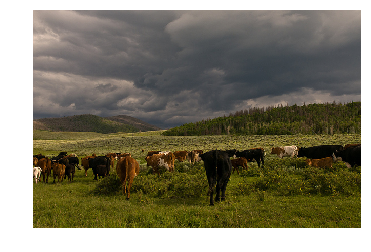

load and display captions
annIds [260768, 260891, 274076, 274190, 274880]
anns [{'image_id': 261155, 'id': 260768, 'caption': 'A herd of cattle grazing on lush green grass.'}, {'image_id': 261155, 'id': 260891, 'caption': 'A herd of cattle grazing with dark clouds above.'}, {'image_id': 261155, 'id': 274076, 'caption': 'A herd of cows in a field underneath a cloudy sky.'}, {'image_id': 261155, 'id': 274190, 'caption': 'A herd of cattle in a large, open field.'}, {'image_id': 261155, 'id': 274880, 'caption': 'A storm is brewing overhead as cows appear to be heading somewhere else. '}]
use show anns function
A herd of cattle grazing on lush green grass.
A herd of cattle grazing with dark clouds above.
A herd of cows in a field underneath a cloudy sky.
A herd of cattle in a large, open field.
A storm is brewing overhead as cows appear to be heading somewhere else. 


In [8]:
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
%matplotlib inline

# pick a random image and obtain the corresponding URL
ann_id = np.random.choice(ids)
img_id = coco.anns[ann_id]['image_id']
img = coco.loadImgs(img_id)[0]
url = img['coco_url']

print ('pick a random image and obtain the corresponding URL')
print ('ann_id',ann_id)
print ('img_id',img_id)
print ('img',img)

# print URL and visualize corresponding image
print('url',url)
I = io.imread(url)
plt.axis('off')
plt.imshow(I)
plt.show()

# load and display captions
print ('load and display captions')
annIds = coco_caps.getAnnIds(imgIds=img['id']);
print ('annIds',annIds)
anns = coco_caps.loadAnns(annIds)
print ('anns',anns)
print ('use show anns function')
coco_caps.showAnns(anns)

pick a random image and obtain the corresponding URL
ann_id 72364
img_id 573896
img {'license': 1, 'file_name': 'COCO_val2014_000000573896.jpg', 'coco_url': 'http://images.cocodataset.org/val2014/COCO_val2014_000000573896.jpg', 'height': 427, 'width': 640, 'date_captured': '2013-11-17 15:50:17', 'flickr_url': 'http://farm3.staticflickr.com/2534/4091234947_e569a11a5a_z.jpg', 'id': 573896}
url http://images.cocodataset.org/val2014/COCO_val2014_000000573896.jpg


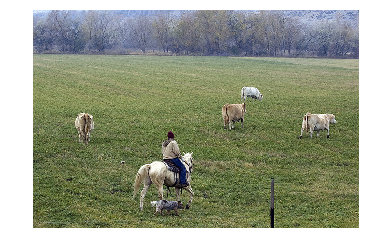

load and display captions
annIds [10008, 10125, 10455, 16716, 17385]
anns [{'image_id': 573896, 'id': 10008, 'caption': 'A herd of cattle grazing on a green grass covered field.'}, {'image_id': 573896, 'id': 10125, 'caption': 'A herder on a horse with a dog moving four cattle.'}, {'image_id': 573896, 'id': 10455, 'caption': 'A man on a horse and four cows in a field.'}, {'image_id': 573896, 'id': 16716, 'caption': 'A man on a horse in a field with cows and a dog.'}, {'image_id': 573896, 'id': 17385, 'caption': 'A man on a horse looking at his cattle.'}]
use show anns function
A herd of cattle grazing on a green grass covered field.
A herder on a horse with a dog moving four cattle.
A man on a horse and four cows in a field.
A man on a horse in a field with cows and a dog.
A man on a horse looking at his cattle.


In [10]:
# pick a random image and obtain the corresponding URL
ann_id = np.random.choice(ids)
img_id = coco.anns[ann_id]['image_id']
img = coco.loadImgs(img_id)[0]
url = img['coco_url']

print ('pick a random image and obtain the corresponding URL')
print ('ann_id',ann_id)
print ('img_id',img_id)
print ('img',img)

# print URL and visualize corresponding image
print('url',url)
I = io.imread(url)
plt.axis('off')
plt.imshow(I)
plt.show()

# load and display captions
print ('load and display captions')
annIds = coco_caps.getAnnIds(imgIds=img['id']);
print ('annIds',annIds)
anns = coco_caps.loadAnns(annIds)
print ('anns',anns)
print ('use show anns function')
coco_caps.showAnns(anns)

## Step 3: What's to Come!

In this project, you will use the dataset of image-caption pairs to train a CNN-RNN model to automatically generate images from captions.  You'll learn more about how to design the architecture in the next notebook in the sequence (**1_Preliminaries.ipynb**).

![Image Captioning CNN-RNN model](images/encoder-decoder.png)